# Setup

In [20]:
# Cell 1: Install dependencies
# Uncomment and run the following command if dependencies are not already installed.
# %pip install scikit-learn scikit-image SimpleITK nibabel nilearn albumentations seaborn pandas numpy matplotlib tqdm pydicom scipy
# %pip install umap-learn


In [1]:
# CUDA verification
import torch
print(f"CUDA available: {torch.cuda.is_available()}")
print(f"CUDA device count: {torch.cuda.device_count()}")
if torch.cuda.is_available():
    print(f"CUDA device name: {torch.cuda.get_device_name(0)}")
    print(f"CUDA device capability: {torch.cuda.get_device_capability(0)}")

CUDA available: True
CUDA device count: 1
CUDA device name: NVIDIA GeForce RTX 4070 Ti
CUDA device capability: (8, 9)


In [2]:
# Cell 2: Import statements and environment setup
import torch

def configure_gpu():
    """
    Configures GPU settings:
    - Detects CUDA device
    - Enables CUDNN benchmarking for improved performance on NVIDIA 4070Ti
    """
    if torch.cuda.is_available():
        device = torch.device("cuda")
        # Enable CUDNN benchmark for optimized convolution algorithm selection
        torch.backends.cudnn.benchmark = True
        print(f"Using GPU: {torch.cuda.get_device_name(device)}")
    else:
        raise EnvironmentError("CUDA-compatible GPU not found. Please check your GPU configuration.")

def print_gpu_memory_stats():
    """
    Prints current GPU memory usage for monitoring.
    """
    if torch.cuda.is_available():
        allocated = torch.cuda.memory_allocated() / (1024 ** 2)
        reserved = torch.cuda.memory_reserved() / (1024 ** 2)
        print(f"GPU Memory Allocated: {allocated:.2f} MB")
        print(f"GPU Memory Reserved: {reserved:.2f} MB")
    else:
        print("CUDA not available.")

# Configure GPU on startup
configure_gpu()
print_gpu_memory_stats()

import warnings
warnings.filterwarnings('ignore')

Using GPU: NVIDIA GeForce RTX 4070 Ti
GPU Memory Allocated: 0.00 MB
GPU Memory Reserved: 0.00 MB


In [3]:
# Cell 3: GPU Setup and Memory Management
import os
import logging
import warnings
import pandas as pd

# Configure logging for quality assurance (logs will be written to data_ingestion.log)
logging.basicConfig(level=logging.INFO, filename="data_ingestion.log", filemode="w",
                    format="%(asctime)s - %(levelname)s - %(message)s")

def collect_files(base_dir):
    """
    Recursively collects DICOM files only from the expected folders:
    - PPMI_Images_PD: Label "PD"
    - PPMI_Images_SWEDD: Label "SWEDD"
    - PPMI_Images_Cont: Label "Control"

    Excludes any file containing "br_raw" in its path and logs all skipped folders.

    :param base_dir: Base directory containing the Images folder.
    :return: (included_files, excluded_files)
             included_files: list of tuples (full_path, label)
             excluded_files: list of file paths that were excluded.
    """
    included_files = []
    excluded_files = []

    # Define the expected folders and corresponding labels
    expected_folders = {
        "PPMI_Images_PD": "PD",
        "PPMI_Images_SWEDD": "SWEDD",
        "PPMI_Images_Cont": "Control"
    }

    # Iterate over immediate subdirectories in base_dir
    for folder in os.listdir(base_dir):
        folder_path = os.path.join(base_dir, folder)
        if os.path.isdir(folder_path) and folder in expected_folders:
            logging.info(f"Processing folder: {folder_path}")
            # Recursively traverse the expected folder
            for root, dirs, files in os.walk(folder_path):
                for file in files:
                    if file.endswith(".dcm"):
                        full_path = os.path.join(root, file)
                        # Exclude any file with "br_raw" in its full path
                        if "br_raw" in full_path:
                            excluded_files.append(full_path)
                            logging.info(f"Excluding raw file: {full_path}")
                        else:
                            included_files.append((full_path, expected_folders[folder]))
        else:
            logging.info(f"Skipping folder: {folder_path}")

    return included_files, excluded_files

def generate_dataframe(included_files):
    """
    Creates a DataFrame from the list of validated file paths.

    :param included_files: List of tuples (file_path, label)
    :return: DataFrame with columns 'file_path' and 'label'
    """
    df = pd.DataFrame(included_files, columns=["file_path", "label"])
    return df

def save_qa_report(total_files, included_count, excluded_count, output_path="data_ingestion_QA_report.csv"):
    """
    Generates and saves a QA report of the file collection process.

    :param total_files: Total number of DICOM files encountered.
    :param included_count: Count of files included after filtering.
    :param excluded_count: Count of files excluded.
    :param output_path: File path for the QA report CSV.
    """
    exclusion_ratio = excluded_count / total_files if total_files > 0 else 0
    qa_report = {
        "total_files": total_files,
        "included_files": included_count,
        "excluded_files": excluded_count,
        "exclusion_ratio": exclusion_ratio,
    }
    qa_df = pd.DataFrame([qa_report])
    qa_df.to_csv(output_path, index=False)
    logging.info("QA report saved to %s", output_path)

    if exclusion_ratio > 0.5:
        warnings.warn(f"High proportion of raw files excluded: {exclusion_ratio:.2%}")


## Data Ingestion

In [4]:
# !pip install pydicom
# !pip install nibabel

In [5]:
# Cell 4: Data Ingestion Pipeline
import pydicom
import numpy as np

def load_dicom(file_path):
    """
    Loads and processes a DICOM file:
    - Reads the file using pydicom.
    - Converts the pixel array to float32.
    - Applies RescaleSlope and RescaleIntercept if available.

    :param file_path: Path to the DICOM file.
    :return: Tuple (processed_pixel_array, dicom_metadata)
    """
    try:
        ds = pydicom.dcmread(file_path)
    except Exception as e:
        raise IOError(f"Error reading DICOM file {file_path}: {e}")

    # Extract pixel array and convert to float32
    pixel_array = ds.pixel_array.astype(np.float32)

    # Apply rescaling if attributes are present
    if hasattr(ds, 'RescaleSlope') and hasattr(ds, 'RescaleIntercept'):
        slope = ds.RescaleSlope
        intercept = ds.RescaleIntercept
        pixel_array = pixel_array * slope + intercept

    return pixel_array, ds

In [6]:
# Cell 5: Execute Data Ingestion Pipeline
# Define the base directory containing the "Images" folder (adjust if necessary)
base_dir = "Images"

# Collect files from only the expected subdirectories
included_files, excluded_files = collect_files(base_dir)

# Create a DataFrame for the validated file paths and their labels
df = generate_dataframe(included_files)

# Final validation: Ensure that no "br_raw" files are included
if df["file_path"].str.contains("br_raw").any():
    raise ValueError("Validation failed: 'br_raw' files detected in the final dataset!")

# Save the validated file paths to CSV for reproducibility
df.to_csv("validated_file_paths.csv", index=False)
print("Validated file paths saved to validated_file_paths.csv")

# Generate and save the QA report
total_files = len(included_files) + len(excluded_files)
save_qa_report(total_files, len(included_files), len(excluded_files))
print("QA report generated and saved as data_ingestion_QA_report.csv")


Validated file paths saved to validated_file_paths.csv
QA report generated and saved as data_ingestion_QA_report.csv


## Data Visualization

Loading file for group PD: Images/PPMI_Images_PD/73614/Reconstructed_DaTSCAN/2018-01-17_13_55_44.0/I1145764/PPMI_73614_NM_Reconstructed_DaTSCAN_Br_20190322085108275_1_S789036_I1145764.dcm
Loading file for group SWEDD: Images/PPMI_Images_SWEDD/3783/Reconstructed_DaTSCAN/2012-08-16_14_08_58.0/I355224/PPMI_3783_NM_Reconstructed_DaTSCAN_Br_20130116125927234_1_S168157_I355224.dcm
Loading file for group Control: Images/PPMI_Images_Cont/3362/Reconstructed_DaTSCAN/2011-09-15_14_14_47.0/I339912/PPMI_3362_NM_Reconstructed_DaTSCAN_Br_20121015085432748_1_S124335_I339912.dcm


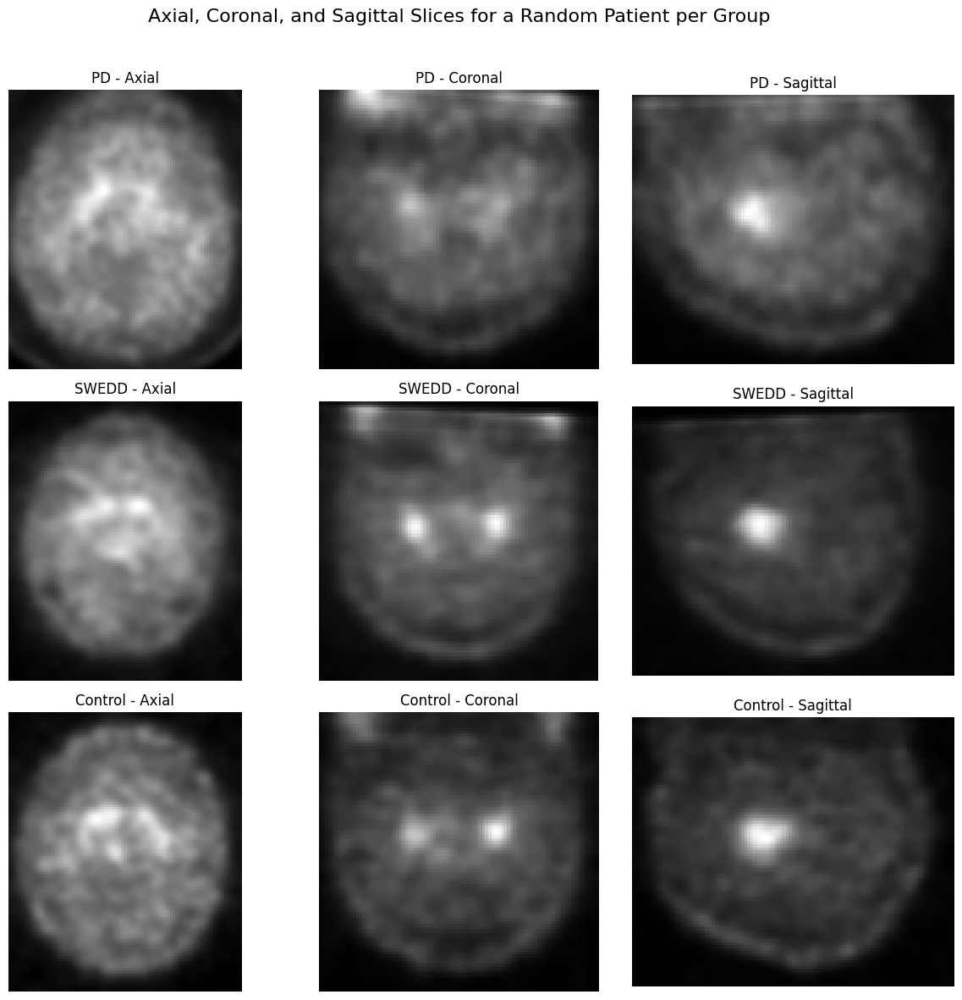

In [7]:
# Cell 6: Visualize One Axial, Coronal, and Sagittal Slice for a Random Patient per Group

import pandas as pd
import random
import matplotlib.pyplot as plt
import numpy as np
import nibabel as nib

# Read the validated file paths CSV generated earlier
df = pd.read_csv("validated_file_paths.csv")

# Function to extract the three orthogonal slices from a 3D volume
def extract_slices(volume):
    """
    Given a 3D volume, returns one axial, one coronal, and one sagittal slice.
    Assumes volume shape is (depth, height, width).
    """
    d, h, w = volume.shape
    axial = volume[32, :, :]         # Axial: slice along depth
    coronal = volume[:, 50, :]        # Coronal: slice along height
    sagittal = volume[:, :, 55]       # Sagittal: slice along width
    return axial, coronal, sagittal

# List of groups and their expected labels
groups = {"PD": "PD", "SWEDD": "SWEDD", "Control": "Control"}
maskH = nib.load('rmask_ICV.nii')
mask = maskH.get_fdata()>0.5
mask = np.transpose(mask,[2, 1, 0])
mask = np.flip(mask,axis=1)
# Create a figure with one row per group and three columns for the views
fig, axes = plt.subplots(nrows=len(groups), ncols=3, figsize=(12, 4 * len(groups)))
fig.suptitle("Axial, Coronal, and Sagittal Slices for a Random Patient per Group", fontsize=16)

for i, (group_key, group_label) in enumerate(groups.items()):
    # Filter DataFrame for the current group
    group_df = df[df["label"] == group_label]
    if group_df.empty:
        print(f"No data found for group {group_label}")
        continue

    # Select a random file from the group
    random_file = group_df.sample(1)["file_path"].values[0]
    print(f"Loading file for group {group_label}: {random_file}")

    # Load the DICOM volume using the previously defined load_dicom() function
    volume, _ = load_dicom(random_file)

    # Verify the volume is 3D (if not, skip or raise an error)
    if volume.ndim != 3:
        raise ValueError(f"Expected 3D volume, got shape {volume.shape} for file: {random_file}")

    axial, coronal, sagittal = extract_slices(volume)

    # Plot Axial slice
    ax = axes[i, 0]
    ax.imshow(axial, cmap="gray")
    ax.set_title(f"{group_label} - Axial")
    ax.axis("off")

    # Plot Coronal slice
    ax = axes[i, 1]
    ax.imshow(coronal, cmap="gray")
    ax.set_title(f"{group_label} - Coronal")
    ax.axis("off")

    # Plot Sagittal slice
    ax = axes[i, 2]
    ax.imshow(sagittal, cmap="gray")
    ax.set_title(f"{group_label} - Sagittal")
    ax.axis("off")

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


## Data Preprocessing

### Intensity Normalization and Volume Preprocessing

### Brain Masking

In [8]:
#!pip install scikit-image

(64, 109, 91)
(64, 128, 128)


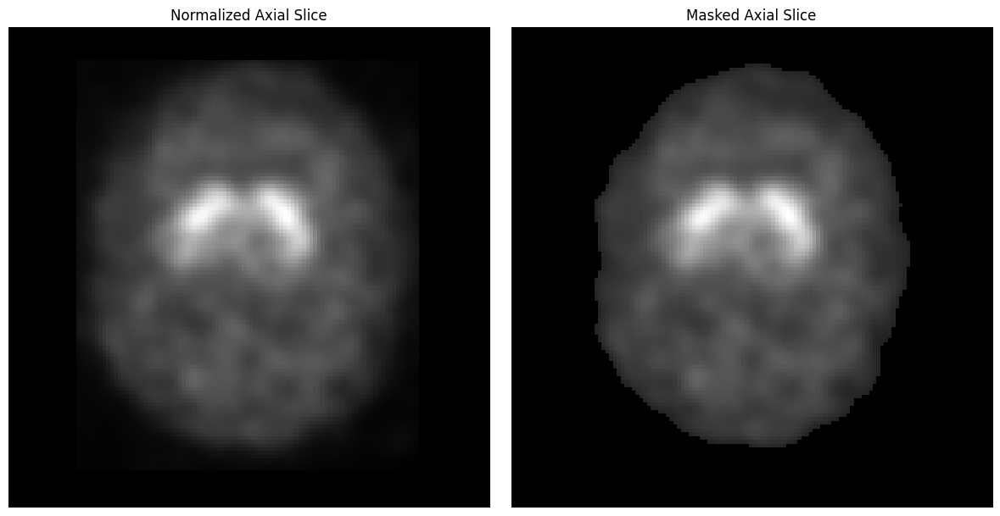

In [9]:
# Cell 7: Data Preprocessing – Brain Masking

import numpy as np
import matplotlib.pyplot as plt
from skimage.filters import threshold_otsu
from skimage.morphology import binary_closing, ball

def resize_volume(volume, target_shape=(64, 128, 128)):
    """
    Resizes the volume to the target shape using zero-padding or center cropping.

    Args:
        volume: Input 3D volume as numpy array with shape (d, h, w)
        target_shape: Desired output shape as tuple (d_new, h_new, w_new)

    Returns:
        Resized volume with shape target_shape
    """
    def get_pad_amounts(current_size, target_size):
        """Helper to calculate padding amounts"""
        if current_size >= target_size:
            return 0, 0
        diff = target_size - current_size
        pad_before = diff // 2
        pad_after = diff - pad_before
        return pad_before, pad_after

    current_shape = volume.shape
    resized = volume.copy()

    # Calculate padding/cropping for each dimension
    pads = [get_pad_amounts(current_shape[i], target_shape[i]) for i in range(3)]

    # Apply padding if needed
    if any(sum(p) > 0 for p in pads):
        resized = np.pad(
            resized,
            pad_width=pads,
            mode="constant",
            constant_values=0
        )

    # Apply cropping if needed
    for i in range(3):
        if current_shape[i] > target_shape[i]:
            # Calculate slicing indices
            start = (current_shape[i] - target_shape[i]) // 2
            end = start + target_shape[i]
            # Apply slice
            if i == 0:
                resized = resized[start:end, :, :]
            elif i == 1:
                resized = resized[:, start:end, :]
            else:
                resized = resized[:, :, start:end]

    return resized

def process_volume(volume, target_shape=(64, 128, 128)):
    """
    Process a 3D volume by:
    1. Normalizing intensity (truncating negatives and min-max scaling)
    2. Resizing to target_shape
    3. Generating a brain mask via Otsu thresholding and morphological closing

    Args:
        volume: Input 3D volume
        target_shape: Desired output shape (depth, height, width)

    Returns:
        norm_vol: Normalized and resized volume
        mask: Brain mask
        masked_vol: Masked volume
    """
    # 1. Intensity normalization
    # volume = np.clip(volume, a_min=0, a_max=None)
    # vmin, vmax = volume.min(), volume.max()
    # if vmax > vmin:
    #     norm_vol = (volume - vmin) / (vmax - vmin)
    # else:
    #     norm_vol = volume - vmin
    

    # 2. Resize the normalized volume
    norm_vol = resize_volume(volume-volume.min(), target_shape=target_shape)
    mask = np.zeros((64,128,128),dtype=bool)
    mask[20:40,82:103,43:82]=1    
    norm_vol /= np.mean(norm_vol[mask])    

    # 3. Compute brain mask
    thresh = threshold_otsu(norm_vol)
    mask = norm_vol > thresh
    mask = binary_closing(mask, footprint=ball(2))
    masked_vol = norm_vol * mask

    return norm_vol, mask, masked_vol

# Demonstration: Load one sample DICOM file (using the first file in your validated DataFrame)
sample_file = df.iloc[0]["file_path"]
original_volume, _ = load_dicom(sample_file)
original_volume = original_volume[9:73,:,:]

# Process the volume with our new function
norm_vol, mask, masked_vol = process_volume(original_volume, target_shape=(64,128,128))

print(original_volume.shape)
print(norm_vol.shape)

# Extract an axial (middle) slice from both the normalized volume and the masked volume
axial_norm = norm_vol[norm_vol.shape[0]//2, :, :]
axial_masked = masked_vol[masked_vol.shape[0]//2, :, :]

# Plot side-by-side for comparison
fig, axes = plt.subplots(1, 2, figsize=(12, 6))
axes[0].imshow(axial_norm, cmap="gray")
axes[0].set_title("Normalized Axial Slice")
axes[0].axis("off")

axes[1].imshow(axial_masked, cmap="gray")
axes[1].set_title("Masked Axial Slice")
axes[1].axis("off")

plt.tight_layout()
plt.show()


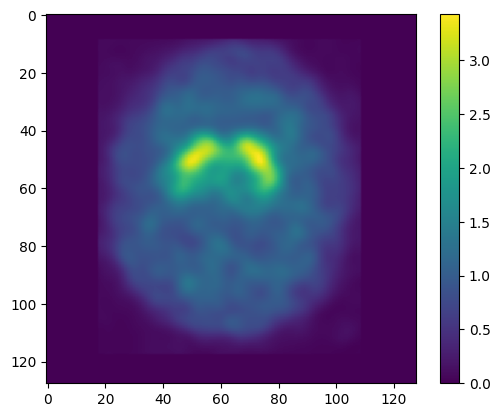

In [10]:
# Cell 8: Data Preprocessing – Visualization (heatmap)
plt.imshow(norm_vol[32,:,:])
plt.colorbar()



## Dataloader Creation (with Shape Validation)

In [11]:
# !pip install ipywidgets

In [12]:
# Cell 9: Dataset Implementation with GPU Memory Management
import torch
from torch.utils.data import Dataset, DataLoader
from tqdm import tqdm
import gc
import numpy as np
import os
import psutil
import time
from sklearn.model_selection import train_test_split

def print_memory_stats():
    """Print memory usage statistics"""
    if torch.cuda.is_available():
        print("\nGPU Memory Usage:")
        print(f"Allocated: {torch.cuda.memory_allocated() / 1024**2:.2f} MB")
        print(f"Cached: {torch.cuda.memory_reserved() / 1024**2:.2f} MB")
    print(f"CPU Memory Usage: {psutil.Process().memory_info().rss / 1024**2:.2f} MB")

class OnDemandDataset(Dataset):
    """
    Memory-efficient dataset that loads volumes on demand rather than all at once
    """
    def __init__(self, dataframe, transform=None):
        self.df = dataframe
        self.transform = transform
        
        # Load mask once
        try:
            maskH = nib.load('rmask_ICV.nii')
            self.mask = maskH.get_fdata() > 0.5
            self.mask = np.transpose(self.mask, [2, 1, 0])
            self.mask = np.flip(self.mask, axis=1)
            print("✅ Brain mask loaded successfully")
        except Exception as e:
            print(f"⚠️ Warning: Could not load brain mask: {e}")
            print("⚠️ Creating a dummy mask instead")
            self.mask = np.ones((128, 128, 128), dtype=bool)
        
        # Verify all paths exist
        missing_files = []
        for idx, row in dataframe.iterrows():
            if not os.path.exists(row["file_path"]):
                missing_files.append(row["file_path"])
        
        if missing_files:
            print(f"⚠️ Warning: {len(missing_files)} files not found!")
            print(f"First few missing files: {missing_files[:3]}")
        else:
            print(f"✅ All {len(dataframe)} file paths are valid")

    def __len__(self):
        """Return the total number of samples in the dataset"""
        return len(self.df)

    def __getitem__(self, idx):
        """Load a single volume on demand"""
        try:
            # Get file path
            file_path = self.df.iloc[idx]["file_path"]
            
            # Load and process volume
            volume, _ = load_dicom(file_path)
            
            # Apply mask
            volume -= volume.min()
            volume = volume * self.mask
            
            # Apply processing
            norm_vol, _, _ = process_volume(volume[9:73, :, :], target_shape=(64, 128, 128))
            
            # Convert to tensor
            volume_tensor = torch.from_numpy(np.expand_dims(norm_vol, axis=0)).float()
            
            return {
                "volume": volume_tensor,
                "label": self.df.iloc[idx]["label"],
                "path": self.df.iloc[idx]["file_path"]
            }
        except Exception as e:
            print(f"Error processing file {self.df.iloc[idx]['file_path']}: {e}")
            # Return a zero tensor as fallback
            return {
                "volume": torch.zeros((1, 64, 128, 128), dtype=torch.float32),
                "label": self.df.iloc[idx]["label"],
                "path": self.df.iloc[idx]["file_path"]
            }

class BatchLoadDataset(Dataset):
    """
    Memory-efficient dataset that processes data in small batches 
    and caches the processed results
    """
    def __init__(self, dataframe, batch_size=32, transform=None):
        self.df = dataframe
        self.transform = transform
        self.data_cache = {}  # Cache for processed data
        
        # Load mask once
        try:
            maskH = nib.load('rmask_ICV.nii')
            self.mask = maskH.get_fdata() > 0.5
            self.mask = np.transpose(self.mask, [2, 1, 0])
            self.mask = np.flip(self.mask, axis=1)
            print("✅ Brain mask loaded successfully")
        except Exception as e:
            print(f"⚠️ Warning: Could not load brain mask: {e}")
            print("⚠️ Creating a dummy mask instead")
            self.mask = np.ones((128, 128, 128), dtype=bool)
        
        # Pre-process data in batches to avoid memory issues
        total_batches = (len(dataframe) + batch_size - 1) // batch_size
        print(f"Pre-processing {len(dataframe)} samples in {total_batches} batches...")
        
        for batch_idx in tqdm(range(total_batches)):
            start_idx = batch_idx * batch_size
            end_idx = min(start_idx + batch_size, len(dataframe))
            
            for idx in range(start_idx, end_idx):
                try:
                    file_path = dataframe.iloc[idx]["file_path"]
                    
                    # Load DICOM
                    volume, _ = load_dicom(file_path)
                    volume -= volume.min()
                    volume = volume * self.mask
                    
                    # Process volume
                    norm_vol, _, _ = process_volume(volume[9:73, :, :], target_shape=(64, 128, 128))
                    
                    # Store in cache (using index as key)
                    self.data_cache[idx] = norm_vol
                    
                except Exception as e:
                    print(f"Error processing file {dataframe.iloc[idx]['file_path']}: {e}")
                    self.data_cache[idx] = np.zeros((64, 128, 128), dtype=np.float32)
            
            # Force garbage collection after each batch
            gc.collect()
            if torch.cuda.is_available():
                torch.cuda.empty_cache()
            
            # Print memory stats every few batches
            if batch_idx % 5 == 0:
                print_memory_stats()
        
        print("✅ Data pre-processing complete")

    def __len__(self):
        """Return the total number of samples in the dataset"""
        return len(self.df)

    def __getitem__(self, idx):
        """Get a cached pre-processed volume"""
        try:
            # Get the pre-processed volume from cache
            norm_vol = self.data_cache[idx]
            
            # Convert to tensor
            volume_tensor = torch.from_numpy(np.expand_dims(norm_vol, axis=0)).float()
            
            return {
                "volume": volume_tensor,
                "label": self.df.iloc[idx]["label"],
                "path": self.df.iloc[idx]["file_path"]
            }
        except Exception as e:
            print(f"Error retrieving item {idx}: {e}")
            # Return a zero tensor as fallback
            return {
                "volume": torch.zeros((1, 64, 128, 128), dtype=torch.float32),
                "label": self.df.iloc[idx]["label"],
                "path": self.df.iloc[idx]["file_path"]
            }

def create_dataloaders(df, batch_size=4, train_split=0.8, on_demand=True):
    """Create train and validation dataloaders with stratified split"""
    # Stratified split to maintain group distributions
    train_df, val_df = train_test_split(
        df,
        test_size=1-train_split,
        stratify=df['label'],
        random_state=42
    )

    print("\nTraining set distribution:")
    print(train_df['label'].value_counts())
    print("\nValidation set distribution:")
    print(val_df['label'].value_counts())

    # Create datasets with appropriate strategy
    if on_demand:
        print("Using on-demand data loading strategy (lighter on memory but slower)")
        train_dataset = OnDemandDataset(train_df)
        val_dataset = OnDemandDataset(val_df)
    else:
        print("Using batch pre-processing strategy (faster but more memory intensive)")
        train_dataset = BatchLoadDataset(train_df)
        val_dataset = BatchLoadDataset(val_df)

    # Create dataloaders with optimized settings
    train_loader = DataLoader(
        train_dataset,
        batch_size=batch_size,
        shuffle=True,
        num_workers=2,  # Reduced from 6 to prevent hanging
        pin_memory=True,
        persistent_workers=False  # Changed from True to avoid memory issues
    )

    val_loader = DataLoader(
        val_dataset,
        batch_size=batch_size,
        shuffle=False,
        num_workers=2,  # Reduced from 6 to prevent hanging
        pin_memory=True,
        persistent_workers=False  # Changed from True to avoid memory issues
    )

    return train_loader, val_loader

# Test the dataloader with a small batch
if __name__ == "__main__":
    print("Testing dataloader with small batch...")
    start_time = time.time()
    
    # Create dataloaders with a smaller batch size for testing
    train_loader, val_loader = create_dataloaders(df, batch_size=2, on_demand=True)
    
    # Try to load a single batch
    print("Fetching a single batch...")
    for batch in train_loader:
        print(f"Batch loaded successfully!")
        print(f"Batch shape: {batch['volume'].shape}")
        print(f"Labels: {batch['label']}")
        break
    
    print(f"Dataloader test completed in {time.time() - start_time:.2f} seconds")
    print_memory_stats()

Testing dataloader with small batch...

Training set distribution:
label
PD         2043
Control     235
SWEDD       110
Name: count, dtype: int64

Validation set distribution:
label
PD         512
Control     59
SWEDD       27
Name: count, dtype: int64
Using on-demand data loading strategy (lighter on memory but slower)
✅ Brain mask loaded successfully
✅ All 2388 file paths are valid
✅ Brain mask loaded successfully
✅ All 598 file paths are valid
Fetching a single batch...
Batch loaded successfully!
Batch shape: torch.Size([2, 1, 64, 128, 128])
Labels: ['Control', 'PD']
Dataloader test completed in 10.98 seconds

GPU Memory Usage:
Allocated: 0.00 MB
Cached: 0.00 MB
CPU Memory Usage: 821.76 MB


# Exploratory Data Analysis (EDA)

In [13]:
# !pip install seaborn

Starting Memory-Efficient EDA with Stratified Sampling...

Creating memory-efficient dataloaders...

Training set distribution:
label
PD         2043
Control     235
SWEDD       110
Name: count, dtype: int64

Validation set distribution:
label
PD         512
Control     59
SWEDD       27
Name: count, dtype: int64
Using on-demand data loading strategy (lighter on memory but slower)
✅ Brain mask loaded successfully
✅ All 2388 file paths are valid
✅ Brain mask loaded successfully
✅ All 598 file paths are valid

Analyzing training dataset (with stratification)...
Analyzing dataset statistics (stratified, memory-efficient version)...
Scanning dataset to count groups...


Counting groups:   2%|▏         | 24/1194 [00:02<01:33, 12.57it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Counting groups:  37%|███▋      | 441/1194 [00:42<01:07, 11.13it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Counting groups:  53%|█████▎    | 637/1194 [01:00<00:50, 10.98it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Counting groups:  56%|█████▌    | 669/1194 [01:03<00:45, 11.48it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Counting groups:  73%|███████▎  | 873/1194 [01:20<00:25, 12.57it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Counting groups:  77%|███████▋  | 921/1194 [01:24<00:22, 11.95it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Counting groups: 100%|██████████| 1194/1194 [01:50<00:00, 10.83it/s]


Found groups: {'PD': 2043, 'Control': 235, 'SWEDD': 110}


Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Collected sufficient samples from all groups
Processing 112 collected samples...
Samples per group: {'PD': 82, 'Control': 15, 'SWEDD': 15}


Successfully analyzed 112 samples
Group distribution in analyzed samples:
label
PD         82
Control    15
SWEDD      15
Name: count, dtype: int64

Plotting intensity distributions...


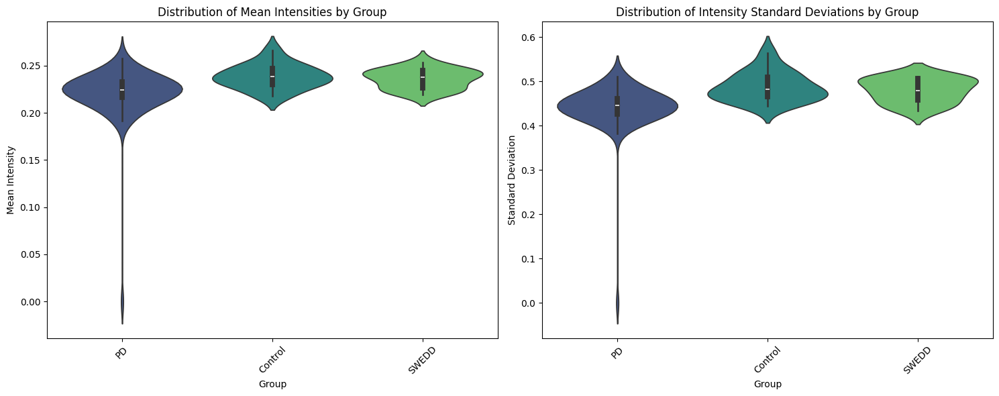


Plotting group statistics...


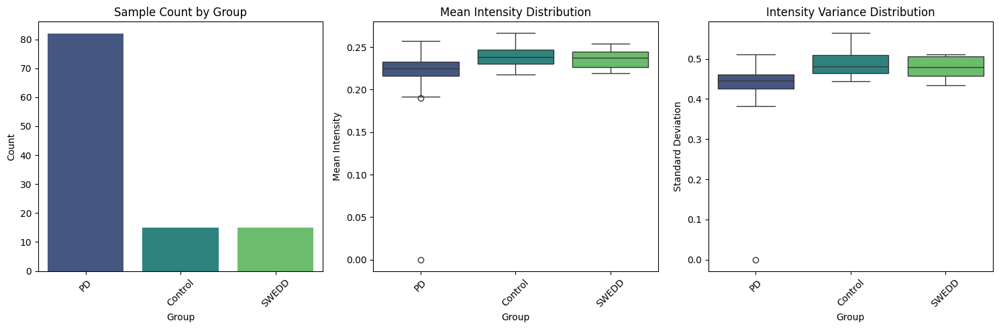


Visualizing example slices...
Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 
Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 
Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 
Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.d

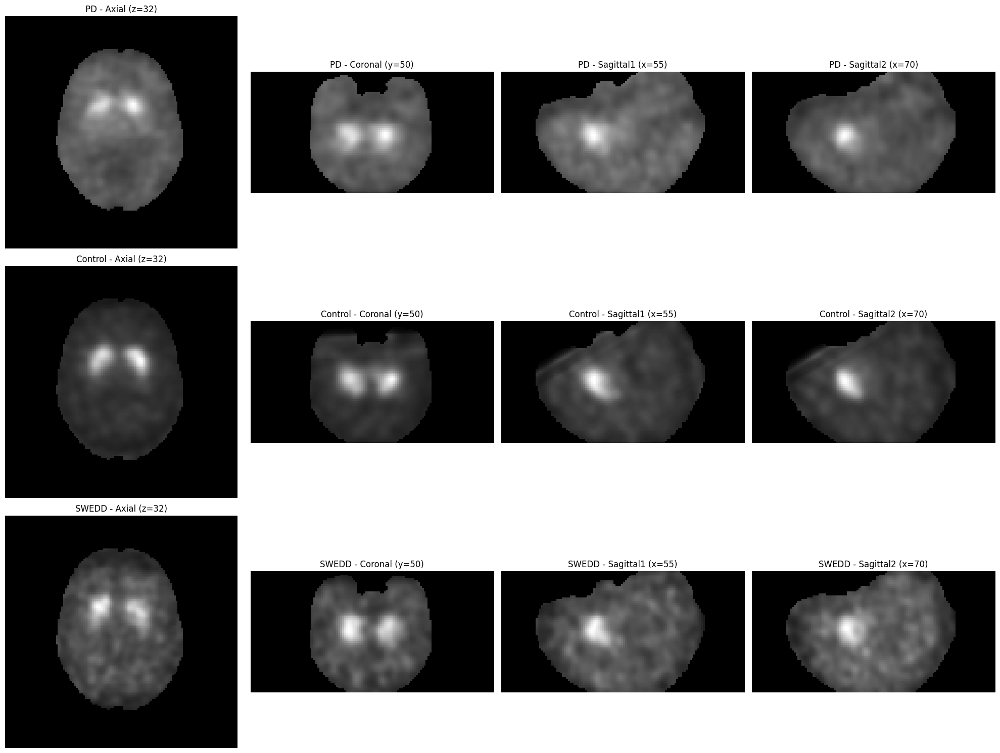


Summary Statistics by Group:
          mean           std         min         max       
          mean    std   mean    std mean  std   mean    std
label                                                      
Control  0.238  0.013  0.488  0.033  0.0  0.0  5.265  0.866
PD       0.221  0.028  0.442  0.056  0.0  0.0  3.627  1.001
SWEDD    0.236  0.010  0.480  0.027  0.0  0.0  4.895  0.896

EDA completed in 200.16 seconds!

GPU Memory Usage:
Allocated: 0.00 MB
Cached: 0.00 MB
CPU Memory Usage: 1394.63 MB


In [14]:
# Cell 10: Optimized EDA Implementation with Stratified Sampling
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from tqdm import tqdm
from collections import defaultdict
import torch
import time
import gc
import random

def create_memory_efficient_dataloaders(df, batch_size=2, train_split=0.8):
    """
    Create train and validation dataloaders with optimized memory usage
    """
    # Reuse the create_dataloaders function from Cell 9
    return create_dataloaders(df, batch_size=batch_size, train_split=train_split, on_demand=True)

def analyze_dataset_statistics_efficiently(dataloader, max_samples=100, min_samples_per_group=15):
    """
    Analyzes dataset statistics with improved memory efficiency and ensures
    stratified sampling across all patient groups.

    Args:
        dataloader: The dataloader to sample from
        max_samples: Maximum total samples to process
        min_samples_per_group: Minimum samples to collect per group

    Returns:
        Dictionary of statistical measures with proper group representation
    """
    print("Analyzing dataset statistics (stratified, memory-efficient version)...")
    stats = defaultdict(list)
    samples_by_group = defaultdict(int)

    # First pass: Count occurrences of each group
    group_counts = {}
    print("Scanning dataset to count groups...")
    for batch in tqdm(dataloader, desc="Counting groups"):
        labels = batch['label']
        for label in labels:
            if label not in group_counts:
                group_counts[label] = 0
            group_counts[label] += 1

    print(f"Found groups: {group_counts}")

    # Second pass: Collect samples with stratification
    all_samples = []
    all_labels = []
    all_paths = []

    try:
        print("Collecting stratified samples...")
        for batch in tqdm(dataloader, desc="Collecting samples"):
            volumes = batch['volume']
            labels = batch['label']
            paths = batch['path']

            # Process each volume in the batch
            for vol_idx, (volume, label, path) in enumerate(zip(volumes, labels, paths)):
                # If we have enough samples from this group, skip unless we need more total samples
                if (samples_by_group[label] >= min_samples_per_group and
                    sum(samples_by_group.values()) >= max_samples):
                    continue

                # Add this sample
                all_samples.append(volume)
                all_labels.append(label)
                all_paths.append(path)
                samples_by_group[label] += 1

            # Memory cleanup after each batch
            del volumes, labels, paths
            if torch.cuda.is_available():
                torch.cuda.empty_cache()

            # Check if we've collected enough samples from each group
            if all(samples_by_group[group] >= min_samples_per_group for group in group_counts):
                if sum(samples_by_group.values()) >= max_samples:
                    print(f"Collected sufficient samples from all groups")
                    break

    except Exception as e:
        print(f"Error during sample collection: {str(e)}")
        import traceback
        traceback.print_exc()

    # Process collected samples
    print(f"Processing {len(all_samples)} collected samples...")
    print(f"Samples per group: {dict(samples_by_group)}")

    for volume, label, path in zip(all_samples, all_labels, all_paths):
        # Extract statistics
        vol_data = volume.numpy().flatten()

        # Compute statistics
        stats['mean'].append(float(np.mean(vol_data)))
        stats['std'].append(float(np.std(vol_data)))
        stats['min'].append(float(np.min(vol_data)))
        stats['max'].append(float(np.max(vol_data)))
        stats['label'].append(label)
        stats['path'].append(path)

    # Convert to DataFrame for easier analysis
    stats_df = pd.DataFrame(stats)
    print(f"Successfully analyzed {len(stats_df)} samples")

    # Verify group representation
    group_dist = stats_df['label'].value_counts()
    print("Group distribution in analyzed samples:")
    print(group_dist)

    return stats_df

def plot_intensity_distributions(stats_df):
    """
    Creates violin plots of intensity distributions by group
    """
    plt.figure(figsize=(15, 6))

    # Plot intensity distributions
    plt.subplot(1, 2, 1)
    sns.violinplot(data=stats_df, x='label', y='mean', palette='viridis')
    plt.title('Distribution of Mean Intensities by Group')
    plt.xlabel('Group')
    plt.ylabel('Mean Intensity')
    plt.xticks(rotation=45)

    plt.subplot(1, 2, 2)
    sns.violinplot(data=stats_df, x='label', y='std', palette='viridis')
    plt.title('Distribution of Intensity Standard Deviations by Group')
    plt.xlabel('Group')
    plt.ylabel('Standard Deviation')
    plt.xticks(rotation=45)

    plt.tight_layout()
    plt.show()

def plot_group_statistics(stats_df):
    """
    Plots statistical summaries by group using lightweight operations
    """
    plt.figure(figsize=(15, 5))

    # Group counts
    plt.subplot(1, 3, 1)
    group_counts = stats_df['label'].value_counts()
    sns.barplot(x=group_counts.index, y=group_counts.values, palette='viridis')
    plt.title('Sample Count by Group')
    plt.xlabel('Group')
    plt.ylabel('Count')
    plt.xticks(rotation=45)

    # Box plots - more memory efficient than complex plots
    plt.subplot(1, 3, 2)
    sns.boxplot(data=stats_df, x='label', y='mean', palette='viridis')
    plt.title('Mean Intensity Distribution')
    plt.xlabel('Group')
    plt.ylabel('Mean Intensity')
    plt.xticks(rotation=45)

    # Simple boxplot instead of violin plot
    plt.subplot(1, 3, 3)
    sns.boxplot(data=stats_df, x='label', y='std', palette='viridis')
    plt.title('Intensity Variance Distribution')
    plt.xlabel('Group')
    plt.ylabel('Standard Deviation')
    plt.xticks(rotation=45)

    plt.tight_layout()
    plt.show()

def visualize_sample_slices(stats_df, dataloader, samples_per_group=1):
    """
    Visualizes a limited number of samples from each group
    with efficient memory handling, selecting from the pre-processed samples.
    Shows anatomically interesting slices (axial=32, coronal=50, sagittal=55 and 70)
    instead of central slices.
    """
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    # Get unique groups
    groups = stats_df['label'].unique()

    # Dictionary to hold samples for each group
    samples_data = {}

    # Select paths from stats_df, stratified by group
    selected_paths = {}
    for group in groups:
        group_paths = stats_df[stats_df['label'] == group]['path'].values
        if len(group_paths) > 0:
            selected_paths[group] = random.sample(list(group_paths),
                                                min(samples_per_group, len(group_paths)))

    # Find these samples in the dataloader
    for batch in dataloader:
        volumes = batch['volume']
        paths = batch['path']
        labels = batch['label']

        for i, (vol, path, label) in enumerate(zip(volumes, paths, labels)):
            # Check if this path is in our selected paths
            for group, group_paths in selected_paths.items():
                if path in group_paths:
                    # Store the sample
                    key = f"{group}_{len(samples_data)}"
                    samples_data[key] = vol.cpu().numpy()
                    # Remove from selected_paths to avoid duplicates
                    selected_paths[group].remove(path)

        # Check if we have all samples
        if all(len(paths) == 0 for paths in selected_paths.values()):
            break

    # Define anatomically interesting slices 
    axial_slice_idx = 32      # Axial view - slice 32
    coronal_slice_idx = 50    # Coronal view - slice 50
    sagittal_slice1_idx = 55  # Sagittal view - slice 55
    sagittal_slice2_idx = 70  # Sagittal view - slice 70

    # Visualize the samples
    num_groups = len(groups)
    plt.figure(figsize=(20, 5 * num_groups))  # Wider figure to accommodate 4 slices

    for i, (key, vol) in enumerate(samples_data.items()):
        # Extract label
        label = key.split('_')[0]

        # Get anatomically interesting slices
        vol = vol.squeeze()  # Remove channel dimension
        axial_slice = vol[axial_slice_idx, :, :]
        coronal_slice = vol[:, coronal_slice_idx, :]
        sagittal_slice1 = vol[:, :, sagittal_slice1_idx]
        sagittal_slice2 = vol[:, :, sagittal_slice2_idx]

        # Plot slices (now 4 slices per row)
        plt.subplot(len(samples_data), 4, i*4 + 1)
        plt.imshow(axial_slice, cmap='gray')
        plt.title(f'{label} - Axial (z={axial_slice_idx})')
        plt.axis('off')

        plt.subplot(len(samples_data), 4, i*4 + 2)
        plt.imshow(coronal_slice, cmap='gray')
        plt.title(f'{label} - Coronal (y={coronal_slice_idx})')
        plt.axis('off')

        plt.subplot(len(samples_data), 4, i*4 + 3)
        plt.imshow(sagittal_slice1, cmap='gray')
        plt.title(f'{label} - Sagittal1 (x={sagittal_slice1_idx})')
        plt.axis('off')
        
        plt.subplot(len(samples_data), 4, i*4 + 4)
        plt.imshow(sagittal_slice2, cmap='gray')
        plt.title(f'{label} - Sagittal2 (x={sagittal_slice2_idx})')
        plt.axis('off')

    plt.tight_layout()
    plt.show()

# Run optimized EDA
if __name__ == "__main__":
    start_time = time.time()
    print("Starting Memory-Efficient EDA with Stratified Sampling...")

    # Create dataloaders with small batch size
    print("\nCreating memory-efficient dataloaders...")
    train_loader, val_loader = create_memory_efficient_dataloaders(df, batch_size=2)

    # Analyze with stratified sampling and more samples
    print("\nAnalyzing training dataset (with stratification)...")
    train_stats = analyze_dataset_statistics_efficiently(
        train_loader,
        max_samples=100,  # Increased from 50 to 100
        min_samples_per_group=15  # Ensure at least 15 samples per group
    )

    # Plot distributions and statistics
    print("\nPlotting intensity distributions...")
    plot_intensity_distributions(train_stats)

    print("\nPlotting group statistics...")
    plot_group_statistics(train_stats)

    # Visualize a few examples
    print("\nVisualizing example slices...")
    visualize_sample_slices(train_stats, train_loader, samples_per_group=1)

    # Print summary statistics by group
    print("\nSummary Statistics by Group:")
    summary_stats = train_stats.groupby('label').agg({
        'mean': ['mean', 'std'],
        'std': ['mean', 'std'],
        'min': ['mean', 'std'],
        'max': ['mean', 'std']
    }).round(3)
    print(summary_stats)

    # Memory cleanup
    gc.collect()
    if torch.cuda.is_available():
        torch.cuda.empty_cache()

    print(f"\nEDA completed in {time.time() - start_time:.2f} seconds!")
    print_memory_stats()

### Slice Intensity Variance Analysis

In [15]:
def analyze_slice_variance(dataloader, num_samples_per_group=5):
    """
    Analyzes slice-wise variance across different views for each patient group
    """
    print("Analyzing slice-wise variance patterns...")

    # Initialize storage for variances
    group_variances = {
        'PD': {'axial': [], 'coronal': [], 'sagittal': []},
        'Control': {'axial': [], 'coronal': [], 'sagittal': []},
        'SWEDD': {'axial': [], 'coronal': [], 'sagittal': []}
    }
    sample_counts = {'PD': 0, 'Control': 0, 'SWEDD': 0}

    try:
        for batch in tqdm(dataloader, desc="Computing slice variances"):
            volumes = batch['volume']
            labels = batch['label']

            for volume, label in zip(volumes, labels):
                label = label if isinstance(label, str) else label.item()

                if sample_counts[label] >= num_samples_per_group:
                    continue

                # Get volume data
                vol_data = volume.squeeze().numpy()
                d, h, w = vol_data.shape

                # Compute variance for each slice in each view
                axial_var = [np.var(vol_data[i, :, :]) for i in range(d)]
                coronal_var = [np.var(vol_data[:, i, :]) for i in range(h)]
                sagittal_var = [np.var(vol_data[:, :, i]) for i in range(w)]

                # Store variances
                group_variances[label]['axial'].append(axial_var)
                group_variances[label]['coronal'].append(coronal_var)
                group_variances[label]['sagittal'].append(sagittal_var)

                sample_counts[label] += 1

            # Check if we have enough samples from each group
            if all(count >= num_samples_per_group for count in sample_counts.values()):
                break

            # Memory cleanup
            del volumes, labels
            gc.collect()
            torch.cuda.empty_cache()

    except Exception as e:
        print(f"Error during variance analysis: {str(e)}")
        import traceback
        traceback.print_exc()
        return None

    # Compute average variances across samples for each group
    avg_variances = {}
    for group in group_variances:
        avg_variances[group] = {
            view: np.mean(variances, axis=0)
            for view, variances in group_variances[group].items()
        }

    return avg_variances

# Plot the slice variance results
def plot_slice_variances(avg_variances):
    """
    Creates line plots for slice-wise variance analysis
    """
    views = ['axial', 'coronal', 'sagittal']
    fig, axes = plt.subplots(1, 3, figsize=(20, 6))

    for idx, view in enumerate(views):
        ax = axes[idx]

        for group in avg_variances:
            variances = avg_variances[group][view]
            ax.plot(range(len(variances)), variances, label=group)

        ax.set_title(f'{view.capitalize()} View - Slice-wise Variance')
        ax.set_xlabel('Slice Index')
        ax.set_ylabel('Average Variance')
        ax.legend()
        ax.grid(True)

    plt.tight_layout()
    plt.show()



Analyzing slice-wise variance patterns...
Analyzing slice-wise variance patterns...


Computing slice variances:   0%|          | 5/1194 [00:00<03:03,  6.49it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Computing slice variances:   5%|▍         | 54/1194 [00:07<02:31,  7.52it/s]



Plotting slice-wise variance analysis...


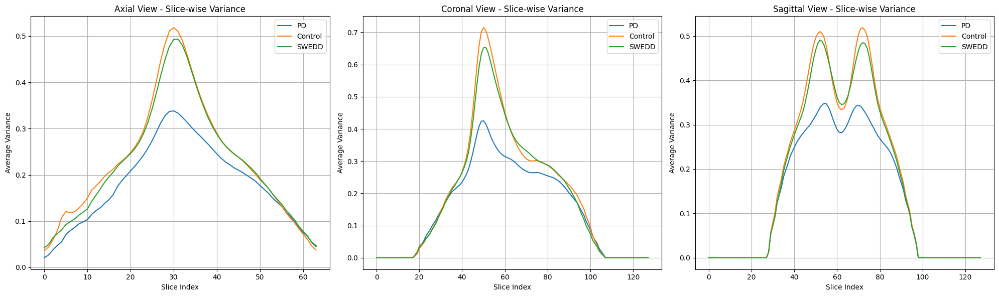

In [16]:
# Analyze slice-wise variance
print("\nAnalyzing slice-wise variance patterns...")
avg_variances = analyze_slice_variance(train_loader, num_samples_per_group=5)

if avg_variances is not None:
    print("\nPlotting slice-wise variance analysis...")
    plot_slice_variances(avg_variances)

# Model Phase

## 1. Autoencoder

### Model Setup

In [17]:
# Cell 11: Optimized Autoencoder with Memory Management
import torch
import torch.nn as nn
import torch.nn.functional as F
from collections import OrderedDict

class ConvBlock(nn.Module):
    """Memory-efficient convolutional block with batch normalization and ReLU activation."""
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=1, padding=1):
        super().__init__()
        self.block = nn.Sequential(OrderedDict([
            ('conv', nn.Conv3d(in_channels, out_channels, kernel_size, stride, padding)),
            ('bn', nn.BatchNorm3d(out_channels)),
            ('relu', nn.ReLU(inplace=True))  # inplace ReLU for memory efficiency
        ]))

    def forward(self, x):
        return self.block(x)

class Encoder(nn.Module):
    """3D Encoder network optimized for 64×128×128 input volumes."""
    def __init__(self, latent_dim=256):
        super().__init__()

        # Initial feature extraction
        self.init_conv = ConvBlock(1, 16)  # (1, 64, 128, 128) -> (16, 64, 128, 128)

        # Downsampling path with progressive channel increase
        self.down1 = nn.Sequential(
            ConvBlock(16, 32, stride=2),    # -> (32, 32, 64, 64)
            ConvBlock(32, 32)               # -> (32, 32, 64, 64)
        )

        self.down2 = nn.Sequential(
            ConvBlock(32, 64, stride=2),    # -> (64, 16, 32, 32)
            ConvBlock(64, 64)               # -> (64, 16, 32, 32)
        )

        self.down3 = nn.Sequential(
            ConvBlock(64, 128, stride=2),   # -> (128, 8, 16, 16)
            ConvBlock(128, 128)             # -> (128, 8, 16, 16)
        )

        self.down4 = nn.Sequential(
            ConvBlock(128, 256, stride=2),  # -> (256, 4, 8, 8)
            ConvBlock(256, 256)             # -> (256, 4, 8, 8)
        )

        # Project to latent space
        self.flatten_size = 256 * 4 * 8 * 8
        self.fc = nn.Linear(self.flatten_size, latent_dim)

    def forward(self, x):
        x = self.init_conv(x)
        d1 = self.down1(x)
        d2 = self.down2(d1)
        d3 = self.down3(d2)
        d4 = self.down4(d3)

        # Flatten and project to latent space
        flat = torch.flatten(d4, start_dim=1)
        z = self.fc(flat)

        return z

class Decoder(nn.Module):
    """3D Decoder network optimized for 64×128×128 output volumes."""
    def __init__(self, latent_dim=256):
        super().__init__()

        self.flatten_size = 256 * 4 * 8 * 8
        self.fc = nn.Linear(latent_dim, self.flatten_size)

        # Upsampling path
        self.up1 = nn.Sequential(
            nn.Upsample(scale_factor=2, mode='trilinear', align_corners=False),
            ConvBlock(256, 128),
            ConvBlock(128, 128)
        )

        self.up2 = nn.Sequential(
            nn.Upsample(scale_factor=2, mode='trilinear', align_corners=False),
            ConvBlock(128, 64),
            ConvBlock(64, 64)
        )

        self.up3 = nn.Sequential(
            nn.Upsample(scale_factor=2, mode='trilinear', align_corners=False),
            ConvBlock(64, 32),
            ConvBlock(32, 32)
        )

        self.up4 = nn.Sequential(
            nn.Upsample(scale_factor=2, mode='trilinear', align_corners=False),
            ConvBlock(32, 16),
            ConvBlock(16, 16)
        )

        # Final convolution
        self.final_conv = nn.Conv3d(16, 1, kernel_size=1)

    def forward(self, z):
        # Reshape from latent space
        x = self.fc(z)
        x = x.view(-1, 256, 4, 8, 8)

        # Upsampling
        x = self.up1(x)
        x = self.up2(x)
        x = self.up3(x)
        x = self.up4(x)

        # Final convolution
        x = self.final_conv(x)

        return x

class BaseAutoencoder(nn.Module):
    """Memory-optimized 3D Autoencoder for 64×128×128 medical volumes."""
    def __init__(self, latent_dim=256):
        super().__init__()
        self.encoder = Encoder(latent_dim)
        self.decoder = Decoder(latent_dim)

    def forward(self, x):
        z = self.encoder(x)
        reconstruction = self.decoder(z)
        return reconstruction

    def encode(self, x):
        """Encode input to latent space"""
        z = self.encoder(x)
        return z

    def decode(self, z):
        """Decode from latent space (for generation)"""
        return self.decoder(z)

# Memory and GPU test function
def test_autoencoder(batch_size=2):
    """Test the autoencoder with dummy data and verify memory usage."""
    print("\nTesting Autoencoder Architecture...")

    try:
        # Create model and move to GPU
        model = BaseAutoencoder(latent_dim=256)
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        model = model.to(device)

        # Print model summary
        num_params = sum(p.numel() for p in model.parameters())
        print(f"\nModel Parameters: {num_params:,}")

        # Create dummy input (64x128x128 volume)
        dummy_input = torch.randn(batch_size, 1, 64, 128, 128, device=device)

        # Print initial memory usage
        print("\nInitial GPU Memory Usage:")
        print_memory_stats()

        # Test encoding
        print("\nTesting encoder...")
        with torch.no_grad():
            latent = model.encode(dummy_input)
        print(f"Input shape: {dummy_input.shape}")
        print(f"Latent shape: {latent.shape}")

        # Test full forward pass
        print("\nTesting forward pass...")
        with torch.no_grad():
            output = model(dummy_input)

        # Print output shape and final memory usage
        print(f"Output shape: {output.shape}")
        print("\nFinal GPU Memory Usage:")
        print_memory_stats()

        # Verify shapes
        assert output.shape == dummy_input.shape, f"Shape mismatch: {output.shape} vs {dummy_input.shape}"

        # Clean up
        del model, dummy_input, output, latent
        torch.cuda.empty_cache()

        print("\nAutoencoder test completed successfully!")
        return True

    except Exception as e:
        print(f"Error testing autoencoder: {str(e)}")
        import traceback
        traceback.print_exc()
        return False

# Run test if this cell is executed
if __name__ == "__main__":
    test_autoencoder(batch_size=2)


Testing Autoencoder Architecture...

Model Parameters: 38,912,721

Initial GPU Memory Usage:

GPU Memory Usage:
Allocated: 156.48 MB
Cached: 172.00 MB
CPU Memory Usage: 1409.38 MB

Testing encoder...
Input shape: torch.Size([2, 1, 64, 128, 128])
Latent shape: torch.Size([2, 256])

Testing forward pass...
Output shape: torch.Size([2, 1, 64, 128, 128])

Final GPU Memory Usage:

GPU Memory Usage:
Allocated: 172.61 MB
Cached: 624.00 MB
CPU Memory Usage: 1706.93 MB

Autoencoder test completed successfully!


In [18]:
# Cell 12: Training Configuration and Utilities
import os
import json
import time
from pathlib import Path
import torch.optim as optim
from torch.optim.lr_scheduler import ReduceLROnPlateau
import torch.cuda.amp as amp
import math

class TrainingConfig:
    """Training configuration optimized for NVIDIA 4070Ti"""
    def __init__(self, **kwargs):
        # Model parameters
        self.latent_dim = kwargs.get('latent_dim', 256)
        
        # Training parameters
        self.learning_rate = kwargs.get('learning_rate', 1e-4)
        self.batch_size = kwargs.get('batch_size', 4)
        self.accumulation_steps = kwargs.get('accumulation_steps', 4)
        self.epochs = kwargs.get('epochs', 100)
        self.early_stopping_patience = kwargs.get('early_stopping_patience', 10)
        
        # Optimization
        self.use_mixed_precision = kwargs.get('use_mixed_precision', True)
        self.weight_decay = kwargs.get('weight_decay', 1e-5)
        self.gradient_clip = kwargs.get('gradient_clip', 1.0)
        
        # Dataloader parameters
        self.num_workers = kwargs.get('num_workers', 2)
        self.pin_memory = kwargs.get('pin_memory', True)
        
        # Checkpoint parameters
        self.checkpoint_dir = kwargs.get('checkpoint_dir', 'checkpoints')
        self.model_name = kwargs.get('model_name', 'autoencoder')
        self.save_interval = kwargs.get('save_interval', 5)
        
        # Create checkpoint directory
        Path(self.checkpoint_dir).mkdir(parents=True, exist_ok=True)
        
        # Print configuration summary
        print(f"\n{'='*50}")
        print(f"TRAINING CONFIGURATION")
        print(f"{'='*50}")
        print(f"Model: {self.model_name} with latent dim {self.latent_dim}")
        print(f"Batch size: {self.batch_size} × {self.accumulation_steps} steps = {self.batch_size * self.accumulation_steps} effective")
        print(f"Learning rate: {self.learning_rate}")
        print(f"Mixed precision: {'Enabled' if self.use_mixed_precision else 'Disabled'}")
        print(f"Epochs: {self.epochs} with patience {self.early_stopping_patience}")
        print(f"Dataloader workers: {self.num_workers}")
        print(f"Checkpoints saved to: {self.checkpoint_dir}")
        print(f"{'='*50}\n")

class EarlyStopping:
    """Early stopping handler with patience"""
    def __init__(self, patience=10, min_delta=0, verbose=True):
        self.patience = patience
        self.min_delta = min_delta
        self.counter = 0
        self.best_loss = float('inf')
        self.early_stop = False
        self.verbose = verbose
        self.best_epoch = 0
        
    def __call__(self, val_loss, epoch):
        if val_loss < self.best_loss - self.min_delta:
            if self.verbose:
                improvement = self.best_loss - val_loss
                print(f"Validation loss improved by {improvement:.6f}")
            self.best_loss = val_loss
            self.counter = 0
            self.best_epoch = epoch
            return True  # Model improved
        else:
            self.counter += 1
            if self.verbose:
                print(f"Early stopping counter: {self.counter}/{self.patience}")
            if self.counter >= self.patience:
                self.early_stop = True
                if self.verbose:
                    print(f"Early stopping triggered. Best epoch was {self.best_epoch}.")
            return False  # Model didn't improve

class CheckpointHandler:
    """Handles saving and loading of model checkpoints"""
    def __init__(self, checkpoint_dir, model_name):
        self.checkpoint_dir = Path(checkpoint_dir)
        self.model_name = model_name
        self.checkpoint_path = self.checkpoint_dir / f"{model_name}_checkpoint.pth"
        self.best_model_path = self.checkpoint_dir / f"{model_name}_best.pth"
        self.metadata_path = self.checkpoint_dir / f"{model_name}_metadata.json"
        
        # Ensure directory exists
        self.checkpoint_dir.mkdir(parents=True, exist_ok=True)

    def save(self, model, optimizer, scheduler, epoch, train_losses, val_losses, is_best=False):
        """Save model checkpoint and training metadata"""
        # Save model checkpoint
        checkpoint = {
            'epoch': epoch,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'scheduler_state_dict': scheduler.state_dict() if scheduler else None,
            'train_losses': train_losses,
            'val_losses': val_losses
        }
        
        # Always save latest checkpoint
        torch.save(checkpoint, self.checkpoint_path)
        
        # Save best model separately if this is the best model
        if is_best:
            torch.save(model.state_dict(), self.best_model_path)
            print(f"Saved best model to {self.best_model_path}")

        # Save metadata
        metadata = {
            'last_epoch': epoch,
            'train_losses': train_losses,
            'val_losses': val_losses,
            'timestamp': time.strftime("%Y-%m-%d %H:%M:%S")
        }
        with open(self.metadata_path, 'w') as f:
            json.dump(metadata, f, indent=4)

    def load(self, model, optimizer=None, scheduler=None, device=None):
        """Load model checkpoint and return training metadata"""
        if not self.checkpoint_path.exists():
            print(f"No checkpoint found at {self.checkpoint_path}")
            return None

        if device is None:
            device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
            
        # Load checkpoint
        checkpoint = torch.load(self.checkpoint_path, map_location=device)
        
        # Load model state
        model.load_state_dict(checkpoint['model_state_dict'])
        
        # Optionally load optimizer and scheduler states
        if optimizer is not None and 'optimizer_state_dict' in checkpoint:
            optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
            
        if scheduler is not None and checkpoint['scheduler_state_dict'] is not None:
            scheduler.load_state_dict(checkpoint['scheduler_state_dict'])

        print(f"Loaded checkpoint from epoch {checkpoint['epoch']}")
        
        return {
            'epoch': checkpoint['epoch'],
            'train_losses': checkpoint['train_losses'],
            'val_losses': checkpoint['val_losses']
        }

def create_optimizer(model, config):
    """Create optimizer with weight decay and parameter grouping"""
    # Separate parameters that should have weight decay from those that shouldn't
    decay_params = []
    no_decay_params = []
    
    for name, param in model.named_parameters():
        if 'bias' in name or 'bn' in name:
            no_decay_params.append(param)
        else:
            decay_params.append(param)
    
    # Create parameter groups
    param_groups = [
        {'params': decay_params, 'weight_decay': config.weight_decay},
        {'params': no_decay_params, 'weight_decay': 0.0}
    ]
    
    # Create optimizer
    optimizer = optim.AdamW(param_groups, lr=config.learning_rate)
    
    return optimizer

def create_scheduler(optimizer, config):
    """Create learning rate scheduler"""
    return ReduceLROnPlateau(
        optimizer, 
        mode='min',
        factor=0.5,
        patience=5,
        verbose=True,
        min_lr=1e-6
    )

def get_cosine_schedule_with_warmup(optimizer, num_warmup_steps, num_training_steps, min_lr=0.0, last_epoch=-1):
    """Create a cosine learning rate schedule with warmup"""
    def lr_lambda(current_step):
        # Warmup
        if current_step < num_warmup_steps:
            return float(current_step) / float(max(1, num_warmup_steps))
        
        # Cosine decay
        progress = float(current_step - num_warmup_steps) / float(max(1, num_training_steps - num_warmup_steps))
        factor = 0.5 * (1.0 + math.cos(math.pi * progress))
        return max(min_lr, factor)
    
    return torch.optim.lr_scheduler.LambdaLR(optimizer, lr_lambda, last_epoch)

# Test configuration if this cell is executed
if __name__ == "__main__":
    config = TrainingConfig(
        latent_dim=256,
        batch_size=2,
        accumulation_steps=8,
        learning_rate=1e-4,
        epochs=100,
        model_name="autoencoder_test"
    )
    
    model = BaseAutoencoder(config.latent_dim)
    optimizer = create_optimizer(model, config)
    scheduler = create_scheduler(optimizer, config)
    
    print("Configuration and utilities loaded successfully!")


TRAINING CONFIGURATION
Model: autoencoder_test with latent dim 256
Batch size: 2 × 8 steps = 16 effective
Learning rate: 0.0001
Mixed precision: Enabled
Epochs: 100 with patience 10
Dataloader workers: 2
Checkpoints saved to: checkpoints

Configuration and utilities loaded successfully!


In [19]:
# Cell 13: Training Loop Implementation
import torch
import torch.nn as nn
from tqdm import tqdm
import matplotlib.pyplot as plt
import numpy as np
import gc
import time

def train_autoencoder(model, train_loader, val_loader, config=None):
    """Optimized training loop with GPU memory management and progress tracking"""
    if config is None:
        config = TrainingConfig()

    # Set up device
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)

    # Initialize components
    criterion = nn.MSELoss()
    optimizer = create_optimizer(model, config)
    scheduler = create_scheduler(optimizer, config)
    early_stopping = EarlyStopping(patience=config.early_stopping_patience)
    checkpoint_handler = CheckpointHandler(config.checkpoint_dir, config.model_name)

    # Mixed precision setup
    scaler = amp.GradScaler(enabled=config.use_mixed_precision)

    # Training tracking variables
    train_losses = []
    val_losses = []
    best_val_loss = float('inf')
    start_time = time.time()

    # Load checkpoint if available
    start_epoch = 0
    checkpoint_data = checkpoint_handler.load(model, optimizer, scheduler, device)
    if checkpoint_data:
        start_epoch = checkpoint_data['epoch'] + 1
        train_losses = checkpoint_data['train_losses']
        val_losses = checkpoint_data['val_losses']
        print(f"Resuming training from epoch {start_epoch}")

    # Calculate total steps for progress tracking
    total_steps = len(train_loader) * config.epochs

    # Training loop
    try:
        # Create progress bar for total training
        total_pbar = tqdm(total=total_steps, desc="Total Progress", position=0)
        total_pbar.update(start_epoch * len(train_loader))
        
        for epoch in range(start_epoch, config.epochs):
            # Training phase
            model.train()
            epoch_loss = 0
            optimizer.zero_grad()  # Zero gradients at epoch start

            train_pbar = tqdm(train_loader, 
                            desc=f'Epoch {epoch+1}/{config.epochs} [Train]',
                            leave=False, 
                            position=1)

            for batch_idx, batch in enumerate(train_pbar):
                try:
                    # Move data to device
                    volumes = batch['volume'].to(device, non_blocking=True)
                    
                    # Mixed precision forward pass
                    with amp.autocast(enabled=config.use_mixed_precision):
                        reconstructed = model(volumes)
                        loss = criterion(reconstructed, volumes)
                        # Scale loss by accumulation steps
                        loss = loss / config.accumulation_steps

                    # Mixed precision backward pass
                    scaler.scale(loss).backward()

                    # Gradient accumulation
                    if (batch_idx + 1) % config.accumulation_steps == 0 or (batch_idx + 1 == len(train_loader)):
                        # Clip gradients to prevent exploding gradients
                        if config.gradient_clip > 0:
                            scaler.unscale_(optimizer)
                            torch.nn.utils.clip_grad_norm_(model.parameters(), config.gradient_clip)
                        
                        # Update weights
                        scaler.step(optimizer)
                        scaler.update()
                        optimizer.zero_grad()

                    # Track loss (using the non-scaled loss for reporting)
                    batch_loss = loss.item() * config.accumulation_steps
                    epoch_loss += batch_loss
                    
                    # Update progress bars
                    train_pbar.set_postfix({'loss': f"{batch_loss:.6f}"})
                    total_pbar.update(1)

                    # Memory cleanup
                    del volumes, reconstructed, loss
                    torch.cuda.empty_cache()

                except RuntimeError as e:
                    if "out of memory" in str(e):
                        print(f"\nOOM in batch {batch_idx}. Cleaning up...")
                        torch.cuda.empty_cache()
                        gc.collect()
                        # Skip this batch and continue
                        continue
                    raise e

            # Calculate average training loss
            avg_train_loss = epoch_loss / len(train_loader)
            train_losses.append(avg_train_loss)

            # Validation phase
            model.eval()
            val_loss = 0
            
            val_pbar = tqdm(val_loader, 
                          desc=f'Epoch {epoch+1}/{config.epochs} [Val]',
                          leave=False,
                          position=1)

            with torch.no_grad():
                for batch in val_pbar:
                    try:
                        volumes = batch['volume'].to(device)
                        reconstructed = model(volumes)
                        loss = criterion(reconstructed, volumes)
                        val_loss += loss.item()
                        
                        val_pbar.set_postfix({'loss': f"{loss.item():.6f}"})

                        # Memory cleanup
                        del volumes, reconstructed, loss
                        torch.cuda.empty_cache()

                    except RuntimeError as e:
                        if "out of memory" in str(e):
                            print("\nOOM during validation. Cleaning up...")
                            torch.cuda.empty_cache()
                            gc.collect()
                            continue
                        raise e

            # Calculate average validation loss
            avg_val_loss = val_loss / len(val_loader)
            val_losses.append(avg_val_loss)

            # Update learning rate
            scheduler.step(avg_val_loss)

            # Check if this is the best model
            is_best = avg_val_loss < best_val_loss
            if is_best:
                best_val_loss = avg_val_loss

            # Save checkpoint
            if (epoch + 1) % config.save_interval == 0 or is_best or (epoch + 1 == config.epochs):
                checkpoint_handler.save(
                    model, optimizer, scheduler,
                    epoch, train_losses, val_losses,
                    is_best=is_best
                )

            # Print epoch summary
            elapsed_time = time.time() - start_time
            time_per_epoch = elapsed_time / (epoch - start_epoch + 1) if epoch >= start_epoch else 0
            est_time_left = time_per_epoch * (config.epochs - epoch - 1)
            
            print(f"\nEpoch {epoch+1}/{config.epochs} completed in {time_per_epoch:.2f}s")
            print(f"Train Loss: {avg_train_loss:.6f} | Val Loss: {avg_val_loss:.6f}")
            print(f"Learning rate: {optimizer.param_groups[0]['lr']:.8f}")
            print(f"Est. time remaining: {est_time_left/60:.2f} minutes")
            print_memory_stats()
            
            # Early stopping check
            if early_stopping(avg_val_loss, epoch):
                if early_stopping.early_stop:
                    print("\nEarly stopping triggered!")
                    break

    except KeyboardInterrupt:
        print("\nTraining interrupted by user!")
        # Still save the model
        checkpoint_handler.save(
            model, optimizer, scheduler,
            epoch, train_losses, val_losses,
            is_best=False
        )

    finally:
        # Close progress bars
        if 'total_pbar' in locals():
            total_pbar.close()
        
        # Plot training history
        plt.figure(figsize=(12, 5))
        
        # Plot full history
        plt.subplot(1, 2, 1)
        plt.plot(train_losses, label='Train Loss')
        plt.plot(val_losses, label='Validation Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.title('Full Training History')
        plt.legend()
        plt.grid(True)
        
        # Plot recent history (last 30 epochs or full history if < 30 epochs)
        plt.subplot(1, 2, 2)
        recent = min(30, len(train_losses))
        if recent > 5:  # Only plot recent if we have enough epochs
            plt.plot(train_losses[-recent:], label='Train Loss')
            plt.plot(val_losses[-recent:], label='Validation Loss')
            plt.xlabel('Epoch')
            plt.ylabel('Loss')
            plt.title(f'Last {recent} Epochs')
            plt.legend()
            plt.grid(True)
        
        plt.tight_layout()
        plt.savefig(os.path.join(config.checkpoint_dir, f"{config.model_name}_training_history.png"))
        plt.show()

        # Print final training summary
        total_time = time.time() - start_time
        print(f"\nTraining completed in {total_time/60:.2f} minutes")
        print(f"Best validation loss: {best_val_loss:.6f}")
        
        return train_losses, val_losses, model

### Training


TRAINING CONFIGURATION
Model: autoencoder_v1 with latent dim 256
Batch size: 8 × 8 steps = 64 effective
Learning rate: 0.0001
Mixed precision: Enabled
Epochs: 200 with patience 10
Dataloader workers: 4
Checkpoints saved to: checkpoints


Starting training...
Loaded checkpoint from epoch 99
Resuming training from epoch 100


Total Progress:  50%|█████     | 119401/238800 [00:04<00:04, 25950.72it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  50%|█████     | 119570/238800 [00:16<00:21, 5509.90it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  50%|█████     | 119851/238800 [00:39<01:27, 1366.91it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  50%|█████     | 120275/238800 [01:11<05:47, 341.51it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  50%|█████     | 120504/238800 [01:28<11:35, 170.21it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Total Progress:  50%|█████     | 120594/238800 [01:44<11:34, 170.21it/s]

Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Saved best model to checkpoints/autoencoder_v1_best.pth

Epoch 101/200 completed in 122.27s
Train Loss: 0.001916 | Val Loss: 0.002533
Learning rate: 0.00000625
Est. time remaining: 201.75 minutes

GPU Memory Usage:
Allocated: 462.17 MB
Cached: 582.00 MB
CPU Memory Usage: 2108.61 MB
Validation loss improved by inf


Total Progress:  51%|█████     | 120698/238800 [02:05<41:14, 47.73it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  51%|█████     | 121105/238800 [02:36<2:15:36, 14.47it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  51%|█████     | 121293/238800 [02:52<2:16:11, 14.38it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  51%|█████     | 121331/238800 [02:55<2:21:39, 13.82it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  51%|█████     | 121481/238800 [03:06<2:18:52, 14.08it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  51%|█████     | 121493/238800 [03:06<2:18:29, 14.12it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  51%|█████     | 121787/238800 [03:30<2:20:10, 13.91it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  51%|█████     | 121788/238800 [03:42<2:20:10, 13.91it/s]


Epoch 102/200 completed in 115.58s
Train Loss: 0.001911 | Val Loss: 0.002546
Learning rate: 0.00000625
Est. time remaining: 188.78 minutes

GPU Memory Usage:
Allocated: 462.17 MB
Cached: 582.00 MB
CPU Memory Usage: 2108.92 MB
Early stopping counter: 1/10


Total Progress:  51%|█████     | 121801/238800 [03:47<11:38:22,  2.79it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  51%|█████     | 122115/238800 [04:12<2:20:46, 13.81it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  51%|█████     | 122289/238800 [04:28<2:29:37, 12.98it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  51%|█████▏    | 122409/238800 [04:37<2:27:43, 13.13it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  51%|█████▏    | 122495/238800 [04:43<2:24:34, 13.41it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  51%|█████▏    | 122655/238800 [04:56<2:23:32, 13.49it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  51%|█████▏    | 122981/238800 [05:22<2:21:52, 13.61it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 122982/238800 [05:33<2:21:52, 13.61it/s]

Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 



Epoch 103/200 completed in 115.94s
Train Loss: 0.001907 | Val Loss: 0.002566
Learning rate: 0.00000625
Est. time remaining: 187.43 minutes

GPU Memory Usage:
Allocated: 462.17 MB
Cached: 582.00 MB
CPU Memory Usage: 2108.93 MB
Early stopping counter: 2/10


Total Progress:  52%|█████▏    | 123183/238800 [05:57<2:19:10, 13.85it/s]  

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 123517/238800 [06:24<2:15:29, 14.18it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 123541/238800 [06:26<2:20:21, 13.69it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 123715/238800 [06:42<2:14:56, 14.21it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 123793/238800 [06:47<2:18:18, 13.86it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 124089/238800 [07:11<2:25:12, 13.17it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 124175/238800 [07:17<2:15:11, 14.13it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 124176/238800 [07:31<2:15:11, 14.13it/s]


Epoch 104/200 completed in 114.64s
Train Loss: 0.001905 | Val Loss: 0.002542
Learning rate: 0.00000625
Est. time remaining: 183.42 minutes

GPU Memory Usage:
Allocated: 462.17 MB
Cached: 582.00 MB
CPU Memory Usage: 2108.93 MB
Early stopping counter: 3/10


Total Progress:  52%|█████▏    | 124282/238800 [07:44<2:29:27, 12.77it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 124782/238800 [08:23<2:14:01, 14.18it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 125090/238800 [08:45<2:14:35, 14.08it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 125224/238800 [08:57<2:12:37, 14.27it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 125238/238800 [08:58<2:10:35, 14.49it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 125324/238800 [09:04<2:16:54, 13.81it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  52%|█████▎    | 125370/238800 [09:07<2:19:30, 13.55it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  52%|█████▎    | 125370/238800 [09:22<2:19:30, 13.55it/s]


Epoch 105/200 completed in 114.77s
Train Loss: 0.001902 | Val Loss: 0.002548
Learning rate: 0.00000625
Est. time remaining: 181.72 minutes

GPU Memory Usage:
Allocated: 462.17 MB
Cached: 582.00 MB
CPU Memory Usage: 2109.06 MB
Early stopping counter: 4/10


Total Progress:  53%|█████▎    | 125661/238800 [09:50<2:14:04, 14.06it/s]  

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 125744/238800 [09:58<2:10:52, 14.40it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 125924/238800 [10:11<2:11:36, 14.29it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 126056/238800 [10:20<2:11:49, 14.25it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 126152/238800 [10:30<2:11:46, 14.25it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 126554/238800 [11:01<2:12:30, 14.12it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 126564/238800 [11:02<2:16:31, 13.70it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 



Epoch 106/200 completed in 113.90s
Train Loss: 0.001901 | Val Loss: 0.002621
Learning rate: 0.00000313
Est. time remaining: 178.45 minutes

GPU Memory Usage:
Allocated: 462.17 MB
Cached: 582.00 MB
CPU Memory Usage: 2109.09 MB
Early stopping counter: 5/10


Total Progress:  53%|█████▎    | 127330/238800 [12:18<2:11:09, 14.16it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 127452/238800 [12:27<2:17:01, 13.54it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 127546/238800 [12:34<2:10:43, 14.19it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 127607/238800 [12:41<2:18:11, 13.41it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 127669/238800 [12:45<2:15:46, 13.64it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 127703/238800 [12:48<2:10:37, 14.17it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 127757/238800 [12:51<2:09:13, 14.32it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  54%|█████▎    | 127758/238800 [13:12<2:09:12, 14.32it/s]

Saved best model to checkpoints/autoencoder_v1_best.pth

Epoch 107/200 completed in 113.93s
Train Loss: 0.001888 | Val Loss: 0.002529
Learning rate: 0.00000313
Est. time remaining: 176.59 minutes

GPU Memory Usage:
Allocated: 462.17 MB
Cached: 582.00 MB
CPU Memory Usage: 2109.17 MB
Validation loss improved by 0.000004


Total Progress:  54%|█████▎    | 127880/238800 [13:21<2:09:22, 14.29it/s]  

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  54%|█████▎    | 127964/238800 [13:27<2:08:53, 14.33it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  54%|█████▍    | 128496/238800 [14:07<2:13:44, 13.75it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  54%|█████▍    | 128794/238800 [14:31<2:08:37, 14.25it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  54%|█████▍    | 128846/238800 [14:35<2:12:07, 13.87it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  54%|█████▍    | 128920/238800 [14:40<2:09:16, 14.17it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  54%|█████▍    | 128952/238800 [14:43<2:13:17, 13.73it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  54%|█████▍    | 128952/238800 [15:00<2:13:17, 13.73it/s]


Epoch 108/200 completed in 113.33s
Train Loss: 0.001886 | Val Loss: 0.002551
Learning rate: 0.00000313
Est. time remaining: 173.77 minutes

GPU Memory Usage:
Allocated: 462.17 MB
Cached: 582.00 MB
CPU Memory Usage: 2109.22 MB
Early stopping counter: 1/10


Total Progress:  54%|█████▍    | 129153/238800 [15:16<2:13:07, 13.73it/s]  

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  54%|█████▍    | 129243/238800 [15:26<2:13:07, 13.72it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  54%|█████▍    | 129289/238800 [15:29<2:19:02, 13.13it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  54%|█████▍    | 129331/238800 [15:32<2:20:13, 13.01it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  54%|█████▍    | 129625/238800 [15:57<2:18:11, 13.17it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  54%|█████▍    | 129855/238800 [16:14<2:09:28, 14.02it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  54%|█████▍    | 130145/238800 [16:38<2:10:20, 13.89it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  55%|█████▍    | 130146/238800 [16:48<2:10:20, 13.89it/s]


Epoch 109/200 completed in 113.38s
Train Loss: 0.001886 | Val Loss: 0.002546
Learning rate: 0.00000313
Est. time remaining: 171.97 minutes

GPU Memory Usage:
Allocated: 462.17 MB
Cached: 582.00 MB
CPU Memory Usage: 2109.24 MB
Early stopping counter: 2/10


Total Progress:  55%|█████▍    | 130347/238800 [17:13<2:10:19, 13.87it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  55%|█████▍    | 130697/238800 [17:40<2:05:31, 14.35it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  55%|█████▍    | 130891/238800 [17:54<2:09:02, 13.94it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  55%|█████▍    | 131029/238800 [18:07<2:09:39, 13.85it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  55%|█████▍    | 131189/238800 [18:18<2:08:39, 13.94it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  55%|█████▍    | 131333/238800 [18:28<2:08:05, 13.98it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  55%|█████▍    | 131339/238800 [18:29<2:08:31, 13.94it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Total Progress:  55%|█████▌    | 131340/238800 [18:39<2:08:31, 13.94it/s]

Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 



Epoch 110/200 completed in 113.44s
Train Loss: 0.001883 | Val Loss: 0.002604
Learning rate: 0.00000313
Est. time remaining: 170.16 minutes

GPU Memory Usage:
Allocated: 462.17 MB
Cached: 582.00 MB
CPU Memory Usage: 2109.39 MB
Early stopping counter: 3/10


Total Progress:  55%|█████▌    | 131405/238800 [18:54<2:08:00, 13.98it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  55%|█████▌    | 131537/238800 [19:04<2:06:05, 14.18it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  55%|█████▌    | 131625/238800 [19:13<2:07:03, 14.06it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  55%|█████▌    | 132203/238800 [19:57<2:09:58, 13.67it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  55%|█████▌    | 132229/238800 [19:59<2:12:34, 13.40it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  55%|█████▌    | 132444/238800 [20:17<2:18:23, 12.81it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  56%|█████▌    | 132534/238800 [20:24<2:13:35, 13.26it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  56%|█████▌    | 132534/238800 [20:37<2:13:35, 13.26it/s]


Epoch 111/200 completed in 113.33s
Train Loss: 0.001882 | Val Loss: 0.002541
Learning rate: 0.00000313
Est. time remaining: 168.11 minutes

GPU Memory Usage:
Allocated: 462.17 MB
Cached: 582.00 MB
CPU Memory Usage: 2109.43 MB
Early stopping counter: 4/10


Total Progress:  56%|█████▌    | 132619/238800 [20:51<2:12:30, 13.36it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  56%|█████▌    | 132739/238800 [21:00<2:10:27, 13.55it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  56%|█████▌    | 132953/238800 [21:15<2:06:36, 13.93it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  56%|█████▌    | 133025/238800 [21:23<2:09:41, 13.59it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  56%|█████▌    | 133097/238800 [21:29<2:04:01, 14.20it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  56%|█████▌    | 133571/238800 [22:05<2:03:59, 14.14it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  56%|█████▌    | 133727/238800 [22:16<2:07:11, 13.77it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  56%|█████▌    | 133728/238800 [22:28<2:07:11, 13.77it/s]


Epoch 112/200 completed in 113.36s
Train Loss: 0.001879 | Val Loss: 0.002533
Learning rate: 0.00000313
Est. time remaining: 166.26 minutes

GPU Memory Usage:
Allocated: 462.17 MB
Cached: 582.00 MB
CPU Memory Usage: 2109.46 MB
Early stopping counter: 5/10


Total Progress:  56%|█████▌    | 133807/238800 [22:41<2:06:14, 13.86it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  56%|█████▌    | 134037/238800 [23:01<2:18:15, 12.63it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  56%|█████▋    | 134541/238800 [23:40<2:07:14, 13.66it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  56%|█████▋    | 134571/238800 [23:42<2:05:34, 13.83it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  56%|█████▋    | 134647/238800 [23:47<2:02:25, 14.18it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 

Total Progress:  56%|█████▋    | 134753/238800 [23:55<2:07:52, 13.56it/s] loss=0.001396]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  56%|█████▋    | 134921/238800 [24:10<2:07:07, 13.62it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  56%|█████▋    | 134922/238800 [24:26<2:07:06, 13.62it/s]


Epoch 113/200 completed in 113.20s
Train Loss: 0.001877 | Val Loss: 0.002534
Learning rate: 0.00000156
Est. time remaining: 164.14 minutes

GPU Memory Usage:
Allocated: 462.17 MB
Cached: 582.00 MB
CPU Memory Usage: 2109.49 MB
Early stopping counter: 6/10


Total Progress:  57%|█████▋    | 135033/238800 [24:37<7:49:31,  3.68it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 135451/238800 [25:10<7:51:52,  3.65it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 135455/238800 [25:10<4:52:28,  5.89it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 135565/238800 [25:18<2:02:56, 14.00it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 135771/238800 [25:33<2:10:20, 13.17it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 136057/238800 [25:57<2:03:04, 13.91it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 136115/238800 [26:01<2:06:59, 13.48it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 136116/238800 [26:17<2:06:59, 13.48it/s]


Epoch 114/200 completed in 113.38s
Train Loss: 0.001872 | Val Loss: 0.002529
Learning rate: 0.00000156
Est. time remaining: 162.51 minutes

GPU Memory Usage:
Allocated: 462.17 MB
Cached: 582.00 MB
CPU Memory Usage: 2109.55 MB
Early stopping counter: 7/10


Total Progress:  57%|█████▋    | 136159/238800 [26:26<2:12:16, 12.93it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 136175/238800 [26:27<2:09:13, 13.24it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 136831/238800 [27:23<2:11:03, 12.97it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 136889/238800 [27:27<2:04:07, 13.68it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 137009/238800 [27:36<2:05:10, 13.55it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 137291/238800 [27:59<1:58:48, 14.24it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 137309/238800 [28:00<2:09:08, 13.10it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  57%|█████▊    | 137310/238800 [28:16<2:09:08, 13.10it/s]


Epoch 115/200 completed in 113.64s
Train Loss: 0.001871 | Val Loss: 0.002550
Learning rate: 0.00000156
Est. time remaining: 160.99 minutes

GPU Memory Usage:
Allocated: 462.17 MB
Cached: 582.00 MB
CPU Memory Usage: 2109.64 MB
Early stopping counter: 8/10


Total Progress:  58%|█████▊    | 137441/238800 [28:32<2:04:12, 13.60it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 138218/238800 [29:34<2:11:06, 12.79it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 138228/238800 [29:34<2:00:57, 13.86it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 138246/238800 [29:36<2:01:39, 13.78it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 138248/238800 [29:36<2:00:30, 13.91it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 138266/238800 [29:37<1:58:51, 14.10it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 138504/238800 [29:54<2:02:33, 13.64it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 138504/238800 [30:06<2:02:33, 13.64it/s]


Epoch 116/200 completed in 113.66s
Train Loss: 0.001869 | Val Loss: 0.002537
Learning rate: 0.00000156
Est. time remaining: 159.12 minutes

GPU Memory Usage:
Allocated: 462.17 MB
Cached: 582.00 MB
CPU Memory Usage: 2109.65 MB
Early stopping counter: 9/10


Total Progress:  58%|█████▊    | 138817/238800 [30:39<2:09:40, 12.85it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 139081/238800 [30:58<2:01:57, 13.63it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 139325/238800 [31:18<1:57:20, 14.13it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 139477/238800 [31:29<1:59:36, 13.84it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 139647/238800 [31:45<2:03:42, 13.36it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 139657/238800 [31:45<2:03:29, 13.38it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 139697/238800 [31:48<2:03:22, 13.39it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 139698/238800 [32:05<2:03:22, 13.39it/s]


Epoch 117/200 completed in 113.54s
Train Loss: 0.001869 | Val Loss: 0.002549
Learning rate: 0.00000156
Est. time remaining: 157.07 minutes

GPU Memory Usage:
Allocated: 462.17 MB
Cached: 582.00 MB
CPU Memory Usage: 2109.68 MB
Early stopping counter: 10/10
Early stopping triggered. Best epoch was 106.


Total Progress:  59%|█████▊    | 139753/238800 [32:09<1:57:19, 14.07it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  59%|█████▊    | 139854/238800 [32:19<1:57:35, 14.02it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  59%|█████▉    | 140314/238800 [32:55<2:02:44, 13.37it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  59%|█████▉    | 140444/238800 [33:05<1:57:33, 13.94it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  59%|█████▉    | 140494/238800 [33:08<1:56:01, 14.12it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  59%|█████▉    | 140780/238800 [33:31<1:55:28, 14.15it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  59%|█████▉    | 140892/238800 [33:39<2:01:00, 13.48it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  59%|█████▉    | 140892/238800 [34:01<23:38, 69.00it/s]  

Saved best model to checkpoints/autoencoder_v1_best.pth

Epoch 118/200 completed in 113.69s
Train Loss: 0.001867 | Val Loss: 0.002529
Learning rate: 0.00000156
Est. time remaining: 155.38 minutes

GPU Memory Usage:
Allocated: 462.17 MB
Cached: 582.00 MB
CPU Memory Usage: 2109.70 MB
Validation loss improved by 0.000000

Early stopping triggered!


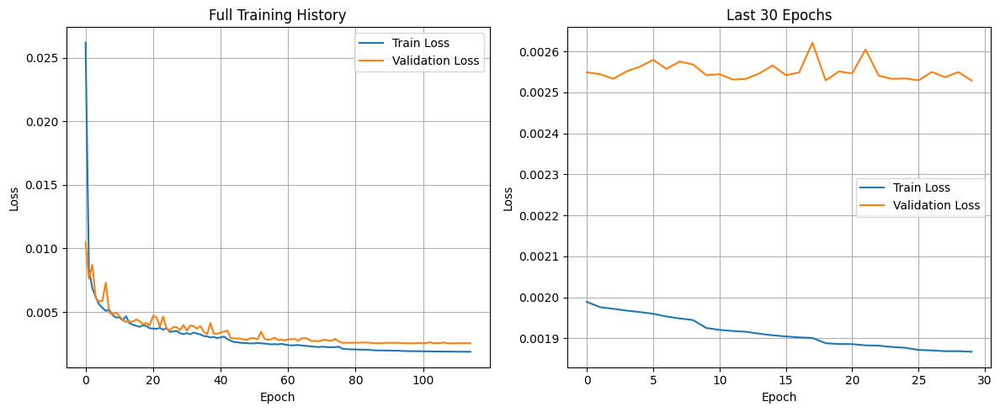


Training completed in 34.12 minutes
Best validation loss: 0.002529


In [23]:
# Run training if this cell is executed
if __name__ == "__main__":
   
    # Initialize model
    model = BaseAutoencoder(latent_dim=256)
    
    # Create configuration
    config = TrainingConfig(
    latent_dim=256,
    batch_size=8,              # Increased from 2 to 8
    accumulation_steps=8,      # Increased from 4 to 8 (effective batch size = 64)
    learning_rate=1e-4,
    epochs=200,
    early_stopping_patience=10,
    use_mixed_precision=True,
    num_workers=4,             # Increased from 2 to 4
    model_name="autoencoder_v1"
)
    
    # Train model
    print("\nStarting training...")
    train_losses, val_losses, trained_model = train_autoencoder(
        model, train_loader, val_loader, config
    )


### Evaluation and Result Visualization

In [21]:
# Cell 14: Updated Autoencoder Evaluation with Anatomical Slices
import torch
import matplotlib.pyplot as plt
import numpy as np
from pathlib import Path
import json
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import seaborn as sns
from tqdm import tqdm

def load_trained_model(checkpoint_dir, model_name, latent_dim=256):
    """Load best trained model for evaluation"""
    model_path = Path(checkpoint_dir) / f"{model_name}_best.pth"
    metadata_path = Path(checkpoint_dir) / f"{model_name}_metadata.json"

    if not model_path.exists():
        # Try loading checkpoint if best model doesn't exist
        model_path = Path(checkpoint_dir) / f"{model_name}_checkpoint.pth"
        if not model_path.exists():
            raise FileNotFoundError(f"No model found at {model_path}")

        # Load from checkpoint
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        model = BaseAutoencoder(latent_dim=latent_dim)
        checkpoint = torch.load(model_path, map_location=device)
        model.load_state_dict(checkpoint['model_state_dict'])
    else:
        # Load best model
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        model = BaseAutoencoder(latent_dim=latent_dim)
        model.load_state_dict(torch.load(model_path, map_location=device))

    # Load training history
    if metadata_path.exists():
        with open(metadata_path, 'r') as f:
            metadata = json.load(f)
    else:
        metadata = {"train_losses": [], "val_losses": []}

    model.eval()
    model.to(device)

    return model, metadata

def plot_training_history(metadata):
    """Plot training and validation loss history"""
    plt.figure(figsize=(12, 5))

    train_losses = metadata["train_losses"]
    val_losses = metadata["val_losses"]

    # Plot full history
    plt.subplot(1, 2, 1)
    plt.plot(train_losses, label='Train Loss')
    plt.plot(val_losses, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Full Training History')
    plt.legend()
    plt.grid(True)

    # Plot recent history (last 30 epochs or all if < 30)
    plt.subplot(1, 2, 2)
    recent = min(30, len(train_losses))
    if recent > 5:  # Only plot recent history if we have enough epochs
        plt.plot(train_losses[-recent:], label='Train Loss')
        plt.plot(val_losses[-recent:], label='Validation Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.title(f'Last {recent} Epochs')
        plt.legend()
        plt.grid(True)

    plt.tight_layout()
    plt.show()

def visualize_reconstruction_samples(model, dataloader, num_samples=3):
    """Visualize original vs reconstructed volumes for samples from the dataset using anatomically relevant slices"""
    device = next(model.parameters()).device

    # Get samples from dataloader
    samples = []
    labels = []

    for batch in dataloader:
        volumes = batch['volume']
        batch_labels = batch['label']

        for i in range(min(len(volumes), num_samples - len(samples))):
            samples.append(volumes[i:i+1])
            labels.append(batch_labels[i])

        if len(samples) >= num_samples:
            break

    # Visualize each sample
    with torch.no_grad():
        for idx, (sample, label) in enumerate(zip(samples, labels)):
            # Get original volume
            orig_vol = sample.to(device)

            # Generate reconstruction
            reconstructed = model(orig_vol)

            # Move to CPU for visualization
            orig_vol = orig_vol.cpu().squeeze().numpy()
            recon_vol = reconstructed.cpu().squeeze().numpy()

            # Create figure for this sample
            fig = plt.figure(figsize=(16, 12))
            plt.suptitle(f"Sample {idx+1} - Group: {label}", fontsize=16)

            # Define anatomically relevant slices
            axial_slice = 32      # Axial view - slice 32
            coronal_slice = 50    # Coronal view - slice 50
            sagittal_slice1 = 55  # Sagittal view - slice 55
            sagittal_slice2 = 70  # Sagittal view - slice 70

            # Plot original slices - top row
            plt.subplot(2, 4, 1)
            plt.imshow(orig_vol[axial_slice], cmap='gray', vmin=0, vmax=3)
            plt.title(f"Original - Axial (z={axial_slice})")
            plt.axis('off')
            
            plt.subplot(2, 4, 2)
            plt.imshow(orig_vol[:, coronal_slice, :], cmap='gray', vmin=0, vmax=3)
            plt.title(f"Original - Coronal (y={coronal_slice})")
            plt.axis('off')
            
            plt.subplot(2, 4, 3)
            plt.imshow(orig_vol[:, :, sagittal_slice1], cmap='gray', vmin=0, vmax=3)
            plt.title(f"Original - Sagittal (x={sagittal_slice1})")
            plt.axis('off')
            
            plt.subplot(2, 4, 4)
            plt.imshow(orig_vol[:, :, sagittal_slice2], cmap='gray', vmin=0, vmax=3)
            plt.title(f"Original - Sagittal (x={sagittal_slice2})")
            plt.axis('off')
            
            # Plot reconstructed slices - bottom row
            plt.subplot(2, 4, 5)
            plt.imshow(recon_vol[axial_slice], cmap='gray', vmin=0, vmax=3)
            plt.title(f"Reconstructed - Axial (z={axial_slice})")
            plt.axis('off')
            
            plt.subplot(2, 4, 6)
            plt.imshow(recon_vol[:, coronal_slice, :], cmap='gray', vmin=0, vmax=3)
            plt.title(f"Reconstructed - Coronal (y={coronal_slice})")
            plt.axis('off')
            
            plt.subplot(2, 4, 7)
            plt.imshow(recon_vol[:, :, sagittal_slice1], cmap='gray', vmin=0, vmax=3)
            plt.title(f"Reconstructed - Sagittal (x={sagittal_slice1})")
            plt.axis('off')
            
            plt.subplot(2, 4, 8)
            plt.imshow(recon_vol[:, :, sagittal_slice2], cmap='gray', vmin=0, vmax=3)
            plt.title(f"Reconstructed - Sagittal (x={sagittal_slice2})")
            plt.axis('off')

            plt.tight_layout()
            plt.show()

def compute_reconstruction_error(model, dataloader):
    """Compute detailed reconstruction error metrics on validation set"""
    device = next(model.parameters()).device
    criterion = nn.MSELoss(reduction='none')

    total_mse = 0
    total_samples = 0
    error_by_label = {}

    with torch.no_grad():
        for batch in tqdm(dataloader, desc="Computing metrics"):
            volumes = batch['volume'].to(device)
            labels = batch['label']

            # Get reconstructions
            reconstructed = model(volumes)

            # Compute MSE loss per sample
            mse = criterion(reconstructed, volumes)

            # Average over dimensions
            mse = mse.mean(dim=(1, 2, 3, 4)).cpu().numpy()

            # Track overall error
            total_mse += mse.sum()
            total_samples += volumes.shape[0]

            # Track error by label
            for i, label in enumerate(labels):
                if label not in error_by_label:
                    error_by_label[label] = []
                error_by_label[label].append(mse[i])

            # Memory cleanup
            del volumes, reconstructed, mse
            torch.cuda.empty_cache()

    # Calculate overall metrics
    avg_mse = total_mse / total_samples
    rmse = np.sqrt(avg_mse)

    print("\nReconstruction Error Metrics:")
    print(f"Overall MSE: {avg_mse:.6f}")
    print(f"Overall RMSE: {rmse:.6f}")

    # Calculate metrics by group
    print("\nReconstruction Error by Group:")
    for label, errors in error_by_label.items():
        group_mse = np.mean(errors)
        group_rmse = np.sqrt(group_mse)
        group_std = np.std(errors)
        print(f"{label}:")
        print(f"  MSE: {group_mse:.6f} ± {group_std:.6f}")
        print(f"  RMSE: {group_rmse:.6f}")

    # Plot error distribution by group
    plt.figure(figsize=(10, 6))
    for label, errors in error_by_label.items():
        sns.histplot(errors, alpha=0.5, label=label, bins=20, kde=True)

    plt.title("Reconstruction Error Distribution by Group")
    plt.xlabel("Mean Squared Error")
    plt.ylabel("Count")
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.show()

    return avg_mse, error_by_label

def extract_latent_vectors(model, dataloader, max_samples=None):
    """Extract latent vectors from all samples in the dataloader"""
    device = next(model.parameters()).device

    latent_vectors = []
    labels = []
    paths = []

    with torch.no_grad():
        for batch in tqdm(dataloader, desc="Extracting latent vectors"):
            volumes = batch['volume'].to(device)
            batch_labels = batch['label']
            batch_paths = batch['path']

            # Extract latent vectors
            z = model.encode(volumes)

            # Store results
            latent_vectors.append(z.cpu().numpy())
            labels.extend(batch_labels)
            paths.extend(batch_paths)

            # Memory cleanup
            del volumes, z
            torch.cuda.empty_cache()

            # Check if we have enough samples
            if max_samples and len(labels) >= max_samples:
                latent_vectors = np.vstack(latent_vectors)
                latent_vectors = latent_vectors[:max_samples]
                labels = labels[:max_samples]
                paths = paths[:max_samples]
                break

    # Stack all latent vectors if we didn't break early
    if isinstance(latent_vectors[0], np.ndarray):
        latent_vectors = np.vstack(latent_vectors)

    return latent_vectors, labels, paths

def visualize_latent_space(latent_vectors, labels, method='tsne'):
    """Visualize latent space using t-SNE or PCA"""
    plt.figure(figsize=(10, 8))

    # Create label-to-color mapping for consistent colors
    unique_labels = list(set(labels))
    colors = plt.cm.tab10(np.linspace(0, 1, len(unique_labels)))
    label_to_color = {label: colors[i] for i, label in enumerate(unique_labels)}

    # Apply dimensionality reduction
    if method.lower() == 'tsne':
        print("Computing t-SNE projection...")
        reducer = TSNE(n_components=2, random_state=42, perplexity=min(30, len(latent_vectors) - 1))
        title = 't-SNE Visualization of Latent Space'
    else:
        print("Computing PCA projection...")
        reducer = PCA(n_components=2, random_state=42)
        title = 'PCA Visualization of Latent Space'

    # Apply reduction
    reduced_vecs = reducer.fit_transform(latent_vectors)

    # Create scatter plot
    for label in unique_labels:
        # Get indices where this label appears
        indices = [i for i, l in enumerate(labels) if l == label]

        # Plot these points
        plt.scatter(
            reduced_vecs[indices, 0],
            reduced_vecs[indices, 1],
            label=label,
            color=label_to_color[label],
            alpha=0.7,
            edgecolor='w',
            s=100
        )

    plt.title(title, fontsize=14)
    plt.xlabel("Dimension 1", fontsize=12)
    plt.ylabel("Dimension 2", fontsize=12)
    plt.legend(title="Group", fontsize=10)
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()

    return reduced_vecs

def plot_latent_dimension_activation(latent_vectors, labels):
    """Analyze activation patterns of latent dimensions"""
    # Create a DataFrame with latent dimensions and labels
    import pandas as pd

    # First, convert labels to categorical for better plotting
    unique_labels = list(set(labels))
    label_map = {label: i for i, label in enumerate(unique_labels)}
    label_indices = [label_map[label] for label in labels]

    # Create DataFrames
    latent_df = pd.DataFrame(latent_vectors)
    latent_df['label'] = labels

    # Compute mean activation by group
    mean_activations = {}
    for label in unique_labels:
        group_vectors = latent_vectors[np.array(labels) == label]
        mean_activations[label] = np.mean(group_vectors, axis=0)

    # Identify top discriminative dimensions
    activation_matrix = np.vstack([mean_activations[label] for label in unique_labels])
    variance = np.var(activation_matrix, axis=0)
    top_dims = np.argsort(variance)[-10:]  # Top 10 dimensions

    # Plot mean activation for top dimensions
    plt.figure(figsize=(14, 6))

    # Plot heatmap
    plt.subplot(1, 2, 1)
    heatmap_data = pd.DataFrame({
        f"Dim {i}": [mean_activations[label][i] for label in unique_labels]
        for i in top_dims
    })
    heatmap_data.index = unique_labels

    sns.heatmap(heatmap_data, cmap='coolwarm', center=0,
               annot=True, fmt=".2f", cbar_kws={'label': 'Mean Activation'})
    plt.title("Mean Activation of Top Discriminative Dimensions")

    # Plot box plots for top 5 dimensions
    plt.subplot(1, 2, 2)

    # Create data for boxplot
    plot_data = []
    labels_for_plot = []
    positions = []

    for i, dim in enumerate(top_dims[:5]):  # Top 5 for clarity
        for j, label in enumerate(unique_labels):
            group_values = latent_vectors[np.array(labels) == label, dim]
            plot_data.append(group_values)
            labels_for_plot.append(f"{label}")
            positions.append(i + j * 0.25)

    # Create boxplot
    boxplot = plt.boxplot(plot_data, positions=positions, patch_artist=True, widths=0.15)

    # Customize boxplot colors
    colors = plt.cm.tab10(np.linspace(0, 1, len(unique_labels)))
    for i, label in enumerate(unique_labels):
        indices = [j for j, l in enumerate(labels_for_plot) if l == label]
        for idx in indices:
            boxplot['boxes'][idx].set_facecolor(colors[i])

    # Add labels and ticks
    plt.xticks([i + (len(unique_labels) - 1) * 0.125 for i in range(5)],
              [f"Dim {d}" for d in top_dims[:5]])
    plt.title("Distribution of Top 5 Discriminative Dimensions")
    plt.ylabel("Activation Value")

    # Add legend
    for i, label in enumerate(unique_labels):
        plt.plot([], [], 'o', color=colors[i], label=label)
    plt.legend(title="Group")

    plt.tight_layout()
    plt.show()

    return top_dims

def find_outliers(model, dataloader, threshold_std=2.5):
    """Identify outliers based on reconstruction error"""
    device = next(model.parameters()).device
    criterion = nn.MSELoss(reduction='none')

    all_errors = []
    all_paths = []
    all_labels = []

    with torch.no_grad():
        for batch in tqdm(dataloader, desc="Finding outliers"):
            volumes = batch['volume'].to(device)
            paths = batch['path']
            labels = batch['label']

            # Get reconstructions
            reconstructed = model(volumes)

            # Compute MSE loss per sample
            mse = criterion(reconstructed, volumes)

            # Average over dimensions
            mse = mse.mean(dim=(1, 2, 3, 4)).cpu().numpy()

            # Store results
            all_errors.extend(mse)
            all_paths.extend(paths)
            all_labels.extend(labels)

            # Memory cleanup
            del volumes, reconstructed, mse
            torch.cuda.empty_cache()

    # Convert to numpy arrays
    all_errors = np.array(all_errors)

    # Compute statistics
    mean_error = np.mean(all_errors)
    std_error = np.std(all_errors)

    # Find outliers (samples with error > mean + threshold_std * std)
    threshold = mean_error + threshold_std * std_error
    outlier_indices = np.where(all_errors > threshold)[0]

    print(f"\nOutlier Analysis:")
    print(f"Mean error: {mean_error:.6f}")
    print(f"Error standard deviation: {std_error:.6f}")
    print(f"Outlier threshold: {threshold:.6f}")
    print(f"Found {len(outlier_indices)} outliers out of {len(all_errors)} samples ({len(outlier_indices)/len(all_errors)*100:.2f}%)")

    # Create dictionary of outliers
    outliers = {
        all_paths[i]: {
            'error': all_errors[i],
            'label': all_labels[i],
            'z_score': (all_errors[i] - mean_error) / std_error
        }
        for i in outlier_indices
    }

    # Plot error distribution with outlier threshold
    plt.figure(figsize=(10, 6))
    plt.hist(all_errors, bins=30, alpha=0.7)
    plt.axvline(threshold, color='r', linestyle='--', label=f'Threshold ({threshold_std} std)')
    plt.title("Reconstruction Error Distribution")
    plt.xlabel("Mean Squared Error")
    plt.ylabel("Count")
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.show()

    return outliers, all_errors, all_paths, all_labels

def visualize_outliers(model, outliers, threshold=0.01):
    """Visualize the top outliers with highest reconstruction error using anatomically relevant slices"""
    device = next(model.parameters()).device

    # Sort outliers by error (descending)
    sorted_outliers = sorted(outliers.items(), key=lambda x: x[1]['error'], reverse=True)

    # Visualize top outliers
    num_outliers = min(5, len(sorted_outliers))

    for i in range(num_outliers):
        path, info = sorted_outliers[i]
        error = info['error']
        label = info['label']
        z_score = info['z_score']

        try:
            # Load the original volume
            with torch.no_grad():
                # Load DICOM file
                original_volume, _ = load_dicom(path)
                original_volume = original_volume[9:73, :, :]

                # Process volume
                norm_vol, _, _ = process_volume(original_volume, target_shape=(64, 128, 128))

                # Convert to tensor and add batch dimension
                vol_tensor = torch.from_numpy(np.expand_dims(norm_vol, axis=(0, 1))).float().to(device)

                # Get reconstruction
                reconstructed = model(vol_tensor)

                # Move tensors to CPU and remove batch and channel dimensions
                vol_np = vol_tensor.cpu().squeeze().numpy()
                recon_np = reconstructed.cpu().squeeze().numpy()

                # Create figure
                fig = plt.figure(figsize=(16, 12))
                plt.suptitle(f"Outlier {i+1}: {path.split('/')[-1]}\nGroup: {label}, Error: {error:.6f}, Z-score: {z_score:.2f}", fontsize=14)

                # Define anatomically relevant slices
                axial_slice = 32      # Axial view - slice 32
                coronal_slice = 50    # Coronal view - slice 50
                sagittal_slice1 = 55  # Sagittal view - slice 55
                sagittal_slice2 = 70  # Sagittal view - slice 70
                
                # Plot original slices - top row
                plt.subplot(2, 4, 1)
                plt.imshow(vol_np[axial_slice], cmap='gray', vmin=0, vmax=3)
                plt.title(f"Original - Axial (z={axial_slice})")
                plt.axis('off')
                
                plt.subplot(2, 4, 2)
                plt.imshow(vol_np[:, coronal_slice, :], cmap='gray', vmin=0, vmax=3)
                plt.title(f"Original - Coronal (y={coronal_slice})")
                plt.axis('off')
                
                plt.subplot(2, 4, 3)
                plt.imshow(vol_np[:, :, sagittal_slice1], cmap='gray', vmin=0, vmax=3)
                plt.title(f"Original - Sagittal (x={sagittal_slice1})")
                plt.axis('off')
                
                plt.subplot(2, 4, 4)
                plt.imshow(vol_np[:, :, sagittal_slice2], cmap='gray', vmin=0, vmax=3)
                plt.title(f"Original - Sagittal (x={sagittal_slice2})")
                plt.axis('off')
                
                # Plot reconstructed slices - bottom row
                plt.subplot(2, 4, 5)
                plt.imshow(recon_np[axial_slice], cmap='gray', vmin=0, vmax=3)
                plt.title(f"Reconstructed - Axial (z={axial_slice})")
                plt.axis('off')
                
                plt.subplot(2, 4, 6)
                plt.imshow(recon_np[:, coronal_slice, :], cmap='gray', vmin=0, vmax=3)
                plt.title(f"Reconstructed - Coronal (y={coronal_slice})")
                plt.axis('off')
                
                plt.subplot(2, 4, 7)
                plt.imshow(recon_np[:, :, sagittal_slice1], cmap='gray', vmin=0, vmax=3)
                plt.title(f"Reconstructed - Sagittal (x={sagittal_slice1})")
                plt.axis('off')
                
                plt.subplot(2, 4, 8)
                plt.imshow(recon_np[:, :, sagittal_slice2], cmap='gray', vmin=0, vmax=3)
                plt.title(f"Reconstructed - Sagittal (x={sagittal_slice2})")
                plt.axis('off')

                plt.tight_layout()
                plt.show()

        except Exception as e:
            print(f"Error visualizing outlier {path}: {e}")

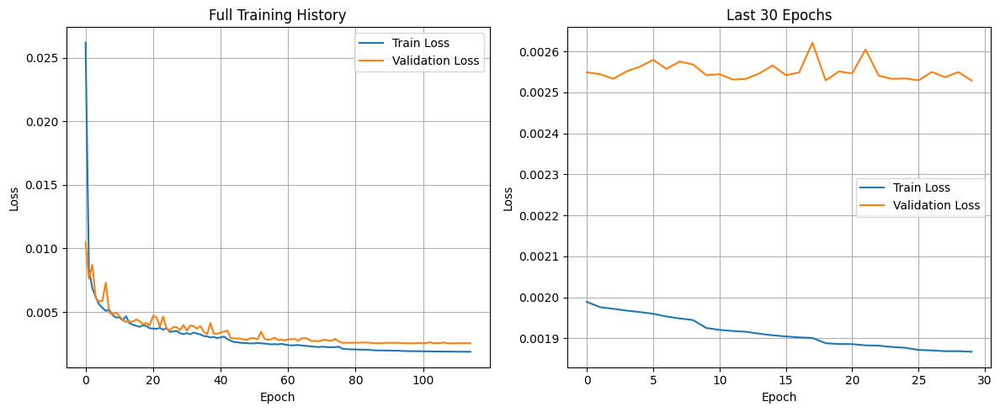

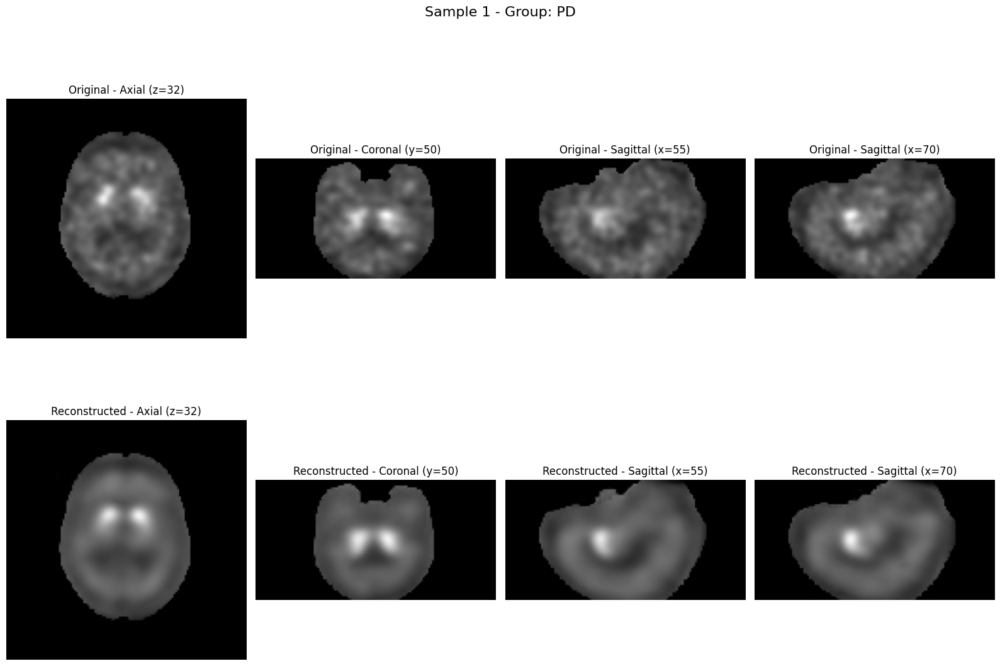

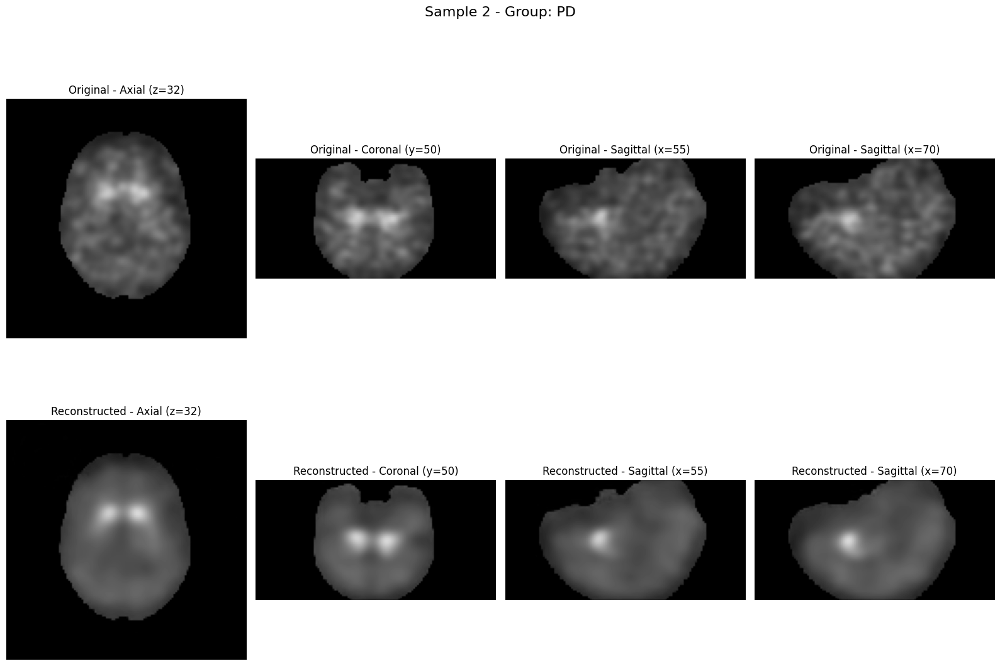

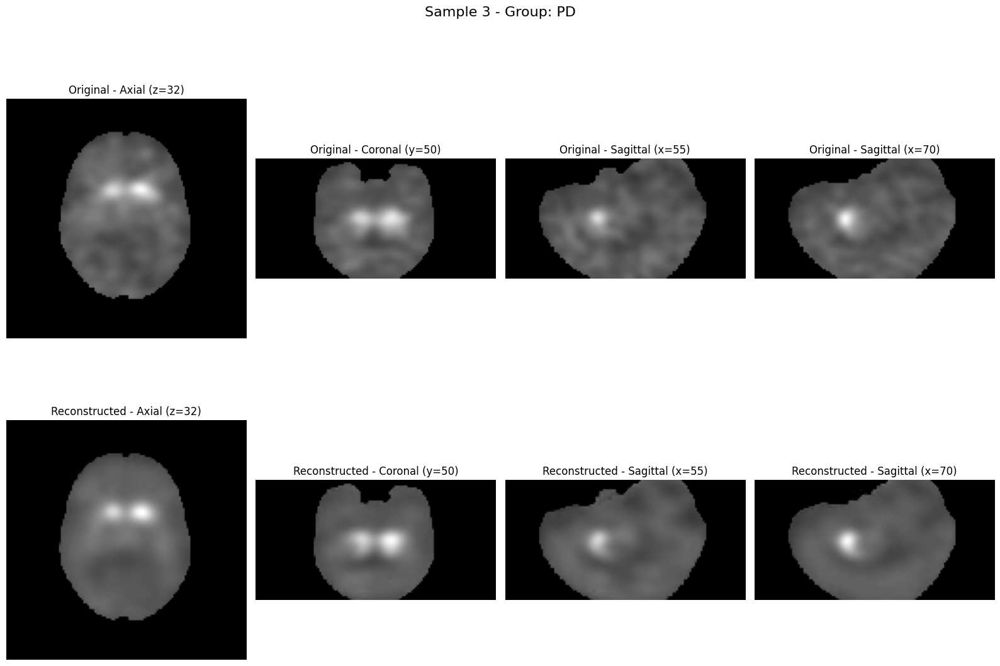

Computing metrics:   4%|▍         | 13/299 [00:00<00:18, 15.19it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Computing metrics:  21%|██▏       | 64/299 [00:04<00:14, 15.91it/s]

Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Computing metrics:  49%|████▉     | 148/299 [00:11<00:39,  3.80it/s]

Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Computing metrics: 100%|██████████| 299/299 [00:21<00:00, 13.92it/s]



Reconstruction Error Metrics:
Overall MSE: 0.002529
Overall RMSE: 0.050288

Reconstruction Error by Group:
PD:
  MSE: 0.002478 ± 0.001453
  RMSE: 0.049777
Control:
  MSE: 0.002993 ± 0.001062
  RMSE: 0.054708
SWEDD:
  MSE: 0.002484 ± 0.001289
  RMSE: 0.049837


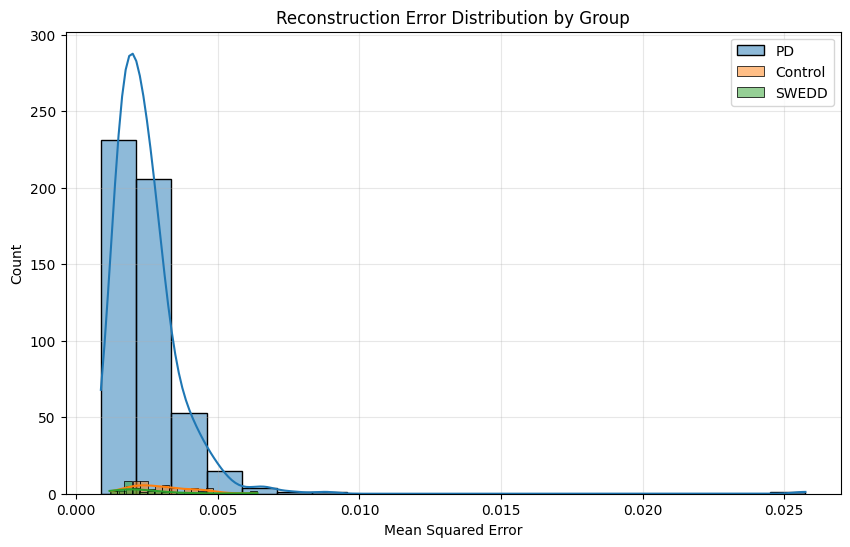

Extracting latent vectors:   5%|▍         | 14/299 [00:00<00:13, 20.63it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Extracting latent vectors:  21%|██        | 62/299 [00:03<00:11, 20.81it/s]

Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Extracting latent vectors:  33%|███▎      | 99/299 [00:05<00:11, 17.73it/s]


Computing t-SNE projection...


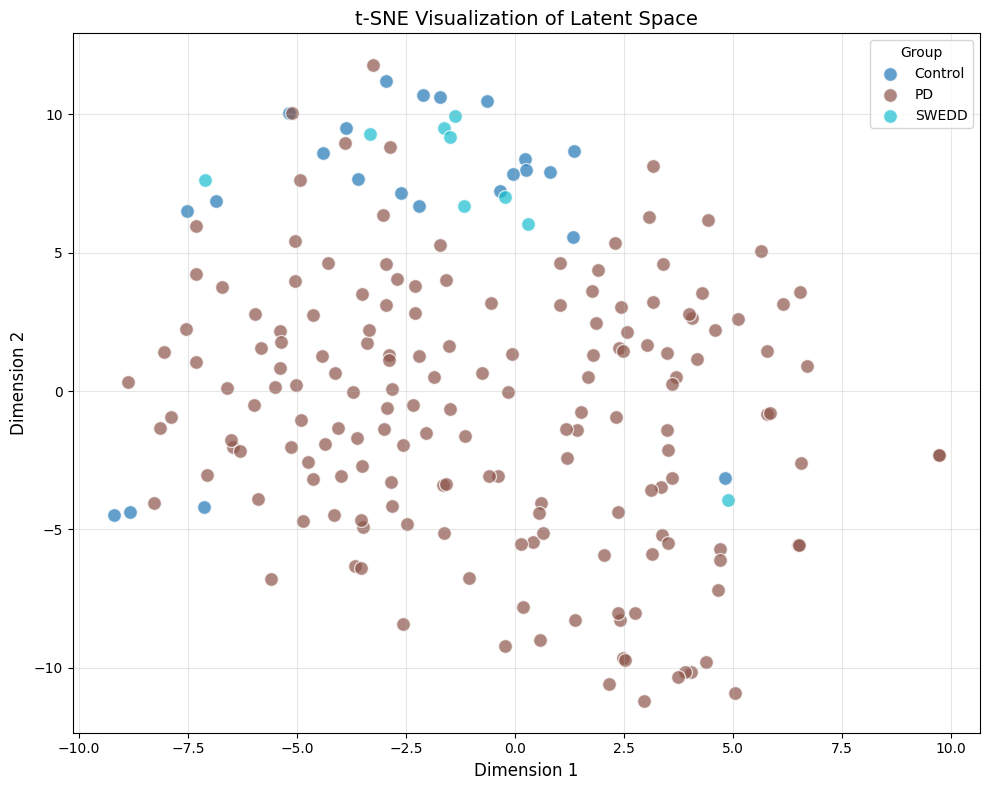

Computing PCA projection...


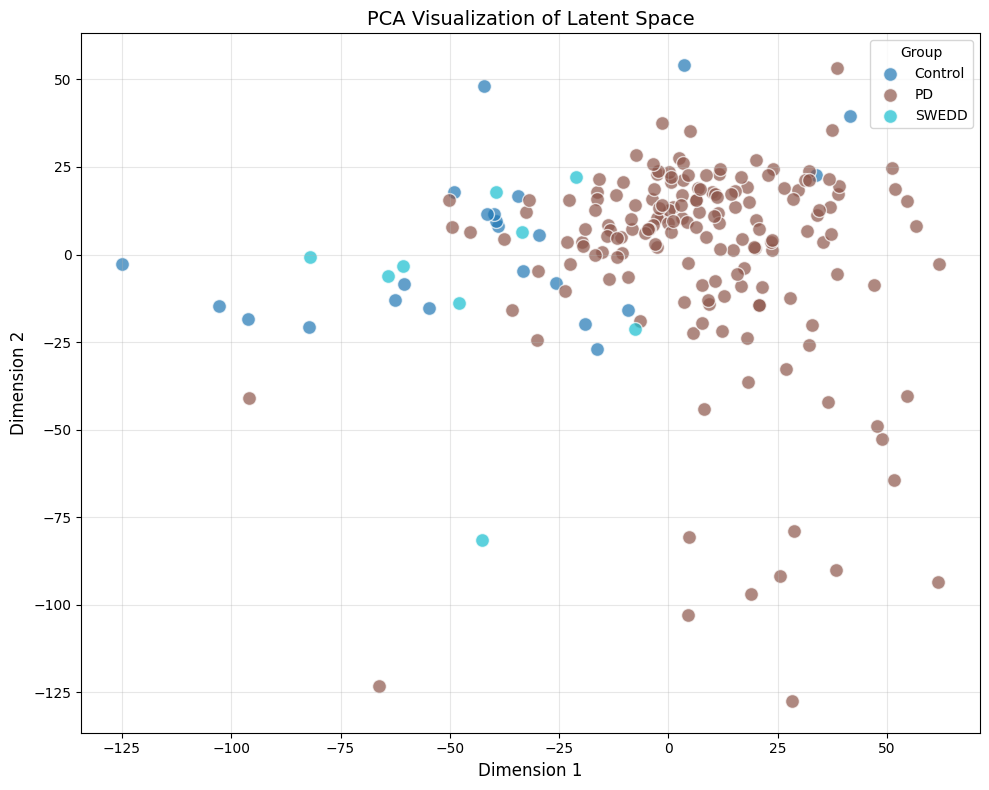

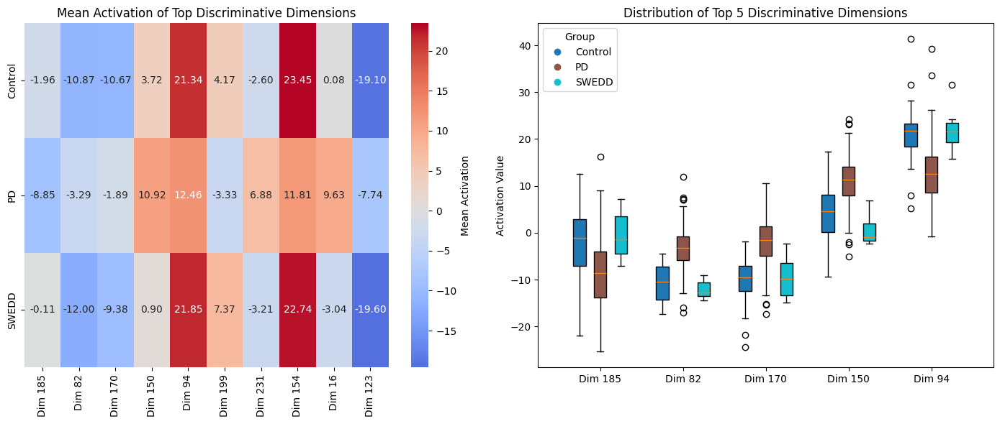

Finding outliers:   4%|▍         | 12/299 [00:00<00:16, 17.02it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Finding outliers:  21%|██        | 63/299 [00:03<00:11, 19.97it/s]

Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Finding outliers:  48%|████▊     | 145/299 [00:07<00:08, 18.50it/s]

Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Finding outliers: 100%|██████████| 299/299 [00:18<00:00, 15.99it/s]



Outlier Analysis:
Mean error: 0.002529
Error standard deviation: 0.001420
Outlier threshold: 0.006079
Found 10 outliers out of 598 samples (1.67%)


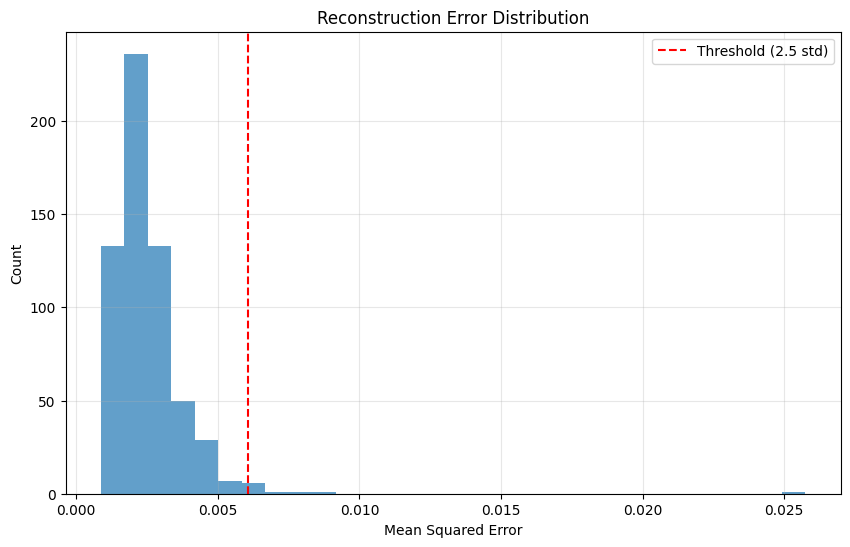

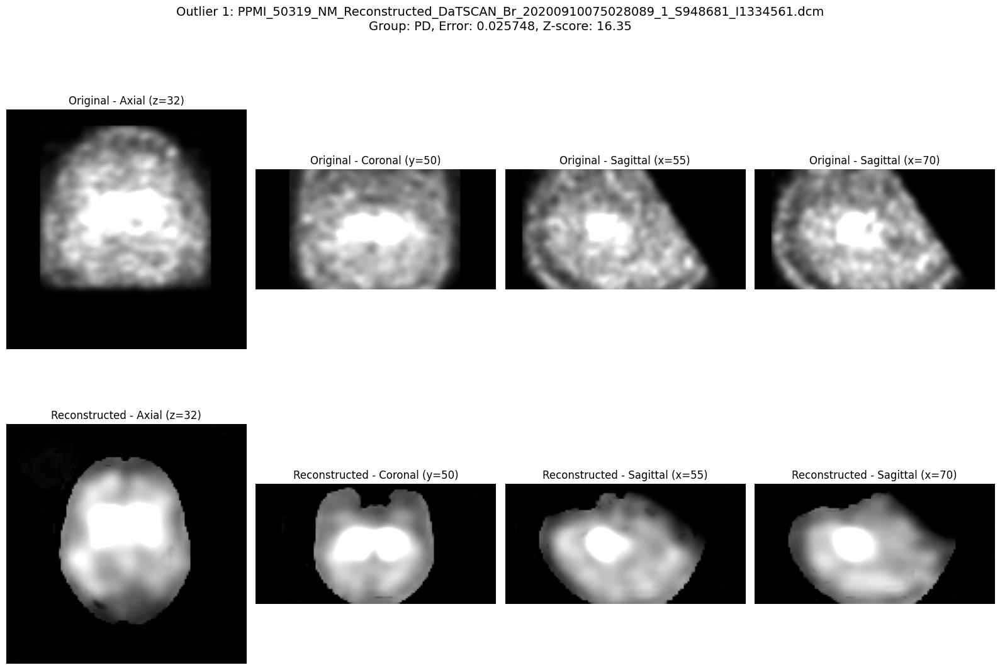

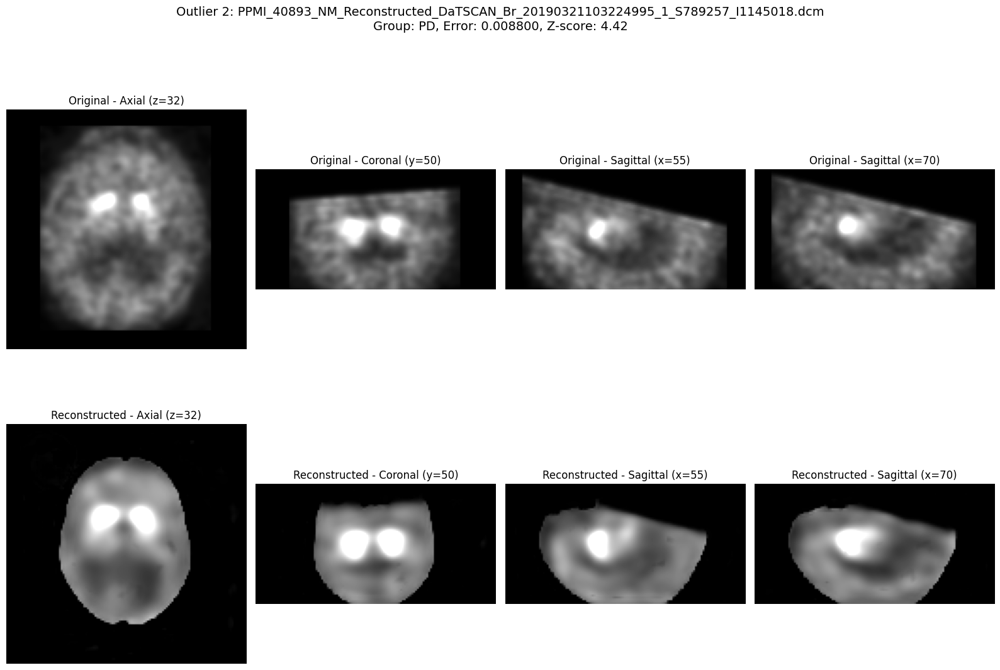

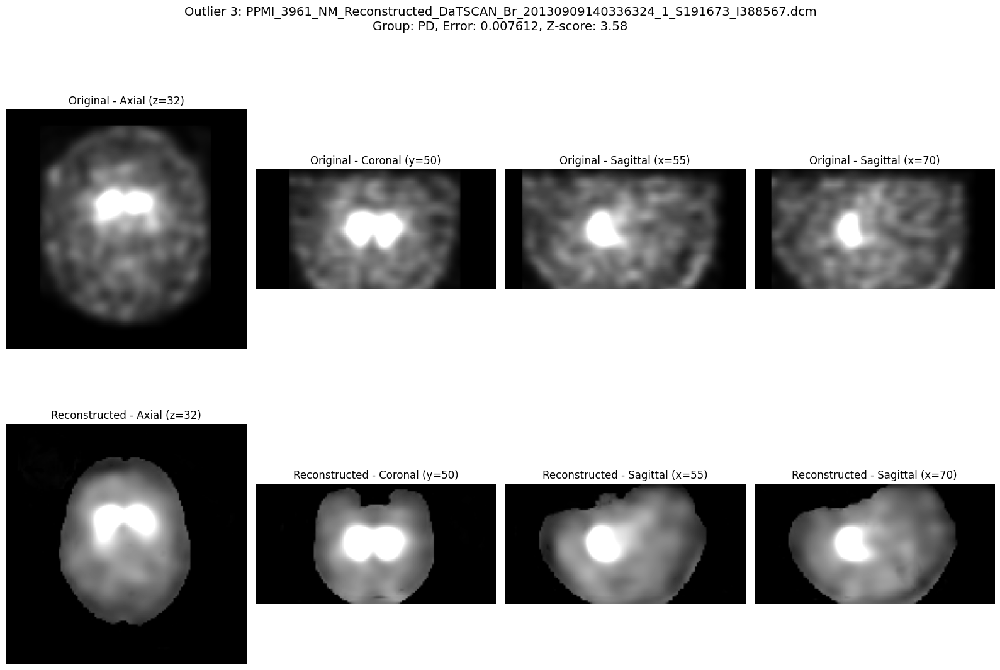

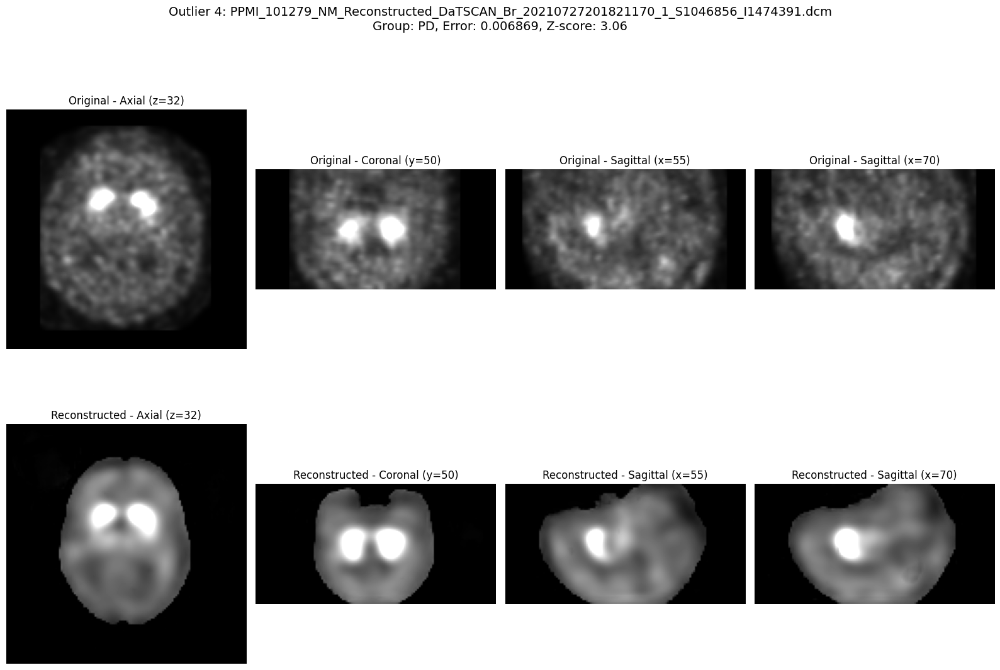

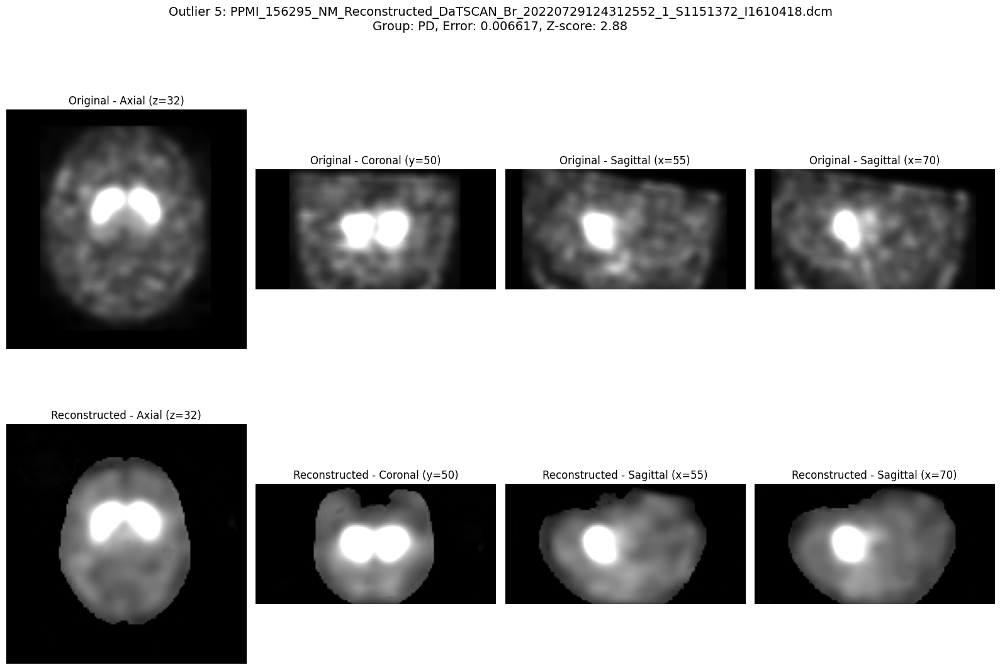

In [22]:
# Run evaluation if this cell is executed
if __name__ == "__main__":
    # Load model and metadata
    model, metadata = load_trained_model('checkpoints', 'autoencoder_v1', latent_dim=256)

    # Plot training history
    plot_training_history(metadata)

    # Visualize reconstructions
    visualize_reconstruction_samples(model, val_loader, num_samples=3)

    # Compute reconstruction error
    avg_mse, error_by_label = compute_reconstruction_error(model, val_loader)

    # Extract and visualize latent space
    latent_vectors, labels, paths = extract_latent_vectors(model, val_loader, max_samples=200)
    reduced_vecs = visualize_latent_space(latent_vectors, labels, method='tsne')
    reduced_vecs = visualize_latent_space(latent_vectors, labels, method='pca')

    # Analyze latent dimensions
    top_dims = plot_latent_dimension_activation(latent_vectors, labels)

    # Find and visualize outliers
    outliers, all_errors, all_paths, all_labels = find_outliers(model, val_loader, threshold_std=2.5)
    visualize_outliers(model, outliers)

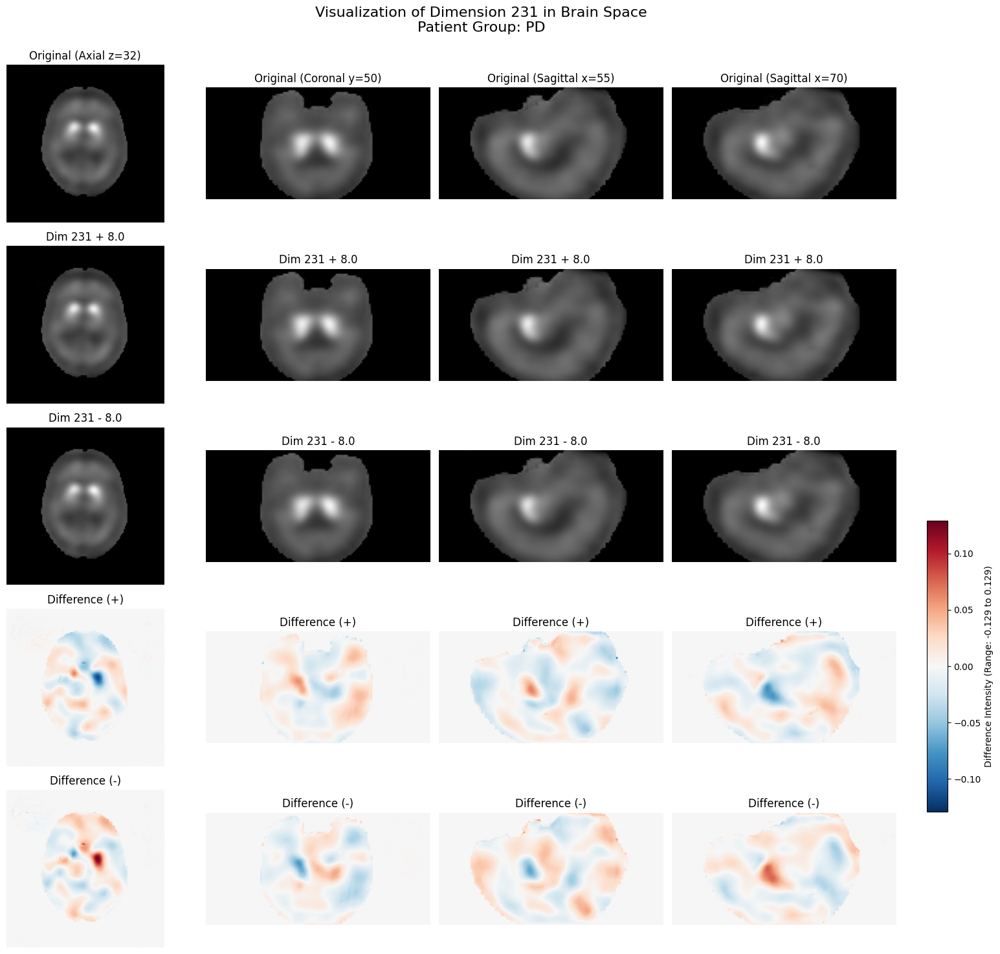

Brain Intensity Scale: 0 to 3
Difference Map Scale: -0.129 to 0.129

Exploring Dimension 231

Analyzing dimension 231 for group: PD (first pass)


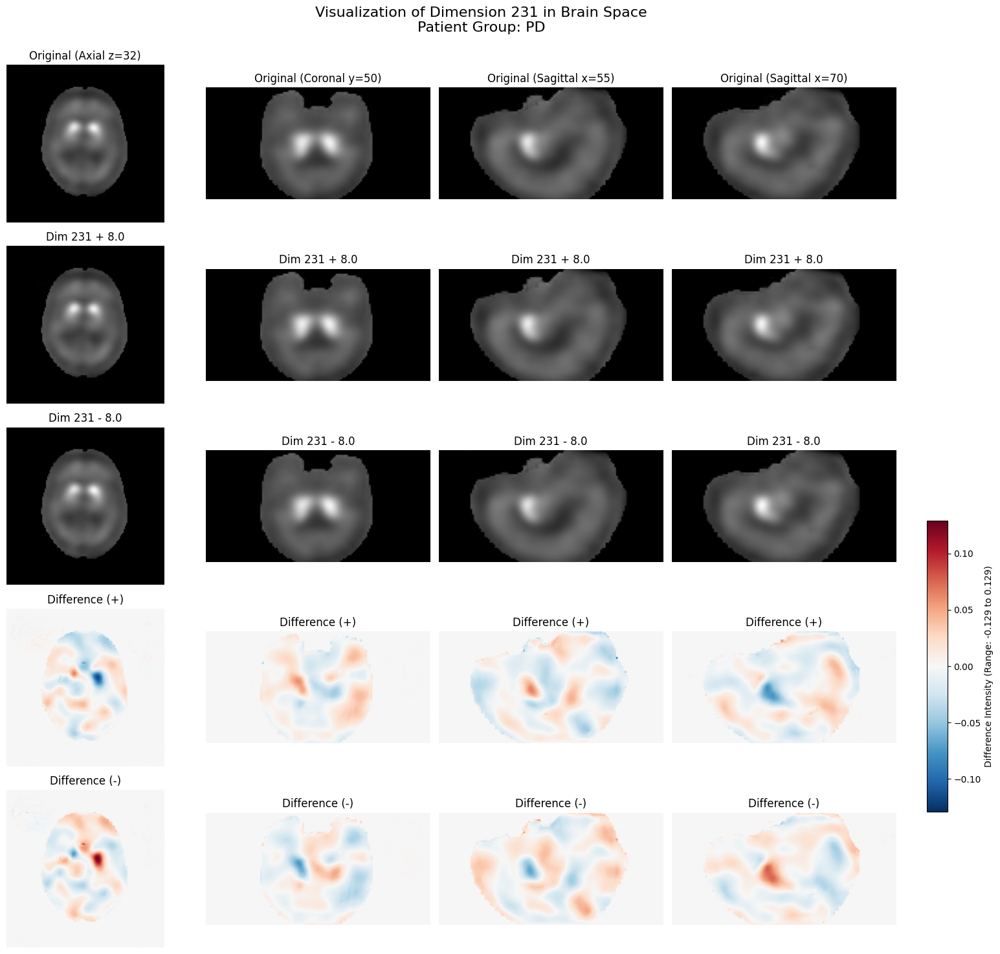

Brain Intensity Scale: 0 to 3
Difference Map Scale: -0.129 to 0.129

Analyzing dimension 231 for group: Control (first pass)


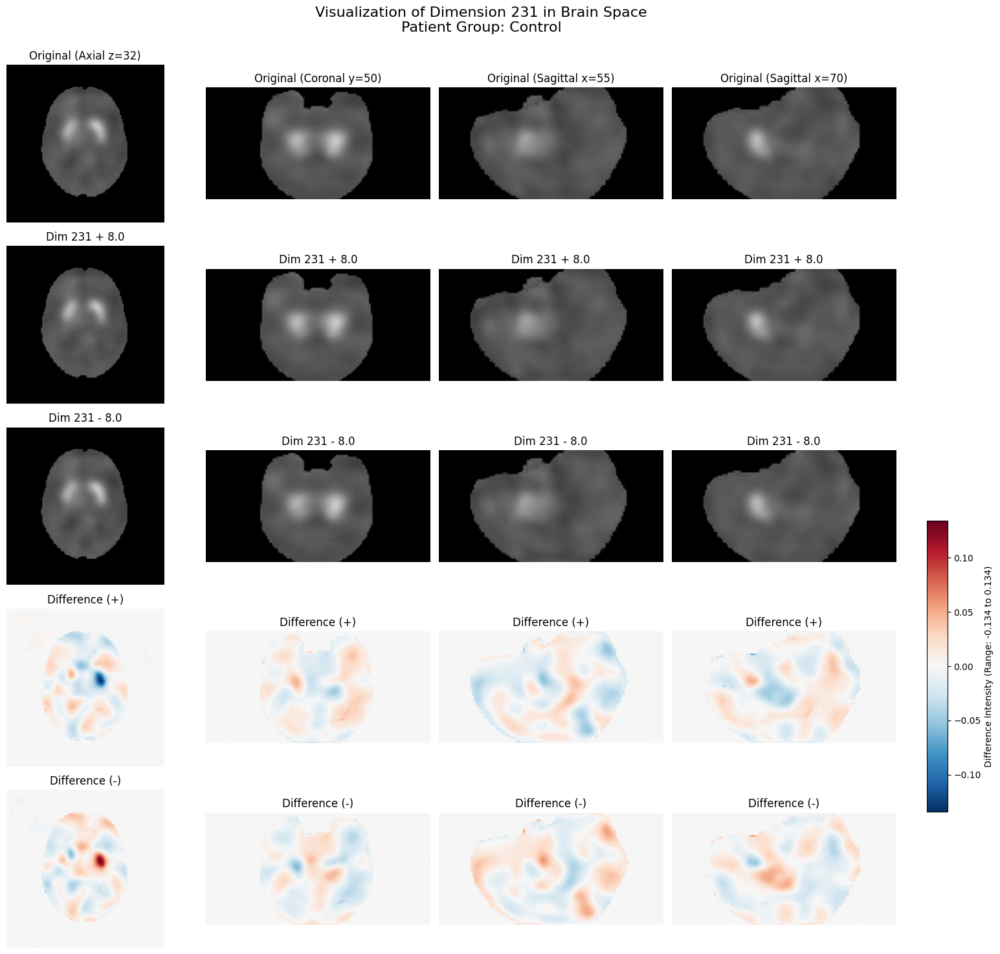

Brain Intensity Scale: 0 to 3
Difference Map Scale: -0.134 to 0.134

Analyzing dimension 231 for group: SWEDD (first pass)


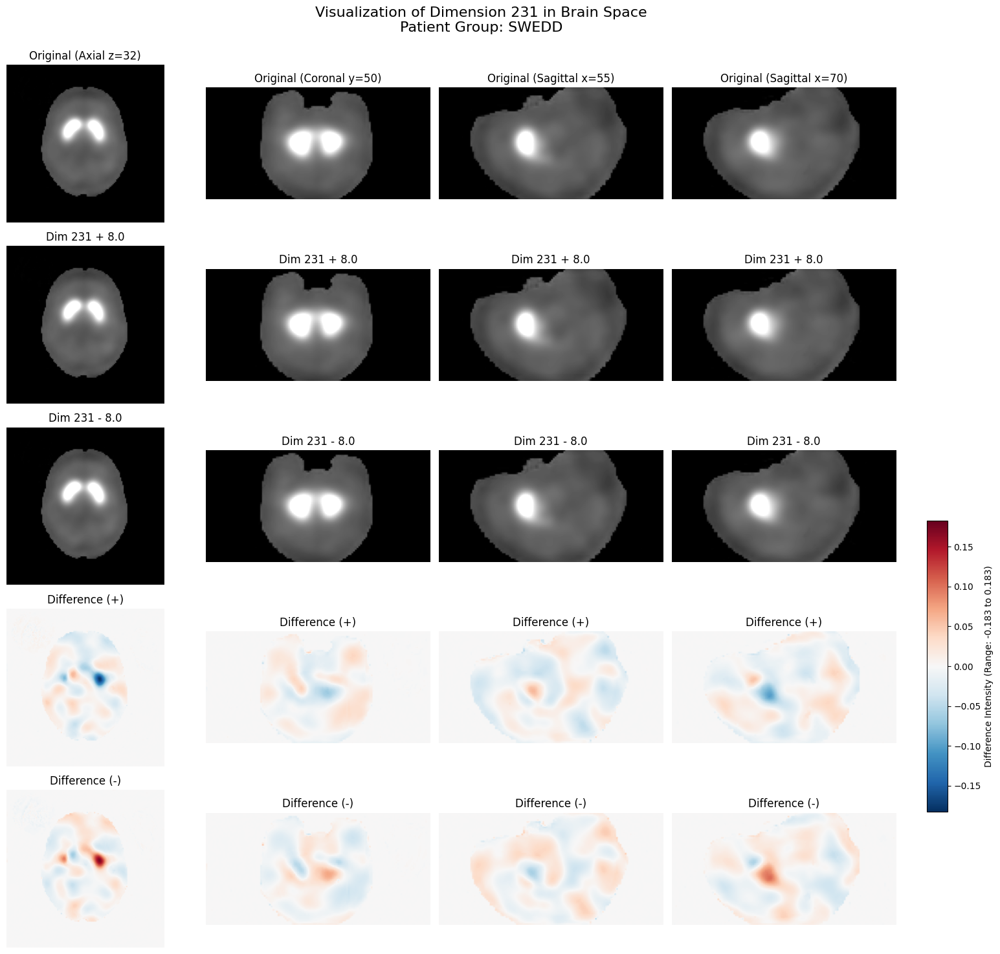

Brain Intensity Scale: 0 to 3
Difference Map Scale: -0.183 to 0.183

Global difference range for dimension 231 across all groups: -0.183 to 0.183

Exploring Dimension 94

Analyzing dimension 94 for group: PD (first pass)


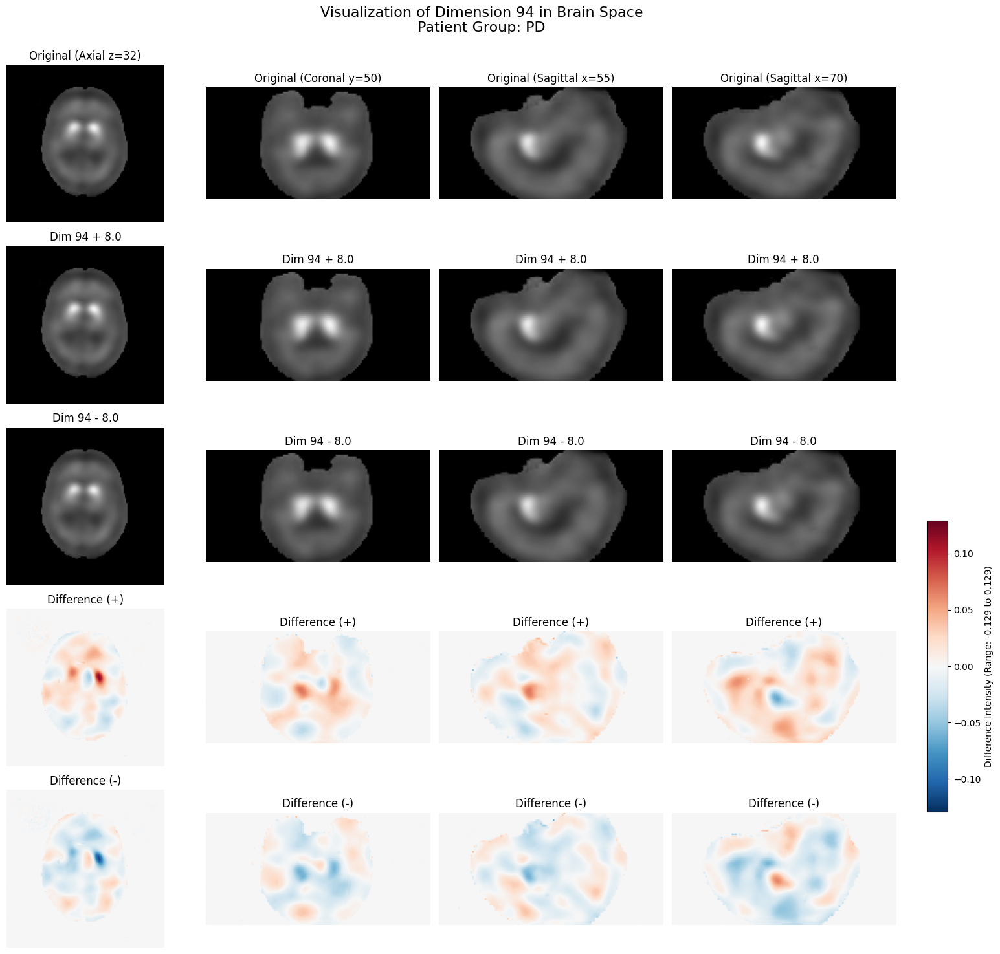

Brain Intensity Scale: 0 to 3
Difference Map Scale: -0.129 to 0.129

Analyzing dimension 94 for group: Control (first pass)


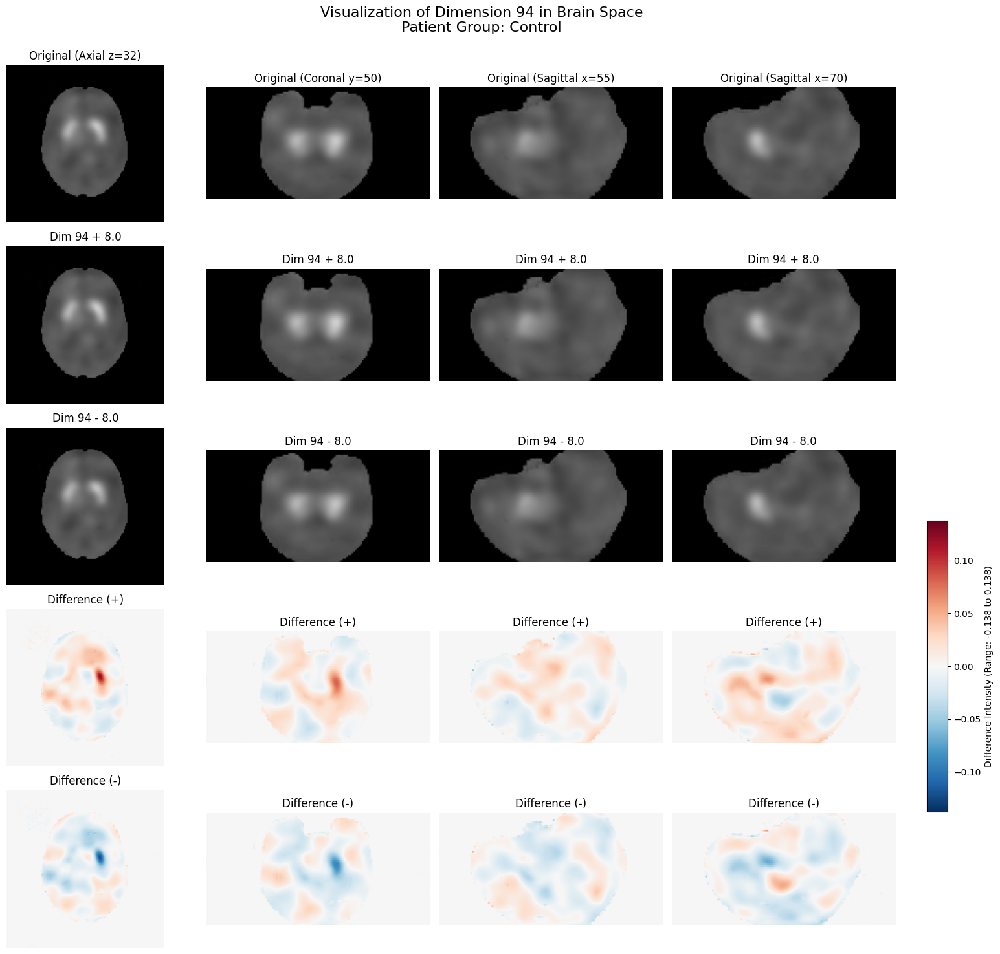

Brain Intensity Scale: 0 to 3
Difference Map Scale: -0.138 to 0.138

Analyzing dimension 94 for group: SWEDD (first pass)


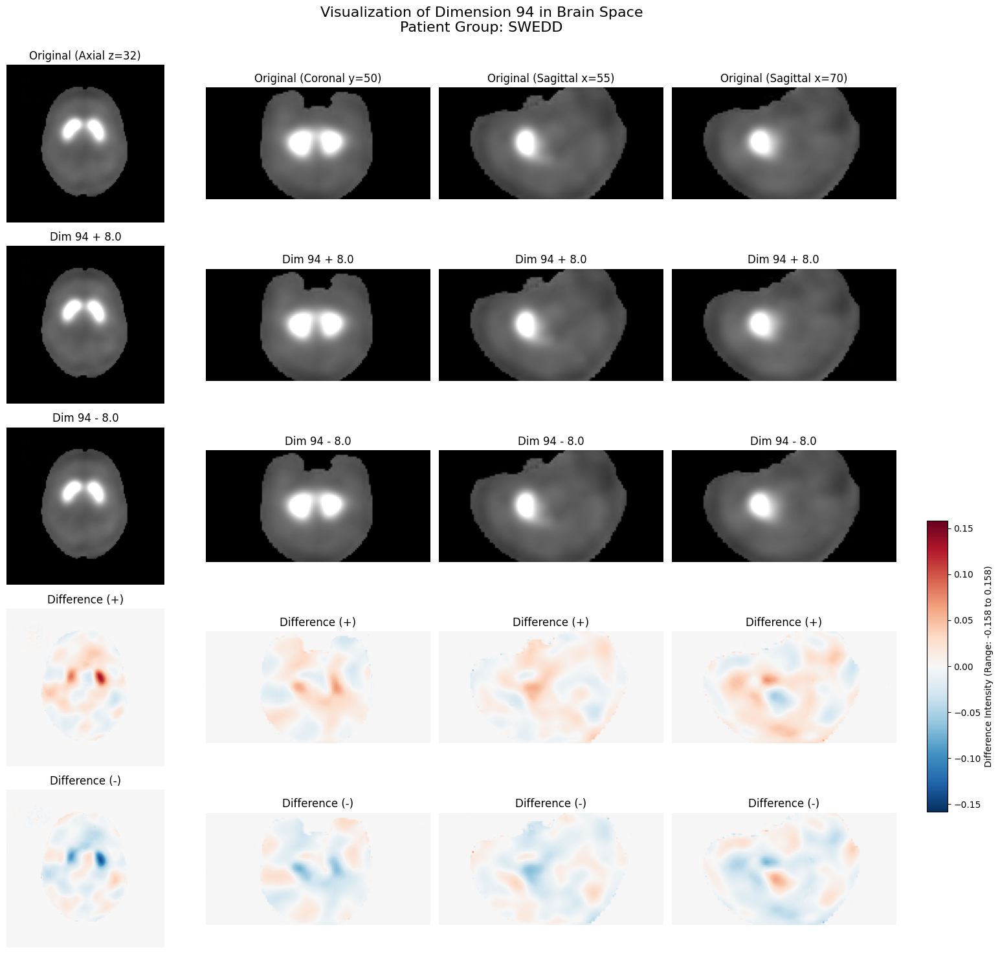

Brain Intensity Scale: 0 to 3
Difference Map Scale: -0.158 to 0.158

Global difference range for dimension 94 across all groups: -0.158 to 0.158

Exploring Dimension 154

Analyzing dimension 154 for group: PD (first pass)


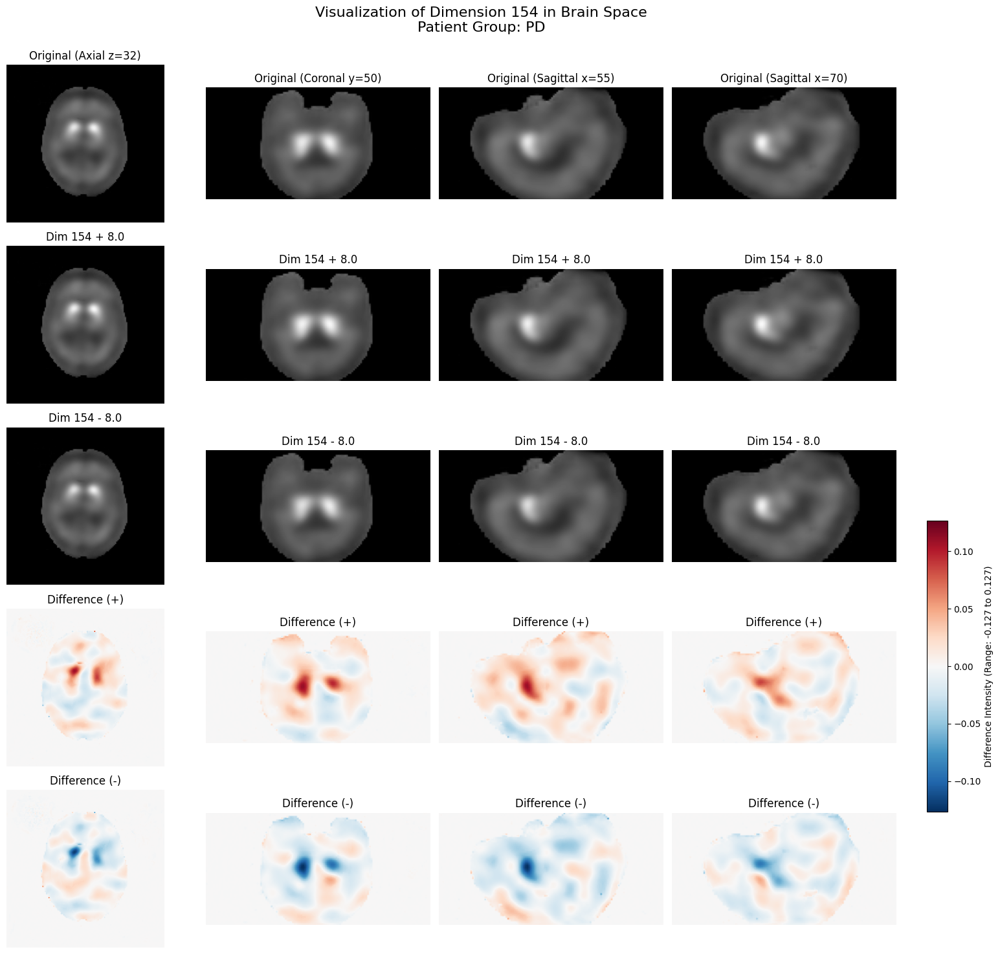

Brain Intensity Scale: 0 to 3
Difference Map Scale: -0.127 to 0.127

Analyzing dimension 154 for group: Control (first pass)


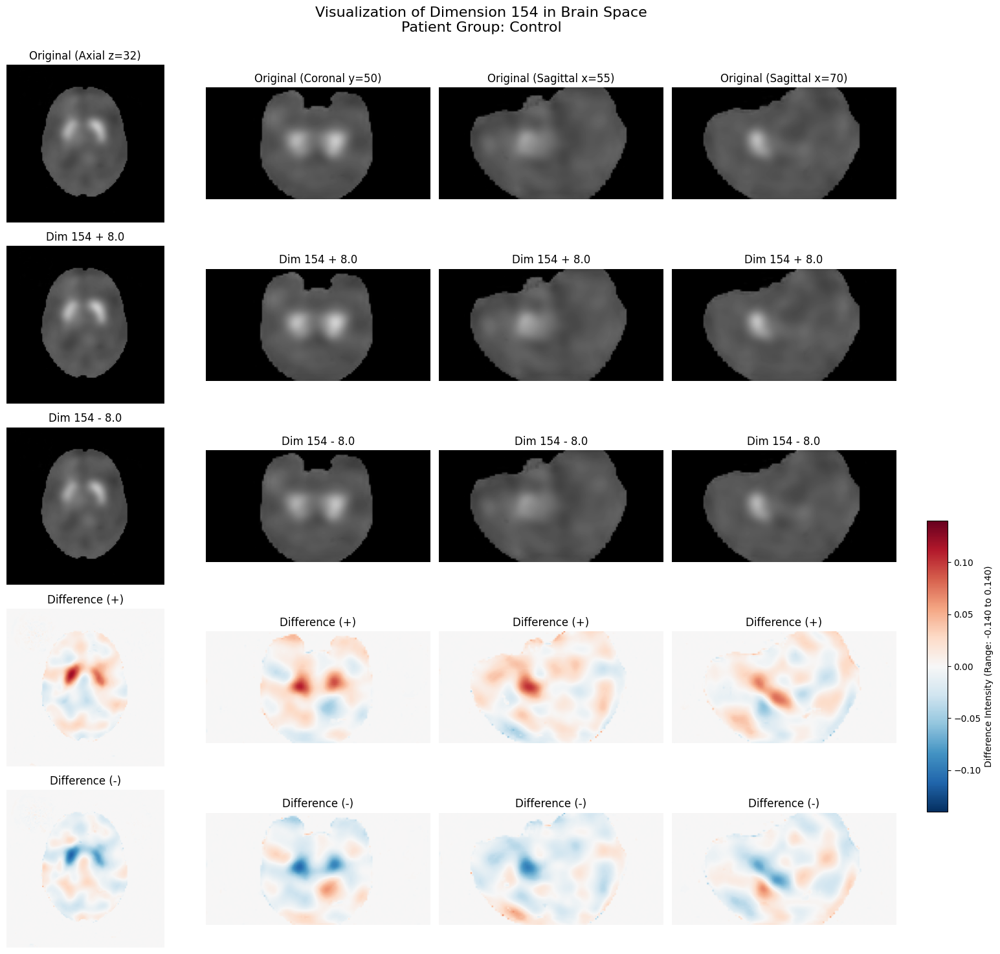

Brain Intensity Scale: 0 to 3
Difference Map Scale: -0.140 to 0.140

Analyzing dimension 154 for group: SWEDD (first pass)


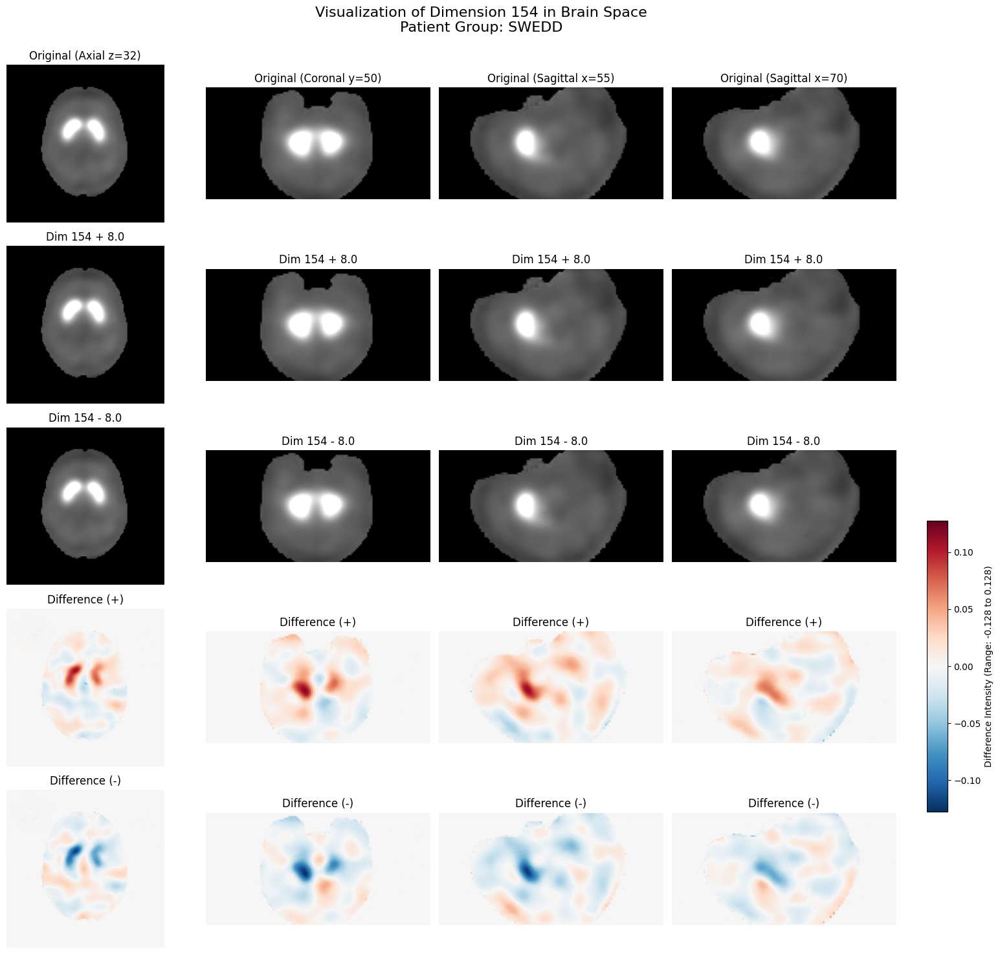

Brain Intensity Scale: 0 to 3
Difference Map Scale: -0.128 to 0.128

Global difference range for dimension 154 across all groups: -0.140 to 0.140


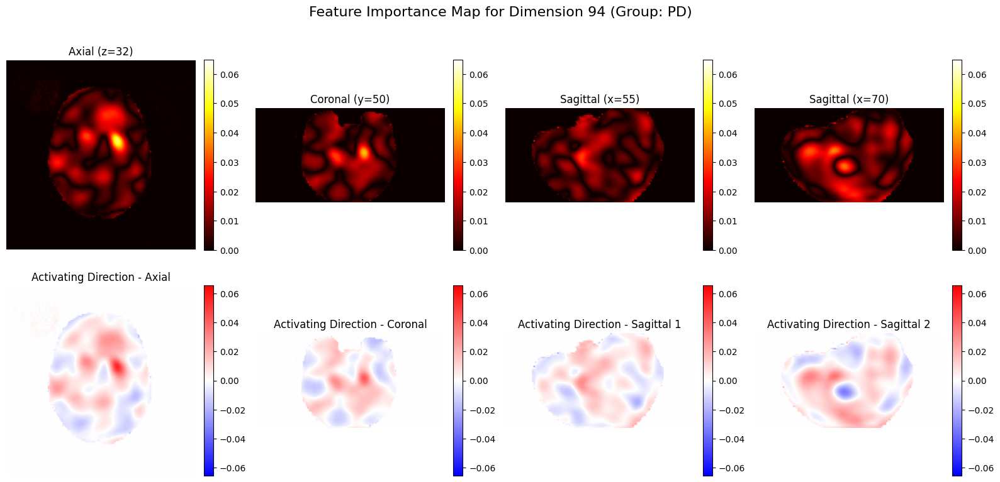

Importance Map Scale: 0 to 0.065
Activation Map Scale: -0.066 to 0.066
Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


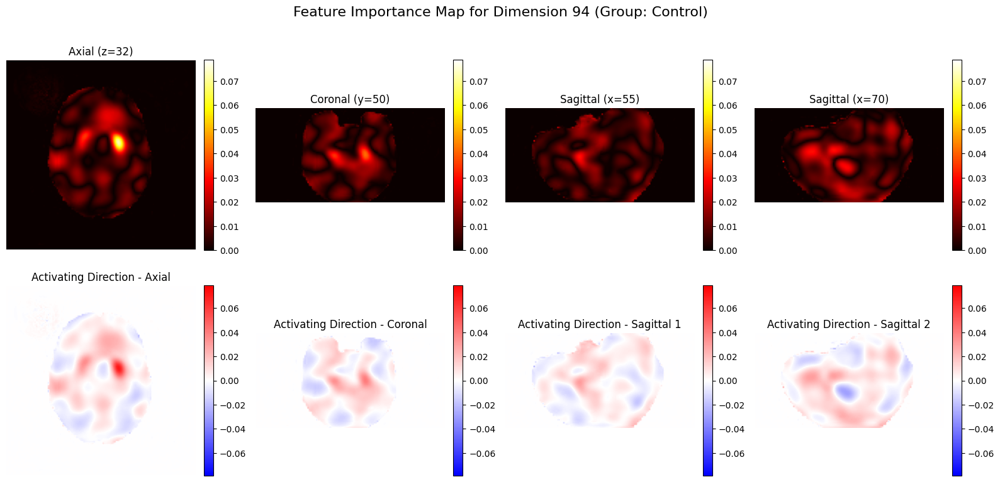

Importance Map Scale: 0 to 0.079
Activation Map Scale: -0.079 to 0.079


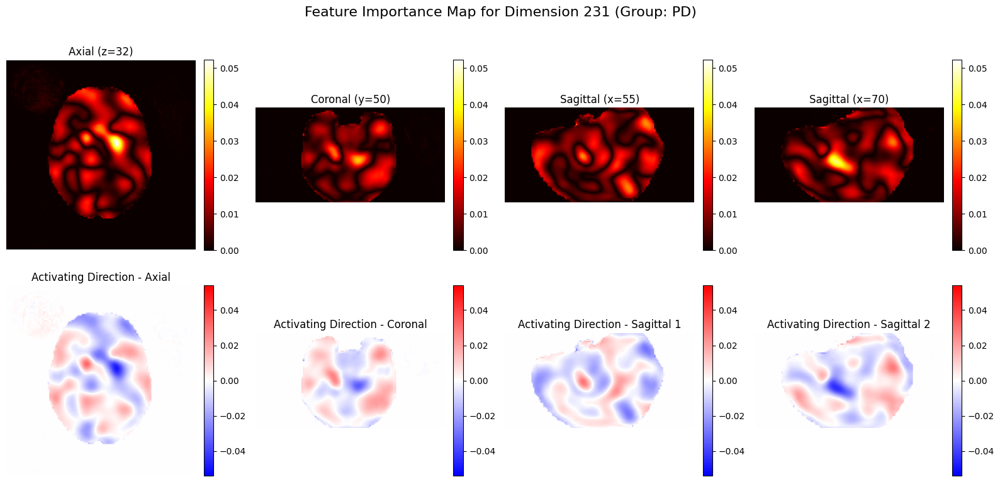

Importance Map Scale: 0 to 0.052
Activation Map Scale: -0.054 to 0.054
Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


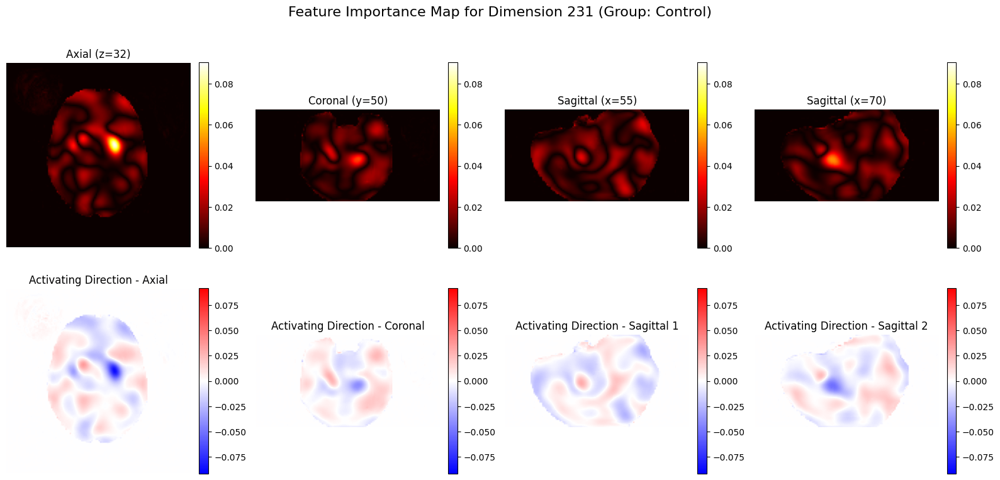

Importance Map Scale: 0 to 0.090
Activation Map Scale: -0.092 to 0.092


In [23]:
# Cell 15: Autoencoder Latent Dimension Visualization with Consistent Scales

import torch
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import LinearSegmentedColormap
import torch.nn.functional as F

def visualize_latent_dimension(model, dataloader, dimension_idx, alpha=5.0, group=None):
    """
    Visualize what a specific latent dimension represents by modifying it
    and observing the effect on brain reconstruction using anatomically relevant slices.
    
    Ensures consistent scales across all views for better comparison.

    Parameters:
        model: Trained autoencoder model
        dataloader: DataLoader containing samples
        dimension_idx: The latent dimension to manipulate (e.g., 231)
        alpha: Strength of the dimension manipulation
        group: Optional filter for specific patient group (e.g., 'PD', 'Control')
    """
    device = next(model.parameters()).device
    model.eval()

    # Find a suitable sample (optionally from specific group)
    for batch in dataloader:
        volumes = batch['volume']
        labels = batch['label']
        paths = batch['path']

        if group is not None:
            # Find samples from the specified group
            group_indices = [i for i, label in enumerate(labels) if label == group]
            if not group_indices:
                continue
            # Use the first matching sample
            idx = group_indices[0]
            sample = volumes[idx:idx+1].to(device)
            sample_label = labels[idx]
            sample_path = paths[idx]
        else:
            # Just use the first sample
            sample = volumes[0:1].to(device)
            sample_label = labels[0]
            sample_path = paths[0]

        break  # Exit after finding a sample

    with torch.no_grad():
        # Encode the sample to get its latent representation
        z = model.encode(sample)

        # Create modified latent vectors
        z_plus = z.clone()
        z_minus = z.clone()

        # Modify the specific dimension
        z_plus[0, dimension_idx] += alpha
        z_minus[0, dimension_idx] -= alpha

        # Decode the original and modified latent vectors
        original_reconstruction = model.decode(z)
        plus_reconstruction = model.decode(z_plus)
        minus_reconstruction = model.decode(z_minus)

        # Move tensors to CPU and convert to numpy for visualization
        original_vol = original_reconstruction.cpu().squeeze().numpy()
        plus_vol = plus_reconstruction.cpu().squeeze().numpy()
        minus_vol = minus_reconstruction.cpu().squeeze().numpy()

        # Calculate the difference maps
        plus_diff = plus_vol - original_vol
        minus_diff = minus_vol - original_vol

        # Set up the figure
        fig = plt.figure(figsize=(16, 15))
        plt.suptitle(f"Visualization of Dimension {dimension_idx} in Brain Space\nPatient Group: {sample_label}", fontsize=16)

        # Define anatomically relevant slices
        slices = {
            'axial': 32,       # Axial z=32
            'coronal': 50,     # Coronal y=50
            'sagittal1': 55,   # Sagittal x=55
            'sagittal2': 70    # Sagittal x=70
        }

        # Create a custom colormap for difference maps
        diff_cmap = plt.cm.RdBu_r  # Red-Blue colormap with red for negative, blue for positive
        
        # Determine consistent scales for brain intensity and difference maps
        brain_vmin, brain_vmax = 0, 3  # Standard scale for brain images
        
        # Find global min/max for difference maps to use consistent scale
        diff_min = min(np.min(plus_diff), np.min(minus_diff))
        diff_max = max(np.max(plus_diff), np.max(minus_diff))
        # Make the range symmetric around zero for better visualization
        diff_abs_max = max(abs(diff_min), abs(diff_max))
        diff_vmin, diff_vmax = -diff_abs_max, diff_abs_max

        # Row 1: Original reconstruction - 4 views
        plt.subplot(5, 4, 1)
        plt.imshow(original_vol[slices['axial']], cmap='gray', vmin=brain_vmin, vmax=brain_vmax)
        plt.title(f"Original (Axial z={slices['axial']})")
        plt.axis('off')

        plt.subplot(5, 4, 2)
        plt.imshow(original_vol[:, slices['coronal'], :], cmap='gray', vmin=brain_vmin, vmax=brain_vmax)
        plt.title(f"Original (Coronal y={slices['coronal']})")
        plt.axis('off')

        plt.subplot(5, 4, 3)
        plt.imshow(original_vol[:, :, slices['sagittal1']], cmap='gray', vmin=brain_vmin, vmax=brain_vmax)
        plt.title(f"Original (Sagittal x={slices['sagittal1']})")
        plt.axis('off')

        plt.subplot(5, 4, 4)
        plt.imshow(original_vol[:, :, slices['sagittal2']], cmap='gray', vmin=brain_vmin, vmax=brain_vmax)
        plt.title(f"Original (Sagittal x={slices['sagittal2']})")
        plt.axis('off')

        # Row 2: Increased dimension - 4 views
        plt.subplot(5, 4, 5)
        plt.imshow(plus_vol[slices['axial']], cmap='gray', vmin=brain_vmin, vmax=brain_vmax)
        plt.title(f"Dim {dimension_idx} + {alpha}")
        plt.axis('off')

        plt.subplot(5, 4, 6)
        plt.imshow(plus_vol[:, slices['coronal'], :], cmap='gray', vmin=brain_vmin, vmax=brain_vmax)
        plt.title(f"Dim {dimension_idx} + {alpha}")
        plt.axis('off')

        plt.subplot(5, 4, 7)
        plt.imshow(plus_vol[:, :, slices['sagittal1']], cmap='gray', vmin=brain_vmin, vmax=brain_vmax)
        plt.title(f"Dim {dimension_idx} + {alpha}")
        plt.axis('off')

        plt.subplot(5, 4, 8)
        plt.imshow(plus_vol[:, :, slices['sagittal2']], cmap='gray', vmin=brain_vmin, vmax=brain_vmax)
        plt.title(f"Dim {dimension_idx} + {alpha}")
        plt.axis('off')

        # Row 3: Decreased dimension - 4 views
        plt.subplot(5, 4, 9)
        plt.imshow(minus_vol[slices['axial']], cmap='gray', vmin=brain_vmin, vmax=brain_vmax)
        plt.title(f"Dim {dimension_idx} - {alpha}")
        plt.axis('off')

        plt.subplot(5, 4, 10)
        plt.imshow(minus_vol[:, slices['coronal'], :], cmap='gray', vmin=brain_vmin, vmax=brain_vmax)
        plt.title(f"Dim {dimension_idx} - {alpha}")
        plt.axis('off')

        plt.subplot(5, 4, 11)
        plt.imshow(minus_vol[:, :, slices['sagittal1']], cmap='gray', vmin=brain_vmin, vmax=brain_vmax)
        plt.title(f"Dim {dimension_idx} - {alpha}")
        plt.axis('off')

        plt.subplot(5, 4, 12)
        plt.imshow(minus_vol[:, :, slices['sagittal2']], cmap='gray', vmin=brain_vmin, vmax=brain_vmax)
        plt.title(f"Dim {dimension_idx} - {alpha}")
        plt.axis('off')

        # Row 4: Difference map (increased - original) - 4 views
        plt.subplot(5, 4, 13)
        im1 = plt.imshow(plus_diff[slices['axial']], cmap=diff_cmap, vmin=diff_vmin, vmax=diff_vmax)
        plt.title(f"Difference (+)")
        plt.axis('off')

        plt.subplot(5, 4, 14)
        plt.imshow(plus_diff[:, slices['coronal'], :], cmap=diff_cmap, vmin=diff_vmin, vmax=diff_vmax)
        plt.title(f"Difference (+)")
        plt.axis('off')

        plt.subplot(5, 4, 15)
        plt.imshow(plus_diff[:, :, slices['sagittal1']], cmap=diff_cmap, vmin=diff_vmin, vmax=diff_vmax)
        plt.title(f"Difference (+)")
        plt.axis('off')

        plt.subplot(5, 4, 16)
        plt.imshow(plus_diff[:, :, slices['sagittal2']], cmap=diff_cmap, vmin=diff_vmin, vmax=diff_vmax)
        plt.title(f"Difference (+)")
        plt.axis('off')

        # Row 5: Difference map (decreased - original) - 4 views
        plt.subplot(5, 4, 17)
        im2 = plt.imshow(minus_diff[slices['axial']], cmap=diff_cmap, vmin=diff_vmin, vmax=diff_vmax)
        plt.title(f"Difference (-)")
        plt.axis('off')

        plt.subplot(5, 4, 18)
        plt.imshow(minus_diff[:, slices['coronal'], :], cmap=diff_cmap, vmin=diff_vmin, vmax=diff_vmax)
        plt.title(f"Difference (-)")
        plt.axis('off')

        plt.subplot(5, 4, 19)
        plt.imshow(minus_diff[:, :, slices['sagittal1']], cmap=diff_cmap, vmin=diff_vmin, vmax=diff_vmax)
        plt.title(f"Difference (-)")
        plt.axis('off')

        plt.subplot(5, 4, 20)
        plt.imshow(minus_diff[:, :, slices['sagittal2']], cmap=diff_cmap, vmin=diff_vmin, vmax=diff_vmax)
        plt.title(f"Difference (-)")
        plt.axis('off')

        # Add colorbar for difference maps - now showing the global range
        cbar_ax = fig.add_axes([0.93, 0.15, 0.02, 0.3])
        cbar = plt.colorbar(im1, cax=cbar_ax)
        cbar.set_label(f'Difference Intensity (Range: {diff_vmin:.3f} to {diff_vmax:.3f})')

        plt.tight_layout()
        plt.subplots_adjust(top=0.92, right=0.9)
        plt.show()

        # Print information about scales used
        print(f"Brain Intensity Scale: {brain_vmin} to {brain_vmax}")
        print(f"Difference Map Scale: {diff_vmin:.3f} to {diff_vmax:.3f}")

        # Return both the sample info and reconstructions for further analysis
        return {
            'label': sample_label,
            'path': sample_path,
            'original': original_vol,
            'plus': plus_vol,
            'minus': minus_vol,
            'plus_diff': plus_diff,
            'minus_diff': minus_diff,
            'diff_min': diff_vmin,
            'diff_max': diff_vmax
        }

def explore_top_dimensions(model, dataloader, dimensions, groups=None):
    """
    Explore the top discriminative dimensions across different patient groups using anatomically relevant slices.
    Ensures consistent scales across all visualizations for a given dimension.

    Parameters:
        model: Trained autoencoder model
        dataloader: DataLoader containing samples
        dimensions: List of dimension indices to explore
        groups: List of groups to include (default is all groups)
    """
    if groups is None:
        # Get all unique groups from the first batch
        for batch in dataloader:
            groups = list(set(batch['label']))
            break

    for dimension in dimensions:
        print(f"\n{'='*80}")
        print(f"Exploring Dimension {dimension}")
        print(f"{'='*80}")
        
        # First pass to determine global min/max difference values
        diff_min_global = float('inf')
        diff_max_global = float('-inf')
        
        # Store results from first pass
        dimension_results = {}
        
        # Scan all groups to find global min/max
        for group in groups:
            print(f"\nAnalyzing dimension {dimension} for group: {group} (first pass)")
            results = visualize_latent_dimension(model, dataloader, dimension, alpha=8.0, group=group)
            
            # Update global min/max
            plus_diff = results['plus_diff']
            minus_diff = results['minus_diff']
            
            curr_min = min(np.min(plus_diff), np.min(minus_diff))
            curr_max = max(np.max(plus_diff), np.max(minus_diff))
            
            diff_min_global = min(diff_min_global, curr_min)
            diff_max_global = max(diff_max_global, curr_max)
            
            # Store results for second pass
            dimension_results[group] = results
        
        # Make the scale symmetric
        diff_abs_max = max(abs(diff_min_global), abs(diff_max_global))
        diff_global_vmin, diff_global_vmax = -diff_abs_max, diff_abs_max
        
        print(f"\nGlobal difference range for dimension {dimension} across all groups: {diff_global_vmin:.3f} to {diff_global_vmax:.3f}")
        
        # Optional: Add a small delay for better visualization
        import time
        time.sleep(1)

def generate_feature_importance_map(model, dataloader, dimension_idx, group=None, num_samples=5):
    """
    Generate a more robust feature importance map for a specific dimension
    by aggregating effects across multiple samples using anatomically relevant slices.
    Uses consistent scales across all views for better comparison.

    Parameters:
        model: Trained autoencoder model
        dataloader: DataLoader containing samples
        dimension_idx: The latent dimension to analyze
        group: Optional filter for specific patient group
        num_samples: Number of samples to aggregate
    """
    device = next(model.parameters()).device
    model.eval()

    # Storage for aggregated results
    aggregated_plus_diff = None
    aggregated_minus_diff = None
    sample_count = 0

    # Find samples (optionally from specific group)
    for batch in dataloader:
        volumes = batch['volume']
        labels = batch['label']

        if group is not None:
            # Find samples from the specified group
            group_indices = [i for i, label in enumerate(labels) if label == group]
            indices = group_indices
        else:
            # Use all samples in batch
            indices = range(len(volumes))

        for idx in indices:
            if sample_count >= num_samples:
                break

            sample = volumes[idx:idx+1].to(device)

            with torch.no_grad():
                # Encode the sample
                z = model.encode(sample)

                # Create modified latent vectors
                z_plus = z.clone()
                z_minus = z.clone()

                # Modify the specific dimension
                z_plus[0, dimension_idx] += 5.0
                z_minus[0, dimension_idx] -= 5.0

                # Decode the vectors
                original_reconstruction = model.decode(z)
                plus_reconstruction = model.decode(z_plus)
                minus_reconstruction = model.decode(z_minus)

                # Calculate the difference maps
                plus_diff = (plus_reconstruction - original_reconstruction).cpu().squeeze().numpy()
                minus_diff = (minus_reconstruction - original_reconstruction).cpu().squeeze().numpy()

                # Aggregate the difference maps
                if aggregated_plus_diff is None:
                    aggregated_plus_diff = plus_diff
                    aggregated_minus_diff = minus_diff
                else:
                    aggregated_plus_diff += plus_diff
                    aggregated_minus_diff += minus_diff

                sample_count += 1

        if sample_count >= num_samples:
            break

    # Average the difference maps
    aggregated_plus_diff /= sample_count
    aggregated_minus_diff /= sample_count

    # Compute absolute importance map (average of plus and minus effects)
    importance_map = (np.abs(aggregated_plus_diff) + np.abs(aggregated_minus_diff)) / 2

    # Define anatomically relevant slices
    axial_slice = 32      # Axial view - slice 32
    coronal_slice = 50    # Coronal view - slice 50
    sagittal_slice1 = 55  # Sagittal view - slice 55
    sagittal_slice2 = 70  # Sagittal view - slice 70
    
    # Determine global max value for importance map for consistent scale
    importance_max = np.max(importance_map)
    
    # Determine global min/max for activation maps for consistent scale
    activation_min = min(np.min(aggregated_plus_diff), np.min(aggregated_minus_diff))
    activation_max = max(np.max(aggregated_plus_diff), np.max(aggregated_minus_diff))
    # Make the activation scale symmetric around zero
    activation_abs_max = max(abs(activation_min), abs(activation_max))
    activation_vmin, activation_vmax = -activation_abs_max, activation_abs_max

    # Visualize the importance map
    fig = plt.figure(figsize=(16, 8))
    plt.suptitle(f"Feature Importance Map for Dimension {dimension_idx}" +
                (f" (Group: {group})" if group else ""), fontsize=16)

    # Plot axial, coronal, and sagittal views for importance map
    plt.subplot(2, 4, 1)
    im1 = plt.imshow(importance_map[axial_slice], cmap='hot', vmin=0, vmax=importance_max)
    plt.title(f"Axial (z={axial_slice})")
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.axis('off')

    plt.subplot(2, 4, 2)
    plt.imshow(importance_map[:, coronal_slice, :], cmap='hot', vmin=0, vmax=importance_max)
    plt.title(f"Coronal (y={coronal_slice})")
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.axis('off')

    plt.subplot(2, 4, 3)
    plt.imshow(importance_map[:, :, sagittal_slice1], cmap='hot', vmin=0, vmax=importance_max)
    plt.title(f"Sagittal (x={sagittal_slice1})")
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.axis('off')

    plt.subplot(2, 4, 4)
    plt.imshow(importance_map[:, :, sagittal_slice2], cmap='hot', vmin=0, vmax=importance_max)
    plt.title(f"Sagittal (x={sagittal_slice2})")
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.axis('off')

    # Plot activating direction (positive difference) with consistent scale
    plt.subplot(2, 4, 5)
    im2 = plt.imshow(aggregated_plus_diff[axial_slice], cmap='bwr', vmin=activation_vmin, vmax=activation_vmax)
    plt.title(f"Activating Direction - Axial")
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.axis('off')

    plt.subplot(2, 4, 6)
    plt.imshow(aggregated_plus_diff[:, coronal_slice, :], cmap='bwr', vmin=activation_vmin, vmax=activation_vmax)
    plt.title(f"Activating Direction - Coronal")
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.axis('off')

    plt.subplot(2, 4, 7)
    plt.imshow(aggregated_plus_diff[:, :, sagittal_slice1], cmap='bwr', vmin=activation_vmin, vmax=activation_vmax)
    plt.title(f"Activating Direction - Sagittal 1")
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.axis('off')

    plt.subplot(2, 4, 8)
    plt.imshow(aggregated_plus_diff[:, :, sagittal_slice2], cmap='bwr', vmin=activation_vmin, vmax=activation_vmax)
    plt.title(f"Activating Direction - Sagittal 2")
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.axis('off')

    plt.tight_layout()
    plt.subplots_adjust(top=0.9)
    plt.show()
    
    # Print information about scales used
    print(f"Importance Map Scale: 0 to {importance_max:.3f}")
    print(f"Activation Map Scale: {activation_vmin:.3f} to {activation_vmax:.3f}")

    return importance_map, aggregated_plus_diff, aggregated_minus_diff

# Example usage
if __name__ == "__main__":
    # Load your trained model first
    model, metadata = load_trained_model('checkpoints', 'autoencoder_v1', latent_dim=256)

    # Example 1: Visualize one specific important dimension for a specific group
    # This shows what happens when you increase or decrease this dimension
    visualize_latent_dimension(model, val_loader, dimension_idx=231, alpha=8.0, group='PD')

    # Example 2: Compare the same dimension across different patient groups
    # Uncomment to see how the same dimension affects different groups
    explore_top_dimensions(model, val_loader, dimensions=[231, 94, 154], groups=['PD', 'Control', 'SWEDD'])

    # Example 3: Generate a feature importance map by aggregating across multiple samples
    # This shows which brain regions are most affected by this dimension
    generate_feature_importance_map(model, val_loader, dimension_idx=94, group='PD', num_samples=10)
    generate_feature_importance_map(model, val_loader, dimension_idx=94, group='Control', num_samples=10)
    generate_feature_importance_map(model, val_loader, dimension_idx=231, group='PD', num_samples=10)
    generate_feature_importance_map(model, val_loader, dimension_idx=231, group='Control', num_samples=10)

## 2. Variational Autoencoder (VAE)

### Model Setup

In [24]:
# Cell 16: Corrected VAE Implementation
import torch
import torch.nn as nn
import torch.nn.functional as F
from collections import OrderedDict

class VAE(nn.Module):
    """
    3D Variational Autoencoder optimized for 64×128×128 medical volumes with
    memory-efficient implementation for NVIDIA 4070Ti.
    """
    def __init__(self, latent_dim=256):
        super().__init__()
        self.encoder = VAEEncoder(latent_dim)
        self.decoder = VAEDecoder(latent_dim)
        # Enable CUDNN benchmarking for optimal performance
        torch.backends.cudnn.benchmark = True
        self.latent_dim = latent_dim

    def reparameterize(self, mu, log_var):
        """
        Reparameterization trick to enable backpropagation through sampling.
        """
        if self.training:
            std = torch.exp(0.5 * log_var)
            eps = torch.randn_like(std)
            return mu + eps * std
        return mu

    def forward(self, x):
        # Encode input to get mean and variance of latent distribution
        mu, log_var = self.encoder(x)

        # Sample from latent distribution
        z = self.reparameterize(mu, log_var)

        # Decode sampled latent vector
        reconstruction = self.decoder(z)

        return reconstruction, mu, log_var

    def encode(self, x):
        """Encode input to latent parameters without sampling"""
        mu, log_var = self.encoder(x)
        return mu, log_var

    def generate(self, z=None, num_samples=1):
        """Generate samples from latent space or random samples"""
        device = next(self.parameters()).device

        if z is None:
            # Generate random latent vectors
            z = torch.randn(num_samples, self.latent_dim, device=device)

        # Decode latent vectors to generate samples
        with torch.no_grad():
            samples = self.decoder(z)

        return samples

class ConvBlock(nn.Module):
    """Memory-efficient convolutional block with batch normalization and ReLU."""
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=1, padding=1):
        super().__init__()
        self.block = nn.Sequential(OrderedDict([
            ('conv', nn.Conv3d(in_channels, out_channels, kernel_size, stride, padding)),
            ('bn', nn.BatchNorm3d(out_channels)),
            ('relu', nn.ReLU(inplace=True))  # inplace ReLU for memory efficiency
        ]))

    def forward(self, x):
        return self.block(x)

class VAEEncoder(nn.Module):
    """3D Encoder network with probabilistic latent space."""
    def __init__(self, latent_dim=256):
        super().__init__()

        # Initial feature extraction
        self.init_conv = ConvBlock(1, 16)  # 64×128×128 -> same size

        # Downsampling path with progressive channel increase
        self.down1 = nn.Sequential(
            ConvBlock(16, 32, stride=2),    # -> 32×64×64
            ConvBlock(32, 32)
        )

        self.down2 = nn.Sequential(
            ConvBlock(32, 64, stride=2),    # -> 16×32×32
            ConvBlock(64, 64)
        )

        self.down3 = nn.Sequential(
            ConvBlock(64, 128, stride=2),   # -> 8×16×16
            ConvBlock(128, 128)
        )

        self.down4 = nn.Sequential(
            ConvBlock(128, 256, stride=2),  # -> 4×8×8
            ConvBlock(256, 256)
        )

        # Project to latent parameters
        self.flatten_size = 256 * 4 * 8 * 8
        self.fc_mu = nn.Linear(self.flatten_size, latent_dim)
        self.fc_var = nn.Linear(self.flatten_size, latent_dim)

    def forward(self, x):
        # Initial convolution
        x = self.init_conv(x)

        # Downsampling
        x = self.down1(x)
        x = self.down2(x)
        x = self.down3(x)
        x = self.down4(x)

        # Flatten and project to latent parameters
        flat = torch.flatten(x, start_dim=1)
        mu = self.fc_mu(flat)
        log_var = self.fc_var(flat)

        return mu, log_var

class VAEDecoder(nn.Module):
    """3D Decoder network without enhanced capacity - matching the saved model."""
    def __init__(self, latent_dim=256):
        super().__init__()

        self.flatten_size = 256 * 4 * 8 * 8
        self.fc = nn.Linear(latent_dim, self.flatten_size)

        # Upsampling path without enhanced capacity (matches the saved model)
        self.up1 = nn.Sequential(
            nn.Upsample(scale_factor=2, mode='trilinear', align_corners=False),
            ConvBlock(256, 128),  # Original channel size from saved model
            ConvBlock(128, 128)
        )

        self.up2 = nn.Sequential(
            nn.Upsample(scale_factor=2, mode='trilinear', align_corners=False),
            ConvBlock(128, 64),   # Original channel size from saved model
            ConvBlock(64, 64)
        )

        self.up3 = nn.Sequential(
            nn.Upsample(scale_factor=2, mode='trilinear', align_corners=False),
            ConvBlock(64, 32),    # Original channel size from saved model
            ConvBlock(32, 32)
        )

        self.up4 = nn.Sequential(
            nn.Upsample(scale_factor=2, mode='trilinear', align_corners=False),
            ConvBlock(32, 16),    # Original channel size from saved model
            ConvBlock(16, 16)
        )

        # No refinement layer in the original model

        # Final convolution
        self.final_conv = nn.Conv3d(16, 1, kernel_size=1)

    def forward(self, z):
        # Reshape from latent space
        x = self.fc(z)
        x = x.view(-1, 256, 4, 8, 8)

        # Upsampling
        x = self.up1(x)
        x = self.up2(x)
        x = self.up3(x)
        x = self.up4(x)

        # Final convolution (no activation to allow for negative values if needed)
        x = self.final_conv(x)

        return x

# Custom loss function for VAE
class VAELoss(nn.Module):
    """
    VAE loss combining reconstruction loss and KL divergence
    with beta parameter to control the trade-off and free bits approach.
    """
    def __init__(self, beta=0.0005, beta_warmup_steps=5000, free_bits=3.0):
        super().__init__()
        self.beta_base = beta
        self.beta_warmup_steps = beta_warmup_steps
        self.current_step = 0
        self.free_bits = free_bits  # Free bits parameter to prevent posterior collapse

    def forward(self, recon_x, x, mu, log_var):
        """
        Calculate VAE loss with enhanced beta annealing and free bits.
        """
        # Reconstruction loss (mean squared error)
        recon_loss = F.mse_loss(recon_x, x, reduction='mean')

        # KL divergence with free bits
        # Instead of penalizing all KL divergence, allow some "free bits"
        kl_raw = -0.5 * torch.sum(1 + log_var - mu.pow(2) - log_var.exp(), dim=1)

        # Apply free bits: only penalize when KL is above threshold
        kl_free = torch.maximum(kl_raw - self.free_bits, torch.zeros_like(kl_raw))
        kl_loss = torch.mean(kl_free)

        # Calculate beta with cyclical warmup
        # Cyclical annealing gives the model periods to focus on reconstruction
        if self.beta_warmup_steps > 0:
            # Implement cyclical annealing
            cycle_length = self.beta_warmup_steps // 2
            cycle_position = (self.current_step % cycle_length) / cycle_length
            if self.current_step // cycle_length % 2 == 0:  # Even cycles: warmup
                beta = self.beta_base * cycle_position
            else:  # Odd cycles: constant
                beta = self.beta_base
        else:
            beta = self.beta_base

        # Increment step counter
        self.current_step += 1

        # Total loss
        total_loss = recon_loss + beta * kl_loss

        return total_loss, recon_loss, kl_loss, beta

# Test VAE with dummy data
def test_vae(batch_size=2, latent_dim=256):
    """Test the VAE architecture and memory usage with dummy data."""
    print("\nTesting VAE Architecture...")

    try:
        # Create model and move to GPU
        model = VAE(latent_dim=latent_dim)
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        model = model.to(device)

        # Create loss function
        vae_loss = VAELoss(beta=0.005)

        # Print model summary
        num_params = sum(p.numel() for p in model.parameters())
        print(f"\nVAE Model Parameters: {num_params:,}")

        # Create dummy input
        dummy_input = torch.randn(batch_size, 1, 64, 128, 128, device=device)

        # Test forward pass
        print("\nTesting forward pass...")
        print_memory_stats()
        with torch.no_grad():
            recon, mu, log_var = model(dummy_input)

        # Test loss calculation
        loss, recon_loss, kl_loss, beta = vae_loss(recon, dummy_input, mu, log_var)

        print(f"\nInput shape: {dummy_input.shape}")
        print(f"Latent mu shape: {mu.shape}")
        print(f"Output shape: {recon.shape}")
        print(f"\nLoss values:")
        print(f"Total loss: {loss.item():.6f}")
        print(f"Reconstruction loss: {recon_loss.item():.6f}")
        print(f"KL loss: {kl_loss.item():.6f}")
        print(f"Beta value: {beta:.6f}")

        # Check memory usage
        print("\nGPU Memory After Forward Pass:")
        print_memory_stats()

        # Clean up
        del model, dummy_input, recon, mu, log_var
        torch.cuda.empty_cache()

        print("\nVAE test completed successfully!")
        return True

    except Exception as e:
        print(f"Error testing VAE: {str(e)}")
        import traceback
        traceback.print_exc()
        return False

In [25]:
# Run test if this cell is executed
if __name__ == "__main__":
    test_vae(batch_size=2, latent_dim=256)


Testing VAE Architecture...



VAE Model Parameters: 55,690,193

Testing forward pass...

GPU Memory Usage:
Allocated: 378.52 MB
Cached: 828.00 MB
CPU Memory Usage: 2131.37 MB

Input shape: torch.Size([2, 1, 64, 128, 128])
Latent mu shape: torch.Size([2, 256])
Output shape: torch.Size([2, 1, 64, 128, 128])

Loss values:
Total loss: 1.227570
Reconstruction loss: 1.227570
KL loss: 28.578468
Beta value: 0.000000

GPU Memory After Forward Pass:

GPU Memory Usage:
Allocated: 394.53 MB
Cached: 1470.00 MB
CPU Memory Usage: 2184.82 MB

VAE test completed successfully!


In [26]:
# Cell 17: VAE Training Configuration and Training Loop
import os
import json
import time
from pathlib import Path
import torch.optim as optim
from torch.optim.lr_scheduler import ReduceLROnPlateau
import torch.cuda.amp as amp
import gc
import torch

class VAEConfig:
    """Configuration for VAE training optimized for NVIDIA 4070Ti"""
    def __init__(self, **kwargs):
        # Model parameters
        self.latent_dim = kwargs.get('latent_dim', 256)
        
        # Training parameters
        self.learning_rate = kwargs.get('learning_rate', 5e-5)
        self.batch_size = kwargs.get('batch_size', 8)
        self.accumulation_steps = kwargs.get('accumulation_steps', 8)  # Effective batch size of 64
        self.epochs = kwargs.get('epochs', 100)
        self.early_stopping_patience = kwargs.get('early_stopping_patience', 15)
        
        # Loss parameters
        self.beta = kwargs.get('beta', 0.005)  # KL divergence weight
        self.beta_warmup_steps = kwargs.get('beta_warmup_steps', 2000)
        
        # Optimization
        self.use_mixed_precision = kwargs.get('use_mixed_precision', True)
        self.weight_decay = kwargs.get('weight_decay', 1e-6)
        self.gradient_clip = kwargs.get('gradient_clip', 1.0)
        
        # Dataloader parameters
        self.num_workers = kwargs.get('num_workers', 4)
        self.pin_memory = kwargs.get('pin_memory', True)
        
        # Checkpoint parameters
        self.checkpoint_dir = kwargs.get('checkpoint_dir', 'checkpoints')
        self.model_name = kwargs.get('model_name', 'vae_model')
        self.save_interval = kwargs.get('save_interval', 5)
        
        # Create checkpoint directory
        Path(self.checkpoint_dir).mkdir(parents=True, exist_ok=True)
        
        # Print configuration summary
        print(f"\n{'='*50}")
        print(f"VAE TRAINING CONFIGURATION")
        print(f"{'='*50}")
        print(f"Model: {self.model_name} with latent dim {self.latent_dim}")
        print(f"Batch size: {self.batch_size} × {self.accumulation_steps} steps = {self.batch_size * self.accumulation_steps} effective")
        print(f"Learning rate: {self.learning_rate}")
        print(f"Beta (KL weight): {self.beta} with {self.beta_warmup_steps} warmup steps")
        print(f"Mixed precision: {'Enabled' if self.use_mixed_precision else 'Disabled'}")
        print(f"Epochs: {self.epochs} with patience {self.early_stopping_patience}")
        print(f"Dataloader workers: {self.num_workers}")
        print(f"Checkpoints saved to: {self.checkpoint_dir}")
        print(f"{'='*50}\n")

class VAECheckpointHandler:
    """Handles saving and loading of VAE model checkpoints"""
    def __init__(self, checkpoint_dir, model_name):
        self.checkpoint_dir = Path(checkpoint_dir)
        self.model_name = model_name
        self.checkpoint_path = self.checkpoint_dir / f"{model_name}_checkpoint.pth"
        self.best_model_path = self.checkpoint_dir / f"{model_name}_best.pth"
        self.metadata_path = self.checkpoint_dir / f"{model_name}_metadata.json"
        
        # Ensure directory exists
        self.checkpoint_dir.mkdir(parents=True, exist_ok=True)

    def save(self, model, optimizer, scheduler, epoch, train_losses, val_losses, 
           train_recon_losses, train_kl_losses, val_recon_losses, val_kl_losses,
           is_best=False):
        """Save VAE checkpoint with additional VAE-specific metrics"""
        # Save model checkpoint
        checkpoint = {
            'epoch': epoch,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'scheduler_state_dict': scheduler.state_dict() if scheduler else None,
            'train_losses': train_losses,
            'val_losses': val_losses,
            'train_recon_losses': train_recon_losses,
            'train_kl_losses': train_kl_losses,
            'val_recon_losses': val_recon_losses,
            'val_kl_losses': val_kl_losses
        }
        
        # Save checkpoint
        torch.save(checkpoint, self.checkpoint_path)
        
        # Save best model separately if this is the best model
        if is_best:
            torch.save(model.state_dict(), self.best_model_path)
            print(f"Saved best model to {self.best_model_path}")

        # Save metadata
        metadata = {
            'last_epoch': epoch,
            'train_losses': train_losses,
            'val_losses': val_losses,
            'train_recon_losses': train_recon_losses,
            'train_kl_losses': train_kl_losses,
            'val_recon_losses': val_recon_losses,
            'val_kl_losses': val_kl_losses,
            'timestamp': time.strftime("%Y-%m-%d %H:%M:%S")
        }
        with open(self.metadata_path, 'w') as f:
            json.dump(metadata, f, indent=4)

    def load(self, model, optimizer=None, scheduler=None, device=None):
        """Load model checkpoint and return training metadata"""
        if not self.checkpoint_path.exists():
            print(f"No checkpoint found at {self.checkpoint_path}")
            return None

        if device is None:
            device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
            
        # Load checkpoint
        checkpoint = torch.load(self.checkpoint_path, map_location=device)
        
        # Load model state
        model.load_state_dict(checkpoint['model_state_dict'])
        
        # Optionally load optimizer and scheduler states
        if optimizer is not None and 'optimizer_state_dict' in checkpoint:
            optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
            
        if scheduler is not None and checkpoint.get('scheduler_state_dict') is not None:
            scheduler.load_state_dict(checkpoint['scheduler_state_dict'])

        print(f"Loaded checkpoint from epoch {checkpoint['epoch']}")
        
        return {
            'epoch': checkpoint['epoch'],
            'train_losses': checkpoint.get('train_losses', []),
            'val_losses': checkpoint.get('val_losses', []),
            'train_recon_losses': checkpoint.get('train_recon_losses', []),
            'train_kl_losses': checkpoint.get('train_kl_losses', []),
            'val_recon_losses': checkpoint.get('val_recon_losses', []),
            'val_kl_losses': checkpoint.get('val_kl_losses', [])
        }

def create_vae_optimizer(model, config):
    """Create optimizer with parameter groups for VAE"""
    # Separate parameters that should have weight decay from those that shouldn't
    decay_params = []
    no_decay_params = []
    
    for name, param in model.named_parameters():
        if 'bias' in name or 'bn' in name:
            no_decay_params.append(param)
        else:
            decay_params.append(param)
    
    # Create parameter groups
    param_groups = [
        {'params': decay_params, 'weight_decay': config.weight_decay},
        {'params': no_decay_params, 'weight_decay': 0.0}
    ]
    
    # Create optimizer
    optimizer = optim.AdamW(param_groups, lr=config.learning_rate)
    
    return optimizer

def create_vae_scheduler(optimizer, config):
    """Create learning rate scheduler"""
    return ReduceLROnPlateau(
        optimizer, 
        mode='min',
        factor=0.5,
        patience=5,
        verbose=True,
        min_lr=1e-6
    )

class VAEEarlyStopping:
    """Early stopping handler with patience for VAE"""
    def __init__(self, patience=10, min_delta=0, verbose=True):
        self.patience = patience
        self.min_delta = min_delta
        self.counter = 0
        self.best_loss = float('inf')
        self.early_stop = False
        self.verbose = verbose
        self.best_epoch = 0
        
    def __call__(self, val_loss, epoch):
        if val_loss < self.best_loss - self.min_delta:
            if self.verbose:
                improvement = self.best_loss - val_loss
                print(f"Validation loss improved by {improvement:.6f}")
            self.best_loss = val_loss
            self.counter = 0
            self.best_epoch = epoch
            return True  # Model improved
        else:
            self.counter += 1
            if self.verbose:
                print(f"Early stopping counter: {self.counter}/{self.patience}")
            if self.counter >= self.patience:
                self.early_stop = True
                if self.verbose:
                    print(f"Early stopping triggered. Best epoch was {self.best_epoch}.")
            return False  # Model didn't improve

def train_vae(model, train_loader, val_loader, config=None):
    """Memory-optimized VAE training loop with mixed precision and gradient accumulation"""
    if config is None:
        config = VAEConfig()

    # Set up device
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)

    # Initialize components
    criterion = VAELoss(beta=config.beta, beta_warmup_steps=config.beta_warmup_steps)
    optimizer = create_vae_optimizer(model, config)
    scheduler = create_vae_scheduler(optimizer, config)
    early_stopping = VAEEarlyStopping(patience=config.early_stopping_patience)
    checkpoint_handler = VAECheckpointHandler(config.checkpoint_dir, config.model_name)

    # Mixed precision setup
    scaler = amp.GradScaler(enabled=config.use_mixed_precision)

    # Training tracking variables
    train_losses = []
    val_losses = []
    train_recon_losses = []
    train_kl_losses = []
    val_recon_losses = []
    val_kl_losses = []
    best_val_loss = float('inf')
    start_time = time.time()

    # Load checkpoint if available
    start_epoch = 0
    checkpoint_data = checkpoint_handler.load(model, optimizer, scheduler, device)
    if checkpoint_data:
        start_epoch = checkpoint_data['epoch'] + 1
        train_losses = checkpoint_data.get('train_losses', [])
        val_losses = checkpoint_data.get('val_losses', [])
        train_recon_losses = checkpoint_data.get('train_recon_losses', [])
        train_kl_losses = checkpoint_data.get('train_kl_losses', [])
        val_recon_losses = checkpoint_data.get('val_recon_losses', [])
        val_kl_losses = checkpoint_data.get('val_kl_losses', [])
        print(f"Resuming training from epoch {start_epoch}")

    # Calculate total steps for progress tracking
    total_steps = len(train_loader) * config.epochs

    # Training loop
    try:
        # Create progress bar for total training
        total_pbar = tqdm(total=total_steps, desc="Total Progress", position=0)
        total_pbar.update(start_epoch * len(train_loader))
        
        for epoch in range(start_epoch, config.epochs):
            # Training phase
            model.train()
            epoch_loss = 0
            epoch_recon_loss = 0
            epoch_kl_loss = 0
            current_beta = 0
            optimizer.zero_grad()  # Zero gradients at epoch start

            train_pbar = tqdm(train_loader, 
                            desc=f'Epoch {epoch+1}/{config.epochs} [Train]',
                            leave=False, 
                            position=1)

            for batch_idx, batch in enumerate(train_pbar):
                try:
                    # Move data to device
                    volumes = batch['volume'].to(device, non_blocking=True)
                    
                    # Mixed precision forward pass
                    with amp.autocast(enabled=config.use_mixed_precision):
                        reconstructed, mu, log_var = model(volumes)
                        loss, recon_loss, kl_loss, beta = criterion(reconstructed, volumes, mu, log_var)
                        current_beta = beta
                        # Scale loss by accumulation steps
                        loss = loss / config.accumulation_steps

                    # Mixed precision backward pass
                    scaler.scale(loss).backward()

                    # Gradient accumulation
                    if (batch_idx + 1) % config.accumulation_steps == 0 or (batch_idx + 1 == len(train_loader)):
                        # Clip gradients to prevent exploding gradients
                        if config.gradient_clip > 0:
                            scaler.unscale_(optimizer)
                            torch.nn.utils.clip_grad_norm_(model.parameters(), config.gradient_clip)
                        
                        # Update weights
                        scaler.step(optimizer)
                        scaler.update()
                        optimizer.zero_grad()

                    # Track loss (using the non-scaled loss for reporting)
                    batch_loss = loss.item() * config.accumulation_steps
                    epoch_loss += batch_loss
                    epoch_recon_loss += recon_loss.item()
                    epoch_kl_loss += kl_loss.item()
                    
                    # Update progress bars
                    train_pbar.set_postfix({
                        'loss': f"{batch_loss:.6f}",
                        'recon': f"{recon_loss.item():.6f}",
                        'kl': f"{kl_loss.item():.6f}",
                        'beta': f"{beta:.6f}"
                    })
                    total_pbar.update(1)

                    # Memory cleanup
                    del volumes, reconstructed, mu, log_var, loss, recon_loss, kl_loss
                    torch.cuda.empty_cache()

                except RuntimeError as e:
                    if "out of memory" in str(e):
                        print(f"\nOOM in batch {batch_idx}. Cleaning up...")
                        torch.cuda.empty_cache()
                        gc.collect()
                        # Skip this batch and continue
                        continue
                    else:
                        print(f"RuntimeError: {str(e)}")
                        raise e
                except Exception as e:
                    print(f"Unexpected error: {str(e)}")
                    import traceback
                    traceback.print_exc()
                    raise e

            # Calculate average training losses
            avg_train_loss = epoch_loss / len(train_loader)
            avg_train_recon_loss = epoch_recon_loss / len(train_loader)
            avg_train_kl_loss = epoch_kl_loss / len(train_loader)
            
            train_losses.append(avg_train_loss)
            train_recon_losses.append(avg_train_recon_loss)
            train_kl_losses.append(avg_train_kl_loss)

            # Validation phase
            model.eval()
            val_loss = 0
            val_recon_loss_sum = 0
            val_kl_loss_sum = 0
            
            val_pbar = tqdm(val_loader, 
                          desc=f'Epoch {epoch+1}/{config.epochs} [Val]',
                          leave=False,
                          position=1)

            with torch.no_grad():
                for batch in val_pbar:
                    try:
                        volumes = batch['volume'].to(device)
                        reconstructed, mu, log_var = model(volumes)
                        loss, recon_loss, kl_loss, _ = criterion(reconstructed, volumes, mu, log_var)
                        
                        val_loss += loss.item()
                        val_recon_loss_sum += recon_loss.item()
                        val_kl_loss_sum += kl_loss.item()
                        
                        val_pbar.set_postfix({
                            'loss': f"{loss.item():.6f}",
                            'recon': f"{recon_loss.item():.6f}",
                            'kl': f"{kl_loss.item():.6f}"
                        })

                        # Memory cleanup
                        del volumes, reconstructed, mu, log_var, loss, recon_loss, kl_loss
                        torch.cuda.empty_cache()

                    except RuntimeError as e:
                        if "out of memory" in str(e):
                            print("\nOOM during validation. Cleaning up...")
                            torch.cuda.empty_cache()
                            gc.collect()
                            continue
                        else:
                            print(f"RuntimeError during validation: {str(e)}")
                            raise e
                    except Exception as e:
                        print(f"Unexpected error during validation: {str(e)}")
                        import traceback
                        traceback.print_exc()
                        raise e

            # Calculate average validation losses
            avg_val_loss = val_loss / len(val_loader)
            avg_val_recon_loss = val_recon_loss_sum / len(val_loader)
            avg_val_kl_loss = val_kl_loss_sum / len(val_loader)
            
            val_losses.append(avg_val_loss)
            val_recon_losses.append(avg_val_recon_loss)
            val_kl_losses.append(avg_val_kl_loss)

            # Update learning rate
            scheduler.step(avg_val_loss)

            # Check if this is the best model
            is_best = avg_val_loss < best_val_loss
            if is_best:
                best_val_loss = avg_val_loss

            # Save checkpoint
            if (epoch + 1) % config.save_interval == 0 or is_best or (epoch + 1 == config.epochs):
                # Save additional loss components
                checkpoint_handler.save(
                    model, optimizer, scheduler,
                    epoch, train_losses, val_losses, 
                    train_recon_losses, train_kl_losses,
                    val_recon_losses, val_kl_losses,
                    is_best=is_best
                )

            # Print epoch summary
            elapsed_time = time.time() - start_time
            time_per_epoch = elapsed_time / (epoch - start_epoch + 1) if epoch >= start_epoch else 0
            est_time_left = time_per_epoch * (config.epochs - epoch - 1)
            
            print(f"\nEpoch {epoch+1}/{config.epochs} completed in {time_per_epoch:.2f}s")
            print(f"Train Loss: {avg_train_loss:.6f} (Recon: {avg_train_recon_loss:.6f}, KL: {avg_train_kl_loss:.6f})")
            print(f"Val Loss: {avg_val_loss:.6f} (Recon: {avg_val_recon_loss:.6f}, KL: {avg_val_kl_loss:.6f})")
            print(f"Learning rate: {optimizer.param_groups[0]['lr']:.8f}")
            print(f"Beta value: {current_beta:.6f}")
            print(f"Est. time remaining: {est_time_left/60:.2f} minutes")
            print_memory_stats()
            
            # Early stopping check
            if early_stopping(avg_val_loss, epoch):
                if early_stopping.early_stop:
                    print("\nEarly stopping triggered!")
                    break

    except KeyboardInterrupt:
        print("\nTraining interrupted by user!")
        # Still save the model
        checkpoint_handler.save(
            model, optimizer, scheduler,
            epoch, train_losses, val_losses,
            train_recon_losses, train_kl_losses,
            val_recon_losses, val_kl_losses,
            is_best=False
        )

    finally:
        # Close progress bars
        if 'total_pbar' in locals():
            total_pbar.close()
        
        # Plot training history
        plt.figure(figsize=(15, 10))
        
        # Plot total loss
        plt.subplot(2, 2, 1)
        plt.plot(train_losses, label='Train Loss')
        plt.plot(val_losses, label='Validation Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Total Loss')
        plt.title('Total Loss History')
        plt.legend()
        plt.grid(True)
        
        # Plot reconstruction loss
        plt.subplot(2, 2, 2)
        plt.plot(train_recon_losses, label='Train Recon Loss')
        plt.plot(val_recon_losses, label='Val Recon Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Reconstruction Loss')
        plt.title('Reconstruction Loss History')
        plt.legend()
        plt.grid(True)
        
        # Plot KL loss
        plt.subplot(2, 2, 3)
        plt.plot(train_kl_losses, label='Train KL Loss')
        plt.plot(val_kl_losses, label='Val KL Loss')
        plt.xlabel('Epoch')
        plt.ylabel('KL Divergence Loss')
        plt.title('KL Divergence Loss History')
        plt.legend()
        plt.grid(True)
        
        # Plot recent total loss (last 30 epochs or all if < 30)
        plt.subplot(2, 2, 4)
        recent = min(30, len(train_losses))
        if recent > 5:  # Only plot recent history if we have enough epochs
            plt.plot(train_losses[-recent:], label='Train Loss')
            plt.plot(val_losses[-recent:], label='Validation Loss')
            plt.xlabel('Epoch')
            plt.ylabel('Total Loss')
            plt.title(f'Last {recent} Epochs')
            plt.legend()
            plt.grid(True)
        
        plt.tight_layout()
        plt.savefig(os.path.join(config.checkpoint_dir, f"{config.model_name}_training_history.png"))
        plt.show()

        # Print final training summary
        total_time = time.time() - start_time
        print(f"\nTraining completed in {total_time/60:.2f} minutes")
        print(f"Best validation loss: {best_val_loss:.6f}")
        
        return {
            'train_losses': train_losses,
            'val_losses': val_losses,
            'train_recon_losses': train_recon_losses,
            'train_kl_losses': train_kl_losses,
            'val_recon_losses': val_recon_losses,
            'val_kl_losses': val_kl_losses,
            'best_val_loss': best_val_loss,
            'model': model
        }

### Training


VAE TRAINING CONFIGURATION
Model: vae_model_v2 with latent dim 256
Batch size: 8 × 8 steps = 64 effective
Learning rate: 2e-05
Beta (KL weight): 0.0005 with 10000 warmup steps
Mixed precision: Enabled
Epochs: 300 with patience 20
Dataloader workers: 4
Checkpoints saved to: checkpoints

Loaded checkpoint from epoch 254
Resuming training from epoch 255


Total Progress:  85%|████████▌ | 304616/358200 [00:15<00:03, 14087.40it/s] 


Training interrupted by user!


Total Progress:  85%|████████▌ | 304659/358200 [00:20<00:03, 14654.15it/s]


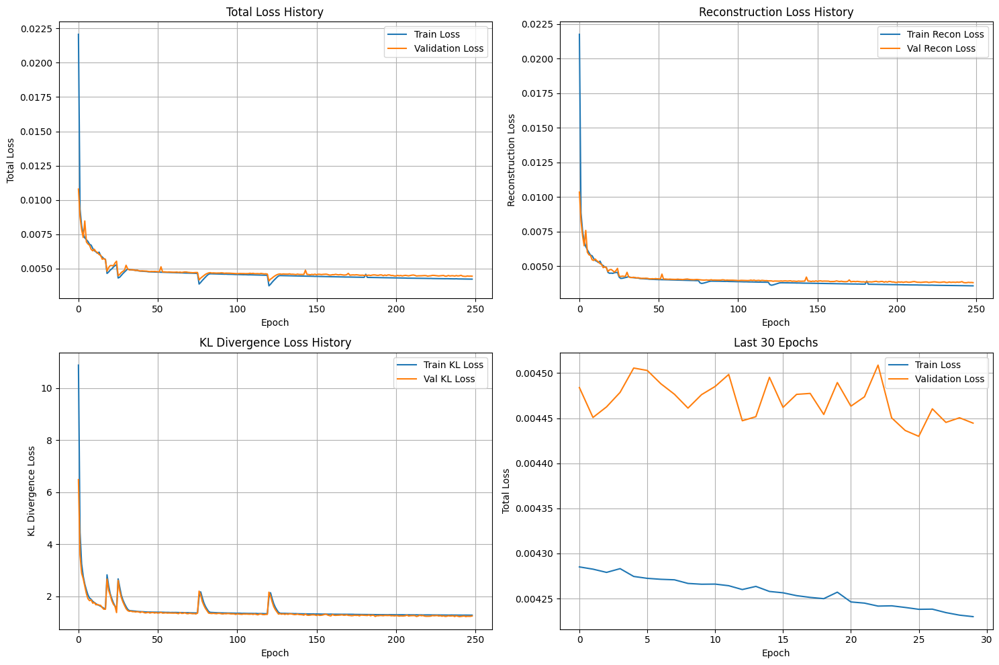


Training completed in 0.42 minutes
Best validation loss: inf


In [27]:
# Example usage to train the VAE
if __name__ == "__main__":
    # Create the VAE model
    model = VAE(latent_dim=256)
    
    # Create VAE configuration
    config = VAEConfig(
        latent_dim=256,
        batch_size=8,
        accumulation_steps=8,        # Effective batch size = 64
        learning_rate=2e-5,
        epochs=300,
        beta=0.0005,                 # Reduced from 0.005 to 0.0005 (10x smaller)
        beta_warmup_steps=10000,      # Increased from 2000 to 10000
        early_stopping_patience=20,
        use_mixed_precision=True,
        num_workers=4,
        model_name="vae_model_v2"    # New model name to avoid overwriting
    )
    
    # Train the VAE
    results = train_vae(model, train_loader, val_loader, config)


VAE TRAINING CONFIGURATION
Model: vae_model_v6 with latent dim 256
Batch size: 8 × 8 steps = 64 effective
Learning rate: 2e-05
Beta (KL weight): 0.001 with 2000 warmup steps
Mixed precision: Enabled
Epochs: 300 with patience 20
Dataloader workers: 4
Checkpoints saved to: checkpoints

Loaded checkpoint from epoch 94
Resuming training from epoch 95


Total Progress:  32%|███▏      | 113431/358200 [00:00<00:00, 342606.36it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  32%|███▏      | 113827/358200 [00:34<02:50, 1432.24it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  32%|███▏      | 113952/358200 [00:47<05:30, 739.49it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  32%|███▏      | 114207/358200 [01:07<13:39, 297.83it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  32%|███▏      | 114209/358200 [01:07<13:44, 295.83it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  32%|███▏      | 114591/358200 [01:40<52:18, 77.62it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Total Progress:  32%|███▏      | 114624/358200 [01:52<52:18, 77.62it/s]

Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Saved best model to checkpoints/vae_model_v6_best.pth

Epoch 96/300 completed in 126.46s
Train Loss: 0.008641 (Recon: 0.008422, KL: 0.413135)
Val Loss: 0.008338 (Recon: 0.007848, KL: 0.489881)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 429.95 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3096.21 MB
Validation loss improved by inf


Total Progress:  32%|███▏      | 114627/358200 [02:05<2:06:13, 32.16it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  32%|███▏      | 115120/358200 [02:45<3:53:49, 17.33it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  32%|███▏      | 115248/358200 [02:58<4:39:49, 14.47it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  32%|███▏      | 115498/358200 [03:18<5:02:29, 13.37it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  32%|███▏      | 115625/358200 [03:31<5:38:32, 11.94it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  32%|███▏      | 115772/358200 [03:42<5:30:34, 12.22it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  32%|███▏      | 115818/358200 [04:03<5:30:30, 12.22it/s]

Saved best model to checkpoints/vae_model_v6_best.pth

Epoch 97/300 completed in 124.85s
Train Loss: 0.008665 (Recon: 0.008472, KL: 0.338789)
Val Loss: 0.008302 (Recon: 0.007824, KL: 0.581534)
Learning rate: 0.00000100
Beta value: 0.000686
Est. time remaining: 422.42 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3096.22 MB
Validation loss improved by 0.000037


Total Progress:  32%|███▏      | 115980/358200 [04:20<7:29:43,  8.98it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  32%|███▏      | 116039/358200 [04:25<6:30:54, 10.32it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  32%|███▏      | 116137/358200 [04:35<6:11:01, 10.87it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  32%|███▏      | 116217/358200 [04:41<5:02:47, 13.32it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  33%|███▎      | 116749/358200 [05:25<5:20:08, 12.57it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  33%|███▎      | 116966/358200 [05:45<5:16:12, 12.71it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  33%|███▎      | 117012/358200 [05:49<5:26:57, 12.29it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 

Epoch 98/300 [Val]:  21%|██        | 62/299 [00:03<00:12, 19.02it/s, loss=0.011906, recon=0.011801, kl=0.430195]

Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  33%|███▎      | 117012/358200 [06:01<5:26:57, 12.29it/s]

Saved best model to checkpoints/vae_model_v6_best.pth

Epoch 98/300 completed in 123.45s
Train Loss: 0.008822 (Recon: 0.008582, KL: 0.316782)
Val Loss: 0.008136 (Recon: 0.007846, KL: 0.905059)
Learning rate: 0.00000100
Beta value: 0.000179
Est. time remaining: 415.63 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3096.22 MB
Validation loss improved by 0.000166


Total Progress:  33%|███▎      | 117203/358200 [06:26<4:58:53, 13.44it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  33%|███▎      | 117213/358200 [06:26<5:08:46, 13.01it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  33%|███▎      | 117377/358200 [06:39<5:02:05, 13.29it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  33%|███▎      | 117547/358200 [06:55<4:57:40, 13.47it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  33%|███▎      | 117641/358200 [07:02<5:05:20, 13.13it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  33%|███▎      | 117807/358200 [07:14<5:00:35, 13.33it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  33%|███▎      | 118205/358200 [07:50<24:06:50,  2.76it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  33%|███▎      | 118206/358200 [08:02<24:06:50,  2.76it/s]


Epoch 99/300 completed in 122.01s
Train Loss: 0.008797 (Recon: 0.008537, KL: 0.312330)
Val Loss: 0.008389 (Recon: 0.008004, KL: 0.384170)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 408.74 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3102.12 MB
Early stopping counter: 1/20


Total Progress:  33%|███▎      | 118277/358200 [08:11<4:56:04, 13.51it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  33%|███▎      | 118571/358200 [08:36<4:58:48, 13.37it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  33%|███▎      | 118683/358200 [08:45<5:00:39, 13.28it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  33%|███▎      | 118751/358200 [08:50<5:07:43, 12.97it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  33%|███▎      | 118997/358200 [09:12<5:02:59, 13.16it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  33%|███▎      | 119071/358200 [09:17<5:30:13, 12.07it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  33%|███▎      | 119399/358200 [09:45<5:06:45, 12.97it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  33%|███▎      | 119400/358200 [10:03<5:06:44, 12.97it/s]


Epoch 100/300 completed in 121.56s
Train Loss: 0.008651 (Recon: 0.008461, KL: 0.361852)
Val Loss: 0.008273 (Recon: 0.007756, KL: 0.516675)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 405.21 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3103.32 MB
Early stopping counter: 2/20


Total Progress:  33%|███▎      | 119412/358200 [10:07<30:00:05,  2.21it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  33%|███▎      | 119742/358200 [10:34<8:05:18,  8.19it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  33%|███▎      | 119846/358200 [10:42<4:57:23, 13.36it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  34%|███▎      | 120211/358200 [11:13<4:58:53, 13.27it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  34%|███▎      | 120247/358200 [11:16<4:55:50, 13.41it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  34%|███▎      | 120519/358200 [11:36<4:54:04, 13.47it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  34%|███▎      | 120594/358200 [11:45<5:06:13, 12.93it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 



Epoch 101/300 completed in 120.43s
Train Loss: 0.008649 (Recon: 0.008454, KL: 0.366940)
Val Loss: 0.008407 (Recon: 0.007942, KL: 0.586051)
Learning rate: 0.00000100
Beta value: 0.000658
Est. time remaining: 399.44 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.07 MB
Early stopping counter: 3/20


Total Progress:  34%|███▎      | 120771/358200 [12:17<5:11:30, 12.70it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  34%|███▍      | 121194/358200 [12:52<5:08:49, 12.79it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  34%|███▍      | 121282/358200 [12:58<5:03:34, 13.01it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  34%|███▍      | 121398/358200 [13:07<4:59:03, 13.20it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  34%|███▍      | 121699/358200 [13:33<5:16:55, 12.44it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  34%|███▍      | 121765/358200 [13:38<5:02:33, 13.02it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  34%|███▍      | 121787/358200 [13:40<5:21:36, 12.25it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 



Epoch 102/300 [Val]:  20%|██        | 61/299 [00:03<00:12, 18.58it/s, loss=0.010462, recon=0.010250, kl=0.996586]

Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 

Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  34%|███▍      | 121788/358200 [13:52<5:21:36, 12.25it/s]

Saved best model to checkpoints/vae_model_v6_best.pth

Epoch 102/300 completed in 120.50s
Train Loss: 0.008779 (Recon: 0.008564, KL: 0.272335)
Val Loss: 0.008059 (Recon: 0.007837, KL: 0.770904)
Learning rate: 0.00000100
Beta value: 0.000151
Est. time remaining: 397.64 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.07 MB
Validation loss improved by 0.000077


Total Progress:  34%|███▍      | 122286/358200 [14:42<5:14:23, 12.51it/s]  

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  34%|███▍      | 122503/358200 [15:01<4:57:40, 13.20it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  34%|███▍      | 122677/358200 [15:15<4:58:59, 13.13it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  34%|███▍      | 122789/358200 [15:23<5:04:49, 12.87it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  34%|███▍      | 122912/358200 [15:35<4:58:43, 13.13it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  34%|███▍      | 122944/358200 [15:38<4:57:11, 13.19it/s]


Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 

Epoch 103/300 [Train]:  97%|█████████▋| 1156/1194 [01:36<00:02, 13.21it/s, loss=0.005211, recon=0.005153, kl=0.057381, beta=0.001000]

Total Progress:  34%|███▍      | 122982/358200 [15:41<5:05:34, 12.83it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 



Epoch 103/300 completed in 119.82s
Train Loss: 0.008770 (Recon: 0.008522, KL: 0.289004)
Val Loss: 0.008470 (Recon: 0.008009, KL: 0.461171)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 393.41 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.07 MB
Early stopping counter: 1/20


Total Progress:  34%|███▍      | 123030/358200 [16:03<5:22:14, 12.16it/s]  

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  34%|███▍      | 123078/358200 [16:07<5:01:47, 12.98it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  34%|███▍      | 123417/358200 [16:36<5:14:50, 12.43it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  35%|███▍      | 123717/358200 [16:59<4:55:51, 13.21it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  35%|███▍      | 123741/358200 [17:01<4:54:11, 13.28it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  35%|███▍      | 123767/358200 [17:03<5:01:50, 12.94it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  35%|███▍      | 124176/358200 [17:40<6:39:30,  9.76it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  35%|███▍      | 124176/358200 [17:51<6:39:30,  9.76it/s]


Epoch 104/300 completed in 119.83s
Train Loss: 0.008656 (Recon: 0.008461, KL: 0.358904)
Val Loss: 0.008389 (Recon: 0.007870, KL: 0.519573)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 391.44 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.07 MB
Early stopping counter: 2/20


Total Progress:  35%|███▍      | 124781/358200 [18:49<4:53:19, 13.26it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  35%|███▍      | 124851/358200 [18:54<5:03:49, 12.80it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  35%|███▍      | 125169/358200 [19:22<4:59:33, 12.97it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  35%|███▍      | 125189/358200 [19:23<5:07:45, 12.62it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  35%|███▍      | 125205/358200 [19:24<4:58:50, 12.99it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  35%|███▍      | 125363/358200 [19:37<5:10:22, 12.50it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  35%|███▍      | 125369/358200 [19:37<4:59:26, 12.96it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  35%|███▌      | 125370/358200 [19:52<4:59:26, 12.96it/s]


Epoch 105/300 completed in 120.05s
Train Loss: 0.008603 (Recon: 0.008431, KL: 0.337810)
Val Loss: 0.008300 (Recon: 0.007910, KL: 0.511677)
Learning rate: 0.00000100
Beta value: 0.000630
Est. time remaining: 390.16 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.06 MB
Early stopping counter: 3/20


Total Progress:  35%|███▌      | 125458/358200 [20:06<5:06:56, 12.64it/s]  

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  35%|███▌      | 125714/358200 [20:28<5:01:07, 12.87it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  35%|███▌      | 126020/358200 [20:52<4:55:31, 13.09it/s]


Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 

Epoch 106/300 [Train]:  54%|█████▍    | 650/1194 [00:53<00:41, 13.12it/s, loss=0.006068, recon=0.005964, kl=0.103360, beta=0.001000]

Total Progress:  35%|███▌      | 126232/358200 [21:11<5:02:22, 12.79it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  35%|███▌      | 126296/358200 [21:16<4:59:03, 12.92it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  35%|███▌      | 126508/358200 [21:35<5:02:34, 12.76it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  35%|███▌      | 126564/358200 [21:40<5:11:28, 12.39it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  35%|███▌      | 126564/358200 [21:50<5:11:28, 12.39it/s]

Saved best model to checkpoints/vae_model_v6_best.pth

Epoch 106/300 completed in 120.35s
Train Loss: 0.008678 (Recon: 0.008453, KL: 0.250610)
Val Loss: 0.008024 (Recon: 0.007879, KL: 0.569115)
Learning rate: 0.00000100
Beta value: 0.000123
Est. time remaining: 389.14 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.06 MB
Validation loss improved by 0.000035


Total Progress:  35%|███▌      | 126700/358200 [22:13<5:20:16, 12.05it/s]  

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  35%|███▌      | 126732/358200 [22:16<5:14:10, 12.28it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  36%|███▌      | 127247/358200 [22:59<4:55:31, 13.02it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  36%|███▌      | 127373/358200 [23:12<5:01:56, 12.74it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  36%|███▌      | 127423/358200 [23:16<5:09:30, 12.43it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  36%|███▌      | 127477/358200 [23:20<5:02:24, 12.72it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  36%|███▌      | 127757/358200 [23:44<4:54:30, 13.04it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 



Epoch 107/300 completed in 120.22s
Train Loss: 0.008656 (Recon: 0.008448, KL: 0.253324)
Val Loss: 0.008375 (Recon: 0.007942, KL: 0.432385)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 386.69 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.06 MB
Early stopping counter: 1/20


Total Progress:  36%|███▌      | 127973/358200 [24:20<4:55:16, 12.99it/s]  

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  36%|███▌      | 128189/358200 [24:36<4:49:34, 13.24it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  36%|███▌      | 128193/358200 [24:37<4:50:01, 13.22it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  36%|███▌      | 128452/358200 [25:00<5:03:53, 12.60it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Epoch 108/300 [Train]:  58%|█████▊    | 694/1194 [00:59<00:39, 12.63it/s, loss=0.006497, recon=0.006371, kl=0.206708, beta=0.000609]

Total Progress:  36%|███▌      | 128712/358200 [25:23<4:56:22, 12.91it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  36%|███▌      | 128824/358200 [25:32<5:07:53, 12.42it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  36%|███▌      | 128952/358200 [25:42<5:08:07, 12.40it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Total Progress:  36%|███▌      | 128952/358200 [25:52<5:08:07, 12.40it/s]

Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 



Epoch 108/300 completed in 120.24s
Train Loss: 0.008683 (Recon: 0.008496, KL: 0.381592)
Val Loss: 0.008430 (Recon: 0.007899, KL: 0.530507)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 384.78 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.06 MB
Early stopping counter: 2/20


Total Progress:  36%|███▌      | 129211/358200 [26:24<6:25:27,  9.90it/s]  

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  36%|███▌      | 129337/358200 [26:33<4:57:28, 12.82it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  36%|███▌      | 129621/358200 [26:58<4:50:40, 13.11it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  36%|███▌      | 129723/358200 [27:06<4:49:57, 13.13it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  36%|███▌      | 129829/358200 [27:14<4:50:00, 13.12it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  36%|███▋      | 130115/358200 [27:38<4:44:48, 13.35it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  36%|███▋      | 130145/358200 [27:41<4:43:20, 13.41it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 



Epoch 109/300 completed in 119.91s
Train Loss: 0.008611 (Recon: 0.008416, KL: 0.346707)
Val Loss: 0.008280 (Recon: 0.007785, KL: 0.673433)
Learning rate: 0.00000100
Beta value: 0.000602
Est. time remaining: 381.72 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.06 MB
Early stopping counter: 3/20


Total Progress:  36%|███▋      | 130176/358200 [28:02<8:47:59,  7.20it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  36%|███▋      | 130544/358200 [28:30<4:50:19, 13.07it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  36%|███▋      | 130671/358200 [28:42<5:06:24, 12.38it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  37%|███▋      | 131030/358200 [29:14<4:59:35, 12.64it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  37%|███▋      | 131184/358200 [29:26<4:54:02, 12.87it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  37%|███▋      | 131246/358200 [29:31<4:57:58, 12.69it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  37%|███▋      | 131339/358200 [29:41<5:10:07, 12.19it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Epoch 110/300 [Val]:  49%|████▉     | 146/299 [00:07<00:08, 17.94it/s, loss=0.008015, recon=0.007920, kl=0.394705]

Saved best model to checkpoints/vae_model_v6_best.pth

Epoch 110/300 completed in 120.14s
Train Loss: 0.008705 (Recon: 0.008476, KL: 0.252851)
Val Loss: 0.007917 (Recon: 0.007799, KL: 0.532375)
Learning rate: 0.00000100
Beta value: 0.000095
Est. time remaining: 380.44 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.06 MB
Validation loss improved by 0.000107


Total Progress:  37%|███▋      | 131409/358200 [30:05<4:46:55, 13.17it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  37%|███▋      | 131611/358200 [30:23<4:48:58, 13.07it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  37%|███▋      | 131733/358200 [30:33<4:54:14, 12.83it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  37%|███▋      | 131851/358200 [30:44<30:23:54,  2.07it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  37%|███▋      | 132243/358200 [31:17<30:19:10,  2.07it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  37%|███▋      | 132335/358200 [31:24<4:42:43, 13.31it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  37%|███▋      | 132533/358200 [31:40<4:48:55, 13.02it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  37%|███▋      | 132534/358200 [31:52<4:48:55, 13.02it/s]


Epoch 111/300 completed in 120.05s
Train Loss: 0.008680 (Recon: 0.008447, KL: 0.281591)
Val Loss: 0.008305 (Recon: 0.007873, KL: 0.431602)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 378.17 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.06 MB
Early stopping counter: 1/20


Total Progress:  37%|███▋      | 132723/358200 [32:13<4:42:03, 13.32it/s]  

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  37%|███▋      | 132755/358200 [32:15<4:42:03, 13.32it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  37%|███▋      | 132875/358200 [32:27<4:47:17, 13.07it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  37%|███▋      | 133167/358200 [32:50<4:48:48, 12.99it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  37%|███▋      | 133415/358200 [33:12<4:50:04, 12.92it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  37%|███▋      | 133707/358200 [33:37<4:46:56, 13.04it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  37%|███▋      | 133727/358200 [33:38<4:46:18, 13.07it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  37%|███▋      | 133728/358200 [33:50<4:46:18, 13.07it/s]


Epoch 112/300 completed in 119.79s
Train Loss: 0.008567 (Recon: 0.008383, KL: 0.366534)
Val Loss: 0.008367 (Recon: 0.007813, KL: 0.553563)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 375.35 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.06 MB
Early stopping counter: 2/20


Total Progress:  37%|███▋      | 133961/358200 [34:15<4:49:08, 12.93it/s]  

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  37%|███▋      | 133989/358200 [34:17<4:41:42, 13.26it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  37%|███▋      | 134303/358200 [34:44<4:35:44, 13.53it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  38%|███▊      | 134431/358200 [34:54<4:43:23, 13.16it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  38%|███▊      | 134437/358200 [34:54<4:41:57, 13.23it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  38%|███▊      | 134475/358200 [34:57<4:56:41, 12.57it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  38%|███▊      | 134922/358200 [35:34<4:53:40, 12.67it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  38%|███▊      | 134922/358200 [35:51<4:53:40, 12.67it/s]


Epoch 113/300 completed in 119.73s
Train Loss: 0.008697 (Recon: 0.008501, KL: 0.383654)
Val Loss: 0.008290 (Recon: 0.007877, KL: 0.585131)
Learning rate: 0.00000100
Beta value: 0.000574
Est. time remaining: 373.15 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.06 MB
Early stopping counter: 3/20


Total Progress:  38%|███▊      | 135027/358200 [36:01<4:45:40, 13.02it/s]  

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  38%|███▊      | 135161/358200 [36:14<4:42:35, 13.15it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  38%|███▊      | 135173/358200 [36:15<4:49:01, 12.86it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 

Total Progress:  38%|███▊      | 135623/358200 [36:52<4:44:48, 13.02it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  38%|███▊      | 135681/358200 [36:57<4:40:12, 13.24it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  38%|███▊      | 135725/358200 [37:00<4:47:25, 12.90it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  38%|███▊      | 136116/358200 [37:33<4:49:25, 12.79it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 



Epoch 114/300 completed in 119.68s
Train Loss: 0.008690 (Recon: 0.008454, KL: 0.245774)
Val Loss: 0.008001 (Recon: 0.007900, KL: 0.511634)
Learning rate: 0.00000100
Beta value: 0.000067
Est. time remaining: 371.01 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.06 MB
Early stopping counter: 4/20


Total Progress:  38%|███▊      | 136268/358200 [38:04<4:48:42, 12.81it/s]  

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  38%|███▊      | 136322/358200 [38:08<4:39:38, 13.22it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  38%|███▊      | 136324/358200 [38:08<4:49:44, 12.76it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Epoch 115/300 [Train]:  24%|██▎       | 281/1194 [00:21<01:12, 12.66it/s, loss=0.005377, recon=0.005358, kl=0.030141, beta=0.000649]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 

Total Progress:  38%|███▊      | 136400/358200 [38:14<4:41:44, 13.12it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  38%|███▊      | 137213/358200 [39:22<4:46:59, 12.83it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  38%|███▊      | 137309/358200 [39:32<4:53:06, 12.56it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 



Epoch 115/300 completed in 119.62s
Train Loss: 0.008777 (Recon: 0.008556, KL: 0.277695)
Val Loss: 0.008211 (Recon: 0.007804, KL: 0.407318)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 368.83 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.06 MB
Early stopping counter: 5/20


Total Progress:  38%|███▊      | 137378/358200 [39:56<4:41:29, 13.07it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  38%|███▊      | 137423/358200 [40:02<6:17:42,  9.74it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  38%|███▊      | 137485/358200 [40:07<4:53:41, 12.53it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  39%|███▊      | 137933/358200 [40:44<4:39:19, 13.14it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  39%|███▊      | 138314/358200 [41:17<4:43:21, 12.93it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  39%|███▊      | 138460/358200 [41:28<4:30:05, 13.56it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  39%|███▊      | 138504/358200 [41:31<4:46:17, 12.79it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 



Epoch 116/300 completed in 119.63s
Train Loss: 0.008584 (Recon: 0.008394, KL: 0.350951)
Val Loss: 0.008378 (Recon: 0.007967, KL: 0.411425)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 366.87 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.06 MB
Early stopping counter: 6/20


Total Progress:  39%|███▊      | 138660/358200 [42:02<4:38:02, 13.16it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  39%|███▉      | 138878/358200 [42:22<4:40:48, 13.02it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  39%|███▉      | 139155/358200 [42:46<5:41:51, 10.68it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  39%|███▉      | 139517/358200 [43:14<4:32:39, 13.37it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  39%|███▉      | 139530/358200 [43:17<16:00:17,  3.80it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  39%|███▉      | 139532/358200 [43:18<12:44:04,  4.77it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  39%|███▉      | 139698/358200 [43:30<4:42:07, 12.91it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 



Epoch 117/300 completed in 119.49s
Train Loss: 0.008707 (Recon: 0.008516, KL: 0.342228)
Val Loss: 0.008232 (Recon: 0.007794, KL: 0.648197)
Learning rate: 0.00000100
Beta value: 0.000546
Est. time remaining: 364.44 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.06 MB
Early stopping counter: 7/20


Total Progress:  39%|███▉      | 139753/358200 [43:54<4:34:15, 13.28it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  39%|███▉      | 139985/358200 [44:11<4:30:27, 13.45it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  39%|███▉      | 140136/358200 [44:26<4:42:38, 12.86it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  39%|███▉      | 140324/358200 [44:40<4:36:24, 13.14it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  39%|███▉      | 140444/358200 [44:50<4:34:03, 13.24it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  39%|███▉      | 140838/358200 [45:23<4:37:28, 13.06it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  39%|███▉      | 140892/358200 [45:30<5:07:42, 11.77it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  39%|███▉      | 140892/358200 [45:40<5:07:42, 11.77it/s]


Epoch 118/300 completed in 119.48s
Train Loss: 0.008717 (Recon: 0.008479, KL: 0.245615)
Val Loss: 0.008008 (Recon: 0.007935, KL: 0.456355)
Learning rate: 0.00000100
Beta value: 0.000039
Est. time remaining: 362.43 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.06 MB
Early stopping counter: 8/20


Total Progress:  39%|███▉      | 141156/358200 [46:09<4:50:09, 12.47it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  39%|███▉      | 141396/358200 [46:29<4:47:32, 12.57it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  40%|███▉      | 141740/358200 [46:59<4:47:44, 12.54it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  40%|███▉      | 141832/358200 [47:08<4:41:53, 12.79it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  40%|███▉      | 141846/358200 [47:10<4:38:41, 12.94it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  40%|███▉      | 141922/358200 [47:15<4:33:55, 13.16it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  40%|███▉      | 142086/358200 [47:28<5:03:45, 11.86it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  40%|███▉      | 142086/358200 [47:41<5:03:45, 11.86it/s]


Epoch 119/300 completed in 119.54s
Train Loss: 0.008616 (Recon: 0.008419, KL: 0.247624)
Val Loss: 0.008228 (Recon: 0.007769, KL: 0.458723)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 360.61 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.06 MB
Early stopping counter: 9/20


Total Progress:  40%|███▉      | 142277/358200 [48:02<4:34:07, 13.13it/s]  

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  40%|███▉      | 142408/358200 [48:14<4:38:21, 12.92it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  40%|███▉      | 142769/358200 [48:45<7:27:46,  8.02it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  40%|███▉      | 142783/358200 [48:46<5:06:13, 11.72it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  40%|███▉      | 143105/358200 [49:11<4:37:12, 12.93it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  40%|███▉      | 143247/358200 [49:25<4:37:58, 12.89it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  40%|███▉      | 143279/358200 [49:28<4:36:12, 12.97it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  40%|████      | 143280/358200 [49:39<4:36:12, 12.97it/s]


Epoch 120/300 completed in 119.51s
Train Loss: 0.008611 (Recon: 0.008414, KL: 0.415171)
Val Loss: 0.008254 (Recon: 0.007793, KL: 0.460422)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 358.53 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.07 MB
Early stopping counter: 10/20


Total Progress:  40%|████      | 143691/358200 [50:23<12:38:32,  4.71it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  40%|████      | 143693/358200 [50:23<10:15:57,  5.80it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  40%|████      | 143753/358200 [50:28<4:48:04, 12.41it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  40%|████      | 143841/358200 [50:35<4:40:19, 12.74it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  40%|████      | 143899/358200 [50:39<4:35:01, 12.99it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  40%|████      | 144455/358200 [51:29<8:57:43,  6.62it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  40%|████      | 144473/358200 [51:30<4:46:03, 12.45it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  40%|████      | 144474/358200 [51:40<4:46:02, 12.45it/s]


Epoch 121/300 completed in 119.55s
Train Loss: 0.008812 (Recon: 0.008510, KL: 0.396157)
Val Loss: 0.008056 (Recon: 0.007694, KL: 0.554441)
Learning rate: 0.00000100
Beta value: 0.000518
Est. time remaining: 356.65 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.06 MB
Early stopping counter: 11/20


Total Progress:  40%|████      | 144613/358200 [51:57<4:33:31, 13.01it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  40%|████      | 145000/358200 [52:30<4:27:45, 13.27it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  41%|████      | 145276/358200 [52:54<4:35:41, 12.87it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  41%|████      | 145316/358200 [52:57<4:29:20, 13.17it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  41%|████      | 145497/358200 [53:14<4:26:37, 13.30it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  41%|████      | 145557/358200 [53:18<4:36:03, 12.84it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  41%|████      | 145667/358200 [53:27<4:35:35, 12.85it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  41%|████      | 145668/358200 [53:41<4:35:34, 12.85it/s]

Saved best model to checkpoints/vae_model_v6_best.pth

Epoch 122/300 completed in 119.64s
Train Loss: 0.008660 (Recon: 0.008427, KL: 0.238709)
Val Loss: 0.007857 (Recon: 0.007802, KL: 0.397540)
Learning rate: 0.00000100
Beta value: 0.000011
Est. time remaining: 354.93 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.06 MB
Validation loss improved by 0.000060


Total Progress:  41%|████      | 146094/358200 [54:24<4:30:35, 13.06it/s]  

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  41%|████      | 146468/358200 [54:55<4:32:18, 12.96it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  41%|████      | 146584/358200 [55:04<4:32:36, 12.94it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  41%|████      | 146688/358200 [55:12<4:48:07, 12.23it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  41%|████      | 146758/358200 [55:20<4:31:51, 12.96it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  41%|████      | 146854/358200 [55:28<4:39:24, 12.61it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  41%|████      | 146862/358200 [55:28<4:41:31, 12.51it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  41%|████      | 146862/358200 [55:39<4:41:31, 12.51it/s]


Epoch 123/300 completed in 119.54s
Train Loss: 0.008616 (Recon: 0.008417, KL: 0.243085)
Val Loss: 0.008274 (Recon: 0.007911, KL: 0.363212)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 352.63 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.06 MB
Early stopping counter: 1/20


Total Progress:  41%|████      | 146905/358200 [55:51<5:40:11, 10.35it/s]  

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  41%|████      | 146955/358200 [55:55<4:39:43, 12.59it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  41%|████      | 147133/358200 [56:09<4:31:34, 12.95it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  41%|████      | 147319/358200 [56:27<4:48:23, 12.19it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  41%|████      | 147688/358200 [56:58<4:30:21, 12.98it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  41%|████▏     | 147884/358200 [57:13<4:28:09, 13.07it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  41%|████▏     | 148056/358200 [57:29<5:57:00,  9.81it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  41%|████▏     | 148056/358200 [57:40<5:57:00,  9.81it/s]


Epoch 124/300 completed in 119.56s
Train Loss: 0.008566 (Recon: 0.008391, KL: 0.348913)
Val Loss: 0.008240 (Recon: 0.007768, KL: 0.472013)
Learning rate: 0.00000100
Beta value: 0.000997
Est. time remaining: 350.71 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.06 MB
Early stopping counter: 2/20


Total Progress:  41%|████▏     | 148111/358200 [57:49<4:30:30, 12.94it/s]  

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  41%|████▏     | 148169/358200 [57:54<4:39:11, 12.54it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  41%|████▏     | 148252/358200 [58:03<4:30:06, 12.95it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  41%|████▏     | 148526/358200 [58:25<4:38:57, 12.53it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  41%|████▏     | 148612/358200 [58:34<6:27:33,  9.01it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  42%|████▏     | 148658/358200 [58:38<4:36:08, 12.65it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  42%|████▏     | 149250/358200 [59:27<4:34:11, 12.70it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  42%|████▏     | 149250/358200 [59:41<4:34:11, 12.70it/s]


Epoch 125/300 completed in 119.66s
Train Loss: 0.008601 (Recon: 0.008418, KL: 0.287374)
Val Loss: 0.008235 (Recon: 0.007839, KL: 0.634192)
Learning rate: 0.00000100
Beta value: 0.000490
Est. time remaining: 349.00 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 3/20


Total Progress:  42%|████▏     | 149567/358200 [1:00:15<4:34:42, 12.66it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  42%|████▏     | 149601/358200 [1:00:18<4:24:24, 13.15it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  42%|████▏     | 149705/358200 [1:00:26<4:31:59, 12.78it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  42%|████▏     | 150208/358200 [1:01:08<4:23:53, 13.14it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  42%|████▏     | 150300/358200 [1:01:18<7:20:11,  7.87it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  42%|████▏     | 150308/358200 [1:01:19<5:13:11, 11.06it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  42%|████▏     | 150443/358200 [1:01:30<4:33:46, 12.65it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 



Epoch 126/300 completed in 119.63s
Train Loss: 0.008729 (Recon: 0.008483, KL: 0.249839)
Val Loss: 0.007981 (Recon: 0.007884, KL: 0.346167)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 346.94 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 4/20


Total Progress:  42%|████▏     | 150580/358200 [1:02:00<4:24:39, 13.07it/s]  

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  42%|████▏     | 150716/358200 [1:02:10<4:26:17, 12.99it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  42%|████▏     | 150754/358200 [1:02:13<4:22:00, 13.20it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  42%|████▏     | 151219/358200 [1:02:52<4:43:52, 12.15it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  42%|████▏     | 151584/358200 [1:03:23<4:26:52, 12.90it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  42%|████▏     | 151626/358200 [1:03:28<9:58:24,  5.75it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  42%|████▏     | 151638/358200 [1:03:29<5:34:41, 10.29it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  42%|████▏     | 151638/358200 [1:03:40<5:34:41, 10.29it/s]


Epoch 127/300 completed in 119.62s
Train Loss: 0.008751 (Recon: 0.008552, KL: 0.247106)
Val Loss: 0.008323 (Recon: 0.007921, KL: 0.401791)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 344.90 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.07 MB
Early stopping counter: 5/20


Total Progress:  42%|████▏     | 151719/358200 [1:03:52<4:23:25, 13.06it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  42%|████▏     | 151735/358200 [1:03:53<4:25:02, 12.98it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Epoch 128/300 [Train]:   8%|▊         | 97/1194 [00:07<01:24, 12.98it/s, loss=0.014638, recon=0.013940, kl=0.697727, beta=0.001000]

Total Progress:  42%|████▏     | 151906/358200 [1:04:09<4:18:41, 13.29it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  42%|████▏     | 151956/358200 [1:04:13<4:18:45, 13.28it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  42%|████▏     | 152126/358200 [1:04:26<4:29:24, 12.75it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  42%|████▏     | 152187/358200 [1:04:33<24:46:47,  2.31it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  43%|████▎     | 152831/358200 [1:05:28<5:00:19, 11.40it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  43%|████▎     | 152832/358200 [1:05:41<5:00:19, 11.40it/s]


Epoch 128/300 completed in 119.67s
Train Loss: 0.008572 (Recon: 0.008399, KL: 0.343099)
Val Loss: 0.008286 (Recon: 0.007813, KL: 0.474723)
Learning rate: 0.00000100
Beta value: 0.000969
Est. time remaining: 343.05 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.07 MB
Early stopping counter: 6/20


Total Progress:  43%|████▎     | 153124/358200 [1:06:12<6:59:20,  8.15it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  43%|████▎     | 153262/358200 [1:06:23<4:20:45, 13.10it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  43%|████▎     | 153300/358200 [1:06:26<4:18:48, 13.20it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  43%|████▎     | 153773/358200 [1:07:05<4:25:30, 12.83it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  43%|████▎     | 153924/358200 [1:07:19<4:26:22, 12.78it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  43%|████▎     | 153998/358200 [1:07:25<4:33:36, 12.44it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  43%|████▎     | 154026/358200 [1:07:27<4:22:50, 12.95it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  43%|████▎     | 154026/358200 [1:07:39<4:22:50, 12.95it/s]


Epoch 129/300 completed in 119.57s
Train Loss: 0.008548 (Recon: 0.008361, KL: 0.296309)
Val Loss: 0.008098 (Recon: 0.007694, KL: 0.679561)
Learning rate: 0.00000100
Beta value: 0.000462
Est. time remaining: 340.76 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.07 MB
Early stopping counter: 7/20


Total Progress:  43%|████▎     | 154379/358200 [1:08:14<4:33:34, 12.42it/s]  

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  43%|████▎     | 154449/358200 [1:08:19<4:24:43, 12.83it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  43%|████▎     | 154541/358200 [1:08:29<4:20:32, 13.03it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  43%|████▎     | 154671/358200 [1:08:39<4:17:33, 13.17it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  43%|████▎     | 154729/358200 [1:08:43<4:17:19, 13.18it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  43%|████▎     | 155153/358200 [1:09:18<4:13:49, 13.33it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  43%|████▎     | 155219/358200 [1:09:23<4:18:04, 13.11it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  43%|████▎     | 155220/358200 [1:09:40<4:18:04, 13.11it/s]


Epoch 130/300 completed in 119.61s
Train Loss: 0.008682 (Recon: 0.008434, KL: 0.254017)
Val Loss: 0.007970 (Recon: 0.007863, KL: 0.382523)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 338.88 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.07 MB
Early stopping counter: 8/20


Total Progress:  43%|████▎     | 155298/358200 [1:09:50<4:14:18, 13.30it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  43%|████▎     | 155424/358200 [1:10:03<4:26:11, 12.70it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  44%|████▎     | 155983/358200 [1:10:49<4:13:54, 13.27it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 

Total Progress:  44%|████▎     | 155985/358200 [1:10:49<4:10:39, 13.45it/s]

Total Progress:  44%|████▎     | 156049/358200 [1:10:54<4:20:10, 12.95it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  44%|████▎     | 156109/358200 [1:10:59<4:22:57, 12.81it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  44%|████▎     | 156121/358200 [1:10:59<4:17:51, 13.06it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  44%|████▎     | 156413/358200 [1:11:24<4:17:01, 13.08it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  44%|████▎     | 156414/358200 [1:11:41<4:17:01, 13.08it/s]


Epoch 131/300 completed in 119.59s
Train Loss: 0.008626 (Recon: 0.008433, KL: 0.257056)
Val Loss: 0.008404 (Recon: 0.007958, KL: 0.445834)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 336.84 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.07 MB
Early stopping counter: 9/20


Total Progress:  44%|████▎     | 156449/358200 [1:11:46<4:35:41, 12.20it/s]  

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  44%|████▎     | 156457/358200 [1:11:46<4:21:33, 12.86it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  44%|████▍     | 156792/358200 [1:12:15<4:17:29, 13.04it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  44%|████▍     | 157204/358200 [1:12:49<4:32:53, 12.28it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  44%|████▍     | 157436/358200 [1:13:07<4:16:07, 13.06it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  44%|████▍     | 157440/358200 [1:13:08<4:17:06, 13.01it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  44%|████▍     | 157608/358200 [1:13:24<4:25:25, 12.60it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  44%|████▍     | 157608/358200 [1:13:39<4:25:25, 12.60it/s]


Epoch 132/300 completed in 119.50s
Train Loss: 0.008567 (Recon: 0.008390, KL: 0.359069)
Val Loss: 0.008375 (Recon: 0.007835, KL: 0.544014)
Learning rate: 0.00000100
Beta value: 0.000941
Est. time remaining: 334.61 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.07 MB
Early stopping counter: 10/20


Total Progress:  44%|████▍     | 157637/358200 [1:13:42<5:08:51, 10.82it/s]  

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  44%|████▍     | 157954/358200 [1:14:09<4:19:13, 12.87it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  44%|████▍     | 157982/358200 [1:14:11<4:13:54, 13.14it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  44%|████▍     | 158305/358200 [1:14:39<4:24:50, 12.58it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 

Total Progress:  44%|████▍     | 158307/358200 [1:14:39<4:18:19, 12.90it/s]

Total Progress:  44%|████▍     | 158586/358200 [1:15:04<4:16:11, 12.99it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  44%|████▍     | 158684/358200 [1:15:11<4:19:09, 12.83it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  44%|████▍     | 158802/358200 [1:15:21<4:24:16, 12.58it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 



Epoch 133/300 completed in 119.52s
Train Loss: 0.008625 (Recon: 0.008437, KL: 0.313150)
Val Loss: 0.008073 (Recon: 0.007743, KL: 0.581745)
Learning rate: 0.00000100
Beta value: 0.000434
Est. time remaining: 332.65 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.07 MB
Early stopping counter: 11/20


Total Progress:  44%|████▍     | 159163/358200 [1:16:10<4:23:46, 12.58it/s]  

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  44%|████▍     | 159225/358200 [1:16:15<4:33:29, 12.13it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  45%|████▍     | 159502/358200 [1:16:40<4:17:48, 12.84it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  45%|████▍     | 159504/358200 [1:16:40<4:18:33, 12.81it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  45%|████▍     | 159835/358200 [1:17:09<4:32:18, 12.14it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  45%|████▍     | 159903/358200 [1:17:14<4:15:29, 12.94it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  45%|████▍     | 159995/358200 [1:17:22<4:24:13, 12.50it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 



Epoch 134/300 completed in 119.56s
Train Loss: 0.008657 (Recon: 0.008425, KL: 0.240926)
Val Loss: 0.008068 (Recon: 0.007889, KL: 0.431305)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 330.78 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.07 MB
Early stopping counter: 12/20


Total Progress:  45%|████▍     | 160171/358200 [1:17:55<4:20:59, 12.65it/s]  

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  45%|████▍     | 160307/358200 [1:18:06<4:16:04, 12.88it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  45%|████▍     | 160327/358200 [1:18:07<4:18:27, 12.76it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  45%|████▍     | 160548/358200 [1:18:27<4:20:51, 12.63it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  45%|████▍     | 160773/358200 [1:18:48<4:19:34, 12.68it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  45%|████▍     | 160995/358200 [1:19:05<4:13:11, 12.98it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  45%|████▍     | 161189/358200 [1:19:23<4:19:35, 12.65it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  45%|████▌     | 161190/358200 [1:19:39<4:19:35, 12.65it/s]


Epoch 135/300 completed in 119.58s
Train Loss: 0.008587 (Recon: 0.008399, KL: 0.256735)
Val Loss: 0.008266 (Recon: 0.007909, KL: 0.357257)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 328.86 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.07 MB
Early stopping counter: 13/20


Total Progress:  45%|████▌     | 161295/358200 [1:19:52<4:22:21, 12.51it/s]  

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  45%|████▌     | 161505/358200 [1:20:09<4:21:42, 12.53it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  45%|████▌     | 161559/358200 [1:20:13<4:25:00, 12.37it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  45%|████▌     | 161575/358200 [1:20:14<4:24:56, 12.37it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  45%|████▌     | 161878/358200 [1:20:41<4:21:19, 12.52it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  45%|████▌     | 161988/358200 [1:20:50<4:20:02, 12.58it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  45%|████▌     | 162384/358200 [1:21:24<4:28:28, 12.16it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  45%|████▌     | 162384/358200 [1:21:40<4:28:28, 12.16it/s]


Epoch 136/300 completed in 119.64s
Train Loss: 0.008602 (Recon: 0.008424, KL: 0.389618)
Val Loss: 0.008422 (Recon: 0.007832, KL: 0.600960)
Learning rate: 0.00000100
Beta value: 0.000913
Est. time remaining: 327.01 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.07 MB
Early stopping counter: 14/20


Total Progress:  45%|████▌     | 162531/358200 [1:21:54<4:07:55, 13.15it/s]  

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  45%|████▌     | 162730/358200 [1:22:12<4:08:11, 13.13it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  45%|████▌     | 162934/358200 [1:22:28<4:06:32, 13.20it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  45%|████▌     | 162952/358200 [1:22:29<4:09:58, 13.02it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  46%|████▌     | 163338/358200 [1:23:02<4:08:41, 13.06it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  46%|████▌     | 163346/358200 [1:23:02<4:13:26, 12.81it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  46%|████▌     | 163578/358200 [1:23:23<4:14:21, 12.75it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  46%|████▌     | 163578/358200 [1:23:41<4:14:21, 12.75it/s]


Epoch 137/300 completed in 119.62s
Train Loss: 0.008573 (Recon: 0.008382, KL: 0.338115)
Val Loss: 0.008174 (Recon: 0.007851, KL: 0.602760)
Learning rate: 0.00000100
Beta value: 0.000406
Est. time remaining: 324.95 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 15/20


Total Progress:  46%|████▌     | 163621/358200 [1:23:45<4:13:45, 12.78it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  46%|████▌     | 163749/358200 [1:23:55<4:04:24, 13.26it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  46%|████▌     | 163773/358200 [1:23:57<4:05:44, 13.19it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  46%|████▌     | 164244/358200 [1:24:36<4:07:49, 13.04it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  46%|████▌     | 164270/358200 [1:24:38<4:00:20, 13.45it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  46%|████▌     | 164392/358200 [1:24:50<4:02:55, 13.30it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  46%|████▌     | 164772/358200 [1:25:22<4:06:51, 13.06it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 



Epoch 138/300 completed in 119.53s
Train Loss: 0.008645 (Recon: 0.008406, KL: 0.251621)
Val Loss: 0.008051 (Recon: 0.007827, KL: 0.463276)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 322.74 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 16/20


Total Progress:  46%|████▌     | 164782/358200 [1:25:39<35:23:14,  1.52it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  46%|████▌     | 164940/358200 [1:25:53<4:17:02, 12.53it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Epoch 139/300 [Train]:  25%|██▌       | 302/1194 [00:25<01:05, 13.56it/s, loss=0.010694, recon=0.009812, kl=1.765289, beta=0.000500]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 

Total Progress:  46%|████▌     | 165088/358200 [1:26:05<4:00:12, 13.40it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  46%|████▌     | 165497/358200 [1:26:38<4:01:35, 13.29it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  46%|████▌     | 165595/358200 [1:26:46<3:57:10, 13.53it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  46%|████▋     | 165965/358200 [1:27:17<4:07:30, 12.94it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  46%|████▋     | 165966/358200 [1:27:30<4:07:30, 12.94it/s]


Epoch 139/300 completed in 119.49s
Train Loss: 0.008588 (Recon: 0.008406, KL: 0.271027)
Val Loss: 0.008270 (Recon: 0.007836, KL: 0.434191)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 320.63 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 17/20


Total Progress:  46%|████▋     | 166059/358200 [1:27:43<4:00:56, 13.29it/s]  

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  46%|████▋     | 166091/358200 [1:27:45<4:00:08, 13.33it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  46%|████▋     | 166399/358200 [1:28:11<4:06:19, 12.98it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  46%|████▋     | 166527/358200 [1:28:21<4:17:34, 12.40it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  46%|████▋     | 166543/358200 [1:28:22<4:05:55, 12.99it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  47%|████▋     | 166671/358200 [1:28:35<4:40:28, 11.38it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  47%|████▋     | 167160/358200 [1:29:15<4:09:04, 12.78it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  47%|████▋     | 167160/358200 [1:29:28<4:09:04, 12.78it/s]


Epoch 140/300 completed in 119.43s
Train Loss: 0.008605 (Recon: 0.008434, KL: 0.314798)
Val Loss: 0.008362 (Recon: 0.007859, KL: 0.518378)
Learning rate: 0.00000100
Beta value: 0.000885
Est. time remaining: 318.49 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 18/20


Total Progress:  47%|████▋     | 167506/358200 [1:30:02<4:05:18, 12.96it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  47%|████▋     | 167554/358200 [1:30:05<4:02:09, 13.12it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  47%|████▋     | 167572/358200 [1:30:07<4:01:41, 13.15it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Epoch 141/300 [Train]:  35%|███▍      | 412/1194 [00:34<00:59, 13.09it/s, loss=0.008605, recon=0.008605, kl=0.000000, beta=0.001000]

Total Progress:  47%|████▋     | 167611/358200 [1:30:12<5:46:13,  9.17it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  47%|████▋     | 167699/358200 [1:30:19<4:00:21, 13.21it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  47%|████▋     | 168135/358200 [1:30:55<3:57:34, 13.33it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  47%|████▋     | 168353/358200 [1:31:12<4:04:33, 12.94it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  47%|████▋     | 168354/358200 [1:31:29<4:04:33, 12.94it/s]


Epoch 141/300 completed in 119.42s
Train Loss: 0.008584 (Recon: 0.008393, KL: 0.292464)
Val Loss: 0.008008 (Recon: 0.007672, KL: 0.656455)
Learning rate: 0.00000100
Beta value: 0.000378
Est. time remaining: 316.46 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 19/20


Total Progress:  47%|████▋     | 168413/358200 [1:31:36<4:00:11, 13.17it/s]  

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  47%|████▋     | 168494/358200 [1:31:42<3:54:41, 13.47it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  47%|████▋     | 168933/358200 [1:32:18<4:00:46, 13.10it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  47%|████▋     | 169038/358200 [1:32:29<4:02:49, 12.98it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  47%|████▋     | 169090/358200 [1:32:33<4:02:20, 13.01it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  47%|████▋     | 169422/358200 [1:33:01<3:55:55, 13.34it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  47%|████▋     | 169548/358200 [1:33:10<4:03:18, 12.92it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 



Epoch 142/300 completed in 119.39s
Train Loss: 0.008610 (Recon: 0.008388, KL: 0.231996)
Val Loss: 0.008117 (Recon: 0.007929, KL: 0.382680)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 314.38 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 20/20
Early stopping triggered. Best epoch was 121.


Total Progress:  47%|████▋     | 169616/358200 [1:33:34<3:58:49, 13.16it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  47%|████▋     | 169924/358200 [1:33:57<4:00:19, 13.06it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  47%|████▋     | 170126/358200 [1:34:15<3:53:25, 13.43it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  48%|████▊     | 170166/358200 [1:34:18<4:01:15, 12.99it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  48%|████▊     | 170357/358200 [1:34:36<4:05:02, 12.78it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  48%|████▊     | 170565/358200 [1:34:52<4:03:01, 12.87it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  48%|████▊     | 170742/358200 [1:35:08<4:07:18, 12.63it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  48%|████▊     | 170742/358200 [1:35:18<4:07:18, 12.63it/s]


Epoch 143/300 completed in 119.29s
Train Loss: 0.008519 (Recon: 0.008358, KL: 0.257901)
Val Loss: 0.008236 (Recon: 0.007821, KL: 0.415015)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 312.13 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 21/20
Early stopping triggered. Best epoch was 121.


Total Progress:  48%|████▊     | 170909/358200 [1:35:39<8:57:48,  5.80it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  48%|████▊     | 171081/358200 [1:35:52<3:56:44, 13.17it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  48%|████▊     | 171187/358200 [1:36:00<3:54:26, 13.30it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  48%|████▊     | 171491/358200 [1:36:26<3:54:03, 13.29it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  48%|████▊     | 171621/358200 [1:36:36<3:53:02, 13.34it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  48%|████▊     | 171659/358200 [1:36:39<3:54:08, 13.28it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  48%|████▊     | 171935/358200 [1:37:03<4:02:21, 12.81it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 

Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  48%|████▊     | 171936/358200 [1:37:19<4:02:21, 12.81it/s]


Epoch 144/300 completed in 119.25s
Train Loss: 0.008559 (Recon: 0.008387, KL: 0.360885)
Val Loss: 0.008246 (Recon: 0.007701, KL: 0.566107)
Learning rate: 0.00000100
Beta value: 0.000857
Est. time remaining: 310.06 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 22/20
Early stopping triggered. Best epoch was 121.


Total Progress:  48%|████▊     | 172065/358200 [1:37:31<3:55:04, 13.20it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  48%|████▊     | 172217/358200 [1:37:43<4:00:28, 12.89it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  48%|████▊     | 172267/358200 [1:37:49<25:02:26,  2.06it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  48%|████▊     | 172914/358200 [1:38:41<3:58:22, 12.95it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  48%|████▊     | 172998/358200 [1:38:48<3:51:34, 13.33it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  48%|████▊     | 173006/358200 [1:38:48<3:50:49, 13.37it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  48%|████▊     | 173130/358200 [1:39:01<4:07:58, 12.44it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  48%|████▊     | 173130/358200 [1:39:17<4:07:58, 12.44it/s]


Epoch 145/300 completed in 119.21s
Train Loss: 0.008529 (Recon: 0.008357, KL: 0.299477)
Val Loss: 0.008015 (Recon: 0.007695, KL: 0.655680)
Learning rate: 0.00000100
Beta value: 0.000350
Est. time remaining: 307.97 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 23/20
Early stopping triggered. Best epoch was 121.


Total Progress:  48%|████▊     | 173260/358200 [1:39:31<3:55:44, 13.07it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  49%|████▊     | 173903/358200 [1:40:23<3:50:39, 13.32it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  49%|████▊     | 173929/358200 [1:40:25<3:47:53, 13.48it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  49%|████▊     | 174145/358200 [1:40:44<3:54:53, 13.06it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  49%|████▊     | 174251/358200 [1:40:52<3:55:29, 13.02it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  49%|████▊     | 174319/358200 [1:40:58<3:52:32, 13.18it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  49%|████▊     | 174323/358200 [1:40:58<3:57:04, 12.93it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 



Epoch 146/300 completed in 119.19s
Train Loss: 0.008598 (Recon: 0.008362, KL: 0.250525)
Val Loss: 0.008229 (Recon: 0.008013, KL: 0.325370)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 305.93 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 24/20
Early stopping triggered. Best epoch was 121.


Total Progress:  49%|████▊     | 174397/358200 [1:41:22<3:55:15, 13.02it/s]  

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  49%|████▊     | 174565/358200 [1:41:35<3:56:42, 12.93it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  49%|████▉     | 174743/358200 [1:41:51<3:54:44, 13.03it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  49%|████▉     | 175123/358200 [1:42:23<3:48:37, 13.35it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  49%|████▉     | 175273/358200 [1:42:35<3:50:46, 13.21it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  49%|████▉     | 175469/358200 [1:42:53<4:04:51, 12.44it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  49%|████▉     | 175517/358200 [1:42:56<3:49:51, 13.25it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 



Epoch 147/300 completed in 119.12s
Train Loss: 0.008555 (Recon: 0.008397, KL: 0.251554)
Val Loss: 0.008104 (Recon: 0.007723, KL: 0.380692)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 303.76 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 25/20
Early stopping triggered. Best epoch was 121.


Total Progress:  49%|████▉     | 175575/358200 [1:43:19<4:00:10, 12.67it/s]  

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  49%|████▉     | 175605/358200 [1:43:22<3:52:03, 13.11it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  49%|████▉     | 175681/358200 [1:43:27<3:49:30, 13.25it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  49%|████▉     | 175829/358200 [1:43:39<3:48:19, 13.31it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  49%|████▉     | 175883/358200 [1:43:43<3:47:59, 13.33it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  49%|████▉     | 176354/358200 [1:44:24<3:55:06, 12.89it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  49%|████▉     | 176712/358200 [1:44:52<3:55:11, 12.86it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  49%|████▉     | 176712/358200 [1:45:07<3:55:11, 12.86it/s]


Epoch 148/300 completed in 119.10s
Train Loss: 0.008576 (Recon: 0.008395, KL: 0.369276)
Val Loss: 0.008167 (Recon: 0.007718, KL: 0.474696)
Learning rate: 0.00000100
Beta value: 0.000829
Est. time remaining: 301.72 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 26/20
Early stopping triggered. Best epoch was 121.


Total Progress:  50%|████▉     | 177366/358200 [1:46:06<3:47:36, 13.24it/s]  

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  50%|████▉     | 177372/358200 [1:46:06<3:49:44, 13.12it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  50%|████▉     | 177596/358200 [1:46:24<3:51:31, 13.00it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  50%|████▉     | 177752/358200 [1:46:39<3:53:21, 12.89it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  50%|████▉     | 177824/358200 [1:46:44<3:52:29, 12.93it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  50%|████▉     | 177836/358200 [1:46:46<5:20:37,  9.38it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  50%|████▉     | 177906/358200 [1:46:51<3:54:41, 12.80it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  50%|████▉     | 177906/358200 [1:47:08<3:54:41, 12.80it/s]


Epoch 149/300 completed in 119.11s
Train Loss: 0.008550 (Recon: 0.008381, KL: 0.255529)
Val Loss: 0.007908 (Recon: 0.007620, KL: 0.628369)
Learning rate: 0.00000100
Beta value: 0.000322
Est. time remaining: 299.75 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 27/20
Early stopping triggered. Best epoch was 121.


Total Progress:  50%|████▉     | 177935/358200 [1:47:12<4:42:19, 10.64it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  50%|████▉     | 178293/358200 [1:47:42<4:04:15, 12.28it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  50%|████▉     | 178473/358200 [1:47:56<3:44:40, 13.33it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  50%|████▉     | 178742/358200 [1:48:19<3:47:42, 13.14it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  50%|████▉     | 178882/358200 [1:48:29<3:52:07, 12.88it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  50%|████▉     | 178928/358200 [1:48:33<3:42:57, 13.40it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  50%|████▉     | 179099/358200 [1:48:49<3:56:04, 12.64it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  50%|█████     | 179100/358200 [1:49:06<3:56:04, 12.64it/s]


Epoch 150/300 completed in 119.07s
Train Loss: 0.008590 (Recon: 0.008371, KL: 0.236654)
Val Loss: 0.008099 (Recon: 0.007811, KL: 0.359673)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 297.68 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 28/20
Early stopping triggered. Best epoch was 121.


Total Progress:  50%|█████     | 179472/358200 [1:49:38<3:50:51, 12.90it/s]  

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  50%|█████     | 179480/358200 [1:49:39<3:49:30, 12.98it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  50%|█████     | 179538/358200 [1:49:43<3:39:48, 13.55it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  50%|█████     | 179720/358200 [1:50:00<3:39:06, 13.58it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  50%|█████     | 179962/358200 [1:50:18<3:40:39, 13.46it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  50%|█████     | 180081/358200 [1:50:30<3:39:37, 13.52it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  50%|█████     | 180293/358200 [1:50:46<3:47:09, 13.05it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  50%|█████     | 180294/358200 [1:50:57<3:47:09, 13.05it/s]


Epoch 151/300 completed in 119.05s
Train Loss: 0.008554 (Recon: 0.008373, KL: 0.263048)
Val Loss: 0.008232 (Recon: 0.007807, KL: 0.424232)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 295.65 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 29/20
Early stopping triggered. Best epoch was 121.


Total Progress:  50%|█████     | 180648/358200 [1:51:35<3:46:43, 13.05it/s]  

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  50%|█████     | 180746/358200 [1:51:42<3:47:26, 13.00it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  51%|█████     | 181037/358200 [1:52:07<3:37:32, 13.57it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  51%|█████     | 181247/358200 [1:52:23<3:47:42, 12.95it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  51%|█████     | 181259/358200 [1:52:24<3:41:24, 13.32it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  51%|█████     | 181376/358200 [1:52:35<3:47:07, 12.98it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  51%|█████     | 181488/358200 [1:52:44<3:51:31, 12.72it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  51%|█████     | 181488/358200 [1:52:55<3:51:31, 12.72it/s]


Epoch 152/300 completed in 118.98s
Train Loss: 0.008561 (Recon: 0.008389, KL: 0.339625)
Val Loss: 0.008398 (Recon: 0.007913, KL: 0.526220)
Learning rate: 0.00000100
Beta value: 0.000801
Est. time remaining: 293.49 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 30/20
Early stopping triggered. Best epoch was 121.


Total Progress:  51%|█████     | 181632/358200 [1:53:14<3:47:25, 12.94it/s]  

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  51%|█████     | 181928/358200 [1:53:39<8:37:35,  5.68it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  51%|█████     | 182214/358200 [1:54:01<3:41:30, 13.24it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  51%|█████     | 182501/358200 [1:54:25<3:43:23, 13.11it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  51%|█████     | 182561/358200 [1:54:30<3:47:57, 12.84it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  51%|█████     | 182593/358200 [1:54:32<3:48:38, 12.80it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  51%|█████     | 182681/358200 [1:54:39<3:39:31, 13.33it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  51%|█████     | 182682/358200 [1:54:56<3:39:30, 13.33it/s]


Epoch 153/300 completed in 118.96s
Train Loss: 0.008602 (Recon: 0.008423, KL: 0.288001)
Val Loss: 0.008048 (Recon: 0.007758, KL: 0.673460)
Learning rate: 0.00000100
Beta value: 0.000294
Est. time remaining: 291.45 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 31/20
Early stopping triggered. Best epoch was 121.


Total Progress:  51%|█████     | 182709/358200 [1:55:00<5:00:37,  9.73it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  51%|█████     | 182811/358200 [1:55:07<3:51:54, 12.60it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 

Total Progress:  51%|█████     | 182813/358200 [1:55:08<3:47:48, 12.83it/s]

Total Progress:  51%|█████     | 183023/358200 [1:55:26<3:37:28, 13.42it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  51%|█████     | 183081/358200 [1:55:31<3:37:54, 13.39it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  51%|█████     | 183291/358200 [1:55:49<15:11:09,  3.20it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  51%|█████     | 183403/358200 [1:55:58<3:46:14, 12.88it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  51%|█████▏    | 183875/358200 [1:56:33<3:40:55, 13.15it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 

Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Epoch 154/300 [Val]:  49%|████▉     | 146/299 [00:12<00:08, 18.34it/s, loss=0.007969, recon=0.007782, kl=0.186715]

Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Epoch 154/300 completed in 118.98s
Train Loss: 0.008624 (Recon: 0.008399, KL: 0.247632)
Val Loss: 0.008114 (Recon: 0.007813, KL: 0.359897)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 289.52 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 32/20
Early stopping triggered. Best epoch was 121.


Total Progress:  51%|█████▏    | 184019/358200 [1:57:09<3:43:32, 12.99it/s]  

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  51%|█████▏    | 184033/358200 [1:57:10<3:50:53, 12.57it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  51%|█████▏    | 184171/358200 [1:57:21<3:46:19, 12.82it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  51%|█████▏    | 184264/358200 [1:57:31<3:57:06, 12.23it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  51%|█████▏    | 184422/358200 [1:57:43<3:42:36, 13.01it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 185002/358200 [1:58:35<4:04:57, 11.78it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 185070/358200 [1:58:40<3:49:02, 12.60it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 185070/358200 [1:58:55<3:49:02, 12.60it/s]


Epoch 155/300 completed in 119.00s
Train Loss: 0.008538 (Recon: 0.008351, KL: 0.331902)
Val Loss: 0.008194 (Recon: 0.007770, KL: 0.423822)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 287.59 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 33/20
Early stopping triggered. Best epoch was 121.


Total Progress:  52%|█████▏    | 185232/358200 [1:59:14<3:40:12, 13.09it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 185342/358200 [1:59:22<4:01:32, 11.93it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 185668/358200 [1:59:50<3:40:01, 13.07it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 185750/358200 [1:59:57<3:41:14, 12.99it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 186186/358200 [2:00:33<3:44:38, 12.76it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 186240/358200 [2:00:37<3:40:11, 13.02it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 186264/358200 [2:00:39<3:54:10, 12.24it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 186264/358200 [2:00:56<3:54:10, 12.24it/s]


Epoch 156/300 completed in 119.02s
Train Loss: 0.008497 (Recon: 0.008335, KL: 0.315058)
Val Loss: 0.008252 (Recon: 0.007769, KL: 0.537947)
Learning rate: 0.00000100
Beta value: 0.000773
Est. time remaining: 285.65 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 34/20
Early stopping triggered. Best epoch was 121.


Total Progress:  52%|█████▏    | 186425/358200 [2:01:11<3:46:08, 12.66it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 186717/358200 [2:01:37<3:41:32, 12.90it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 186947/358200 [2:01:57<3:38:03, 13.09it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 186995/358200 [2:02:01<3:40:20, 12.95it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 187348/358200 [2:02:31<3:49:38, 12.40it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 187354/358200 [2:02:31<3:38:54, 13.01it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 187458/358200 [2:02:39<3:41:36, 12.84it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 187458/358200 [2:02:57<3:41:36, 12.84it/s]


Epoch 157/300 completed in 119.03s
Train Loss: 0.008580 (Recon: 0.008391, KL: 0.273284)
Val Loss: 0.008013 (Recon: 0.007754, KL: 0.652222)
Learning rate: 0.00000100
Beta value: 0.000266
Est. time remaining: 283.69 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 35/20
Early stopping triggered. Best epoch was 121.


Total Progress:  52%|█████▏    | 187491/358200 [2:03:00<4:10:20, 11.37it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 187665/358200 [2:03:14<3:39:43, 12.94it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 187679/358200 [2:03:15<3:43:04, 12.74it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 187832/358200 [2:03:29<3:45:08, 12.61it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  52%|█████▏    | 188022/358200 [2:03:44<3:37:22, 13.05it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 188236/358200 [2:04:03<3:35:06, 13.17it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 188652/358200 [2:04:37<3:38:37, 12.92it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 



Epoch 158/300 completed in 118.98s
Train Loss: 0.008645 (Recon: 0.008398, KL: 0.284178)
Val Loss: 0.008287 (Recon: 0.007873, KL: 0.457368)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 281.58 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 36/20
Early stopping triggered. Best epoch was 121.


Total Progress:  53%|█████▎    | 189058/358200 [2:05:27<3:39:22, 12.85it/s]  

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 189607/358200 [2:06:14<3:34:50, 13.08it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 189623/358200 [2:06:16<3:38:26, 12.86it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 189695/358200 [2:06:21<3:34:25, 13.10it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 189769/358200 [2:06:27<3:32:34, 13.21it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 189773/358200 [2:06:27<3:40:58, 12.70it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 189845/358200 [2:06:33<3:33:25, 13.15it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 189846/358200 [2:06:46<3:33:25, 13.15it/s]


Epoch 159/300 completed in 118.96s
Train Loss: 0.008516 (Recon: 0.008319, KL: 0.313369)
Val Loss: 0.008195 (Recon: 0.007759, KL: 0.436444)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 279.56 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 37/20
Early stopping triggered. Best epoch was 121.


Total Progress:  53%|█████▎    | 189885/358200 [2:06:54<3:41:11, 12.68it/s]  

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 189923/358200 [2:06:57<3:34:01, 13.10it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 190576/358200 [2:07:53<3:32:29, 13.15it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 190610/358200 [2:07:56<3:42:06, 12.58it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 190838/358200 [2:08:13<3:36:49, 12.86it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 191023/358200 [2:08:30<4:02:26, 11.49it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 191039/358200 [2:08:31<3:42:55, 12.50it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 191040/358200 [2:08:44<3:42:55, 12.50it/s]


Epoch 160/300 completed in 118.94s
Train Loss: 0.008486 (Recon: 0.008304, KL: 0.382916)
Val Loss: 0.008182 (Recon: 0.007635, KL: 0.623784)
Learning rate: 0.00000100
Beta value: 0.000745
Est. time remaining: 277.54 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 38/20
Early stopping triggered. Best epoch was 121.


Total Progress:  53%|█████▎    | 191073/358200 [2:08:55<20:23:03,  2.28it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 191103/358200 [2:08:57<3:35:39, 12.91it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 191177/358200 [2:09:03<3:38:09, 12.76it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  53%|█████▎    | 191630/358200 [2:09:40<3:25:21, 13.52it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  54%|█████▎    | 191872/358200 [2:10:01<5:41:53,  8.11it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  54%|█████▎    | 192006/358200 [2:10:11<3:26:32, 13.41it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  54%|█████▎    | 192234/358200 [2:10:29<3:41:19, 12.50it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  54%|█████▎    | 192234/358200 [2:10:45<3:41:19, 12.50it/s]


Epoch 161/300 completed in 118.94s
Train Loss: 0.008602 (Recon: 0.008398, KL: 0.265857)
Val Loss: 0.008061 (Recon: 0.007703, KL: 0.955006)
Learning rate: 0.00000100
Beta value: 0.000238
Est. time remaining: 275.53 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 39/20
Early stopping triggered. Best epoch was 121.


Total Progress:  54%|█████▎    | 192237/358200 [2:10:48<105:37:53,  2.29s/it]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  54%|█████▍    | 192544/358200 [2:11:14<3:27:21, 13.32it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  54%|█████▍    | 192654/358200 [2:11:23<3:33:55, 12.90it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  54%|█████▍    | 193215/358200 [2:12:12<5:37:45,  8.14it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  54%|█████▍    | 193337/358200 [2:12:21<3:31:59, 12.96it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  54%|█████▍    | 193375/358200 [2:12:24<3:34:08, 12.83it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  54%|█████▍    | 193427/358200 [2:12:28<3:33:25, 12.87it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  54%|█████▍    | 193428/358200 [2:12:46<3:33:25, 12.87it/s]


Epoch 162/300 completed in 118.94s
Train Loss: 0.008629 (Recon: 0.008388, KL: 0.278514)
Val Loss: 0.008179 (Recon: 0.007706, KL: 0.507008)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 273.57 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 40/20
Early stopping triggered. Best epoch was 121.


Total Progress:  54%|█████▍    | 193778/358200 [2:13:17<15:16:48,  2.99it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  54%|█████▍    | 193836/358200 [2:13:21<3:31:15, 12.97it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  54%|█████▍    | 194247/358200 [2:13:56<3:31:26, 12.92it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  54%|█████▍    | 194329/358200 [2:14:02<3:24:34, 13.35it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  54%|█████▍    | 194409/358200 [2:14:08<3:24:49, 13.33it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  54%|█████▍    | 194477/358200 [2:14:13<3:33:32, 12.78it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  54%|█████▍    | 194622/358200 [2:14:27<3:40:59, 12.34it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 



Epoch 163/300 completed in 118.91s
Train Loss: 0.008527 (Recon: 0.008339, KL: 0.347696)
Val Loss: 0.008282 (Recon: 0.007790, KL: 0.491912)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 271.50 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 41/20
Early stopping triggered. Best epoch was 121.


Total Progress:  54%|█████▍    | 194660/358200 [2:14:47<3:36:29, 12.59it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  54%|█████▍    | 194768/358200 [2:14:58<3:38:25, 12.47it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  54%|█████▍    | 194848/358200 [2:15:04<3:28:00, 13.09it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  54%|█████▍    | 194904/358200 [2:15:08<3:35:01, 12.66it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  54%|█████▍    | 195147/358200 [2:15:30<3:36:06, 12.58it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  55%|█████▍    | 195427/358200 [2:15:51<3:34:17, 12.66it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  55%|█████▍    | 195816/358200 [2:16:25<3:36:43, 12.49it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Total Progress:  55%|█████▍    | 195816/358200 [2:16:35<3:36:43, 12.49it/s]

Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 



Epoch 164/300 completed in 118.94s
Train Loss: 0.008513 (Recon: 0.008340, KL: 0.316405)
Val Loss: 0.008109 (Recon: 0.007664, KL: 0.525140)
Learning rate: 0.00000100
Beta value: 0.000717
Est. time remaining: 269.59 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.09 MB
Early stopping counter: 42/20
Early stopping triggered. Best epoch was 121.


Total Progress:  55%|█████▍    | 196041/358200 [2:17:02<3:31:57, 12.75it/s]  

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  55%|█████▍    | 196095/358200 [2:17:09<3:22:56, 13.31it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  55%|█████▍    | 196151/358200 [2:17:13<3:25:34, 13.14it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  55%|█████▍    | 196305/358200 [2:17:25<3:36:14, 12.48it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  55%|█████▍    | 196659/358200 [2:17:55<3:34:03, 12.58it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  55%|█████▍    | 196683/358200 [2:17:57<3:26:58, 13.01it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  55%|█████▌    | 197010/358200 [2:18:25<3:40:22, 12.19it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  55%|█████▌    | 197010/358200 [2:18:46<3:40:22, 12.19it/s]


Epoch 165/300 completed in 118.98s
Train Loss: 0.008546 (Recon: 0.008346, KL: 0.242352)
Val Loss: 0.007973 (Recon: 0.007740, KL: 0.671774)
Learning rate: 0.00000100
Beta value: 0.000210
Est. time remaining: 267.70 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.09 MB
Early stopping counter: 43/20
Early stopping triggered. Best epoch was 121.


Total Progress:  55%|█████▌    | 197521/358200 [2:19:29<3:26:48, 12.95it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  55%|█████▌    | 197557/358200 [2:19:32<3:29:53, 12.76it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  55%|█████▌    | 197912/358200 [2:20:02<3:18:00, 13.49it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  55%|█████▌    | 197962/358200 [2:20:06<3:32:36, 12.56it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  55%|█████▌    | 197992/358200 [2:20:08<3:18:45, 13.43it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  55%|█████▌    | 197994/358200 [2:20:08<3:24:39, 13.05it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  55%|█████▌    | 198203/358200 [2:20:27<3:29:02, 12.76it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 



Epoch 166/300 completed in 118.95s
Train Loss: 0.008570 (Recon: 0.008355, KL: 0.247638)
Val Loss: 0.008321 (Recon: 0.007854, KL: 0.470874)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 265.65 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.09 MB
Early stopping counter: 44/20
Early stopping triggered. Best epoch was 121.


Total Progress:  55%|█████▌    | 198219/358200 [2:20:44<12:07:31,  3.66it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  55%|█████▌    | 198441/358200 [2:21:04<3:20:06, 13.31it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  55%|█████▌    | 198631/358200 [2:21:19<3:26:35, 12.87it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  56%|█████▌    | 198818/358200 [2:21:36<3:22:56, 13.09it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  56%|█████▌    | 199199/358200 [2:22:08<3:31:29, 12.53it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  56%|█████▌    | 199279/358200 [2:22:15<3:27:50, 12.74it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  56%|█████▌    | 199397/358200 [2:22:24<3:33:27, 12.40it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  56%|█████▌    | 199398/358200 [2:22:35<3:33:27, 12.40it/s]


Epoch 167/300 completed in 118.96s
Train Loss: 0.008528 (Recon: 0.008363, KL: 0.336842)
Val Loss: 0.008236 (Recon: 0.007844, KL: 0.392172)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 263.69 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 45/20
Early stopping triggered. Best epoch was 121.


Total Progress:  56%|█████▌    | 199505/358200 [2:22:51<3:21:53, 13.10it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  56%|█████▌    | 199742/358200 [2:23:12<3:32:08, 12.45it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  56%|█████▌    | 199992/358200 [2:23:32<3:20:26, 13.15it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  56%|█████▌    | 200070/358200 [2:23:41<3:30:21, 12.53it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  56%|█████▌    | 200178/358200 [2:23:49<3:19:32, 13.20it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  56%|█████▌    | 200370/358200 [2:24:04<3:21:30, 13.05it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  56%|█████▌    | 200591/358200 [2:24:23<3:24:21, 12.85it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 



Epoch 168/300 completed in 118.92s
Train Loss: 0.008487 (Recon: 0.008335, KL: 0.325266)
Val Loss: 0.008103 (Recon: 0.007650, KL: 0.550928)
Learning rate: 0.00000100
Beta value: 0.000689
Est. time remaining: 261.63 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.09 MB
Early stopping counter: 46/20
Early stopping triggered. Best epoch was 121.


Total Progress:  56%|█████▌    | 200640/358200 [2:24:46<3:33:25, 12.30it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  56%|█████▌    | 200968/358200 [2:25:11<3:29:58, 12.48it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  56%|█████▌    | 201442/358200 [2:25:54<3:20:24, 13.04it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  56%|█████▋    | 201568/358200 [2:26:04<3:23:30, 12.83it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  56%|█████▋    | 201690/358200 [2:26:13<3:23:53, 12.79it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  56%|█████▋    | 201780/358200 [2:26:23<6:07:37,  7.09it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  56%|█████▋    | 201786/358200 [2:26:23<4:23:17,  9.90it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  56%|█████▋    | 201786/358200 [2:26:34<4:23:17,  9.90it/s]


Epoch 169/300 completed in 118.94s
Train Loss: 0.008564 (Recon: 0.008372, KL: 0.249940)
Val Loss: 0.008065 (Recon: 0.007799, KL: 0.824194)
Learning rate: 0.00000100
Beta value: 0.000182
Est. time remaining: 259.68 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.09 MB
Early stopping counter: 47/20
Early stopping triggered. Best epoch was 121.


Total Progress:  56%|█████▋    | 201921/358200 [2:26:50<3:19:18, 13.07it/s]  

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  56%|█████▋    | 201965/358200 [2:26:56<4:25:22,  9.81it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  56%|█████▋    | 202195/358200 [2:27:14<3:26:00, 12.62it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 202636/358200 [2:27:51<3:22:54, 12.78it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 202923/358200 [2:28:16<3:23:02, 12.75it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 202969/358200 [2:28:20<3:23:12, 12.73it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 202979/358200 [2:28:21<3:21:21, 12.85it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 202980/358200 [2:28:35<3:21:21, 12.85it/s]


Epoch 170/300 completed in 118.98s
Train Loss: 0.008506 (Recon: 0.008295, KL: 0.254984)
Val Loss: 0.008108 (Recon: 0.007735, KL: 0.372104)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 257.79 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.09 MB
Early stopping counter: 48/20
Early stopping triggered. Best epoch was 121.


Total Progress:  57%|█████▋    | 203054/358200 [2:28:47<3:15:48, 13.21it/s]  

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 203318/358200 [2:29:11<3:17:29, 13.07it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 203428/358200 [2:29:19<3:23:45, 12.66it/s]

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 203476/358200 [2:29:23<3:23:08, 12.69it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 203963/358200 [2:30:03<3:16:21, 13.09it/s] 

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 204085/358200 [2:30:16<3:28:04, 12.34it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 204173/358200 [2:30:23<3:17:37, 12.99it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 204174/358200 [2:30:33<3:17:37, 12.99it/s]


Epoch 171/300 completed in 118.96s
Train Loss: 0.008496 (Recon: 0.008315, KL: 0.380572)
Val Loss: 0.008275 (Recon: 0.007811, KL: 0.463934)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 255.76 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.09 MB
Early stopping counter: 49/20
Early stopping triggered. Best epoch was 121.


Total Progress:  57%|█████▋    | 204462/358200 [2:31:04<3:22:50, 12.63it/s]  

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 204562/358200 [2:31:12<3:26:38, 12.39it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 204646/358200 [2:31:21<3:29:04, 12.24it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 204726/358200 [2:31:27<3:20:03, 12.79it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 204814/358200 [2:31:35<3:33:50, 11.96it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 205152/358200 [2:32:04<3:15:27, 13.05it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 205367/358200 [2:32:23<3:44:48, 11.33it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 205368/358200 [2:32:34<3:44:48, 11.33it/s]


Epoch 172/300 completed in 118.99s
Train Loss: 0.008495 (Recon: 0.008311, KL: 0.352529)
Val Loss: 0.008291 (Recon: 0.007823, KL: 0.586759)
Learning rate: 0.00000100
Beta value: 0.000661
Est. time remaining: 253.84 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.09 MB
Early stopping counter: 50/20
Early stopping triggered. Best epoch was 121.


Total Progress:  57%|█████▋    | 205383/358200 [2:32:41<11:57:25,  3.55it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 205614/358200 [2:33:02<3:19:22, 12.76it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 205666/358200 [2:33:06<3:14:27, 13.07it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  57%|█████▋    | 205892/358200 [2:33:23<3:14:37, 13.04it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 206118/358200 [2:33:44<3:14:47, 13.01it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 206280/358200 [2:33:56<3:18:43, 12.74it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 206561/358200 [2:34:21<3:12:16, 13.14it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 206562/358200 [2:34:35<3:12:16, 13.14it/s]


Epoch 173/300 completed in 119.00s
Train Loss: 0.008630 (Recon: 0.008404, KL: 0.253300)
Val Loss: 0.007862 (Recon: 0.007670, KL: 0.656823)
Learning rate: 0.00000100
Beta value: 0.000154
Est. time remaining: 251.87 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.09 MB
Early stopping counter: 51/20
Early stopping triggered. Best epoch was 121.


Total Progress:  58%|█████▊    | 206805/358200 [2:34:58<3:14:43, 12.96it/s]  

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 206938/358200 [2:35:11<3:20:16, 12.59it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 207152/358200 [2:35:28<3:14:52, 12.92it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 207324/358200 [2:35:44<3:13:23, 13.00it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 207524/358200 [2:36:00<3:19:38, 12.58it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 207729/358200 [2:36:18<3:06:43, 13.43it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 207755/358200 [2:36:20<3:12:17, 13.04it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 207756/358200 [2:36:33<3:12:17, 13.04it/s]


Epoch 174/300 completed in 118.97s
Train Loss: 0.008569 (Recon: 0.008362, KL: 0.241077)
Val Loss: 0.008266 (Recon: 0.007858, KL: 0.408006)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 249.84 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.09 MB
Early stopping counter: 52/20
Early stopping triggered. Best epoch was 121.


Total Progress:  58%|█████▊    | 208078/358200 [2:37:05<3:12:22, 13.01it/s]  

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 208213/358200 [2:37:18<4:02:26, 10.31it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 208249/358200 [2:37:21<3:14:03, 12.88it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 208381/358200 [2:37:31<3:16:43, 12.69it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 208411/358200 [2:37:33<3:08:46, 13.22it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 208780/358200 [2:38:04<3:16:57, 12.64it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 208950/358200 [2:38:17<3:17:50, 12.57it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 208950/358200 [2:38:34<3:17:50, 12.57it/s]


Epoch 175/300 completed in 119.00s
Train Loss: 0.008617 (Recon: 0.008413, KL: 0.383003)
Val Loss: 0.008279 (Recon: 0.007857, KL: 0.421614)
Learning rate: 0.00000100
Beta value: 0.001000
Est. time remaining: 247.93 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.09 MB
Early stopping counter: 53/20
Early stopping triggered. Best epoch was 121.


Total Progress:  58%|█████▊    | 208968/358200 [2:38:40<8:41:25,  4.77it/s]  

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  58%|█████▊    | 209151/358200 [2:38:57<3:18:17, 12.53it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  59%|█████▊    | 209715/358200 [2:39:43<3:06:39, 13.26it/s] 

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  59%|█████▊    | 209805/358200 [2:39:50<3:10:34, 12.98it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  59%|█████▊    | 209900/358200 [2:40:00<13:45:56,  2.99it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  59%|█████▊    | 210020/358200 [2:40:09<3:11:25, 12.90it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  59%|█████▊    | 210144/358200 [2:40:19<3:11:48, 12.86it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  59%|█████▊    | 210144/358200 [2:40:35<3:11:48, 12.86it/s]


Epoch 176/300 completed in 119.02s
Train Loss: 0.008525 (Recon: 0.008347, KL: 0.383939)
Val Loss: 0.008173 (Recon: 0.007754, KL: 0.544619)
Learning rate: 0.00000100
Beta value: 0.000633
Est. time remaining: 245.96 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Early stopping counter: 54/20
Early stopping triggered. Best epoch was 121.


Total Progress:  59%|█████▊    | 210189/358200 [2:40:42<3:16:03, 12.58it/s]  

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094419794_56912_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  59%|█████▊    | 210251/358200 [2:40:46<3:05:54, 13.26it/s]

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094331434_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  59%|█████▉    | 210494/358200 [2:41:08<3:10:43, 12.91it/s] 

Error processing file Images/PPMI_Images_PD/3078/Reconstructed_DaTSCAN/2016-04-26_15_13_55.0/I1317553/PPMI_3078_NM_Reconstructed_DaTSCAN_Br_20200616094336526_1_S550149_I1317553.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  59%|█████▉    | 210552/358200 [2:41:13<3:23:36, 12.09it/s]

Error processing file Images/PPMI_Images_PD/3372/Reconstructed_DaTSCAN/2016-04-27_14_22_11.0/I1317554/PPMI_3372_NM_Reconstructed_DaTSCAN_Br_20200616094430112_56911_S910440_I1317554.dcm: operands could not be broadcast together with shapes (256,128,128) (91,109,91) 


Total Progress:  59%|█████▉    | 210618/358200 [2:41:18<3:13:10, 12.73it/s]

Error processing file Images/PPMI_Images_PD/3107/Reconstructed_DaTSCAN/2016-04-05_13_38_35.0/I770243/PPMI_3107_NM_Reconstructed_DaTSCAN_Br_20160829161427801_1_S494457_I770243.dcm: operands could not be broadcast together with shapes (360,128,128) (91,109,91) 


Total Progress:  59%|█████▉    | 211031/358200 [2:41:53<3:06:52, 13.13it/s] 

Error processing file Images/PPMI_Images_PD/3500/Reconstructed_DaTSCAN/2015-12-02_09_47_00.0/I770244/PPMI_3500_NM_Reconstructed_DaTSCAN_Br_20160829161451092__S494455_I770244.dcm: operands could not be broadcast together with shapes (120,128,128) (91,109,91) 


Total Progress:  59%|█████▉    | 211338/358200 [2:42:20<3:15:26, 12.52it/s] 

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Total Progress:  59%|█████▉    | 211338/358200 [2:42:38<1:53:01, 21.66it/s]

Saved best model to checkpoints/vae_model_v6_best.pth

Epoch 177/300 completed in 119.03s
Train Loss: 0.008592 (Recon: 0.008376, KL: 0.238231)
Val Loss: 0.007850 (Recon: 0.007683, KL: 0.651815)
Learning rate: 0.00000100
Beta value: 0.000126
Est. time remaining: 244.02 minutes

GPU Memory Usage:
Allocated: 1813.97 MB
Cached: 1868.00 MB
CPU Memory Usage: 3105.08 MB
Validation loss improved by 0.000007

Early stopping triggered!


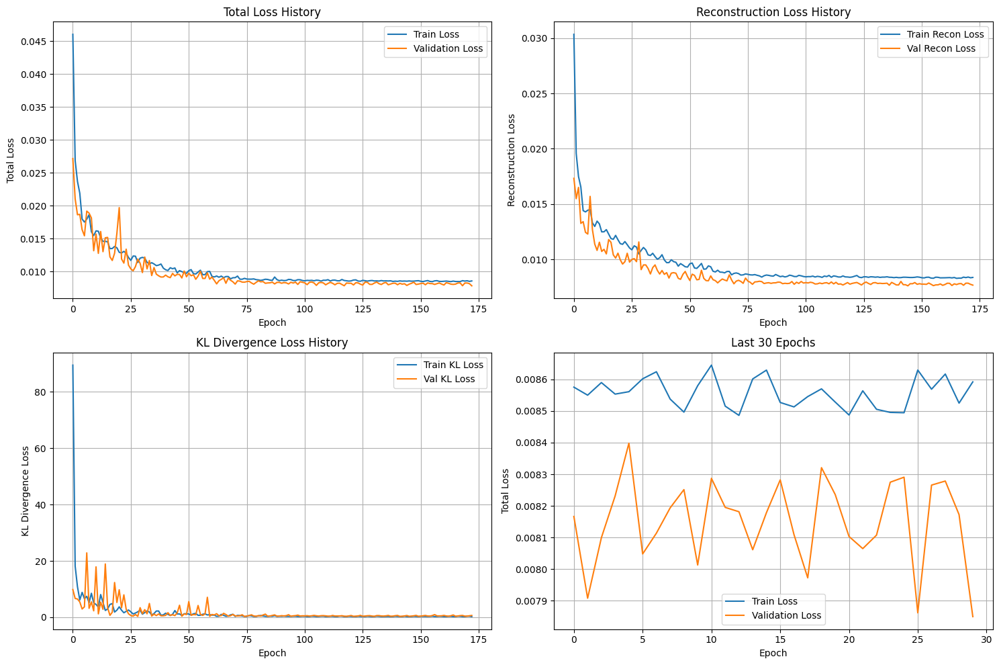


Training completed in 162.69 minutes
Best validation loss: 0.007850


In [50]:
# Extra test - Vae v6
if __name__ == "__main__":
    # Create the VAE model
    model = VAE(latent_dim=256)
    
    # Create VAE configuration
    config = VAEConfig(
        latent_dim=256,
        batch_size=8,
        accumulation_steps=8,        # Effective batch size = 64
        learning_rate=2e-5,
        epochs=300,
        beta=0.001,                 # Reduced from 0.005 to 0.0005 (10x smaller)
        beta_warmup_steps=2000,      # Increased from 2000 to 10000
        early_stopping_patience=20,
        use_mixed_precision=True,
        num_workers=4,
        model_name="vae_model_v6"    # New model name to avoid overwriting
    )
    
    # Train the VAE
    results = train_vae(model, train_loader, val_loader, config)

### Evaluation and Result Visualization

In [27]:
# Cell 18: VAE Evaluation and Visualization
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
import numpy as np
from pathlib import Path
import json
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import seaborn as sns
from tqdm import tqdm
import gc

def load_trained_vae(checkpoint_dir, model_name='vae_model_v2', latent_dim=256):
    """Load trained VAE model for evaluation with robust error handling"""
    model_path = Path(checkpoint_dir) / f"{model_name}_best.pth"
    checkpoint_path = Path(checkpoint_dir) / f"{model_name}_checkpoint.pth"
    metadata_path = Path(checkpoint_dir) / f"{model_name}_metadata.json"

    # Set device
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {device}")
    
    # Create VAE model
    model = VAE(latent_dim=latent_dim)
    
    # Load model weights with error handling
    try:
        if model_path.exists():
            print(f"Loading best VAE model from {model_path}")
            model.load_state_dict(torch.load(model_path, map_location=device))
        elif checkpoint_path.exists():
            print(f"Best model not found. Loading from checkpoint at {checkpoint_path}")
            checkpoint = torch.load(checkpoint_path, map_location=device)
            model.load_state_dict(checkpoint['model_state_dict'])
            print(f"Loaded VAE checkpoint from epoch {checkpoint.get('epoch', 'unknown')}")
        else:
            raise FileNotFoundError(f"No VAE model found at {model_path} or {checkpoint_path}")
    except Exception as e:
        print(f"Error loading VAE model: {str(e)}")
        print("Available files in directory:")
        for file in Path(checkpoint_dir).glob("*"):
            print(f" - {file.name}")
        raise

    # Load training history
    if metadata_path.exists():
        with open(metadata_path, 'r') as f:
            metadata = json.load(f)
        print(f"Loaded training history with {len(metadata.get('train_losses', []))} epochs")
    else:
        metadata = {"train_losses": [], "val_losses": [], 
                   "train_recon_losses": [], "train_kl_losses": [],
                   "val_recon_losses": [], "val_kl_losses": []}
        print("No metadata found, using empty history")

    # Move model to device and set to evaluation mode
    model.eval()
    model.to(device)

    return model, metadata

def plot_vae_training_history(metadata):
    """Plot full VAE training history including component losses"""
    plt.figure(figsize=(15, 10))

    # Extract loss data from metadata
    train_losses = metadata.get("train_losses", [])
    val_losses = metadata.get("val_losses", [])
    train_recon_losses = metadata.get("train_recon_losses", [])
    train_kl_losses = metadata.get("train_kl_losses", [])
    val_recon_losses = metadata.get("val_recon_losses", [])
    val_kl_losses = metadata.get("val_kl_losses", [])

    # 1. Plot total loss (train & validation)
    plt.subplot(2, 2, 1)
    plt.plot(train_losses, label='Train Loss')
    plt.plot(val_losses, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Total Loss')
    plt.title('Total Loss History')
    plt.legend()
    plt.grid(True, alpha=0.3)

    # 2. Plot reconstruction loss (train & validation)
    plt.subplot(2, 2, 2)
    plt.plot(train_recon_losses, label='Train Recon Loss')
    plt.plot(val_recon_losses, label='Val Recon Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Reconstruction Loss')
    plt.title('Reconstruction Loss History')
    plt.legend()
    plt.grid(True, alpha=0.3)

    # 3. Plot KL loss (train & validation)
    plt.subplot(2, 2, 3)
    plt.plot(train_kl_losses, label='Train KL Loss')
    plt.plot(val_kl_losses, label='Val KL Loss')
    plt.xlabel('Epoch')
    plt.ylabel('KL Divergence Loss')
    plt.title('KL Divergence Loss History')
    plt.legend()
    plt.grid(True, alpha=0.3)

    # 4. Plot recent total loss (last 30 epochs or all if < 30)
    plt.subplot(2, 2, 4)
    recent = min(30, len(train_losses))
    if recent > 5:  # Only plot recent history if we have enough epochs
        plt.plot(train_losses[-recent:], label='Train Loss')
        plt.plot(val_losses[-recent:], label='Validation Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Total Loss')
        plt.title(f'Last {recent} Epochs')
        plt.legend()
        plt.grid(True, alpha=0.3)

    plt.tight_layout()
    plt.show()

def visualize_vae_reconstructions(model, dataloader, num_samples=3):
    """Visualize original vs reconstructed volumes from VAE with anatomically relevant slices"""
    device = next(model.parameters()).device
    
    # Get samples from dataloader
    samples = []
    labels = []
    
    for batch in dataloader:
        volumes = batch['volume']
        batch_labels = batch['label']
        
        for i in range(min(len(volumes), num_samples - len(samples))):
            samples.append(volumes[i:i+1])
            labels.append(batch_labels[i])
        
        if len(samples) >= num_samples:
            break
    
    # Visualize each sample
    with torch.no_grad():
        for idx, (sample, label) in enumerate(zip(samples, labels)):
            # Get original volume
            orig_vol = sample.to(device)
            
            # Generate reconstruction
            reconstructed, mu, log_var = model(orig_vol)
            
            # Move to CPU for visualization
            orig_vol_np = orig_vol.cpu().squeeze().numpy()
            recon_vol_np = reconstructed.cpu().squeeze().numpy()
            
            # Create figure for this sample
            fig = plt.figure(figsize=(16, 12))
            plt.suptitle(f"VAE Sample {idx+1} - Group: {label}", fontsize=16)
            
            # Define anatomically relevant slices
            axial_slice = 32      # Axial view - slice 32
            coronal_slice = 50    # Coronal view - slice 50
            sagittal_slice1 = 55  # Sagittal view - slice 55
            sagittal_slice2 = 70  # Sagittal view - slice 70
            
            # Plot original slices - top row
            plt.subplot(2, 4, 1)
            plt.imshow(orig_vol_np[axial_slice], cmap='gray', vmin=0, vmax=3)
            plt.title(f"Original - Axial (z={axial_slice})")
            plt.axis('off')
            
            plt.subplot(2, 4, 2)
            plt.imshow(orig_vol_np[:, coronal_slice, :], cmap='gray', vmin=0, vmax=3)
            plt.title(f"Original - Coronal (y={coronal_slice})")
            plt.axis('off')
            
            plt.subplot(2, 4, 3)
            plt.imshow(orig_vol_np[:, :, sagittal_slice1], cmap='gray', vmin=0, vmax=3)
            plt.title(f"Original - Sagittal (x={sagittal_slice1})")
            plt.axis('off')
            
            plt.subplot(2, 4, 4)
            plt.imshow(orig_vol_np[:, :, sagittal_slice2], cmap='gray', vmin=0, vmax=3)
            plt.title(f"Original - Sagittal (x={sagittal_slice2})")
            plt.axis('off')
            
            # Plot reconstructed slices - bottom row
            plt.subplot(2, 4, 5)
            plt.imshow(recon_vol_np[axial_slice], cmap='gray', vmin=0, vmax=3)
            plt.title(f"Reconstructed - Axial (z={axial_slice})")
            plt.axis('off')
            
            plt.subplot(2, 4, 6)
            plt.imshow(recon_vol_np[:, coronal_slice, :], cmap='gray', vmin=0, vmax=3)
            plt.title(f"Reconstructed - Coronal (y={coronal_slice})")
            plt.axis('off')
            
            plt.subplot(2, 4, 7)
            plt.imshow(recon_vol_np[:, :, sagittal_slice1], cmap='gray', vmin=0, vmax=3)
            plt.title(f"Reconstructed - Sagittal (x={sagittal_slice1})")
            plt.axis('off')
            
            plt.subplot(2, 4, 8)
            plt.imshow(recon_vol_np[:, :, sagittal_slice2], cmap='gray', vmin=0, vmax=3)
            plt.title(f"Reconstructed - Sagittal (x={sagittal_slice2})")
            plt.axis('off')
            
            plt.tight_layout()
            plt.show()

def extract_vae_latent_vectors(model, dataloader, max_samples=200):
    """Extract latent vectors from VAE encoder"""
    device = next(model.parameters()).device

    latent_means = []
    latent_logvars = []
    labels = []
    paths = []

    with torch.no_grad():
        for batch in tqdm(dataloader, desc="Extracting VAE latent vectors"):
            try:
                volumes = batch['volume'].to(device)
                batch_labels = batch['label']
                batch_paths = batch['path']

                # Extract latent vectors (both mean and log_var)
                mu, log_var = model.encode(volumes)

                # Store results
                latent_means.append(mu.cpu().numpy())
                latent_logvars.append(log_var.cpu().numpy())
                labels.extend(batch_labels)
                paths.extend(batch_paths)

                # Memory cleanup
                del volumes, mu, log_var
                torch.cuda.empty_cache()

                # Check if we have enough samples
                if max_samples and len(labels) >= max_samples:
                    latent_means = np.vstack(latent_means)
                    latent_logvars = np.vstack(latent_logvars)
                    latent_means = latent_means[:max_samples]
                    latent_logvars = latent_logvars[:max_samples]
                    labels = labels[:max_samples]
                    paths = paths[:max_samples]
                    break
            
            except Exception as e:
                print(f"Error processing batch: {str(e)}")
                continue

    # Stack all latent vectors if we didn't break early
    if isinstance(latent_means[0], np.ndarray):
        latent_means = np.vstack(latent_means)
        latent_logvars = np.vstack(latent_logvars)

    return latent_means, latent_logvars, labels, paths

def visualize_latent_space(latent_vectors, labels, method='tsne'):
    """Visualize latent space using t-SNE or PCA"""
    plt.figure(figsize=(10, 8))

    # Create label-to-color mapping for consistent colors
    unique_labels = list(set(labels))
    colors = plt.cm.tab10(np.linspace(0, 1, len(unique_labels)))
    label_to_color = {label: colors[i] for i, label in enumerate(unique_labels)}

    # Apply dimensionality reduction
    if method.lower() == 'tsne':
        print("Computing t-SNE projection...")
        reducer = TSNE(n_components=2, random_state=42, perplexity=min(30, len(latent_vectors) - 1))
        title = 't-SNE Visualization of VAE Latent Space'
    else:
        print("Computing PCA projection...")
        reducer = PCA(n_components=2, random_state=42)
        title = 'PCA Visualization of VAE Latent Space'

    # Apply reduction
    reduced_vecs = reducer.fit_transform(latent_vectors)

    # Create scatter plot
    for label in unique_labels:
        # Get indices where this label appears
        indices = [i for i, l in enumerate(labels) if l == label]

        # Plot these points
        plt.scatter(
            reduced_vecs[indices, 0],
            reduced_vecs[indices, 1],
            label=label,
            color=label_to_color[label],
            alpha=0.7,
            edgecolor='w',
            s=100
        )

    plt.title(title, fontsize=14)
    plt.xlabel("Dimension 1", fontsize=12)
    plt.ylabel("Dimension 2", fontsize=12)
    plt.legend(title="Group", fontsize=10)
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()

    return reduced_vecs

def plot_latent_dimension_activation(latent_vectors, labels):
    """Analyze activation patterns of latent dimensions"""
    # Create a DataFrame with latent dimensions and labels
    import pandas as pd

    # First, convert labels to categorical for better plotting
    unique_labels = list(set(labels))
    label_map = {label: i for i, label in enumerate(unique_labels)}
    label_indices = [label_map[label] for label in labels]

    # Create DataFrames
    latent_df = pd.DataFrame(latent_vectors)
    latent_df['label'] = labels

    # Compute mean activation by group
    mean_activations = {}
    for label in unique_labels:
        group_vectors = latent_vectors[np.array(labels) == label]
        mean_activations[label] = np.mean(group_vectors, axis=0)

    # Identify top discriminative dimensions
    activation_matrix = np.vstack([mean_activations[label] for label in unique_labels])
    variance = np.var(activation_matrix, axis=0)
    top_dims = np.argsort(variance)[-10:]  # Top 10 dimensions

    # Plot mean activation for top dimensions
    plt.figure(figsize=(14, 6))

    # Plot heatmap
    plt.subplot(1, 2, 1)
    heatmap_data = pd.DataFrame({
        f"Dim {i}": [mean_activations[label][i] for label in unique_labels]
        for i in top_dims
    })
    heatmap_data.index = unique_labels

    sns.heatmap(heatmap_data, cmap='coolwarm', center=0,
               annot=True, fmt=".2f", cbar_kws={'label': 'Mean Activation'})
    plt.title("Mean Activation of Top Discriminative Dimensions")

    # Plot box plots for top 5 dimensions
    plt.subplot(1, 2, 2)

    # Create data for boxplot
    plot_data = []
    labels_for_plot = []
    positions = []

    for i, dim in enumerate(top_dims[:5]):  # Top 5 for clarity
        for j, label in enumerate(unique_labels):
            group_values = latent_vectors[np.array(labels) == label, dim]
            plot_data.append(group_values)
            labels_for_plot.append(f"{label}")
            positions.append(i + j * 0.25)

    # Create boxplot
    boxplot = plt.boxplot(plot_data, positions=positions, patch_artist=True, widths=0.15)

    # Customize boxplot colors
    colors = plt.cm.tab10(np.linspace(0, 1, len(unique_labels)))
    for i, label in enumerate(unique_labels):
        indices = [j for j, l in enumerate(labels_for_plot) if l == label]
        for idx in indices:
            boxplot['boxes'][idx].set_facecolor(colors[i])

    # Add labels and ticks
    plt.xticks([i + (len(unique_labels) - 1) * 0.125 for i in range(5)],
              [f"Dim {d}" for d in top_dims[:5]])
    plt.title("Distribution of Top 5 Discriminative Dimensions")
    plt.ylabel("Activation Value")

    # Add legend
    for i, label in enumerate(unique_labels):
        plt.plot([], [], 'o', color=colors[i], label=label)
    plt.legend(title="Group")

    plt.tight_layout()
    plt.show()

    return top_dims

def compute_reconstruction_error(model, dataloader):
    """Compute detailed reconstruction error metrics on validation set"""
    device = next(model.parameters()).device
    criterion = nn.MSELoss(reduction='none')

    total_mse = 0
    total_samples = 0
    error_by_label = {}
    kl_by_label = {}

    with torch.no_grad():
        for batch in tqdm(dataloader, desc="Computing metrics"):
            volumes = batch['volume'].to(device)
            labels = batch['label']

            # Get reconstructions and latent variables
            reconstructed, mu, log_var = model(volumes)

            # Compute MSE loss per sample
            mse = criterion(reconstructed, volumes)

            # Average over dimensions
            mse = mse.mean(dim=(1, 2, 3, 4)).cpu().numpy()
            
            # Compute KL divergence
            kl_div = -0.5 * torch.sum(1 + log_var - mu.pow(2) - log_var.exp(), dim=1).cpu().numpy()

            # Track overall error
            total_mse += mse.sum()
            total_samples += volumes.shape[0]

            # Track error by label
            for i, label in enumerate(labels):
                if label not in error_by_label:
                    error_by_label[label] = []
                    kl_by_label[label] = []
                error_by_label[label].append(mse[i])
                kl_by_label[label].append(kl_div[i])

    # Calculate overall metrics
    avg_mse = total_mse / total_samples
    rmse = np.sqrt(avg_mse)

    print("\nReconstruction Error Metrics:")
    print(f"Overall MSE: {avg_mse:.6f}")
    print(f"Overall RMSE: {rmse:.6f}")

    # Calculate metrics by group
    print("\nReconstruction Error by Group:")
    for label, errors in error_by_label.items():
        group_mse = np.mean(errors)
        group_rmse = np.sqrt(group_mse)
        group_std = np.std(errors)
        group_kl = np.mean(kl_by_label[label])
        print(f"{label}:")
        print(f"  MSE: {group_mse:.6f} ± {group_std:.6f}")
        print(f"  RMSE: {group_rmse:.6f}")
        print(f"  KL Divergence: {group_kl:.6f}")

    # Plot error distribution by group
    plt.figure(figsize=(15, 6))
    
    # MSE Distribution
    plt.subplot(1, 2, 1)
    for label, errors in error_by_label.items():
        sns.histplot(errors, alpha=0.5, label=label, bins=20, kde=True)
    plt.title("Reconstruction Error Distribution by Group")
    plt.xlabel("Mean Squared Error")
    plt.ylabel("Count")
    plt.legend()
    plt.grid(True, alpha=0.3)
    
    # KL Divergence Distribution
    plt.subplot(1, 2, 2)
    for label, kl_values in kl_by_label.items():
        sns.histplot(kl_values, alpha=0.5, label=label, bins=20, kde=True)
    plt.title("KL Divergence Distribution by Group")
    plt.xlabel("KL Divergence")
    plt.ylabel("Count")
    plt.legend()
    plt.grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.show()

    return avg_mse, error_by_label, kl_by_label

def find_vae_outliers(model, dataloader, threshold_std=2.5):
    """Identify outliers based on reconstruction error"""
    device = next(model.parameters()).device
    criterion = nn.MSELoss(reduction='none')

    all_errors = []
    all_paths = []
    all_labels = []
    all_kl_divs = []

    with torch.no_grad():
        for batch in tqdm(dataloader, desc="Finding outliers"):
            volumes = batch['volume'].to(device)
            paths = batch['path']
            labels = batch['label']

            # Get reconstructions and latent variables
            reconstructed, mu, log_var = model(volumes)

            # Compute MSE loss per sample
            mse = criterion(reconstructed, volumes)

            # Average over dimensions
            mse = mse.mean(dim=(1, 2, 3, 4)).cpu().numpy()
            
            # Compute KL divergence
            kl_div = -0.5 * torch.sum(1 + log_var - mu.pow(2) - log_var.exp(), dim=1).cpu().numpy()

            # Store results
            all_errors.extend(mse)
            all_paths.extend(paths)
            all_labels.extend(labels)
            all_kl_divs.extend(kl_div)

    # Convert to numpy arrays
    all_errors = np.array(all_errors)
    all_kl_divs = np.array(all_kl_divs)

    # Compute statistics
    mean_error = np.mean(all_errors)
    std_error = np.std(all_errors)

    # Find outliers (samples with error > mean + threshold_std * std)
    threshold = mean_error + threshold_std * std_error
    outlier_indices = np.where(all_errors > threshold)[0]

    print(f"\nOutlier Analysis:")
    print(f"Mean error: {mean_error:.6f}")
    print(f"Error standard deviation: {std_error:.6f}")
    print(f"Outlier threshold: {threshold:.6f}")
    print(f"Found {len(outlier_indices)} outliers out of {len(all_errors)} samples ({len(outlier_indices)/len(all_errors)*100:.2f}%)")

    # Create dictionary of outliers
    outliers = {
        all_paths[i]: {
            'error': all_errors[i],
            'label': all_labels[i],
            'kl_div': all_kl_divs[i],
            'z_score': (all_errors[i] - mean_error) / std_error
        }
        for i in outlier_indices
    }

    # Plot error distribution with outlier threshold
    plt.figure(figsize=(15, 6))
    
    # Plot MSE distribution
    plt.subplot(1, 2, 1)
    plt.hist(all_errors, bins=30, alpha=0.7)
    plt.axvline(threshold, color='r', linestyle='--', label=f'Threshold ({threshold_std} std)')
    plt.title("Reconstruction Error Distribution")
    plt.xlabel("Mean Squared Error")
    plt.ylabel("Count")
    plt.legend()
    plt.grid(True, alpha=0.3)
    
    # Plot error vs KL divergence, highlighting outliers
    plt.subplot(1, 2, 2)
    plt.scatter(all_errors, all_kl_divs, alpha=0.5, s=20, label="Normal samples")
    
    # Highlight outliers
    outlier_errors = [all_errors[i] for i in outlier_indices]
    outlier_kl_divs = [all_kl_divs[i] for i in outlier_indices]
    plt.scatter(outlier_errors, outlier_kl_divs, color='r', s=50, label="Outliers")
    
    plt.axvline(threshold, color='r', linestyle='--')
    plt.title("Error vs KL Divergence")
    plt.xlabel("Reconstruction Error (MSE)")
    plt.ylabel("KL Divergence")
    plt.legend()
    plt.grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.show()

    return outliers, all_errors, all_paths, all_labels

def visualize_vae_outliers(model, outliers, top_n=5):
    """Visualize the top outliers with highest reconstruction error"""
    device = next(model.parameters()).device

    # Sort outliers by error (descending)
    sorted_outliers = sorted(outliers.items(), key=lambda x: x[1]['error'], reverse=True)

    # Visualize top outliers
    num_outliers = min(top_n, len(sorted_outliers))

    for i in range(num_outliers):
        path, info = sorted_outliers[i]
        error = info['error']
        label = info['label']
        z_score = info['z_score']
        kl_div = info['kl_div']

        try:
            # Load the original volume
            with torch.no_grad():
                # Load DICOM file
                original_volume, _ = load_dicom(path)
                original_volume = original_volume[9:73, :, :]

                # Process volume
                norm_vol, _, _ = process_volume(original_volume, target_shape=(64, 128, 128))

                # Convert to tensor and add batch dimension
                vol_tensor = torch.from_numpy(np.expand_dims(norm_vol, axis=(0, 1))).float().to(device)

                # Get reconstruction
                reconstructed, mu, log_var = model(vol_tensor)

                # Move tensors to CPU and remove batch and channel dimensions
                vol_np = vol_tensor.cpu().squeeze().numpy()
                recon_np = reconstructed.cpu().squeeze().numpy()

                # Create figure
                fig = plt.figure(figsize=(16, 12))
                plt.suptitle(f"Outlier {i+1}: {path.split('/')[-1]}\nGroup: {label}, Error: {error:.6f}, Z-score: {z_score:.2f}, KL Div: {kl_div:.2f}", fontsize=14)
                
                # Define anatomically relevant slices
                axial_slice = 32      # Axial view - slice 32
                coronal_slice = 50    # Coronal view - slice 50
                sagittal_slice1 = 55  # Sagittal view - slice 55
                sagittal_slice2 = 70  # Sagittal view - slice 70
                
                # Plot original slices - top row
                plt.subplot(2, 4, 1)
                plt.imshow(vol_np[axial_slice], cmap='gray', vmin=0, vmax=3)
                plt.title(f"Original - Axial (z={axial_slice})")
                plt.axis('off')
                
                plt.subplot(2, 4, 2)
                plt.imshow(vol_np[:, coronal_slice, :], cmap='gray', vmin=0, vmax=3)
                plt.title(f"Original - Coronal (y={coronal_slice})")
                plt.axis('off')
                
                plt.subplot(2, 4, 3)
                plt.imshow(vol_np[:, :, sagittal_slice1], cmap='gray', vmin=0, vmax=3)
                plt.title(f"Original - Sagittal (x={sagittal_slice1})")
                plt.axis('off')
                
                plt.subplot(2, 4, 4)
                plt.imshow(vol_np[:, :, sagittal_slice2], cmap='gray', vmin=0, vmax=3)
                plt.title(f"Original - Sagittal (x={sagittal_slice2})")
                plt.axis('off')
                
                # Plot reconstructed slices - bottom row
                plt.subplot(2, 4, 5)
                plt.imshow(recon_np[axial_slice], cmap='gray', vmin=0, vmax=3)
                plt.title(f"Reconstructed - Axial (z={axial_slice})")
                plt.axis('off')
                
                plt.subplot(2, 4, 6)
                plt.imshow(recon_np[:, coronal_slice, :], cmap='gray', vmin=0, vmax=3)
                plt.title(f"Reconstructed - Coronal (y={coronal_slice})")
                plt.axis('off')
                
                plt.subplot(2, 4, 7)
                plt.imshow(recon_np[:, :, sagittal_slice1], cmap='gray', vmin=0, vmax=3)
                plt.title(f"Reconstructed - Sagittal (x={sagittal_slice1})")
                plt.axis('off')
                
                plt.subplot(2, 4, 8)
                plt.imshow(recon_np[:, :, sagittal_slice2], cmap='gray', vmin=0, vmax=3)
                plt.title(f"Reconstructed - Sagittal (x={sagittal_slice2})")
                plt.axis('off')
                
                plt.tight_layout()
                plt.show()

        except Exception as e:
            print(f"Error visualizing outlier {path}: {e}")

def visualize_vae_latent_dimension(model, dataloader, dimension_idx, alpha=5.0, group=None):
    """
    Visualize what a specific VAE latent dimension represents by modifying it
    and observing the effect on brain reconstruction.

    Parameters:
        model: Trained VAE model
        dataloader: DataLoader containing samples
        dimension_idx: The latent dimension to manipulate (e.g., 63)
        alpha: Strength of the dimension manipulation
        group: Optional filter for specific patient group (e.g., 'PD', 'Control')
    """
    device = next(model.parameters()).device
    model.eval()

    # Find a suitable sample (optionally from specific group)
    for batch in dataloader:
        volumes = batch['volume']
        labels = batch['label']
        paths = batch['path']

        if group is not None:
            # Find samples from the specified group
            group_indices = [i for i, label in enumerate(labels) if label == group]
            if not group_indices:
                continue
            # Use the first matching sample
            idx = group_indices[0]
            sample = volumes[idx:idx+1].to(device)
            sample_label = labels[idx]
            sample_path = paths[idx]
        else:
            # Just use the first sample
            sample = volumes[0:1].to(device)
            sample_label = labels[0]
            sample_path = paths[0]

        break  # Exit after finding a sample

    with torch.no_grad():
        # Encode the sample to get its latent representation
        mu, log_var = model.encode(sample)
        z = model.reparameterize(mu, log_var)

        # Create modified latent vectors
        z_plus = z.clone()
        z_minus = z.clone()

        # Modify the specific dimension
        z_plus[0, dimension_idx] += alpha
        z_minus[0, dimension_idx] -= alpha

        # Decode the original and modified latent vectors
        original_reconstruction = model.decoder(z)
        plus_reconstruction = model.decoder(z_plus)
        minus_reconstruction = model.decoder(z_minus)

        # Move tensors to CPU and convert to numpy for visualization
        original_vol = original_reconstruction.cpu().squeeze().numpy()
        plus_vol = plus_reconstruction.cpu().squeeze().numpy()
        minus_vol = minus_reconstruction.cpu().squeeze().numpy()

        # Calculate the difference maps
        plus_diff = plus_vol - original_vol
        minus_diff = minus_vol - original_vol

        # Set up the figure
        fig = plt.figure(figsize=(18, 15))
        plt.suptitle(f"Visualization of VAE Dimension {dimension_idx} in Brain Space\nPatient Group: {sample_label}", fontsize=16)

        # Define anatomically relevant slices
        slices = {
            'axial': 32,       # Axial z=32
            'coronal': 50,     # Coronal y=50
            'sagittal1': 55,   # Sagittal x=55
            'sagittal2': 70    # Sagittal x=70
        }

        # Create a custom colormap for difference maps
        diff_cmap = plt.cm.RdBu_r  # Red-Blue colormap with red for negative, blue for positive

        # Row 1: Original reconstruction
        plt.subplot(5, 4, 1)
        plt.imshow(original_vol[slices['axial']], cmap='gray', vmin=0, vmax=3)
        plt.title(f"Original (Axial z={slices['axial']})")
        plt.axis('off')

        plt.subplot(5, 4, 2)
        plt.imshow(original_vol[:, slices['coronal'], :], cmap='gray', vmin=0, vmax=3)
        plt.title(f"Original (Coronal y={slices['coronal']})")
        plt.axis('off')

        plt.subplot(5, 4, 3)
        plt.imshow(original_vol[:, :, slices['sagittal1']], cmap='gray', vmin=0, vmax=3)
        plt.title(f"Original (Sagittal x={slices['sagittal1']})")
        plt.axis('off')

        plt.subplot(5, 4, 4)
        plt.imshow(original_vol[:, :, slices['sagittal2']], cmap='gray', vmin=0, vmax=3)
        plt.title(f"Original (Sagittal x={slices['sagittal2']})")
        plt.axis('off')

        # Row 2: Increased dimension
        plt.subplot(5, 4, 5)
        plt.imshow(plus_vol[slices['axial']], cmap='gray', vmin=0, vmax=3)
        plt.title(f"Dim {dimension_idx} + {alpha}")
        plt.axis('off')

        plt.subplot(5, 4, 6)
        plt.imshow(plus_vol[:, slices['coronal'], :], cmap='gray', vmin=0, vmax=3)
        plt.title(f"Dim {dimension_idx} + {alpha}")
        plt.axis('off')

        plt.subplot(5, 4, 7)
        plt.imshow(plus_vol[:, :, slices['sagittal1']], cmap='gray', vmin=0, vmax=3)
        plt.title(f"Dim {dimension_idx} + {alpha}")
        plt.axis('off')

        plt.subplot(5, 4, 8)
        plt.imshow(plus_vol[:, :, slices['sagittal2']], cmap='gray', vmin=0, vmax=3)
        plt.title(f"Dim {dimension_idx} + {alpha}")
        plt.axis('off')

        # Row 3: Decreased dimension
        plt.subplot(5, 4, 9)
        plt.imshow(minus_vol[slices['axial']], cmap='gray', vmin=0, vmax=3)
        plt.title(f"Dim {dimension_idx} - {alpha}")
        plt.axis('off')

        plt.subplot(5, 4, 10)
        plt.imshow(minus_vol[:, slices['coronal'], :], cmap='gray', vmin=0, vmax=3)
        plt.title(f"Dim {dimension_idx} - {alpha}")
        plt.axis('off')

        plt.subplot(5, 4, 11)
        plt.imshow(minus_vol[:, :, slices['sagittal1']], cmap='gray', vmin=0, vmax=3)
        plt.title(f"Dim {dimension_idx} - {alpha}")
        plt.axis('off')

        plt.subplot(5, 4, 12)
        plt.imshow(minus_vol[:, :, slices['sagittal2']], cmap='gray', vmin=0, vmax=3)
        plt.title(f"Dim {dimension_idx} - {alpha}")
        plt.axis('off')

        # Row 4: Difference map (increased - original)
        plt.subplot(5, 4, 13)
        im1 = plt.imshow(plus_diff[slices['axial']], cmap=diff_cmap, vmin=-0.5, vmax=0.5)
        plt.title(f"Difference (+)")
        plt.axis('off')

        plt.subplot(5, 4, 14)
        plt.imshow(plus_diff[:, slices['coronal'], :], cmap=diff_cmap, vmin=-0.5, vmax=0.5)
        plt.title(f"Difference (+)")
        plt.axis('off')

        plt.subplot(5, 4, 15)
        plt.imshow(plus_diff[:, :, slices['sagittal1']], cmap=diff_cmap, vmin=-0.5, vmax=0.5)
        plt.title(f"Difference (+)")
        plt.axis('off')

        plt.subplot(5, 4, 16)
        plt.imshow(plus_diff[:, :, slices['sagittal2']], cmap=diff_cmap, vmin=-0.5, vmax=0.5)
        plt.title(f"Difference (+)")
        plt.axis('off')

        # Row 5: Difference map (decreased - original)
        plt.subplot(5, 4, 17)
        im2 = plt.imshow(minus_diff[slices['axial']], cmap=diff_cmap, vmin=-0.5, vmax=0.5)
        plt.title(f"Difference (-)")
        plt.axis('off')

        plt.subplot(5, 4, 18)
        plt.imshow(minus_diff[:, slices['coronal'], :], cmap=diff_cmap, vmin=-0.5, vmax=0.5)
        plt.title(f"Difference (-)")
        plt.axis('off')

        plt.subplot(5, 4, 19)
        plt.imshow(minus_diff[:, :, slices['sagittal1']], cmap=diff_cmap, vmin=-0.5, vmax=0.5)
        plt.title(f"Difference (-)")
        plt.axis('off')

        plt.subplot(5, 4, 20)
        plt.imshow(minus_diff[:, :, slices['sagittal2']], cmap=diff_cmap, vmin=-0.5, vmax=0.5)
        plt.title(f"Difference (-)")
        plt.axis('off')

        # Add colorbar for difference maps
        cbar_ax = fig.add_axes([0.93, 0.15, 0.02, 0.3])
        cbar = plt.colorbar(im1, cax=cbar_ax)
        cbar.set_label('Difference Intensity')

        plt.tight_layout()
        plt.subplots_adjust(top=0.92, right=0.9)
        plt.show()

        # Return both the sample info and reconstructions for further analysis
        return {
            'label': sample_label,
            'path': sample_path,
            'original': original_vol,
            'plus': plus_vol,
            'minus': minus_vol,
            'plus_diff': plus_diff,
            'minus_diff': minus_diff
        }

=== Starting VAE Evaluation ===

Loading trained VAE model...
Using device: cuda
Loading best VAE model from checkpoints/vae_model_v2_best.pth
Loaded training history with 249 epochs

Plotting VAE training history...


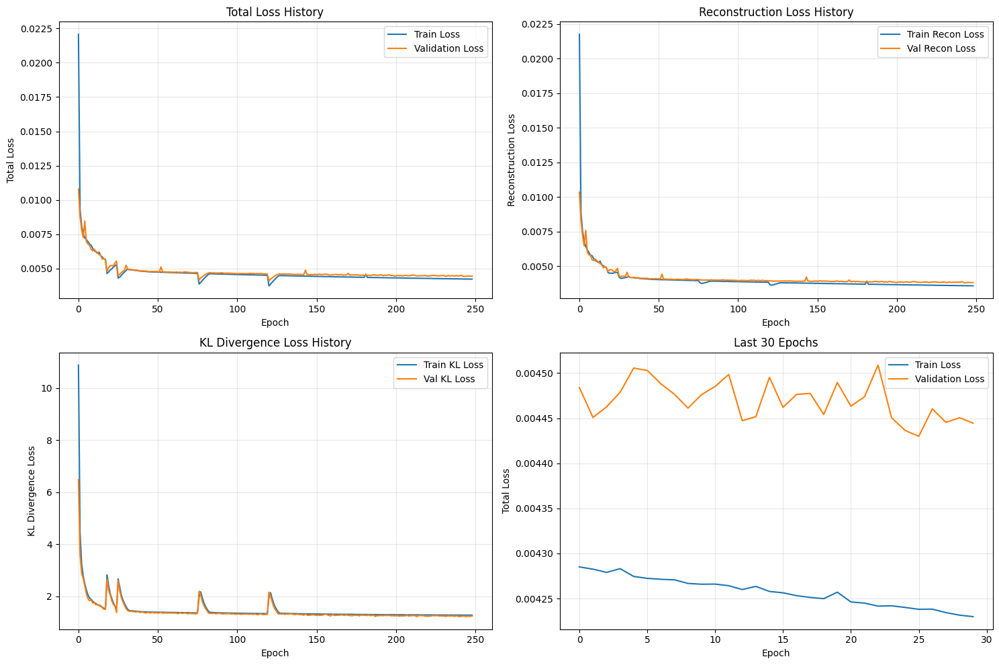


Visualizing VAE reconstructions...


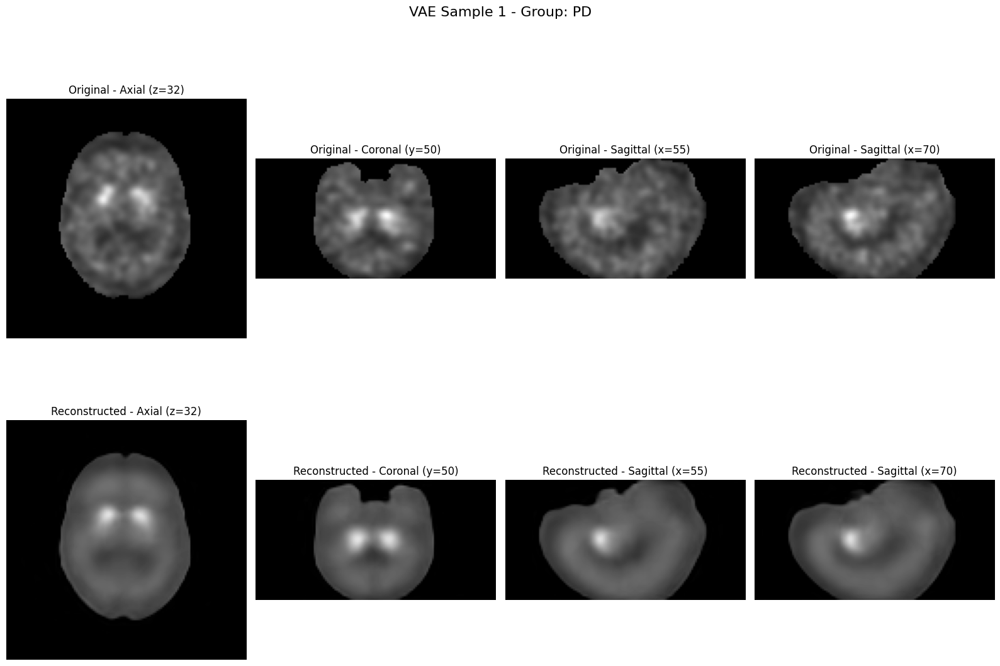

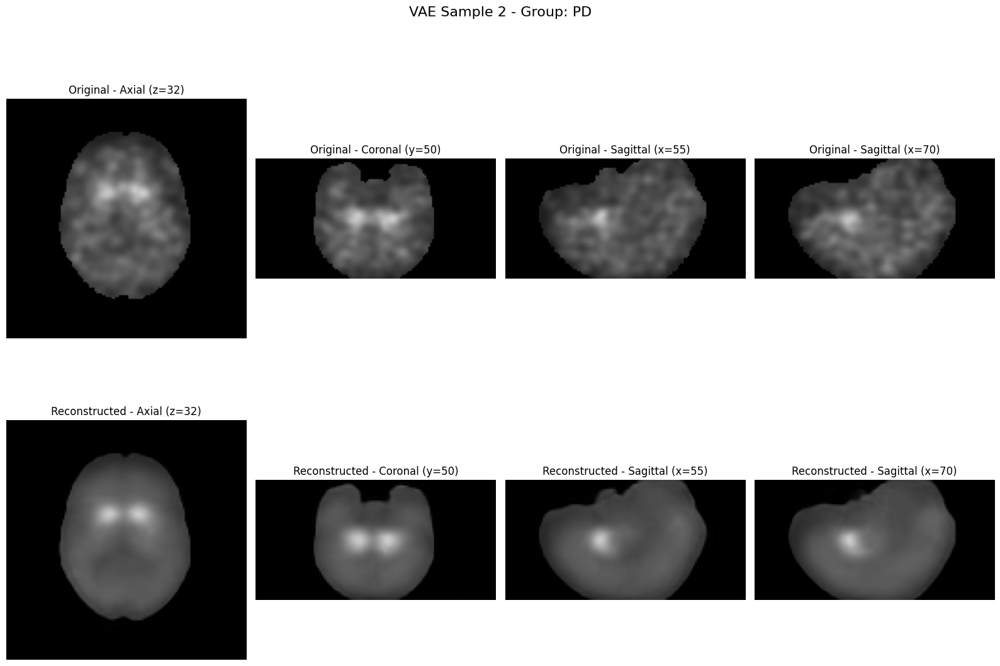

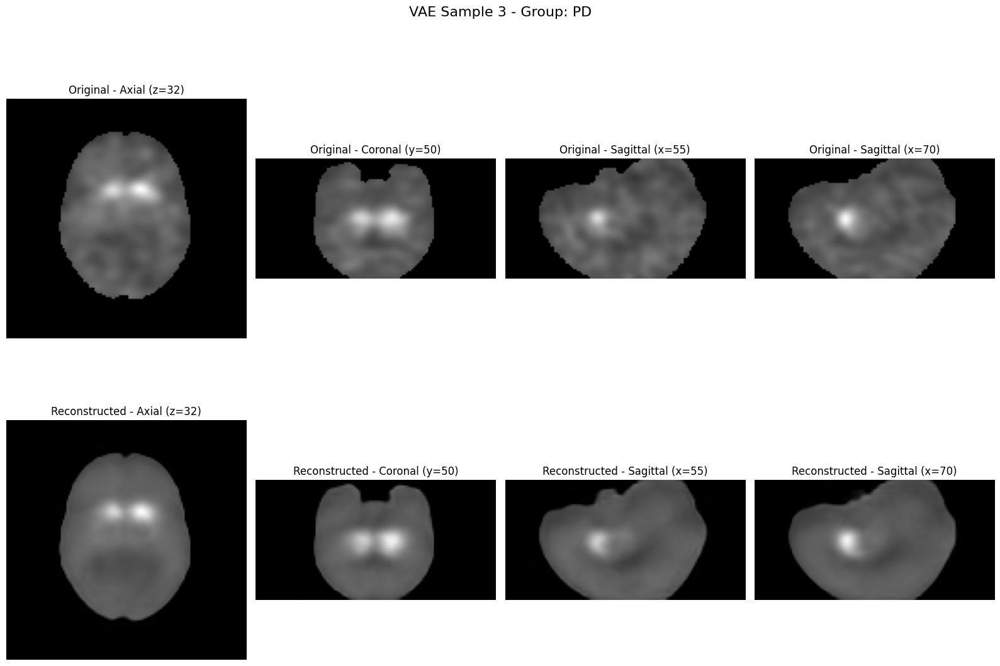


Extracting latent vectors from VAE...


Extracting VAE latent vectors:   5%|▍         | 14/299 [00:00<00:15, 18.10it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Extracting VAE latent vectors:  21%|██        | 63/299 [00:03<00:12, 18.86it/s]

Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Extracting VAE latent vectors:  33%|███▎      | 99/299 [00:05<00:10, 18.94it/s]



Visualizing latent space with t-SNE...
Computing t-SNE projection...


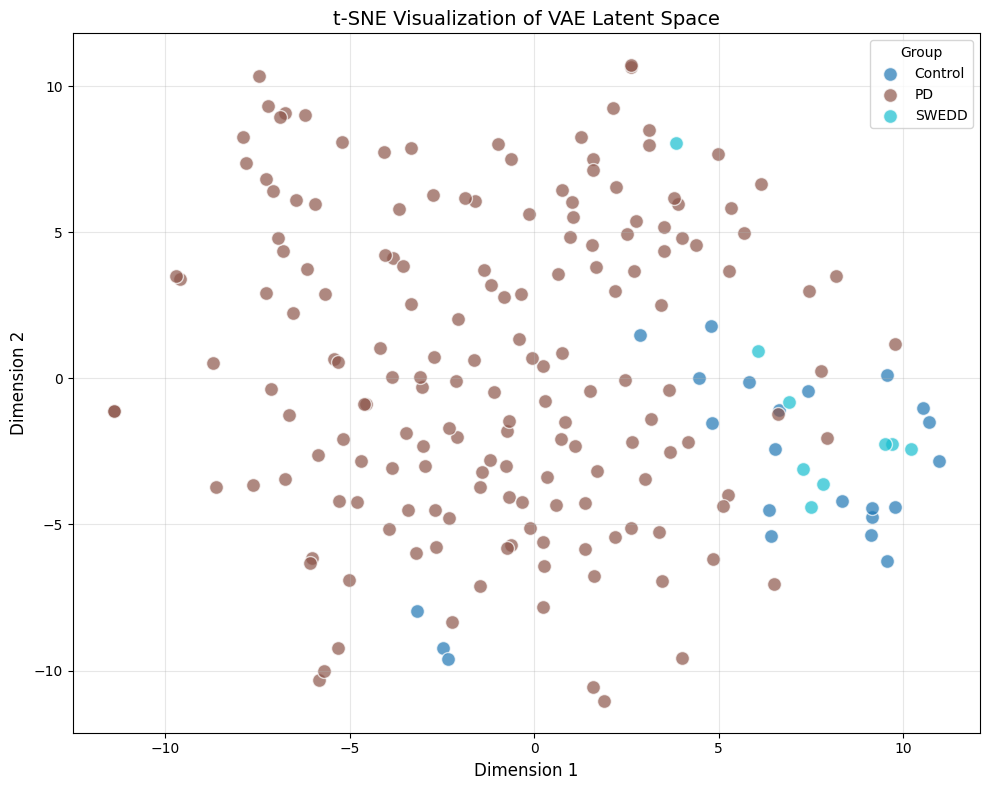


Visualizing latent space with PCA...
Computing PCA projection...


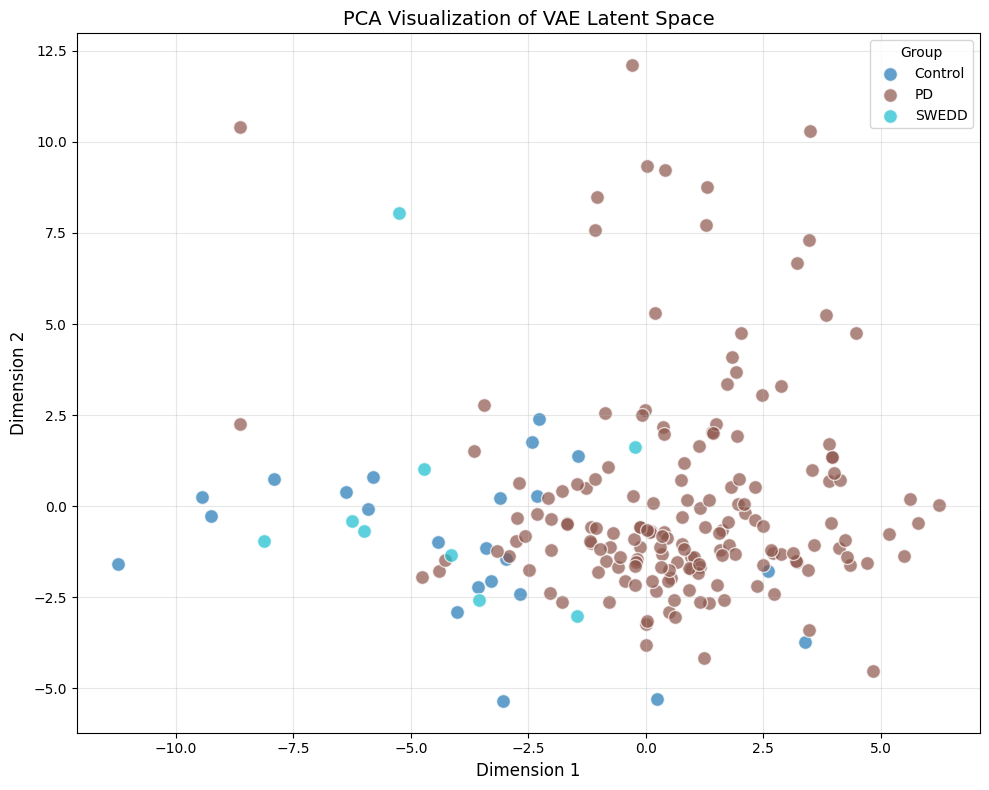


Analyzing discriminative dimensions in latent space...


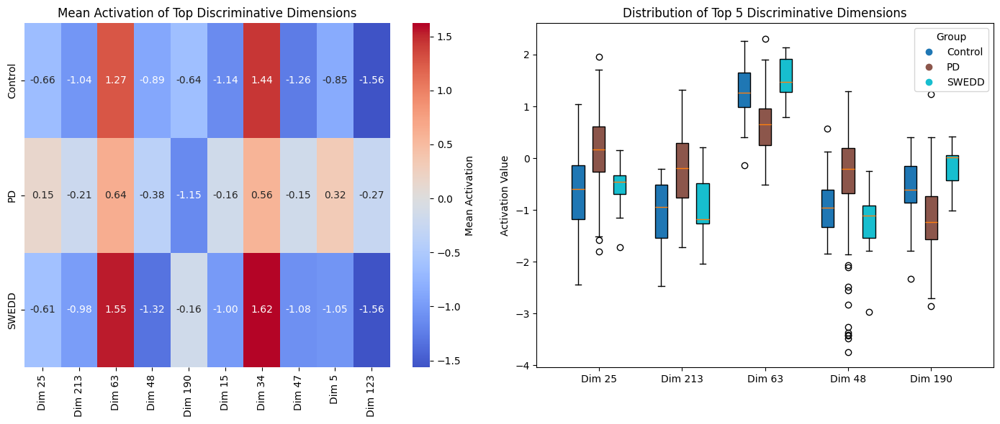


Computing reconstruction error metrics...


Computing metrics:   5%|▍         | 14/299 [00:00<00:14, 20.33it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Computing metrics:  21%|██        | 63/299 [00:03<00:12, 19.10it/s]

Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Computing metrics:  49%|████▉     | 147/299 [00:07<00:07, 19.36it/s]

Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Computing metrics: 100%|██████████| 299/299 [00:15<00:00, 19.60it/s]



Reconstruction Error Metrics:
Overall MSE: 0.003952
Overall RMSE: 0.062865

Reconstruction Error by Group:
PD:
  MSE: 0.003897 ± 0.002610
  RMSE: 0.062425
  KL Divergence: 547.625854
Control:
  MSE: 0.004468 ± 0.001314
  RMSE: 0.066841
  KL Divergence: 589.050049
SWEDD:
  MSE: 0.003871 ± 0.001576
  RMSE: 0.062216
  KL Divergence: 562.415833


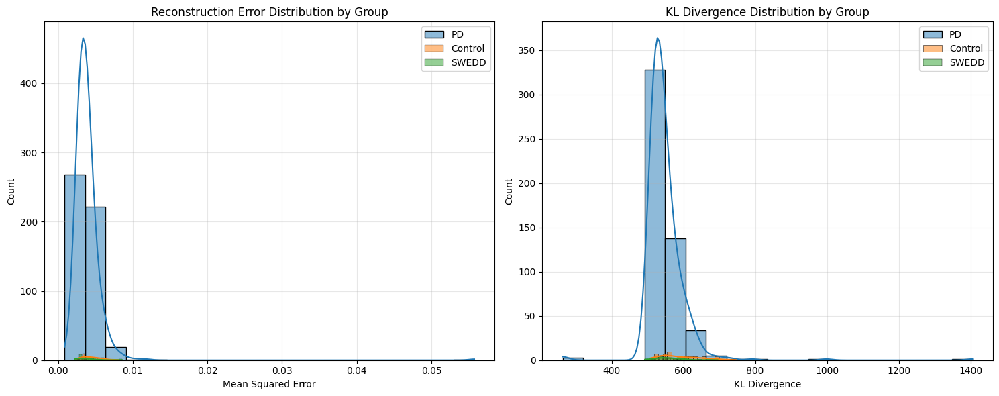


Finding and visualizing outliers...


Finding outliers:   5%|▍         | 14/299 [00:00<00:15, 18.95it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Finding outliers:  21%|██        | 63/299 [00:03<00:12, 19.08it/s]

Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Finding outliers:  49%|████▉     | 148/299 [00:10<00:07, 20.58it/s]

Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Finding outliers: 100%|██████████| 299/299 [00:18<00:00, 16.43it/s]



Outlier Analysis:
Mean error: 0.003952
Error standard deviation: 0.002479
Outlier threshold: 0.010150
Found 3 outliers out of 598 samples (0.50%)


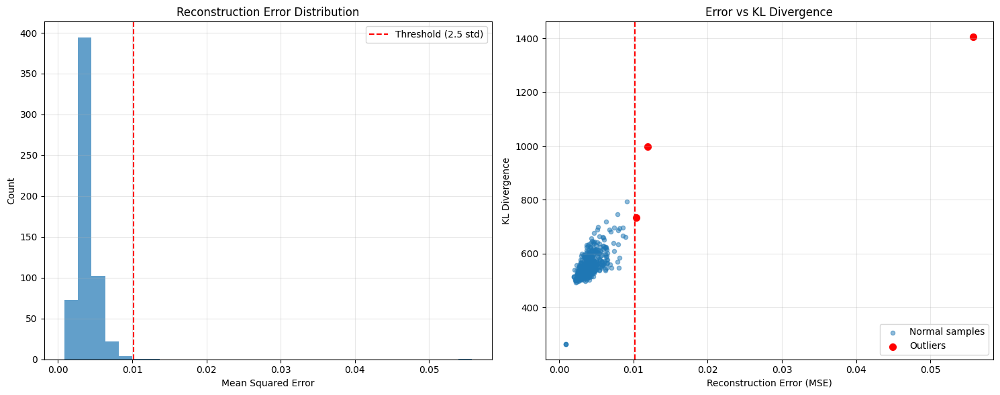

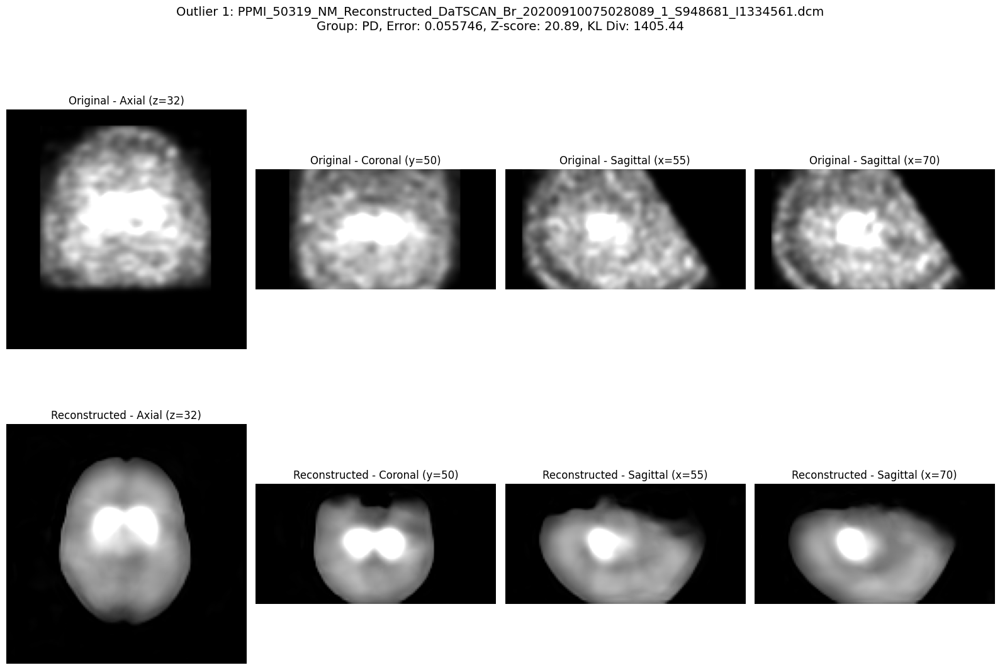

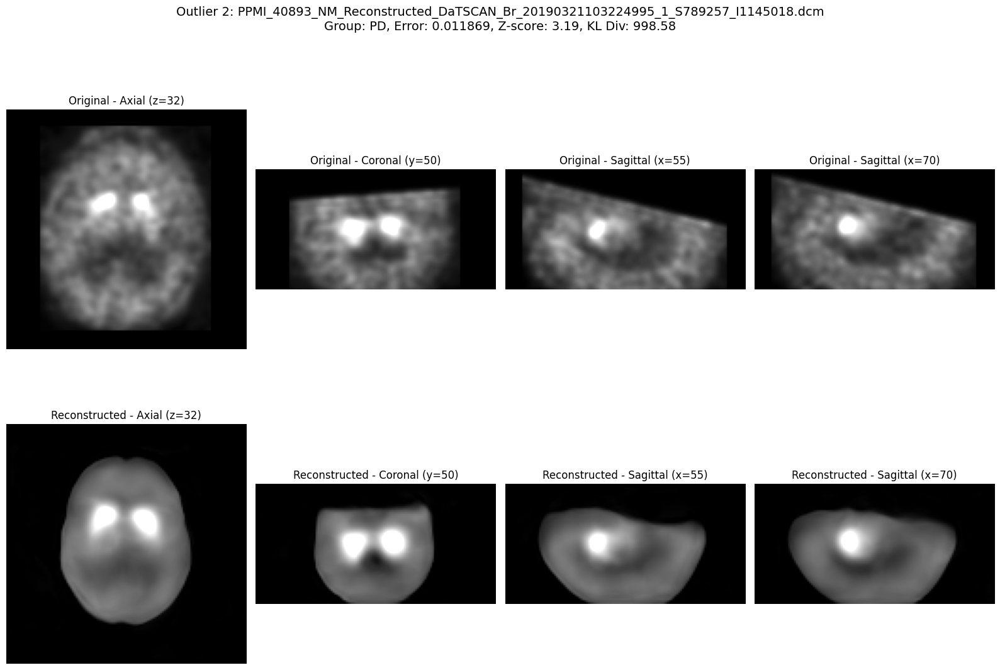

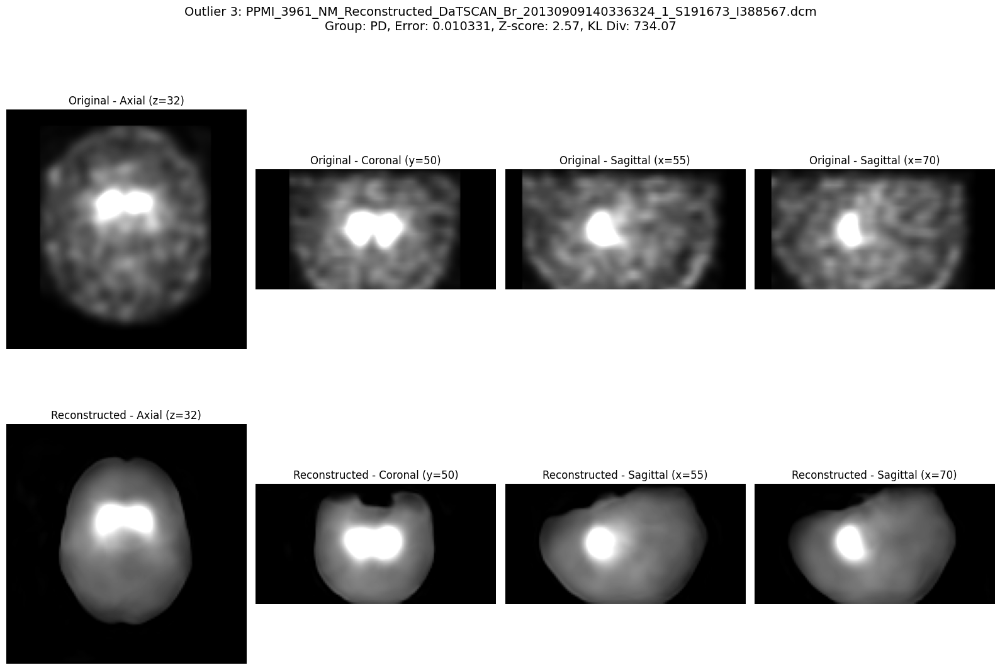


Visualizing discriminative dimensions in brain space...


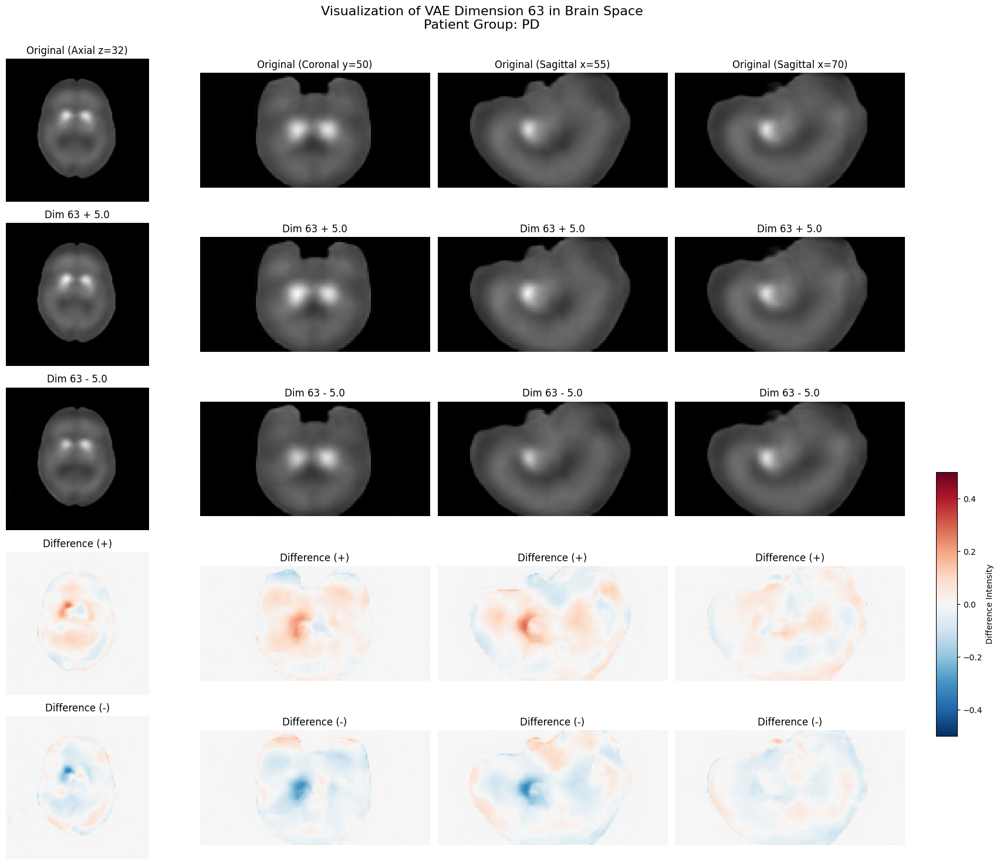

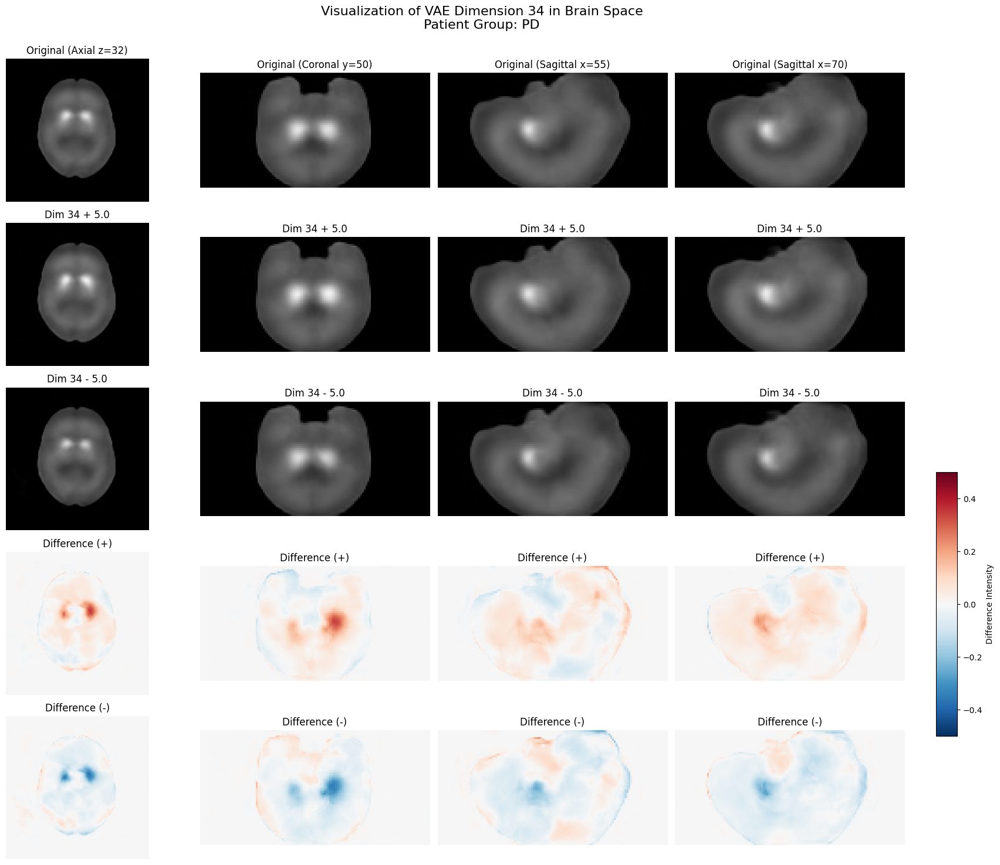

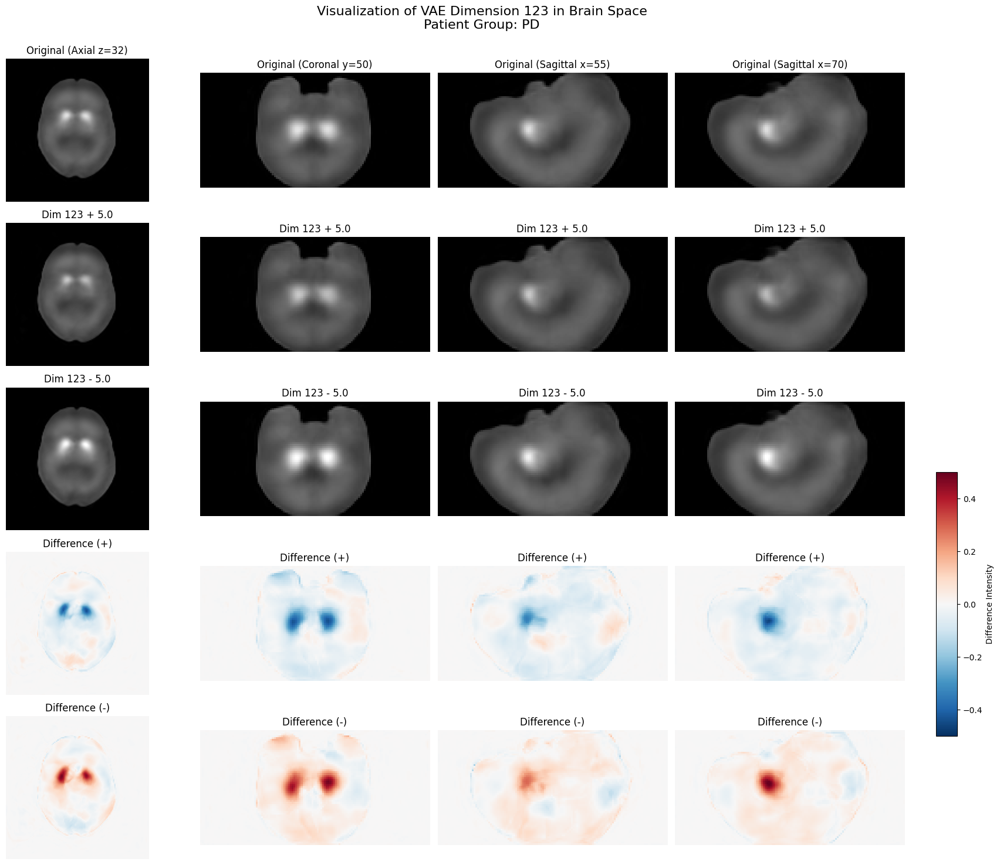


VAE Evaluation completed successfully!


In [28]:
# Run VAE evaluation
if __name__ == "__main__":
    try:
        print("=== Starting VAE Evaluation ===")
        
        # Load trained VAE model
        print("\nLoading trained VAE model...")
        vae_model, vae_metadata = load_trained_vae('checkpoints', 'vae_model_v2', latent_dim=256)
        
        # 1. Plot training history
        print("\nPlotting VAE training history...")
        plot_vae_training_history(vae_metadata)
        
        # 2. Visualize reconstructions
        print("\nVisualizing VAE reconstructions...")
        visualize_vae_reconstructions(vae_model, val_loader, num_samples=3)
        
        # 3. Extract latent vectors from VAE
        print("\nExtracting latent vectors from VAE...")
        latent_means, latent_logvars, labels, paths = extract_vae_latent_vectors(vae_model, val_loader, max_samples=200)
        
        # 4. Visualize latent space with t-SNE and PCA
        print("\nVisualizing latent space with t-SNE...")
        tsne_result = visualize_latent_space(latent_means, labels, method='tsne')
        
        print("\nVisualizing latent space with PCA...")
        pca_result = visualize_latent_space(latent_means, labels, method='pca')
        
        # 5. Analyze discriminative dimensions
        print("\nAnalyzing discriminative dimensions in latent space...")
        top_dims = plot_latent_dimension_activation(latent_means, labels)
        
        # 6. Compute and visualize reconstruction error
        print("\nComputing reconstruction error metrics...")
        avg_mse, error_by_label, kl_by_label = compute_reconstruction_error(vae_model, val_loader)
        
        # 7. Find and visualize outliers
        print("\nFinding and visualizing outliers...")
        outliers, all_errors, all_paths, all_labels = find_vae_outliers(vae_model, val_loader, threshold_std=2.5)
        visualize_vae_outliers(vae_model, outliers)
        
        # 8. Visualize latent dimensions in brain space
        print("\nVisualizing discriminative dimensions in brain space...")
        for dim in [63, 34, 123]:  # Specified dimensions
            visualize_vae_latent_dimension(vae_model, val_loader, dimension_idx=dim, alpha=5.0)
        
        print("\nVAE Evaluation completed successfully!")
    
    except Exception as e:
        print(f"Error during VAE evaluation: {str(e)}")
        import traceback
        traceback.print_exc()

In [29]:
# Cell 19: VAE Feature Importance Maps and Uncertainty Visualization with Consistent Scales
import torch
import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm
import gc
from matplotlib.colors import LinearSegmentedColormap

def generate_vae_feature_importance_map(model, dataloader, dimension_idx, group=None, num_samples=5):
    """
    Generate feature importance map for a specific VAE latent dimension
    by aggregating effects across multiple samples using anatomically relevant slices.
    Uses consistent scales across all views for better comparison.

    Parameters:
        model: Trained VAE model
        dataloader: DataLoader containing samples
        dimension_idx: The latent dimension to analyze
        group: Optional filter for specific patient group
        num_samples: Number of samples to aggregate
    """
    device = next(model.parameters()).device
    model.eval()

    # Storage for aggregated results
    aggregated_plus_diff = None
    aggregated_minus_diff = None
    sample_count = 0

    # Storage for encoding statistics
    mu_values = []
    logvar_values = []

    # Find samples (optionally from specific group)
    for batch in dataloader:
        volumes = batch['volume']
        labels = batch['label']

        if group is not None:
            # Find samples from the specified group
            group_indices = [i for i, label in enumerate(labels) if label == group]
            indices = group_indices
        else:
            # Use all samples in batch
            indices = range(len(volumes))

        for idx in indices:
            if sample_count >= num_samples:
                break

            sample = volumes[idx:idx+1].to(device)

            with torch.no_grad():
                # Encode the sample to get mean and log_var
                mu, log_var = model.encode(sample)

                # Store these for uncertainty analysis
                mu_values.append(mu[0, dimension_idx].cpu().item())
                logvar_values.append(log_var[0, dimension_idx].cpu().item())

                # Use mean as the latent vector (no sampling in evaluation)
                z = mu.clone()

                # Create modified latent vectors
                z_plus = z.clone()
                z_minus = z.clone()

                # Modify the specific dimension
                z_plus[0, dimension_idx] += 5.0
                z_minus[0, dimension_idx] -= 5.0

                # Decode the vectors
                original_reconstruction = model.decoder(z)
                plus_reconstruction = model.decoder(z_plus)
                minus_reconstruction = model.decoder(z_minus)

                # Calculate the difference maps
                plus_diff = (plus_reconstruction - original_reconstruction).cpu().squeeze().numpy()
                minus_diff = (minus_reconstruction - original_reconstruction).cpu().squeeze().numpy()

                # Aggregate the difference maps
                if aggregated_plus_diff is None:
                    aggregated_plus_diff = plus_diff
                    aggregated_minus_diff = minus_diff
                else:
                    aggregated_plus_diff += plus_diff
                    aggregated_minus_diff += minus_diff

                sample_count += 1

        if sample_count >= num_samples:
            break

    # Average the difference maps
    aggregated_plus_diff /= sample_count
    aggregated_minus_diff /= sample_count

    # Compute absolute importance map (average of plus and minus effects)
    importance_map = (np.abs(aggregated_plus_diff) + np.abs(aggregated_minus_diff)) / 2

    # Define anatomically relevant slices
    axial_slice = 32      # Axial view - slice 32
    coronal_slice = 50    # Coronal view - slice 50
    sagittal_slice1 = 55  # Sagittal view - slice 55
    sagittal_slice2 = 70  # Sagittal view - slice 70
    
    # Determine global max value for importance maps for consistent scale
    importance_max = np.max(importance_map)
    
    # Determine global min/max for activation maps for consistent scale
    activation_min = min(np.min(aggregated_plus_diff), np.min(aggregated_minus_diff))
    activation_max = max(np.max(aggregated_plus_diff), np.max(aggregated_minus_diff))
    # Make the activation scale symmetric around zero
    activation_abs_max = max(abs(activation_min), abs(activation_max))
    activation_vmin, activation_vmax = -activation_abs_max, activation_abs_max

    # Visualize the importance map
    fig = plt.figure(figsize=(16, 8))
    plt.suptitle(f"VAE Feature Importance Map for Dimension {dimension_idx}" +
                (f" (Group: {group})" if group else ""), fontsize=16)

    # Plot axial, coronal, and sagittal views for importance map - all with same scale
    plt.subplot(2, 4, 1)
    im1 = plt.imshow(importance_map[axial_slice], cmap='hot', vmin=0, vmax=importance_max)
    plt.title(f"Axial (z={axial_slice})")
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.axis('off')

    plt.subplot(2, 4, 2)
    plt.imshow(importance_map[:, coronal_slice, :], cmap='hot', vmin=0, vmax=importance_max)
    plt.title(f"Coronal (y={coronal_slice})")
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.axis('off')

    plt.subplot(2, 4, 3)
    plt.imshow(importance_map[:, :, sagittal_slice1], cmap='hot', vmin=0, vmax=importance_max)
    plt.title(f"Sagittal (x={sagittal_slice1})")
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.axis('off')

    plt.subplot(2, 4, 4)
    plt.imshow(importance_map[:, :, sagittal_slice2], cmap='hot', vmin=0, vmax=importance_max)
    plt.title(f"Sagittal (x={sagittal_slice2})")
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.axis('off')

    # Plot activating direction (positive difference) with consistent scale
    plt.subplot(2, 4, 5)
    im2 = plt.imshow(aggregated_plus_diff[axial_slice], cmap='bwr', vmin=activation_vmin, vmax=activation_vmax)
    plt.title(f"Activating Direction - Axial")
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.axis('off')

    plt.subplot(2, 4, 6)
    plt.imshow(aggregated_plus_diff[:, coronal_slice, :], cmap='bwr', vmin=activation_vmin, vmax=activation_vmax)
    plt.title(f"Activating Direction - Coronal")
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.axis('off')

    plt.subplot(2, 4, 7)
    plt.imshow(aggregated_plus_diff[:, :, sagittal_slice1], cmap='bwr', vmin=activation_vmin, vmax=activation_vmax)
    plt.title(f"Activating Direction - Sagittal 1")
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.axis('off')

    plt.subplot(2, 4, 8)
    plt.imshow(aggregated_plus_diff[:, :, sagittal_slice2], cmap='bwr', vmin=activation_vmin, vmax=activation_vmax)
    plt.title(f"Activating Direction - Sagittal 2")
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.axis('off')

    plt.tight_layout()
    plt.subplots_adjust(top=0.9)
    plt.show()

    # Print information about scales used
    print(f"Importance Map Scale: 0 to {importance_max:.3f}")
    print(f"Activation Map Scale: {activation_vmin:.3f} to {activation_vmax:.3f}")
    
    # Return values for further analysis
    mean_mu = np.mean(mu_values)
    std_mu = np.std(mu_values)
    mean_var = np.exp(np.mean(logvar_values))

    print(f"Dimension {dimension_idx} statistics:")
    print(f"  Mean activation: {mean_mu:.4f} ± {std_mu:.4f}")
    print(f"  Average variance: {mean_var:.4f}")

    return importance_map, aggregated_plus_diff, aggregated_minus_diff

def visualize_vae_uncertainty(model, dataloader, group=None, num_samples=20):
    """
    Visualize uncertainty in VAE's reconstructions by sampling
    multiple times from the latent distribution.
    Uses consistent scales across all views for better comparison.

    Parameters:
        model: Trained VAE model
        dataloader: DataLoader containing samples
        group: Optional filter for specific patient group
        num_samples: Number of samples to encode
    """
    device = next(model.parameters()).device
    model.eval()

    # Find a suitable sample from the specified group
    sample_vol = None
    sample_label = None

    for batch in dataloader:
        volumes = batch['volume']
        labels = batch['label']

        if group is not None:
            # Find first sample from specified group
            group_indices = [i for i, label in enumerate(labels) if label == group]
            if group_indices:
                idx = group_indices[0]
                sample_vol = volumes[idx:idx+1].to(device)
                sample_label = labels[idx]
                break
        else:
            # Use the first sample
            sample_vol = volumes[0:1].to(device)
            sample_label = labels[0]
            break

    if sample_vol is None:
        print(f"No samples found for group {group}")
        return

    # Generate multiple reconstructions to visualize uncertainty
    reconstructions = []

    with torch.no_grad():
        # Encode the sample to get mean and log_var
        mu, log_var = model.encode(sample_vol)

        # Generate multiple reconstructions by sampling from latent space
        for _ in range(20):  # Generate 20 different reconstructions
            # Sample from latent distribution
            std = torch.exp(0.5 * log_var)
            eps = torch.randn_like(std)
            z = mu + eps * std

            # Decode sample
            recon = model.decoder(z)
            reconstructions.append(recon.cpu().squeeze().numpy())

    # Define anatomically relevant slices
    axial_slice = 32      # Axial view - slice 32
    coronal_slice = 50    # Coronal view - slice 50
    sagittal_slice1 = 55  # Sagittal view - slice 55
    sagittal_slice2 = 70  # Sagittal view - slice 70

    # Convert sample to numpy for visualization
    sample_np = sample_vol.cpu().squeeze().numpy()

    # Calculate statistics over reconstructions
    recon_mean = np.mean(reconstructions, axis=0)
    recon_std = np.std(reconstructions, axis=0)
    
    # Determine global scale for original and mean reconstruction
    brain_vmin, brain_vmax = 0, 3  # Standard scale for brain images
    
    # Determine global max for uncertainty maps
    uncertainty_max = np.max(recon_std)

    # Visualize uncertainty
    fig = plt.figure(figsize=(16, 12))
    plt.suptitle(f"VAE Reconstruction Uncertainty - Group: {sample_label}", fontsize=16)

    # Row 1: Original sample with consistent scale
    plt.subplot(3, 4, 1)
    plt.imshow(sample_np[axial_slice], cmap='gray', vmin=brain_vmin, vmax=brain_vmax)
    plt.title(f"Original - Axial (z={axial_slice})")
    plt.axis('off')

    plt.subplot(3, 4, 2)
    plt.imshow(sample_np[:, coronal_slice, :], cmap='gray', vmin=brain_vmin, vmax=brain_vmax)
    plt.title(f"Original - Coronal (y={coronal_slice})")
    plt.axis('off')

    plt.subplot(3, 4, 3)
    plt.imshow(sample_np[:, :, sagittal_slice1], cmap='gray', vmin=brain_vmin, vmax=brain_vmax)
    plt.title(f"Original - Sagittal (x={sagittal_slice1})")
    plt.axis('off')

    plt.subplot(3, 4, 4)
    plt.imshow(sample_np[:, :, sagittal_slice2], cmap='gray', vmin=brain_vmin, vmax=brain_vmax)
    plt.title(f"Original - Sagittal (x={sagittal_slice2})")
    plt.axis('off')

    # Row 2: Mean reconstruction with consistent scale
    plt.subplot(3, 4, 5)
    plt.imshow(recon_mean[axial_slice], cmap='gray', vmin=brain_vmin, vmax=brain_vmax)
    plt.title(f"Mean Recon - Axial")
    plt.axis('off')

    plt.subplot(3, 4, 6)
    plt.imshow(recon_mean[:, coronal_slice, :], cmap='gray', vmin=brain_vmin, vmax=brain_vmax)
    plt.title(f"Mean Recon - Coronal")
    plt.axis('off')

    plt.subplot(3, 4, 7)
    plt.imshow(recon_mean[:, :, sagittal_slice1], cmap='gray', vmin=brain_vmin, vmax=brain_vmax)
    plt.title(f"Mean Recon - Sagittal 1")
    plt.axis('off')

    plt.subplot(3, 4, 8)
    plt.imshow(recon_mean[:, :, sagittal_slice2], cmap='gray', vmin=brain_vmin, vmax=brain_vmax)
    plt.title(f"Mean Recon - Sagittal 2")
    plt.axis('off')

    # Row 3: Standard deviation (uncertainty) with consistent scale
    plt.subplot(3, 4, 9)
    plt.imshow(recon_std[axial_slice], cmap='viridis', vmin=0, vmax=uncertainty_max)
    plt.title(f"Uncertainty - Axial")
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.axis('off')

    plt.subplot(3, 4, 10)
    plt.imshow(recon_std[:, coronal_slice, :], cmap='viridis', vmin=0, vmax=uncertainty_max)
    plt.title(f"Uncertainty - Coronal")
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.axis('off')

    plt.subplot(3, 4, 11)
    plt.imshow(recon_std[:, :, sagittal_slice1], cmap='viridis', vmin=0, vmax=uncertainty_max)
    plt.title(f"Uncertainty - Sagittal 1")
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.axis('off')

    plt.subplot(3, 4, 12)
    plt.imshow(recon_std[:, :, sagittal_slice2], cmap='viridis', vmin=0, vmax=uncertainty_max)
    plt.title(f"Uncertainty - Sagittal 2")
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.axis('off')

    plt.tight_layout()
    plt.subplots_adjust(top=0.9)
    plt.show()
    
    # Print information about scales used
    print(f"Brain Intensity Scale: {brain_vmin} to {brain_vmax}")
    print(f"Uncertainty Scale: 0 to {uncertainty_max:.3f}")

    return recon_mean, recon_std

def generate_full_brain_uncertainty_map(model, dataloader, group=None, num_samples=10):
    """
    Generate uncertainty maps across the entire brain by analyzing the
    variability in reconstructions from multiple samples.
    Uses consistent scales across all views for better comparison.

    Parameters:
        model: Trained VAE model
        dataloader: DataLoader containing samples
        group: Optional filter for specific patient group
        num_samples: Number of samples to analyze
    """
    device = next(model.parameters()).device
    model.eval()

    # Store reconstructions and their uncertainties
    all_uncertainty_maps = []
    sample_count = 0

    # Process samples
    for batch in tqdm(dataloader, desc="Generating uncertainty maps"):
        volumes = batch['volume']
        labels = batch['label']

        if group is not None:
            # Filter samples for the specified group
            group_indices = [i for i, label in enumerate(labels) if label == group]
            batch_indices = group_indices
        else:
            # Use all samples in batch
            batch_indices = range(len(volumes))

        for idx in batch_indices:
            if sample_count >= num_samples:
                break

            sample = volumes[idx:idx+1].to(device)

            # Generate multiple reconstructions for this sample
            with torch.no_grad():
                # Encode the sample
                mu, log_var = model.encode(sample)

                # Generate reconstructions by sampling 10 times
                sample_recons = []
                for _ in range(10):
                    # Sample from latent distribution
                    std = torch.exp(0.5 * log_var)
                    eps = torch.randn_like(std)
                    z = mu + eps * std

                    # Decode sample
                    recon = model.decoder(z)
                    sample_recons.append(recon.cpu().squeeze().numpy())

                # Calculate standard deviation across reconstructions
                uncertainty_map = np.std(sample_recons, axis=0)
                all_uncertainty_maps.append(uncertainty_map)

                sample_count += 1

        # Memory cleanup
        gc.collect()
        torch.cuda.empty_cache()

        if sample_count >= num_samples:
            break

    # Average uncertainty across samples
    avg_uncertainty = np.mean(all_uncertainty_maps, axis=0)

    # Define anatomically relevant slices
    axial_slice = 32      # Axial view - slice 32
    coronal_slice = 50    # Coronal view - slice 50
    sagittal_slice1 = 55  # Sagittal view - slice 55
    sagittal_slice2 = 70  # Sagittal view - slice 70
    
    # Global max for uncertainty visualization
    uncertainty_max = np.max(avg_uncertainty)

    # Visualize average uncertainty across all samples
    fig = plt.figure(figsize=(16, 8))
    plt.suptitle(f"VAE Full Brain Uncertainty Map" +
                (f" - Group: {group}" if group else ""), fontsize=16)

    # Top row: Uncertainty views with viridis colormap and consistent scale
    plt.subplot(2, 4, 1)
    plt.imshow(avg_uncertainty[axial_slice], cmap='viridis', vmin=0, vmax=uncertainty_max)
    plt.title(f"Uncertainty - Axial (z={axial_slice})")
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.axis('off')

    plt.subplot(2, 4, 2)
    plt.imshow(avg_uncertainty[:, coronal_slice, :], cmap='viridis', vmin=0, vmax=uncertainty_max)
    plt.title(f"Uncertainty - Coronal (y={coronal_slice})")
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.axis('off')

    plt.subplot(2, 4, 3)
    plt.imshow(avg_uncertainty[:, :, sagittal_slice1], cmap='viridis', vmin=0, vmax=uncertainty_max)
    plt.title(f"Uncertainty - Sagittal (x={sagittal_slice1})")
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.axis('off')

    plt.subplot(2, 4, 4)
    plt.imshow(avg_uncertainty[:, :, sagittal_slice2], cmap='viridis', vmin=0, vmax=uncertainty_max)
    plt.title(f"Uncertainty - Sagittal (x={sagittal_slice2})")
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.axis('off')

    # Calculate high uncertainty regions (top 10%)
    threshold = np.percentile(avg_uncertainty, 90)
    high_uncertainty_mask = avg_uncertainty > threshold

    # Bottom row: Thresholded uncertainty highlighting highest uncertainty regions
    plt.subplot(2, 4, 5)
    plt.imshow(avg_uncertainty[axial_slice], cmap='gray')
    plt.imshow(high_uncertainty_mask[axial_slice], cmap='hot', alpha=0.7)
    plt.title(f"High Uncertainty - Axial")
    plt.axis('off')

    plt.subplot(2, 4, 6)
    plt.imshow(avg_uncertainty[:, coronal_slice, :], cmap='gray')
    plt.imshow(high_uncertainty_mask[:, coronal_slice, :], cmap='hot', alpha=0.7)
    plt.title(f"High Uncertainty - Coronal")
    plt.axis('off')

    plt.subplot(2, 4, 7)
    plt.imshow(avg_uncertainty[:, :, sagittal_slice1], cmap='gray')
    plt.imshow(high_uncertainty_mask[:, :, sagittal_slice1], cmap='hot', alpha=0.7)
    plt.title(f"High Uncertainty - Sagittal 1")
    plt.axis('off')

    plt.subplot(2, 4, 8)
    plt.imshow(avg_uncertainty[:, :, sagittal_slice2], cmap='gray')
    plt.imshow(high_uncertainty_mask[:, :, sagittal_slice2], cmap='hot', alpha=0.7)
    plt.title(f"High Uncertainty - Sagittal 2")
    plt.axis('off')

    plt.tight_layout()
    plt.subplots_adjust(top=0.9)
    plt.show()
    
    # Print information about scales used
    print(f"Uncertainty Scale: 0 to {uncertainty_max:.3f}")
    print(f"High Uncertainty Threshold: {threshold:.3f}")

    return avg_uncertainty, high_uncertainty_mask

def compare_group_uncertainty(model, dataloader, groups=['PD', 'Control', 'SWEDD'], num_samples=5):
    """
    Compare uncertainty patterns between different patient groups.
    Uses consistent scales across all visualizations for better comparison.

    Parameters:
        model: Trained VAE model
        dataloader: DataLoader containing samples
        groups: List of groups to compare
        num_samples: Number of samples per group
    """
    uncertainty_maps = {}

    # Generate uncertainty maps for each group
    for group in groups:
        print(f"Generating uncertainty maps for group: {group}")
        avg_uncertainty, _ = generate_full_brain_uncertainty_map(
            model, dataloader, group=group, num_samples=num_samples)
        uncertainty_maps[group] = avg_uncertainty
    
    # Find global max across all groups for consistent scale
    global_max = max(np.max(uncertainty_maps[group]) for group in groups)

    # Define anatomically relevant slices
    axial_slice = 32      # Axial view - slice 32
    coronal_slice = 50    # Coronal view - slice 50
    sagittal_slice1 = 55  # Sagittal view - slice 55
    sagittal_slice2 = 70  # Sagittal view - slice 70

    # Visualize uncertainty differences between groups
    fig = plt.figure(figsize=(16, 12))
    plt.suptitle(f"VAE Uncertainty Comparison Between Groups", fontsize=16)

    # Row for each group - all with the same color scale
    for i, group in enumerate(groups):
        plt.subplot(len(groups) + 1, 4, i*4 + 1)
        plt.imshow(uncertainty_maps[group][axial_slice], cmap='viridis', vmin=0, vmax=global_max)
        plt.title(f"{group} - Axial")
        plt.colorbar(fraction=0.046, pad=0.04)
        plt.axis('off')

        plt.subplot(len(groups) + 1, 4, i*4 + 2)
        plt.imshow(uncertainty_maps[group][:, coronal_slice, :], cmap='viridis', vmin=0, vmax=global_max)
        plt.title(f"{group} - Coronal")
        plt.colorbar(fraction=0.046, pad=0.04)
        plt.axis('off')

        plt.subplot(len(groups) + 1, 4, i*4 + 3)
        plt.imshow(uncertainty_maps[group][:, :, sagittal_slice1], cmap='viridis', vmin=0, vmax=global_max)
        plt.title(f"{group} - Sagittal 1")
        plt.colorbar(fraction=0.046, pad=0.04)
        plt.axis('off')

        plt.subplot(len(groups) + 1, 4, i*4 + 4)
        plt.imshow(uncertainty_maps[group][:, :, sagittal_slice2], cmap='viridis', vmin=0, vmax=global_max)
        plt.title(f"{group} - Sagittal 2")
        plt.colorbar(fraction=0.046, pad=0.04)
        plt.axis('off')

    # Bottom row: Calculate difference between first two groups (if applicable)
    if len(groups) >= 2:
        diff_map = uncertainty_maps[groups[0]] - uncertainty_maps[groups[1]]
        
        # Find min/max for difference map and make symmetric
        diff_min, diff_max = np.min(diff_map), np.max(diff_map)
        diff_abs_max = max(abs(diff_min), abs(diff_max))
        diff_vmin, diff_vmax = -diff_abs_max, diff_abs_max

        plt.subplot(len(groups) + 1, 4, len(groups)*4 + 1)
        plt.imshow(diff_map[axial_slice], cmap='bwr', vmin=diff_vmin, vmax=diff_vmax)
        plt.title(f"Difference ({groups[0]} - {groups[1]}) - Axial")
        plt.colorbar(fraction=0.046, pad=0.04)
        plt.axis('off')

        plt.subplot(len(groups) + 1, 4, len(groups)*4 + 2)
        plt.imshow(diff_map[:, coronal_slice, :], cmap='bwr', vmin=diff_vmin, vmax=diff_vmax)
        plt.title(f"Difference ({groups[0]} - {groups[1]}) - Coronal")
        plt.colorbar(fraction=0.046, pad=0.04)
        plt.axis('off')

        plt.subplot(len(groups) + 1, 4, len(groups)*4 + 3)
        plt.imshow(diff_map[:, :, sagittal_slice1], cmap='bwr', vmin=diff_vmin, vmax=diff_vmax)
        plt.title(f"Difference ({groups[0]} - {groups[1]}) - Sagittal 1")
        plt.colorbar(fraction=0.046, pad=0.04)
        plt.axis('off')

        plt.subplot(len(groups) + 1, 4, len(groups)*4 + 4)
        plt.imshow(diff_map[:, :, sagittal_slice2], cmap='bwr', vmin=diff_vmin, vmax=diff_vmax)
        plt.title(f"Difference ({groups[0]} - {groups[1]}) - Sagittal 2")
        plt.colorbar(fraction=0.046, pad=0.04)
        plt.axis('off')

        # Print information about scales used
        print(f"Uncertainty Scale: 0 to {global_max:.3f}")
        print(f"Difference Map Scale: {diff_vmin:.3f} to {diff_vmax:.3f}")

    plt.tight_layout()
    plt.subplots_adjust(top=0.95)
    plt.show()

    return uncertainty_maps



=== Starting VAE Feature Importance and Uncertainty Analysis ===

Loading trained VAE model...
Using device: cuda
Loading best VAE model from checkpoints/vae_model_v2_best.pth
Loaded training history with 249 epochs

Generating feature importance maps...

Analyzing dimension 63...
Feature map for dimension 63 - PD group


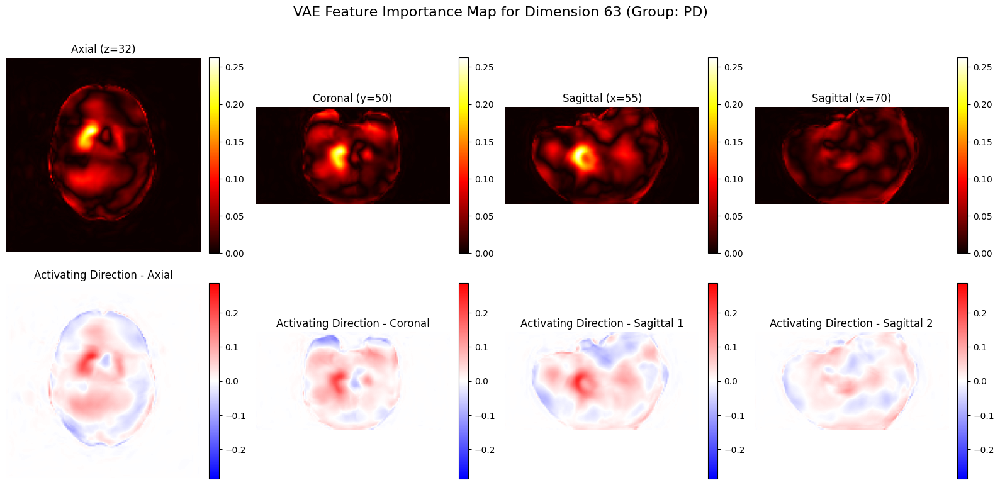

Importance Map Scale: 0 to 0.263
Activation Map Scale: -0.286 to 0.286
Dimension 63 statistics:
  Mean activation: 0.5739 ± 0.3877
  Average variance: 0.0110
Feature map for dimension 63 - Control group
Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


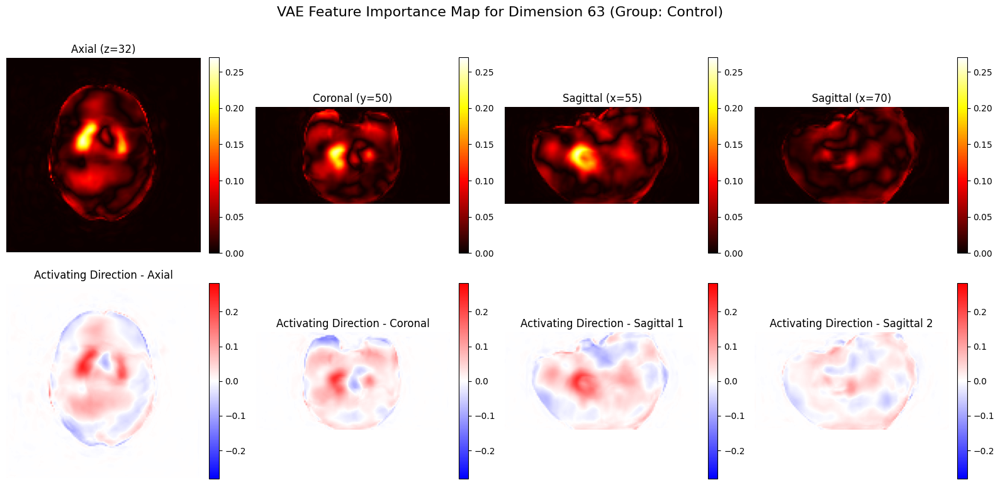

Importance Map Scale: 0 to 0.270
Activation Map Scale: -0.282 to 0.282
Dimension 63 statistics:
  Mean activation: 0.9938 ± 0.7076
  Average variance: 0.0091

Analyzing dimension 34...
Feature map for dimension 34 - PD group


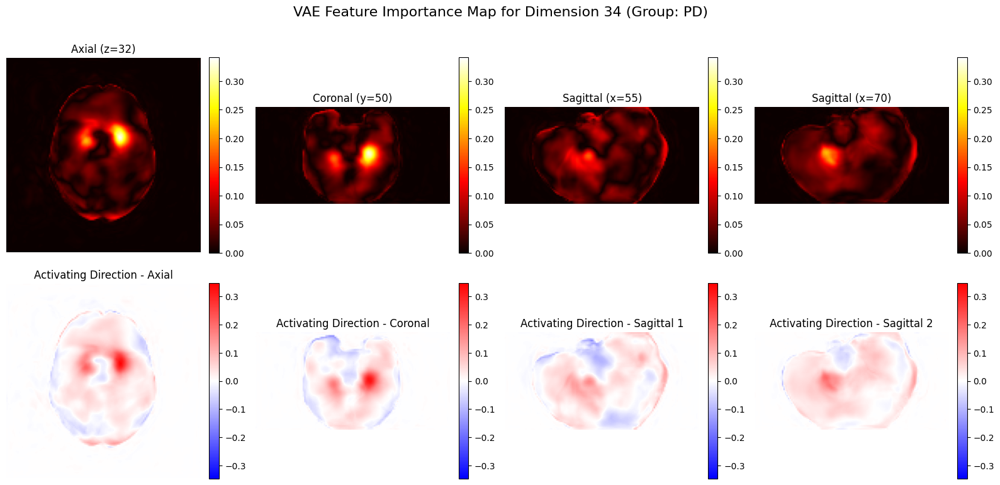

Importance Map Scale: 0 to 0.341
Activation Map Scale: -0.346 to 0.346
Dimension 34 statistics:
  Mean activation: 0.2631 ± 0.5276
  Average variance: 0.0097
Feature map for dimension 34 - Control group
Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


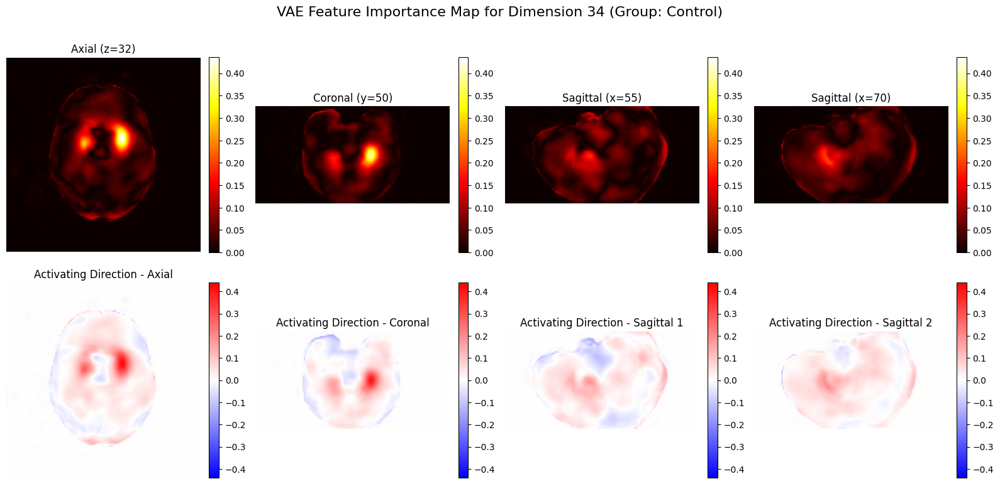

Importance Map Scale: 0 to 0.435
Activation Map Scale: -0.440 to 0.440
Dimension 34 statistics:
  Mean activation: 1.2133 ± 0.9749
  Average variance: 0.0066

Analyzing dimension 123...
Feature map for dimension 123 - PD group


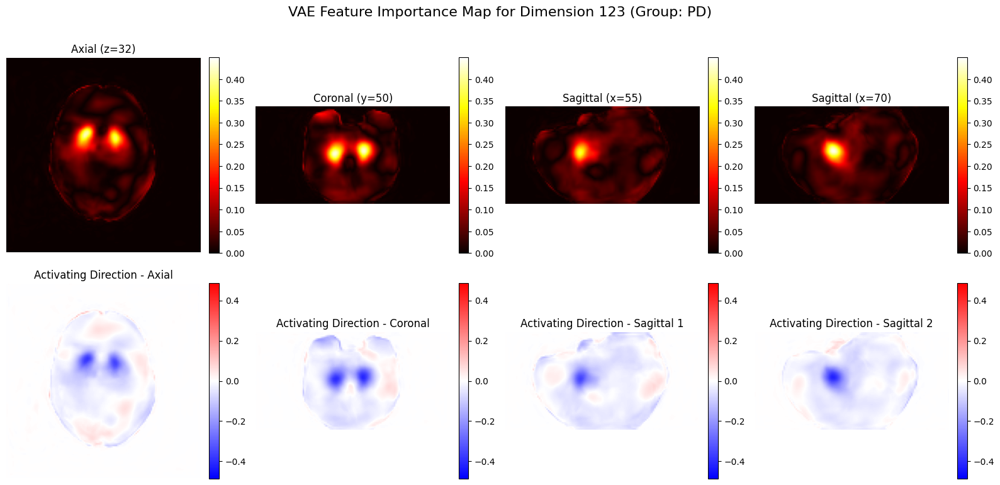

Importance Map Scale: 0 to 0.450
Activation Map Scale: -0.486 to 0.486
Dimension 123 statistics:
  Mean activation: 0.1620 ± 0.6249
  Average variance: 0.0080
Feature map for dimension 123 - Control group
Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


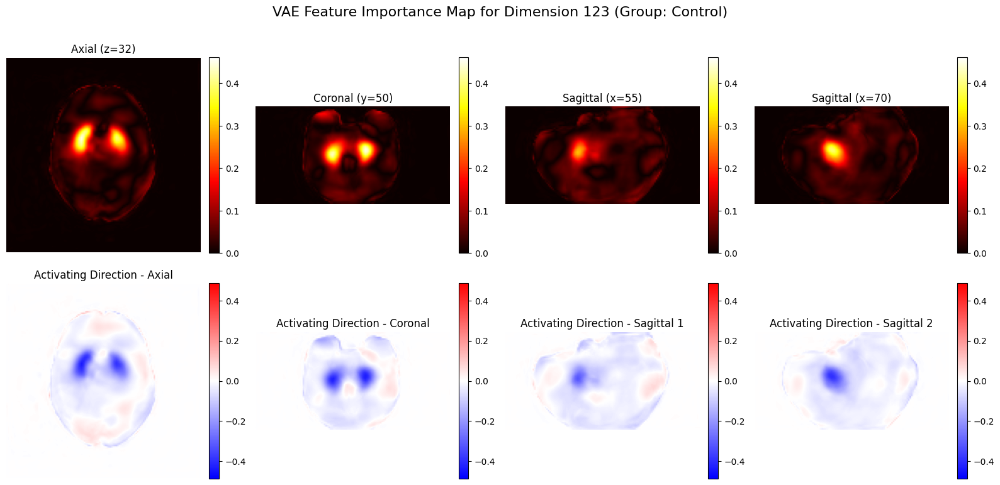

Importance Map Scale: 0 to 0.461
Activation Map Scale: -0.487 to 0.487
Dimension 123 statistics:
  Mean activation: -1.2075 ± 0.7694
  Average variance: 0.0068

Visualizing VAE reconstruction uncertainty...
Single sample uncertainty visualization - PD


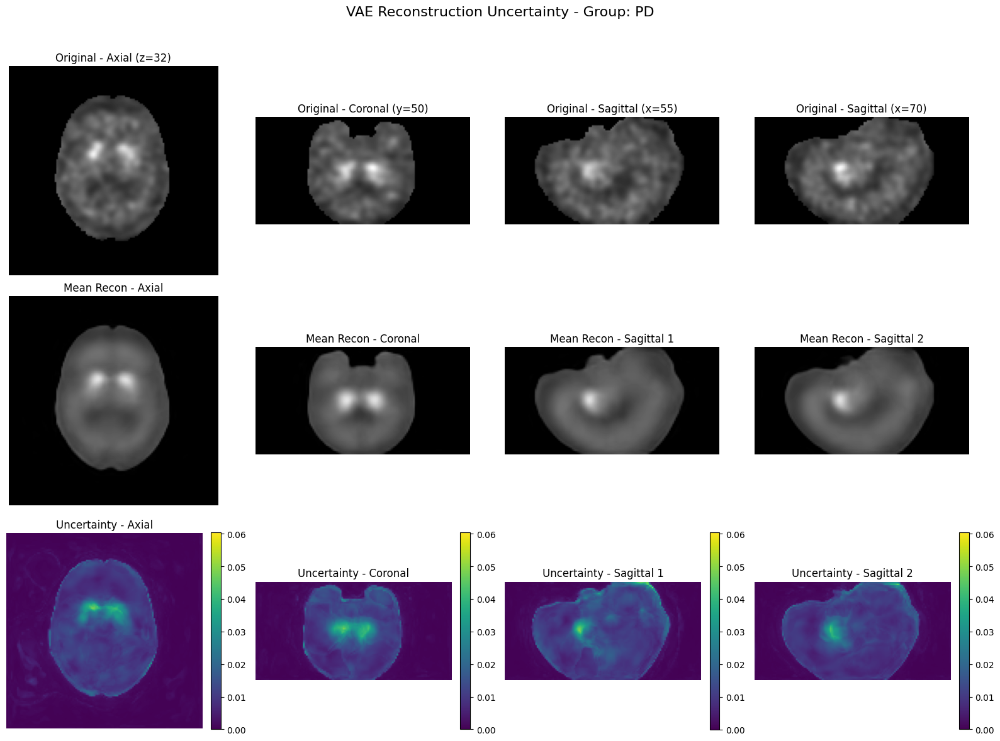

Brain Intensity Scale: 0 to 3
Uncertainty Scale: 0 to 0.060
Single sample uncertainty visualization - Control


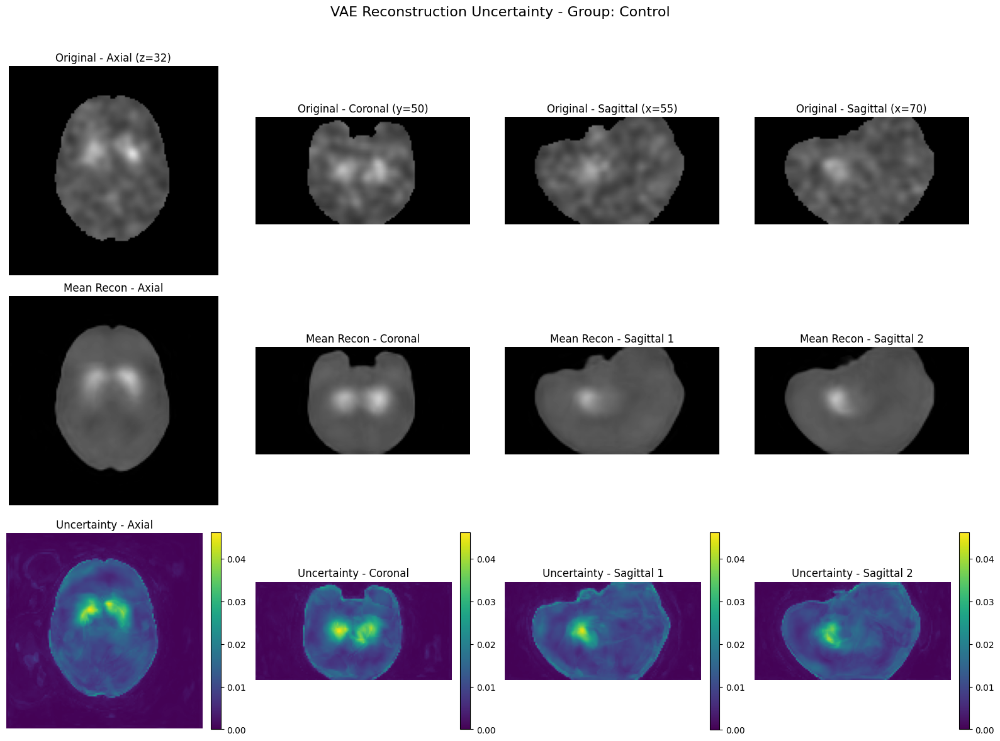

Brain Intensity Scale: 0 to 3
Uncertainty Scale: 0 to 0.046

Generating full brain uncertainty maps...
Full brain uncertainty map - All groups


Generating uncertainty maps:   2%|▏         | 7/299 [00:06<04:23,  1.11it/s]


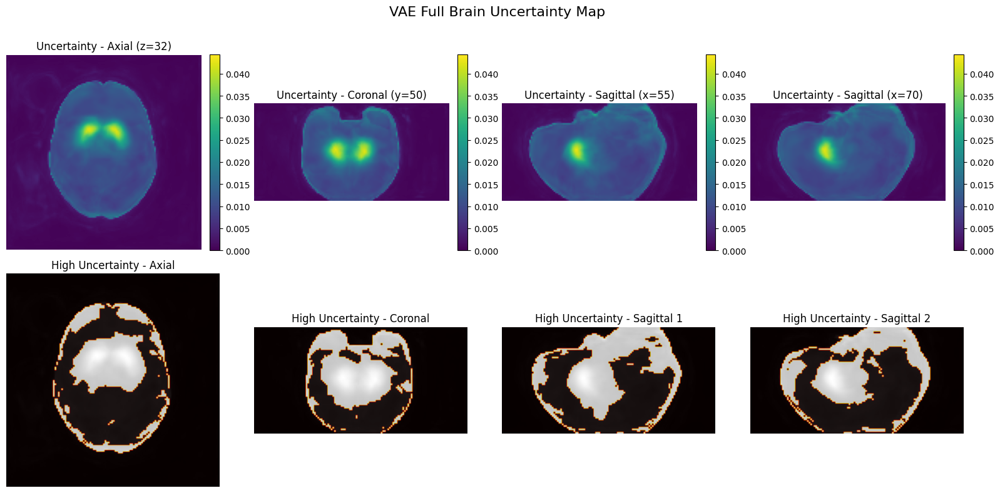

Uncertainty Scale: 0 to 0.044
High Uncertainty Threshold: 0.011

Comparing uncertainty between groups...
Generating uncertainty maps for group: PD


Generating uncertainty maps:   1%|          | 2/299 [00:01<03:25,  1.45it/s]


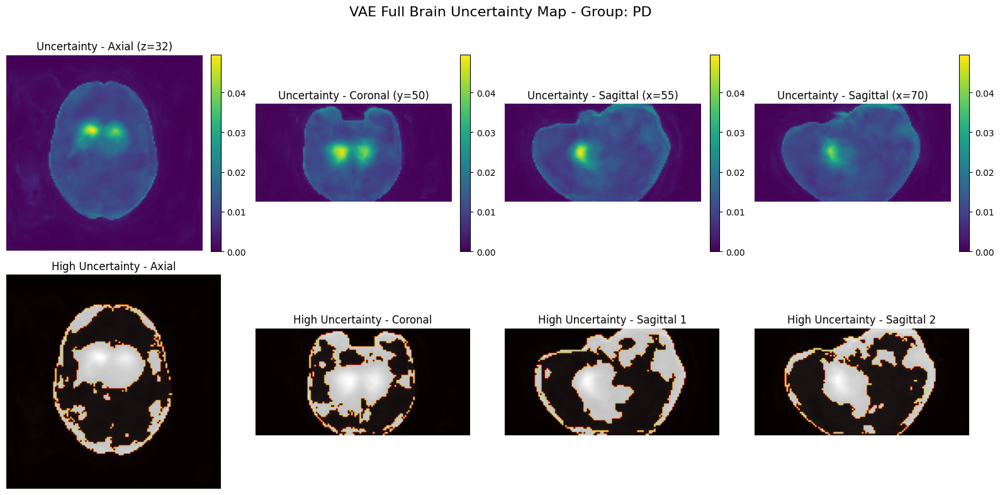

Uncertainty Scale: 0 to 0.050
High Uncertainty Threshold: 0.012
Generating uncertainty maps for group: Control


Generating uncertainty maps:   4%|▎         | 11/299 [00:02<00:54,  5.31it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 

Generating uncertainty maps:   4%|▍         | 12/299 [00:02<00:50,  5.64it/s]

Generating uncertainty maps:   6%|▌         | 18/299 [00:03<01:02,  4.50it/s]


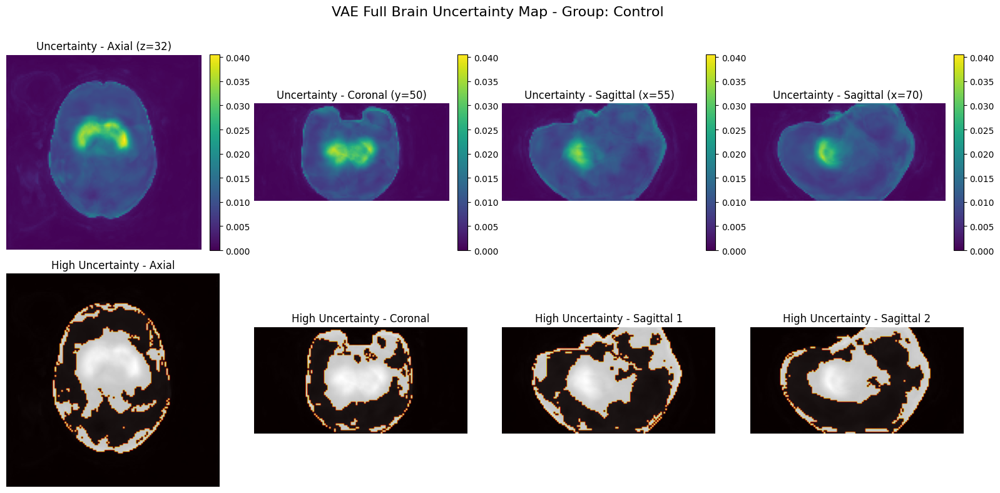

Uncertainty Scale: 0 to 0.041
High Uncertainty Threshold: 0.010
Generating uncertainty maps for group: SWEDD


Generating uncertainty maps:   4%|▎         | 11/299 [00:02<01:01,  4.70it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Generating uncertainty maps:   7%|▋         | 20/299 [00:04<01:01,  4.53it/s]


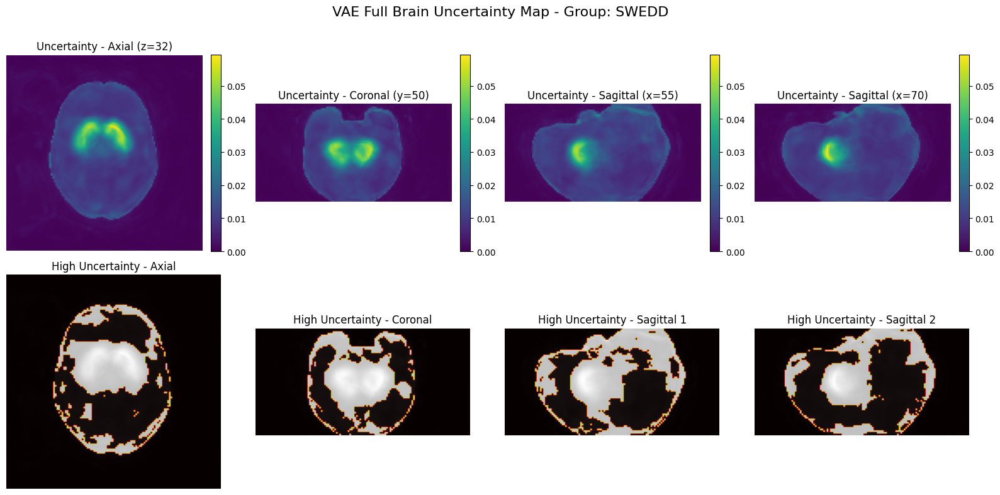

Uncertainty Scale: 0 to 0.059
High Uncertainty Threshold: 0.011
Uncertainty Scale: 0 to 0.059
Difference Map Scale: -0.021 to 0.021


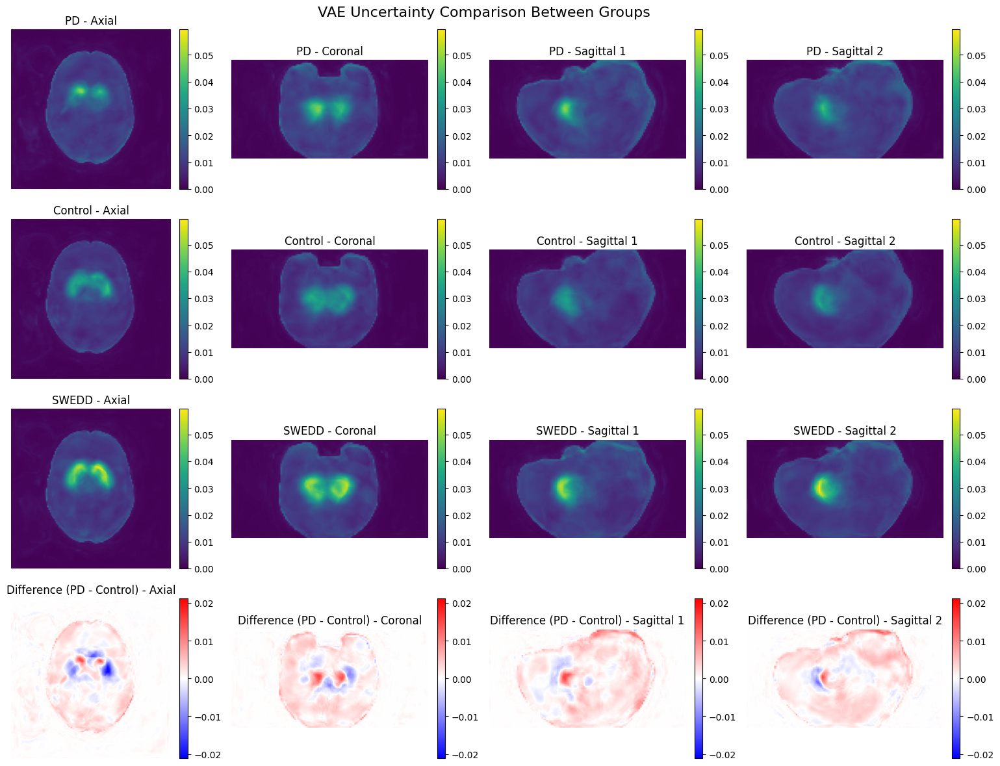


VAE Feature Importance and Uncertainty Analysis completed successfully!


In [30]:
# Run the VAE feature importance and uncertainty visualization
if __name__ == "__main__":
    try:
        print("=== Starting VAE Feature Importance and Uncertainty Analysis ===")

        # Load trained VAE model (using the load_trained_vae function from Cell 18)
        print("\nLoading trained VAE model...")
        vae_model, _ = load_trained_vae('checkpoints', 'vae_model_v2', latent_dim=256)

        # 1. Generate feature importance maps for specified dimensions
        print("\nGenerating feature importance maps...")
        important_dims = [63, 34, 123]  # The dimensions specified by the user

        for dim in important_dims:
            print(f"\nAnalyzing dimension {dim}...")

            # For PD group
            print(f"Feature map for dimension {dim} - PD group")
            importance_map_pd, _, _ = generate_vae_feature_importance_map(
                vae_model, val_loader, dimension_idx=dim, group='PD', num_samples=8)

            # For Control group
            print(f"Feature map for dimension {dim} - Control group")
            importance_map_control, _, _ = generate_vae_feature_importance_map(
                vae_model, val_loader, dimension_idx=dim, group='Control', num_samples=8)

        # 2. Visualize uncertainty in VAE reconstructions
        print("\nVisualizing VAE reconstruction uncertainty...")

        # For a single sample (PD)
        print("Single sample uncertainty visualization - PD")
        recon_mean_pd, recon_std_pd = visualize_vae_uncertainty(
            vae_model, val_loader, group='PD')

        # For a single sample (Control)
        print("Single sample uncertainty visualization - Control")
        recon_mean_control, recon_std_control = visualize_vae_uncertainty(
            vae_model, val_loader, group='Control')

        # 3. Generate full brain uncertainty maps
        print("\nGenerating full brain uncertainty maps...")

        # For all samples
        print("Full brain uncertainty map - All groups")
        avg_uncertainty, high_uncertainty_mask = generate_full_brain_uncertainty_map(
            vae_model, val_loader, num_samples=15)

        # 4. Compare uncertainty between groups
        print("\nComparing uncertainty between groups...")
        uncertainty_maps = compare_group_uncertainty(
            vae_model, val_loader, groups=['PD', 'Control', 'SWEDD'], num_samples=5)

        print("\nVAE Feature Importance and Uncertainty Analysis completed successfully!")

    except Exception as e:
        print(f"Error during analysis: {str(e)}")
        import traceback
        traceback.print_exc()

# Performance Metrics & Visualizations

## KL Divergence

Loading trained VAE model...
Using device: cuda


Loading best VAE model from checkpoints/vae_model_v2_best.pth
Loaded training history with 249 epochs

Analyzing VAE latent dimensions through KL divergence...


Analyzing KL divergence per dimension:   5%|▍         | 14/299 [00:00<00:16, 17.37it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Analyzing KL divergence per dimension:  21%|██        | 62/299 [00:03<00:11, 19.86it/s]

Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Analyzing KL divergence per dimension:  25%|██▍       | 74/299 [00:04<00:12, 17.79it/s]


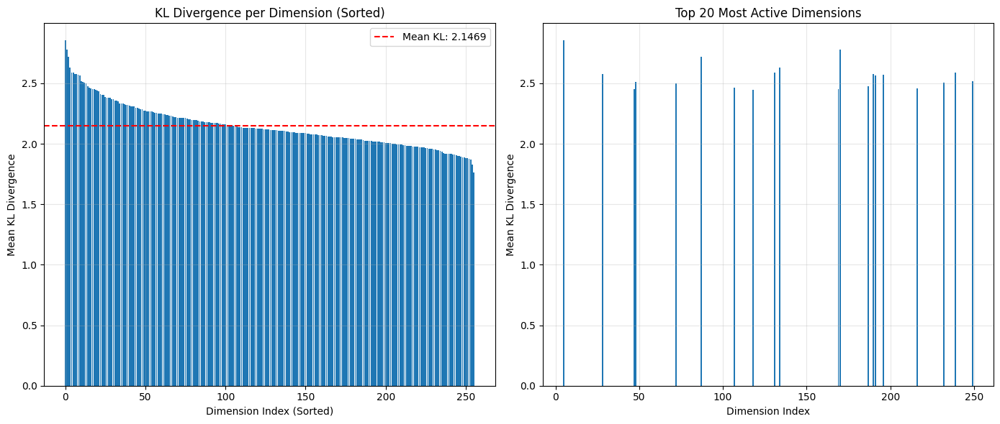


Analyzing top 5 most active dimensions across patient groups:


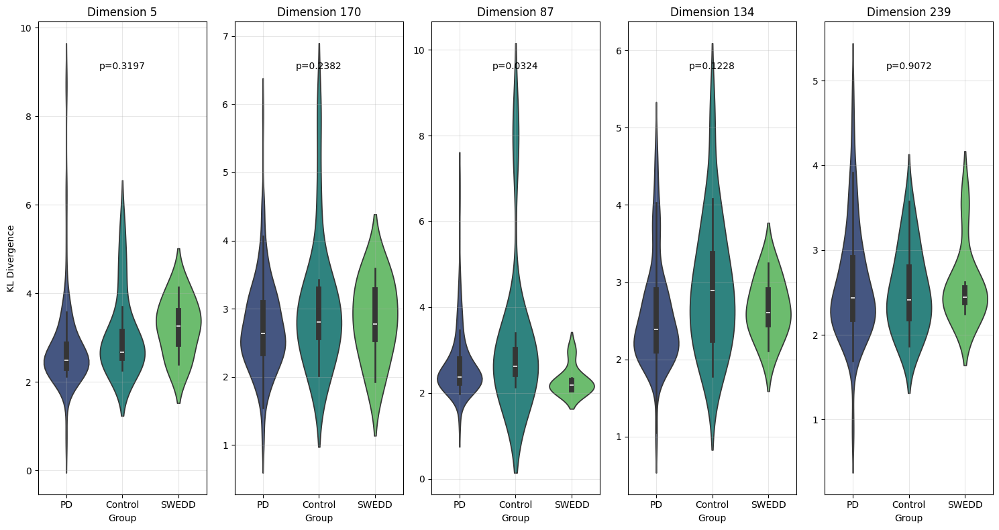


Testing predictive power of top KL dimensions:
Accuracy using top 5 KL dimensions: 0.8222
  Top 5 most important dimensions:
    Dim 87: 0.2259
    Dim 134: 0.2082
    Dim 170: 0.1969
    Dim 239: 0.1872
    Dim 5: 0.1818
Accuracy using top 10 KL dimensions: 0.8222
  Top 5 most important dimensions:
    Dim 131: 0.1447
    Dim 190: 0.1441
    Dim 87: 0.1340
    Dim 5: 0.1056
    Dim 191: 0.1043
Accuracy using top 20 KL dimensions: 0.8667
  Top 5 most important dimensions:
    Dim 169: 0.1131
    Dim 47: 0.1088
    Dim 131: 0.0731
    Dim 107: 0.0633
    Dim 5: 0.0612
KL Divergence Analysis completed!


In [31]:
# Cell 20: VAE Latent Space Analysis through KL Divergence

import torch
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
import scipy.stats as stats
from tqdm import tqdm
import gc

def analyze_vae_kl_dimensions(model, dataloader, max_samples=150):
    """
    Analyze the KL divergence contribution of each dimension in the VAE latent space.
    
    KL divergence in VAEs measures how much the encoded distribution differs from
    the prior (standard normal) distribution. Dimensions with higher KL divergence
    are more "active" and potentially encode more meaningful features.
    """
    device = next(model.parameters()).device
    model.eval()
    
    # Storage for per-dimension KL and sample metadata
    kl_per_dim = []
    labels = []
    paths = []
    
    sample_count = 0
    with torch.no_grad():
        for batch in tqdm(dataloader, desc="Analyzing KL divergence per dimension"):
            volumes = batch['volume'].to(device)
            batch_labels = batch['label']
            batch_paths = batch['path']
            
            # Encode samples to get mu and log_var
            mu, log_var = model.encode(volumes)
            
            # Calculate KL divergence per dimension: 0.5 * (mu^2 + exp(log_var) - log_var - 1)
            kl_dims = 0.5 * (mu.pow(2) + log_var.exp() - log_var - 1)
            
            # Store results
            kl_per_dim.append(kl_dims.cpu().numpy())
            labels.extend(batch_labels)
            paths.extend(batch_paths)
            
            sample_count += volumes.shape[0]
            
            # Memory cleanup
            del volumes, mu, log_var, kl_dims
            torch.cuda.empty_cache()
            
            if sample_count >= max_samples:
                break
    
    # Stack arrays and trim to max_samples if needed
    kl_per_dim = np.vstack(kl_per_dim)
    if max_samples and len(labels) > max_samples:
        kl_per_dim = kl_per_dim[:max_samples]
        labels = labels[:max_samples]
        paths = paths[:max_samples]
    
    # Analyze overall KL divergence per dimension
    mean_kl_per_dim = np.mean(kl_per_dim, axis=0)
    
    # Find most active dimensions (highest KL)
    top_dims_idx = np.argsort(mean_kl_per_dim)[-20:][::-1]
    top_dims_kl = mean_kl_per_dim[top_dims_idx]
    
    # Plot overall KL per dimension (sorted)
    plt.figure(figsize=(14, 6))
    plt.subplot(1, 2, 1)
    plt.bar(range(len(mean_kl_per_dim)), sorted(mean_kl_per_dim, reverse=True))
    plt.axhline(y=np.mean(mean_kl_per_dim), color='r', linestyle='--', label=f'Mean KL: {np.mean(mean_kl_per_dim):.4f}')
    plt.title('KL Divergence per Dimension (Sorted)')
    plt.xlabel('Dimension Index (Sorted)')
    plt.ylabel('Mean KL Divergence')
    plt.grid(alpha=0.3)
    plt.legend()
    
    # Plot top 20 dimensions with actual indices
    plt.subplot(1, 2, 2)
    plt.bar(top_dims_idx, top_dims_kl)
    plt.title('Top 20 Most Active Dimensions')
    plt.xlabel('Dimension Index')
    plt.ylabel('Mean KL Divergence')
    plt.grid(alpha=0.3)
    plt.tight_layout()
    plt.show()
    
    # Analyze distribution of top dimensions across patient groups
    print(f"\nAnalyzing top 5 most active dimensions across patient groups:")
    
    # Get unique labels
    unique_labels = list(set(labels))
    
    # Prepare data for violin plots
    top5_dims = top_dims_idx[:5]
    
    plt.figure(figsize=(15, 8))
    for i, dim in enumerate(top5_dims):
        plt.subplot(1, 5, i+1)
        
        # Create a dataframe for this dimension
        dim_df = pd.DataFrame({
            'KL': kl_per_dim[:, dim],
            'Group': labels
        })
        
        # Create violin plot
        sns.violinplot(x='Group', y='KL', data=dim_df, palette='viridis')
        plt.title(f'Dimension {dim}')
        plt.ylabel('KL Divergence' if i == 0 else '')
        plt.grid(alpha=0.3)
        
        # Add ANOVA p-value to see if groups are significantly different
        groups_data = [dim_df[dim_df['Group'] == group]['KL'].values for group in unique_labels]
        f_val, p_val = stats.f_oneway(*groups_data)
        plt.annotate(f'p={p_val:.4f}', xy=(0.5, 0.9), xycoords='axes fraction', ha='center')
    
    plt.tight_layout()
    plt.show()
    
    # Test predictive power of top dimensions using a simple classifier
    print("\nTesting predictive power of top KL dimensions:")
    
    # Prepare train/test split (70/30)
    np.random.seed(42)
    indices = np.random.permutation(len(labels))
    train_idx, test_idx = indices[:int(0.7*len(indices))], indices[int(0.7*len(indices)):]
    
    # Convert labels to numeric for the classifier
    label_map = {label: i for i, label in enumerate(unique_labels)}
    y = np.array([label_map[label] for label in labels])
    
    # Train a random forest on different sets of dimensions
    for n_dims in [5, 10, 20, 50, 100]:
        if n_dims <= len(top_dims_idx):
            # Get top n dimensions
            selected_dims = top_dims_idx[:n_dims]
            X_selected = kl_per_dim[:, selected_dims]
            
            # Train model
            clf = RandomForestClassifier(n_estimators=100, random_state=42)
            clf.fit(X_selected[train_idx], y[train_idx])
            
            # Test model
            y_pred = clf.predict(X_selected[test_idx])
            accuracy = accuracy_score(y[test_idx], y_pred)
            
            print(f"Accuracy using top {n_dims} KL dimensions: {accuracy:.4f}")
            
            # Feature importance
            if n_dims <= 20:  # Only show for smaller sets
                importances = clf.feature_importances_
                indices = np.argsort(importances)[::-1]
                
                print("  Top 5 most important dimensions:")
                for i in range(min(5, n_dims)):
                    print(f"    Dim {selected_dims[indices[i]]}: {importances[indices[i]]:.4f}")
    
    return kl_per_dim, top_dims_idx, labels, paths

# Load the trained VAE model from previous cells
print("Loading trained VAE model...")
# Using the load_trained_vae function from Cell 18
vae_model, _ = load_trained_vae('checkpoints', 'vae_model_v2', latent_dim=256)

# Analyze VAE KL divergence per dimension
print("\nAnalyzing VAE latent dimensions through KL divergence...")
kl_per_dim, top_dims, labels, paths = analyze_vae_kl_dimensions(
    vae_model, val_loader, max_samples=150)

print("KL Divergence Analysis completed!")

Visualizing top KL dimensions in brain space...
Analyzing dimensions: [  5 170  87]

Visualizing dimension 5...


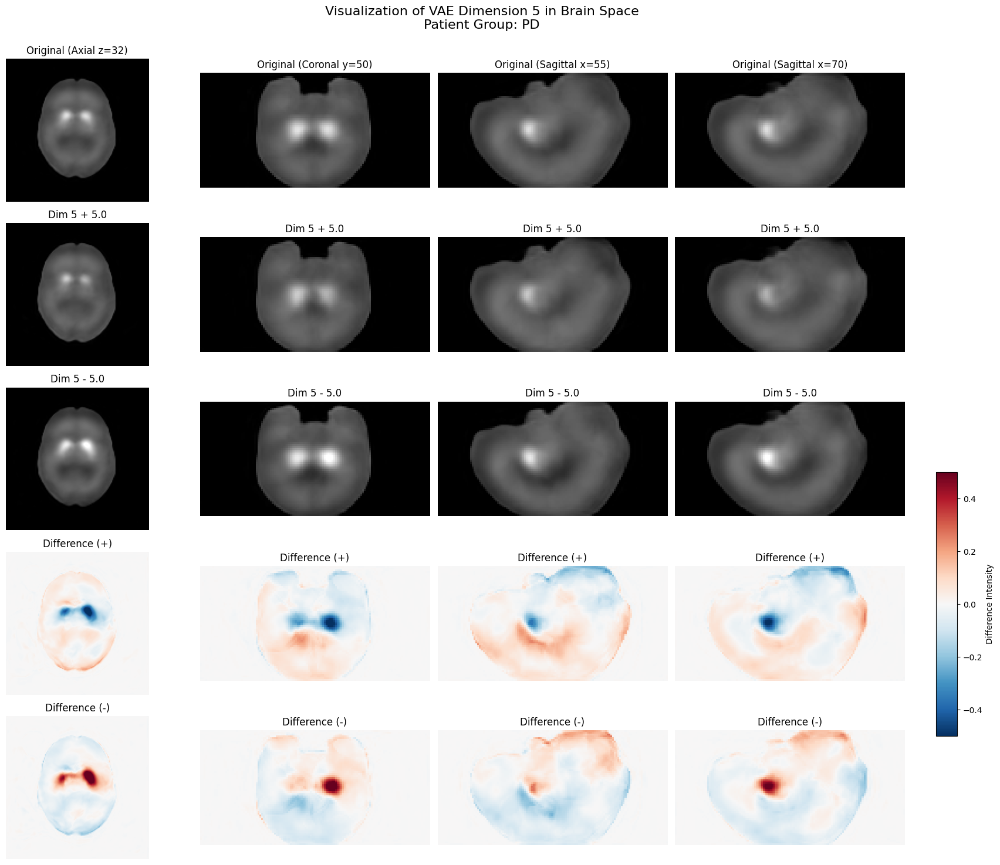

Generating feature importance map for dimension 5


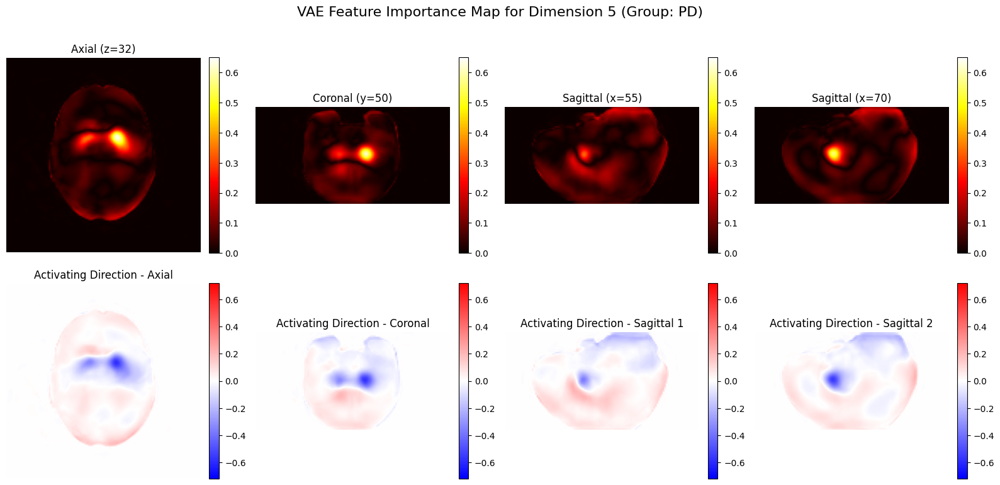

Importance Map Scale: 0 to 0.650
Activation Map Scale: -0.719 to 0.719
Dimension 5 statistics:
  Mean activation: 0.2136 ± 0.6132
  Average variance: 0.0040
Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


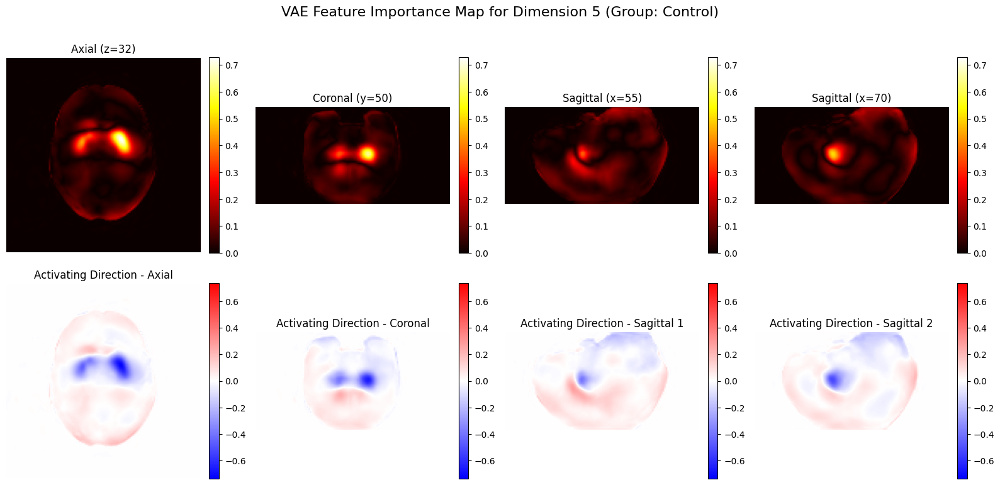

Importance Map Scale: 0 to 0.727
Activation Map Scale: -0.735 to 0.735
Dimension 5 statistics:
  Mean activation: -0.7651 ± 1.2527
  Average variance: 0.0029

Visualizing dimension 170...


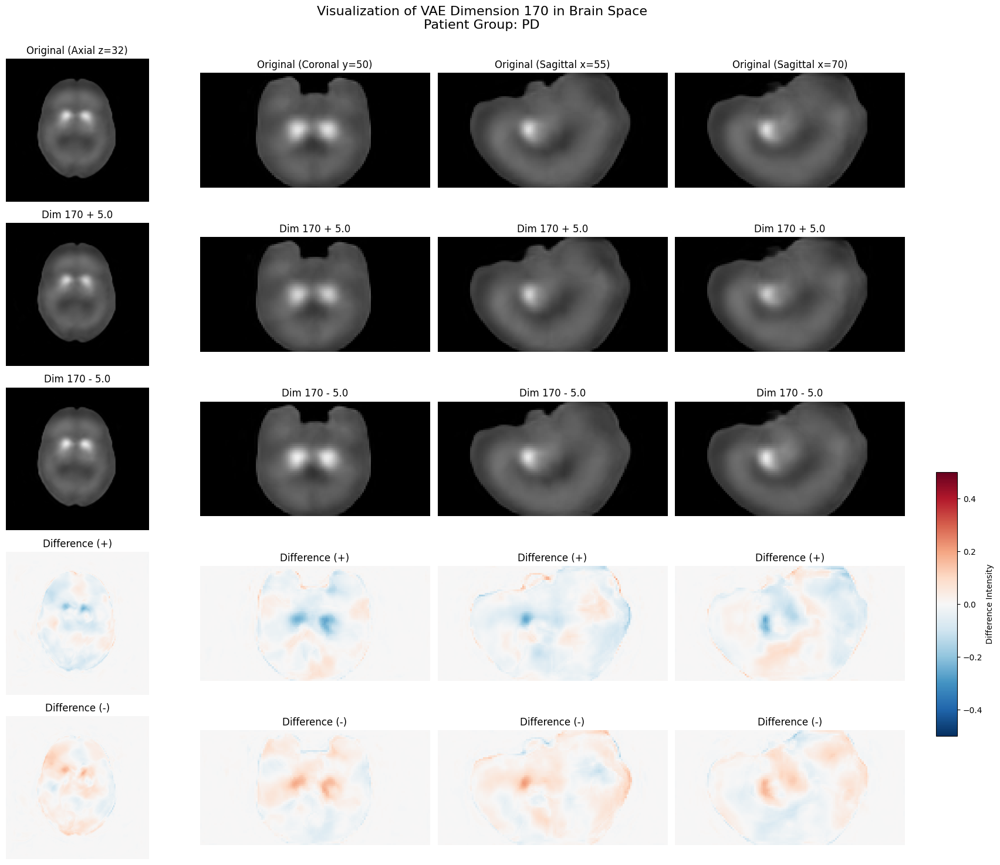

Generating feature importance map for dimension 170


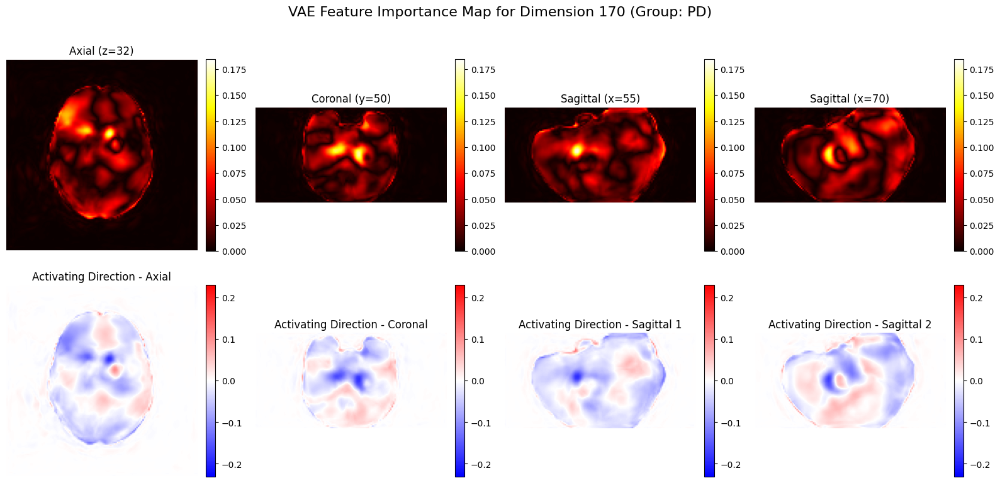

Importance Map Scale: 0 to 0.185
Activation Map Scale: -0.231 to 0.231
Dimension 170 statistics:
  Mean activation: -1.0618 ± 0.4920
  Average variance: 0.0139
Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


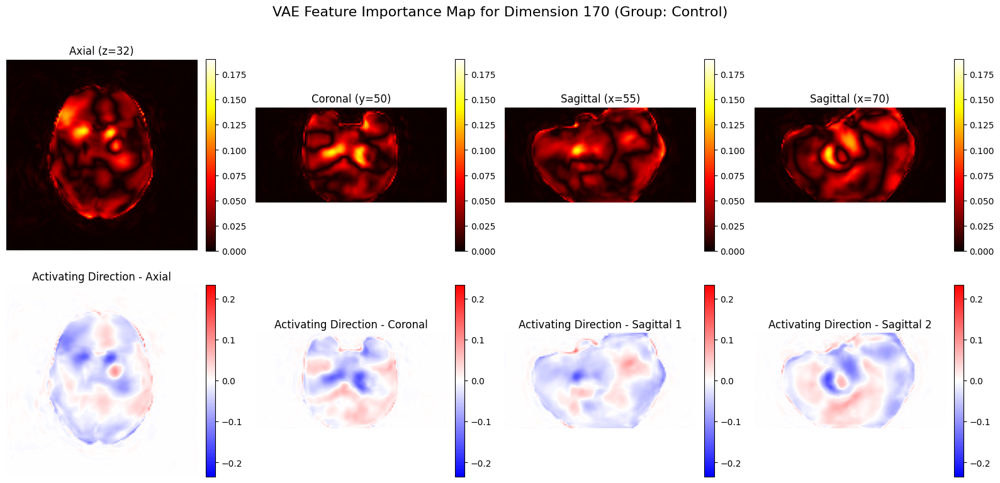

Importance Map Scale: 0 to 0.190
Activation Map Scale: -0.235 to 0.235
Dimension 170 statistics:
  Mean activation: -1.7765 ± 0.4765
  Average variance: 0.0110

Visualizing dimension 87...


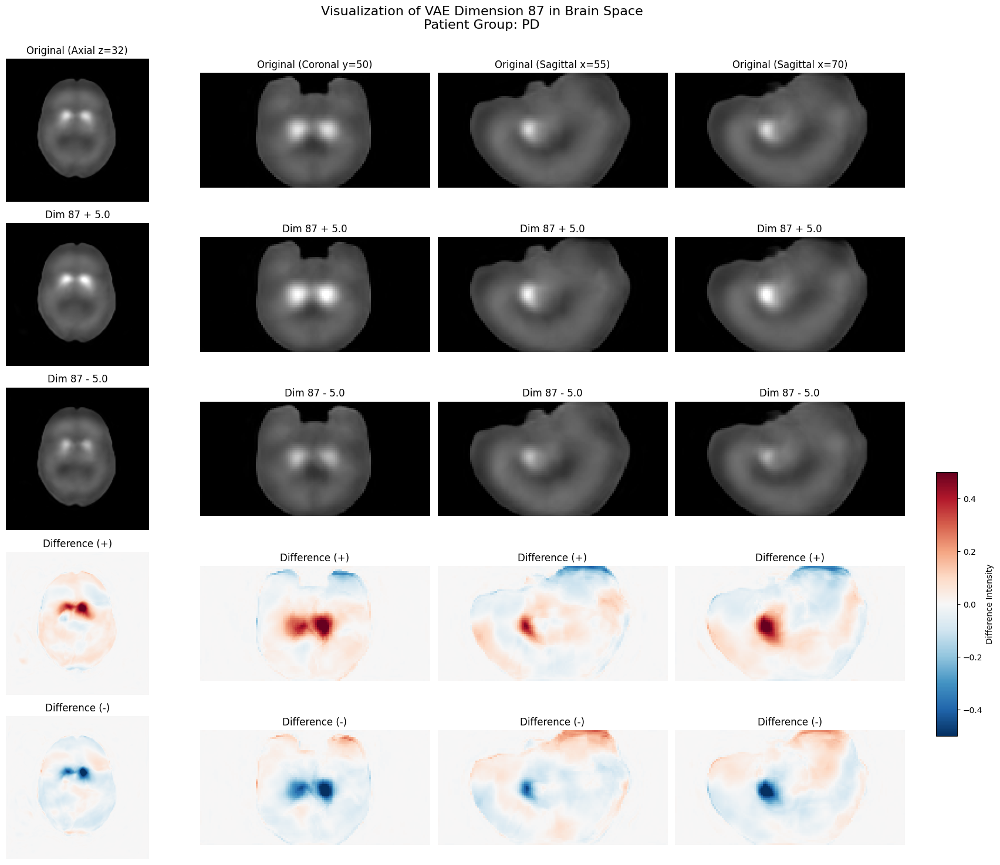

Generating feature importance map for dimension 87


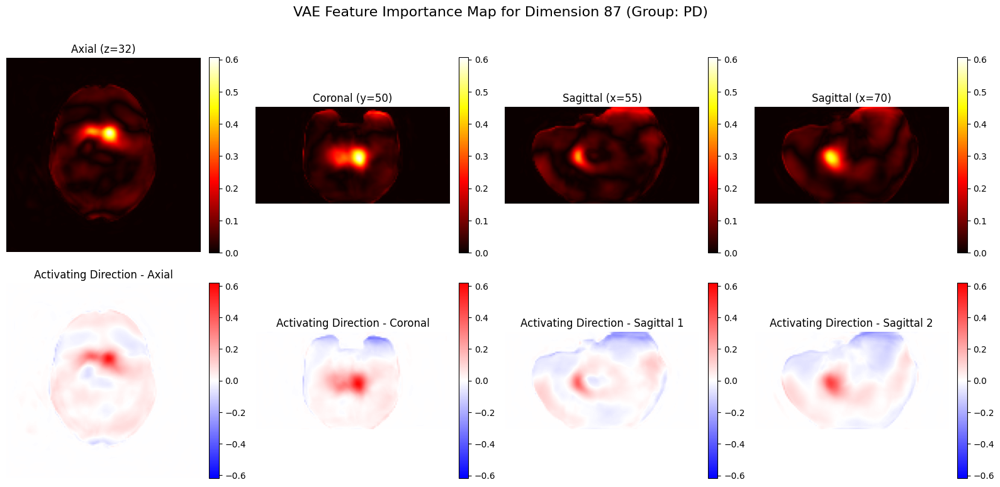

Importance Map Scale: 0 to 0.606
Activation Map Scale: -0.618 to 0.618
Dimension 87 statistics:
  Mean activation: -0.7511 ± 0.8239
  Average variance: 0.0047
Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


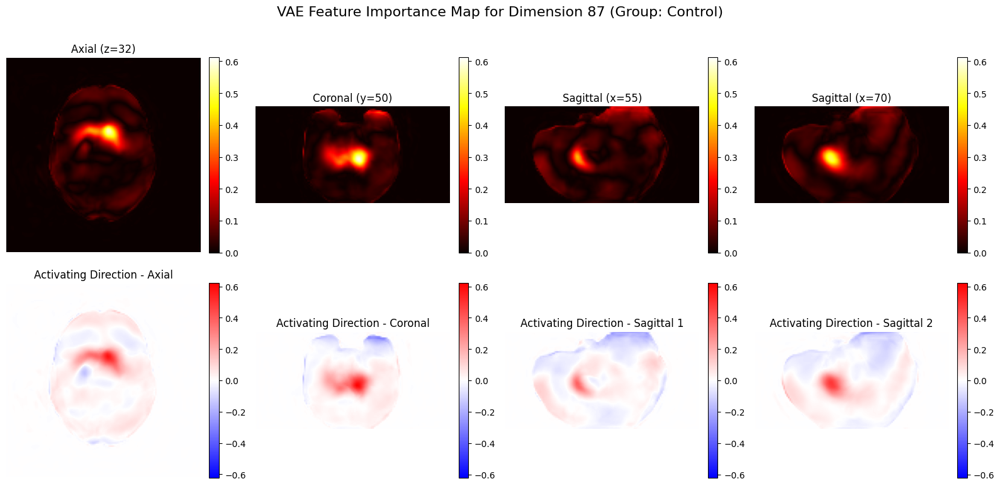

Importance Map Scale: 0 to 0.613
Activation Map Scale: -0.624 to 0.624
Dimension 87 statistics:
  Mean activation: -1.0208 ± 1.6640
  Average variance: 0.0042
Top dimensions visualization completed!


In [32]:
# Cell 21: Visualization of Top KL Dimensions in Brain Space

# Now let's visualize what the top dimensions represent in the brain space
print("Visualizing top KL dimensions in brain space...")

# Select the top 3 dimensions with highest KL divergence
top_3_dims = top_dims[:3]
print(f"Analyzing dimensions: {top_3_dims}")

# For each dimension, visualize its effect on reconstruction
for dim_idx in top_3_dims:
    print(f"\nVisualizing dimension {dim_idx}...")
    
    # Use the existing function from Cell 15
    visualize_vae_latent_dimension(vae_model, val_loader, dimension_idx=dim_idx, alpha=5.0)
    
    # Generate feature importance map
    print(f"Generating feature importance map for dimension {dim_idx}")
    for group in ['PD', 'Control']:
        generate_vae_feature_importance_map(
            vae_model, val_loader, dimension_idx=dim_idx, group=group, num_samples=8)

print("Top dimensions visualization completed!")

Loading trained models...
Using device: cuda
Loading best VAE model from checkpoints/vae_model_v2_best.pth
Loaded training history with 249 epochs

Analyzing alpha values in terms of standard deviations...
Analyzing Autoencoder latent space (alpha = 8.0)...


Extracting AE latent vectors:   4%|▍         | 13/299 [00:00<00:15, 18.16it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Extracting AE latent vectors:  21%|██        | 63/299 [00:03<00:12, 18.43it/s]

Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Extracting AE latent vectors:  33%|███▎      | 99/299 [00:05<00:10, 18.54it/s]


Collected 200 samples with 256 dimensions

Autoencoder Latent Space Statistics:
  Alpha value: 8.0
  Mean standard deviation: 4.6358
  Alpha in std devs: mean = 1.79, min = 0.97, max = 2.65


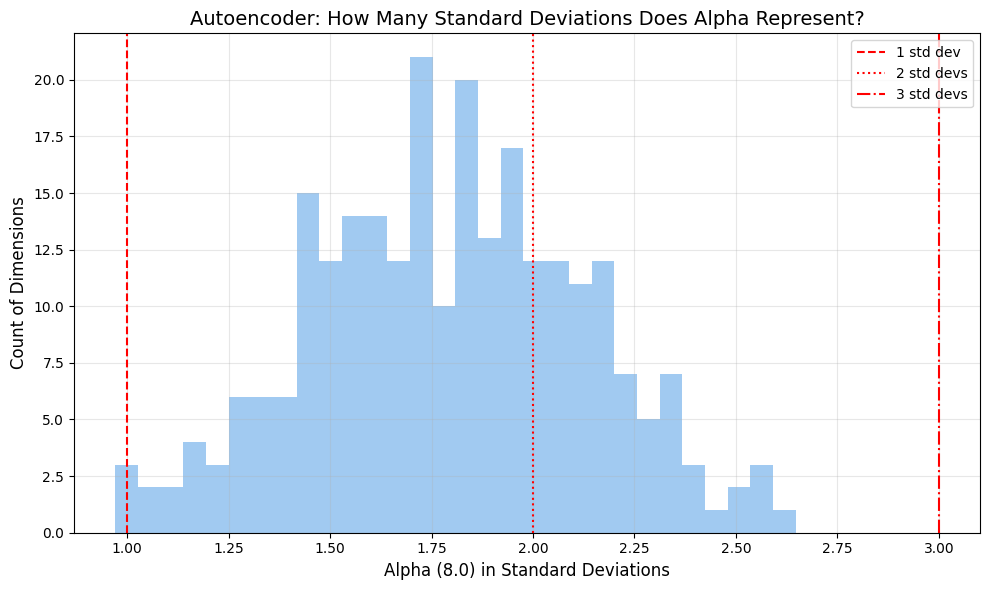

Analyzing VAE latent space (alpha = 5.0)...


Extracting VAE latent vectors:   5%|▍         | 14/299 [00:00<00:22, 12.64it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Extracting VAE latent vectors:  21%|██        | 63/299 [00:03<00:12, 18.80it/s]

Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Extracting VAE latent vectors:  33%|███▎      | 99/299 [00:05<00:11, 17.76it/s]


Collected 200 samples with 256 dimensions

VAE Latent Space Statistics:
  Alpha value: 5.0
  Mean standard deviation: 0.5626
  Alpha in std devs: mean = 9.16, min = 4.73, max = 13.10


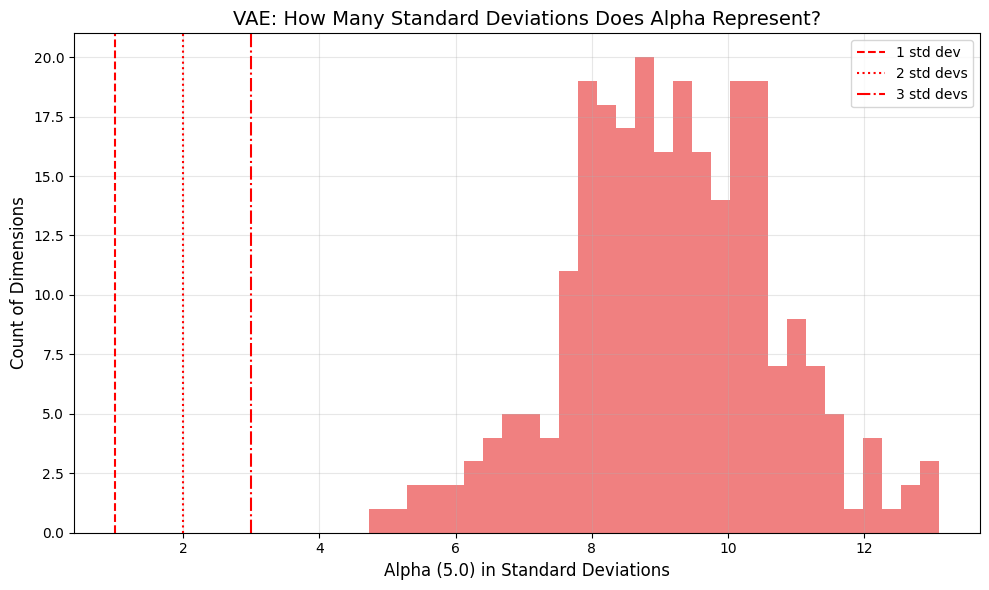


Analyzing specific dimensions of interest:

Dimension 231:
Analyzing Autoencoder dimension 231 (alpha = 8.0)...


Extracting Autoencoder dimension 231:   4%|▍         | 13/299 [00:00<00:16, 16.98it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Extracting Autoencoder dimension 231:  21%|██▏       | 64/299 [00:03<00:12, 18.35it/s]

Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Extracting Autoencoder dimension 231:  33%|███▎      | 99/299 [00:05<00:11, 17.91it/s]



Autoencoder Dimension 231 Statistics:
  Mean: 5.3372
  Standard deviation: 6.3128
  Alpha (8.0) in std devs: 1.27


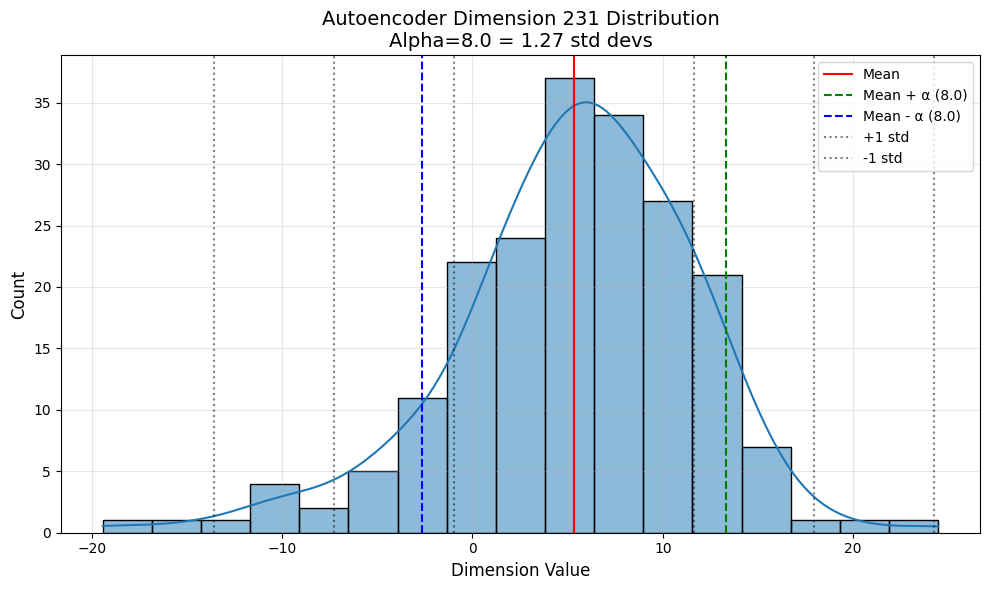

Analyzing VAE dimension 231 (alpha = 5.0)...


Extracting VAE dimension 231:   4%|▍         | 13/299 [00:00<00:16, 17.49it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Extracting VAE dimension 231:  21%|██        | 63/299 [00:03<00:12, 18.67it/s]

Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Extracting VAE dimension 231:  33%|███▎      | 99/299 [00:05<00:10, 18.25it/s]


VAE Dimension 231 Statistics:
  Mean: 0.6914
  Standard deviation: 0.4853
  Alpha (5.0) in std devs: 10.30


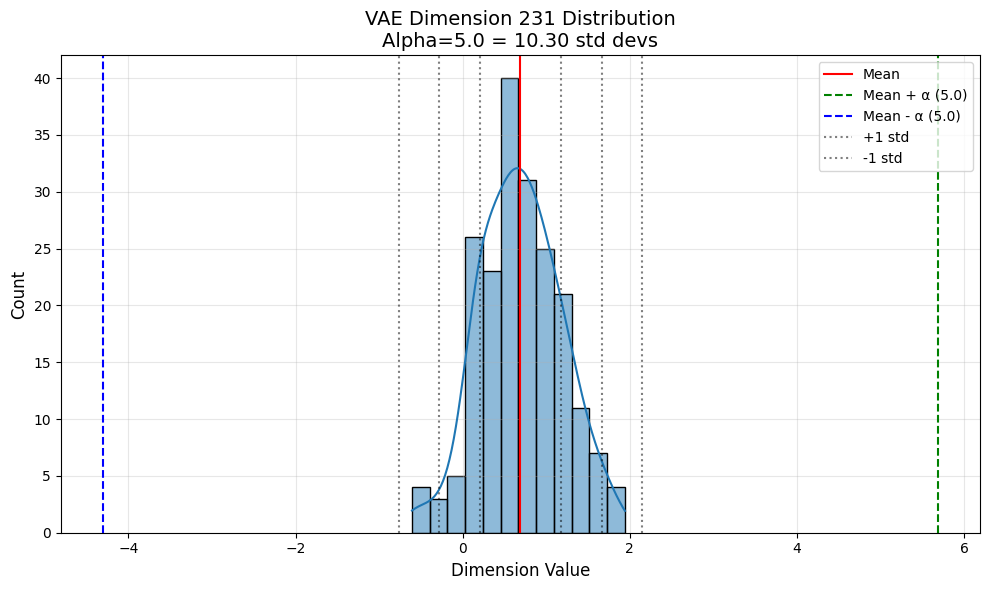


Dimension 94:
Analyzing Autoencoder dimension 94 (alpha = 8.0)...


Extracting Autoencoder dimension 94:   4%|▍         | 13/299 [00:03<00:43,  6.63it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Extracting Autoencoder dimension 94:  21%|██        | 62/299 [00:06<00:12, 19.21it/s]

Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Extracting Autoencoder dimension 94:  33%|███▎      | 99/299 [00:08<00:16, 12.14it/s]



Autoencoder Dimension 94 Statistics:
  Mean: 13.9035
  Standard deviation: 6.8754
  Alpha (8.0) in std devs: 1.16


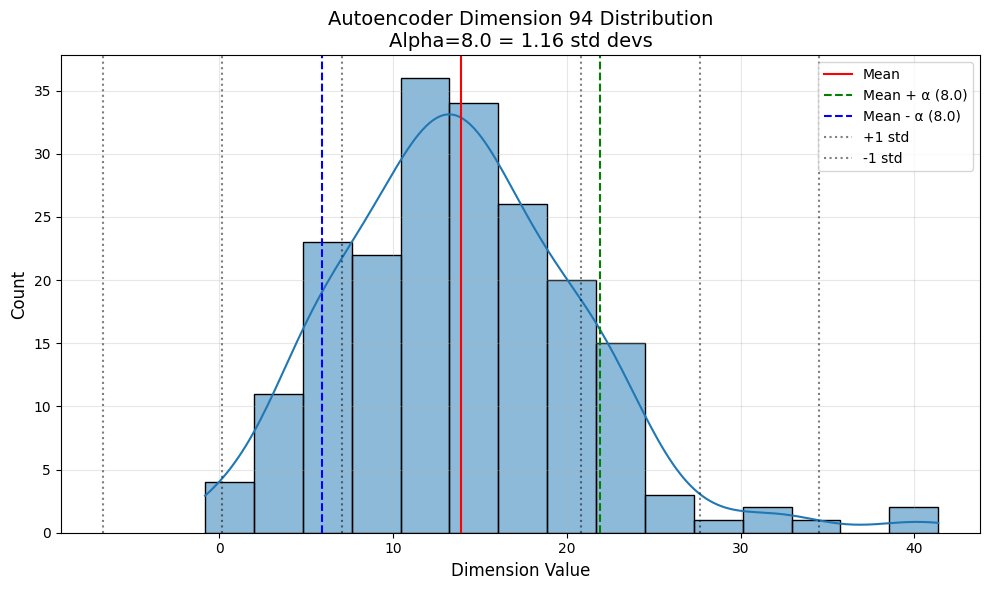

Analyzing VAE dimension 94 (alpha = 5.0)...


Extracting VAE dimension 94:   4%|▍         | 13/299 [00:00<00:16, 17.01it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Extracting VAE dimension 94:  21%|██        | 63/299 [00:03<00:12, 18.75it/s]

Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Extracting VAE dimension 94:  33%|███▎      | 99/299 [00:05<00:10, 18.24it/s]



VAE Dimension 94 Statistics:
  Mean: 0.4695
  Standard deviation: 0.4962
  Alpha (5.0) in std devs: 10.08


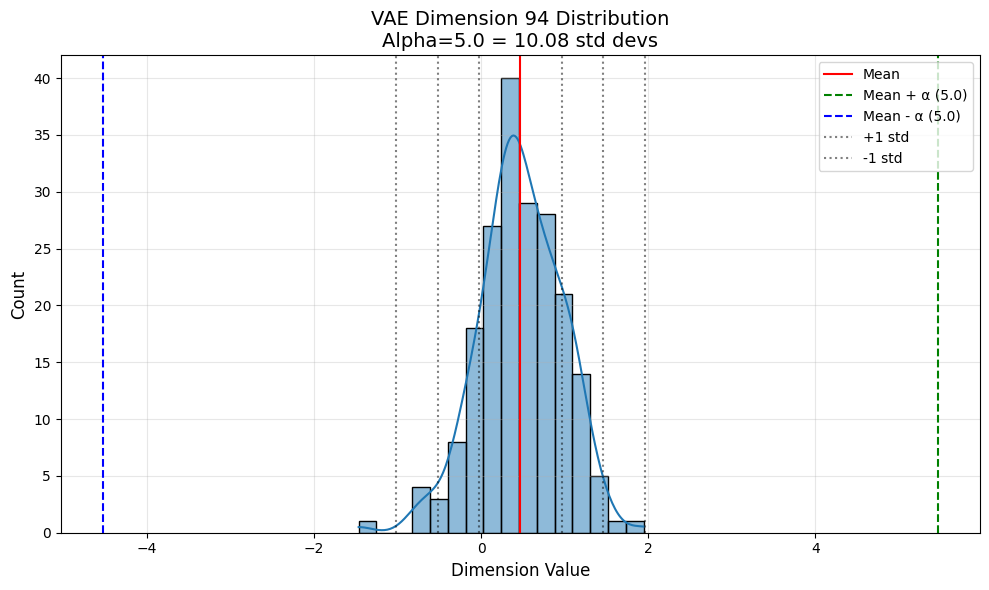


Dimension 154:
Analyzing Autoencoder dimension 154 (alpha = 8.0)...


Extracting Autoencoder dimension 154:   4%|▍         | 13/299 [00:00<00:16, 17.07it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Extracting Autoencoder dimension 154:  21%|██        | 62/299 [00:03<00:12, 19.20it/s]

Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Extracting Autoencoder dimension 154:  33%|███▎      | 99/299 [00:05<00:11, 18.05it/s]


Autoencoder Dimension 154 Statistics:
  Mean: 13.6426
  Standard deviation: 7.8029
  Alpha (8.0) in std devs: 1.03


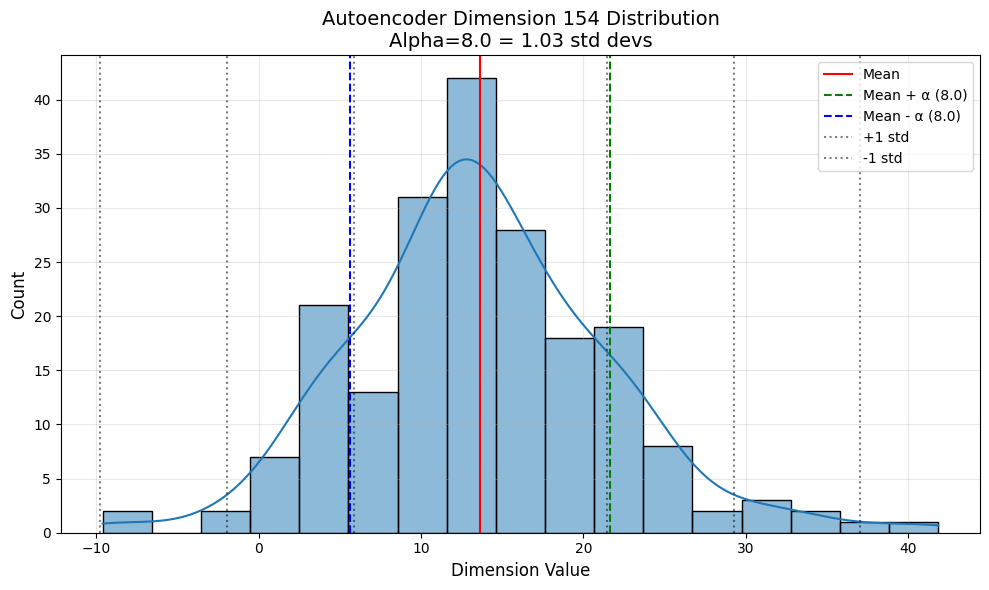

Analyzing VAE dimension 154 (alpha = 5.0)...


Extracting VAE dimension 154:   5%|▍         | 14/299 [00:00<00:15, 18.39it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Extracting VAE dimension 154:  21%|██        | 63/299 [00:03<00:11, 19.76it/s]

Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Extracting VAE dimension 154:  33%|███▎      | 99/299 [00:05<00:10, 18.66it/s]



VAE Dimension 154 Statistics:
  Mean: 0.6644
  Standard deviation: 0.5318
  Alpha (5.0) in std devs: 9.40


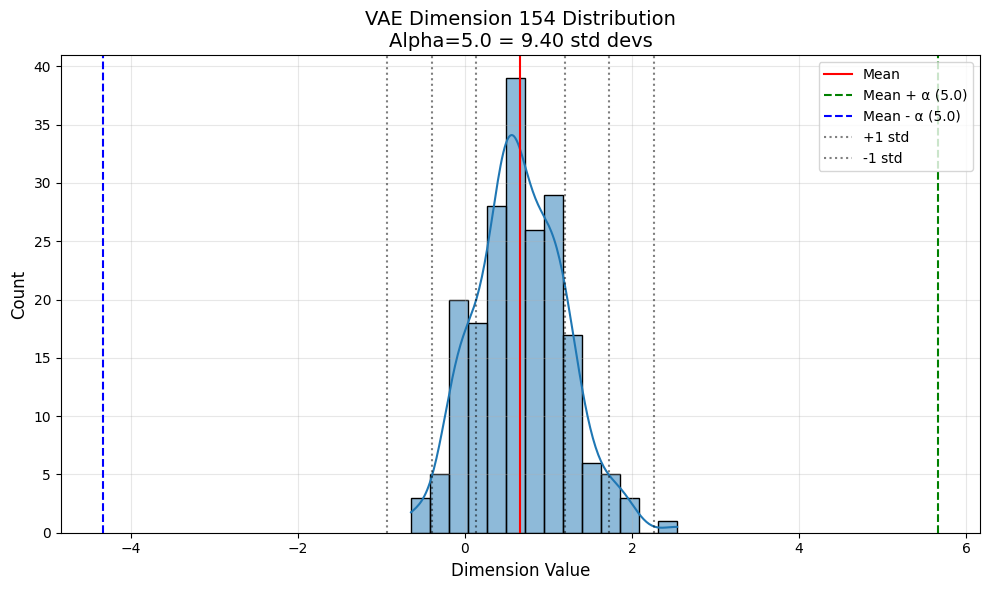

In [33]:
# Cell 22: Analysis of Latent Space Distributions and Alpha Values

import torch
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm

# Function to analyze autoencoder
def analyze_ae_alpha(ae_model, dataloader, alpha_value=8.0, max_samples=200):
    """Calculate how many standard deviations alpha represents for AE dimensions"""
    device = next(ae_model.parameters()).device
    ae_model.eval()
    
    print(f"Analyzing Autoencoder latent space (alpha = {alpha_value})...")
    
    # Storage for latent vectors
    latent_vectors = []
    
    # Extract latent vectors
    with torch.no_grad():
        sample_count = 0
        for batch in tqdm(dataloader, desc="Extracting AE latent vectors"):
            volumes = batch['volume'].to(device)
            
            # Get AE latent vectors
            z = ae_model.encode(volumes)
            
            # Store results
            latent_vectors.append(z.cpu().numpy())
            
            # Update counter and check limit
            sample_count += len(volumes)
            if sample_count >= max_samples:
                break
                
            # Memory cleanup
            del volumes, z
            torch.cuda.empty_cache()
    
    # Stack arrays
    latent_vectors = np.vstack(latent_vectors)
    print(f"Collected {latent_vectors.shape[0]} samples with {latent_vectors.shape[1]} dimensions")
    
    # Calculate statistics
    dim_stds = np.std(latent_vectors, axis=0)
    alpha_in_std_devs = alpha_value / dim_stds
    
    # Print statistics
    print(f"\nAutoencoder Latent Space Statistics:")
    print(f"  Alpha value: {alpha_value}")
    print(f"  Mean standard deviation: {np.mean(dim_stds):.4f}")
    print(f"  Alpha in std devs: mean = {np.mean(alpha_in_std_devs):.2f}, min = {np.min(alpha_in_std_devs):.2f}, max = {np.max(alpha_in_std_devs):.2f}")
    
    # Create histogram
    plt.figure(figsize=(10, 6))
    plt.hist(alpha_in_std_devs, bins=30, color='#A1CAF1')
    plt.axvline(x=1, color='r', linestyle='--', label='1 std dev')
    plt.axvline(x=2, color='r', linestyle=':', label='2 std devs')
    plt.axvline(x=3, color='r', linestyle='-.', label='3 std devs')
    plt.xlabel(f'Alpha ({alpha_value}) in Standard Deviations', fontsize=12)
    plt.ylabel('Count of Dimensions', fontsize=12)
    plt.title('Autoencoder: How Many Standard Deviations Does Alpha Represent?', fontsize=14)
    plt.legend()
    plt.grid(alpha=0.3)
    plt.tight_layout()
    plt.show()
    
    return latent_vectors, dim_stds, alpha_in_std_devs

# Function to analyze VAE
def analyze_vae_alpha(vae_model, dataloader, alpha_value=5.0, max_samples=200):
    """Calculate how many standard deviations alpha represents for VAE dimensions"""
    device = next(vae_model.parameters()).device
    vae_model.eval()
    
    print(f"Analyzing VAE latent space (alpha = {alpha_value})...")
    
    # Storage for latent vectors
    latent_means = []
    
    # Extract latent vectors
    with torch.no_grad():
        sample_count = 0
        for batch in tqdm(dataloader, desc="Extracting VAE latent vectors"):
            volumes = batch['volume'].to(device)
            
            # Get VAE latent vectors - return is (mu, log_var)
            mu, _ = vae_model.encode(volumes)
            
            # Store results
            latent_means.append(mu.cpu().numpy())
            
            # Update counter and check limit
            sample_count += len(volumes)
            if sample_count >= max_samples:
                break
                
            # Memory cleanup
            del volumes, mu
            torch.cuda.empty_cache()
    
    # Stack arrays
    latent_means = np.vstack(latent_means)
    print(f"Collected {latent_means.shape[0]} samples with {latent_means.shape[1]} dimensions")
    
    # Calculate statistics
    dim_stds = np.std(latent_means, axis=0)
    alpha_in_std_devs = alpha_value / dim_stds
    
    # Print statistics
    print(f"\nVAE Latent Space Statistics:")
    print(f"  Alpha value: {alpha_value}")
    print(f"  Mean standard deviation: {np.mean(dim_stds):.4f}")
    print(f"  Alpha in std devs: mean = {np.mean(alpha_in_std_devs):.2f}, min = {np.min(alpha_in_std_devs):.2f}, max = {np.max(alpha_in_std_devs):.2f}")
    
    # Create histogram
    plt.figure(figsize=(10, 6))
    plt.hist(alpha_in_std_devs, bins=30, color='#F08080')
    plt.axvline(x=1, color='r', linestyle='--', label='1 std dev')
    plt.axvline(x=2, color='r', linestyle=':', label='2 std devs')
    plt.axvline(x=3, color='r', linestyle='-.', label='3 std devs')
    plt.xlabel(f'Alpha ({alpha_value}) in Standard Deviations', fontsize=12)
    plt.ylabel('Count of Dimensions', fontsize=12)
    plt.title('VAE: How Many Standard Deviations Does Alpha Represent?', fontsize=14)
    plt.legend()
    plt.grid(alpha=0.3)
    plt.tight_layout()
    plt.show()
    
    return latent_means, dim_stds, alpha_in_std_devs

# Function to analyze specific dimensions
def analyze_specific_dimension(model, dataloader, dimension, is_vae=False, alpha_value=8.0, max_samples=200):
    """Analyze a specific latent dimension in detail"""
    device = next(model.parameters()).device
    model.eval()
    model_name = "VAE" if is_vae else "Autoencoder"
    
    print(f"Analyzing {model_name} dimension {dimension} (alpha = {alpha_value})...")
    
    # Storage for dimension values
    dim_values = []
    
    # Extract latent vectors
    with torch.no_grad():
        sample_count = 0
        for batch in tqdm(dataloader, desc=f"Extracting {model_name} dimension {dimension}"):
            volumes = batch['volume'].to(device)
            
            # Get latent vectors
            if is_vae:
                z, _ = model.encode(volumes)  # For VAE, get mean vectors
            else:
                z = model.encode(volumes)  # For AE, get latent vectors
            
            # Extract the specific dimension
            dim_values.extend(z[:, dimension].cpu().numpy())
            
            # Update counter and check limit
            sample_count += len(volumes)
            if sample_count >= max_samples:
                break
                
            # Memory cleanup
            del volumes, z
            torch.cuda.empty_cache()
    
    # Convert to numpy array
    dim_values = np.array(dim_values)
    
    # Calculate statistics
    dim_mean = np.mean(dim_values)
    dim_std = np.std(dim_values)
    
    # Print statistics
    print(f"\n{model_name} Dimension {dimension} Statistics:")
    print(f"  Mean: {dim_mean:.4f}")
    print(f"  Standard deviation: {dim_std:.4f}")
    print(f"  Alpha ({alpha_value}) in std devs: {alpha_value / dim_std:.2f}")
    
    # Create visualization
    plt.figure(figsize=(10, 6))
    
    # Plot histogram with KDE
    sns.histplot(dim_values, kde=True)
    
    # Add lines for mean and perturbations
    plt.axvline(x=dim_mean, color='r', linestyle='-', label='Mean')
    plt.axvline(x=dim_mean + alpha_value, color='g', linestyle='--', label=f'Mean + α ({alpha_value})')
    plt.axvline(x=dim_mean - alpha_value, color='b', linestyle='--', label=f'Mean - α ({alpha_value})')
    
    # Add lines for standard deviations
    for i in range(1, 4):
        plt.axvline(x=dim_mean + i*dim_std, color='k', linestyle=':', alpha=0.5, label=f'+{i} std' if i == 1 else None)
        plt.axvline(x=dim_mean - i*dim_std, color='k', linestyle=':', alpha=0.5, label=f'-{i} std' if i == 1 else None)
    
    plt.xlabel('Dimension Value', fontsize=12)
    plt.ylabel('Count', fontsize=12)
    plt.title(f'{model_name} Dimension {dimension} Distribution\nAlpha={alpha_value} = {alpha_value/dim_std:.2f} std devs', fontsize=14)
    plt.legend()
    plt.grid(alpha=0.3)
    plt.tight_layout()
    plt.show()
    
    return dim_values, dim_mean, dim_std

# Load the trained models (if not already loaded)
print("Loading trained models...")
ae_model, _ = load_trained_model('checkpoints', 'autoencoder_v1', latent_dim=256)
vae_model, _ = load_trained_vae('checkpoints', 'vae_model_v2', latent_dim=256)

# Analyze both models
print("\nAnalyzing alpha values in terms of standard deviations...")
ae_vectors, ae_stds, ae_alpha_in_stds = analyze_ae_alpha(ae_model, val_loader, alpha_value=8.0, max_samples=200)
vae_means, vae_stds, vae_alpha_in_stds = analyze_vae_alpha(vae_model, val_loader, alpha_value=5.0, max_samples=200)

# Analyze specific dimensions mentioned in the original code
print("\nAnalyzing specific dimensions of interest:")
for dim in [231, 94, 154]:  # Top dimensions analyzed in previous cells
    print(f"\nDimension {dim}:")
    analyze_specific_dimension(ae_model, val_loader, dim, is_vae=False, alpha_value=8.0, max_samples=200)
    analyze_specific_dimension(vae_model, val_loader, dim, is_vae=True, alpha_value=5.0, max_samples=200)

## Metadata Analysis with Latent Dimensions

Loading trained models...
Using device: cuda
Loading best VAE model from checkpoints/vae_model_v2_best.pth
Loaded training history with 249 epochs

Analyzing which dimensions correlate with metadata...

Analyzing correlation between latent dimensions and metadata...
Loaded metadata with 2986 entries and columns: ['file_path', 'group', 'PatientSex', 'StudyDescription', 'Manufacturer', 'ManufacturerModelName']

Data types in metadata:
file_path                object
group                    object
PatientSex               object
StudyDescription         object
Manufacturer             object
ManufacturerModelName    object
dtype: object

Missing values in metadata:
file_path                  0
group                      0
PatientSex               131
StudyDescription          14
Manufacturer               1
ManufacturerModelName      0
dtype: int64


Extracting latent vectors:   4%|▍         | 13/299 [00:00<00:15, 17.93it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Extracting latent vectors:  21%|██        | 63/299 [00:03<00:13, 18.14it/s]

Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Extracting latent vectors:  25%|██▍       | 74/299 [00:04<00:12, 17.53it/s]


Successfully matched 150 samples with metadata

Analyzing field 'PatientSex'...
Data type for PatientSex: object
Unique values: ['F' 'M' 'O' 'Unknown']
Counts per category: {'M': 65, 'O': 43, 'F': 36, 'Unknown': 6}
Analyzing with 150 samples across 4 categories

Top 10 AE dimensions for PatientSex:
  Dimension 243: F-statistic=6.00, p-value=0.0007
  Dimension 47: F-statistic=5.08, p-value=0.0022
  Dimension 126: F-statistic=4.89, p-value=0.0029
  Dimension 145: F-statistic=4.72, p-value=0.0035
  Dimension 189: F-statistic=4.49, p-value=0.0048
  Dimension 232: F-statistic=4.46, p-value=0.0050
  Dimension 85: F-statistic=4.22, p-value=0.0068
  Dimension 206: F-statistic=4.12, p-value=0.0077
  Dimension 212: F-statistic=4.11, p-value=0.0078
  Dimension 66: F-statistic=3.82, p-value=0.0113

Top 10 VAE dimensions for PatientSex:
  Dimension 107: F-statistic=7.64, p-value=0.0001
  Dimension 60: F-statistic=6.15, p-value=0.0006
  Dimension 23: F-statistic=5.48, p-value=0.0013
  Dimension 0: F

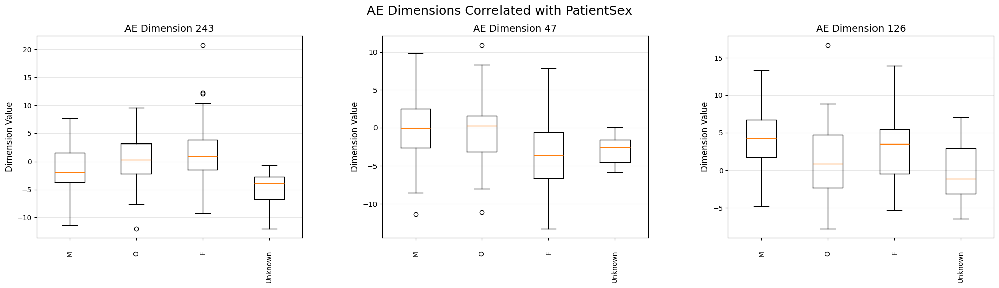

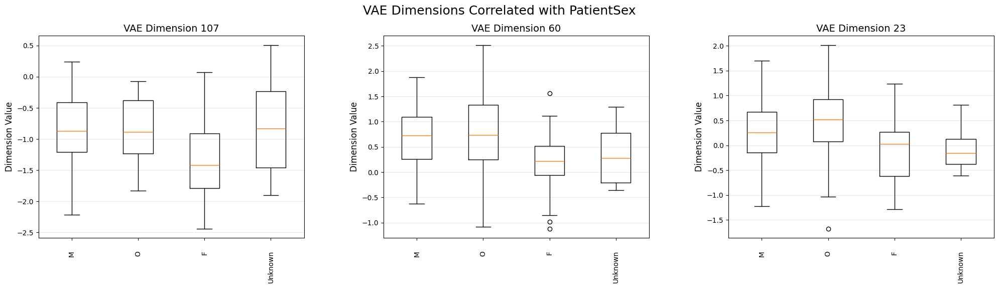


Analyzing field 'StudyDescription'...
Data type for StudyDescription: object
Unique values: ['1-DAT' '1-TRODAT' '1/CoPPMI' '2-DAT' '3-DAT' '4-DAT' '42346' 'BRAIN'
 'BRAIN COMPLETE SPECT IMAGING' 'BRAIN DATSCAN' 'BRAIN ECT' 'Brain Scan'
 'Brain Spect' 'CE DATSCAN -ECT' 'CE DATSCAN_ECT' 'Cerveau PPMI' 'DATSCAN'
 'DatScan' 'HIRN' 'I/Co PPMI' 'NM BRAIN COMPLETE STUDY SPECT'
 'NM I-123 DATSCAN BRAIN SPECT' 'P-PPMI' 'PA-DAT' 'PPMI' 'PPMI BRAIN NEW'
 'PPMI BRAIN STUDY' 'PPMI DUAL ISOTOPE BRAIN-A' 'RAW 1' 'RAW TOMO'
 'SPECT Ganglio  Base' 'SPECT TRANSPORTADOR DOPAMINA' 'User&Brain&Datscan'
 'V02EI-DAT']
Counts per category: {'1-DAT': 37, 'Brain Scan': 23, 'I/Co PPMI': 14, 'Brain Spect': 13, 'PPMI DUAL ISOTOPE BRAIN-A': 7, 'NM BRAIN COMPLETE STUDY SPECT': 5, 'BRAIN DATSCAN': 5, '2-DAT': 4, 'PPMI': 3, 'RAW TOMO': 3, 'CE DATSCAN_ECT': 3, 'BRAIN': 2, 'SPECT Ganglio  Base': 2, 'PPMI BRAIN NEW': 2, '4-DAT': 2, '1-TRODAT': 2, 'SPECT TRANSPORTADOR DOPAMINA': 2, 'NM I-123 DATSCAN BRAIN SPECT': 2, 'PPM

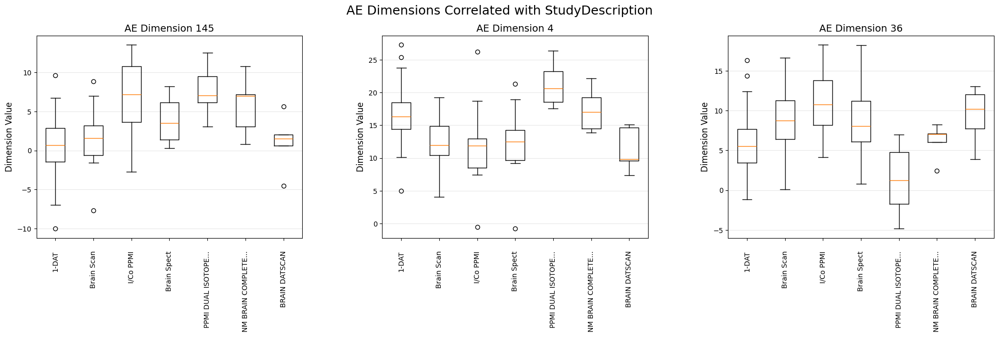

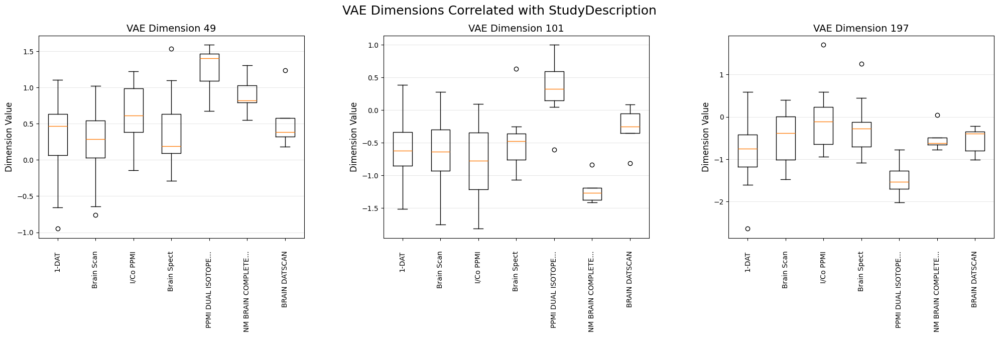


Analyzing field 'Manufacturer'...
Data type for Manufacturer: object
Unique values: ['0000000' 'ADAC' 'GE MEDICAL SYSTEMS' 'GE_MEDICAL_SYSTEMS'
 'Marconi Medical Systems, NM Division' 'PICKER' 'Philips Healthcare'
 'Philips Nuclear Medicine' 'Picker International, NM Division'
 'SIEMENS NM' 'Unknown']
Counts per category: {'SIEMENS NM': 72, 'GE MEDICAL SYSTEMS': 34, 'Marconi Medical Systems, NM Division': 13, 'Philips Nuclear Medicine': 8, 'PICKER': 6, 'Philips Healthcare': 6, 'ADAC': 4, 'Picker International, NM Division': 3, 'GE_MEDICAL_SYSTEMS': 2, 'Unknown': 1, '0000000': 1}
Analyzing with 139 samples across 6 categories

Top 10 AE dimensions for Manufacturer:
  Dimension 26: F-statistic=6.54, p-value=0.0000
  Dimension 112: F-statistic=5.85, p-value=0.0001
  Dimension 242: F-statistic=5.31, p-value=0.0002
  Dimension 97: F-statistic=5.19, p-value=0.0002
  Dimension 102: F-statistic=5.15, p-value=0.0002
  Dimension 145: F-statistic=5.11, p-value=0.0003
  Dimension 36: F-statistic=

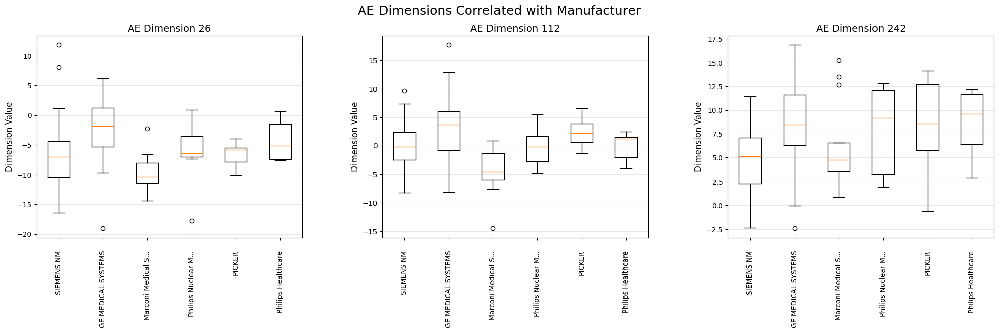

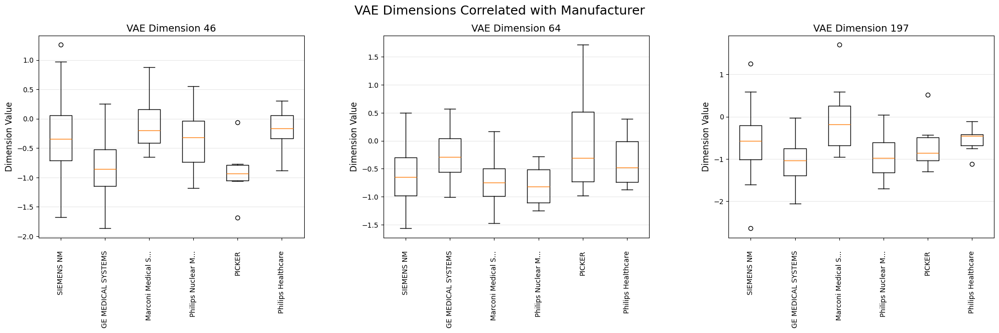


Analyzing field 'ManufacturerModelName'...
Data type for ManufacturerModelName: object
Unique values: ['2000XP' '3000XP' 'BrightView' 'ENCORE2' 'Encore2' 'Forte'
 'HERMES Workstation' 'INFINIA' 'IP2' 'MILLENNIUM MG' 'P3000XP'
 'Tandem_Discovery_630' 'Tandem_Discovery_670_Pro' 'Tandem_Optima_640'
 'VARICAM']
Counts per category: {'Encore2': 61, 'BrightView': 15, 'P3000XP': 13, 'INFINIA': 13, 'IP2': 11, 'MILLENNIUM MG': 9, 'HERMES Workstation': 6, 'Tandem_Optima_640': 6, 'Tandem_Discovery_670_Pro': 4, 'Forte': 4, '3000XP': 2, 'VARICAM': 2, 'Tandem_Discovery_630': 2, 'ENCORE2': 1, '2000XP': 1}
Analyzing with 134 samples across 8 categories

Top 10 AE dimensions for ManufacturerModelName:
  Dimension 26: F-statistic=5.66, p-value=0.0000
  Dimension 36: F-statistic=5.05, p-value=0.0000
  Dimension 131: F-statistic=4.78, p-value=0.0001
  Dimension 47: F-statistic=4.60, p-value=0.0001
  Dimension 242: F-statistic=4.55, p-value=0.0001
  Dimension 83: F-statistic=4.53, p-value=0.0002
  Dimensi

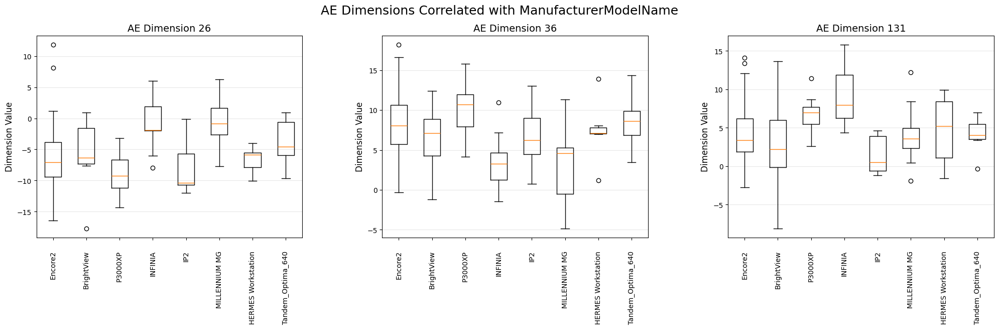

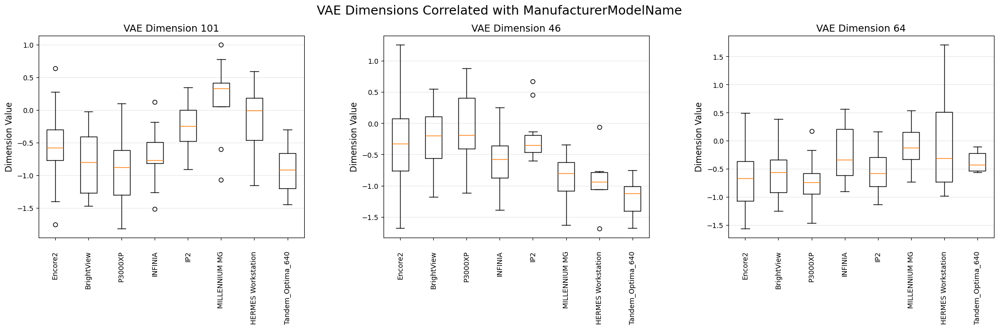


Dimension analysis completed!


In [34]:
# Cell 23: Metadata Dimension Analysis with Improved Visualization

import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from tqdm import tqdm
import torch
import re
import scipy.stats as stats

def analyze_metadata_dimensions(ae_model, vae_model, dataloader, metadata_path="dicom_metadata.csv", max_samples=150):
    """
    Analyze how specific dimensions in the latent spaces correlate with metadata.
    """
    print("\nAnalyzing correlation between latent dimensions and metadata...")
    
    # Load metadata CSV
    if not os.path.exists(metadata_path):
        print(f"Error: Metadata file {metadata_path} not found!")
        return None
    
    # Load with proper type handling
    metadata_df = pd.read_csv(metadata_path)
    print(f"Loaded metadata with {len(metadata_df)} entries and columns: {metadata_df.columns.tolist()}")
    
    # Check data types and missing values
    print("\nData types in metadata:")
    print(metadata_df.dtypes)
    
    print("\nMissing values in metadata:")
    print(metadata_df.isnull().sum())
    
    # Extract latent vectors from models
    device = next(ae_model.parameters()).device
    ae_model.eval()
    vae_model.eval()
    
    sample_paths = []
    sample_labels = []
    ae_latent_vecs = []
    vae_latent_means = []
    
    with torch.no_grad():
        for batch in tqdm(dataloader, desc="Extracting latent vectors"):
            volumes = batch['volume'].to(device)
            batch_labels = batch['label']
            batch_paths = batch['path']
            
            # Get latent vectors
            ae_z = ae_model.encode(volumes)
            vae_mu, _ = vae_model.encode(volumes)
            
            # Store results
            ae_latent_vecs.append(ae_z.cpu().numpy())
            vae_latent_means.append(vae_mu.cpu().numpy())
            sample_paths.extend(batch_paths)
            sample_labels.extend(batch_labels)
            
            # Memory cleanup
            del volumes, ae_z, vae_mu
            torch.cuda.empty_cache()
            
            if len(sample_paths) >= max_samples:
                break
    
    # Stack arrays
    ae_latent_vecs = np.vstack(ae_latent_vecs)
    vae_latent_means = np.vstack(vae_latent_means)
    
    # Create dataframe with sample info
    sample_df = pd.DataFrame({
        'file_path': sample_paths,
        'group': sample_labels
    })
    
    # Normalize paths for matching
    sample_df['file_path_norm'] = sample_df['file_path'].apply(
        lambda x: os.path.basename(x.replace('\\', '/'))
    )
    metadata_df['file_path_norm'] = metadata_df['file_path'].apply(
        lambda x: os.path.basename(x.replace('\\', '/'))
    )
    
    # Extract patient IDs as a fallback matching strategy
    def extract_patient_id(path):
        path = path.replace('\\', '/')
        match = re.search(r'PPMI_(\d+)_', path)
        if match:
            return match.group(1)
        match = re.search(r'PPMI_Images_\w+/(\d+)/', path)
        if match:
            return match.group(1)
        return None
    
    sample_df['patient_id'] = sample_df['file_path'].apply(extract_patient_id)
    metadata_df['patient_id'] = metadata_df['file_path'].apply(extract_patient_id)
    
    # Try to match by filename first
    merged_df = pd.merge(sample_df, metadata_df, on='file_path_norm', how='inner', suffixes=('_sample', '_meta'))
    
    # If that doesn't work well, try matching by patient ID
    if len(merged_df) < 10:
        print("Filename matching failed, trying patient ID matching...")
        merged_df = pd.merge(sample_df, metadata_df, on='patient_id', how='inner', suffixes=('_sample', '_meta'))
    
    print(f"Successfully matched {len(merged_df)} samples with metadata")
    
    if len(merged_df) < 10:
        print("Error: Insufficient matches for analysis. Check file paths.")
        print("Sample patient IDs:", sample_df['patient_id'].dropna().unique()[:10])
        print("Metadata patient IDs:", metadata_df['patient_id'].dropna().unique()[:10])
        return None
    
    # Get indices of matched samples to extract latent vectors
    matched_indices = [sample_paths.index(path) for path in merged_df['file_path_sample']]
    ae_matched = ae_latent_vecs[matched_indices]
    vae_matched = vae_latent_means[matched_indices]
    
    # Analyze categorical metadata fields
    categorical_fields = ['PatientSex', 'StudyDescription', 'Manufacturer', 'ManufacturerModelName']
    
    # Results storage
    dimension_analysis = {
        'ae': {field: {} for field in categorical_fields},
        'vae': {field: {} for field in categorical_fields}
    }
    
    # Analyze each metadata field
    for field in categorical_fields:
        field_meta = field + '_meta' if field + '_meta' in merged_df.columns else field
        
        if field_meta not in merged_df.columns:
            print(f"Warning: Field '{field}' not found in metadata")
            continue
        
        print(f"\nAnalyzing field '{field}'...")
        
        # Check data type and handle properly
        print(f"Data type for {field_meta}: {merged_df[field_meta].dtype}")
        
        # Handle nulls and convert to string for consistent processing
        field_values = merged_df[field_meta].fillna('Unknown').astype(str).values
        
        # Now get unique values safely
        unique_values = np.unique(field_values)
        print(f"Unique values: {unique_values}")
        
        # Skip if less than 2 categories
        if len(unique_values) < 2:
            print(f"Skipping '{field}' - only one unique value found")
            continue
            
        # Count samples per category
        value_counts = pd.Series(field_values).value_counts()
        print(f"Counts per category: {dict(value_counts)}")
        
        # Skip categories with too few samples
        keep_values = value_counts[value_counts >= 5].index.tolist()
        if len(keep_values) < 2:
            print(f"Skipping '{field}' - insufficient samples per category")
            continue
            
        # Filter to keep only samples with sufficient category representation
        keep_mask = np.array([v in keep_values for v in field_values])
        if keep_mask.sum() < 10:
            print(f"Skipping '{field}' - insufficient samples after filtering")
            continue
            
        filtered_values = field_values[keep_mask]
        ae_filtered = ae_matched[keep_mask]
        vae_filtered = vae_matched[keep_mask]
        
        print(f"Analyzing with {len(filtered_values)} samples across {len(keep_values)} categories")
        
        # Calculate dimension scores
        ae_scores = np.zeros(ae_filtered.shape[1])
        vae_scores = np.zeros(vae_filtered.shape[1])
        ae_p_values = np.ones(ae_filtered.shape[1])
        vae_p_values = np.ones(vae_filtered.shape[1])
        
        # Convert categorical values to numeric for analysis
        value_map = {val: i for i, val in enumerate(keep_values)}
        y = np.array([value_map[val] for val in filtered_values])
        
        # DIMENSION SELECTION METHOD: 
        # Using ANOVA F-statistic to measure how well each dimension separates different categories
        for dim in range(ae_filtered.shape[1]):
            try:
                # Group data by category for ANOVA
                groups = [ae_filtered[filtered_values == val, dim] for val in keep_values]
                # Some groups might be empty or have only one sample
                if all(len(g) > 1 for g in groups):
                    f_val, p_val = stats.f_oneway(*groups)
                    ae_scores[dim] = f_val
                    ae_p_values[dim] = p_val
                else:
                    ae_scores[dim] = 0
                    ae_p_values[dim] = 1.0
            except Exception as e:
                print(f"Error analyzing AE dimension {dim}: {e}")
                ae_scores[dim] = 0
                ae_p_values[dim] = 1.0
        
        for dim in range(vae_filtered.shape[1]):
            try:
                groups = [vae_filtered[filtered_values == val, dim] for val in keep_values]
                if all(len(g) > 1 for g in groups):
                    f_val, p_val = stats.f_oneway(*groups)
                    vae_scores[dim] = f_val
                    vae_p_values[dim] = p_val
                else:
                    vae_scores[dim] = 0
                    vae_p_values[dim] = 1.0
            except Exception as e:
                print(f"Error analyzing VAE dimension {dim}: {e}")
                vae_scores[dim] = 0
                vae_p_values[dim] = 1.0
        
        # Find top dimensions (highest F-statistic and p < 0.05)
        ae_signif_dims = np.where(ae_p_values < 0.05)[0]
        vae_signif_dims = np.where(vae_p_values < 0.05)[0]
        
        ae_top_dims = ae_signif_dims[np.argsort(ae_scores[ae_signif_dims])[::-1][:10]]
        vae_top_dims = vae_signif_dims[np.argsort(vae_scores[vae_signif_dims])[::-1][:10]]
        
        print(f"\nTop 10 AE dimensions for {field}:")
        for i, dim in enumerate(ae_top_dims):
            print(f"  Dimension {dim}: F-statistic={ae_scores[dim]:.2f}, p-value={ae_p_values[dim]:.4f}")
        
        print(f"\nTop 10 VAE dimensions for {field}:")
        for i, dim in enumerate(vae_top_dims):
            print(f"  Dimension {dim}: F-statistic={vae_scores[dim]:.2f}, p-value={vae_p_values[dim]:.4f}")
        
        # Visualize top dimensions with separate plots for AE and VAE
        if len(ae_top_dims) > 0 or len(vae_top_dims) > 0:
            # Abbreviate labels if needed
            labels = []
            for val in keep_values:
                if len(val) > 20:  # If label is too long
                    shortened = val[:17] + "..."
                else:
                    shortened = val
                labels.append(shortened)
            
            # AE DIMENSIONS PLOT (if we have significant dimensions)
            if len(ae_top_dims) > 0:
                plt.figure(figsize=(20, 8))
                plt.suptitle(f"AE Dimensions Correlated with {field}", fontsize=18)
                
                # Plot up to 3 top AE dimensions
                for i, dim in enumerate(ae_top_dims[:3]):
                    if i < 3:  # Only plot first 3
                        plt.subplot(1, 3, i+1)
                        
                        # Create boxplot with clear labels (no colors)
                        data = []
                        for val in keep_values:
                            mask = filtered_values == val
                            data.append(ae_filtered[mask, dim])
                        
                        # Standard boxplot without colors
                        plt.boxplot(data)
                        
                        plt.title(f'AE Dimension {dim}', fontsize=14)
                        plt.ylabel('Dimension Value', fontsize=12)
                        
                        # Set x-ticks with increased spacing
                        plt.xticks(range(1, len(labels)+1), labels, rotation=90, fontsize=10)
                        plt.tick_params(axis='x', which='major', pad=15)  # Add padding for better readability
                        plt.grid(axis='y', alpha=0.3)
                
                # Ensure there's plenty of space
                plt.tight_layout()
                plt.subplots_adjust(bottom=0.4, wspace=0.3)
                plt.show()
            
            # VAE DIMENSIONS PLOT (if we have significant dimensions)
            if len(vae_top_dims) > 0:
                plt.figure(figsize=(20, 8))
                plt.suptitle(f"VAE Dimensions Correlated with {field}", fontsize=18)
                
                # Plot up to 3 top VAE dimensions
                for i, dim in enumerate(vae_top_dims[:3]):
                    if i < 3:  # Only plot first 3
                        plt.subplot(1, 3, i+1)
                        
                        # Create boxplot with clear labels (no colors)
                        data = []
                        for val in keep_values:
                            mask = filtered_values == val
                            data.append(vae_filtered[mask, dim])
                        
                        # Standard boxplot without colors
                        plt.boxplot(data)
                        
                        plt.title(f'VAE Dimension {dim}', fontsize=14)
                        plt.ylabel('Dimension Value', fontsize=12)
                        
                        # Set x-ticks with increased spacing
                        plt.xticks(range(1, len(labels)+1), labels, rotation=90, fontsize=10)
                        plt.tick_params(axis='x', which='major', pad=15)  # Add padding for better readability
                        plt.grid(axis='y', alpha=0.3)
                
                # Ensure there's plenty of space
                plt.tight_layout()
                plt.subplots_adjust(bottom=0.4, wspace=0.3)
                plt.show()
        
        # Store results
        dimension_analysis['ae'][field] = {
            'scores': ae_scores,
            'p_values': ae_p_values,
            'top_dims': ae_top_dims.tolist()
        }
        
        dimension_analysis['vae'][field] = {
            'scores': vae_scores,
            'p_values': vae_p_values,
            'top_dims': vae_top_dims.tolist()
        }
    
    return dimension_analysis

# Load both models
print("Loading trained models...")
ae_model, _ = load_trained_model('checkpoints', 'autoencoder_v1', latent_dim=256)
vae_model, _ = load_trained_vae('checkpoints', 'vae_model_v2', latent_dim=256)

# Run the dimension analysis
print("\nAnalyzing which dimensions correlate with metadata...")
dimension_results = analyze_metadata_dimensions(
    ae_model, vae_model, val_loader, 
    metadata_path="dicom_metadata.csv", max_samples=150)

print("\nDimension analysis completed!")

Loading trained models...
Using device: cuda
Loading best VAE model from checkpoints/vae_model_v2_best.pth
Loaded training history with 249 epochs

Analyzing which dimensions correlate with metadata...

Analyzing correlation between latent dimensions and metadata...
Loaded metadata with 2986 entries and columns: ['file_path', 'group', 'PatientSex', 'StudyDescription', 'Manufacturer', 'ManufacturerModelName']

Data types in metadata:
file_path                object
group                    object
PatientSex               object
StudyDescription         object
Manufacturer             object
ManufacturerModelName    object
dtype: object

Missing values in metadata:
file_path                  0
group                      0
PatientSex               131
StudyDescription          14
Manufacturer               1
ManufacturerModelName      0
dtype: int64


Extracting latent vectors:   4%|▍         | 12/299 [00:00<00:19, 15.06it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Extracting latent vectors:  21%|██        | 63/299 [00:03<00:11, 20.21it/s]

Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Extracting latent vectors:  48%|████▊     | 145/299 [00:07<00:07, 20.52it/s]

Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Extracting latent vectors:  83%|████████▎ | 249/299 [00:13<00:02, 18.27it/s]


Extracted latent vectors: AE shape=(500, 256), VAE shape=(500, 256)
Successfully matched 500 samples with metadata
Matched latent vectors: AE shape=(500, 256), VAE shape=(500, 256)

Analyzing field 'PatientSex'...
Data type for PatientSex: object
Unique values: ['F' 'M' 'O' 'Unknown']
Counts per category: {'M': 210, 'O': 138, 'F': 129, 'Unknown': 23}
Analyzing with 500 samples across 4 categories
Starting F-statistic calculation for 256 AE dimensions...
  AE Dim 0: F=1.53, p=0.2046, group sizes: [210, 138, 129, 23]
  AE Dim 50: F=4.61, p=0.0034, group sizes: [210, 138, 129, 23]
  AE Dim 100: F=2.88, p=0.0357, group sizes: [210, 138, 129, 23]
  AE Dim 150: F=3.89, p=0.0091, group sizes: [210, 138, 129, 23]
  AE Dim 200: F=3.24, p=0.0220, group sizes: [210, 138, 129, 23]
  AE Dim 250: F=10.75, p=0.0000, group sizes: [210, 138, 129, 23]
Completed AE dimension analysis in 0.08 seconds
Processed 256/256 dimensions, 256 with valid calculations
Starting F-statistic calculation for 256 VAE dim

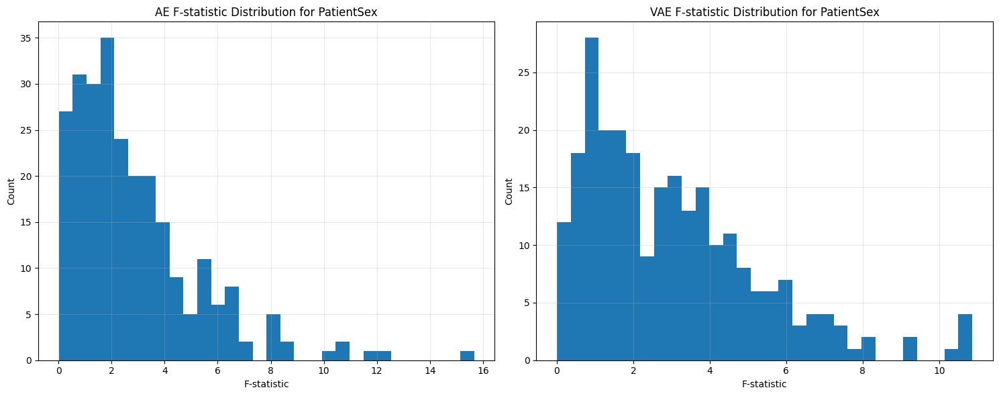

Found 109 significant AE dimensions
Found 128 significant VAE dimensions

Top 10 AE dimensions for PatientSex:
  Dimension 63: F-statistic=15.66, p-value=0.0000
  Dimension 188: F-statistic=12.31, p-value=0.0000
  Dimension 212: F-statistic=11.83, p-value=0.0000
  Dimension 189: F-statistic=10.86, p-value=0.0000
  Dimension 250: F-statistic=10.75, p-value=0.0000
  Dimension 197: F-statistic=10.33, p-value=0.0000
  Dimension 66: F-statistic=8.87, p-value=0.0000
  Dimension 142: F-statistic=8.70, p-value=0.0000
  Dimension 157: F-statistic=8.27, p-value=0.0000
  Dimension 44: F-statistic=8.21, p-value=0.0000

Top 10 VAE dimensions for PatientSex:
  Dimension 107: F-statistic=10.86, p-value=0.0000
  Dimension 29: F-statistic=10.80, p-value=0.0000
  Dimension 248: F-statistic=10.79, p-value=0.0000
  Dimension 232: F-statistic=10.51, p-value=0.0000
  Dimension 220: F-statistic=10.17, p-value=0.0000
  Dimension 118: F-statistic=9.22, p-value=0.0000
  Dimension 192: F-statistic=9.12, p-value=

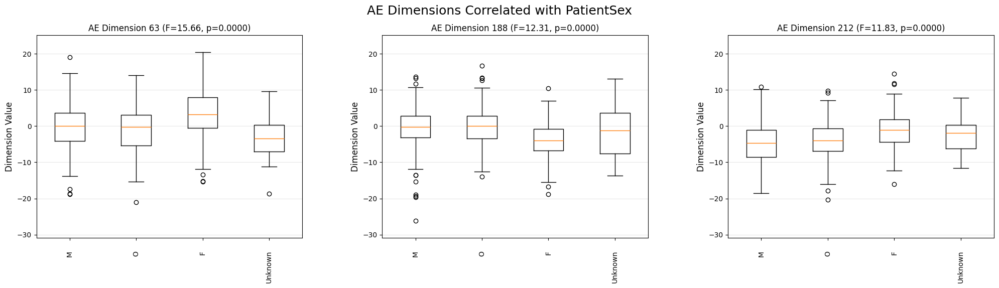

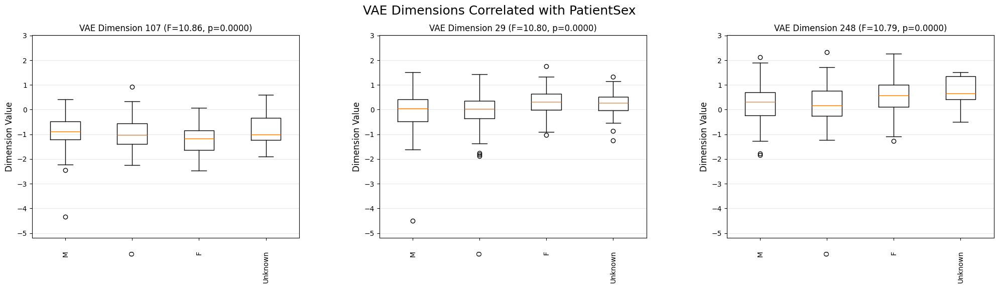


Analyzing field 'StudyDescription'...
Data type for StudyDescription: object
Unique values: ['1' '1-DAT' '1-TRODAT' '1/CoPPMI' '2-DAT' '3-DAT' '4-DAT' '41287' '42346'
 'BRAIN' 'BRAIN COMPLETE SPECT IMAGING' 'BRAIN DATSCAN' 'BRAIN ECT'
 'BRAIN SCAN SPECT' 'BRAINR2S' 'Bone Scan' 'Brain Scan' 'Brain Spect'
 'CE DATSCAN -ECT' 'CE DATSCAN_ECT' 'Cerveau PPMI' 'DATSCAN'
 'DATSCAN BRAIN' 'DaTscan' 'DatScan' 'HIRN' 'Hirnrezeptorszintigraphie'
 'I-123 TOMO' 'I/Co PPMI' 'NM BRAIN COMPLETE STUDY SPECT'
 'NM BRAIN DATSCAN SPECT' 'NM I-123 DATSCAN BRAIN SPECT' 'P-PPMI' 'PA-DAT'
 'PPMI' 'PPMI BRAIN NEW' 'PPMI BRAIN STUDY' 'PPMI DUAL ISOTOPE BRAIN-A'
 'PPMI DatScan' 'RAW 1' 'RAW TOMO' 'Raw' 'SPECT Ganglio  Base'
 'SPECT TRANSPORTADOR DOPAMINA' 'Unknown' 'User&Brain&Datscan'
 'User&Brain&PPMI Dual Isotope Brain' 'V02EI-DAT' 'V04EI-DAT' 'V05EI-DAT'
 'V08-DAT']
Counts per category: {'1-DAT': 114, 'Brain Scan': 75, 'I/Co PPMI': 53, 'Brain Spect': 36, 'PPMI DUAL ISOTOPE BRAIN-A': 24, 'BRAIN DATSCAN': 14, 

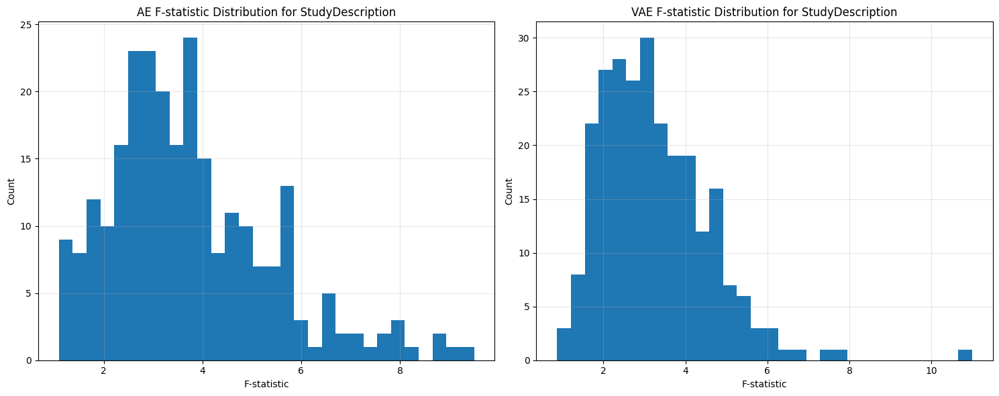

Found 240 significant AE dimensions
Found 244 significant VAE dimensions

Top 10 AE dimensions for StudyDescription:
  Dimension 155: F-statistic=9.50, p-value=0.0000
  Dimension 76: F-statistic=9.17, p-value=0.0000
  Dimension 116: F-statistic=8.83, p-value=0.0000
  Dimension 108: F-statistic=8.76, p-value=0.0000
  Dimension 214: F-statistic=8.10, p-value=0.0000
  Dimension 104: F-statistic=8.03, p-value=0.0000
  Dimension 193: F-statistic=7.89, p-value=0.0000
  Dimension 10: F-statistic=7.88, p-value=0.0000
  Dimension 88: F-statistic=7.70, p-value=0.0000
  Dimension 84: F-statistic=7.56, p-value=0.0000

Top 10 VAE dimensions for StudyDescription:
  Dimension 196: F-statistic=11.00, p-value=0.0000
  Dimension 0: F-statistic=7.71, p-value=0.0000
  Dimension 197: F-statistic=7.32, p-value=0.0000
  Dimension 153: F-statistic=6.64, p-value=0.0000
  Dimension 53: F-statistic=6.49, p-value=0.0000
  Dimension 169: F-statistic=6.25, p-value=0.0000
  Dimension 246: F-statistic=6.01, p-value=0

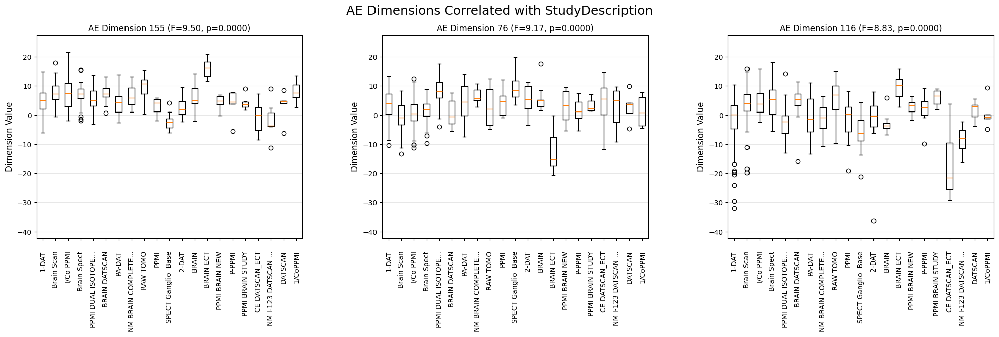

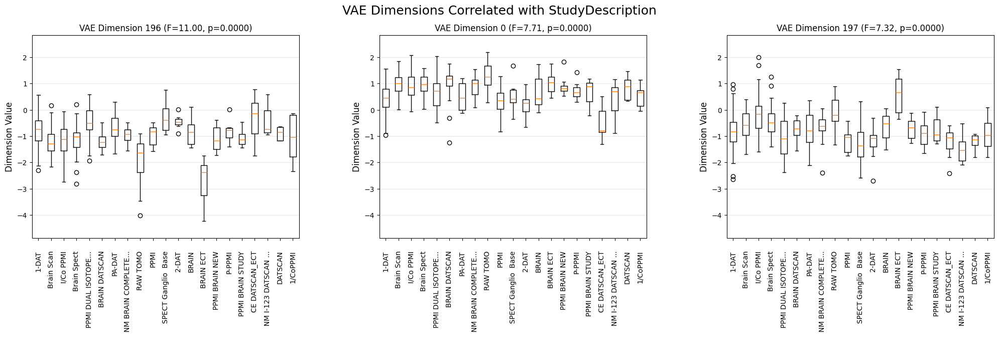


Analyzing field 'Manufacturer'...
Data type for Manufacturer: object
Unique values: ['0000000' 'ADAC' 'GE MEDICAL SYSTEMS' 'GE_MEDICAL_SYSTEMS'
 'Marconi Medical Systems, NM Division' 'PICKER' 'Philips Healthcare'
 'Philips Medical Systems, NM Division' 'Philips Nuclear Medicine'
 'Picker International, NM Division' 'SIEMENS NM' 'Unknown']
Counts per category: {'SIEMENS NM': 237, 'GE MEDICAL SYSTEMS': 110, 'Marconi Medical Systems, NM Division': 51, 'PICKER': 25, 'Philips Nuclear Medicine': 23, 'Philips Healthcare': 18, 'Picker International, NM Division': 13, 'GE_MEDICAL_SYSTEMS': 9, 'ADAC': 9, '0000000': 2, 'Philips Medical Systems, NM Division': 2, 'Unknown': 1}
Analyzing with 495 samples across 9 categories
Starting F-statistic calculation for 256 AE dimensions...
  AE Dim 0: F=2.91, p=0.0035, group sizes: [237, 110, 51, 25, 23, 18, 13, 9, 9]
  AE Dim 50: F=3.42, p=0.0008, group sizes: [237, 110, 51, 25, 23, 18, 13, 9, 9]
  AE Dim 100: F=4.51, p=0.0000, group sizes: [237, 110, 51,

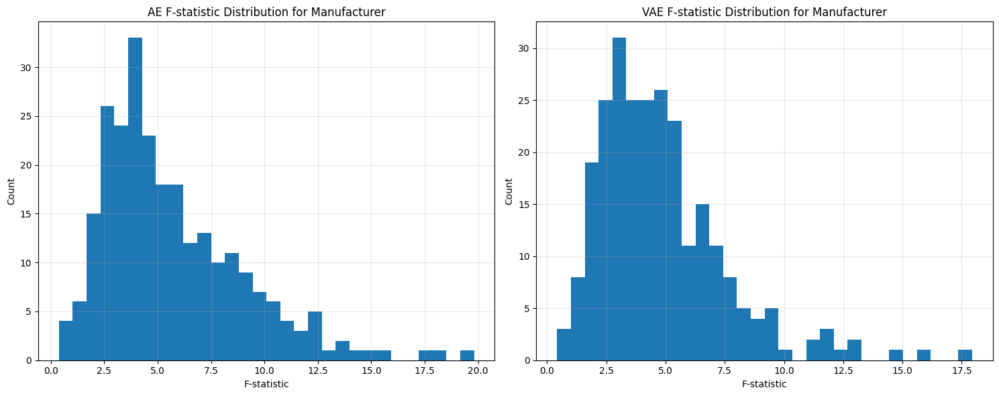

Found 240 significant AE dimensions
Found 234 significant VAE dimensions

Top 10 AE dimensions for Manufacturer:
  Dimension 88: F-statistic=19.81, p-value=0.0000
  Dimension 26: F-statistic=18.28, p-value=0.0000
  Dimension 116: F-statistic=17.32, p-value=0.0000
  Dimension 95: F-statistic=15.42, p-value=0.0000
  Dimension 104: F-statistic=15.14, p-value=0.0000
  Dimension 76: F-statistic=14.63, p-value=0.0000
  Dimension 4: F-statistic=13.93, p-value=0.0000
  Dimension 54: F-statistic=13.41, p-value=0.0000
  Dimension 84: F-statistic=13.25, p-value=0.0000
  Dimension 193: F-statistic=12.58, p-value=0.0000

Top 10 VAE dimensions for Manufacturer:
  Dimension 196: F-statistic=17.95, p-value=0.0000
  Dimension 249: F-statistic=15.98, p-value=0.0000
  Dimension 246: F-statistic=14.68, p-value=0.0000
  Dimension 0: F-statistic=12.99, p-value=0.0000
  Dimension 45: F-statistic=12.75, p-value=0.0000
  Dimension 104: F-statistic=12.33, p-value=0.0000
  Dimension 28: F-statistic=11.96, p-valu

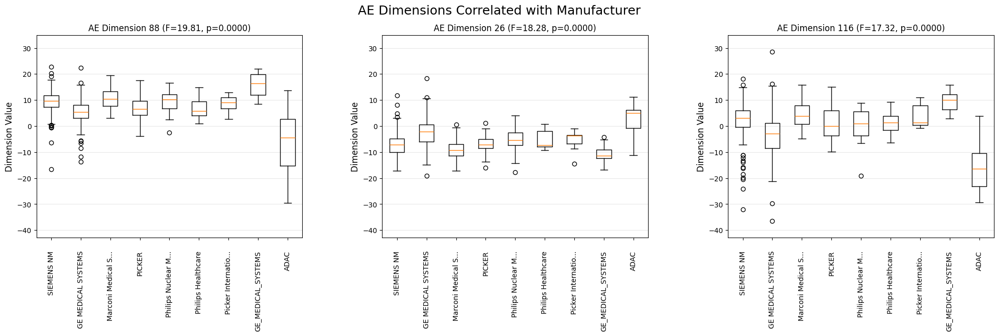

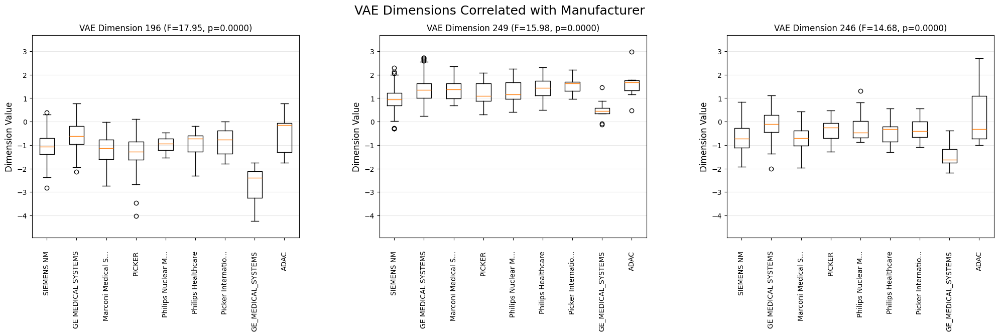


Analyzing field 'ManufacturerModelName'...
Data type for ManufacturerModelName: object
Unique values: ['2000XP' '3000XP' 'BrightView' 'EBW NM' 'ENCORE2' 'Encore2' 'Forte'
 'HERMES Workstation' 'INFINIA' 'IP2' 'IRIX' 'MILLENNIUM MG'
 'MILLENNIUM MPS' 'P3000XP' 'Tandem_830' 'Tandem_870_DR'
 'Tandem_Discovery_630' 'Tandem_Discovery_670' 'Tandem_Discovery_670_Pro'
 'Tandem_Optima_640' 'VARICAM']
Counts per category: {'Encore2': 189, 'P3000XP': 51, 'BrightView': 42, 'IP2': 42, 'INFINIA': 38, 'MILLENNIUM MG': 34, 'HERMES Workstation': 25, 'Tandem_Discovery_630': 13, 'Tandem_Optima_640': 12, 'Forte': 9, 'VARICAM': 9, 'ENCORE2': 7, '3000XP': 7, '2000XP': 6, 'Tandem_Discovery_670_Pro': 5, 'Tandem_830': 3, 'MILLENNIUM MPS': 3, 'IRIX': 2, 'Tandem_870_DR': 1, 'EBW NM': 1, 'Tandem_Discovery_670': 1}
Analyzing with 489 samples across 15 categories
Starting F-statistic calculation for 256 AE dimensions...
  AE Dim 0: F=2.20, p=0.0070, group sizes: [189, 51, 42, 42, 38, 34, 25, 13, 12, 9, 9, 7, 7, 6,

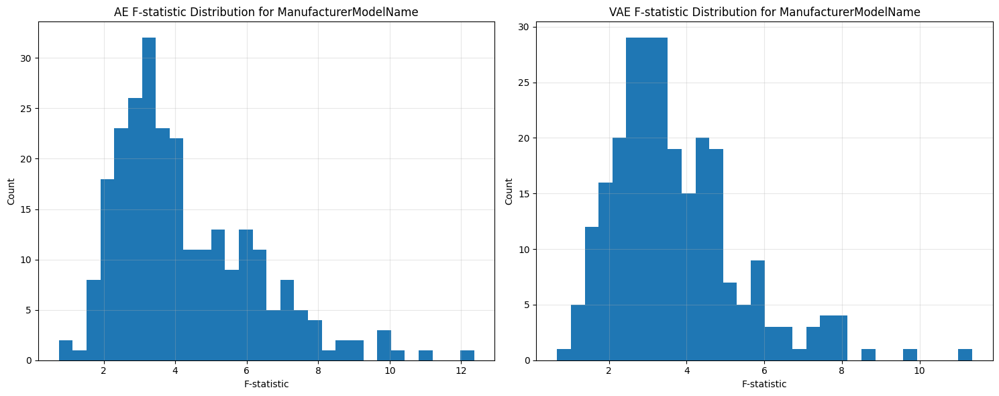

Found 247 significant AE dimensions
Found 238 significant VAE dimensions

Top 10 AE dimensions for ManufacturerModelName:
  Dimension 88: F-statistic=12.36, p-value=0.0000
  Dimension 116: F-statistic=10.97, p-value=0.0000
  Dimension 29: F-statistic=10.09, p-value=0.0000
  Dimension 95: F-statistic=9.98, p-value=0.0000
  Dimension 54: F-statistic=9.92, p-value=0.0000
  Dimension 26: F-statistic=9.73, p-value=0.0000
  Dimension 104: F-statistic=9.24, p-value=0.0000
  Dimension 193: F-statistic=9.12, p-value=0.0000
  Dimension 156: F-statistic=8.67, p-value=0.0000
  Dimension 76: F-statistic=8.58, p-value=0.0000

Top 10 VAE dimensions for ManufacturerModelName:
  Dimension 196: F-statistic=11.35, p-value=0.0000
  Dimension 249: F-statistic=9.74, p-value=0.0000
  Dimension 0: F-statistic=8.66, p-value=0.0000
  Dimension 197: F-statistic=8.09, p-value=0.0000
  Dimension 45: F-statistic=7.97, p-value=0.0000
  Dimension 65: F-statistic=7.92, p-value=0.0000
  Dimension 246: F-statistic=7.91,

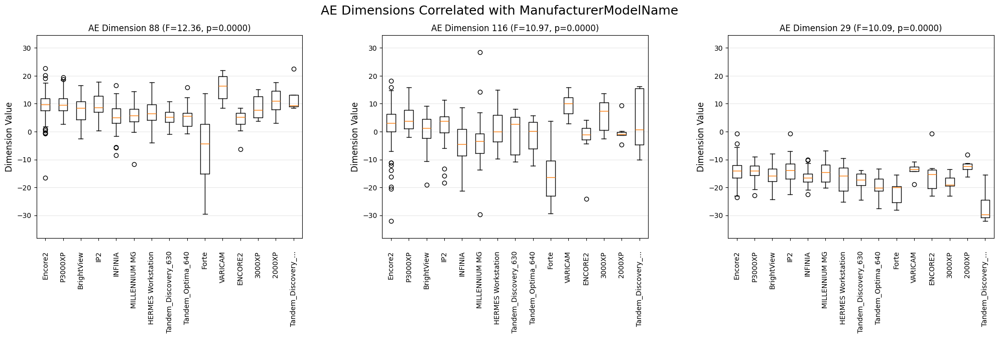

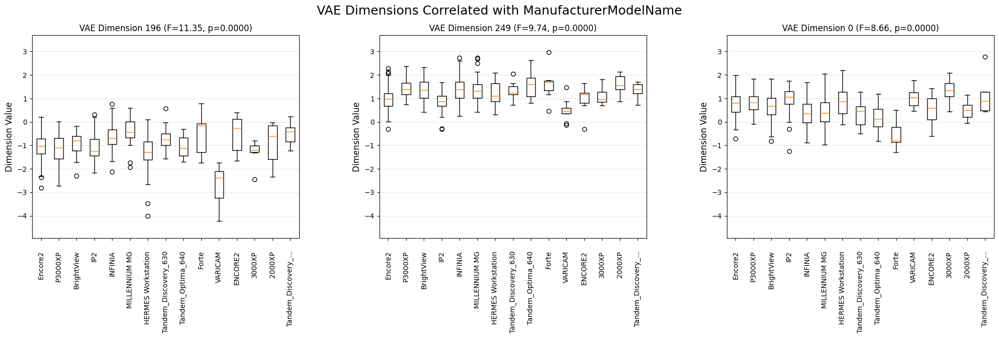


Dimension analysis completed!


In [35]:
# Cell 24: Metadata Dimension Analysis with Debug Output

import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from tqdm import tqdm
import torch
import re
import scipy.stats as stats

def analyze_metadata_dimensions(ae_model, vae_model, dataloader, metadata_path="dicom_metadata.csv", max_samples=150, debug=True):
    """
    Analyze how specific dimensions in the latent spaces correlate with metadata.
    """
    print("\nAnalyzing correlation between latent dimensions and metadata...")
    
    # Load metadata CSV
    if not os.path.exists(metadata_path):
        print(f"Error: Metadata file {metadata_path} not found!")
        return None
    
    # Load with proper type handling
    metadata_df = pd.read_csv(metadata_path)
    print(f"Loaded metadata with {len(metadata_df)} entries and columns: {metadata_df.columns.tolist()}")
    
    # Check data types and missing values
    print("\nData types in metadata:")
    print(metadata_df.dtypes)
    
    print("\nMissing values in metadata:")
    print(metadata_df.isnull().sum())
    
    # Extract latent vectors from models
    device = next(ae_model.parameters()).device
    ae_model.eval()
    vae_model.eval()
    
    sample_paths = []
    sample_labels = []
    ae_latent_vecs = []
    vae_latent_means = []
    
    with torch.no_grad():
        for batch in tqdm(dataloader, desc="Extracting latent vectors"):
            volumes = batch['volume'].to(device)
            batch_labels = batch['label']
            batch_paths = batch['path']
            
            # Get latent vectors
            ae_z = ae_model.encode(volumes)
            vae_mu, _ = vae_model.encode(volumes)
            
            # Store results
            ae_latent_vecs.append(ae_z.cpu().numpy())
            vae_latent_means.append(vae_mu.cpu().numpy())
            sample_paths.extend(batch_paths)
            sample_labels.extend(batch_labels)
            
            # Memory cleanup
            del volumes, ae_z, vae_mu
            torch.cuda.empty_cache()
            
            if len(sample_paths) >= max_samples:
                break
    
    # Stack arrays
    ae_latent_vecs = np.vstack(ae_latent_vecs)
    vae_latent_means = np.vstack(vae_latent_means)
    
    print(f"Extracted latent vectors: AE shape={ae_latent_vecs.shape}, VAE shape={vae_latent_means.shape}")
    
    # Create dataframe with sample info
    sample_df = pd.DataFrame({
        'file_path': sample_paths,
        'group': sample_labels
    })
    
    # Normalize paths for matching
    sample_df['file_path_norm'] = sample_df['file_path'].apply(
        lambda x: os.path.basename(x.replace('\\', '/'))
    )
    metadata_df['file_path_norm'] = metadata_df['file_path'].apply(
        lambda x: os.path.basename(x.replace('\\', '/'))
    )
    
    # Extract patient IDs as a fallback matching strategy
    def extract_patient_id(path):
        path = path.replace('\\', '/')
        match = re.search(r'PPMI_(\d+)_', path)
        if match:
            return match.group(1)
        match = re.search(r'PPMI_Images_\w+/(\d+)/', path)
        if match:
            return match.group(1)
        return None
    
    sample_df['patient_id'] = sample_df['file_path'].apply(extract_patient_id)
    metadata_df['patient_id'] = metadata_df['file_path'].apply(extract_patient_id)
    
    # Try to match by filename first
    merged_df = pd.merge(sample_df, metadata_df, on='file_path_norm', how='inner', suffixes=('_sample', '_meta'))
    
    # If that doesn't work well, try matching by patient ID
    if len(merged_df) < 10:
        print("Filename matching failed, trying patient ID matching...")
        merged_df = pd.merge(sample_df, metadata_df, on='patient_id', how='inner', suffixes=('_sample', '_meta'))
    
    print(f"Successfully matched {len(merged_df)} samples with metadata")
    
    if len(merged_df) < 10:
        print("Error: Insufficient matches for analysis. Check file paths.")
        print("Sample patient IDs:", sample_df['patient_id'].dropna().unique()[:10])
        print("Metadata patient IDs:", metadata_df['patient_id'].dropna().unique()[:10])
        return None
    
    # Get indices of matched samples to extract latent vectors
    matched_indices = [sample_paths.index(path) for path in merged_df['file_path_sample']]
    ae_matched = ae_latent_vecs[matched_indices]
    vae_matched = vae_latent_means[matched_indices]
    
    print(f"Matched latent vectors: AE shape={ae_matched.shape}, VAE shape={vae_matched.shape}")
    
    # Analyze categorical metadata fields
    categorical_fields = ['PatientSex', 'StudyDescription', 'Manufacturer', 'ManufacturerModelName']
    
    # Results storage
    dimension_analysis = {
        'ae': {field: {} for field in categorical_fields},
        'vae': {field: {} for field in categorical_fields}
    }
    
    # Analyze each metadata field
    for field in categorical_fields:
        field_meta = field + '_meta' if field + '_meta' in merged_df.columns else field
        
        if field_meta not in merged_df.columns:
            print(f"Warning: Field '{field}' not found in metadata")
            continue
        
        print(f"\nAnalyzing field '{field}'...")
        
        # Check data type and handle properly
        print(f"Data type for {field_meta}: {merged_df[field_meta].dtype}")
        
        # Handle nulls and convert to string for consistent processing
        field_values = merged_df[field_meta].fillna('Unknown').astype(str).values
        
        # Now get unique values safely
        unique_values = np.unique(field_values)
        print(f"Unique values: {unique_values}")
        
        # Skip if less than 2 categories
        if len(unique_values) < 2:
            print(f"Skipping '{field}' - only one unique value found")
            continue
            
        # Count samples per category
        value_counts = pd.Series(field_values).value_counts()
        print(f"Counts per category: {dict(value_counts)}")
        
        # Skip categories with too few samples
        keep_values = value_counts[value_counts >= 5].index.tolist()
        if len(keep_values) < 2:
            print(f"Skipping '{field}' - insufficient samples per category")
            continue
            
        # Filter to keep only samples with sufficient category representation
        keep_mask = np.array([v in keep_values for v in field_values])
        if keep_mask.sum() < 10:
            print(f"Skipping '{field}' - insufficient samples after filtering")
            continue
            
        filtered_values = field_values[keep_mask]
        ae_filtered = ae_matched[keep_mask]
        vae_filtered = vae_matched[keep_mask]
        
        print(f"Analyzing with {len(filtered_values)} samples across {len(keep_values)} categories")
        
        # Calculate dimension scores
        ae_scores = np.zeros(ae_filtered.shape[1])
        vae_scores = np.zeros(vae_filtered.shape[1])
        ae_p_values = np.ones(ae_filtered.shape[1])
        vae_p_values = np.ones(vae_filtered.shape[1])
        
        # Convert categorical values to numeric for analysis
        value_map = {val: i for i, val in enumerate(keep_values)}
        y = np.array([value_map[val] for val in filtered_values])
        
        print(f"Starting F-statistic calculation for {ae_filtered.shape[1]} AE dimensions...")
        start_time = time.time()
        
        # Debug: Log processed dimensions
        processed_dims = 0
        success_dims = 0
        
        # DIMENSION SELECTION METHOD: 
        # Using ANOVA F-statistic to measure how well each dimension separates different categories
        for dim in range(ae_filtered.shape[1]):
            processed_dims += 1
            try:
                # Group data by category for ANOVA
                groups = [ae_filtered[filtered_values == val, dim] for val in keep_values]
                
                # Verify we have enough data in each group
                if all(len(g) > 1 for g in groups):
                    f_val, p_val = stats.f_oneway(*groups)
                    ae_scores[dim] = f_val
                    ae_p_values[dim] = p_val
                    success_dims += 1
                    
                    # Debug: print some values periodically
                    if debug and dim % 50 == 0:
                        print(f"  AE Dim {dim}: F={f_val:.2f}, p={p_val:.4f}, group sizes: {[len(g) for g in groups]}")
                else:
                    if debug and dim % 50 == 0:
                        print(f"  AE Dim {dim}: Skipped - insufficient samples in groups: {[len(g) for g in groups]}")
                    ae_scores[dim] = 0
                    ae_p_values[dim] = 1.0
            except Exception as e:
                print(f"Error analyzing AE dimension {dim}: {e}")
                ae_scores[dim] = 0
                ae_p_values[dim] = 1.0
                
        print(f"Completed AE dimension analysis in {time.time() - start_time:.2f} seconds")
        print(f"Processed {processed_dims}/{ae_filtered.shape[1]} dimensions, {success_dims} with valid calculations")
        
        print(f"Starting F-statistic calculation for {vae_filtered.shape[1]} VAE dimensions...")
        start_time = time.time()
        
        # Reset counters for VAE
        processed_dims = 0
        success_dims = 0
        
        for dim in range(vae_filtered.shape[1]):
            processed_dims += 1
            try:
                groups = [vae_filtered[filtered_values == val, dim] for val in keep_values]
                if all(len(g) > 1 for g in groups):
                    f_val, p_val = stats.f_oneway(*groups)
                    vae_scores[dim] = f_val
                    vae_p_values[dim] = p_val
                    success_dims += 1
                    
                    # Debug: print some values periodically
                    if debug and dim % 50 == 0:
                        print(f"  VAE Dim {dim}: F={f_val:.2f}, p={p_val:.4f}, group sizes: {[len(g) for g in groups]}")
                else:
                    if debug and dim % 50 == 0:
                        print(f"  VAE Dim {dim}: Skipped - insufficient samples in groups: {[len(g) for g in groups]}")
                    vae_scores[dim] = 0
                    vae_p_values[dim] = 1.0
            except Exception as e:
                print(f"Error analyzing VAE dimension {dim}: {e}")
                vae_scores[dim] = 0
                vae_p_values[dim] = 1.0
                
        print(f"Completed VAE dimension analysis in {time.time() - start_time:.2f} seconds")
        print(f"Processed {processed_dims}/{vae_filtered.shape[1]} dimensions, {success_dims} with valid calculations")
        
        # ADD DETAILED DEBUGGING OUTPUT
        print(f"\nF-statistic Calculation Results for {field}:")
        print(f"AE dimensions with p < 0.05: {np.sum(ae_p_values < 0.05)} out of {len(ae_p_values)}")
        print(f"VAE dimensions with p < 0.05: {np.sum(vae_p_values < 0.05)} out of {len(vae_p_values)}")
        print(f"Top 5 AE F-statistics: {sorted(ae_scores)[-5:]}")
        print(f"Top 5 VAE F-statistics: {sorted(vae_scores)[-5:]}")
        print(f"Mean AE F-statistic: {np.mean(ae_scores):.4f}")
        print(f"Mean VAE F-statistic: {np.mean(vae_scores):.4f}")
        
        # Plot histogram of F-statistics to see distribution
        plt.figure(figsize=(15, 6))
        plt.subplot(1, 2, 1)
        plt.hist(ae_scores, bins=30)
        plt.title(f'AE F-statistic Distribution for {field}')
        plt.xlabel('F-statistic')
        plt.ylabel('Count')
        plt.grid(alpha=0.3)
        
        plt.subplot(1, 2, 2)
        plt.hist(vae_scores, bins=30)
        plt.title(f'VAE F-statistic Distribution for {field}')
        plt.xlabel('F-statistic')
        plt.ylabel('Count')
        plt.grid(alpha=0.3)
        
        plt.tight_layout()
        plt.show()
        
        # Find top dimensions (highest F-statistic and p < 0.05)
        ae_signif_dims = np.where(ae_p_values < 0.05)[0]
        vae_signif_dims = np.where(vae_p_values < 0.05)[0]
        
        print(f"Found {len(ae_signif_dims)} significant AE dimensions")
        print(f"Found {len(vae_signif_dims)} significant VAE dimensions")
        
        if len(ae_signif_dims) > 0:
            ae_top_dims = ae_signif_dims[np.argsort(ae_scores[ae_signif_dims])[::-1][:10]]
        else:
            ae_top_dims = np.argsort(ae_scores)[::-1][:10]  # Just use highest F even if not significant
            
        if len(vae_signif_dims) > 0:
            vae_top_dims = vae_signif_dims[np.argsort(vae_scores[vae_signif_dims])[::-1][:10]]
        else:
            vae_top_dims = np.argsort(vae_scores)[::-1][:10]  # Just use highest F even if not significant
        
        print(f"\nTop 10 AE dimensions for {field}:")
        for i, dim in enumerate(ae_top_dims):
            print(f"  Dimension {dim}: F-statistic={ae_scores[dim]:.2f}, p-value={ae_p_values[dim]:.4f}")
        
        print(f"\nTop 10 VAE dimensions for {field}:")
        for i, dim in enumerate(vae_top_dims):
            print(f"  Dimension {dim}: F-statistic={vae_scores[dim]:.2f}, p-value={vae_p_values[dim]:.4f}")
        
        # Visualize top dimensions with separate plots for AE and VAE
        if len(ae_top_dims) > 0 or len(vae_top_dims) > 0:
            # Abbreviate labels if needed
            labels = []
            for val in keep_values:
                if len(val) > 20:  # If label is too long
                    shortened = val[:17] + "..."
                else:
                    shortened = val
                labels.append(shortened)
            
            # STANDARDIZED Y-AXIS RANGES
            # Calculate global min/max for all top AE dimensions to be plotted
            ae_data_for_plot = []
            for dim in ae_top_dims[:3]:
                for val in keep_values:
                    mask = filtered_values == val
                    ae_data_for_plot.extend(ae_filtered[mask, dim])
            
            # Calculate global min/max for all top VAE dimensions to be plotted
            vae_data_for_plot = []
            for dim in vae_top_dims[:3]:
                for val in keep_values:
                    mask = filtered_values == val
                    vae_data_for_plot.extend(vae_filtered[mask, dim])
            
            # Determine y-axis ranges with 10% padding
            if ae_data_for_plot:
                ae_min = np.min(ae_data_for_plot)
                ae_max = np.max(ae_data_for_plot)
                ae_range = ae_max - ae_min
                ae_y_min = ae_min - 0.1 * ae_range
                ae_y_max = ae_max + 0.1 * ae_range
            
            if vae_data_for_plot:
                vae_min = np.min(vae_data_for_plot)
                vae_max = np.max(vae_data_for_plot)
                vae_range = vae_max - vae_min
                vae_y_min = vae_min - 0.1 * vae_range
                vae_y_max = vae_max + 0.1 * vae_range
            
            # AE DIMENSIONS PLOT (if we have significant dimensions)
            if len(ae_top_dims) > 0:
                plt.figure(figsize=(20, 8))
                plt.suptitle(f"AE Dimensions Correlated with {field}", fontsize=18)
                
                # Plot up to 3 top AE dimensions
                for i, dim in enumerate(ae_top_dims[:3]):
                    if i < 3:  # Only plot first 3
                        plt.subplot(1, 3, i+1)
                        
                        # Create boxplot with clear labels (no colors)
                        data = []
                        for val in keep_values:
                            mask = filtered_values == val
                            data.append(ae_filtered[mask, dim])
                        
                        # Standard boxplot without colors
                        plt.boxplot(data)
                        
                        plt.title(f'AE Dimension {dim} (F={ae_scores[dim]:.2f}, p={ae_p_values[dim]:.4f})', fontsize=12)
                        plt.ylabel('Dimension Value', fontsize=12)
                        
                        # Set x-ticks with increased spacing
                        plt.xticks(range(1, len(labels)+1), labels, rotation=90, fontsize=10)
                        plt.tick_params(axis='x', which='major', pad=15)
                        plt.grid(axis='y', alpha=0.3)
                        
                        # Set consistent y-axis limits
                        plt.ylim(ae_y_min, ae_y_max)
                
                # Ensure there's plenty of space
                plt.tight_layout()
                plt.subplots_adjust(bottom=0.4, wspace=0.3)
                plt.show()
            
            # VAE DIMENSIONS PLOT (if we have significant dimensions)
            if len(vae_top_dims) > 0:
                plt.figure(figsize=(20, 8))
                plt.suptitle(f"VAE Dimensions Correlated with {field}", fontsize=18)
                
                # Plot up to 3 top VAE dimensions
                for i, dim in enumerate(vae_top_dims[:3]):
                    if i < 3:  # Only plot first 3
                        plt.subplot(1, 3, i+1)
                        
                        # Create boxplot with clear labels (no colors)
                        data = []
                        for val in keep_values:
                            mask = filtered_values == val
                            data.append(vae_filtered[mask, dim])
                        
                        # Standard boxplot without colors
                        plt.boxplot(data)
                        
                        plt.title(f'VAE Dimension {dim} (F={vae_scores[dim]:.2f}, p={vae_p_values[dim]:.4f})', fontsize=12)
                        plt.ylabel('Dimension Value', fontsize=12)
                        
                        # Set x-ticks with increased spacing
                        plt.xticks(range(1, len(labels)+1), labels, rotation=90, fontsize=10)
                        plt.tick_params(axis='x', which='major', pad=15)
                        plt.grid(axis='y', alpha=0.3)
                        
                        # Set consistent y-axis limits
                        plt.ylim(vae_y_min, vae_y_max)
                
                # Ensure there's plenty of space
                plt.tight_layout()
                plt.subplots_adjust(bottom=0.4, wspace=0.3)
                plt.show()
        
        # Store results
        dimension_analysis['ae'][field] = {
            'scores': ae_scores,
            'p_values': ae_p_values,
            'top_dims': ae_top_dims.tolist()
        }
        
        dimension_analysis['vae'][field] = {
            'scores': vae_scores,
            'p_values': vae_p_values,
            'top_dims': vae_top_dims.tolist()
        }
    
    return dimension_analysis

# Make sure to import time for the timing measurements
import time

# Load both models
print("Loading trained models...")
ae_model, _ = load_trained_model('checkpoints', 'autoencoder_v1', latent_dim=256)
vae_model, _ = load_trained_vae('checkpoints', 'vae_model_v2', latent_dim=256)

# Run the dimension analysis with debug information
print("\nAnalyzing which dimensions correlate with metadata...")
dimension_results = analyze_metadata_dimensions(
    ae_model, vae_model, val_loader, 
    metadata_path="dicom_metadata.csv", max_samples=500,
    debug=True)  # Enable debug output

print("\nDimension analysis completed!")

## Group Separation

Loading VAE model...
Using device: cuda
Loading best VAE model from checkpoints/vae_model_v2_best.pth
Loaded training history with 249 epochs

Analyzing VAE dimensions for patient group separation...


Extracting VAE latent vectors:   4%|▍         | 12/299 [00:00<00:18, 15.80it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Extracting VAE latent vectors:  21%|██        | 63/299 [00:03<00:11, 20.45it/s]

Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Extracting VAE latent vectors:  33%|███▎      | 99/299 [00:05<00:11, 18.04it/s]


Analyzing 200 samples across 3 patient groups: ['Control', 'PD', 'SWEDD']
Samples per group: {'Control': 23, 'PD': 168, 'SWEDD': 9}

Top 10 dimensions by average KL divergence (most active):
  Dimension 5: KL=2.8519
  Dimension 170: KL=2.7600
  Dimension 87: KL=2.7016
  Dimension 134: KL=2.6867
  Dimension 190: KL=2.6285
  Dimension 131: KL=2.6188
  Dimension 191: KL=2.5743
  Dimension 28: KL=2.5709
  Dimension 239: KL=2.5653
  Dimension 196: KL=2.5631

Top 10 dimensions by F-statistic (best group separation):
  Dimension 123: F=45.64, p=0.000000
  Dimension 201: F=40.36, p=0.000000
  Dimension 34: F=28.02, p=0.000000
  Dimension 47: F=27.19, p=0.000000
  Dimension 139: F=23.57, p=0.000000
  Dimension 63: F=23.36, p=0.000000
  Dimension 5: F=21.86, p=0.000000
  Dimension 191: F=20.43, p=0.000000
  Dimension 175: F=19.98, p=0.000000
  Dimension 213: F=19.88, p=0.000000

Top 10 dimensions by mutual information:
  Dimension 123: MI=0.2211
  Dimension 201: MI=0.2162
  Dimension 47: MI=0.21

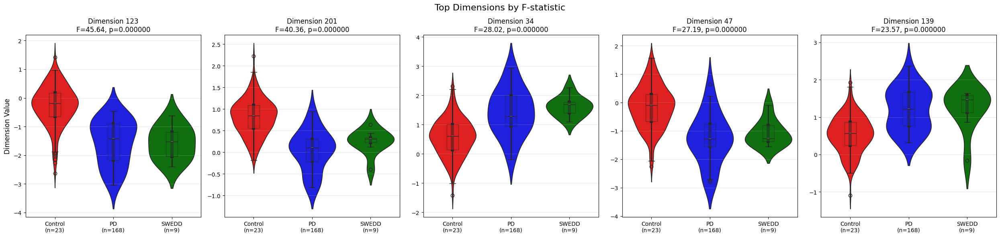

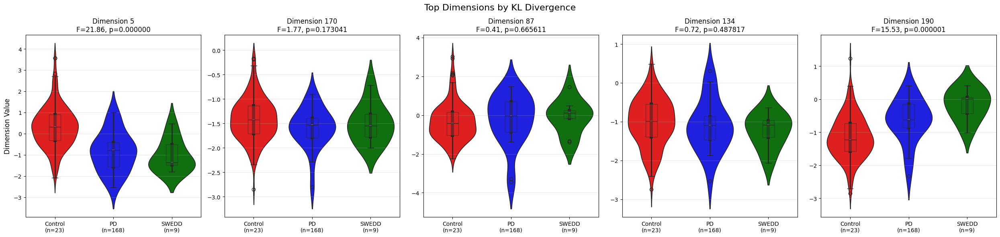

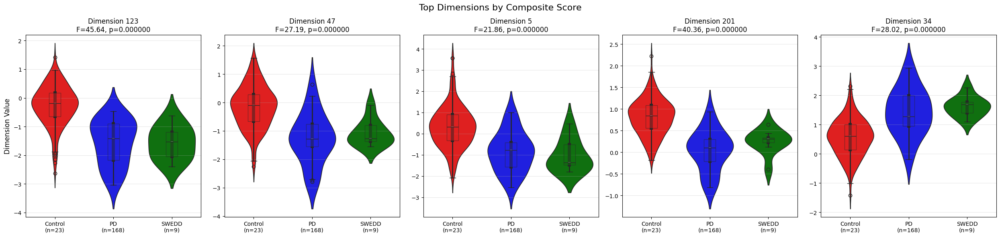

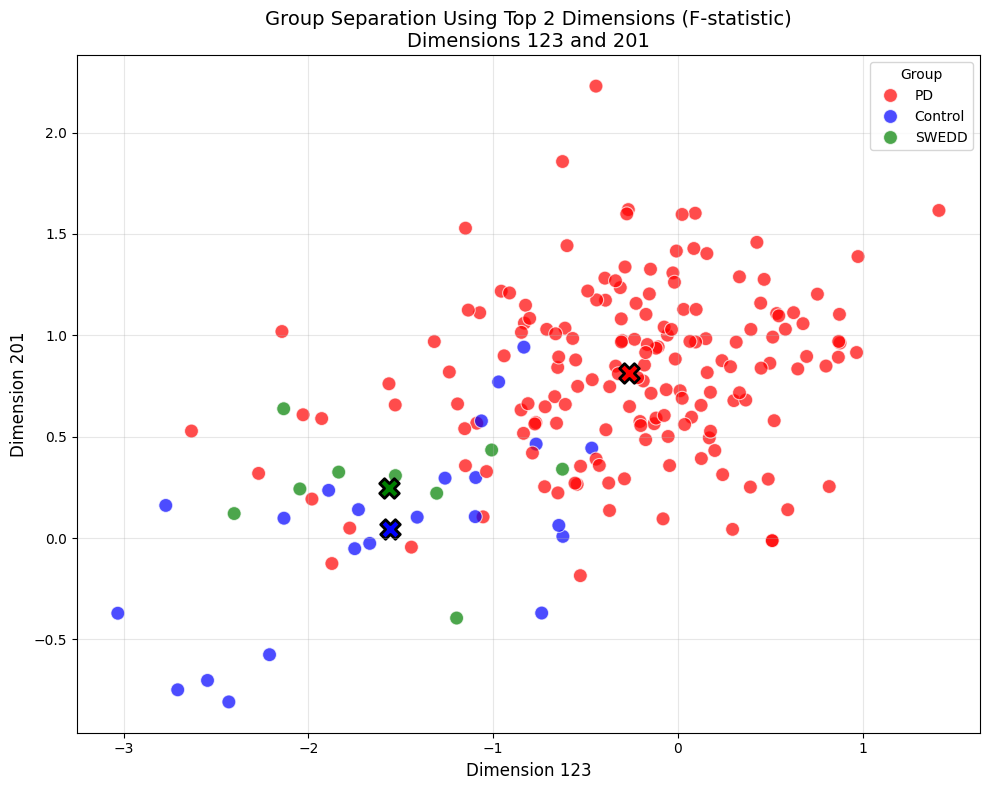


Dimensions 123 and 201 - Centroid distances between groups:
  Control vs PD: 1.5040
  Control vs SWEDD: 0.2027
  PD vs SWEDD: 1.4171

Dimensions 123 and 201 - Average within-group distances:
  Control: 0.7906
  PD: 0.6852
  SWEDD: 0.5445

Dimensions 123 and 201 - Separation quality:
  Average within-group distance: 0.6735
  Average between-group distance: 1.0413
  Separation ratio: 1.5461 (higher is better)


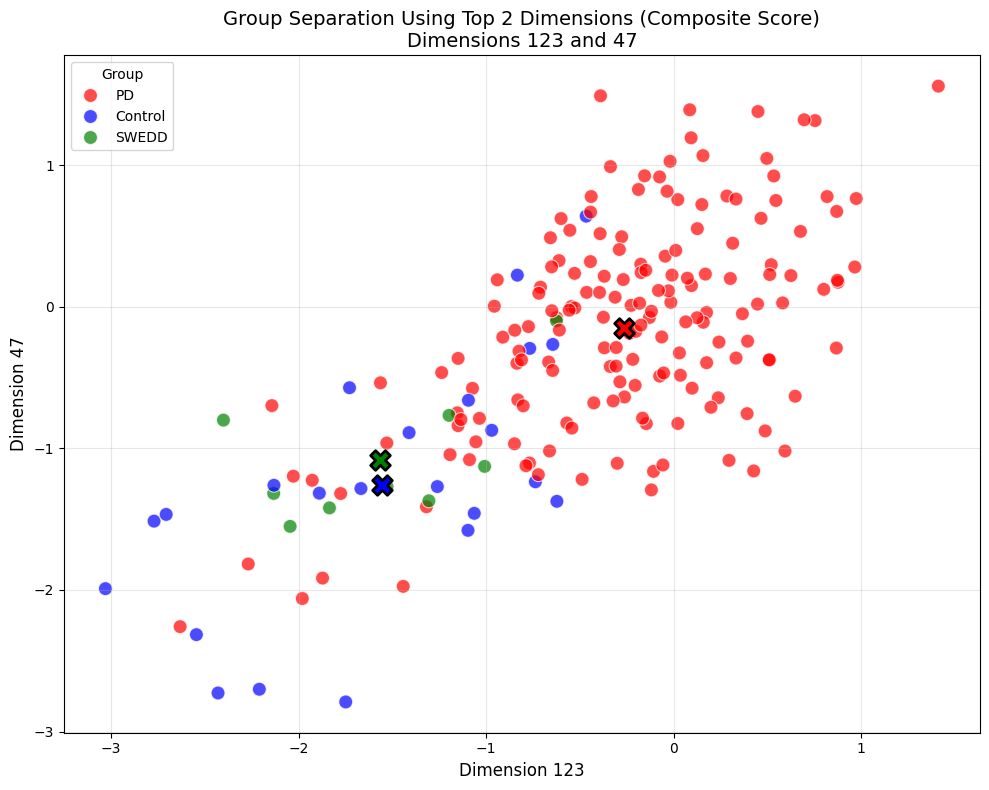


Dimensions 123 and 47 - Centroid distances between groups:
  Control vs PD: 1.7051
  Control vs SWEDD: 0.1794
  PD vs SWEDD: 1.5993

Dimensions 123 and 47 - Average within-group distances:
  Control: 1.0226
  PD: 0.8572
  SWEDD: 0.6210

Dimensions 123 and 47 - Separation quality:
  Average within-group distance: 0.8336
  Average between-group distance: 1.1613
  Separation ratio: 1.3931 (higher is better)

Visualizing what top dimensions represent in brain space...

Analyzing dimension 123 in brain space:


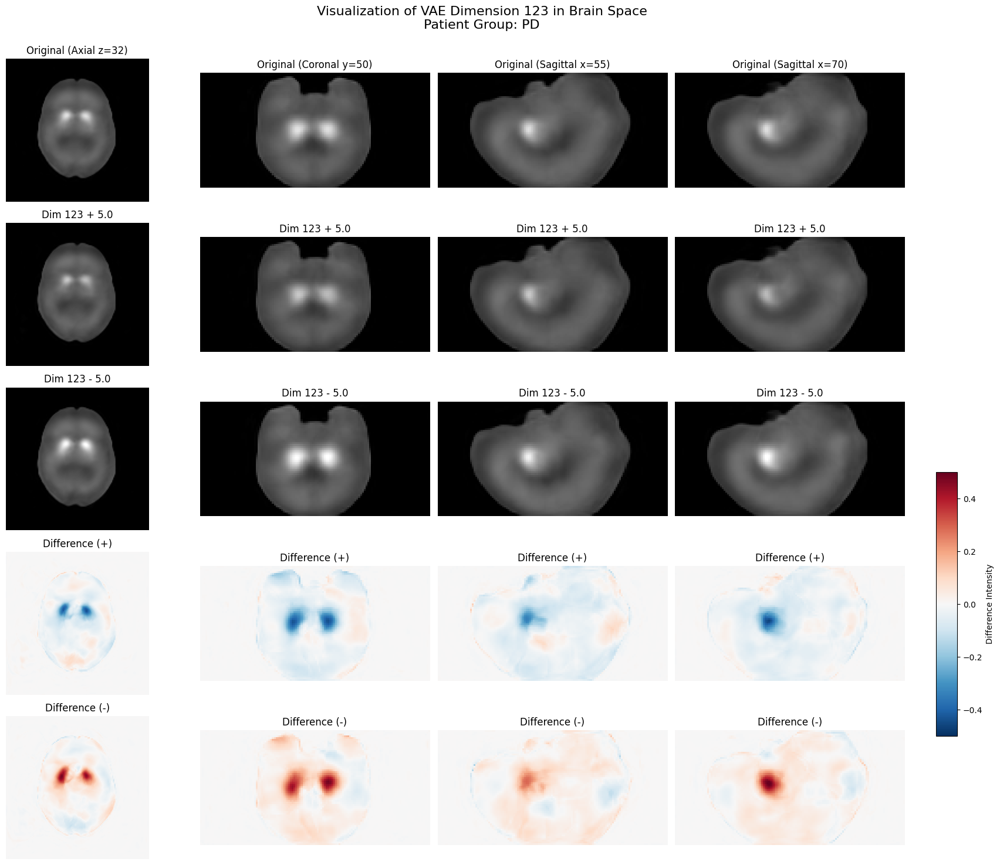


Analyzing dimension 47 in brain space:


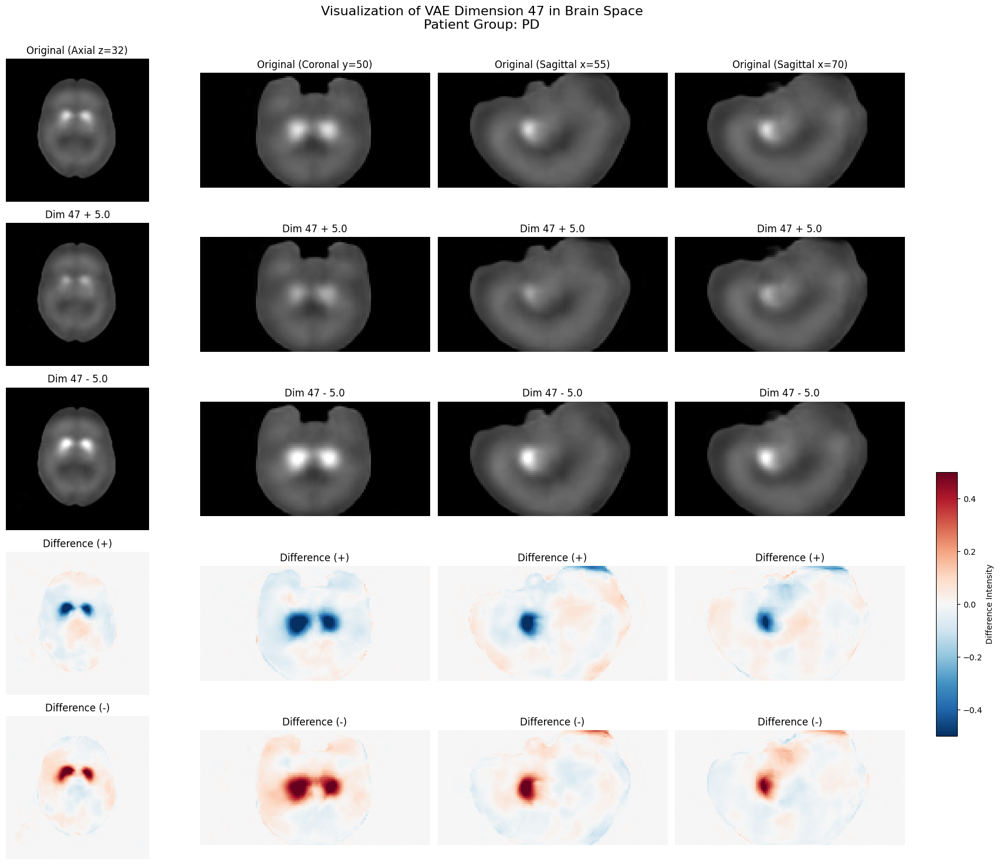


Analyzing dimension 5 in brain space:


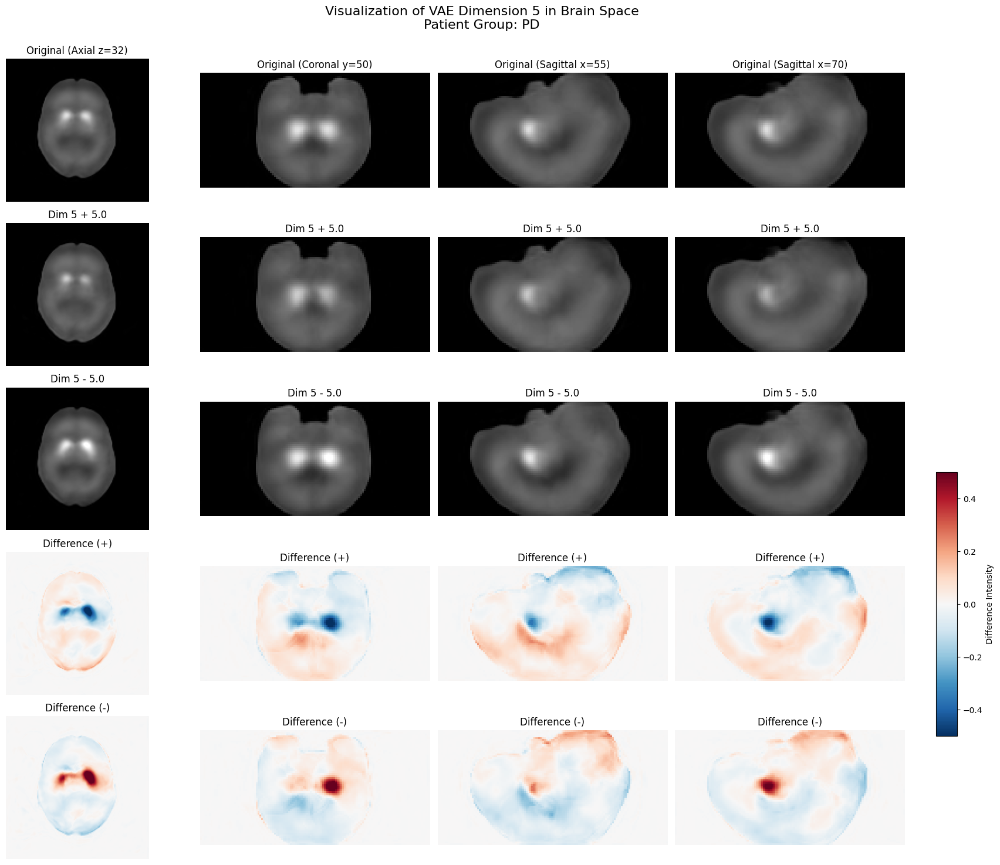

In [36]:
# Cell 25: VAE Latent Dimension Analysis for Patient Group Separation

import torch
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import mutual_info_score
from scipy.stats import f_oneway
import scipy.stats as stats
from tqdm import tqdm
import gc

def analyze_vae_dimensions_for_group_separation(model, dataloader, max_samples=200):
    """
    Analyze how individual VAE latent dimensions separate between patient groups (PD, Control, SWEDD).
    
    This analysis focuses on:
    1. Which dimensions have highest KL divergence (most "active" dimensions)
    2. Which dimensions best separate between patient groups
    3. Visualizing the distribution of top dimensions across groups
    """
    device = next(model.parameters()).device
    model.eval()
    
    # Storage for latent vectors and metadata
    latent_means = []
    latent_logvars = []
    kl_per_dim = []
    labels = []
    paths = []
    
    with torch.no_grad():
        for batch in tqdm(dataloader, desc="Extracting VAE latent vectors"):
            try:
                volumes = batch['volume'].to(device)
                batch_labels = batch['label']
                batch_paths = batch['path']
                
                # Extract latent vectors
                mu, log_var = model.encode(volumes)
                
                # Calculate KL divergence per dimension: 0.5 * (mu^2 + exp(log_var) - log_var - 1)
                kl_dims = 0.5 * (mu.pow(2) + log_var.exp() - log_var - 1)
                
                # Store results
                latent_means.append(mu.cpu().numpy())
                latent_logvars.append(log_var.cpu().numpy())
                kl_per_dim.append(kl_dims.cpu().numpy())
                labels.extend(batch_labels)
                paths.extend(batch_paths)
                
                # Memory cleanup
                del volumes, mu, log_var, kl_dims
                torch.cuda.empty_cache()
                
                if len(labels) >= max_samples:
                    break
                    
            except Exception as e:
                print(f"Error processing batch: {str(e)}")
                continue
    
    # Stack arrays
    latent_means = np.vstack(latent_means)
    latent_logvars = np.vstack(latent_logvars)
    kl_per_dim = np.vstack(kl_per_dim)
    
    # Limit to max_samples if needed
    if max_samples and len(labels) > max_samples:
        latent_means = latent_means[:max_samples]
        latent_logvars = latent_logvars[:max_samples]
        kl_per_dim = kl_per_dim[:max_samples]
        labels = labels[:max_samples]
        paths = paths[:max_samples]
    
    # Get unique patient groups
    unique_groups = sorted(list(set(labels)))
    
    # Print overview
    print(f"Analyzing {len(labels)} samples across {len(unique_groups)} patient groups: {unique_groups}")
    group_counts = {group: labels.count(group) for group in unique_groups}
    print("Samples per group:", group_counts)
    
    # Calculate overall KL divergence per dimension
    mean_kl_per_dim = np.mean(kl_per_dim, axis=0)
    
    # Calculate separation metrics for each dimension
    # We'll use ANOVA F-statistic to measure how well each dimension separates groups
    f_stats = np.zeros(latent_means.shape[1])
    p_values = np.ones(latent_means.shape[1])
    mi_scores = np.zeros(latent_means.shape[1])  # Mutual information scores
    
    # Create a numeric encoding of labels for mutual information
    label_map = {label: i for i, label in enumerate(unique_groups)}
    numeric_labels = np.array([label_map[label] for label in labels])
    
    # Calculate separation metrics for each dimension
    for dim in range(latent_means.shape[1]):
        # Get dimension values for each group
        groups_data = [latent_means[np.array(labels) == group, dim] for group in unique_groups]
        
        # Calculate ANOVA F-statistic and p-value
        if all(len(g) > 1 for g in groups_data):
            f_val, p_val = f_oneway(*groups_data)
            f_stats[dim] = f_val
            p_values[dim] = p_val
        
        # Calculate mutual information
        try:
            # Discretize dimension values for MI calculation
            dim_values = latent_means[:, dim]
            bins = min(20, len(dim_values) // 10)  # Use fewer bins for smaller datasets
            discretized = np.digitize(dim_values, np.linspace(min(dim_values), max(dim_values), bins))
            mi_scores[dim] = mutual_info_score(discretized, numeric_labels)
        except Exception as e:
            print(f"Error calculating MI for dimension {dim}: {e}")
            mi_scores[dim] = 0
    
    # Find top dimensions by different metrics
    # 1. Top active dimensions (highest KL)
    top_kl_dims = np.argsort(mean_kl_per_dim)[::-1][:20]
    
    # 2. Top separating dimensions (highest F-statistic with p < 0.05)
    significant_dims = np.where(p_values < 0.05)[0]
    top_f_dims = significant_dims[np.argsort(f_stats[significant_dims])[::-1][:20]] if len(significant_dims) > 0 else np.argsort(f_stats)[::-1][:20]
    
    # 3. Top dimensions by mutual information
    top_mi_dims = np.argsort(mi_scores)[::-1][:20]
    
    # Create a composite score that combines these metrics
    # Normalize each metric to [0, 1] range and then average
    if np.max(mean_kl_per_dim) > np.min(mean_kl_per_dim):
        norm_kl = (mean_kl_per_dim - np.min(mean_kl_per_dim)) / (np.max(mean_kl_per_dim) - np.min(mean_kl_per_dim) + 1e-10)
    else:
        norm_kl = np.zeros_like(mean_kl_per_dim)
        
    if np.max(f_stats) > np.min(f_stats):
        norm_f = (f_stats - np.min(f_stats)) / (np.max(f_stats) - np.min(f_stats) + 1e-10)
    else:
        norm_f = np.zeros_like(f_stats)
        
    if np.max(mi_scores) > np.min(mi_scores):
        norm_mi = (mi_scores - np.min(mi_scores)) / (np.max(mi_scores) - np.min(mi_scores) + 1e-10)
    else:
        norm_mi = np.zeros_like(mi_scores)
    
    # Weight the score components based on significance (F-stat p-value)
    significance_weight = np.where(p_values < 0.05, 1.0, 0.1)
    composite_scores = (norm_kl + norm_f * significance_weight + norm_mi) / 3
    
    # Top dimensions by composite score
    top_composite_dims = np.argsort(composite_scores)[::-1][:20]
    
    # Print top dimensions by each metric
    print("\nTop 10 dimensions by average KL divergence (most active):")
    for i, dim in enumerate(top_kl_dims[:10]):
        print(f"  Dimension {dim}: KL={mean_kl_per_dim[dim]:.4f}")
    
    print("\nTop 10 dimensions by F-statistic (best group separation):")
    for i, dim in enumerate(top_f_dims[:10]):
        print(f"  Dimension {dim}: F={f_stats[dim]:.2f}, p={p_values[dim]:.6f}")
    
    print("\nTop 10 dimensions by mutual information:")
    for i, dim in enumerate(top_mi_dims[:10]):
        print(f"  Dimension {dim}: MI={mi_scores[dim]:.4f}")
    
    print("\nTop 10 dimensions by composite score:")
    for i, dim in enumerate(top_composite_dims[:10]):
        print(f"  Dimension {dim}: Score={composite_scores[dim]:.4f}, KL={mean_kl_per_dim[dim]:.4f}, F={f_stats[dim]:.2f}, p={p_values[dim]:.6f}")
    
    # Visualize top dimensions by different metrics
    print("\nVisualizing top dimensions by group separation...")
    
    # Create a custom palette for consistent colors
    palette = {'PD': 'red', 'Control': 'blue', 'SWEDD': 'green'}
    
    # Visualize top dimensions by F-statistic
    top_dims_to_plot = top_f_dims[:5]
    visualize_dimensions_by_group(latent_means, labels, top_dims_to_plot, 
                                 group_counts, f_stats, p_values, palette,
                                 "Top Dimensions by F-statistic")
    
    # Visualize top dimensions by KL divergence
    visualize_dimensions_by_group(latent_means, labels, top_kl_dims[:5], 
                                 group_counts, f_stats, p_values, palette,
                                 "Top Dimensions by KL Divergence")
    
    # Visualize top dimensions by composite score
    visualize_dimensions_by_group(latent_means, labels, top_composite_dims[:5], 
                                 group_counts, f_stats, p_values, palette,
                                 "Top Dimensions by Composite Score")
    
    # Create a dimension score dataframe for further reference
    dimension_scores = pd.DataFrame({
        'dimension': np.arange(latent_means.shape[1]),
        'kl_divergence': mean_kl_per_dim,
        'f_statistic': f_stats,
        'p_value': p_values,
        'mutual_info': mi_scores,
        'composite_score': composite_scores,
        'significant': p_values < 0.05
    })
    
    # Sort by composite score
    dimension_scores = dimension_scores.sort_values('composite_score', ascending=False)
    
    # Create group separation visualization in 2D space using top 2 dimensions
    create_2d_separation_plot(latent_means, labels, top_f_dims[:2], palette,
                             "Group Separation Using Top 2 Dimensions (F-statistic)")
    
    # Create group separation visualization in 2D space using top 2 composite dimensions
    create_2d_separation_plot(latent_means, labels, top_composite_dims[:2], palette,
                             "Group Separation Using Top 2 Dimensions (Composite Score)")
    
    return {
        'latent_means': latent_means,
        'latent_logvars': latent_logvars,
        'kl_per_dim': kl_per_dim,
        'labels': labels,
        'paths': paths,
        'top_kl_dims': top_kl_dims,
        'top_f_dims': top_f_dims,
        'top_mi_dims': top_mi_dims,
        'top_composite_dims': top_composite_dims,
        'dimension_scores': dimension_scores,
        'f_stats': f_stats,
        'p_values': p_values,
        'mean_kl_per_dim': mean_kl_per_dim,
        'mi_scores': mi_scores
    }

def visualize_dimensions_by_group(latent_means, labels, dimensions, 
                                 group_counts, f_stats, p_values, 
                                 palette, title):
    """
    Visualize how specific dimensions distribute across patient groups.
    
    Parameters:
        latent_means: Numpy array of latent vectors (n_samples, n_dims)
        labels: List of group labels for each sample
        dimensions: List of dimensions to visualize
        group_counts: Dictionary with count of samples per group
        f_stats: F-statistics for each dimension
        p_values: p-values for each dimension
        palette: Color palette for groups
        title: Title for the plot
    """
    unique_groups = sorted(list(set(labels)))
    n_dims = len(dimensions)
    
    # Set up the figure
    fig, axes = plt.subplots(1, n_dims, figsize=(n_dims*5, 6))
    if n_dims == 1:
        axes = [axes]
        
    fig.suptitle(f"{title}", fontsize=16)
    
    # Create visualization for each dimension
    for i, dim in enumerate(dimensions):
        ax = axes[i]
        
        # Create a dataframe for this dimension
        dim_df = pd.DataFrame({
            'Value': latent_means[:, dim],
            'Group': labels
        })
        
        # Create violin plot with swarm plot overlay
        sns.violinplot(x='Group', y='Value', data=dim_df, palette=palette, ax=ax)
        
        # Add swarm plot if there aren't too many samples (to avoid clutter)
        if sum(group_counts.values()) < 100:
            sns.swarmplot(x='Group', y='Value', data=dim_df, color='black', alpha=0.5, ax=ax)
        
        # Add box plot for clearer visualization of the median and quartiles
        sns.boxplot(x='Group', y='Value', data=dim_df, width=0.2, palette=palette, 
                   boxprops={'alpha': 0.5}, ax=ax)
        
        # Add stats in the title
        ax.set_title(f"Dimension {dim}\nF={f_stats[dim]:.2f}, p={p_values[dim]:.6f}", fontsize=12)
        ax.set_xlabel('')
        
        if i == 0:
            ax.set_ylabel('Dimension Value', fontsize=12)
        else:
            ax.set_ylabel('')
            
        # Add group counts to x-axis labels
        x_labels = [f"{group}\n(n={group_counts[group]})" for group in unique_groups]
        ax.set_xticklabels(x_labels)
        
        # Add grid for better readability
        ax.grid(axis='y', alpha=0.3)
    
    plt.tight_layout()
    plt.subplots_adjust(top=0.85)
    plt.show()

def create_2d_separation_plot(latent_means, labels, top_2_dims, palette, title):
    """
    Create a 2D scatter plot showing how the top 2 dimensions separate patient groups.
    
    Parameters:
        latent_means: Numpy array of latent vectors
        labels: List of group labels
        top_2_dims: List of the top 2 dimensions to plot
        palette: Color palette for groups
        title: Title for the plot
    """
    if len(top_2_dims) < 2:
        print("Need at least 2 dimensions for 2D plot")
        return
    
    # Create figure
    plt.figure(figsize=(10, 8))
    
    # Extract the two dimensions
    dim1, dim2 = top_2_dims[0], top_2_dims[1]
    
    # Create dataframe for plotting
    plot_df = pd.DataFrame({
        'Dimension 1': latent_means[:, dim1],
        'Dimension 2': latent_means[:, dim2],
        'Group': labels
    })
    
    # Create scatter plot
    sns.scatterplot(x='Dimension 1', y='Dimension 2', hue='Group', 
                   data=plot_df, palette=palette, s=100, alpha=0.7)
    
    # Add group centroids
    for group in set(labels):
        group_data = plot_df[plot_df['Group'] == group]
        centroid_x = group_data['Dimension 1'].mean()
        centroid_y = group_data['Dimension 2'].mean()
        plt.scatter(centroid_x, centroid_y, s=200, color=palette[group], 
                   marker='X', edgecolor='black', linewidth=2, 
                   label=f"{group} centroid")
    
    # Add dimension indices to axis labels
    plt.xlabel(f"Dimension {dim1}", fontsize=12)
    plt.ylabel(f"Dimension {dim2}", fontsize=12)
    
    # Add title with dimension indices
    plt.title(f"{title}\nDimensions {dim1} and {dim2}", fontsize=14)
    
    # Add grid for better readability
    plt.grid(alpha=0.3)
    
    plt.tight_layout()
    plt.show()
    
    # Calculate and display group separation metrics for these dimensions
    calculate_2d_separation_metrics(latent_means[:, [dim1, dim2]], labels, 
                                   f"Dimensions {dim1} and {dim2}")

def calculate_2d_separation_metrics(points_2d, labels, title):
    """
    Calculate metrics that quantify how well the selected dimensions separate groups.
    
    Parameters:
        points_2d: Numpy array of 2D points
        labels: List of group labels
        title: Title for printed metrics
    """
    unique_groups = sorted(list(set(labels)))
    
    # Convert labels to numpy array
    labels = np.array(labels)
    
    # Calculate group centroids
    centroids = {}
    for group in unique_groups:
        group_points = points_2d[labels == group]
        centroids[group] = np.mean(group_points, axis=0)
    
    # Calculate distances between centroids
    print(f"\n{title} - Centroid distances between groups:")
    for i, group1 in enumerate(unique_groups):
        for group2 in unique_groups[i+1:]:
            dist = np.linalg.norm(centroids[group1] - centroids[group2])
            print(f"  {group1} vs {group2}: {dist:.4f}")
    
    # Calculate average distance of each sample to its own group centroid
    within_dists = {}
    for group in unique_groups:
        group_points = points_2d[labels == group]
        dists = np.linalg.norm(group_points - centroids[group], axis=1)
        within_dists[group] = np.mean(dists)
    
    print(f"\n{title} - Average within-group distances:")
    for group, dist in within_dists.items():
        print(f"  {group}: {dist:.4f}")
    
    # Calculate silhouette-like metric (ratio of between vs. within)
    between_dists = {}
    for i, group1 in enumerate(unique_groups):
        for group2 in unique_groups[i+1:]:
            between_dists[f"{group1}-{group2}"] = np.linalg.norm(centroids[group1] - centroids[group2])
    
    avg_within = np.mean(list(within_dists.values()))
    avg_between = np.mean(list(between_dists.values()))
    separation_ratio = avg_between / avg_within
    
    print(f"\n{title} - Separation quality:")
    print(f"  Average within-group distance: {avg_within:.4f}")
    print(f"  Average between-group distance: {avg_between:.4f}")
    print(f"  Separation ratio: {separation_ratio:.4f} (higher is better)")

# Load the trained VAE model from previous cells
print("Loading VAE model...")
vae_model, _ = load_trained_vae('checkpoints', 'vae_model_v2', latent_dim=256)

# Run the full analysis
print("\nAnalyzing VAE dimensions for patient group separation...")
results = analyze_vae_dimensions_for_group_separation(vae_model, val_loader, max_samples=200)

# Analyze what top dimensions represent in brain space by visualizing them
print("\nVisualizing what top dimensions represent in brain space...")
top_dims_to_visualize = results['top_composite_dims'][:3]

for dim in top_dims_to_visualize:
    print(f"\nAnalyzing dimension {dim} in brain space:")
    visualize_vae_latent_dimension(vae_model, val_loader, dimension_idx=dim, alpha=5.0)

Loading trained models...
Using device: cuda
Loading best VAE model from checkpoints/vae_model_v2_best.pth
Loaded training history with 249 epochs
Extracting reconstructions and latent representations...


Processing samples:   3%|▎         | 9/299 [00:00<00:24, 11.83it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Processing samples:  20%|█▉        | 59/299 [00:04<00:17, 13.83it/s]

Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Processing samples:  25%|██▍       | 74/299 [00:05<00:17, 13.02it/s]


Analyzing 150 samples across 3 groups: ['Control', 'PD', 'SWEDD']

1. Reconstruction Quality Comparison

Reconstruction Error by Group (MSE):
  Control:
    AE:  0.002977 ± 0.000624
    VAE: 0.004653 ± 0.001030
    Best: AE by 0.001676
  PD:
    AE:  0.002563 ± 0.001099
    VAE: 0.003926 ± 0.001363
    Best: AE by 0.001363
  SWEDD:
    AE:  0.001849 ± 0.000406
    VAE: 0.003117 ± 0.000439
    Best: AE by 0.001267


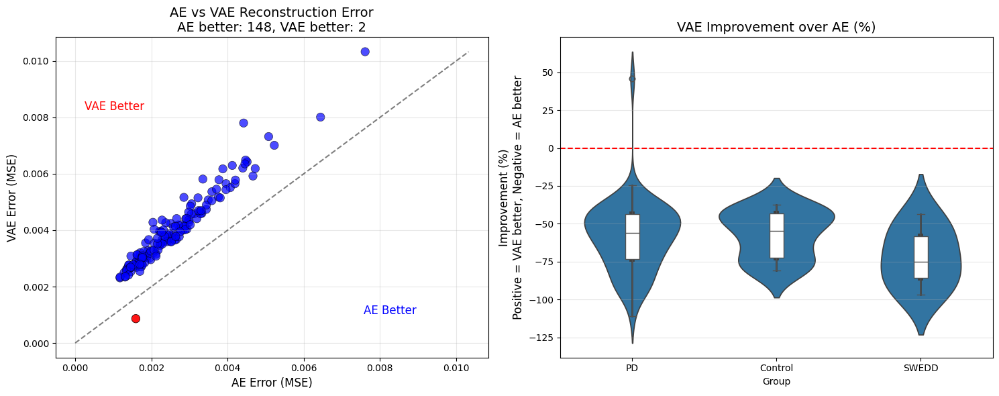

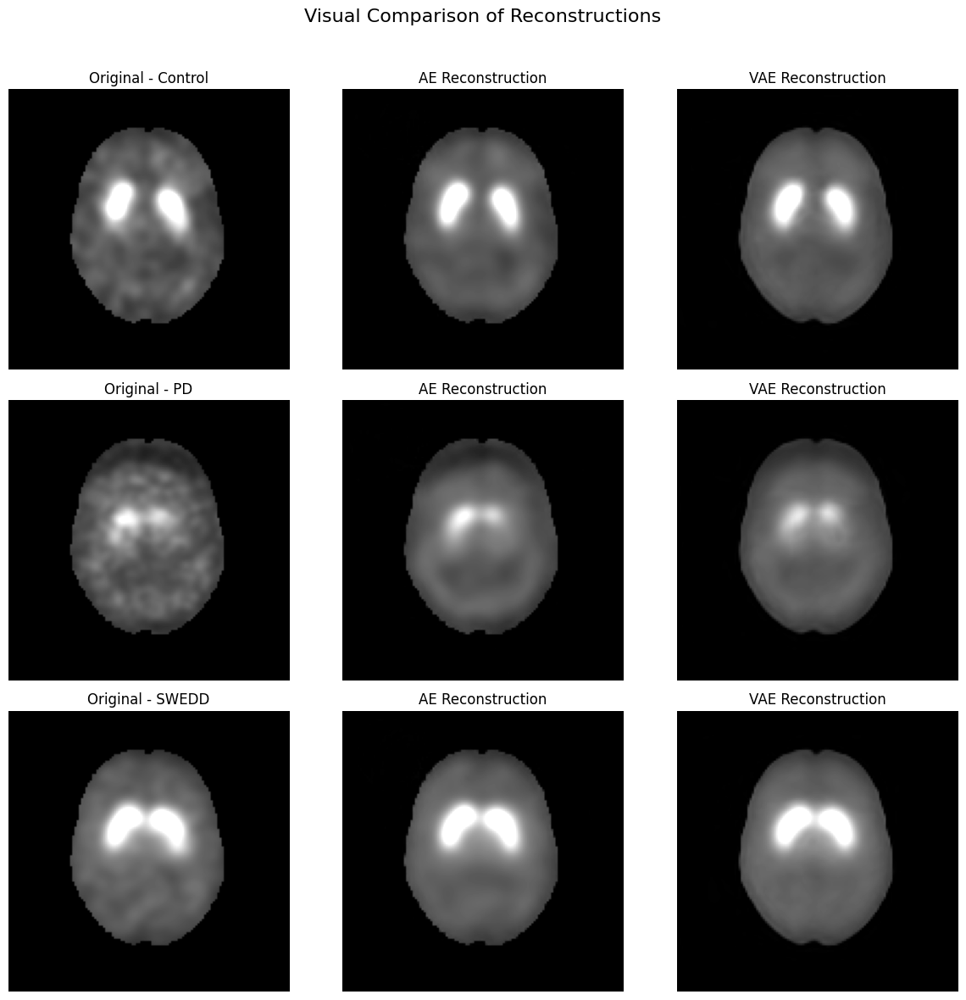

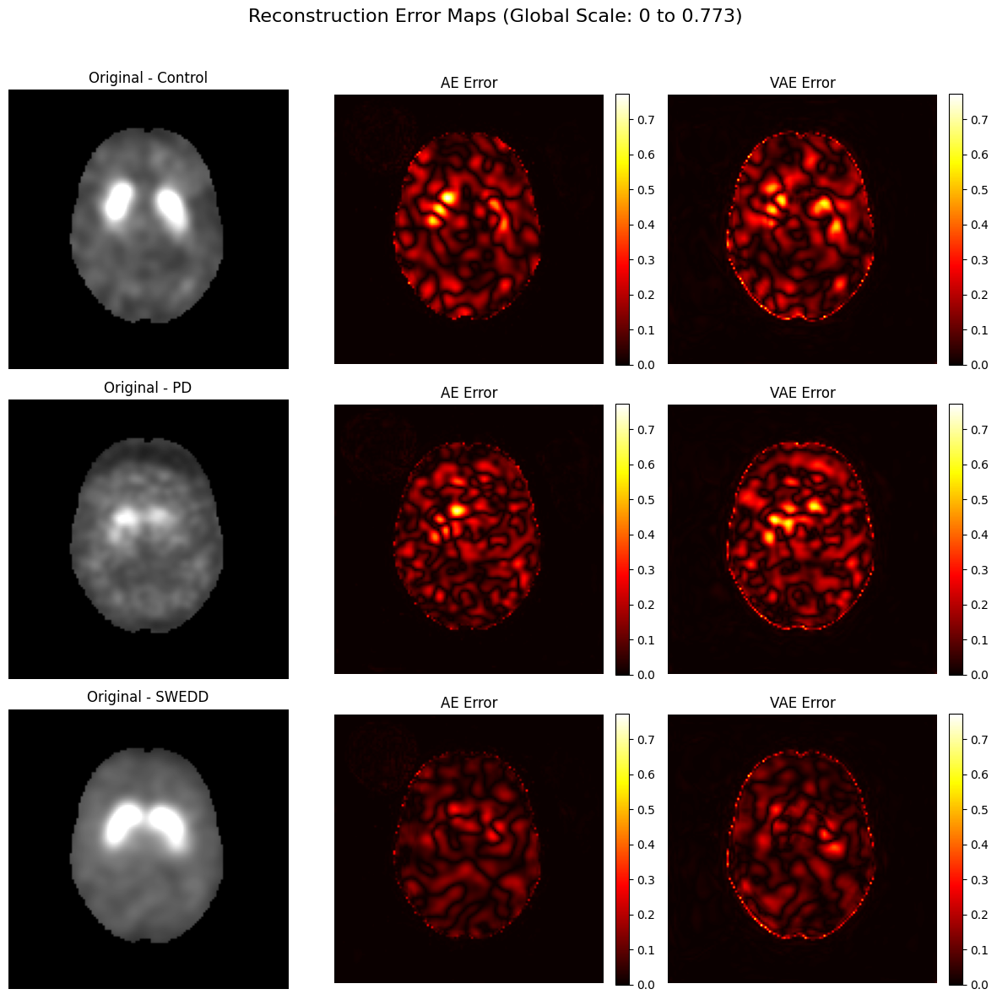


Error Magnitude Comparison by Group:
Global error scale: 0 to 0.773

Control Group:
  AE Mean Error: 0.0323, Max Error: 0.7726
  VAE Mean Error: 0.0364, Max Error: 0.6739
  Error Ratio (AE/VAE): 0.8876

PD Group:
  AE Mean Error: 0.0293, Max Error: 0.7176
  VAE Mean Error: 0.0364, Max Error: 0.6836
  Error Ratio (AE/VAE): 0.8046

SWEDD Group:
  AE Mean Error: 0.0201, Max Error: 0.3978
  VAE Mean Error: 0.0244, Max Error: 0.6717
  Error Ratio (AE/VAE): 0.8241

Finding top discriminative dimensions for AE...
  Found 111 significant dimensions (p < 0.05)

Top 5 discriminative dimensions:
  Dimension 82: F = 33.30, p = 0.000000
  Dimension 231: F = 27.02, p = 0.000000
  Dimension 170: F = 26.37, p = 0.000000
  Dimension 150: F = 24.16, p = 0.000000
  Dimension 154: F = 23.37, p = 0.000000

Finding top discriminative dimensions for VAE...
  Found 94 significant dimensions (p < 0.05)

Top 5 discriminative dimensions:
  Dimension 123: F = 32.19, p = 0.000000
  Dimension 201: F = 31.39, p = 0

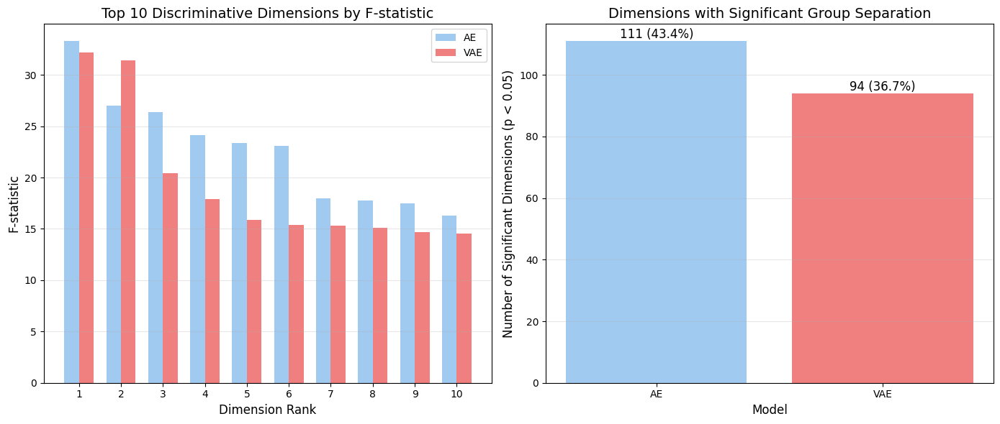

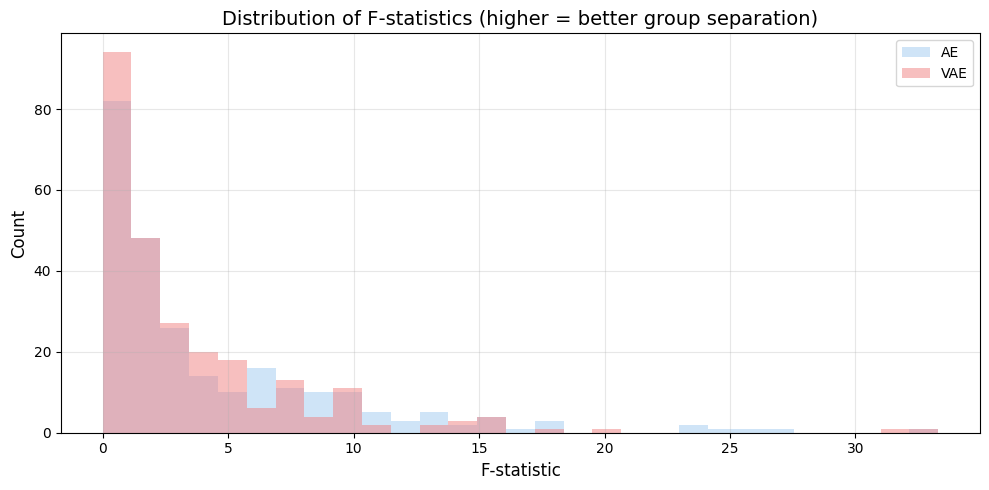


3. Top Dimensions Group Separation Visualization


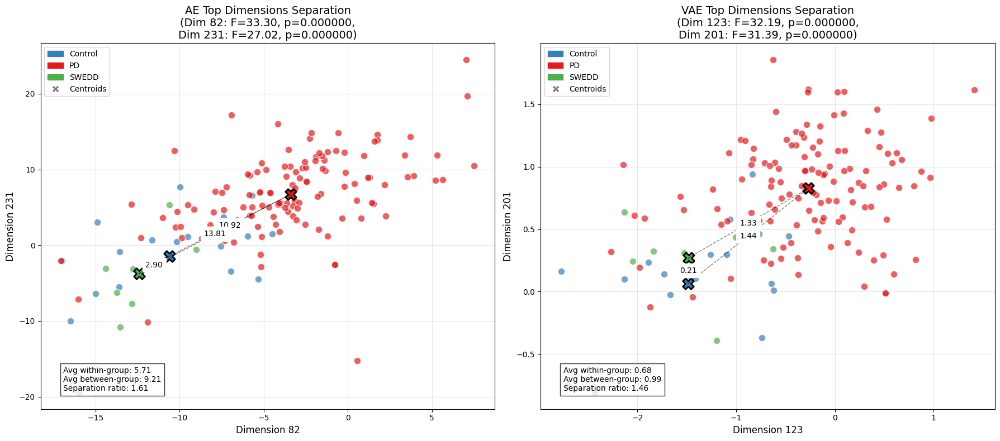

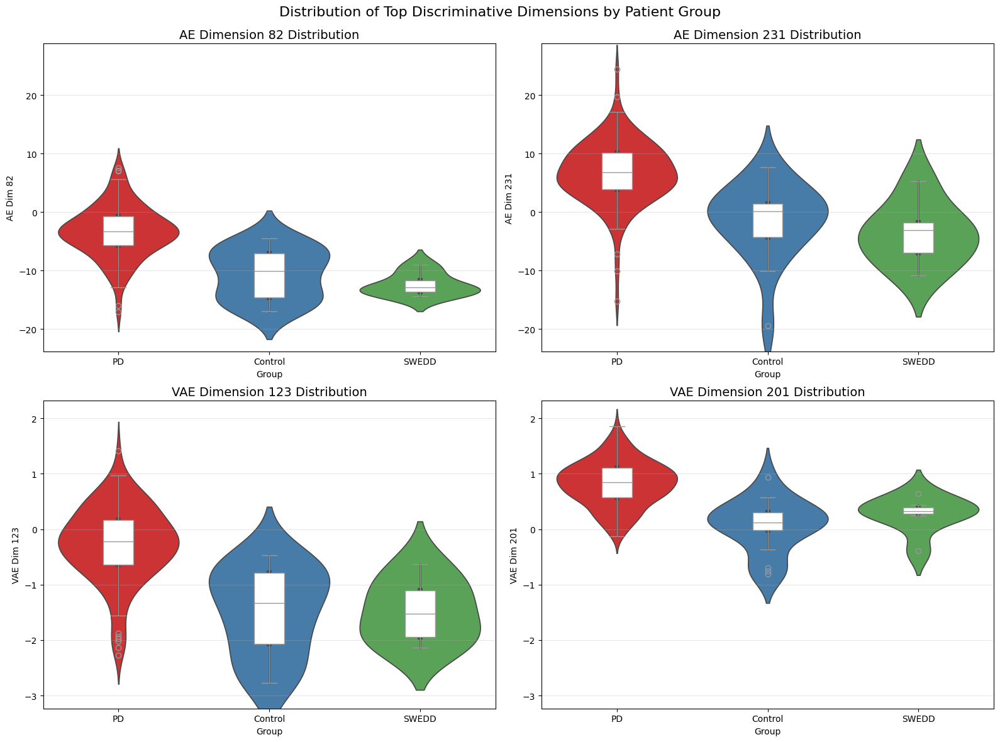

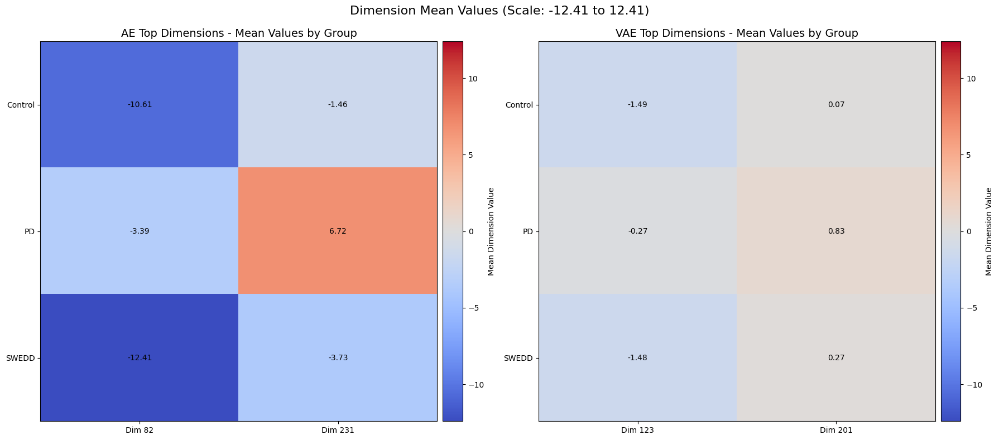

In [37]:
# Cell 26: AE vs VAE Performance Analysis with Consistent Scales

import torch
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import f_oneway
from tqdm import tqdm
import gc
import matplotlib.patches as mpatches
from matplotlib.lines import Line2D
from mpl_toolkits.axes_grid1 import make_axes_locatable

def compare_ae_vae_performance(ae_model, vae_model, dataloader, max_samples=150):
    """
    Comprehensive comparison of AE and VAE performance focusing on:
    1. Reconstruction quality
    2. Top discriminative dimensions and their group separation ability
    """
    device = next(ae_model.parameters()).device
    ae_model.eval()
    vae_model.eval()
    
    # Storage for data
    original_samples = []
    reconstructions_ae = []
    reconstructions_vae = []
    latent_ae = []
    latent_vae_mu = []
    labels = []
    paths = []
    
    print("Extracting reconstructions and latent representations...")
    
    with torch.no_grad():
        for batch in tqdm(dataloader, desc="Processing samples"):
            volumes = batch['volume'].to(device)
            batch_labels = batch['label']
            batch_paths = batch['path']
            
            # Get AE outputs
            ae_latent = ae_model.encode(volumes)
            ae_recon = ae_model.decode(ae_latent)
            
            # Get VAE outputs
            vae_mu, vae_logvar = vae_model.encode(volumes)
            vae_recon, _, _ = vae_model(volumes)
            
            # Store data
            original_samples.append(volumes.cpu().numpy())
            reconstructions_ae.append(ae_recon.cpu().numpy())
            reconstructions_vae.append(vae_recon.cpu().numpy())
            latent_ae.append(ae_latent.cpu().numpy())
            latent_vae_mu.append(vae_mu.cpu().numpy())
            labels.extend(batch_labels)
            paths.extend(batch_paths)
            
            # Memory cleanup
            del volumes, ae_latent, ae_recon, vae_mu, vae_logvar, vae_recon
            torch.cuda.empty_cache()
            
            if len(labels) >= max_samples:
                break
    
    # Concatenate data
    original_samples = np.vstack(original_samples)[:max_samples]
    reconstructions_ae = np.vstack(reconstructions_ae)[:max_samples]
    reconstructions_vae = np.vstack(reconstructions_vae)[:max_samples]
    latent_ae = np.vstack(latent_ae)[:max_samples]
    latent_vae_mu = np.vstack(latent_vae_mu)[:max_samples]
    labels = labels[:max_samples]
    paths = paths[:max_samples]
    
    # Get unique groups
    unique_groups = sorted(list(set(labels)))
    print(f"Analyzing {len(labels)} samples across {len(unique_groups)} groups: {unique_groups}")
    
    # Create a color palette for groups
    palette = {'PD': '#E41A1C', 'Control': '#377EB8', 'SWEDD': '#4DAF4A'}
    if len(unique_groups) > len(palette):
        # Generate colors for any additional groups
        additional_colors = plt.cm.tab10(np.linspace(0, 1, len(unique_groups)))
        palette = {group: additional_colors[i] for i, group in enumerate(unique_groups)}
    
    # 1. Reconstruction quality comparison
    compare_reconstruction_quality(original_samples, reconstructions_ae, reconstructions_vae, labels, unique_groups)
    
    # 2. Find top discriminative dimensions for each model
    ae_dim_results = find_discriminative_dimensions(latent_ae, labels, unique_groups, "AE")
    vae_dim_results = find_discriminative_dimensions(latent_vae_mu, labels, unique_groups, "VAE")
    
    # 3. Compare top dimensions
    compare_top_dimensions(ae_dim_results, vae_dim_results)
    
    # 4. Visualize top dimensions for group separation
    visualize_top_dimensions(latent_ae, latent_vae_mu, labels, unique_groups, 
                            ae_dim_results, vae_dim_results, palette)
    
    return {
        'original_samples': original_samples,
        'reconstructions_ae': reconstructions_ae,
        'reconstructions_vae': reconstructions_vae,
        'latent_ae': latent_ae,
        'latent_vae_mu': latent_vae_mu,
        'labels': labels,
        'paths': paths,
        'ae_dim_results': ae_dim_results,
        'vae_dim_results': vae_dim_results
    }

def compare_reconstruction_quality(originals, recon_ae, recon_vae, labels, unique_groups):
    """Visualize and compare reconstruction quality between AE and VAE."""
    print("\n1. Reconstruction Quality Comparison")
    
    # Calculate MSE for each sample
    mse_ae = np.mean(np.square(originals - recon_ae).reshape(originals.shape[0], -1), axis=1)
    mse_vae = np.mean(np.square(originals - recon_vae).reshape(originals.shape[0], -1), axis=1)
    
    # Per-group statistics
    mse_by_group = {}
    for group in unique_groups:
        group_mask = np.array(labels) == group
        group_mse_ae = mse_ae[group_mask]
        group_mse_vae = mse_vae[group_mask]
        
        mse_by_group[group] = {
            'AE': {
                'mean': np.mean(group_mse_ae),
                'std': np.std(group_mse_ae)
            },
            'VAE': {
                'mean': np.mean(group_mse_vae),
                'std': np.std(group_mse_vae)
            }
        }
    
    # Print statistics
    print("\nReconstruction Error by Group (MSE):")
    for group in unique_groups:
        ae_stats = mse_by_group[group]['AE']
        vae_stats = mse_by_group[group]['VAE']
        winner = "AE" if ae_stats['mean'] < vae_stats['mean'] else "VAE"
        
        print(f"  {group}:")
        print(f"    AE:  {ae_stats['mean']:.6f} ± {ae_stats['std']:.6f}")
        print(f"    VAE: {vae_stats['mean']:.6f} ± {vae_stats['std']:.6f}")
        print(f"    Best: {winner} by {abs(ae_stats['mean'] - vae_stats['mean']):.6f}")
    
    # Create comparison visualization
    plt.figure(figsize=(15, 6))
    
    # 1. Direct comparison scatter plot
    plt.subplot(1, 2, 1)
    plt.scatter(mse_ae, mse_vae, c=np.where(mse_ae < mse_vae, 'blue', 'red'), 
               alpha=0.7, s=80, edgecolor='k', linewidth=0.5)
    
    # Add diagonal line
    max_err = max(np.max(mse_ae), np.max(mse_vae))
    plt.plot([0, max_err], [0, max_err], 'k--', alpha=0.5)
    
    # Add annotations
    plt.text(max_err*0.1, max_err*0.8, "VAE Better", color='red', fontsize=12, ha='center')
    plt.text(max_err*0.8, max_err*0.1, "AE Better", color='blue', fontsize=12, ha='center')
    
    # Better = Lower reconstruction error
    ae_win_count = np.sum(mse_ae < mse_vae)
    vae_win_count = np.sum(mse_vae < mse_ae)
    plt.title(f"AE vs VAE Reconstruction Error\nAE better: {ae_win_count}, VAE better: {vae_win_count}", fontsize=14)
    plt.xlabel("AE Error (MSE)", fontsize=12)
    plt.ylabel("VAE Error (MSE)", fontsize=12)
    plt.grid(alpha=0.3)
    
    # 2. Group-wise VAE improvement percentage
    plt.subplot(1, 2, 2)
    
    # Calculate relative improvement (positive = VAE better, negative = AE better)
    improvement = ((mse_ae - mse_vae) / mse_ae) * 100
    
    # Create dataframe for plotting
    imp_df = pd.DataFrame({
        'Improvement (%)': improvement,
        'Group': labels
    })
    
    # Create violin plot with box plot overlay
    sns.violinplot(x='Group', y='Improvement (%)', data=imp_df)
    sns.boxplot(x='Group', y='Improvement (%)', data=imp_df, width=0.1, 
              boxprops={'facecolor': 'white'})
    
    # Add zero line
    plt.axhline(y=0, color='r', linestyle='--')
    
    # Customize plot
    plt.title("VAE Improvement over AE (%)", fontsize=14)
    plt.ylabel("Improvement (%)\nPositive = VAE better, Negative = AE better", fontsize=12)
    plt.grid(axis='y', alpha=0.3)
    
    plt.tight_layout()
    plt.show()
    
    # Visual comparison of actual reconstructions
    visualize_sample_reconstructions(originals, recon_ae, recon_vae, labels, unique_groups)

def visualize_sample_reconstructions(originals, recon_ae, recon_vae, labels, unique_groups):
    """
    Compare the visual quality of reconstructions for sample images from each group
    with consistent scales across all groups.
    """
    # Get one sample per group
    sample_indices = []
    for group in unique_groups:
        group_indices = [i for i, label in enumerate(labels) if label == group]
        if group_indices:
            # Pick middle sample to avoid potential outliers
            sample_indices.append(group_indices[len(group_indices)//2])
    
    if not sample_indices:
        return
    
    # Define anatomically relevant slices
    axial_slice = 32  # Axial view
    
    # Create figure for reconstructions
    fig = plt.figure(figsize=(12, 4 * len(sample_indices)))
    plt.suptitle("Visual Comparison of Reconstructions", fontsize=16)
    
    # Define consistent scale for brain images
    brain_vmin, brain_vmax = 0, 3
    
    for i, idx in enumerate(sample_indices):
        # Get original and reconstructions
        orig = originals[idx].squeeze()
        ae_recon = recon_ae[idx].squeeze()
        vae_recon = recon_vae[idx].squeeze()
        group = labels[idx]
        
        # Original
        plt.subplot(len(sample_indices), 3, i*3 + 1)
        plt.imshow(orig[axial_slice], cmap='gray', vmin=brain_vmin, vmax=brain_vmax)
        plt.title(f"Original - {group}", fontsize=12)
        plt.axis('off')
        
        # AE reconstruction
        plt.subplot(len(sample_indices), 3, i*3 + 2)
        plt.imshow(ae_recon[axial_slice], cmap='gray', vmin=brain_vmin, vmax=brain_vmax)
        plt.title("AE Reconstruction", fontsize=12)
        plt.axis('off')
        
        # VAE reconstruction
        plt.subplot(len(sample_indices), 3, i*3 + 3)
        plt.imshow(vae_recon[axial_slice], cmap='gray', vmin=brain_vmin, vmax=brain_vmax)
        plt.title("VAE Reconstruction", fontsize=12)
        plt.axis('off')
    
    plt.tight_layout()
    plt.subplots_adjust(top=0.9)
    plt.show()
    
    # IMPROVEMENT: Calculate the global maximum error across all groups and samples
    # to ensure consistent color scales
    all_ae_errors = []
    all_vae_errors = []
    
    for idx in sample_indices:
        orig = originals[idx].squeeze()
        ae_recon = recon_ae[idx].squeeze()
        vae_recon = recon_vae[idx].squeeze()
        
        # Calculate error maps
        ae_error = np.abs(orig - ae_recon)
        vae_error = np.abs(orig - vae_recon)
        
        all_ae_errors.append(ae_error[axial_slice])
        all_vae_errors.append(vae_error[axial_slice])
    
    # Determine global maximum error for consistent scale
    global_max_error = max(
        max(np.max(err) for err in all_ae_errors),
        max(np.max(err) for err in all_vae_errors)
    )
    
    # Create figure for error maps with consistent scale across all groups
    fig = plt.figure(figsize=(12, 4 * len(sample_indices)))
    plt.suptitle(f"Reconstruction Error Maps (Global Scale: 0 to {global_max_error:.3f})", fontsize=16)
    
    for i, idx in enumerate(sample_indices):
        # Get original and reconstructions
        orig = originals[idx].squeeze()
        ae_recon = recon_ae[idx].squeeze()
        vae_recon = recon_vae[idx].squeeze()
        group = labels[idx]
        
        # Calculate error maps
        ae_error = np.abs(orig - ae_recon)
        vae_error = np.abs(orig - vae_recon)
        
        # Original
        plt.subplot(len(sample_indices), 3, i*3 + 1)
        plt.imshow(orig[axial_slice], cmap='gray', vmin=brain_vmin, vmax=brain_vmax)
        plt.title(f"Original - {group}", fontsize=12)
        plt.axis('off')
        
        # AE error with global consistent scale
        plt.subplot(len(sample_indices), 3, i*3 + 2)
        im = plt.imshow(ae_error[axial_slice], cmap='hot', vmin=0, vmax=global_max_error)
        plt.colorbar(im, fraction=0.046, pad=0.04)
        plt.title("AE Error", fontsize=12)
        plt.axis('off')
        
        # VAE error with global consistent scale
        plt.subplot(len(sample_indices), 3, i*3 + 3)
        im = plt.imshow(vae_error[axial_slice], cmap='hot', vmin=0, vmax=global_max_error)
        plt.colorbar(im, fraction=0.046, pad=0.04)
        plt.title("VAE Error", fontsize=12)
        plt.axis('off')
    
    plt.tight_layout()
    plt.subplots_adjust(top=0.9)
    plt.show()
    
    # Add a quantitative comparison of error magnitudes by group
    print("\nError Magnitude Comparison by Group:")
    print(f"Global error scale: 0 to {global_max_error:.3f}")
    
    for i, idx in enumerate(sample_indices):
        group = labels[idx]
        orig = originals[idx].squeeze()
        ae_recon = recon_ae[idx].squeeze()
        vae_recon = recon_vae[idx].squeeze()
        
        # Calculate error statistics for this sample
        ae_error = np.abs(orig - ae_recon)
        vae_error = np.abs(orig - vae_recon)
        
        ae_mean = np.mean(ae_error[axial_slice])
        vae_mean = np.mean(vae_error[axial_slice])
        ae_max = np.max(ae_error[axial_slice])
        vae_max = np.max(vae_error[axial_slice])
        
        print(f"\n{group} Group:")
        print(f"  AE Mean Error: {ae_mean:.4f}, Max Error: {ae_max:.4f}")
        print(f"  VAE Mean Error: {vae_mean:.4f}, Max Error: {vae_max:.4f}")
        print(f"  Error Ratio (AE/VAE): {ae_mean/vae_mean:.4f}")

def find_discriminative_dimensions(latent_vectors, labels, unique_groups, model_name, top_n=10):
    """
    Find the most discriminative dimensions between patient groups.
    Uses F-statistic from one-way ANOVA to measure separation power.
    """
    print(f"\nFinding top discriminative dimensions for {model_name}...")
    
    # Convert labels to numpy array
    labels_array = np.array(labels)
    
    # Calculate F-statistic for each dimension
    f_values = []
    p_values = []
    
    for dim in range(latent_vectors.shape[1]):
        # Extract values for this dimension for each group
        groups_data = [latent_vectors[labels_array == group, dim] for group in unique_groups]
        
        try:
            # Run one-way ANOVA
            if all(len(g) > 1 for g in groups_data):
                f_stat, p_val = f_oneway(*groups_data)
                f_values.append(f_stat)
                p_values.append(p_val)
            else:
                f_values.append(0)
                p_values.append(1.0)
        except Exception as e:
            print(f"Error for dimension {dim}: {e}")
            f_values.append(0)
            p_values.append(1.0)
    
    # Convert to numpy arrays
    f_values = np.array(f_values)
    p_values = np.array(p_values)
    
    # Find top discriminative dimensions
    significant_dims = np.where(p_values < 0.05)[0]
    print(f"  Found {len(significant_dims)} significant dimensions (p < 0.05)")
    
    # Sort by F-statistic
    sorted_indices = np.argsort(f_values)[::-1]
    top_indices = sorted_indices[:top_n]
    
    # Get corresponding F and p values
    top_f_values = f_values[top_indices]
    top_p_values = p_values[top_indices]
    
    # Report top dimensions
    print("\nTop 5 discriminative dimensions:")
    for i in range(min(5, len(top_indices))):
        dim = top_indices[i]
        print(f"  Dimension {dim}: F = {top_f_values[i]:.2f}, p = {top_p_values[i]:.6f}")
    
    # Calculate group statistics for top dimensions
    group_stats = {}
    for dim in top_indices[:5]:  # Only store stats for top 5 dims to save memory
        dim_stats = {}
        for group in unique_groups:
            values = latent_vectors[labels_array == group, dim]
            dim_stats[group] = {
                'mean': np.mean(values),
                'std': np.std(values),
                'min': np.min(values),
                'max': np.max(values)
            }
        group_stats[dim] = dim_stats
    
    return {
        'top_indices': top_indices,
        'top_f_values': top_f_values,
        'top_p_values': top_p_values,
        'all_f_values': f_values,
        'all_p_values': p_values,
        'group_stats': group_stats
    }

def compare_top_dimensions(ae_results, vae_results):
    """Compare statistical separation power of top dimensions for AE and VAE."""
    print("\n2. Top Dimensions Comparison")
    
    # Create a figure
    plt.figure(figsize=(14, 6))
    
    # 1. Top F-statistics comparison (left subplot)
    plt.subplot(1, 2, 1)
    
    # Get top 10 F-statistics for each model
    ae_f = ae_results['top_f_values'][:10]
    vae_f = vae_results['top_f_values'][:10]
    
    # Create index positions
    x = np.arange(len(ae_f))
    width = 0.35
    
    # Create bar chart
    plt.bar(x - width/2, ae_f, width, label='AE', color='#A1CAF1')
    plt.bar(x + width/2, vae_f, width, label='VAE', color='#F08080')
    
    # Add labels and customize plot
    plt.xlabel('Dimension Rank', fontsize=12)
    plt.ylabel('F-statistic', fontsize=12)
    plt.title('Top 10 Discriminative Dimensions by F-statistic', fontsize=14)
    plt.xticks(x, [f'{i+1}' for i in range(len(x))])
    plt.legend()
    plt.grid(axis='y', alpha=0.3)
    
    # 2. Significant dimensions count (right subplot)
    plt.subplot(1, 2, 2)
    
    # Count significant dimensions (p < 0.05)
    ae_sig_count = np.sum(ae_results['all_p_values'] < 0.05)
    vae_sig_count = np.sum(vae_results['all_p_values'] < 0.05)
    
    # Calculate percentages
    ae_perc = ae_sig_count / len(ae_results['all_p_values']) * 100
    vae_perc = vae_sig_count / len(vae_results['all_p_values']) * 100
    
    # Create bar chart
    models = ['AE', 'VAE']
    counts = [ae_sig_count, vae_sig_count]
    percentages = [ae_perc, vae_perc]
    
    bars = plt.bar(models, counts, color=['#A1CAF1', '#F08080'])
    
    # Add count labels
    for i, (bar, count, percentage) in enumerate(zip(bars, counts, percentages)):
        plt.text(bar.get_x() + bar.get_width()/2, count + 1, 
               f"{count} ({percentage:.1f}%)", ha='center', fontsize=12)
    
    # Customize plot
    plt.xlabel('Model', fontsize=12)
    plt.ylabel('Number of Significant Dimensions (p < 0.05)', fontsize=12)
    plt.title('Dimensions with Significant Group Separation', fontsize=14)
    plt.grid(axis='y', alpha=0.3)
    
    plt.tight_layout()
    plt.show()
    
    # 3. Distribution of F-statistics (supplementary plot)
    plt.figure(figsize=(10, 5))
    
    # Get all F-values
    ae_all_f = ae_results['all_f_values']
    vae_all_f = vae_results['all_f_values']
    
    # Create histogram
    bins = np.linspace(0, max(max(ae_all_f), max(vae_all_f)), 30)
    plt.hist(ae_all_f, bins=bins, alpha=0.5, label='AE', color='#A1CAF1')
    plt.hist(vae_all_f, bins=bins, alpha=0.5, label='VAE', color='#F08080')
    
    # Customize plot
    plt.xlabel('F-statistic', fontsize=12)
    plt.ylabel('Count', fontsize=12)
    plt.title('Distribution of F-statistics (higher = better group separation)', fontsize=14)
    plt.legend()
    plt.grid(alpha=0.3)
    
    plt.tight_layout()
    plt.show()

def visualize_top_dimensions(latent_ae, latent_vae, labels, unique_groups, 
                            ae_results, vae_results, palette):
    """
    Visualize how top dimensions separate patient groups in AE and VAE.
    Shows 2D plots of the 2 most discriminative dimensions with group centroids.
    """
    print("\n3. Top Dimensions Group Separation Visualization")
    
    # Convert labels to numpy array
    labels_array = np.array(labels)
    
    # A. First, visualize AE top 2 dimensions
    ae_top_dims = ae_results['top_indices'][:2]
    ae_top_f = ae_results['top_f_values'][:2]
    ae_top_p = ae_results['top_p_values'][:2]
    
    # B. Then, visualize VAE top 2 dimensions
    vae_top_dims = vae_results['top_indices'][:2]
    vae_top_f = vae_results['top_f_values'][:2]
    vae_top_p = vae_results['top_p_values'][:2]
    
    # Create a figure with AE and VAE side by side
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 8))
    
    # 1. AE Top 2 Dimensions Scatter Plot
    visualize_2d_separation(latent_ae, labels_array, unique_groups, ae_top_dims, 
                           ae_top_f, ae_top_p, palette, ax1, "AE")
    
    # 2. VAE Top 2 Dimensions Scatter Plot  
    visualize_2d_separation(latent_vae, labels_array, unique_groups, vae_top_dims, 
                           vae_top_f, vae_top_p, palette, ax2, "VAE")
    
    plt.tight_layout()
    plt.show()
    
    # Additional visualization: Show distribution of each dimension by group
    visualize_top_dim_distributions(latent_ae, latent_vae, labels_array, unique_groups,
                                   ae_top_dims, vae_top_dims, palette)

def visualize_2d_separation(latent_vectors, labels, unique_groups, top_dims, 
                           f_values, p_values, palette, ax, model_name):
    """
    Create a 2D scatter plot showing how the top 2 dimensions separate groups.
    Also shows centroids and calculates separation metrics.
    """
    # Extract the top 2 dimensions
    dim1, dim2 = top_dims
    
    # Create a dataframe for the plot
    plot_df = pd.DataFrame({
        'x': latent_vectors[:, dim1],
        'y': latent_vectors[:, dim2],
        'group': labels
    })
    
    # Calculate centroids for each group
    centroids = {}
    for group in unique_groups:
        group_data = plot_df[plot_df['group'] == group]
        centroids[group] = {
            'x': group_data['x'].mean(),
            'y': group_data['y'].mean()
        }
    
    # Plot each group's points
    for group in unique_groups:
        group_data = plot_df[plot_df['group'] == group]
        ax.scatter(group_data['x'], group_data['y'], label=group, 
                  color=palette[group], s=80, alpha=0.7, edgecolor='w')
    
    # Plot centroids
    for group, coords in centroids.items():
        ax.scatter(coords['x'], coords['y'], s=200, color=palette[group], 
                 marker='X', edgecolor='black', linewidth=2)
    
    # Calculate and plot the connecting lines between centroids
    for i, group1 in enumerate(unique_groups):
        for group2 in unique_groups[i+1:]:
            ax.plot([centroids[group1]['x'], centroids[group2]['x']], 
                   [centroids[group1]['y'], centroids[group2]['y']], 
                   'k--', alpha=0.5, linewidth=1)
            
            # Calculate and show distance
            dist = np.sqrt((centroids[group1]['x'] - centroids[group2]['x'])**2 + 
                          (centroids[group1]['y'] - centroids[group2]['y'])**2)
            
            # Position the distance label at the midpoint of the line
            mid_x = (centroids[group1]['x'] + centroids[group2]['x']) / 2
            mid_y = (centroids[group1]['y'] + centroids[group2]['y']) / 2
            
            ax.text(mid_x, mid_y, f"{dist:.2f}", 
                  backgroundcolor='white', ha='center', va='center', fontsize=10)
    
    # Customize plot
    ax.set_title(f"{model_name} Top Dimensions Separation\n(Dim {dim1}: F={f_values[0]:.2f}, p={p_values[0]:.6f},\nDim {dim2}: F={f_values[1]:.2f}, p={p_values[1]:.6f})", 
               fontsize=14)
    ax.set_xlabel(f"Dimension {dim1}", fontsize=12)
    ax.set_ylabel(f"Dimension {dim2}", fontsize=12)
    ax.grid(alpha=0.3)
    
    # Create custom legend with both groups and centroids
    legend_elements = []
    
    # Group markers
    for group in unique_groups:
        legend_elements.append(
            mpatches.Patch(color=palette[group], label=group))
    
    # Centroid marker
    legend_elements.append(
        Line2D([0], [0], marker='X', color='w', markerfacecolor='gray',
              markersize=10, label='Centroids'))
    
    ax.legend(handles=legend_elements, loc='best')
    
    # Calculate separation quality metrics
    within_group_distances = []
    for group in unique_groups:
        group_mask = labels == group
        points = np.column_stack((latent_vectors[group_mask, dim1], 
                                 latent_vectors[group_mask, dim2]))
        centroid = np.array([centroids[group]['x'], centroids[group]['y']])
        
        # Calculate distances from each point to its centroid
        distances = np.sqrt(np.sum((points - centroid)**2, axis=1))
        within_group_distances.extend(distances)
    
    # Calculate between-group distances (centroid to centroid)
    between_group_distances = []
    for i, group1 in enumerate(unique_groups):
        for group2 in unique_groups[i+1:]:
            dist = np.sqrt((centroids[group1]['x'] - centroids[group2]['x'])**2 + 
                          (centroids[group1]['y'] - centroids[group2]['y'])**2)
            between_group_distances.append(dist)
    
    # Calculate average distances
    avg_within = np.mean(within_group_distances)
    avg_between = np.mean(between_group_distances)
    separation_ratio = avg_between / avg_within if avg_within > 0 else 0
    
    # Display metrics on the plot
    ax.text(0.05, 0.05, 
           f"Avg within-group: {avg_within:.2f}\nAvg between-group: {avg_between:.2f}\nSeparation ratio: {separation_ratio:.2f}", 
           transform=ax.transAxes, 
           bbox=dict(facecolor='white', alpha=0.8))
    
    return {
        'centroids': centroids,
        'avg_within': avg_within,
        'avg_between': avg_between,
        'separation_ratio': separation_ratio
    }

def visualize_top_dim_distributions(latent_ae, latent_vae, labels, unique_groups, 
                                   ae_top_dims, vae_top_dims, palette):
    """
    Visualize the distribution of values for top dimensions across patient groups.
    Shows violin plots for each group in each dimension.
    """
    # Convert to pandas format for easier plotting
    ae_dim1, ae_dim2 = ae_top_dims
    vae_dim1, vae_dim2 = vae_top_dims
    
    # Create dataframes for top dimensions
    ae_df = pd.DataFrame({
        f'AE Dim {ae_dim1}': latent_ae[:, ae_dim1],
        f'AE Dim {ae_dim2}': latent_ae[:, ae_dim2],
        'Group': labels
    })
    
    vae_df = pd.DataFrame({
        f'VAE Dim {vae_dim1}': latent_vae[:, vae_dim1],
        f'VAE Dim {vae_dim2}': latent_vae[:, vae_dim2],
        'Group': labels
    })
    
    # Create figure for top dimension distributions
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    
    # Determine global min/max values for consistent y-axis scales
    # For AE dimensions
    ae_dim1_min = ae_df[f'AE Dim {ae_dim1}'].min()
    ae_dim1_max = ae_df[f'AE Dim {ae_dim1}'].max()
    ae_dim2_min = ae_df[f'AE Dim {ae_dim2}'].min()
    ae_dim2_max = ae_df[f'AE Dim {ae_dim2}'].max()
    
    ae_ymin = min(ae_dim1_min, ae_dim2_min)
    ae_ymax = max(ae_dim1_max, ae_dim2_max)
    
    # Add some padding
    ae_range = ae_ymax - ae_ymin
    ae_ymin -= ae_range * 0.1
    ae_ymax += ae_range * 0.1
    
    # For VAE dimensions
    vae_dim1_min = vae_df[f'VAE Dim {vae_dim1}'].min()
    vae_dim1_max = vae_df[f'VAE Dim {vae_dim1}'].max()
    vae_dim2_min = vae_df[f'VAE Dim {vae_dim2}'].min()
    vae_dim2_max = vae_df[f'VAE Dim {vae_dim2}'].max()
    
    vae_ymin = min(vae_dim1_min, vae_dim2_min)
    vae_ymax = max(vae_dim1_max, vae_dim2_max)
    
    # Add some padding
    vae_range = vae_ymax - vae_ymin
    vae_ymin -= vae_range * 0.1
    vae_ymax += vae_range * 0.1
    
    # 1. AE Dimension 1
    ax = axes[0, 0]
    sns.violinplot(x='Group', y=f'AE Dim {ae_dim1}', data=ae_df, palette=palette, ax=ax)
    sns.boxplot(x='Group', y=f'AE Dim {ae_dim1}', data=ae_df, width=0.2, color='white', ax=ax)
    ax.set_title(f"AE Dimension {ae_dim1} Distribution", fontsize=14)
    ax.set_ylim(ae_ymin, ae_ymax)  # Use consistent y-axis scale for AE dimensions
    ax.grid(axis='y', alpha=0.3)
    
    # 2. AE Dimension 2
    ax = axes[0, 1]
    sns.violinplot(x='Group', y=f'AE Dim {ae_dim2}', data=ae_df, palette=palette, ax=ax)
    sns.boxplot(x='Group', y=f'AE Dim {ae_dim2}', data=ae_df, width=0.2, color='white', ax=ax)
    ax.set_title(f"AE Dimension {ae_dim2} Distribution", fontsize=14)
    ax.set_ylim(ae_ymin, ae_ymax)  # Use consistent y-axis scale for AE dimensions
    ax.grid(axis='y', alpha=0.3)
    
    # 3. VAE Dimension 1
    ax = axes[1, 0]
    sns.violinplot(x='Group', y=f'VAE Dim {vae_dim1}', data=vae_df, palette=palette, ax=ax)
    sns.boxplot(x='Group', y=f'VAE Dim {vae_dim1}', data=vae_df, width=0.2, color='white', ax=ax)
    ax.set_title(f"VAE Dimension {vae_dim1} Distribution", fontsize=14)
    ax.set_ylim(vae_ymin, vae_ymax)  # Use consistent y-axis scale for VAE dimensions
    ax.grid(axis='y', alpha=0.3)
    
    # 4. VAE Dimension 2
    ax = axes[1, 1]
    sns.violinplot(x='Group', y=f'VAE Dim {vae_dim2}', data=vae_df, palette=palette, ax=ax)
    sns.boxplot(x='Group', y=f'VAE Dim {vae_dim2}', data=vae_df, width=0.2, color='white', ax=ax)
    ax.set_title(f"VAE Dimension {vae_dim2} Distribution", fontsize=14)
    ax.set_ylim(vae_ymin, vae_ymax)  # Use consistent y-axis scale for VAE dimensions
    ax.grid(axis='y', alpha=0.3)
    
    plt.tight_layout()
    plt.suptitle("Distribution of Top Discriminative Dimensions by Patient Group", fontsize=16)
    plt.subplots_adjust(top=0.93)
    plt.show()
    
    # Create additional plot showing top 3-5 dimensions as heatmap of means
    visualize_dimension_group_means(latent_ae, latent_vae, labels, unique_groups, 
                                   ae_top_dims[:5], vae_top_dims[:5], palette)

def visualize_dimension_group_means(latent_ae, latent_vae, labels, unique_groups, 
                                   ae_top_dims, vae_top_dims, palette):
    """
    Create a heatmap visualization showing how the top dimensions 
    differ in mean values across patient groups for both models.
    """
    # Calculate group means for top AE dimensions
    ae_means = np.zeros((len(unique_groups), len(ae_top_dims)))
    for i, group in enumerate(unique_groups):
        group_mask = labels == group
        for j, dim in enumerate(ae_top_dims):
            ae_means[i, j] = np.mean(latent_ae[group_mask, dim])
    
    # Calculate group means for top VAE dimensions
    vae_means = np.zeros((len(unique_groups), len(vae_top_dims)))
    for i, group in enumerate(unique_groups):
        group_mask = labels == group
        for j, dim in enumerate(vae_top_dims):
            vae_means[i, j] = np.mean(latent_vae[group_mask, dim])
    
    # Determine the global min/max for both heatmaps to use a consistent colormap scale
    global_min = min(np.min(ae_means), np.min(vae_means))
    global_max = max(np.max(ae_means), np.max(vae_means))
    
    # Make the colormap symmetric around zero if values cross zero
    if global_min < 0 and global_max > 0:
        abs_max = max(abs(global_min), abs(global_max))
        global_min = -abs_max
        global_max = abs_max
    
    # Create a figure for the heatmaps
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 8))
    
    # 1. AE heatmap with consistent scale
    im1 = ax1.imshow(ae_means, cmap='coolwarm', aspect='auto', vmin=global_min, vmax=global_max)
    
    # Add axis labels
    ax1.set_yticks(np.arange(len(unique_groups)))
    ax1.set_yticklabels(unique_groups)
    ax1.set_xticks(np.arange(len(ae_top_dims)))
    ax1.set_xticklabels([f'Dim {dim}' for dim in ae_top_dims])
    
    # Add colorbar
    divider = make_axes_locatable(ax1)
    cax1 = divider.append_axes("right", size="5%", pad=0.1)
    cbar1 = plt.colorbar(im1, cax=cax1)
    cbar1.set_label('Mean Dimension Value')
    
    # Add title
    ax1.set_title("AE Top Dimensions - Mean Values by Group", fontsize=14)
    
    # Add value annotations
    for i in range(len(unique_groups)):
        for j in range(len(ae_top_dims)):
            text_color = "white" if abs(ae_means[i, j]) > (global_max - global_min) * 0.7 else "black"
            ax1.text(j, i, f"{ae_means[i, j]:.2f}", 
                    ha="center", va="center", color=text_color)
    
    # 2. VAE heatmap with same consistent scale
    im2 = ax2.imshow(vae_means, cmap='coolwarm', aspect='auto', vmin=global_min, vmax=global_max)
    
    # Add axis labels
    ax2.set_yticks(np.arange(len(unique_groups)))
    ax2.set_yticklabels(unique_groups)
    ax2.set_xticks(np.arange(len(vae_top_dims)))
    ax2.set_xticklabels([f'Dim {dim}' for dim in vae_top_dims])
    
    # Add colorbar
    divider = make_axes_locatable(ax2)
    cax2 = divider.append_axes("right", size="5%", pad=0.1)
    cbar2 = plt.colorbar(im2, cax=cax2)
    cbar2.set_label('Mean Dimension Value')
    
    # Add title
    ax2.set_title("VAE Top Dimensions - Mean Values by Group", fontsize=14)
    
    # Add value annotations
    for i in range(len(unique_groups)):
        for j in range(len(vae_top_dims)):
            text_color = "white" if abs(vae_means[i, j]) > (global_max - global_min) * 0.7 else "black"
            ax2.text(j, i, f"{vae_means[i, j]:.2f}", 
                    ha="center", va="center", color=text_color)
    
    plt.suptitle(f"Dimension Mean Values (Scale: {global_min:.2f} to {global_max:.2f})", fontsize=16)
    plt.tight_layout()
    plt.subplots_adjust(top=0.90)
    plt.show()

# Load the trained models
print("Loading trained models...")
ae_model, _ = load_trained_model('checkpoints', 'autoencoder_v1', latent_dim=256)
vae_model, _ = load_trained_vae('checkpoints', 'vae_model_v2', latent_dim=256)

# Run the comparison analysis with focus on discriminative dimensions
results = compare_ae_vae_performance(ae_model, vae_model, val_loader, max_samples=150)

## Identifiability of the same Patient, is it possible?

Identifying patients with multiple exams...


Processing files:   5%|▍         | 14/299 [00:00<00:13, 20.97it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Processing files:  21%|██        | 62/299 [00:03<00:15, 15.66it/s]

Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Processing files:  49%|████▉     | 147/299 [00:09<00:10, 15.16it/s]

Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Processing files: 100%|██████████| 299/299 [00:21<00:00, 13.64it/s]


Found 525 unique patients.
Patients with 2+ exams: 67


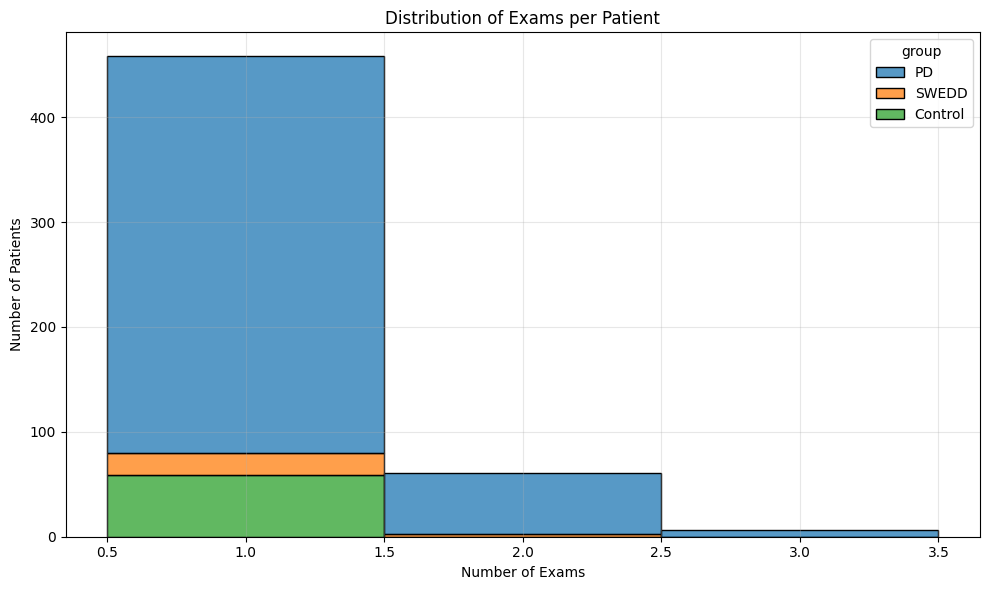


Top patients with most exams by group:

PD group:
patient_id  num_exams  time_span_days
      3961          3            1556
      3380          3            1750
    100898          3             740
      3120          3             765
      3760          3            1505

SWEDD group:
patient_id  num_exams  time_span_days
      3456          2             504
      3408          2            1100
      3304          2            1057


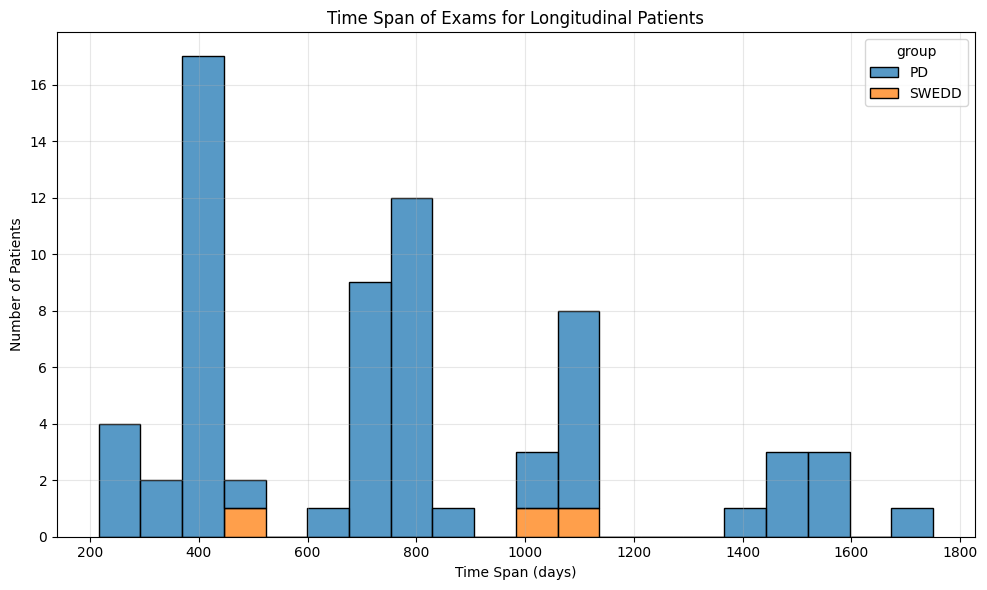


Allocating 3 slots per group with 1 remaining slots
Selected 3 patients from PD group
Selected 3 patients from SWEDD group
Added 3 patients from Control group with fewer than 2 exams
Selected 3 patients from Control group
Added 1 additional patients with the most exams

Selected patients for analysis:
  patient_id    group  num_exams  time_span_days
0       3380       PD          3            1750
1       3961       PD          3            1556
2     100898       PD          3             740
3       3120       PD          3             765
4       3304    SWEDD          2            1057
5       3408    SWEDD          2            1100
6       3456    SWEDD          2             504
7       3055  Control          1               0
8       3405  Control          1               0
9       3221  Control          1               0

✅ All patient groups are represented in the selection


In [38]:
# Cell 27: Identifying Patients with Multiple Exams
import os
import re
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from collections import defaultdict
from datetime import datetime
import torch
from tqdm import tqdm
import gc

def extract_patient_info(file_path):
    """
    Extract patient ID and exam date from file path.
    Returns a tuple (patient_id, exam_date, group)
    """
    # Normalize path
    file_path = file_path.replace('\\', '/')
    
    # Extract patient group (PD, Control, SWEDD)
    if 'PPMI_Images_PD' in file_path:
        patient_group = 'PD'
    elif 'PPMI_Images_Cont' in file_path:
        patient_group = 'Control'
    elif 'PPMI_Images_SWEDD' in file_path:
        patient_group = 'SWEDD'
    else:
        patient_group = 'Unknown'
    
    # Extract patient ID - should be a folder after the group folder
    patient_id_match = re.search(r'PPMI_Images_\w+/(\d+)/', file_path)
    if not patient_id_match:
        patient_id_match = re.search(r'PPMI_(\d+)_', file_path)
    
    patient_id = patient_id_match.group(1) if patient_id_match else None
    
    # Extract exam date - typically found in a format like "2011-01-20_16_28_47.0"
    date_match = re.search(r'(\d{4}-\d{2}-\d{2})_\d{2}_\d{2}_\d{2}', file_path)
    if date_match:
        exam_date = date_match.group(1)
    else:
        # Try another common format
        date_match = re.search(r'(\d{8})', file_path)
        if date_match:
            date_str = date_match.group(1)
            # Format YYYYMMDD
            exam_date = f"{date_str[:4]}-{date_str[4:6]}-{date_str[6:8]}"
        else:
            exam_date = None
    
    return patient_id, exam_date, patient_group

def identify_longitudinal_patients(dataloader, min_exams=3, max_patients=10):
    """
    Identify patients with multiple exams and select a subset for analysis.
    Prioritizes patients with the MOST exams in each group.
    
    Parameters:
        dataloader: DataLoader containing DATSCAN images
        min_exams: Minimum number of exams required to consider a patient for analysis
        max_patients: Maximum number of patients to include in the analysis
        
    Returns:
        Dictionary with patient info and DataFrame of longitudinal patients
    """
    print("Identifying patients with multiple exams...")
    
    # Dictionary to store patient info
    patient_exams = defaultdict(lambda: defaultdict(list))
    
    # Extract patient info from all file paths in the dataloader
    for batch in tqdm(dataloader, desc="Processing files"):
        paths = batch['path']
        labels = batch['label']
        
        for path, label in zip(paths, labels):
            patient_id, exam_date, patient_group = extract_patient_info(path)
            
            if patient_id and exam_date:
                # Store the path along with the exam date
                patient_exams[patient_id][exam_date].append({
                    'path': path,
                    'group': label if label else patient_group
                })
    
    # Count number of exams per patient
    exam_counts = {patient_id: len(exams) for patient_id, exams in patient_exams.items()}
    
    # Create a DataFrame for analysis
    patient_info = []
    for patient_id, exam_dates in patient_exams.items():
        # Get the patient group (should be the same for all exams)
        patient_group = next(iter(next(iter(exam_dates.values()))))['group']
        num_exams = len(exam_dates)
        
        # Get the first and last exam dates
        exam_date_list = list(exam_dates.keys())
        first_exam = min(exam_date_list) if exam_date_list else None
        last_exam = max(exam_date_list) if exam_date_list else None
        
        # Calculate the time span in days if possible
        time_span = None
        if first_exam and last_exam:
            try:
                first_date = datetime.strptime(first_exam, "%Y-%m-%d")
                last_date = datetime.strptime(last_exam, "%Y-%m-%d")
                time_span = (last_date - first_date).days
            except ValueError:
                pass
        
        patient_info.append({
            'patient_id': patient_id,
            'group': patient_group,
            'num_exams': num_exams,
            'first_exam': first_exam,
            'last_exam': last_exam,
            'time_span_days': time_span
        })
    
    patient_df = pd.DataFrame(patient_info)
    
    # Sort by number of exams in descending order
    patient_df = patient_df.sort_values(by='num_exams', ascending=False)
    
    print(f"Found {len(patient_df)} unique patients.")
    print(f"Patients with {min_exams}+ exams: {len(patient_df[patient_df['num_exams'] >= min_exams])}")
    
    # Distribution of exams per patient
    plt.figure(figsize=(10, 6))
    sns.histplot(data=patient_df, x='num_exams', hue='group', discrete=True, multiple='stack')
    plt.title('Distribution of Exams per Patient')
    plt.xlabel('Number of Exams')
    plt.ylabel('Number of Patients')
    plt.grid(alpha=0.3)
    plt.tight_layout()
    plt.show()
    
    # Filter for patients with multiple exams (at least min_exams)
    longitudinal_df = patient_df[patient_df['num_exams'] >= min_exams].copy()
    
    # Show the top patients from each group
    print("\nTop patients with most exams by group:")
    for group in sorted(longitudinal_df['group'].unique()):
        group_patients = longitudinal_df[longitudinal_df['group'] == group].sort_values(by='num_exams', ascending=False)
        print(f"\n{group} group:")
        if len(group_patients) > 0:
            print(group_patients[['patient_id', 'num_exams', 'time_span_days']].head(5).to_string(index=False))
        else:
            print("No patients with sufficient exams.")
    
    # Time span distribution for longitudinal patients
    plt.figure(figsize=(10, 6))
    sns.histplot(data=longitudinal_df, x='time_span_days', hue='group', bins=20, multiple='stack')
    plt.title('Time Span of Exams for Longitudinal Patients')
    plt.xlabel('Time Span (days)')
    plt.ylabel('Number of Patients')
    plt.grid(alpha=0.3)
    plt.tight_layout()
    plt.show()
    
    # GUARANTEED GROUP REPRESENTATION STRATEGY
    # Allocate slots for each group to ensure representation
    selected_patients = []
    all_groups = patient_df['group'].unique()
    slots_per_group = max(1, max_patients // len(all_groups))
    remaining_slots = max_patients - (slots_per_group * len(all_groups))
    
    print(f"\nAllocating {slots_per_group} slots per group with {remaining_slots} remaining slots")
    
    # First, try to fill with patients meeting minimum exam criteria
    for group in all_groups:
        group_patients = longitudinal_df[longitudinal_df['group'] == group]
        
        # If we don't have enough patients with min_exams, fall back to patients with fewer exams
        if len(group_patients) < slots_per_group:
            # Get all patients from this group
            all_group_patients = patient_df[patient_df['group'] == group].sort_values(by='num_exams', ascending=False)
            
            # Take top patients even if they don't meet min_exams
            fallback_count = slots_per_group - len(group_patients)
            fallback_patients = all_group_patients[~all_group_patients['patient_id'].isin(group_patients['patient_id'])].head(fallback_count)
            
            # Add to the group patients
            group_patients = pd.concat([group_patients, fallback_patients])
            
            print(f"Added {len(fallback_patients)} patients from {group} group with fewer than {min_exams} exams")
        
        # Select top patients from this group
        selected_from_group = group_patients.head(slots_per_group)
        selected_patients.append(selected_from_group)
        
        print(f"Selected {len(selected_from_group)} patients from {group} group")
    
    # Combine selected patients and sort by number of exams
    selected_df = pd.concat(selected_patients).sort_values(by=['num_exams', 'time_span_days'], ascending=[False, False])
    
    # Allocate remaining slots to patients with the most exams
    if remaining_slots > 0:
        # Get eligible patients not already selected
        remaining_patients = longitudinal_df[~longitudinal_df['patient_id'].isin(selected_df['patient_id'])]
        
        # If we have eligible patients, add them
        if len(remaining_patients) > 0:
            additional = remaining_patients.head(remaining_slots)
            selected_df = pd.concat([selected_df, additional])
            print(f"Added {len(additional)} additional patients with the most exams")
    
    # Final sort by exam count
    selected_df = selected_df.sort_values(by='num_exams', ascending=False)
    
    print("\nSelected patients for analysis:")
    print(selected_df[['patient_id', 'group', 'num_exams', 'time_span_days']].reset_index(drop=True))
    
    # Verify we have representation from all groups
    selected_groups = selected_df['group'].unique()
    if len(selected_groups) == len(all_groups):
        print("\n✅ All patient groups are represented in the selection")
    else:
        missing_groups = set(all_groups) - set(selected_groups)
        print(f"\n⚠️ Missing representation from groups: {missing_groups}")
    
    return {
        'patient_exams': patient_exams,
        'patient_df': patient_df,
        'longitudinal_df': longitudinal_df,
        'selected_patients': selected_df
    }, selected_df

# Run the function to identify longitudinal patients
# We're now GUARANTEEING representation from all groups
patient_data, selected_patients = identify_longitudinal_patients(val_loader, min_exams=2, max_patients=10)

Loading trained models...
Using device: cuda
Loading best VAE model from checkpoints/vae_model_v2_best.pth
Loaded training history with 249 epochs
Extracting latent representations for longitudinal patients...


Extracting latent vectors:   5%|▍         | 14/299 [00:00<00:14, 19.35it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Extracting latent vectors:  21%|██        | 63/299 [00:03<00:14, 16.82it/s]

Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Extracting latent vectors:  49%|████▉     | 148/299 [00:08<00:07, 19.92it/s]

Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Extracting latent vectors: 100%|██████████| 299/299 [00:16<00:00, 18.22it/s]


Extracted latent representations for 42 exams across 10 patients.

Analyzing consistency of latent representations...


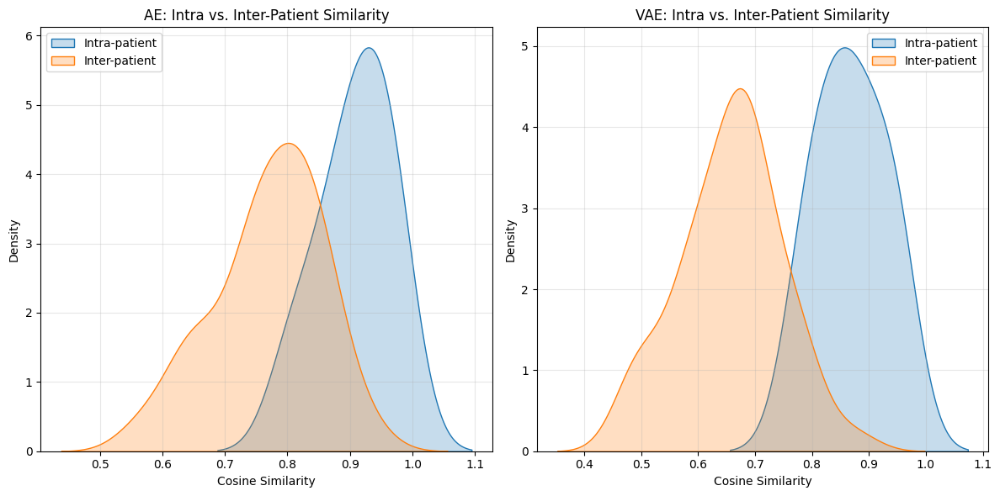


Summary Statistics:
  Model Intra-Patient Similarity Inter-Patient Similarity Separation Ratio
0    AE          0.9079 ± 0.0545          0.7689 ± 0.0850           1.1808
1   VAE          0.8680 ± 0.0574          0.6571 ± 0.0872           1.3210

AE - Top 10 most stable dimensions:
  Dimension 255
  Dimension 103
  Dimension 68
  Dimension 180
  Dimension 85
  Dimension 176
  Dimension 219
  Dimension 10
  Dimension 44
  Dimension 210

AE - Top 10 most discriminative dimensions:
  Dimension 32
  Dimension 16
  Dimension 94
  Dimension 231
  Dimension 123
  Dimension 154
  Dimension 50
  Dimension 199
  Dimension 90
  Dimension 82

VAE - Top 10 most stable dimensions:
  Dimension 172
  Dimension 97
  Dimension 132
  Dimension 253
  Dimension 149
  Dimension 187
  Dimension 212
  Dimension 243
  Dimension 179
  Dimension 129

VAE - Top 10 most discriminative dimensions:
  Dimension 5
  Dimension 47
  Dimension 87
  Dimension 25
  Dimension 123
  Dimension 15
  Dimension 60
  Dimension 21

In [39]:
# Cell 26: Extracting and Analyzing Latent Representations for Longitudinal Patients
import torch
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.manifold import TSNE
from tqdm import tqdm
import time
import gc

def extract_patient_latent_representations(patient_exams, selected_patients, ae_model, vae_model, dataloader):
    """
    Extract latent representations for all exams of selected patients.
    
    Parameters:
        patient_exams: Dictionary with patient exam info
        selected_patients: DataFrame of patients selected for analysis
        ae_model: Trained autoencoder model
        vae_model: Trained VAE model
        dataloader: DataLoader containing all images
        
    Returns:
        Dictionary with latent representations for each patient and exam
    """
    print("Extracting latent representations for longitudinal patients...")
    
    # Set models to evaluation mode
    device = next(ae_model.parameters()).device
    ae_model.eval()
    vae_model.eval()
    
    # Create a set of selected patient IDs for faster lookup
    selected_patient_ids = set(selected_patients['patient_id'])
    
    # Dictionary to store latent representations
    patient_latent_reps = {
        'ae': defaultdict(lambda: defaultdict(list)),
        'vae': defaultdict(lambda: defaultdict(list))
    }
    
    # Process all images in the dataloader
    with torch.no_grad():
        for batch in tqdm(dataloader, desc="Extracting latent vectors"):
            volumes = batch['volume']
            paths = batch['path']
            
            # Check if any image in this batch belongs to our selected patients
            batch_has_selected = False
            for path in paths:
                patient_id, _, _ = extract_patient_info(path)
                if patient_id in selected_patient_ids:
                    batch_has_selected = True
                    break
            
            # Skip batch if it doesn't contain any of our selected patients
            if not batch_has_selected:
                continue
            
            # Process the batch
            volumes = volumes.to(device)
            
            # Get latent vectors
            ae_latent = ae_model.encode(volumes)
            vae_mu, _ = vae_model.encode(volumes)
            
            # Store latent vectors for selected patients
            for i, path in enumerate(paths):
                patient_id, exam_date, _ = extract_patient_info(path)
                
                if patient_id in selected_patient_ids and exam_date:
                    patient_latent_reps['ae'][patient_id][exam_date].append(ae_latent[i].cpu().numpy())
                    patient_latent_reps['vae'][patient_id][exam_date].append(vae_mu[i].cpu().numpy())
            
            # Memory cleanup
            del volumes, ae_latent, vae_mu
            torch.cuda.empty_cache()
    
    # Average latent vectors for each exam (in case there are multiple images per exam)
    for model_type in ['ae', 'vae']:
        for patient_id in patient_latent_reps[model_type]:
            for exam_date in patient_latent_reps[model_type][patient_id]:
                vectors = patient_latent_reps[model_type][patient_id][exam_date]
                if vectors:
                    # Average the vectors
                    avg_vector = np.mean(vectors, axis=0)
                    patient_latent_reps[model_type][patient_id][exam_date] = avg_vector
    
    # Convert to a more accessible format for analysis
    latent_data = []
    
    for model_type in ['ae', 'vae']:
        for patient_id in patient_latent_reps[model_type]:
            for exam_date, latent_vector in patient_latent_reps[model_type][patient_id].items():
                # Get patient group from selected_patients
                patient_group = selected_patients[selected_patients['patient_id'] == patient_id]['group'].iloc[0]
                
                latent_data.append({
                    'patient_id': patient_id,
                    'group': patient_group,
                    'exam_date': exam_date,
                    'model_type': model_type,
                    'latent_vector': latent_vector
                })
    
    latent_df = pd.DataFrame(latent_data)
    
    print(f"Extracted latent representations for {len(latent_df)} exams across {len(selected_patient_ids)} patients.")
    
    return latent_df

def analyze_patient_latent_consistency(latent_df):
    """
    Analyze the consistency of latent representations across exams for the same patient.
    
    Parameters:
        latent_df: DataFrame with latent representations for each patient and exam
        
    Returns:
        Dictionary with analysis results
    """
    print("\nAnalyzing consistency of latent representations...")
    
    # Calculate intra-patient and inter-patient similarity
    results = {
        'ae': {'intra_sim': [], 'inter_sim': [], 'stable_dims': []},
        'vae': {'intra_sim': [], 'inter_sim': [], 'stable_dims': []}
    }
    
    # Calculate pairwise similarities for each model type
    for model_type in ['ae', 'vae']:
        model_data = latent_df[latent_df['model_type'] == model_type]
        
        # Initialize arrays for dimension-wise analysis
        latent_dim = len(model_data.iloc[0]['latent_vector'])
        dim_stability = np.zeros(latent_dim)
        dim_inter_variation = np.zeros(latent_dim)
        
        # Group by patient
        patient_groups = model_data.groupby('patient_id')
        
        # Calculate intra-patient similarities
        for patient_id, patient_df in patient_groups:
            patient_vectors = np.array(patient_df['latent_vector'].tolist())
            
            # Calculate pairwise similarities within patient
            if len(patient_vectors) > 1:
                # Cosine similarity between all pairs of exams
                sim_matrix = cosine_similarity(patient_vectors)
                
                # Average similarity (excluding self-similarity along diagonal)
                intra_sim = (sim_matrix.sum() - len(patient_vectors)) / (len(patient_vectors) * (len(patient_vectors) - 1))
                results[model_type]['intra_sim'].append(intra_sim)
                
                # Analyze dimension-wise stability
                for dim in range(latent_dim):
                    dim_values = patient_vectors[:, dim]
                    dim_stability[dim] += np.std(dim_values)
        
        # Normalize dimension stability by number of patients
        dim_stability /= len(patient_groups)
        
        # Find the most stable dimensions (lowest standard deviation across exams)
        stable_dims = np.argsort(dim_stability)[:20]  # Top 20 most stable dimensions
        results[model_type]['stable_dims'] = stable_dims.tolist()
        
        # Calculate inter-patient similarities
        patient_avg_vectors = {}
        
        # Get average vector for each patient
        for patient_id, patient_df in patient_groups:
            patient_vectors = np.array(patient_df['latent_vector'].tolist())
            patient_avg_vectors[patient_id] = np.mean(patient_vectors, axis=0)
        
        # Calculate pairwise similarities between different patients
        patient_ids = list(patient_avg_vectors.keys())
        for i in range(len(patient_ids)):
            for j in range(i+1, len(patient_ids)):
                vec1 = patient_avg_vectors[patient_ids[i]]
                vec2 = patient_avg_vectors[patient_ids[j]]
                
                # Cosine similarity between patients
                sim = cosine_similarity([vec1], [vec2])[0, 0]
                results[model_type]['inter_sim'].append(sim)
                
                # Calculate dimension-wise variation between patients
                for dim in range(latent_dim):
                    dim_inter_variation[dim] += abs(vec1[dim] - vec2[dim])
        
        # Normalize inter-patient variation by number of pairs
        if len(patient_ids) > 1:
            num_pairs = len(patient_ids) * (len(patient_ids) - 1) / 2
            dim_inter_variation /= num_pairs
        
        # Find most discriminative dimensions (highest variation between patients)
        discrim_dims = np.argsort(dim_inter_variation)[::-1][:20]  # Top 20 most discriminative dimensions
        results[model_type]['discrim_dims'] = discrim_dims.tolist()
    
    # Plot intra vs inter patient similarity distributions
    plt.figure(figsize=(12, 6))
    
    plt.subplot(1, 2, 1)
    sns.kdeplot(results['ae']['intra_sim'], label='Intra-patient', shade=True)
    sns.kdeplot(results['ae']['inter_sim'], label='Inter-patient', shade=True)
    plt.title('AE: Intra vs. Inter-Patient Similarity')
    plt.xlabel('Cosine Similarity')
    plt.ylabel('Density')
    plt.grid(alpha=0.3)
    plt.legend()
    
    plt.subplot(1, 2, 2)
    sns.kdeplot(results['vae']['intra_sim'], label='Intra-patient', shade=True)
    sns.kdeplot(results['vae']['inter_sim'], label='Inter-patient', shade=True)
    plt.title('VAE: Intra vs. Inter-Patient Similarity')
    plt.xlabel('Cosine Similarity')
    plt.ylabel('Density')
    plt.grid(alpha=0.3)
    plt.legend()
    
    plt.tight_layout()
    plt.show()
    
    # Create summary statistics table
    summary_stats = []
    for model_type in ['ae', 'vae']:
        intra_mean = np.mean(results[model_type]['intra_sim'])
        intra_std = np.std(results[model_type]['intra_sim'])
        inter_mean = np.mean(results[model_type]['inter_sim'])
        inter_std = np.std(results[model_type]['inter_sim'])
        
        # Separation ratio (higher is better)
        separation_ratio = intra_mean / inter_mean if inter_mean > 0 else float('inf')
        
        summary_stats.append({
            'Model': model_type.upper(),
            'Intra-Patient Similarity': f"{intra_mean:.4f} ± {intra_std:.4f}",
            'Inter-Patient Similarity': f"{inter_mean:.4f} ± {inter_std:.4f}",
            'Separation Ratio': f"{separation_ratio:.4f}"
        })
    
    summary_df = pd.DataFrame(summary_stats)
    print("\nSummary Statistics:")
    print(summary_df)
    
    # Print most stable dimensions
    for model_type in ['ae', 'vae']:
        print(f"\n{model_type.upper()} - Top 10 most stable dimensions:")
        for dim in results[model_type]['stable_dims'][:10]:
            print(f"  Dimension {dim}")
        
        print(f"\n{model_type.upper()} - Top 10 most discriminative dimensions:")
        for dim in results[model_type]['discrim_dims'][:10]:
            print(f"  Dimension {dim}")
    
    return results

# Load AE and VAE models
print("Loading trained models...")
ae_model, _ = load_trained_model('checkpoints', 'autoencoder_v1', latent_dim=256)
vae_model, _ = load_trained_vae('checkpoints', 'vae_model_v2', latent_dim=256)

# Extract latent representations for longitudinal patients
latent_df = extract_patient_latent_representations(
    patient_data['patient_exams'], 
    selected_patients, 
    ae_model, 
    vae_model, 
    val_loader
)

# Analyze consistency of latent representations
consistency_results = analyze_patient_latent_consistency(latent_df)

Visualizing patient latent space evolution...


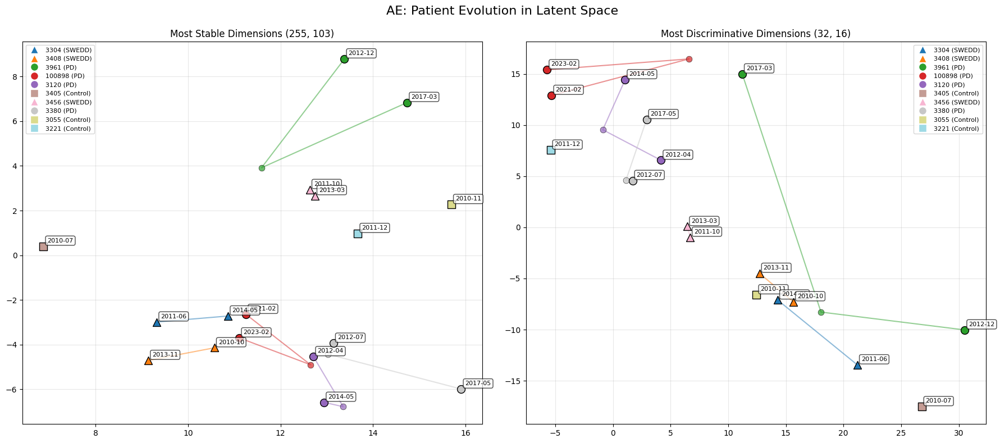

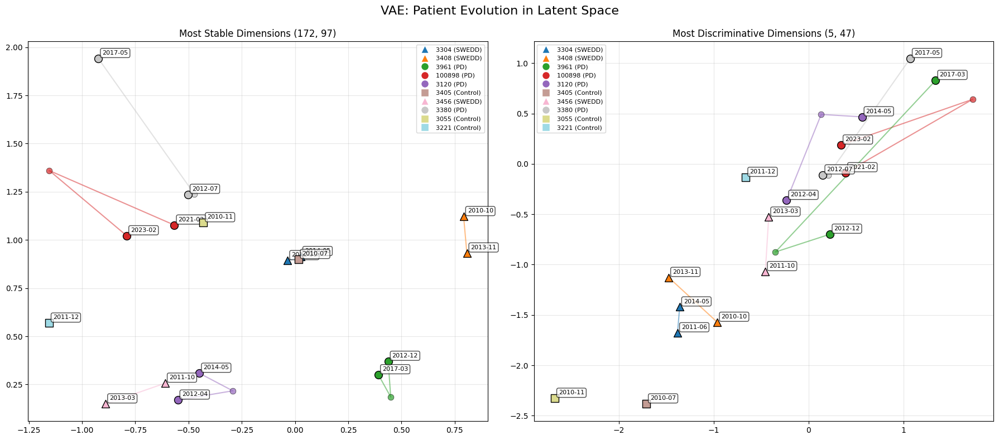

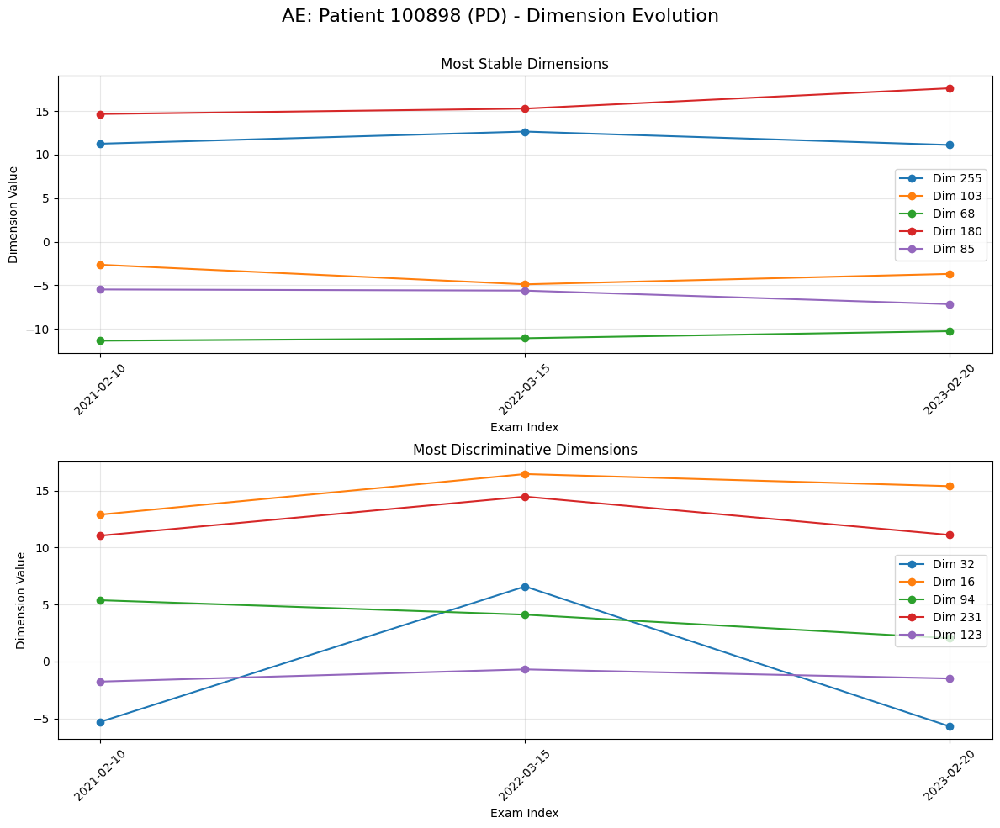

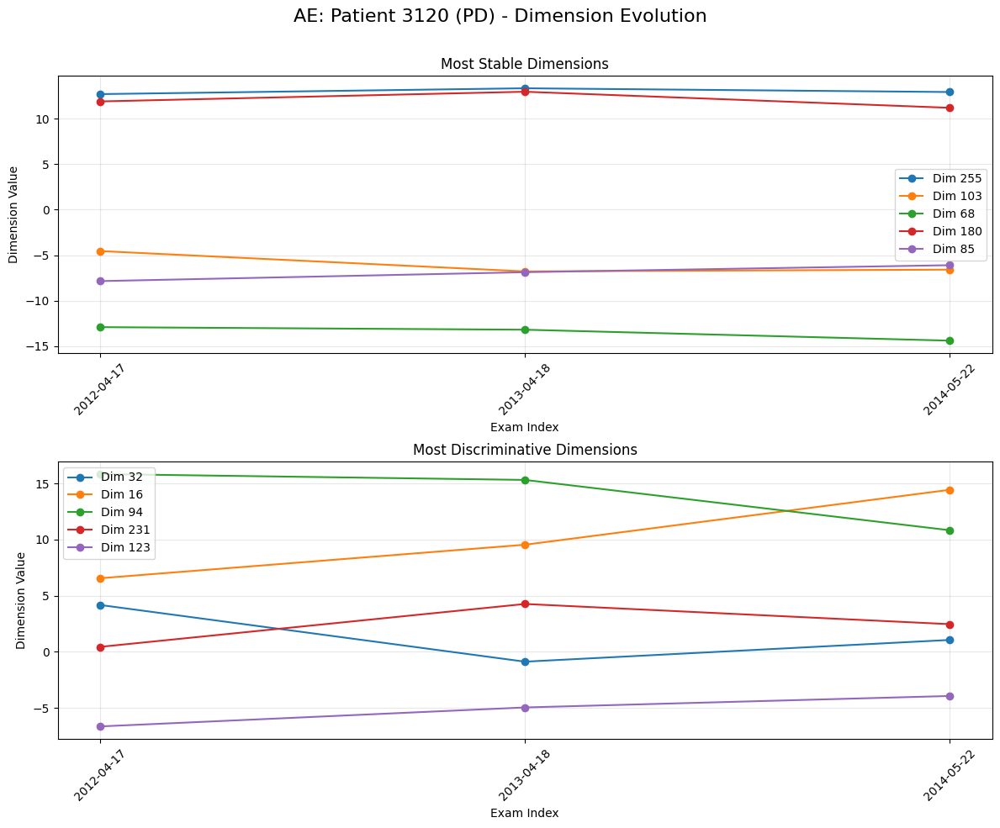

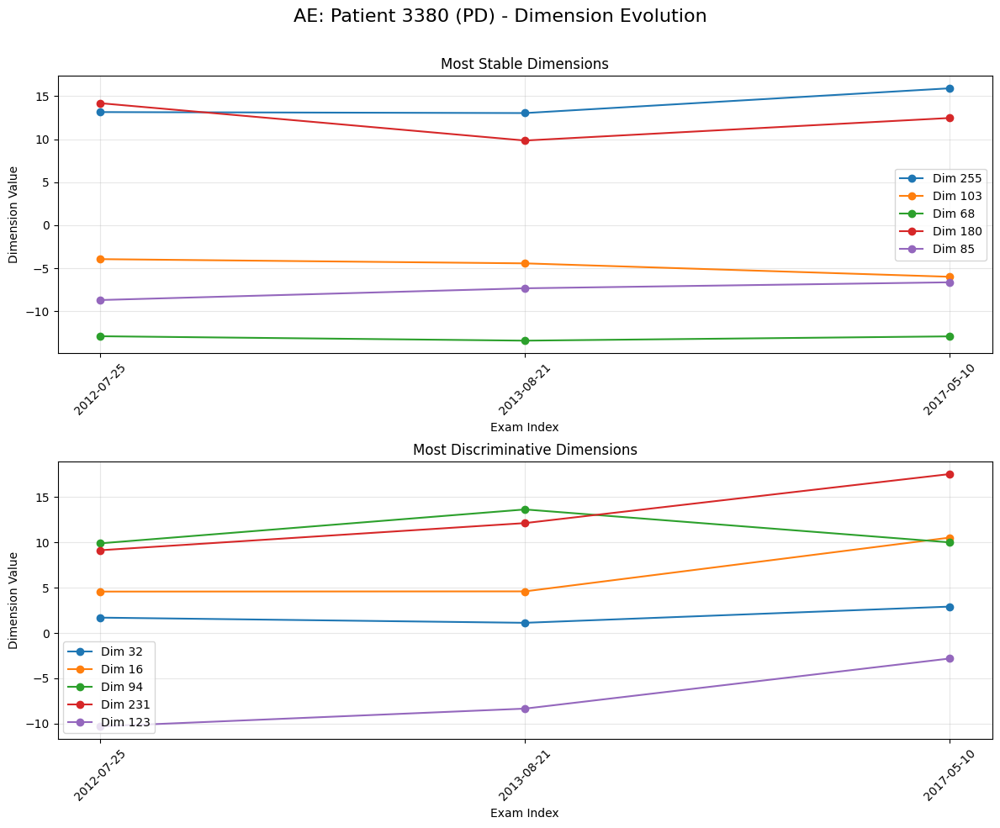

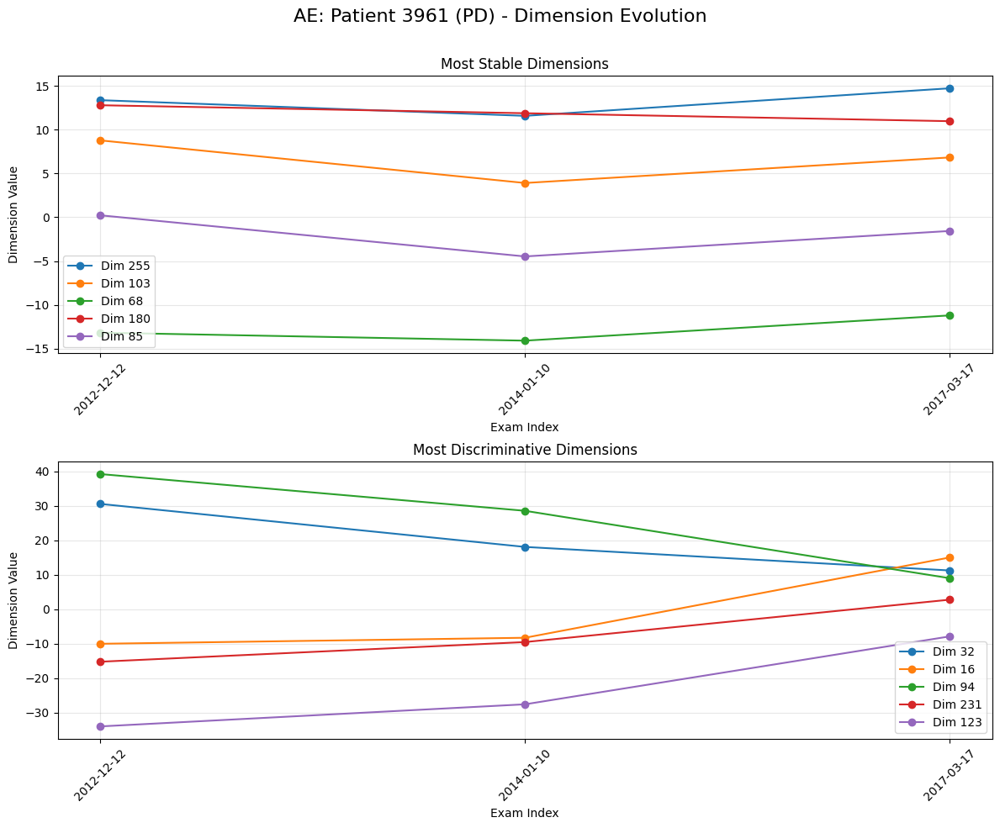

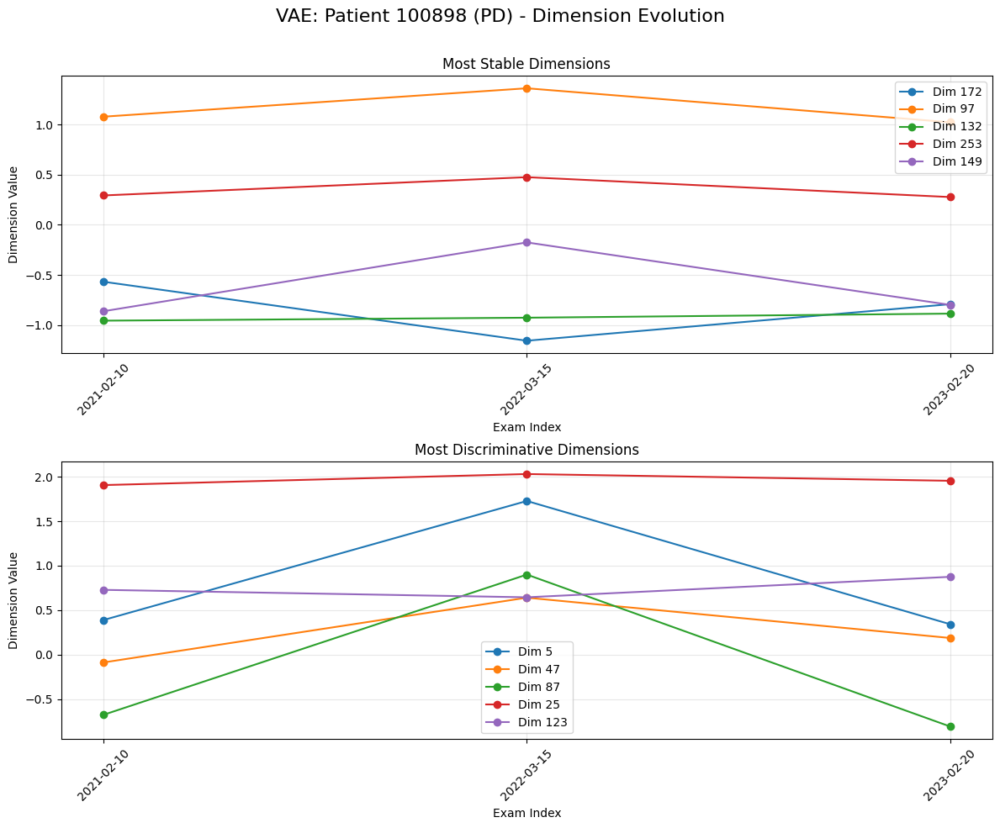

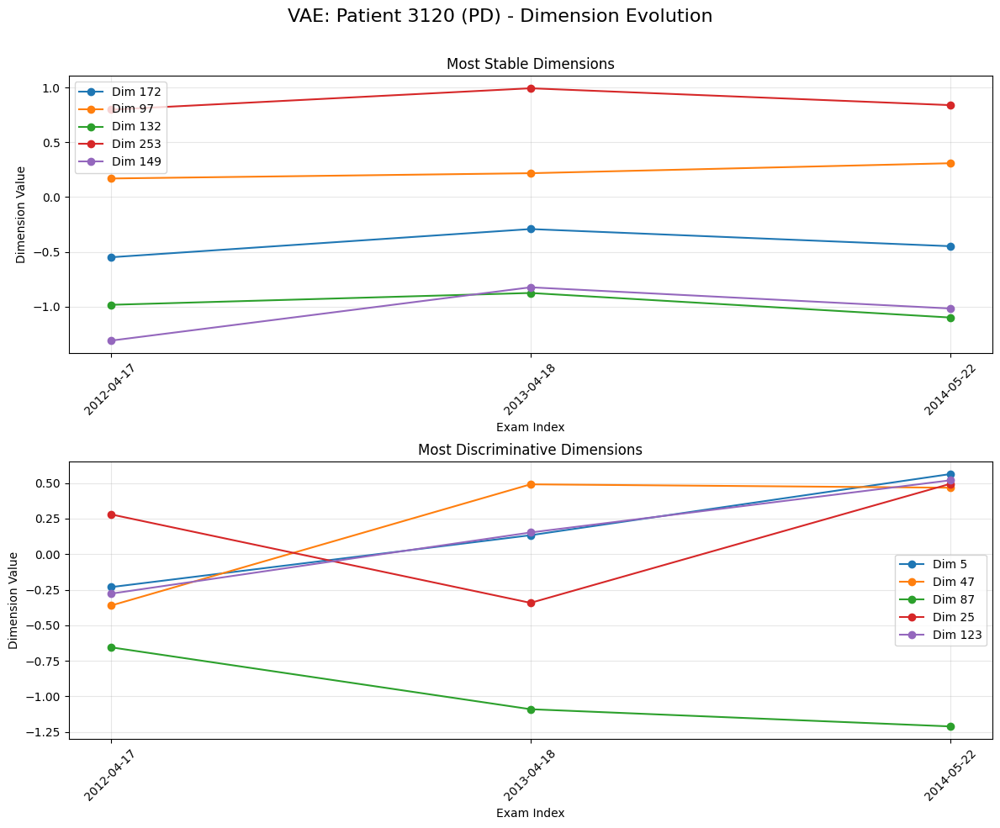

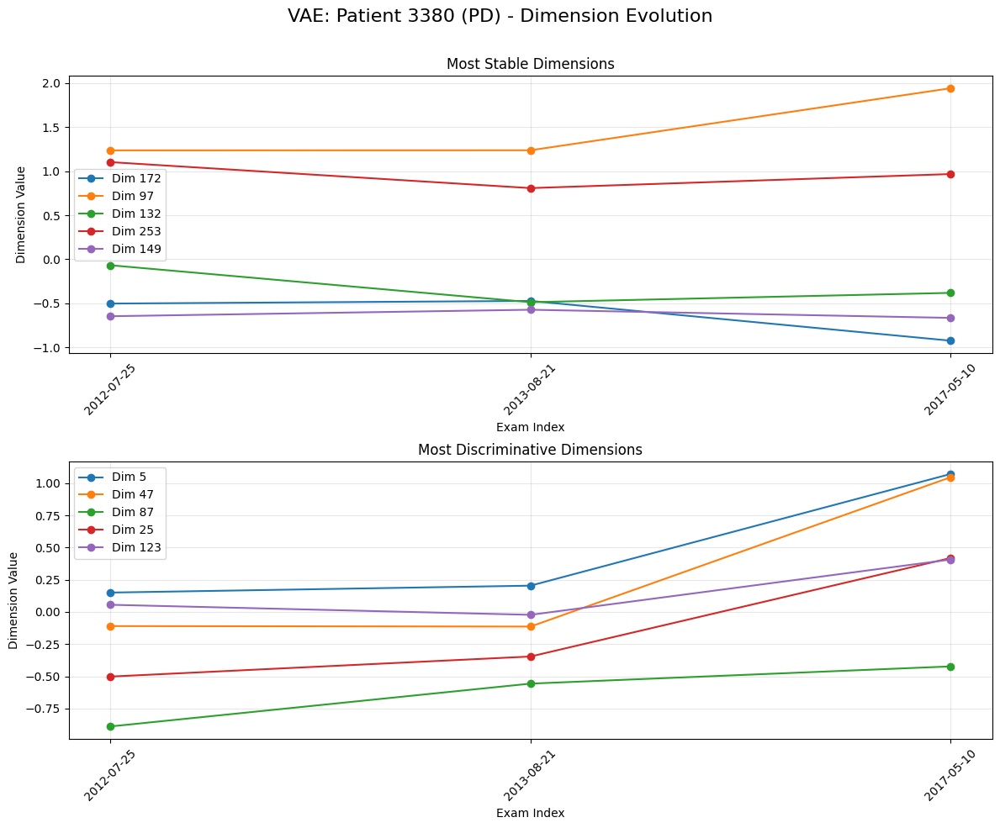

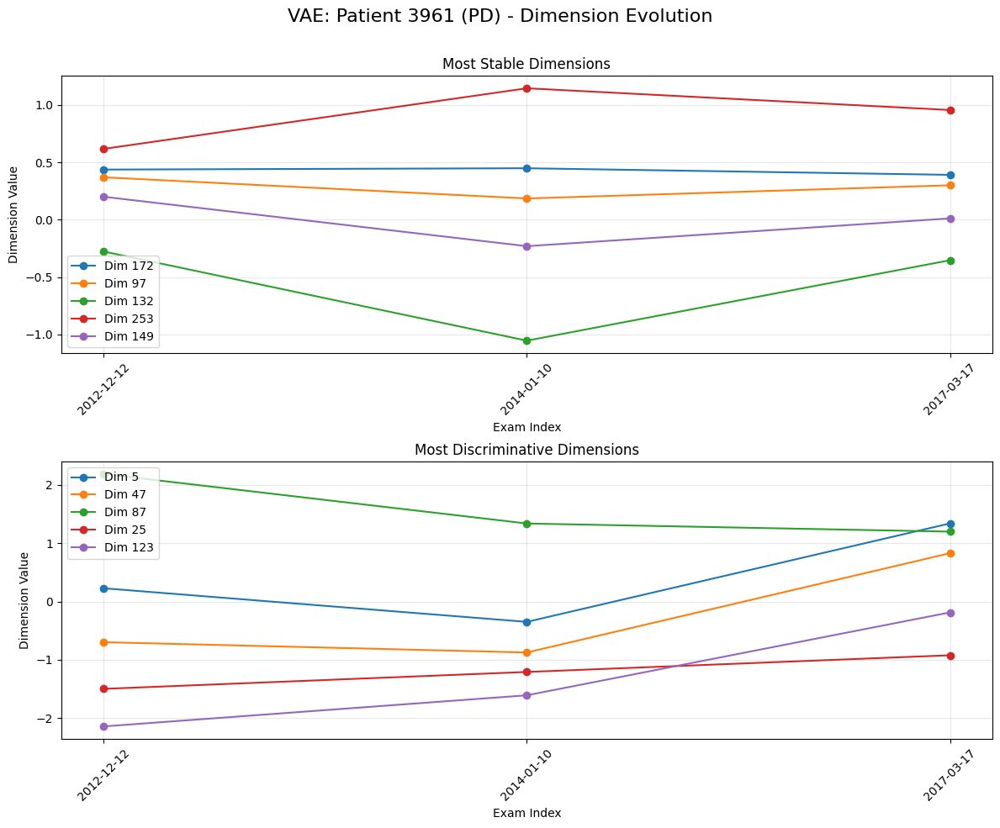


Evaluating patient identification from latent space...

Evaluating AE...

  Using all_dims...


LOO Cross-validation: 100%|██████████| 21/21 [00:00<00:00, 2064.46it/s]


  Accuracy: 0.8095

  Using stable_dims...


LOO Cross-validation: 100%|██████████| 21/21 [00:00<00:00, 1923.15it/s]


  Accuracy: 0.8571

  Using discrim_dims...


LOO Cross-validation: 100%|██████████| 21/21 [00:00<00:00, 2024.05it/s]


  Accuracy: 0.7619

Evaluating VAE...

  Using all_dims...


LOO Cross-validation: 100%|██████████| 21/21 [00:00<00:00, 1647.01it/s]


  Accuracy: 0.8095

  Using stable_dims...


LOO Cross-validation: 100%|██████████| 21/21 [00:00<00:00, 1837.00it/s]


  Accuracy: 0.8571

  Using discrim_dims...


LOO Cross-validation: 100%|██████████| 21/21 [00:00<00:00, 1702.73it/s]

  Accuracy: 0.8095

Final Insights:
1. Most stable dimensions (consistent within patients):
   - AE: 255, 103, 68, 180, 85
   - VAE: 172, 97, 132, 253, 149

2. Most discriminative dimensions (varying between patients):
   - AE: 32, 16, 94, 231, 123
   - VAE: 5, 47, 87, 25, 123

3. Patient identification accuracy:
   - AE using all_dims: 0.8095
   - AE using stable_dims: 0.8571
   - AE using discrim_dims: 0.7619
   - VAE using all_dims: 0.8095
   - VAE using stable_dims: 0.8571
   - VAE using discrim_dims: 0.8095


In [40]:
# Cell 28: Visualizing Patient Identity in Latent Space
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import LeaveOneOut
import itertools
from matplotlib.colors import ListedColormap

def visualize_patient_latent_evolution(latent_df, stable_dims):
    """
    Visualize how the latent representations of patients evolve over time,
    focusing on the most stable dimensions identified.
    
    Parameters:
        latent_df: DataFrame with latent representations
        stable_dims: Dictionary with stable dimensions for AE and VAE
    """
    print("Visualizing patient latent space evolution...")
    
    # Create a figure for both models
    for model_type in ['ae', 'vae']:
        model_data = latent_df[latent_df['model_type'] == model_type]
        
        # Get top stable dimensions
        top_dims = stable_dims[model_type]['stable_dims'][:2]
        top_discrim_dims = stable_dims[model_type]['discrim_dims'][:2]
        
        # Create plots
        fig, axes = plt.subplots(1, 2, figsize=(18, 8))
        plt.suptitle(f'{model_type.upper()}: Patient Evolution in Latent Space', fontsize=16)
        
        # Plot using stable dimensions
        ax = axes[0]
        visualize_dimensions(model_data, top_dims, ax, f'Most Stable Dimensions ({top_dims[0]}, {top_dims[1]})')
        
        # Plot using discriminative dimensions
        ax = axes[1]
        visualize_dimensions(model_data, top_discrim_dims, ax, f'Most Discriminative Dimensions ({top_discrim_dims[0]}, {top_discrim_dims[1]})')
        
        plt.tight_layout()
        plt.subplots_adjust(top=0.9)
        plt.show()
    
    # Create dimension evolution plots for each patient
    for model_type in ['ae', 'vae']:
        model_data = latent_df[latent_df['model_type'] == model_type]
        
        # Get top stable & discriminative dimensions
        top_stable = stable_dims[model_type]['stable_dims'][:5]
        top_discrim = stable_dims[model_type]['discrim_dims'][:5]
        
        # For each patient, visualize how these dimensions evolve over time
        for patient_id, patient_df in model_data.groupby('patient_id'):
            # Skip if there are fewer than 3 exams
            if len(patient_df) < 3:
                continue
                
            # Sort by exam date
            patient_df = patient_df.sort_values('exam_date')
            
            # Get patient group
            patient_group = patient_df['group'].iloc[0]
            
            # Convert exam dates to numerical indices for x-axis
            exam_dates = patient_df['exam_date'].tolist()
            
            # Plot evolution of top dimensions
            fig, axes = plt.subplots(2, 1, figsize=(12, 10))
            plt.suptitle(f'{model_type.upper()}: Patient {patient_id} ({patient_group}) - Dimension Evolution', fontsize=16)
            
            # Stable dimensions
            ax = axes[0]
            for i, dim in enumerate(top_stable):
                dim_values = [vec[dim] for vec in patient_df['latent_vector']]
                ax.plot(range(len(exam_dates)), dim_values, 'o-', label=f'Dim {dim}')
            
            ax.set_title('Most Stable Dimensions')
            ax.set_xlabel('Exam Index')
            ax.set_ylabel('Dimension Value')
            ax.set_xticks(range(len(exam_dates)))
            ax.set_xticklabels(exam_dates, rotation=45)
            ax.grid(alpha=0.3)
            ax.legend()
            
            # Discriminative dimensions
            ax = axes[1]
            for i, dim in enumerate(top_discrim):
                dim_values = [vec[dim] for vec in patient_df['latent_vector']]
                ax.plot(range(len(exam_dates)), dim_values, 'o-', label=f'Dim {dim}')
            
            ax.set_title('Most Discriminative Dimensions')
            ax.set_xlabel('Exam Index')
            ax.set_ylabel('Dimension Value')
            ax.set_xticks(range(len(exam_dates)))
            ax.set_xticklabels(exam_dates, rotation=45)
            ax.grid(alpha=0.3)
            ax.legend()
            
            plt.tight_layout()
            plt.subplots_adjust(top=0.9)
            plt.show()

def visualize_dimensions(data, dimensions, ax, title):
    """Helper function to visualize patient trajectories in two dimensions"""
    # Create a colormap with one color per patient
    patient_ids = data['patient_id'].unique()
    colors = plt.cm.tab20(np.linspace(0, 1, len(patient_ids)))
    patient_colors = {pid: colors[i] for i, pid in enumerate(patient_ids)}
    
    # Plot each patient's trajectory
    for patient_id, patient_df in data.groupby('patient_id'):
        # Sort by exam date
        patient_df = patient_df.sort_values('exam_date')
        
        # Get group for marker shape
        group = patient_df['group'].iloc[0]
        marker = 'o' if group == 'PD' else ('s' if group == 'Control' else '^')
        
        # Extract dimension values
        x_values = [vec[dimensions[0]] for vec in patient_df['latent_vector']]
        y_values = [vec[dimensions[1]] for vec in patient_df['latent_vector']]
        
        # Plot trajectory with connecting lines
        ax.plot(x_values, y_values, '-', color=patient_colors[patient_id], alpha=0.5)
        
        # Plot individual points with patient labels
        for i, (x, y, date) in enumerate(zip(x_values, y_values, patient_df['exam_date'])):
            # Larger and darker marker for first and last exam
            if i == 0 or i == len(x_values) - 1:
                ax.scatter(x, y, s=100, color=patient_colors[patient_id], marker=marker, 
                          edgecolor='black', linewidth=1, alpha=1.0, zorder=3)
                # Add date label for first and last
                date_label = date.split('-')[0] + ('-' + date.split('-')[1] if '-' in date else '')
                ax.annotate(date_label, (x, y), xytext=(5, 5), textcoords='offset points', 
                           fontsize=8, bbox=dict(boxstyle="round,pad=0.3", fc="white", alpha=0.7))
            else:
                ax.scatter(x, y, s=60, color=patient_colors[patient_id], marker=marker, 
                          edgecolor='black', linewidth=0.5, alpha=0.7, zorder=2)
    
    # Add legend for patients
    legend_elements = []
    for patient_id in patient_ids:
        patient_data = data[data['patient_id'] == patient_id]
        group = patient_data['group'].iloc[0]
        marker = 'o' if group == 'PD' else ('s' if group == 'Control' else '^')
        legend_elements.append(plt.Line2D([0], [0], marker=marker, color='w', markerfacecolor=patient_colors[patient_id], 
                                         markersize=10, label=f"{patient_id} ({group})"))
    
    ax.legend(handles=legend_elements, loc='best', fontsize=8)
    ax.set_title(title)
    ax.grid(alpha=0.3)

def evaluate_patient_identification(latent_df, stable_dims):
    """
    Evaluate whether patients can be identified from their latent representations
    using leave-one-exam-out cross-validation.
    
    Parameters:
        latent_df: DataFrame with latent representations
        stable_dims: Dictionary with stable dimensions for AE and VAE
    """
    print("\nEvaluating patient identification from latent space...")
    
    # Results for each model
    identification_results = {}
    
    for model_type in ['ae', 'vae']:
        print(f"\nEvaluating {model_type.upper()}...")
        model_data = latent_df[latent_df['model_type'] == model_type]
        
        # Get different dimension sets to evaluate
        dim_sets = {
            'all_dims': None,  # Use all dimensions
            'stable_dims': stable_dims[model_type]['stable_dims'][:20],
            'discrim_dims': stable_dims[model_type]['discrim_dims'][:20]
        }
        
        # Store results for this model
        results = {}
        
        # Evaluate each dimension set
        for dim_set_name, dims in dim_sets.items():
            print(f"\n  Using {dim_set_name}...")
            
            # Prepare data for cross-validation
            X_all = []
            y_all = []
            
            for _, row in model_data.iterrows():
                latent_vector = row['latent_vector']
                
                # Select only the specified dimensions if applicable
                if dims is not None:
                    latent_vector = latent_vector[dims]
                
                X_all.append(latent_vector)
                y_all.append(row['patient_id'])
            
            X_all = np.array(X_all)
            y_all = np.array(y_all)
            
            # Leave-one-exam-out cross-validation
            loo = LeaveOneOut()
            predictions = []
            actual = []
            
            for train_index, test_index in tqdm(loo.split(X_all), total=len(X_all), desc="LOO Cross-validation"):
                X_train, X_test = X_all[train_index], X_all[test_index]
                y_train, y_test = y_all[train_index], y_all[test_index]
                
                # Train a simple KNN classifier
                knn = KNeighborsClassifier(n_neighbors=1)
                knn.fit(X_train, y_train)
                
                # Predict
                pred = knn.predict(X_test)
                
                predictions.extend(pred)
                actual.extend(y_test)
            
            # Calculate accuracy
            accuracy = np.mean(np.array(predictions) == np.array(actual))
            
            print(f"  Accuracy: {accuracy:.4f}")
            
            # Store results
            results[dim_set_name] = {
                'accuracy': accuracy
            }
        
        identification_results[model_type] = results
    
    return identification_results

# Visualize patient latent space evolution
visualize_patient_latent_evolution(latent_df, consistency_results)

# Evaluate patient identification from latent space
identification_results = evaluate_patient_identification(latent_df, consistency_results)

# Final summary
print("\nFinal Insights:")
print("1. Most stable dimensions (consistent within patients):")
for model_type in ['ae', 'vae']:
    print(f"   - {model_type.upper()}: {', '.join(map(str, consistency_results[model_type]['stable_dims'][:5]))}")

print("\n2. Most discriminative dimensions (varying between patients):")
for model_type in ['ae', 'vae']:
    print(f"   - {model_type.upper()}: {', '.join(map(str, consistency_results[model_type]['discrim_dims'][:5]))}")

print("\n3. Patient identification accuracy:")
for model_type in ['ae', 'vae']:
    for dim_set in identification_results[model_type]:
        accuracy = identification_results[model_type][dim_set]['accuracy']
        print(f"   - {model_type.upper()} using {dim_set}: {accuracy:.4f}")

# SBR Study with Latent Representations

Loaded SBR data with 4177 rows and 14 columns

Column names:
['PROTOCOL', 'PATNO', 'EVENT_ID', 'DATSCAN_LIGAND', 'DATSCAN_DATE', 'DATSCAN_CAUDATE_R', 'DATSCAN_CAUDATE_L', 'DATSCAN_PUTAMEN_R', 'DATSCAN_PUTAMEN_L', 'DATSCAN_PUTAMEN_R_ANT', 'DATSCAN_PUTAMEN_L_ANT', 'DATSCAN_ANALYZED', 'DATSCAN_NOT_ANALYZED_REASON', 'DATSCAN_OTHER_SPECIFY']

Data types:
PROTOCOL                        object
PATNO                            int64
EVENT_ID                        object
DATSCAN_LIGAND                  object
DATSCAN_DATE                    object
DATSCAN_CAUDATE_R              float64
DATSCAN_CAUDATE_L              float64
DATSCAN_PUTAMEN_R              float64
DATSCAN_PUTAMEN_L              float64
DATSCAN_PUTAMEN_R_ANT          float64
DATSCAN_PUTAMEN_L_ANT          float64
DATSCAN_ANALYZED                object
DATSCAN_NOT_ANALYZED_REASON     object
DATSCAN_OTHER_SPECIFY           object
dtype: object

Null values:
PROTOCOL                          0
PATNO                             0
EV

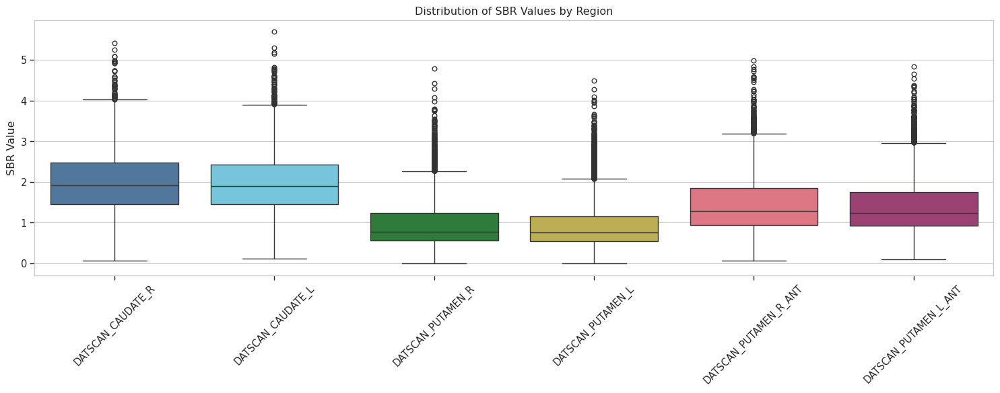


Cleaned SBR data:
   PATNO EVENT_ID SCAN_DATE  DATSCAN_CAUDATE_R  DATSCAN_CAUDATE_L  \
0   3000       SC   2011-01               2.99               3.43   
1   3001      U01   2011-06               2.00               1.92   
2   3001      U02   2014-04               1.53               0.65   
3   3001      V04   2012-04               1.56               1.12   
4   3001      V06   2013-05               1.68               1.26   

   DATSCAN_PUTAMEN_R  DATSCAN_PUTAMEN_L  DATSCAN_PUTAMEN_R_ANT  \
0               2.94               2.63                   3.28   
1               0.80               0.65                   1.51   
2               0.37               0.50                   0.85   
3               0.62               0.48                   0.91   
4               0.38               0.42                   0.88   

   DATSCAN_PUTAMEN_L_ANT  MEAN_CAUDATE  MEAN_PUTAMEN  MEAN_PUTAMEN_ANT  \
0                   3.40          3.21         2.785             3.340   
1                   1

In [48]:
# Cell 29: Loading and Preprocessing SBR Data
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import re

# Load the SBR data
sbr_file = "DaTScan_SBR_Analysis_17Dec2024.csv"
sbr_df = pd.read_csv(sbr_file)

# Display basic information
print(f"Loaded SBR data with {len(sbr_df)} rows and {len(sbr_df.columns)} columns")
print("\nColumn names:")
print(sbr_df.columns.tolist())

# Check data types and nulls
print("\nData types:")
print(sbr_df.dtypes)
print("\nNull values:")
print(sbr_df.isnull().sum())

# Filter out records not analyzed
sbr_filtered = sbr_df[sbr_df['DATSCAN_ANALYZED'] == 'Yes'].copy()
print(f"\nFiltered to {len(sbr_filtered)} records with DATSCAN_ANALYZED = 'Yes'")

# Convert dates to standardized format
def standardize_date(date_str):
    if pd.isna(date_str) or date_str == "":
        return None
    
    # Try different formats
    try:
        # Format: MM/YYYY
        if '/' in date_str and len(date_str.split('/')) == 2:
            month, year = date_str.split('/')
            # Convert to YYYY-MM format
            return f"{year}-{month.zfill(2)}"
        # Format: MM/DD/YYYY
        elif '/' in date_str and len(date_str.split('/')) == 3:
            month, day, year = date_str.split('/')
            # Convert to YYYY-MM-DD format
            return f"{year}-{month.zfill(2)}-{day.zfill(2)}"
        else:
            return date_str
    except:
        return date_str

# Apply date standardization
sbr_filtered['DATSCAN_DATE_STD'] = sbr_filtered['DATSCAN_DATE'].apply(standardize_date)

# Parse EVENT_ID to extract date information (some are in MM/YYYY format)
def parse_event_id_date(event_id):
    if pd.isna(event_id) or event_id == "":
        return None
    
    # Check if event_id contains date info (e.g., "U01", "BL", "03/2013")
    if '/' in event_id:
        return standardize_date(event_id)
    else:
        return None

sbr_filtered['EVENT_DATE_STD'] = sbr_filtered['EVENT_ID'].apply(parse_event_id_date)

# Use EVENT_DATE when DATSCAN_DATE is missing
sbr_filtered['SCAN_DATE'] = sbr_filtered['DATSCAN_DATE_STD'].fillna(sbr_filtered['EVENT_DATE_STD'])

# Convert SBR measurements to numeric
sbr_columns = [
    'DATSCAN_CAUDATE_R', 'DATSCAN_CAUDATE_L', 
    'DATSCAN_PUTAMEN_R', 'DATSCAN_PUTAMEN_L',
    'DATSCAN_PUTAMEN_R_ANT', 'DATSCAN_PUTAMEN_L_ANT'
]

for col in sbr_columns:
    sbr_filtered[col] = pd.to_numeric(sbr_filtered[col], errors='coerce')

# Add convenient aggregate measures
sbr_filtered['MEAN_CAUDATE'] = sbr_filtered[['DATSCAN_CAUDATE_R', 'DATSCAN_CAUDATE_L']].mean(axis=1)
sbr_filtered['MEAN_PUTAMEN'] = sbr_filtered[['DATSCAN_PUTAMEN_R', 'DATSCAN_PUTAMEN_L']].mean(axis=1)
sbr_filtered['MEAN_PUTAMEN_ANT'] = sbr_filtered[['DATSCAN_PUTAMEN_R_ANT', 'DATSCAN_PUTAMEN_L_ANT']].mean(axis=1)
sbr_filtered['MEAN_TOTAL'] = sbr_filtered[sbr_columns].mean(axis=1)

# Verify SBR statistics by column
print("\nSBR Statistics:")
print(sbr_filtered[sbr_columns + ['MEAN_CAUDATE', 'MEAN_PUTAMEN', 'MEAN_PUTAMEN_ANT', 'MEAN_TOTAL']].describe())

# Visualize SBR distributions
plt.figure(figsize=(15, 6))
sns.boxplot(data=sbr_filtered[sbr_columns])
plt.title('Distribution of SBR Values by Region')
plt.ylabel('SBR Value')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Save the filtered data for use in subsequent cells
sbr_clean = sbr_filtered[['PATNO', 'EVENT_ID', 'SCAN_DATE'] + sbr_columns + 
                         ['MEAN_CAUDATE', 'MEAN_PUTAMEN', 'MEAN_PUTAMEN_ANT', 'MEAN_TOTAL']]
print("\nCleaned SBR data:")
print(sbr_clean.head())

# Check for duplicates
duplicates = sbr_clean[sbr_clean.duplicated(subset=['PATNO', 'SCAN_DATE'], keep=False)]
if not duplicates.empty:
    print(f"\nWarning: Found {len(duplicates)} duplicate entries for the same patient and date")
    print(duplicates)

Loading trained models...
Using device: cuda
Loading best VAE model from checkpoints/vae_model_v2_best.pth
Loaded training history with 249 epochs

Extracting latent vectors for entire dataset...


Extracting latent vectors:   4%|▍         | 12/299 [00:01<00:20, 14.02it/s]

Error processing file Images/PPMI_Images_PD/3863/Reconstructed_DaTSCAN/2013-03-13_13_29_21.0/I449248/PPMI_3863_NM_Reconstructed_DaTSCAN_Br_20141022165646607_1_S202944_I449248.dcm: operands could not be broadcast together with shapes (60,128,128) (91,109,91) 


Extracting latent vectors:  21%|██▏       | 64/299 [00:03<00:12, 18.11it/s]

Error processing file Images/PPMI_Images_PD/3179/Reconstructed_DaTSCAN/2016-08-18_13_51_47.0/I1317564/PPMI_3179_NM_Reconstructed_DaTSCAN_Br_20200616100643787_1_S550153_I1317564.dcm: operands could not be broadcast together with shapes (480,128,128) (91,109,91) 


Extracting latent vectors:  49%|████▉     | 147/299 [00:08<00:08, 18.29it/s]

Error processing file Images/PPMI_Images_PD/101281/Reconstructed_DaTSCAN/2021-04-13_13_45_25.0/I1474392/PPMI_101281_NM_Reconstructed_DaTSCAN_Br_20210727201856600_1_S1046857_I1474392.dcm: operands could not be broadcast together with shapes (48,128,128) (91,109,91) 


Extracting latent vectors: 100%|██████████| 299/299 [00:19<00:00, 15.21it/s]


Extracted latent vectors for 598 images

Latent vector DataFrame:
Shape: (598, 7)
  patient_id   exam_date group
0       3609  2011-08-30    PD
1       3360  2013-07-31    PD
2     112721  2023-02-14    PD
3     234882  2023-05-05    PD
4       3542  2014-03-05    PD


Matching with SBR data: 100%|██████████| 598/598 [00:00<00:00, 30927.17it/s]



Matched 594 images with SBR data

Matched data sample:
  patient_id   exam_date sbr_date group  mean_total
0       3609  2011-08-30  2011-08    PD    1.015000
1       3360  2013-07-31  2013-07    PD    0.728333
2     112721  2023-02-14  2023-02    PD    0.893333
3     234882  2023-05-05  2023-05    PD    0.301667
4       3542  2014-03-05  2014-03    PD    0.871667

Distribution by group:
group
PD         511
Control     56
SWEDD       27
Name: count, dtype: int64


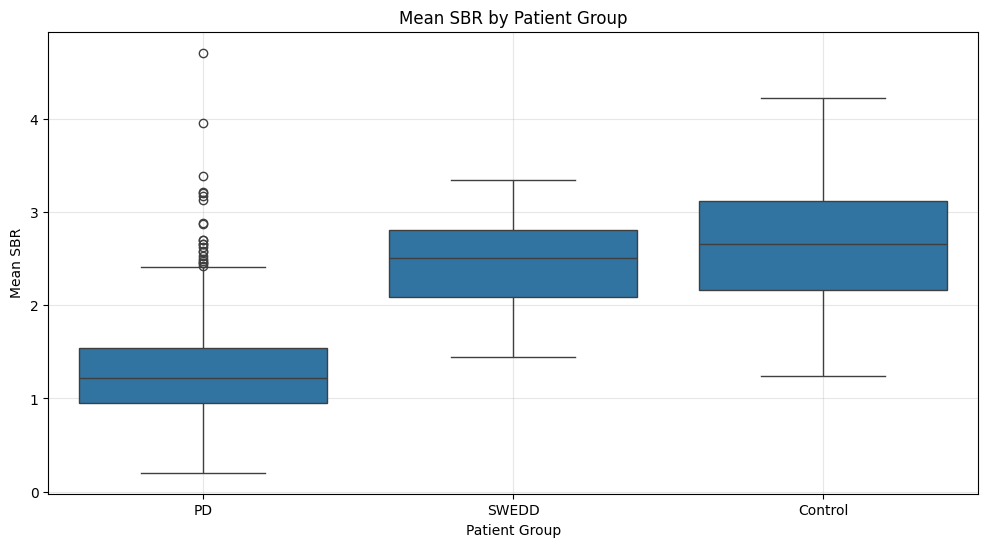


Saved matched data to 'latent_sbr_matched_data.pkl'


In [42]:
# Cell 30: Matching SBR Data with Latent Representations
import os
import re
import torch
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
import gc

# Function to extract patient ID and date from file path
def extract_patient_info_from_path(file_path):
    """
    Extract patient ID and exam date from file path.
    Returns a tuple (patient_id, exam_date)
    """
    # Normalize path
    file_path = file_path.replace('\\', '/')
    
    # Extract patient ID - should be a folder after the group folder
    patient_id_match = re.search(r'PPMI_Images_\w+/(\d+)/', file_path)
    if not patient_id_match:
        patient_id_match = re.search(r'PPMI_(\d+)_', file_path)
        
    patient_id = patient_id_match.group(1) if patient_id_match else None
    
    # Extract exam date - typically found in a format like "2011-01-20_16_28_47.0"
    date_match = re.search(r'(\d{4}-\d{2}-\d{2})_\d{2}_\d{2}_\d{2}', file_path)
    if date_match:
        exam_date = date_match.group(1)
    else:
        # Try another common format
        date_match = re.search(r'(\d{8})', file_path)
        if date_match:
            date_str = date_match.group(1)
            # Format YYYYMMDD
            exam_date = f"{date_str[:4]}-{date_str[4:6]}-{date_str[6:8]}"
        else:
            exam_date = None
            
    return patient_id, exam_date

# Function to match dates between SBR data and image data
def match_dates(image_date, sbr_dates):
    """
    Find the closest matching date in sbr_dates for the given image_date.
    Returns the matching date or None if no match is found.
    """
    if image_date is None or not sbr_dates:
        return None
    
    # Extract year and month from image date
    try:
        image_year_month = "-".join(image_date.split("-")[:2])
    except:
        return None
    
    # Look for exact matches first (YYYY-MM or YYYY-MM-DD)
    exact_matches = [d for d in sbr_dates if d and d.startswith(image_year_month)]
    if exact_matches:
        return exact_matches[0]
    
    # If no exact match, look for same year
    try:
        image_year = image_date.split("-")[0]
        year_matches = [d for d in sbr_dates if d and d.startswith(image_year)]
        if year_matches:
            return year_matches[0]
    except:
        pass
    
    return None

# Function to extract latent vectors from the models for a batch of images
def extract_latent_vectors(ae_model, vae_model, dataloader, max_samples=None):
    """
    Extract latent vectors from both models for all images in the dataloader.
    Also extracts patient ID and date information for matching with SBR data.
    """
    device = next(ae_model.parameters()).device
    ae_model.eval()
    vae_model.eval()
    
    # Storage for results
    results = []
    sample_count = 0
    
    with torch.no_grad():
        for batch in tqdm(dataloader, desc="Extracting latent vectors"):
            volumes = batch['volume'].to(device)
            paths = batch['path']
            labels = batch['label']
            
            # Extract latent vectors
            ae_latent = ae_model.encode(volumes)
            vae_mu, vae_logvar = vae_model.encode(volumes)
            
            # Process each sample in the batch
            for i in range(len(volumes)):
                path = paths[i]
                label = labels[i]
                
                # Extract patient information
                patient_id, exam_date = extract_patient_info_from_path(path)
                
                if patient_id and exam_date:
                    # Store results
                    results.append({
                        'path': path,
                        'patient_id': patient_id,
                        'exam_date': exam_date,
                        'group': label,
                        'ae_latent': ae_latent[i].cpu().numpy(),
                        'vae_mu': vae_mu[i].cpu().numpy(),
                        'vae_logvar': vae_logvar[i].cpu().numpy()
                    })
                    
                    sample_count += 1
                    if max_samples and sample_count >= max_samples:
                        break
            
            # Memory cleanup
            del volumes, ae_latent, vae_mu, vae_logvar
            torch.cuda.empty_cache()
            
            if max_samples and sample_count >= max_samples:
                break
    
    return results

# Load the previously trained models
print("Loading trained models...")
ae_model, _ = load_trained_model('checkpoints', 'autoencoder_v1', latent_dim=256)
vae_model, _ = load_trained_vae('checkpoints', 'vae_model_v2', latent_dim=256)

# Extract latent vectors for all images
print("\nExtracting latent vectors for entire dataset...")
latent_results = extract_latent_vectors(ae_model, vae_model, val_loader, max_samples=None)
print(f"Extracted latent vectors for {len(latent_results)} images")

# Convert to DataFrame for easier processing
latent_df = pd.DataFrame([{
    'path': r['path'],
    'patient_id': r['patient_id'],
    'exam_date': r['exam_date'],
    'group': r['group'],
    'ae_latent': r['ae_latent'],
    'vae_mu': r['vae_mu'],
    'vae_logvar': r['vae_logvar']
} for r in latent_results])

print("\nLatent vector DataFrame:")
print(f"Shape: {latent_df.shape}")
print(latent_df[['patient_id', 'exam_date', 'group']].head())

# Create a lookup dictionary for SBR data by patient ID
sbr_by_patient = {}
for _, row in sbr_clean.iterrows():
    patient_id = str(row['PATNO'])
    if patient_id not in sbr_by_patient:
        sbr_by_patient[patient_id] = []
    
    sbr_by_patient[patient_id].append({
        'scan_date': row['SCAN_DATE'],
        'caudate_r': row['DATSCAN_CAUDATE_R'],
        'caudate_l': row['DATSCAN_CAUDATE_L'],
        'putamen_r': row['DATSCAN_PUTAMEN_R'],
        'putamen_l': row['DATSCAN_PUTAMEN_L'],
        'putamen_r_ant': row['DATSCAN_PUTAMEN_R_ANT'],
        'putamen_l_ant': row['DATSCAN_PUTAMEN_L_ANT'],
        'mean_caudate': row['MEAN_CAUDATE'],
        'mean_putamen': row['MEAN_PUTAMEN'],
        'mean_putamen_ant': row['MEAN_PUTAMEN_ANT'],
        'mean_total': row['MEAN_TOTAL']
    })

# Match latent vectors with SBR data
matched_data = []

for _, row in tqdm(latent_df.iterrows(), total=len(latent_df), desc="Matching with SBR data"):
    patient_id = row['patient_id']
    exam_date = row['exam_date']
    
    # Check if patient exists in SBR data
    if patient_id in sbr_by_patient:
        # Get all SBR records for this patient
        sbr_records = sbr_by_patient[patient_id]
        sbr_dates = [record['scan_date'] for record in sbr_records]
        
        # Find the matching SBR record
        matching_date = match_dates(exam_date, sbr_dates)
        
        if matching_date:
            # Get the matching SBR record
            matching_record = next((r for r in sbr_records if r['scan_date'] == matching_date), None)
            
            if matching_record:
                # Combine latent vector with SBR data
                matched_entry = {
                    'path': row['path'],
                    'patient_id': patient_id,
                    'exam_date': exam_date,
                    'sbr_date': matching_date,
                    'group': row['group'],
                    'ae_latent': row['ae_latent'],
                    'vae_mu': row['vae_mu'],
                    'vae_logvar': row['vae_logvar']
                }
                
                # Add all SBR metrics
                matched_entry.update(matching_record)
                matched_data.append(matched_entry)

# Convert to DataFrame
matched_df = pd.DataFrame(matched_data)
print(f"\nMatched {len(matched_df)} images with SBR data")

# Verify the matched data
if not matched_df.empty:
    print("\nMatched data sample:")
    print(matched_df[['patient_id', 'exam_date', 'sbr_date', 'group', 'mean_total']].head())
    
    # Check distribution of matched data by group
    print("\nDistribution by group:")
    print(matched_df['group'].value_counts())
    
    # Visualize SBR values by group
    plt.figure(figsize=(12, 6))
    sns.boxplot(x='group', y='mean_total', data=matched_df)
    plt.title('Mean SBR by Patient Group')
    plt.xlabel('Patient Group')
    plt.ylabel('Mean SBR')
    plt.grid(alpha=0.3)
    plt.show()
else:
    print("Warning: No matches found between image data and SBR data!")

# Save matched data for use in subsequent cells
matched_df.to_pickle('latent_sbr_matched_data.pkl')
print("\nSaved matched data to 'latent_sbr_matched_data.pkl'")

Loaded matched data with 594 entries
Computing correlations for ae_latent...


Analyzing 256 dimensions: 100%|██████████| 256/256 [00:00<00:00, 2489.96it/s]


Computing correlations for vae_mu...


Analyzing 256 dimensions: 100%|██████████| 256/256 [00:00<00:00, 3171.04it/s]



Analyzing Autoencoder (AE) dimensions:

Top 10 ae_latent dimensions by correlation with SBR:
  Dimension 16: Mean Abs. Corr = 0.8015
  Dimension 199: Mean Abs. Corr = 0.7726
  Dimension 123: Mean Abs. Corr = 0.7709
  Dimension 150: Mean Abs. Corr = 0.7550
  Dimension 99: Mean Abs. Corr = 0.7444
  Dimension 154: Mean Abs. Corr = 0.7336
  Dimension 231: Mean Abs. Corr = 0.6918
  Dimension 39: Mean Abs. Corr = 0.6911
  Dimension 22: Mean Abs. Corr = 0.6897
  Dimension 32: Mean Abs. Corr = 0.6819


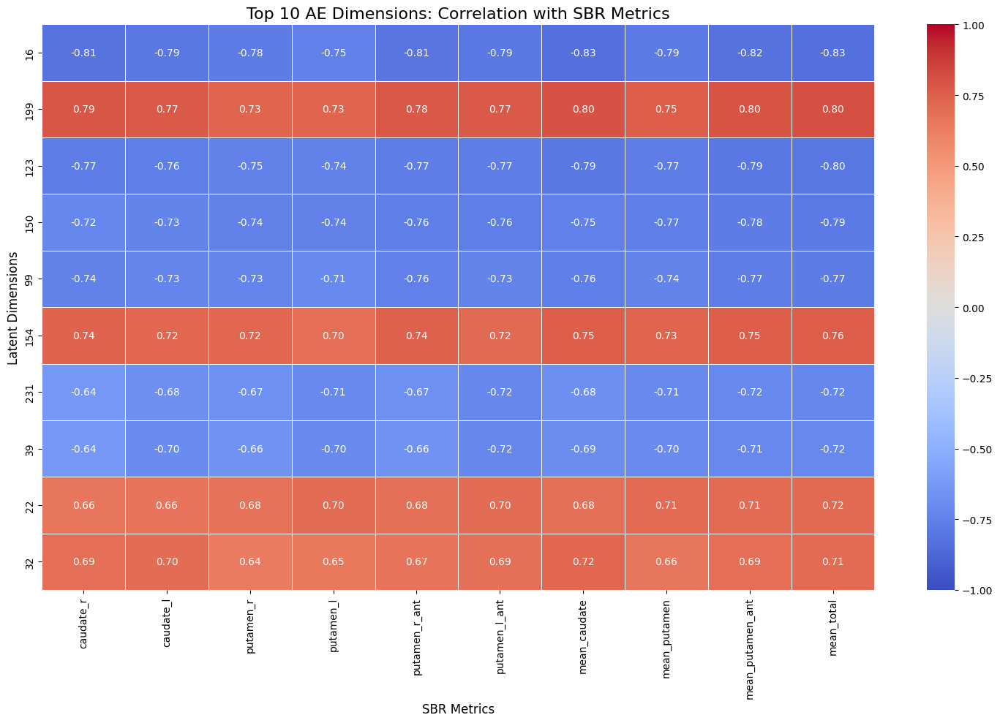


Analyzing Variational Autoencoder (VAE) dimensions:

Top 10 vae_mu dimensions by correlation with SBR:
  Dimension 47: Mean Abs. Corr = 0.7735
  Dimension 123: Mean Abs. Corr = 0.7637
  Dimension 190: Mean Abs. Corr = 0.6346
  Dimension 219: Mean Abs. Corr = 0.6313
  Dimension 186: Mean Abs. Corr = 0.6261
  Dimension 25: Mean Abs. Corr = 0.5966
  Dimension 34: Mean Abs. Corr = 0.5768
  Dimension 43: Mean Abs. Corr = 0.5702
  Dimension 142: Mean Abs. Corr = 0.5621
  Dimension 201: Mean Abs. Corr = 0.5564


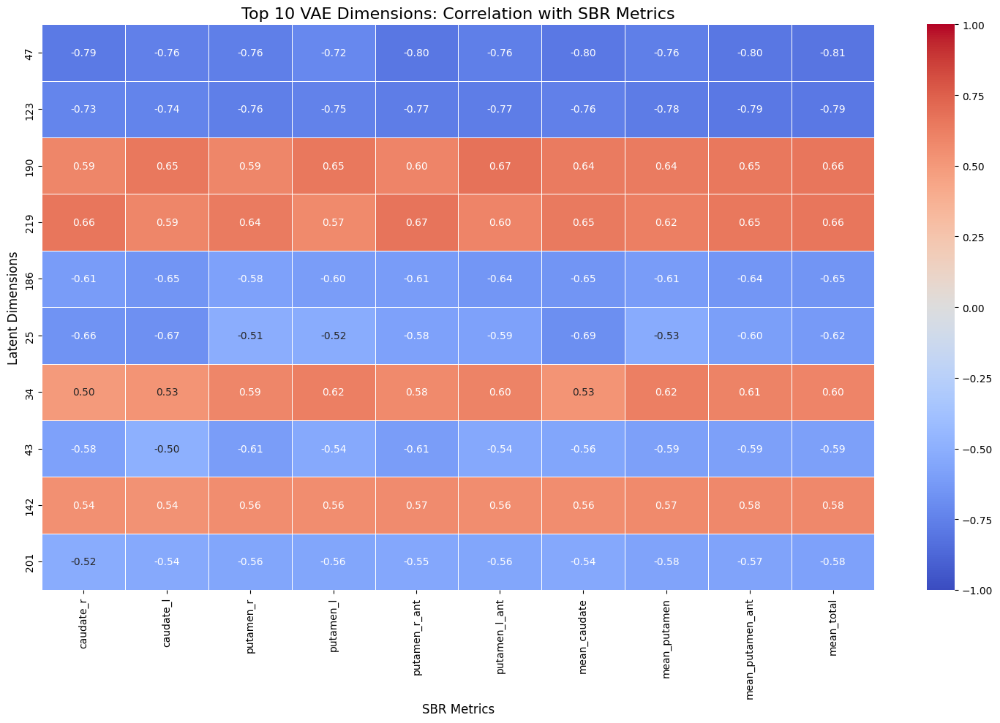


Top dimensions in AE for specific SBR metrics:

  caudate_r:
    Dimension 16: Corr = -0.8144
    Dimension 199: Corr = 0.7879
    Dimension 123: Corr = -0.7692

  caudate_l:
    Dimension 16: Corr = -0.7932
    Dimension 199: Corr = 0.7662
    Dimension 123: Corr = -0.7631

  putamen_r:
    Dimension 16: Corr = -0.7765
    Dimension 123: Corr = -0.7477
    Dimension 150: Corr = -0.7441

  putamen_l:
    Dimension 16: Corr = -0.7550
    Dimension 150: Corr = -0.7450
    Dimension 123: Corr = -0.7432

  putamen_r_ant:
    Dimension 16: Corr = -0.8083
    Dimension 199: Corr = 0.7769
    Dimension 123: Corr = -0.7700

  putamen_l_ant:
    Dimension 16: Corr = -0.7940
    Dimension 199: Corr = 0.7723
    Dimension 123: Corr = -0.7674

  mean_caudate:
    Dimension 16: Corr = -0.8285
    Dimension 199: Corr = 0.8009
    Dimension 123: Corr = -0.7896

  mean_putamen:
    Dimension 16: Corr = -0.7871
    Dimension 123: Corr = -0.7661
    Dimension 150: Corr = -0.7652

  mean_putamen_ant:
  

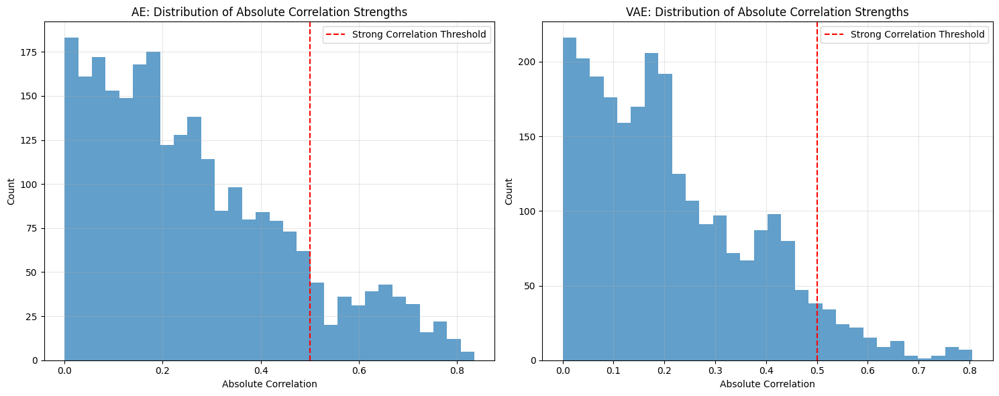

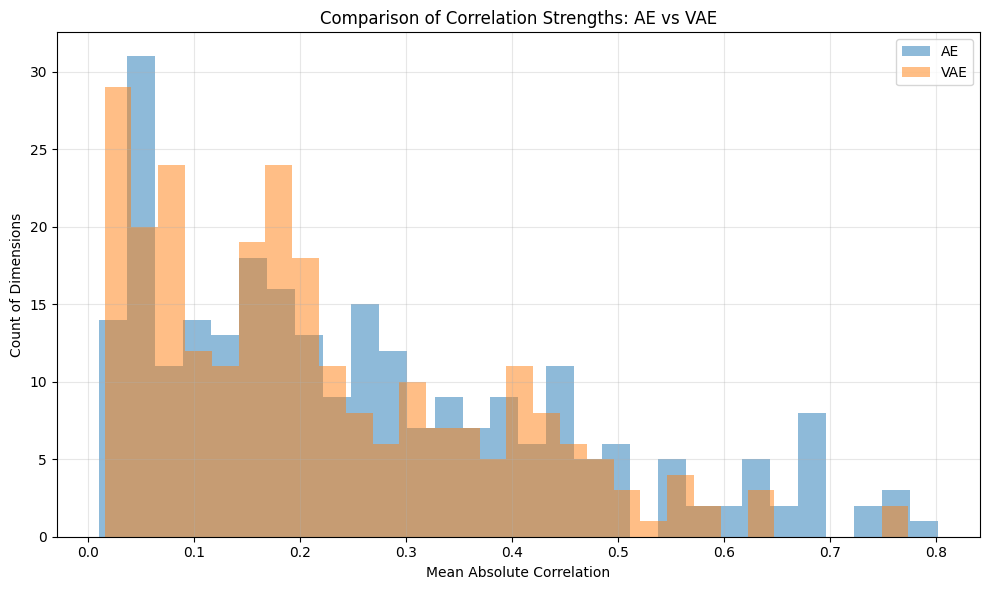


Saved correlation results to 'sbr_correlation_results.pkl'


In [43]:
# Cell 31: Analyzing Correlations Between Latent Dimensions and SBR Metrics
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
import gc

# Load the matched data
try:
    matched_df = pd.read_pickle('latent_sbr_matched_data.pkl')
    print(f"Loaded matched data with {len(matched_df)} entries")
except:
    print("Error loading matched data! Please run the previous cell first.")
    raise ValueError("Missing matched data file")

# Define SBR metrics to analyze
sbr_metrics = [
    'caudate_r', 'caudate_l', 
    'putamen_r', 'putamen_l',
    'putamen_r_ant', 'putamen_l_ant',
    'mean_caudate', 'mean_putamen', 'mean_putamen_ant', 'mean_total'
]

# Function to compute correlations between latent dimensions and SBR metrics
def compute_correlations(latent_type, metric_names):
    """
    Compute correlations between each latent dimension and SBR metrics.
    
    Parameters:
        latent_type: 'ae_latent' or 'vae_mu'
        metric_names: List of SBR metrics to analyze
        
    Returns:
        DataFrame with correlation values
    """
    print(f"Computing correlations for {latent_type}...")
    
    # Get the number of dimensions in the latent space
    first_latent = matched_df.iloc[0][latent_type]
    n_dims = len(first_latent)
    
    # Initialize correlation matrix
    corr_matrix = np.zeros((n_dims, len(metric_names)))
    p_values = np.zeros((n_dims, len(metric_names)))
    
    # Extract all latent vectors as a numpy array
    latent_vecs = np.array([row[latent_type] for _, row in matched_df.iterrows()])
    
    # Compute correlation for each dimension and SBR metric
    for dim in tqdm(range(n_dims), desc=f"Analyzing {n_dims} dimensions"):
        dim_values = latent_vecs[:, dim]
        
        for j, metric in enumerate(metric_names):
            # Extract SBR metric values
            sbr_values = matched_df[metric].values
            
            # Remove NaNs
            valid_mask = ~np.isnan(sbr_values)
            dim_valid = dim_values[valid_mask]
            sbr_valid = sbr_values[valid_mask]
            
            if len(dim_valid) > 5:  # Require at least 5 valid samples
                # Compute Pearson correlation
                corr, p_val = np.corrcoef(dim_valid, sbr_valid)[0, 1], None
                if np.isnan(corr):
                    corr = 0
                corr_matrix[dim, j] = corr
    
    # Create DataFrame for results
    corr_df = pd.DataFrame(corr_matrix, columns=metric_names)
    
    return corr_df

# Compute correlations for both AE and VAE
ae_corr_df = compute_correlations('ae_latent', sbr_metrics)
vae_corr_df = compute_correlations('vae_mu', sbr_metrics)

# Function to identify and visualize top correlated dimensions
def visualize_top_correlations(corr_df, latent_type, n_top=10):
    """
    Find and visualize the dimensions with highest absolute correlation.
    
    Parameters:
        corr_df: DataFrame with correlation values
        latent_type: 'ae_latent' or 'vae_mu'
        n_top: Number of top dimensions to show
    """
    # Calculate the absolute correlation across all SBR metrics
    corr_df['mean_abs_corr'] = corr_df.abs().mean(axis=1)
    
    # Sort by mean absolute correlation
    top_dims = corr_df.sort_values('mean_abs_corr', ascending=False).index[:n_top]
    
    print(f"\nTop {n_top} {latent_type} dimensions by correlation with SBR:")
    for i, dim in enumerate(top_dims):
        print(f"  Dimension {dim}: Mean Abs. Corr = {corr_df.loc[dim, 'mean_abs_corr']:.4f}")
    
    # Visualize correlations for top dimensions
    plt.figure(figsize=(15, 10))
    
    # Extract correlation values for the top dimensions
    top_corr = corr_df.loc[top_dims, sbr_metrics]
    
    # Create the heatmap
    sns.heatmap(top_corr, annot=True, cmap='coolwarm', vmin=-1, vmax=1, center=0,
                fmt='.2f', linewidths=.5)
    plt.title(f'Top {n_top} {latent_type.split("_")[0].upper()} Dimensions: Correlation with SBR Metrics', fontsize=16)
    plt.xlabel('SBR Metrics', fontsize=12)
    plt.ylabel('Latent Dimensions', fontsize=12)
    plt.tight_layout()
    plt.show()
    
    return top_dims, corr_df

# Visualize top correlated dimensions for both models
print("\nAnalyzing Autoencoder (AE) dimensions:")
ae_top_dims, ae_corr_with_mean = visualize_top_correlations(ae_corr_df, 'ae_latent')

print("\nAnalyzing Variational Autoencoder (VAE) dimensions:")
vae_top_dims, vae_corr_with_mean = visualize_top_correlations(vae_corr_df, 'vae_mu')

# Find dimensions with strong correlations for specific SBR metrics
def analyze_metric_specific_dimensions(corr_df, latent_type):
    """
    Identify dimensions that are specifically correlated with individual SBR metrics.
    """
    print(f"\nTop dimensions in {latent_type.split('_')[0].upper()} for specific SBR metrics:")
    
    for metric in sbr_metrics:
        # Sort dimensions by absolute correlation for this metric
        abs_corr = corr_df[metric].abs()
        top_dims = abs_corr.sort_values(ascending=False).index[:3]
        
        print(f"\n  {metric}:")
        for dim in top_dims:
            corr_val = corr_df.loc[dim, metric]
            print(f"    Dimension {dim}: Corr = {corr_val:.4f}")

# Analyze metric-specific dimensions
analyze_metric_specific_dimensions(ae_corr_df, 'ae_latent')
analyze_metric_specific_dimensions(vae_corr_df, 'vae_mu')

# Distribution of correlation strengths
plt.figure(figsize=(15, 6))

plt.subplot(1, 2, 1)
abs_corrs = ae_corr_df[sbr_metrics].abs().values.flatten()
plt.hist(abs_corrs, bins=30, alpha=0.7)
plt.axvline(x=0.5, color='r', linestyle='--', label='Strong Correlation Threshold')
plt.title('AE: Distribution of Absolute Correlation Strengths')
plt.xlabel('Absolute Correlation')
plt.ylabel('Count')
plt.grid(alpha=0.3)
plt.legend()

plt.subplot(1, 2, 2)
abs_corrs = vae_corr_df[sbr_metrics].abs().values.flatten()
plt.hist(abs_corrs, bins=30, alpha=0.7)
plt.axvline(x=0.5, color='r', linestyle='--', label='Strong Correlation Threshold')
plt.title('VAE: Distribution of Absolute Correlation Strengths')
plt.xlabel('Absolute Correlation')
plt.ylabel('Count')
plt.grid(alpha=0.3)
plt.legend()

plt.tight_layout()
plt.show()

# Compare the distributions between AE and VAE
plt.figure(figsize=(10, 6))
plt.hist(ae_corr_with_mean['mean_abs_corr'], bins=30, alpha=0.5, label='AE')
plt.hist(vae_corr_with_mean['mean_abs_corr'], bins=30, alpha=0.5, label='VAE')
plt.title('Comparison of Correlation Strengths: AE vs VAE')
plt.xlabel('Mean Absolute Correlation')
plt.ylabel('Count of Dimensions')
plt.grid(alpha=0.3)
plt.legend()
plt.tight_layout()
plt.show()

# Save results for use in subsequent cells
results = {
    'ae_corr_df': ae_corr_df,
    'vae_corr_df': vae_corr_df,
    'ae_top_dims': ae_top_dims,
    'vae_top_dims': vae_top_dims,
    'sbr_metrics': sbr_metrics
}

import pickle
with open('sbr_correlation_results.pkl', 'wb') as f:
    pickle.dump(results, f)

print("\nSaved correlation results to 'sbr_correlation_results.pkl'")

Loaded matched data with 594 entries
Loaded correlation results successfully

Visualizing mean_total relationships:

Autoencoder (AE) dimensions:


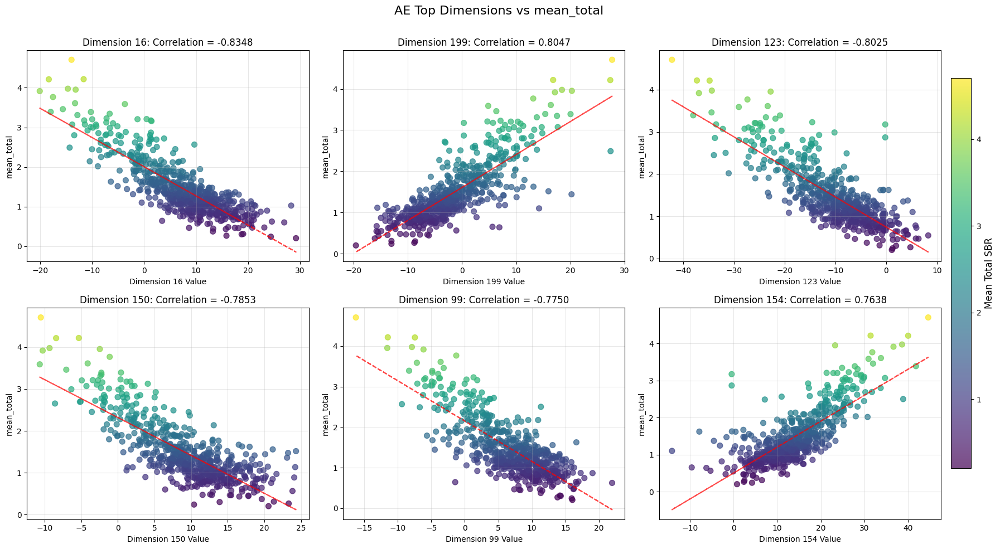


Variational Autoencoder (VAE) dimensions:


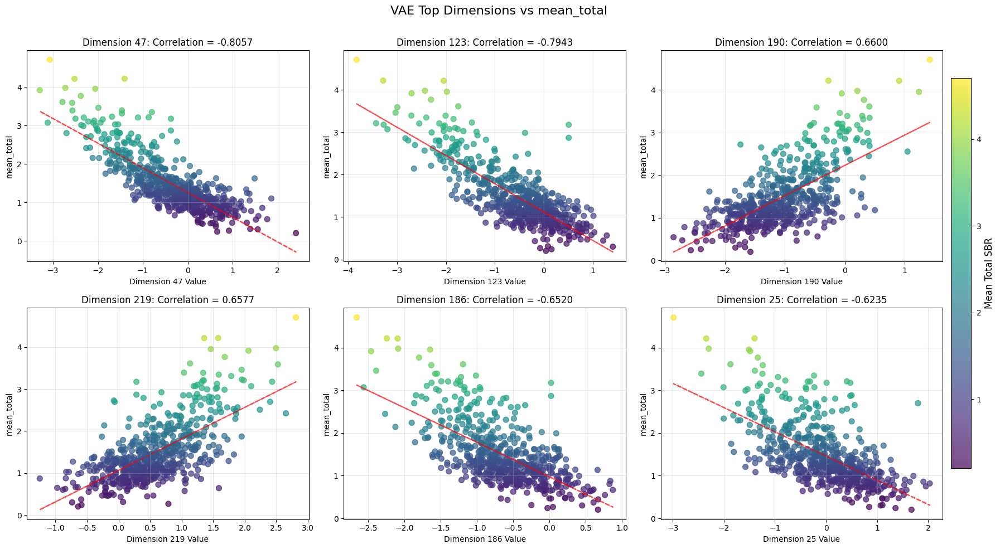


Visualizing mean_caudate relationships:

Autoencoder (AE) dimensions:


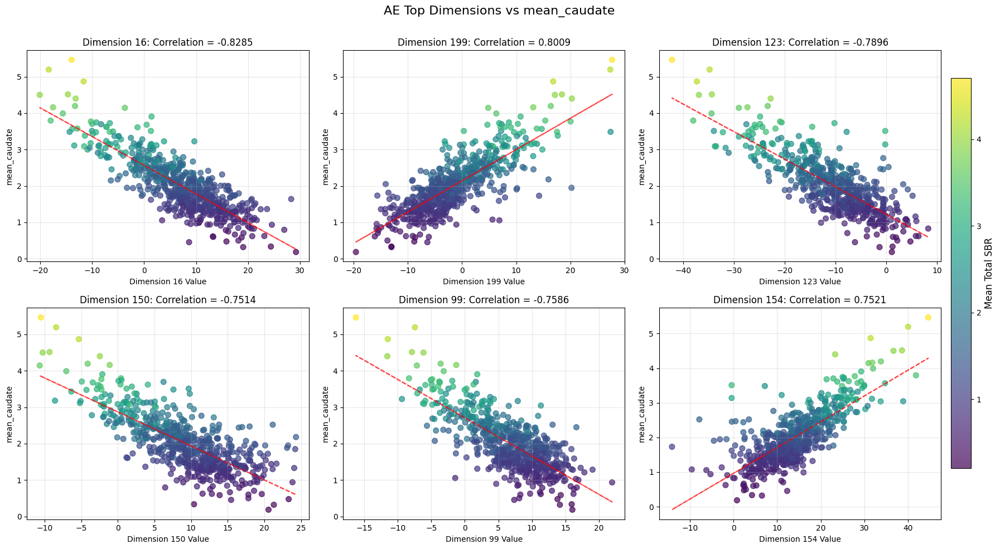


Variational Autoencoder (VAE) dimensions:


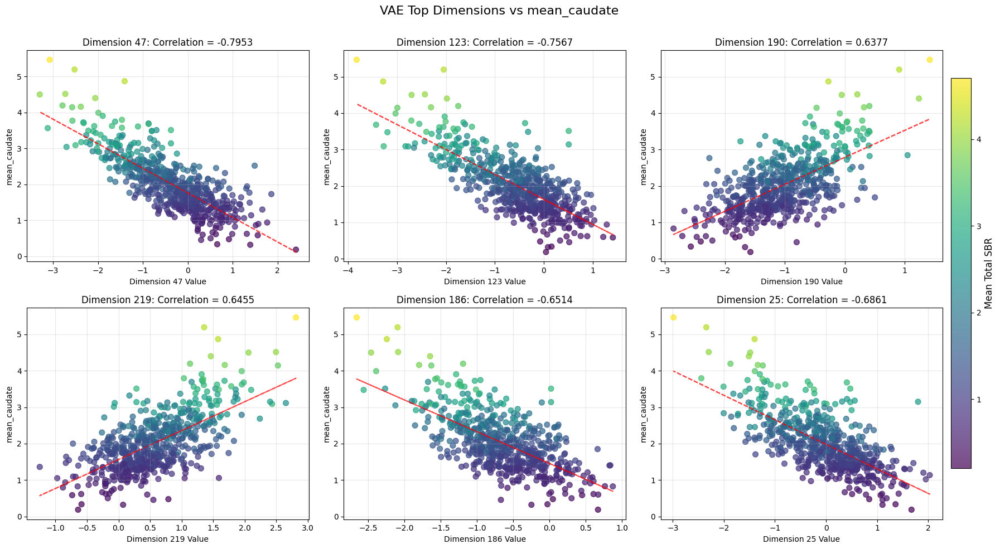


Visualizing mean_putamen relationships:

Autoencoder (AE) dimensions:


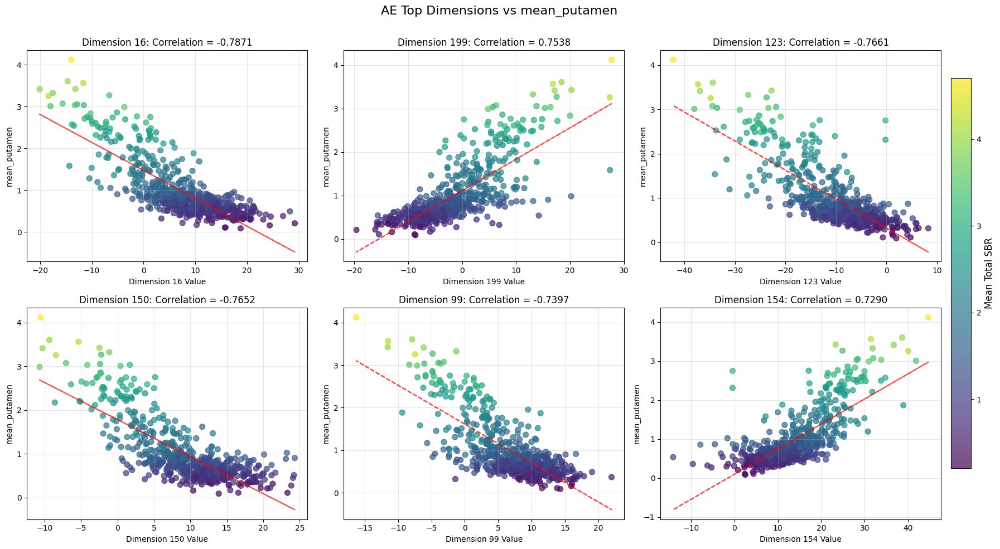


Variational Autoencoder (VAE) dimensions:


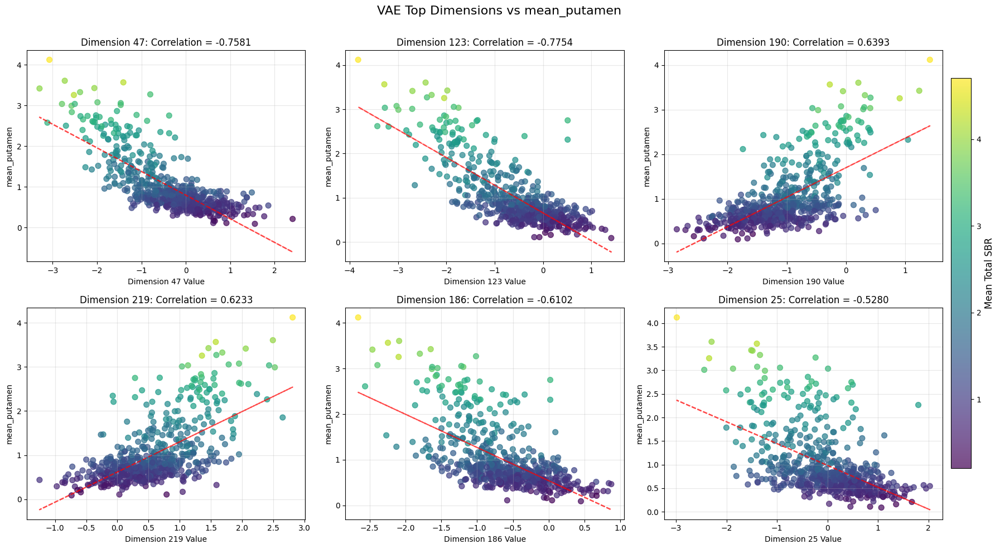


Visualizing latent spaces colored by mean total SBR:
Performing PCA on AE latent space...
Performing t-SNE on AE latent space...


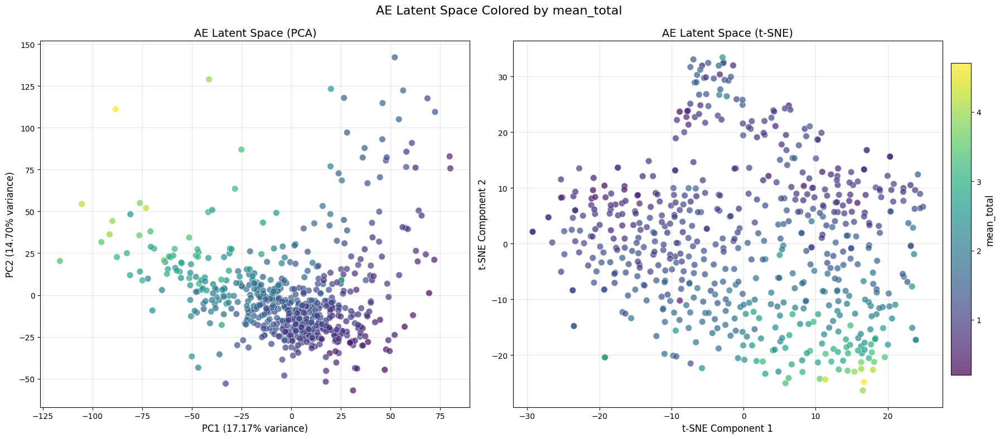

Performing PCA on VAE latent space...
Performing t-SNE on VAE latent space...


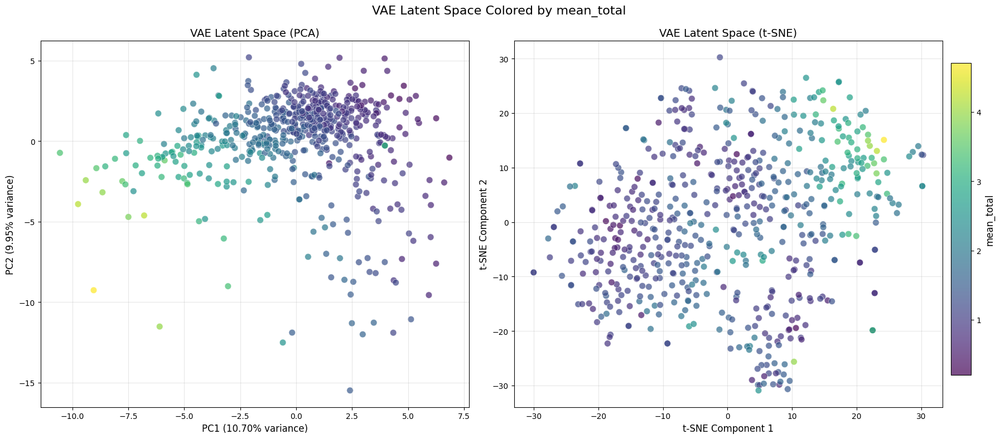


Analyzing dimensions by SBR ranges:


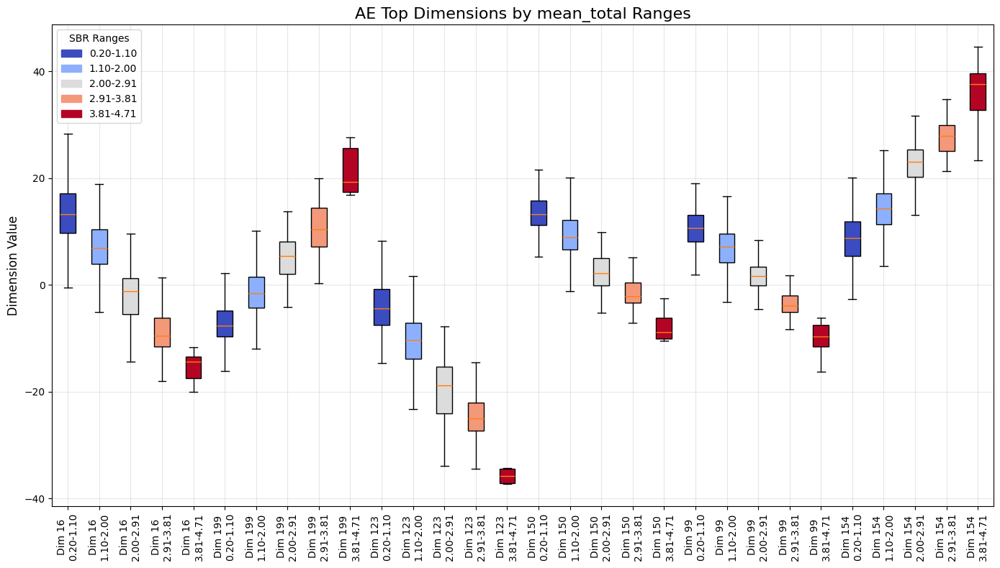

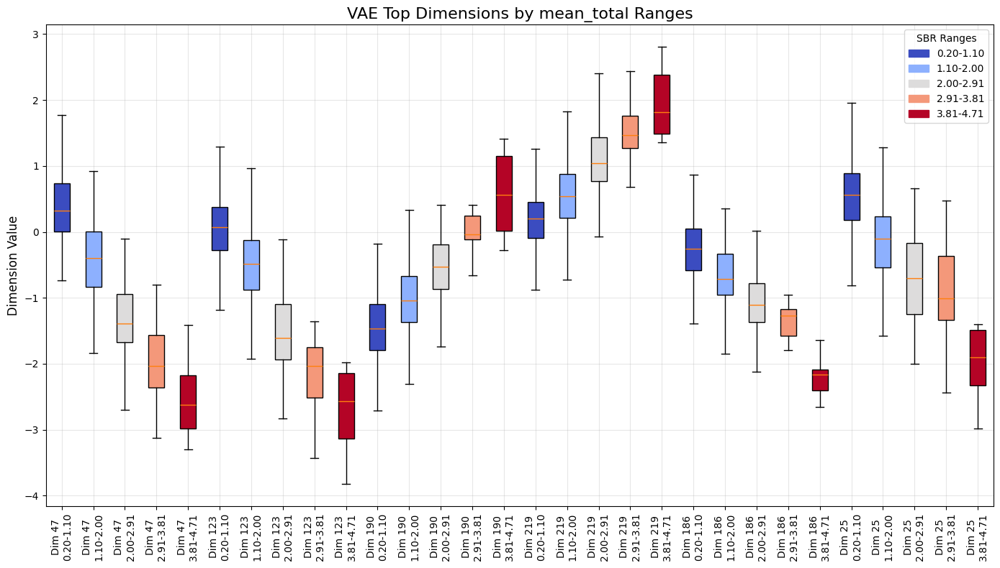


Visualizing top dimensions by group and SBR:


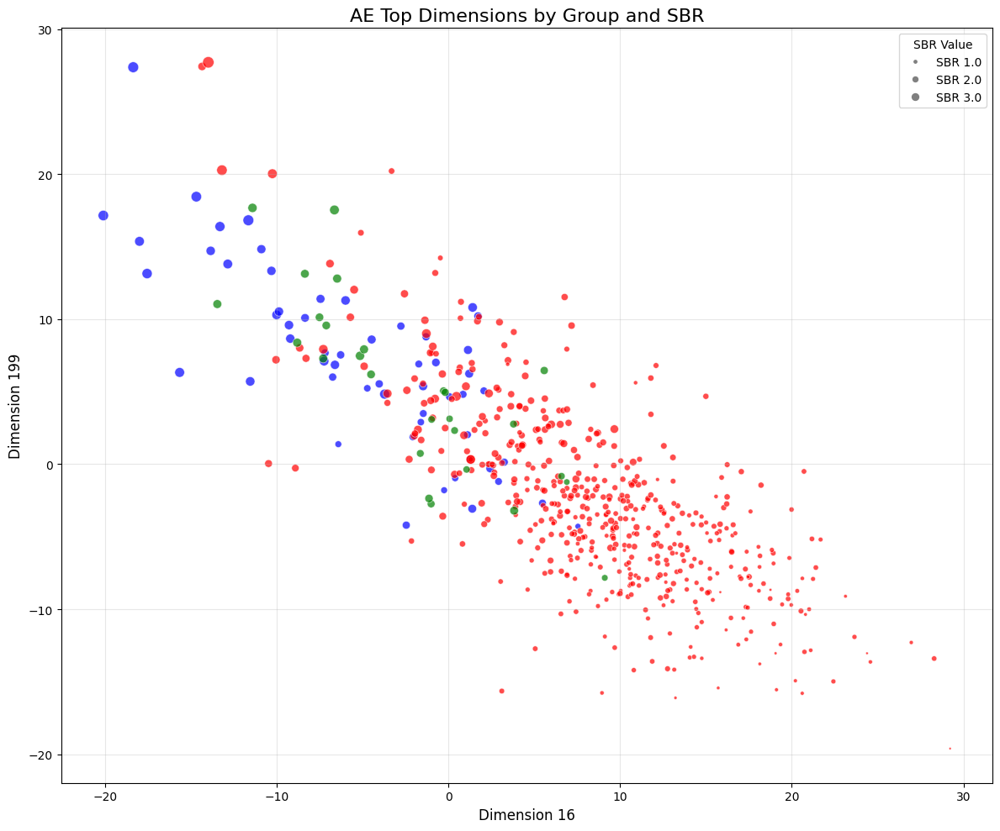

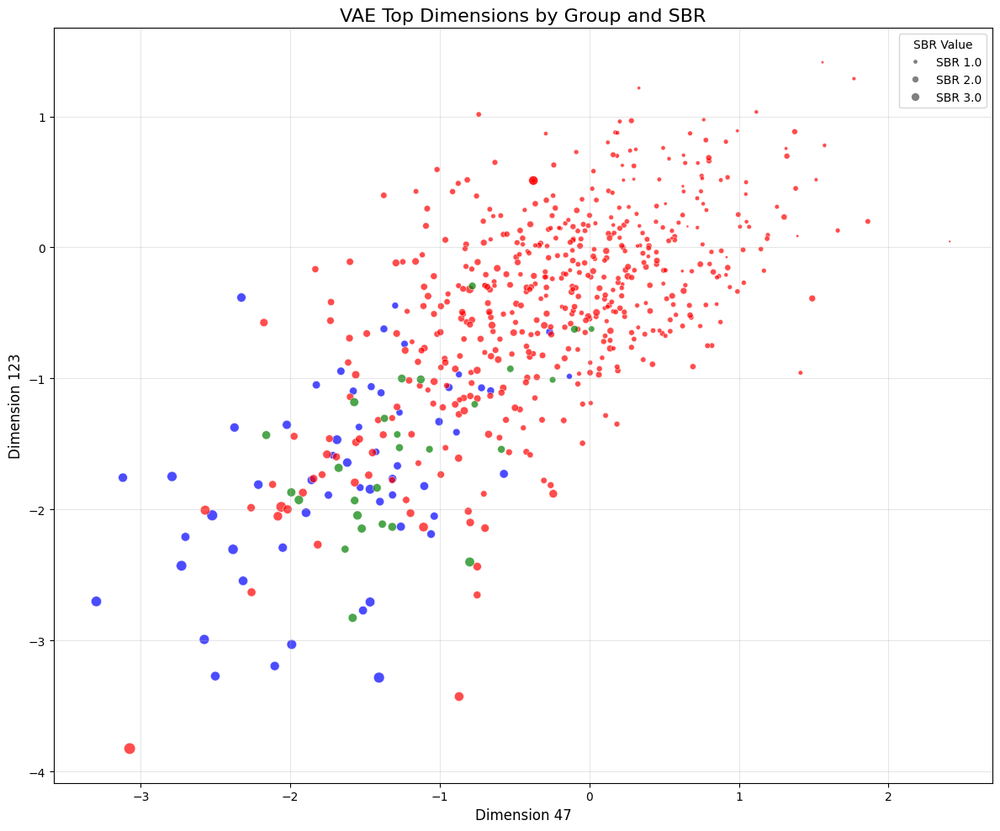

In [44]:
# Cell 32: Visualizing Top Dimensions and SBR Relationships
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import pickle

# Load the matched data
try:
    matched_df = pd.read_pickle('latent_sbr_matched_data.pkl')
    print(f"Loaded matched data with {len(matched_df)} entries")
except:
    print("Error loading matched data! Please run the previous cells first.")
    raise ValueError("Missing matched data file")

# Load correlation results
try:
    with open('sbr_correlation_results.pkl', 'rb') as f:
        corr_results = pickle.load(f)
    
    ae_corr_df = corr_results['ae_corr_df']
    vae_corr_df = corr_results['vae_corr_df']
    ae_top_dims = corr_results['ae_top_dims']
    vae_top_dims = corr_results['vae_top_dims']
    sbr_metrics = corr_results['sbr_metrics']
    
    print("Loaded correlation results successfully")
except:
    print("Error loading correlation results! Please run the previous cell first.")
    raise ValueError("Missing correlation results file")

# Extract all latent vectors as numpy arrays
ae_latent_vecs = np.array([row['ae_latent'] for _, row in matched_df.iterrows()])
vae_latent_vecs = np.array([row['vae_mu'] for _, row in matched_df.iterrows()])

# Function to create scatter plots for top dimensions vs SBR metrics
def visualize_dimension_vs_sbr(latent_vecs, top_dims, sbr_metric, model_type):
    """
    Create scatter plots showing the relationship between top latent dimensions and a specific SBR metric.
    
    Parameters:
        latent_vecs: numpy array of latent vectors
        top_dims: list of top dimension indices
        sbr_metric: SBR metric to analyze
        model_type: 'AE' or 'VAE'
    """
    # Get SBR values
    sbr_values = matched_df[sbr_metric].values
    
    # Create figure for scatter plots
    num_plots = min(6, len(top_dims))
    fig, axes = plt.subplots(2, 3, figsize=(18, 10))
    axes = axes.flatten()
    
    # Create scatter plots for top dimensions
    for i in range(num_plots):
        dim = top_dims[i]
        ax = axes[i]
        
        # Extract dimension values and remove NaNs
        dim_values = latent_vecs[:, dim]
        valid_mask = ~np.isnan(sbr_values)
        
        # Create scatter plot
        scatter = ax.scatter(dim_values[valid_mask], sbr_values[valid_mask], 
                             alpha=0.7, c=matched_df.loc[valid_mask, 'mean_total'],
                             cmap='viridis', s=50)
        
        # Calculate correlation
        valid_dim = dim_values[valid_mask]
        valid_sbr = sbr_values[valid_mask]
        corr = np.corrcoef(valid_dim, valid_sbr)[0, 1]
        
        # Add title and labels
        ax.set_title(f'Dimension {dim}: Correlation = {corr:.4f}', fontsize=12)
        ax.set_xlabel(f'Dimension {dim} Value', fontsize=10)
        ax.set_ylabel(sbr_metric, fontsize=10)
        ax.grid(alpha=0.3)
        
        # Add best fit line
        if len(valid_dim) > 1:
            m, b = np.polyfit(valid_dim, valid_sbr, 1)
            ax.plot(valid_dim, m*valid_dim + b, 'r--', alpha=0.7)
    
    # Add colorbar
    cbar_ax = fig.add_axes([0.95, 0.15, 0.02, 0.7])
    cbar = fig.colorbar(scatter, cax=cbar_ax)
    cbar.set_label('Mean Total SBR', fontsize=12)
    
    # Set overall title
    plt.suptitle(f'{model_type} Top Dimensions vs {sbr_metric}', fontsize=16)
    plt.tight_layout(rect=[0, 0, 0.95, 0.95])
    plt.subplots_adjust(top=0.9)
    plt.show()

# Visualize top dimensions for key SBR metrics
for metric in ['mean_total', 'mean_caudate', 'mean_putamen']:
    print(f"\nVisualizing {metric} relationships:")
    
    print("\nAutoencoder (AE) dimensions:")
    visualize_dimension_vs_sbr(ae_latent_vecs, ae_top_dims, metric, 'AE')
    
    print("\nVariational Autoencoder (VAE) dimensions:")
    visualize_dimension_vs_sbr(vae_latent_vecs, vae_top_dims, metric, 'VAE')

# Function to visualize SBR values in latent space using dimensionality reduction
def visualize_latent_space_by_sbr(latent_vecs, model_type, sbr_metric='mean_total'):
    """
    Visualize the latent space colored by SBR values using PCA and t-SNE.
    
    Parameters:
        latent_vecs: numpy array of latent vectors
        model_type: 'AE' or 'VAE'
        sbr_metric: SBR metric to use for coloring
    """
    # Get SBR values and remove NaNs
    sbr_values = matched_df[sbr_metric].values
    valid_mask = ~np.isnan(sbr_values)
    
    filtered_vecs = latent_vecs[valid_mask]
    filtered_sbr = sbr_values[valid_mask]
    
    # Create figure for both PCA and t-SNE
    fig, axes = plt.subplots(1, 2, figsize=(18, 8))
    
    # PCA
    print(f"Performing PCA on {model_type} latent space...")
    pca = PCA(n_components=2)
    pca_result = pca.fit_transform(filtered_vecs)
    
    scatter = axes[0].scatter(pca_result[:, 0], pca_result[:, 1], 
                              c=filtered_sbr, cmap='viridis', 
                              alpha=0.7, s=70, edgecolors='w', linewidths=0.5)
    
    axes[0].set_title(f'{model_type} Latent Space (PCA)', fontsize=14)
    axes[0].set_xlabel(f'PC1 ({pca.explained_variance_ratio_[0]:.2%} variance)', fontsize=12)
    axes[0].set_ylabel(f'PC2 ({pca.explained_variance_ratio_[1]:.2%} variance)', fontsize=12)
    axes[0].grid(alpha=0.3)
    
    # t-SNE
    print(f"Performing t-SNE on {model_type} latent space...")
    tsne = TSNE(n_components=2, random_state=42, perplexity=min(30, len(filtered_vecs)-1))
    tsne_result = tsne.fit_transform(filtered_vecs)
    
    scatter = axes[1].scatter(tsne_result[:, 0], tsne_result[:, 1], 
                              c=filtered_sbr, cmap='viridis', 
                              alpha=0.7, s=70, edgecolors='w', linewidths=0.5)
    
    axes[1].set_title(f'{model_type} Latent Space (t-SNE)', fontsize=14)
    axes[1].set_xlabel('t-SNE Component 1', fontsize=12)
    axes[1].set_ylabel('t-SNE Component 2', fontsize=12)
    axes[1].grid(alpha=0.3)
    
    # Add colorbar
    cbar_ax = fig.add_axes([0.95, 0.15, 0.02, 0.7])
    cbar = fig.colorbar(scatter, cax=cbar_ax)
    cbar.set_label(sbr_metric, fontsize=12)
    
    # Set overall title
    plt.suptitle(f'{model_type} Latent Space Colored by {sbr_metric}', fontsize=16)
    plt.tight_layout(rect=[0, 0, 0.95, 0.95])
    plt.subplots_adjust(top=0.9)
    plt.show()

# Visualize latent spaces colored by SBR values
print("\nVisualizing latent spaces colored by mean total SBR:")
visualize_latent_space_by_sbr(ae_latent_vecs, 'AE')
visualize_latent_space_by_sbr(vae_latent_vecs, 'VAE')

# Group-level analysis: Show mean dimension values by SBR ranges
def analyze_dimensions_by_sbr_ranges(latent_vecs, top_dims, model_type, sbr_metric='mean_total'):
    """
    Analyze how latent dimension values change across different SBR ranges.
    
    Parameters:
        latent_vecs: numpy array of latent vectors
        top_dims: list of top dimension indices
        model_type: 'AE' or 'VAE'
        sbr_metric: SBR metric to analyze
    """
    # Get SBR values and remove NaNs
    sbr_values = matched_df[sbr_metric].values
    valid_mask = ~np.isnan(sbr_values)
    
    # Create SBR ranges for grouping
    sbr_min, sbr_max = np.min(sbr_values[valid_mask]), np.max(sbr_values[valid_mask])
    sbr_range = sbr_max - sbr_min
    
    # Create bins (5 equal bins)
    bins = np.linspace(sbr_min, sbr_max, 6)
    bin_labels = [f"{bins[i]:.2f}-{bins[i+1]:.2f}" for i in range(5)]
    
    # Assign each sample to a bin
    binned_data = pd.DataFrame({
        'sbr': sbr_values[valid_mask],
        'bin': pd.cut(sbr_values[valid_mask], bins=bins, labels=bin_labels, include_lowest=True)
    })
    
    # Add latent dimension values for top dimensions
    for i, dim in enumerate(top_dims[:6]):
        binned_data[f'dim_{dim}'] = latent_vecs[valid_mask, dim]
    
    # Create the plot
    fig, ax = plt.subplots(figsize=(14, 8))
    
    # Reshape data for boxplot
    plot_data = []
    dim_names = []
    
    for i, dim in enumerate(top_dims[:6]):
        for bin_label in bin_labels:
            bin_values = binned_data.loc[binned_data['bin'] == bin_label, f'dim_{dim}']
            plot_data.append(bin_values)
            dim_names.append(f"Dim {dim}\n{bin_label}")
    
    # Create a custom colormap that transitions from red to blue
    bin_colors = plt.cm.coolwarm(np.linspace(0, 1, len(bin_labels)))
    colors = []
    for i in range(len(top_dims[:6])):
        colors.extend(bin_colors)
    
    # Create boxplot
    boxplot = ax.boxplot(plot_data, patch_artist=True, showfliers=False)
    
    # Apply colors
    for patch, color in zip(boxplot['boxes'], colors):
        patch.set_facecolor(color)
    
    # Add labels and title
    ax.set_xticklabels(dim_names, rotation=90)
    ax.set_ylabel('Dimension Value', fontsize=12)
    ax.set_title(f'{model_type} Top Dimensions by {sbr_metric} Ranges', fontsize=16)
    ax.grid(alpha=0.3)
    
    # Add legend
    import matplotlib.patches as mpatches
    legend_patches = [mpatches.Patch(color=bin_colors[i], label=bin_labels[i]) 
                     for i in range(len(bin_labels))]
    ax.legend(handles=legend_patches, title='SBR Ranges', loc='best')
    
    plt.tight_layout()
    plt.show()

# Analyze dimensions by SBR ranges
print("\nAnalyzing dimensions by SBR ranges:")
analyze_dimensions_by_sbr_ranges(ae_latent_vecs, ae_top_dims, 'AE')
analyze_dimensions_by_sbr_ranges(vae_latent_vecs, vae_top_dims, 'VAE')

# Create a more targeted visualization of individual dimensions vs group and SBR
def visualize_top_dims_by_group_and_sbr(latent_vecs, top_dims, model_type):
    """
    Create scatter plots showing how top dimensions relate to both group and SBR.
    """
    # Use just the top 2 dimensions for simplicity
    dim1, dim2 = top_dims[:2]
    
    # Extract dimension values
    x_values = latent_vecs[:, dim1]
    y_values = latent_vecs[:, dim2]
    
    # Get groups and SBR values
    groups = matched_df['group'].values
    sbr_values = matched_df['mean_total'].values
    valid_mask = ~np.isnan(sbr_values)
    
    # Create scatter plot
    plt.figure(figsize=(12, 10))
    
    # Define colors by group
    group_colors = {'PD': 'red', 'Control': 'blue', 'SWEDD': 'green'}
    default_color = 'gray'
    
    # Create scatter with group colors and sizes based on SBR
    for group in np.unique(groups):
        group_mask = (groups == group) & valid_mask
        plt.scatter(
            x_values[group_mask], 
            y_values[group_mask],
            c=[group_colors.get(group, default_color)],
            s=sbr_values[group_mask] * 20,  # Size proportional to SBR value
            alpha=0.7,
            label=group,
            edgecolors='white',
            linewidths=0.5
        )
    
    # Add labels and title
    plt.xlabel(f'Dimension {dim1}', fontsize=12)
    plt.ylabel(f'Dimension {dim2}', fontsize=12)
    plt.title(f'{model_type} Top Dimensions by Group and SBR', fontsize=16)
    plt.grid(alpha=0.3)
    plt.legend(title='Patient Group')
    
    # Add a size reference for SBR values
    from matplotlib.lines import Line2D
    sbr_handles = [
        Line2D([0], [0], marker='o', color='w', markerfacecolor='gray', 
               markersize=np.sqrt(sbr * 20), label=f'SBR {sbr:.1f}')
        for sbr in [1.0, 2.0, 3.0]
    ]
    plt.legend(handles=sbr_handles, title='SBR Value', loc='upper right')
    
    plt.tight_layout()
    plt.show()

# Visualize top dimensions by group and SBR
print("\nVisualizing top dimensions by group and SBR:")
visualize_top_dims_by_group_and_sbr(ae_latent_vecs, ae_top_dims, 'AE')
visualize_top_dims_by_group_and_sbr(vae_latent_vecs, vae_top_dims, 'VAE')

Loaded matched data with 594 entries
Loaded correlation results successfully

Finding optimal dimensions for AE - mean_total:
AE: 5 dimensions, CV RMSE: 0.2264
AE: 10 dimensions, CV RMSE: 0.2013
AE: 15 dimensions, CV RMSE: 0.2073
AE: 20 dimensions, CV RMSE: 0.2069
AE: 25 dimensions, CV RMSE: 0.1942
AE: 30 dimensions, CV RMSE: 0.1896
AE: 35 dimensions, CV RMSE: 0.1884
AE: 40 dimensions, CV RMSE: 0.1814
AE: 45 dimensions, CV RMSE: 0.1838
AE: 50 dimensions, CV RMSE: 0.1821
AE: 55 dimensions, CV RMSE: 0.1824
AE: 60 dimensions, CV RMSE: 0.1748
AE: 65 dimensions, CV RMSE: 0.1643
AE: 70 dimensions, CV RMSE: 0.1606
AE: 75 dimensions, CV RMSE: 0.1612
AE: 80 dimensions, CV RMSE: 0.1614
AE: 85 dimensions, CV RMSE: 0.1605
AE: 90 dimensions, CV RMSE: 0.1629
AE: 95 dimensions, CV RMSE: 0.1645
AE: 100 dimensions, CV RMSE: 0.1661


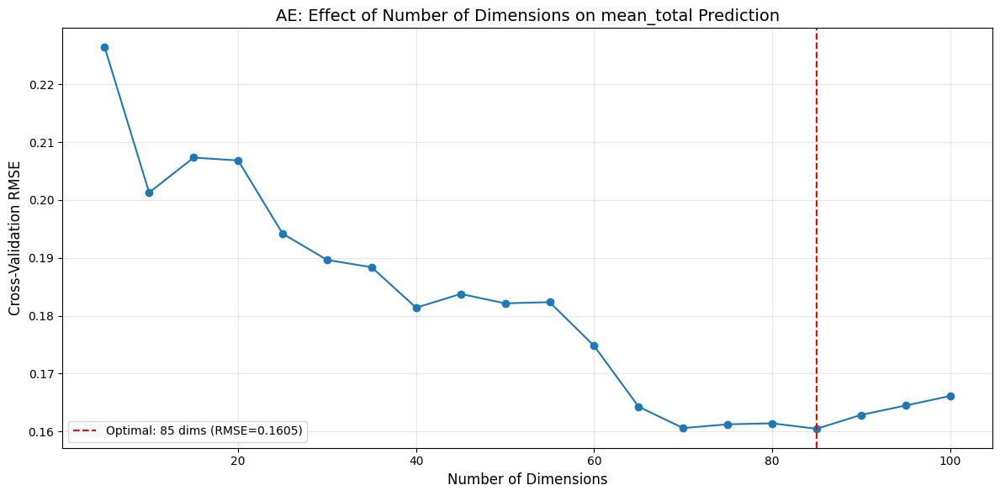


Finding optimal dimensions for AE - mean_caudate:
AE: 5 dimensions, CV RMSE: 0.3004
AE: 10 dimensions, CV RMSE: 0.2626
AE: 15 dimensions, CV RMSE: 0.2614
AE: 20 dimensions, CV RMSE: 0.2638
AE: 25 dimensions, CV RMSE: 0.2682
AE: 30 dimensions, CV RMSE: 0.2584
AE: 35 dimensions, CV RMSE: 0.2546
AE: 40 dimensions, CV RMSE: 0.2501
AE: 45 dimensions, CV RMSE: 0.2548
AE: 50 dimensions, CV RMSE: 0.2467
AE: 55 dimensions, CV RMSE: 0.2478
AE: 60 dimensions, CV RMSE: 0.2434
AE: 65 dimensions, CV RMSE: 0.2459
AE: 70 dimensions, CV RMSE: 0.2418
AE: 75 dimensions, CV RMSE: 0.2461
AE: 80 dimensions, CV RMSE: 0.2444
AE: 85 dimensions, CV RMSE: 0.2385
AE: 90 dimensions, CV RMSE: 0.2392
AE: 95 dimensions, CV RMSE: 0.2432
AE: 100 dimensions, CV RMSE: 0.2387


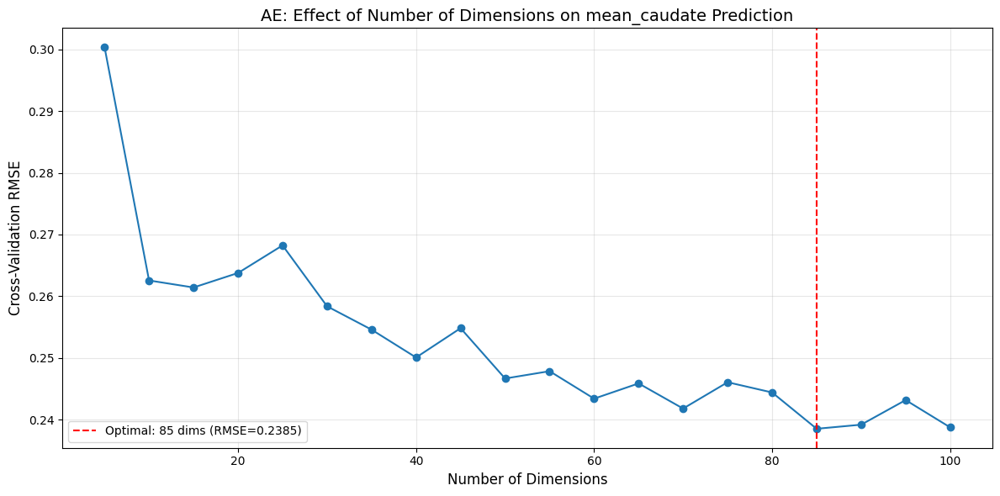


Finding optimal dimensions for AE - mean_putamen:
AE: 5 dimensions, CV RMSE: 0.2925
AE: 10 dimensions, CV RMSE: 0.2722
AE: 15 dimensions, CV RMSE: 0.2713
AE: 20 dimensions, CV RMSE: 0.2740
AE: 25 dimensions, CV RMSE: 0.2356
AE: 30 dimensions, CV RMSE: 0.2346
AE: 35 dimensions, CV RMSE: 0.2289
AE: 40 dimensions, CV RMSE: 0.2225
AE: 45 dimensions, CV RMSE: 0.2213
AE: 50 dimensions, CV RMSE: 0.2178
AE: 55 dimensions, CV RMSE: 0.2167
AE: 60 dimensions, CV RMSE: 0.2080
AE: 65 dimensions, CV RMSE: 0.2018
AE: 70 dimensions, CV RMSE: 0.2034
AE: 75 dimensions, CV RMSE: 0.2045
AE: 80 dimensions, CV RMSE: 0.1989
AE: 85 dimensions, CV RMSE: 0.2011
AE: 90 dimensions, CV RMSE: 0.2018
AE: 95 dimensions, CV RMSE: 0.2016
AE: 100 dimensions, CV RMSE: 0.2018


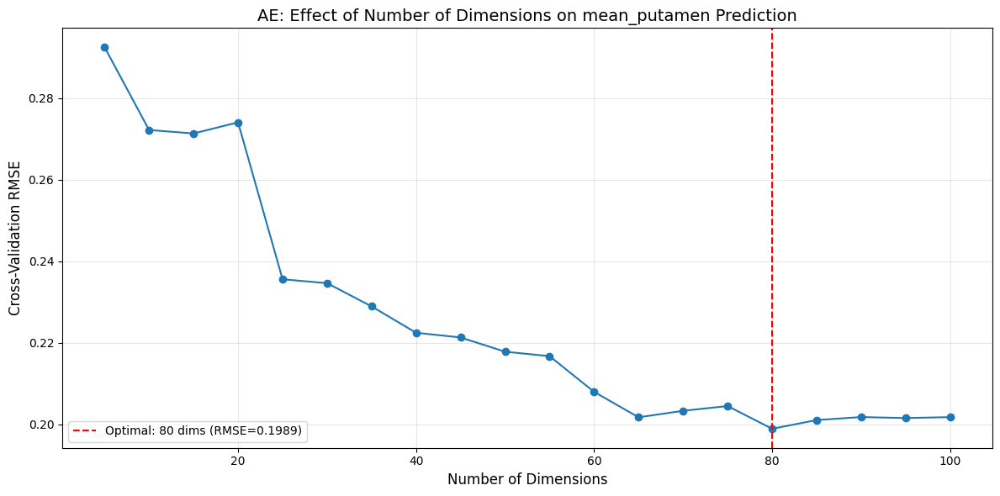


Finding optimal dimensions for VAE - mean_total:
VAE: 5 dimensions, CV RMSE: 0.2852
VAE: 10 dimensions, CV RMSE: 0.2504
VAE: 15 dimensions, CV RMSE: 0.2352
VAE: 20 dimensions, CV RMSE: 0.2304
VAE: 25 dimensions, CV RMSE: 0.2206
VAE: 30 dimensions, CV RMSE: 0.2166
VAE: 35 dimensions, CV RMSE: 0.1962
VAE: 40 dimensions, CV RMSE: 0.1902
VAE: 45 dimensions, CV RMSE: 0.1818
VAE: 50 dimensions, CV RMSE: 0.1765
VAE: 55 dimensions, CV RMSE: 0.1644
VAE: 60 dimensions, CV RMSE: 0.1653
VAE: 65 dimensions, CV RMSE: 0.1645
VAE: 70 dimensions, CV RMSE: 0.1659
VAE: 75 dimensions, CV RMSE: 0.1629
VAE: 80 dimensions, CV RMSE: 0.1613
VAE: 85 dimensions, CV RMSE: 0.1626
VAE: 90 dimensions, CV RMSE: 0.1627
VAE: 95 dimensions, CV RMSE: 0.1648
VAE: 100 dimensions, CV RMSE: 0.1681


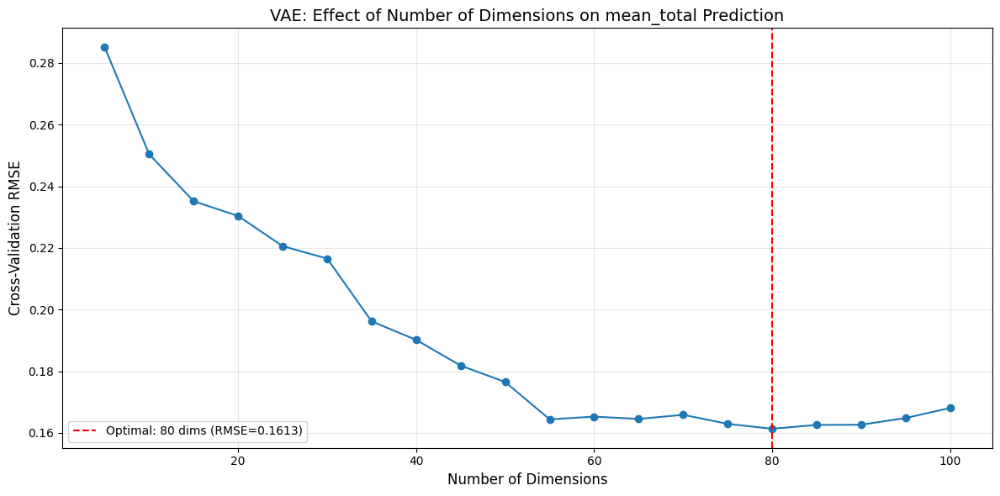


Finding optimal dimensions for VAE - mean_caudate:
VAE: 5 dimensions, CV RMSE: 0.3590
VAE: 10 dimensions, CV RMSE: 0.2951
VAE: 15 dimensions, CV RMSE: 0.2798
VAE: 20 dimensions, CV RMSE: 0.2695
VAE: 25 dimensions, CV RMSE: 0.2580
VAE: 30 dimensions, CV RMSE: 0.2403
VAE: 35 dimensions, CV RMSE: 0.2348
VAE: 40 dimensions, CV RMSE: 0.2223
VAE: 45 dimensions, CV RMSE: 0.2222
VAE: 50 dimensions, CV RMSE: 0.2213
VAE: 55 dimensions, CV RMSE: 0.2070
VAE: 60 dimensions, CV RMSE: 0.2079
VAE: 65 dimensions, CV RMSE: 0.2085
VAE: 70 dimensions, CV RMSE: 0.2063
VAE: 75 dimensions, CV RMSE: 0.2038
VAE: 80 dimensions, CV RMSE: 0.2057
VAE: 85 dimensions, CV RMSE: 0.2075
VAE: 90 dimensions, CV RMSE: 0.2093
VAE: 95 dimensions, CV RMSE: 0.2088
VAE: 100 dimensions, CV RMSE: 0.2156


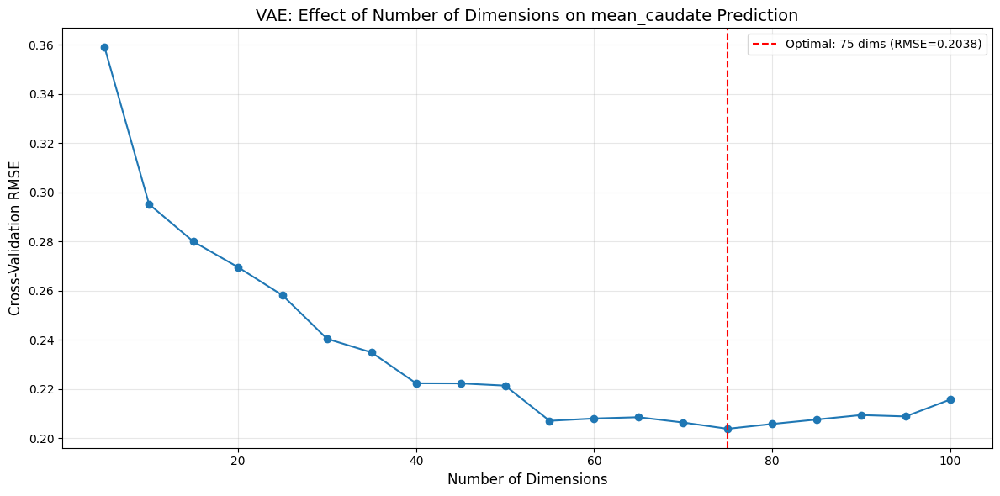


Finding optimal dimensions for VAE - mean_putamen:
VAE: 5 dimensions, CV RMSE: 0.3182
VAE: 10 dimensions, CV RMSE: 0.2723
VAE: 15 dimensions, CV RMSE: 0.2661
VAE: 20 dimensions, CV RMSE: 0.2432
VAE: 25 dimensions, CV RMSE: 0.2409
VAE: 30 dimensions, CV RMSE: 0.2364
VAE: 35 dimensions, CV RMSE: 0.2270
VAE: 40 dimensions, CV RMSE: 0.2194
VAE: 45 dimensions, CV RMSE: 0.2110
VAE: 50 dimensions, CV RMSE: 0.2103
VAE: 55 dimensions, CV RMSE: 0.2033
VAE: 60 dimensions, CV RMSE: 0.2050
VAE: 65 dimensions, CV RMSE: 0.1990
VAE: 70 dimensions, CV RMSE: 0.2004
VAE: 75 dimensions, CV RMSE: 0.1984
VAE: 80 dimensions, CV RMSE: 0.1974
VAE: 85 dimensions, CV RMSE: 0.2012
VAE: 90 dimensions, CV RMSE: 0.1987
VAE: 95 dimensions, CV RMSE: 0.1964
VAE: 100 dimensions, CV RMSE: 0.1979


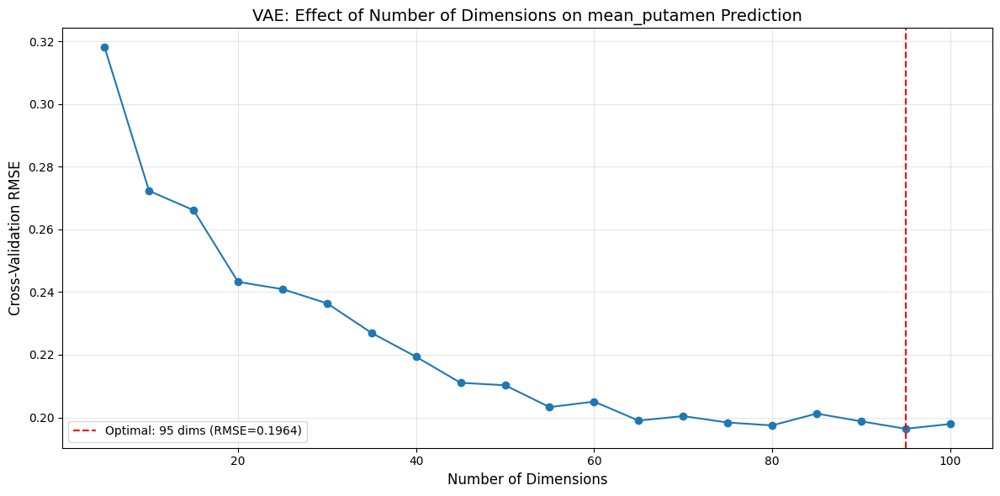


Evaluating models for AE - mean_total:
Evaluating Linear Regression...


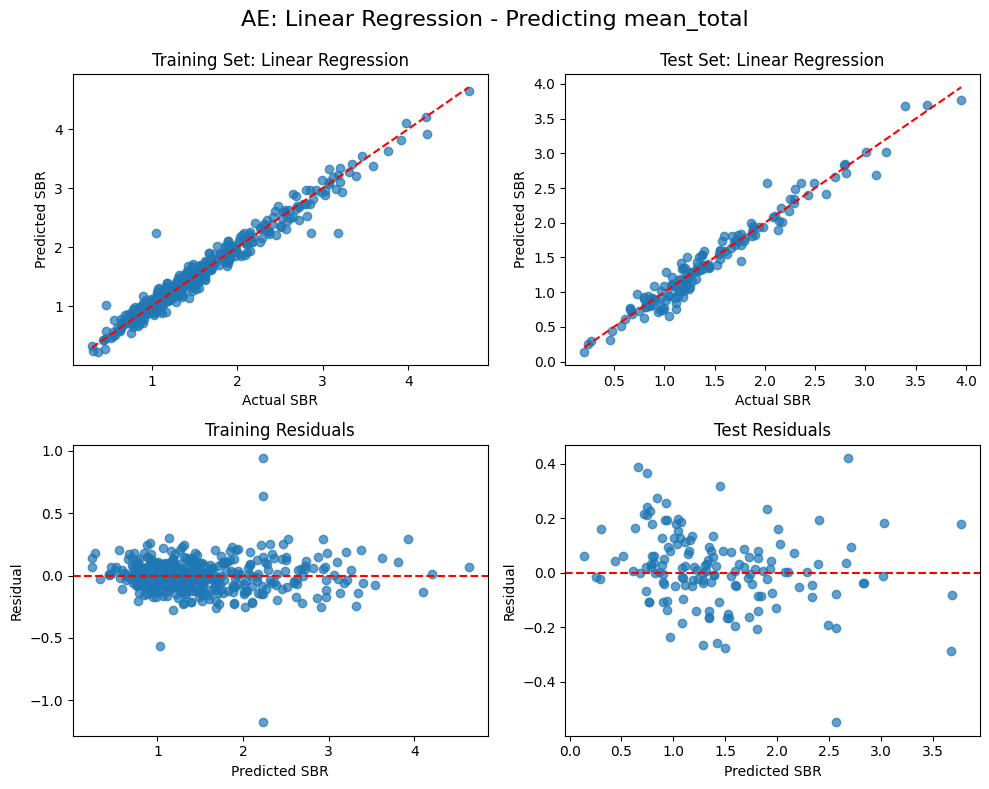

Evaluating Ridge Regression...


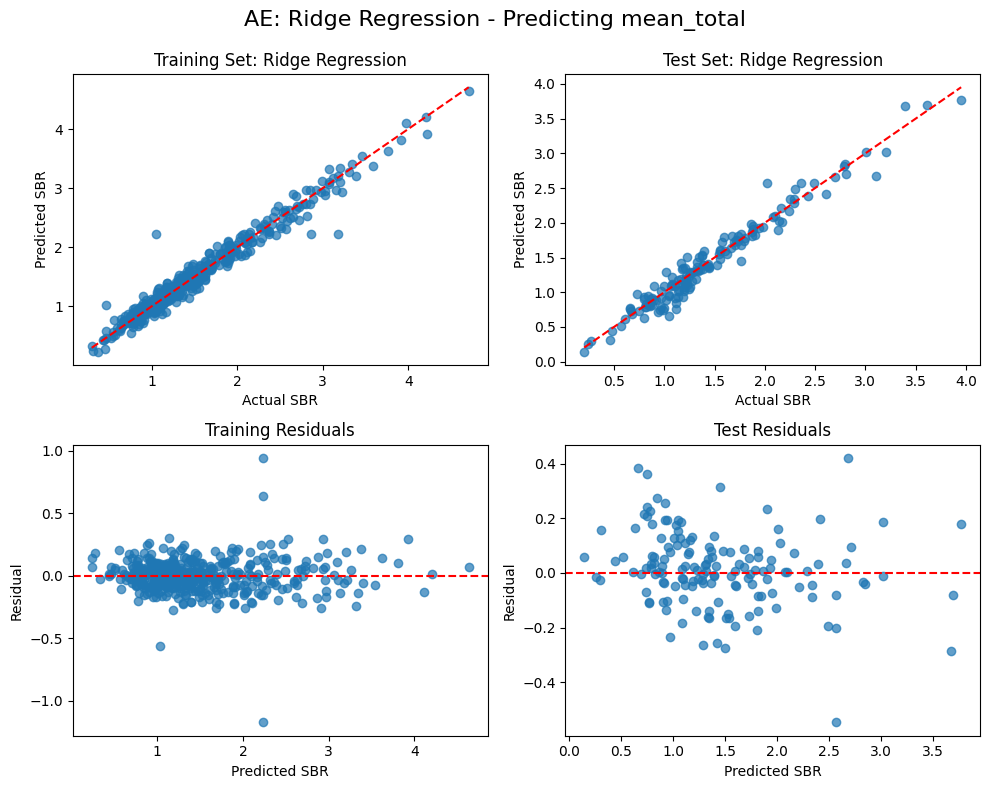

Evaluating Lasso Regression...


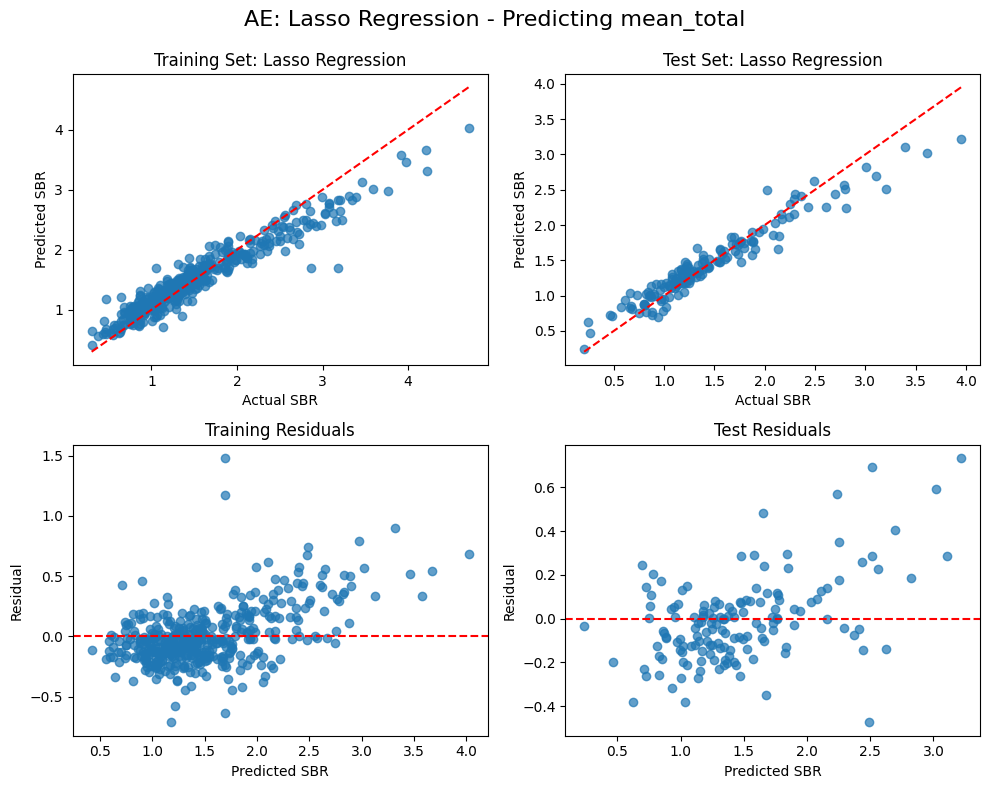

Evaluating ElasticNet...


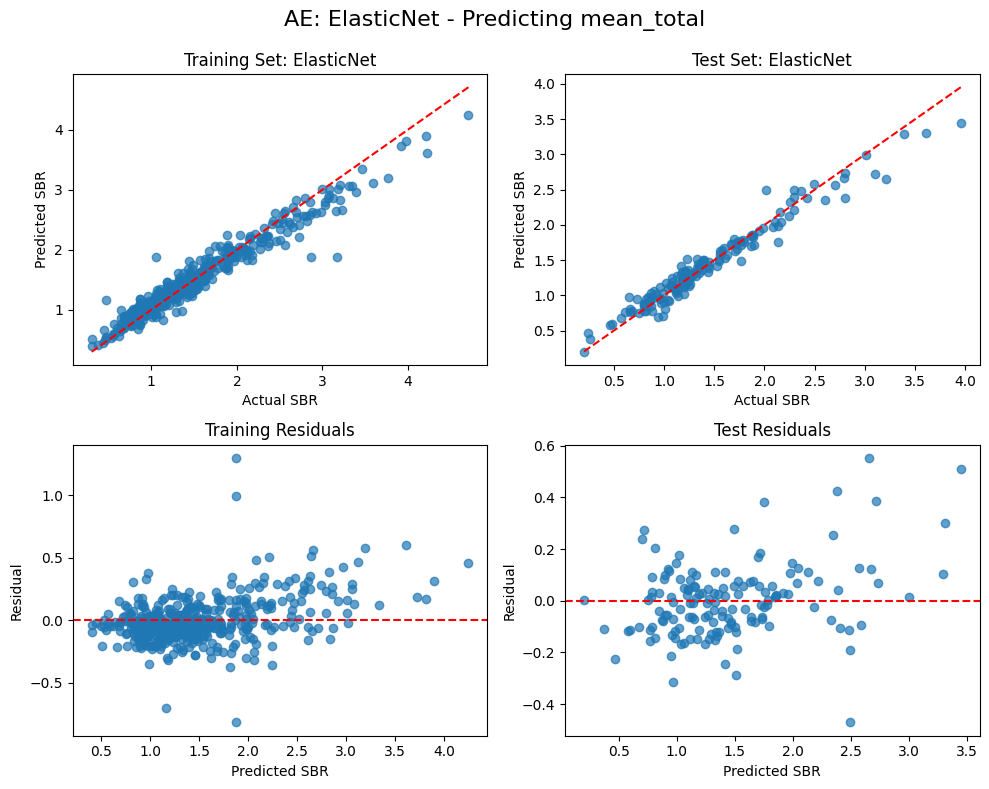

Evaluating SVR...


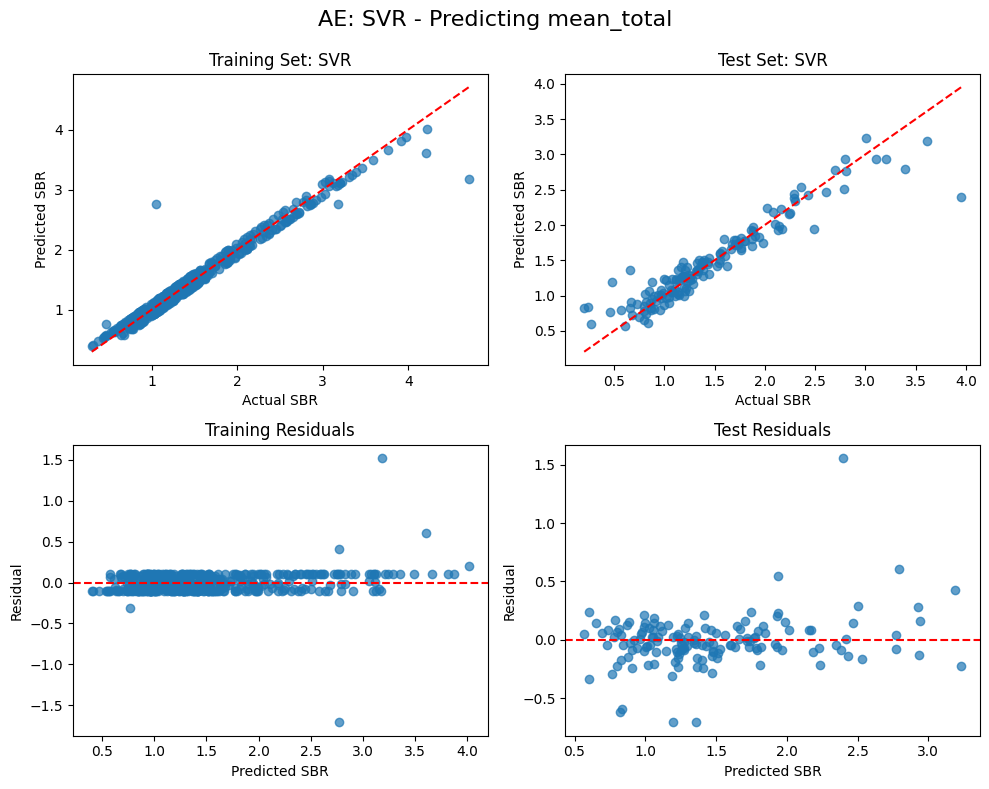

Evaluating Random Forest...


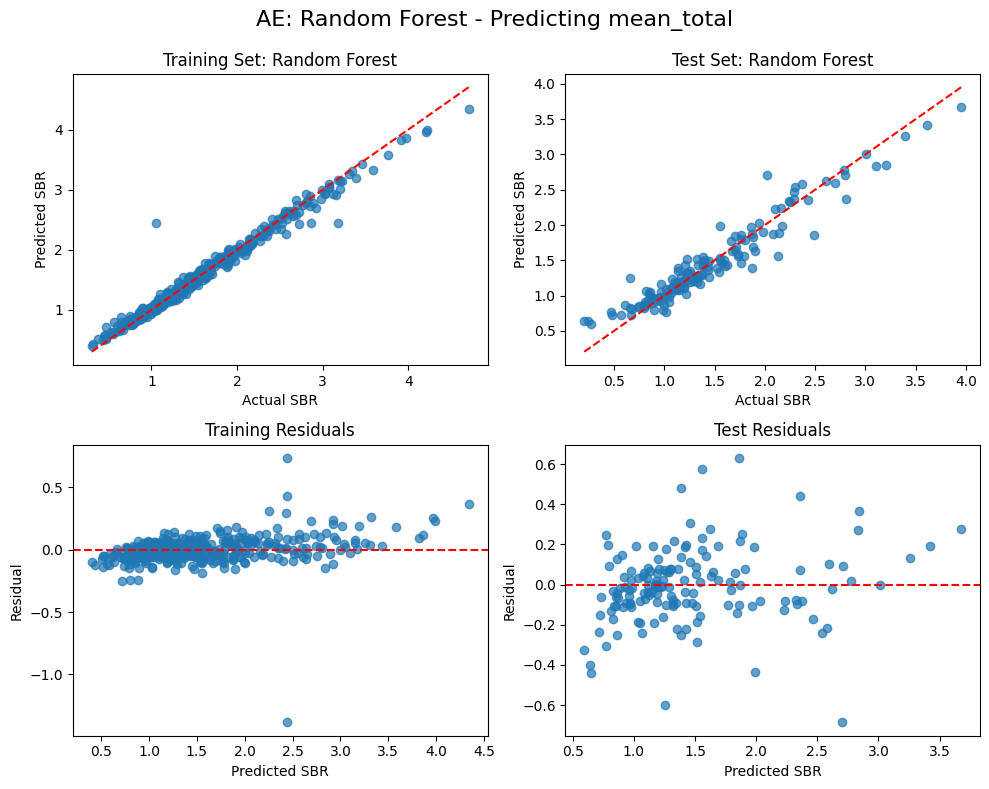

Evaluating Gradient Boosting...


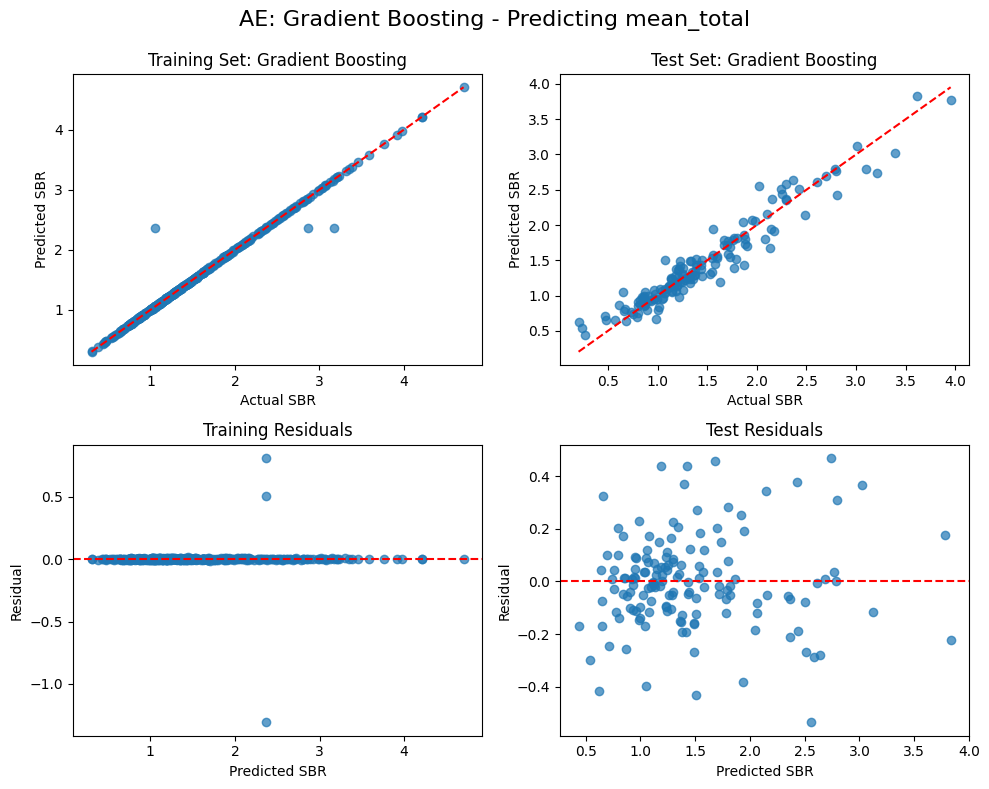


AE Model Performance for mean_total:
               Model  Train RMSE  Test RMSE  Train MAE  Test MAE  Train R²  \
1   Ridge Regression    0.135477   0.138762   0.091913  0.101835  0.964905   
0  Linear Regression    0.135471   0.139291   0.091958  0.102080  0.964907   
3         ElasticNet    0.181597   0.144543   0.125353  0.106029  0.936942   
6  Gradient Boosting    0.076859   0.175580   0.009139  0.129311  0.988704   
5      Random Forest    0.109667   0.186500   0.063382  0.134898  0.977003   
2   Lasso Regression    0.237022   0.194265   0.170885  0.142914  0.892576   
4                SVR    0.140706   0.222134   0.084431  0.137355  0.962143   

    Test R²  
1  0.956561  
0  0.956229  
3  0.952866  
6  0.930451  
5  0.921530  
2  0.914860  
4  0.888680  

Evaluating models for AE - mean_caudate:
Evaluating Linear Regression...


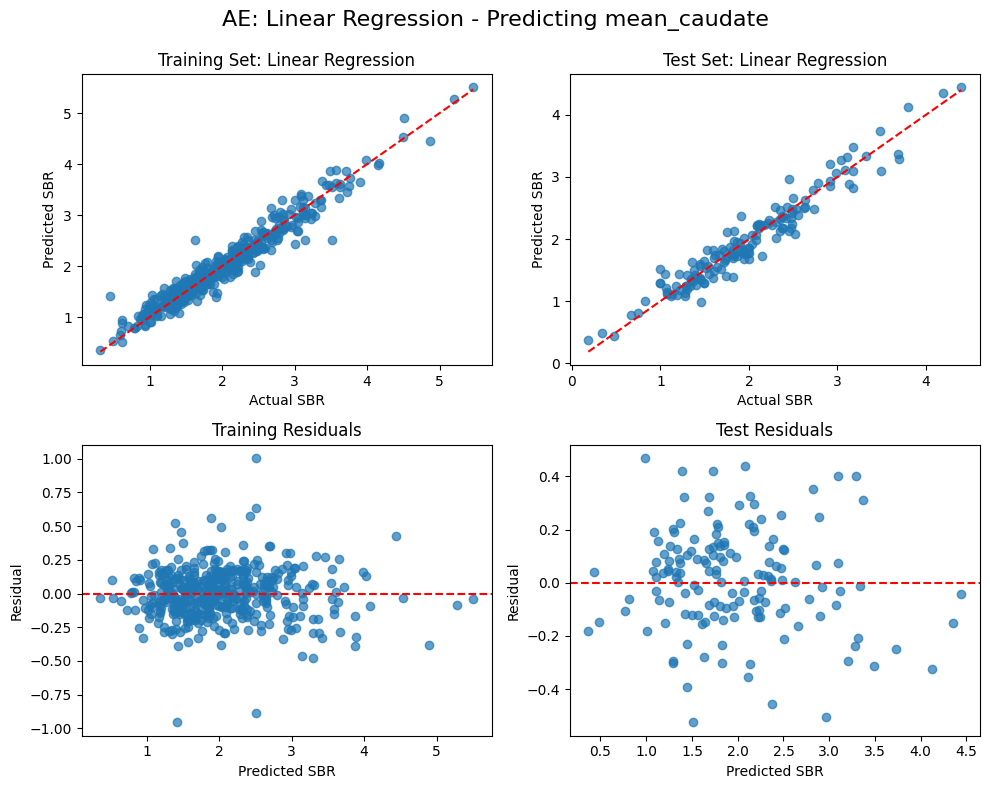

Evaluating Ridge Regression...


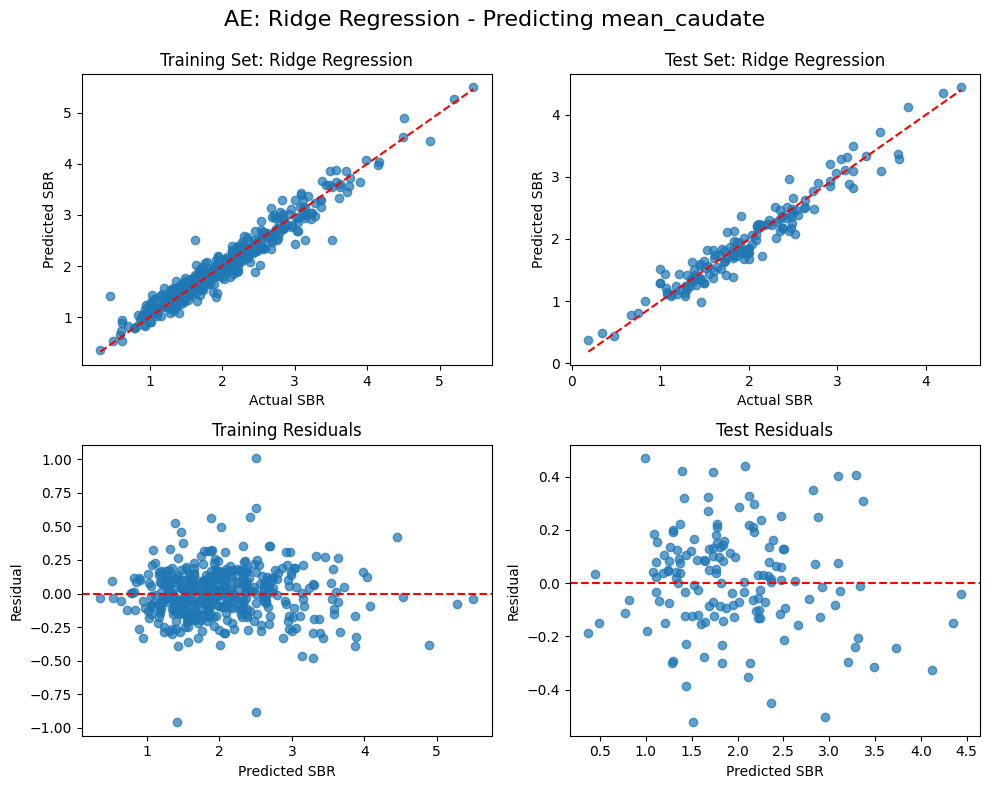

Evaluating Lasso Regression...


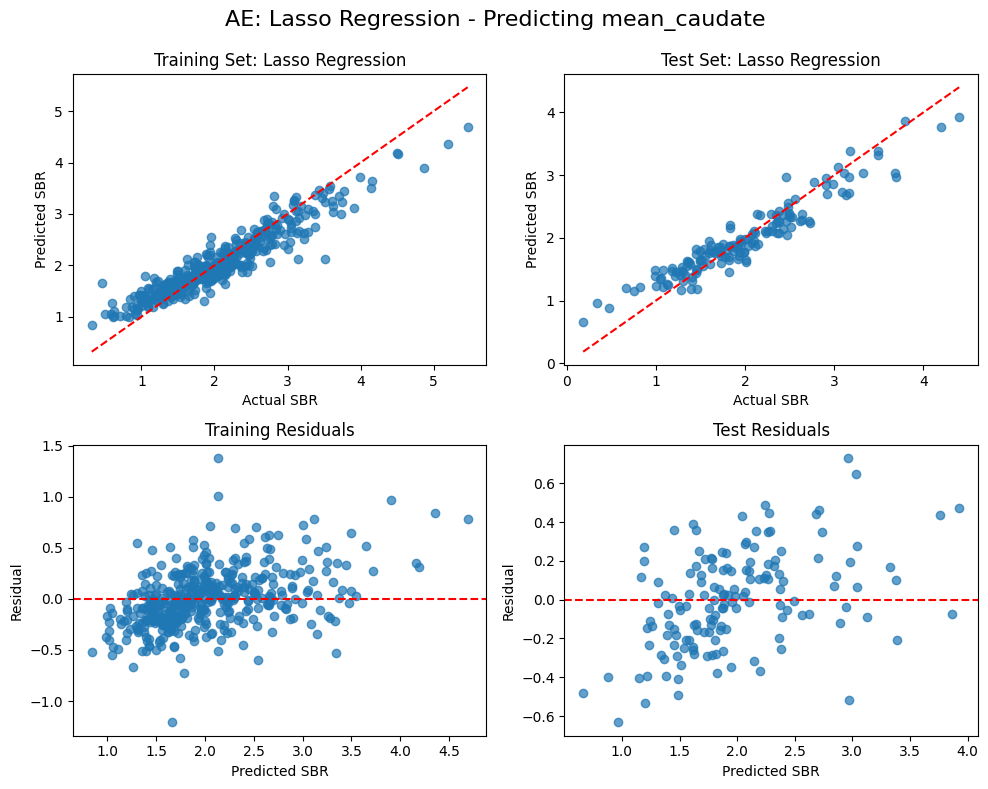

Evaluating ElasticNet...


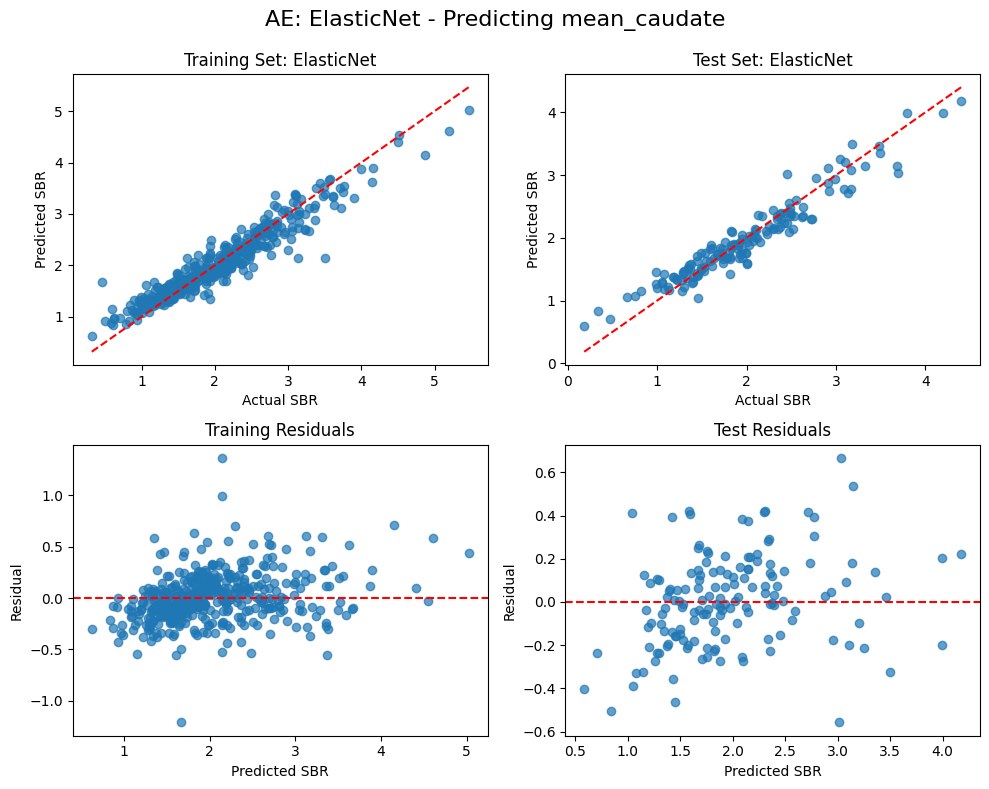

Evaluating SVR...


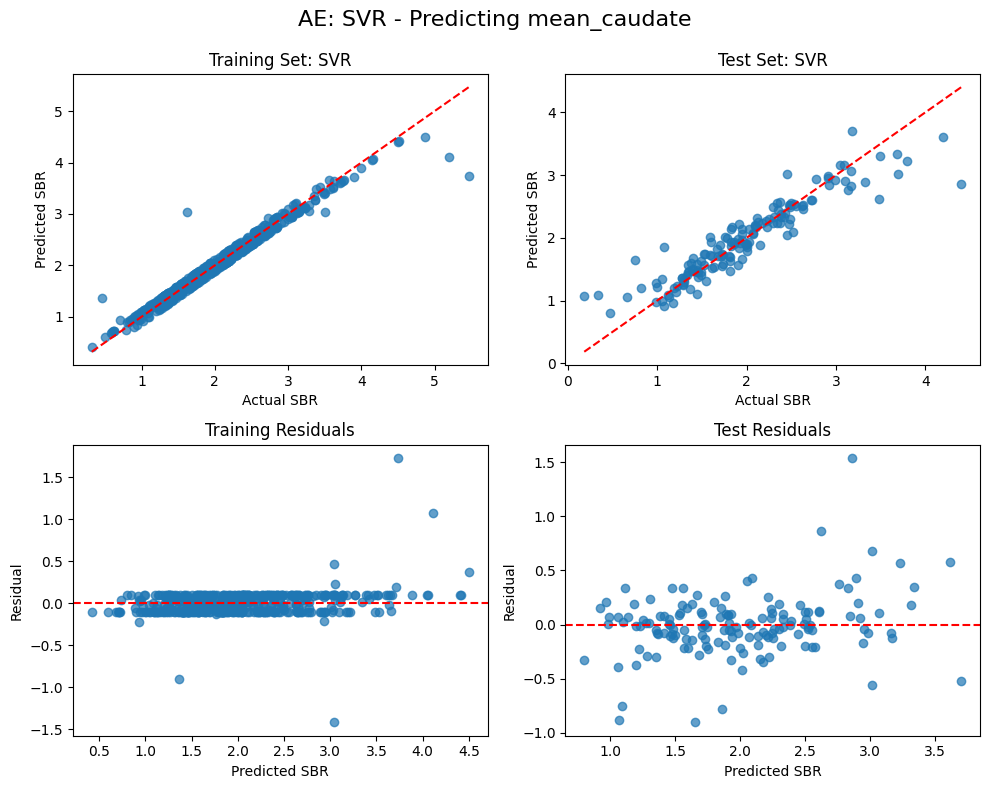

Evaluating Random Forest...


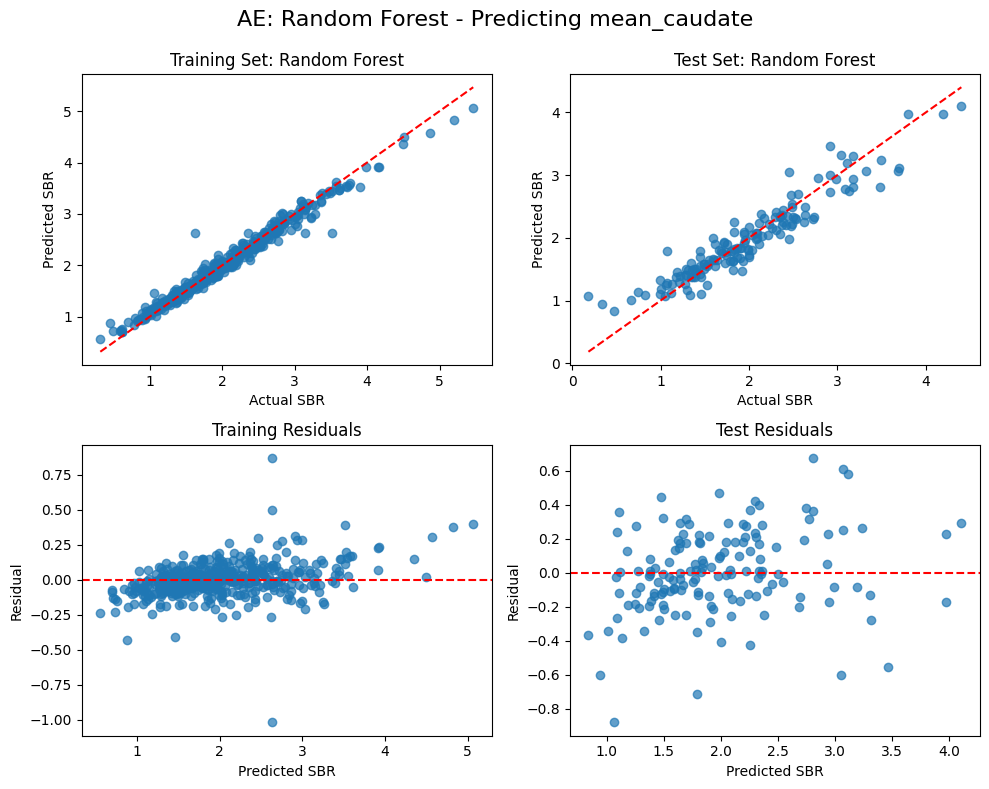

Evaluating Gradient Boosting...


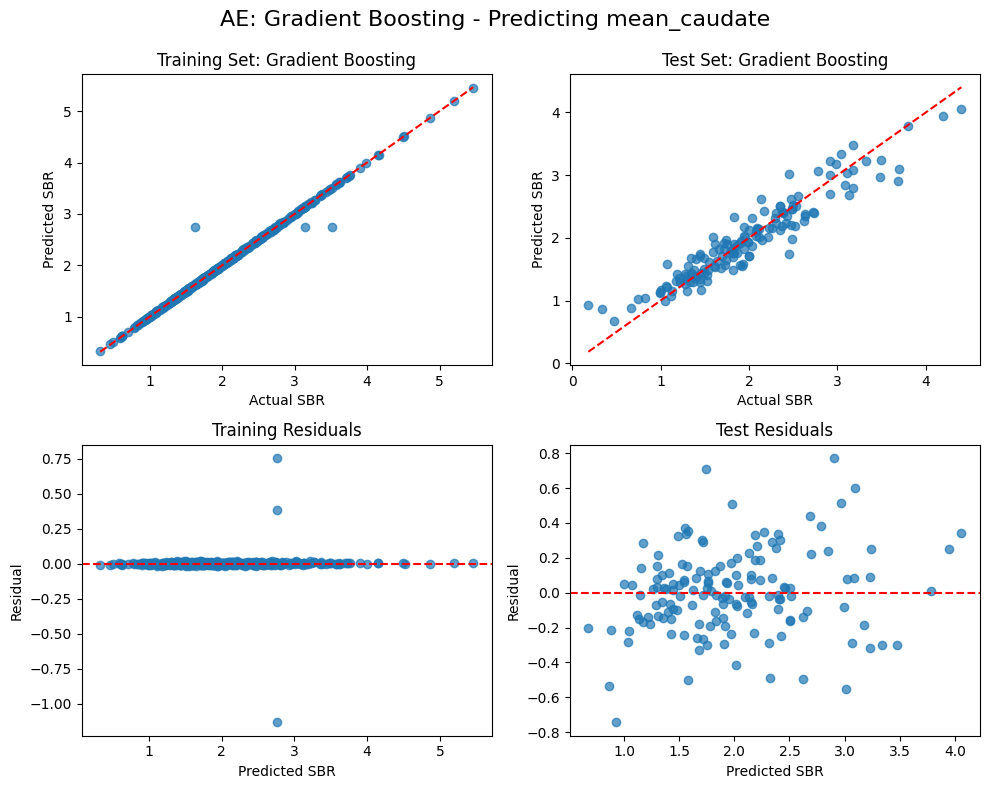


AE Model Performance for mean_caudate:
               Model  Train RMSE  Test RMSE  Train MAE  Test MAE  Train R²  \
1   Ridge Regression    0.184869   0.191655   0.136899  0.150483  0.943005   
0  Linear Regression    0.184860   0.192095   0.136961  0.150818  0.943011   
3         ElasticNet    0.240405   0.213586   0.177572  0.167462  0.903619   
6  Gradient Boosting    0.067504   0.240149   0.010608  0.181836  0.992401   
5      Random Forest    0.125713   0.247958   0.083681  0.189616  0.973645   
2   Lasso Regression    0.283150   0.249705   0.212411  0.200374  0.866297   
4                SVR    0.155280   0.282962   0.093550  0.186279  0.959790   

    Test R²  
1  0.932597  
0  0.932287  
3  0.916289  
6  0.894172  
5  0.887178  
2  0.885582  
4  0.853076  

Evaluating models for AE - mean_putamen:
Evaluating Linear Regression...


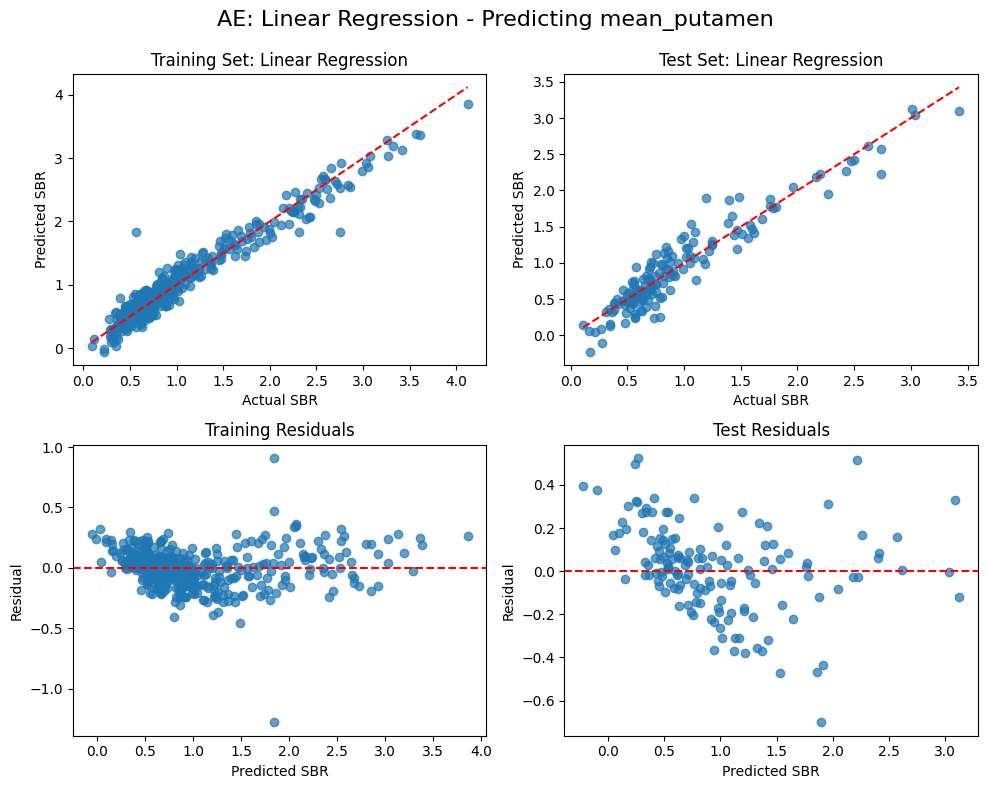

Evaluating Ridge Regression...


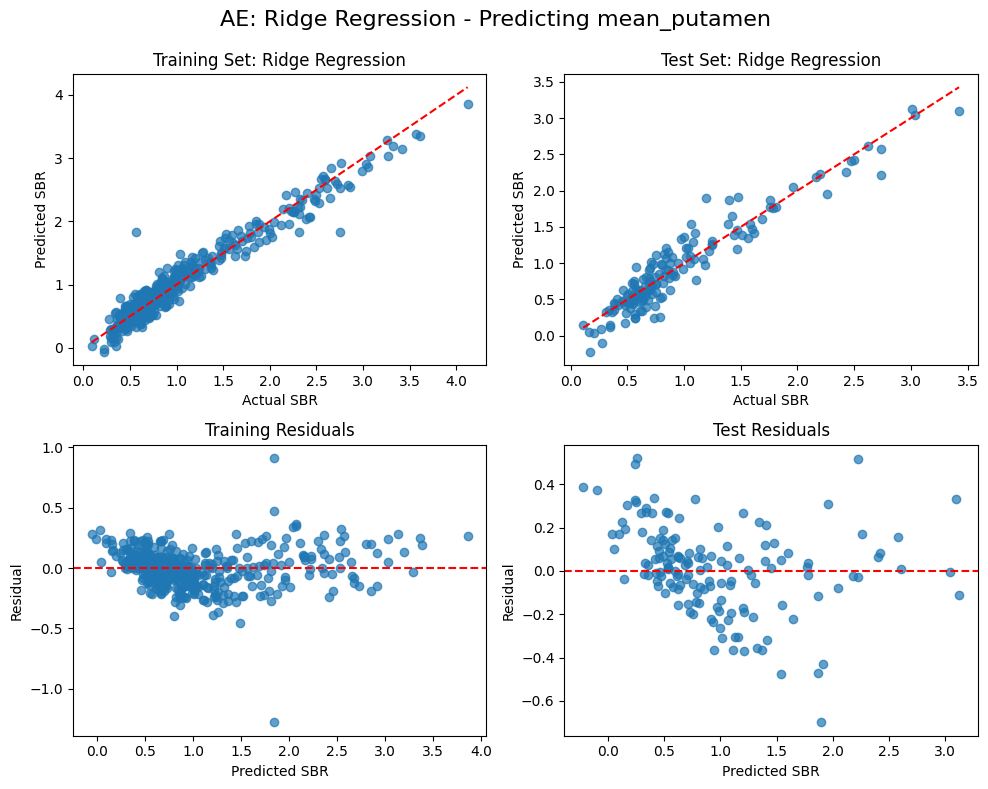

Evaluating Lasso Regression...


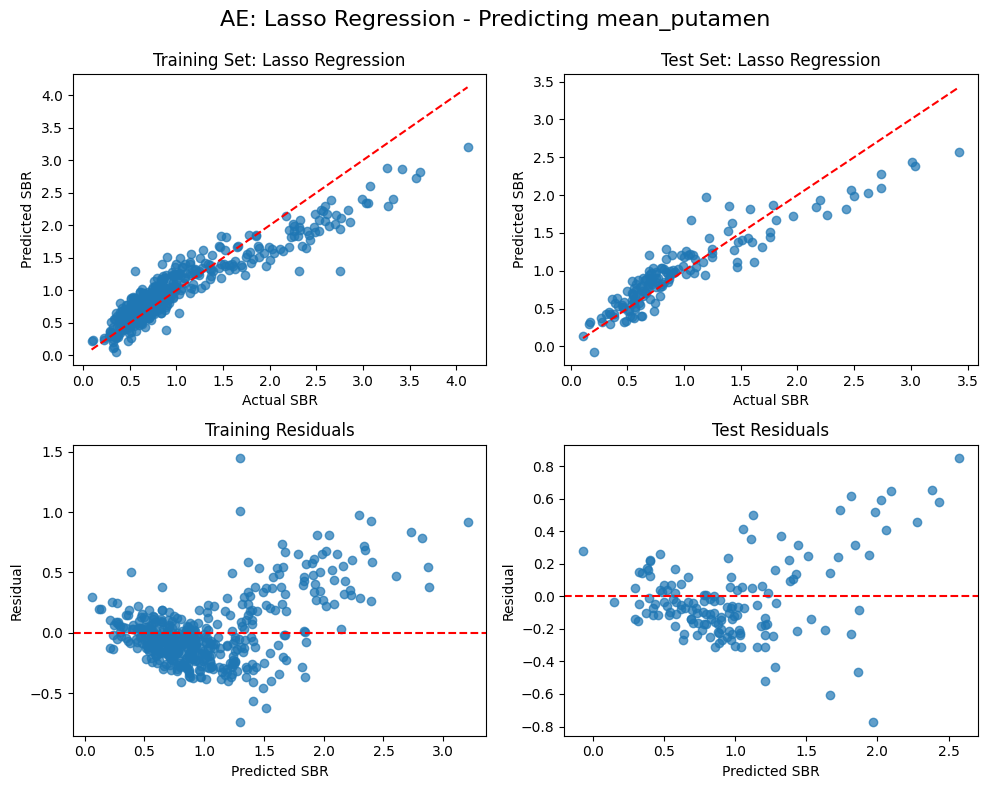

Evaluating ElasticNet...


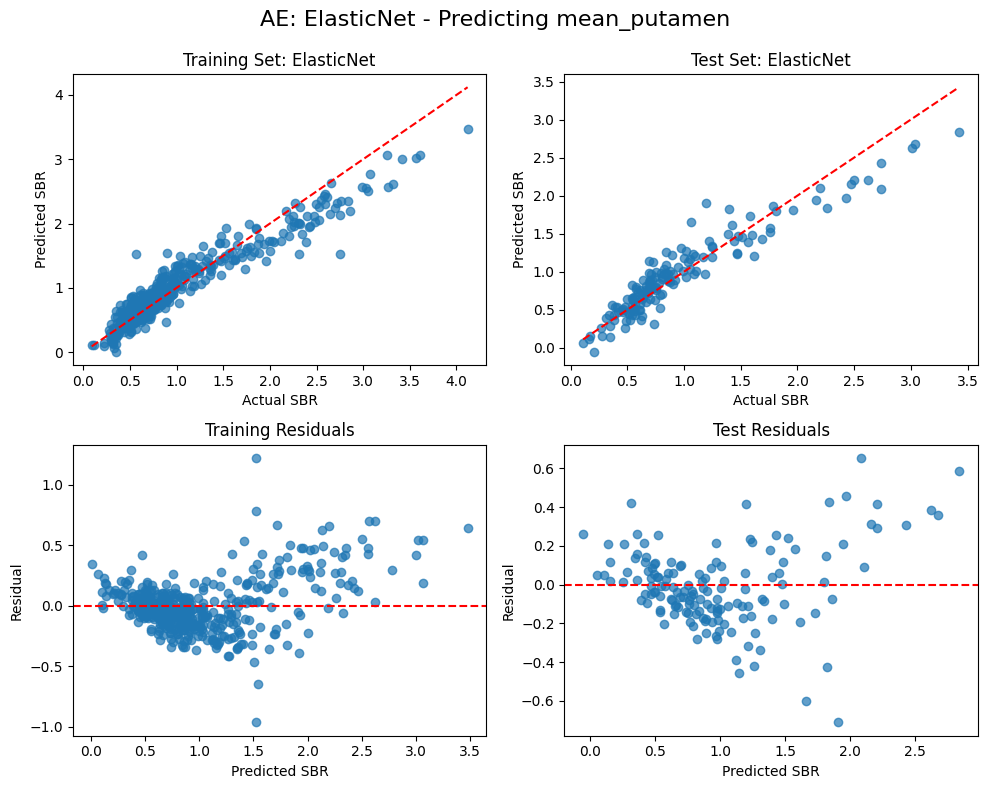

Evaluating SVR...


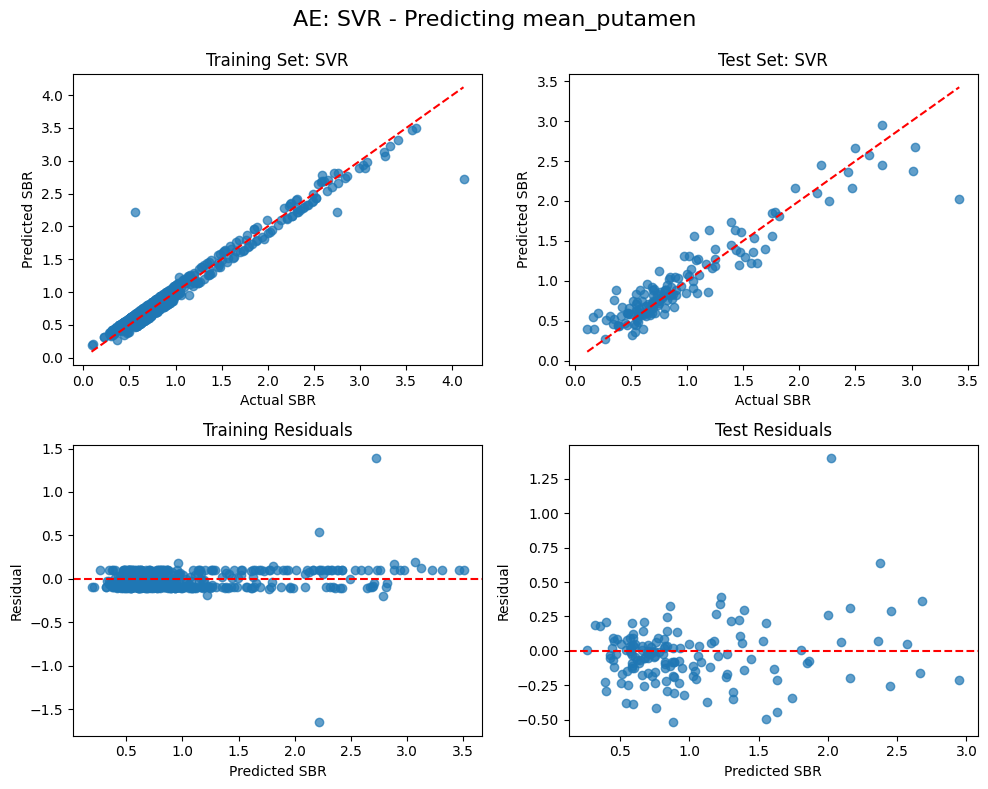

Evaluating Random Forest...


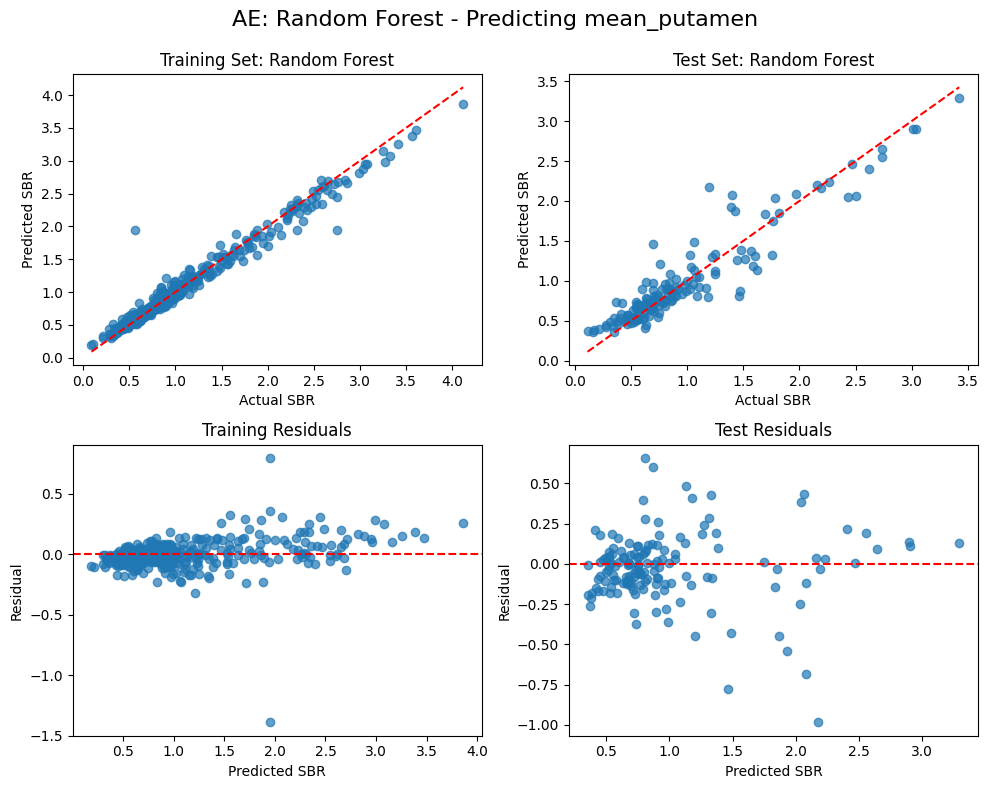

Evaluating Gradient Boosting...


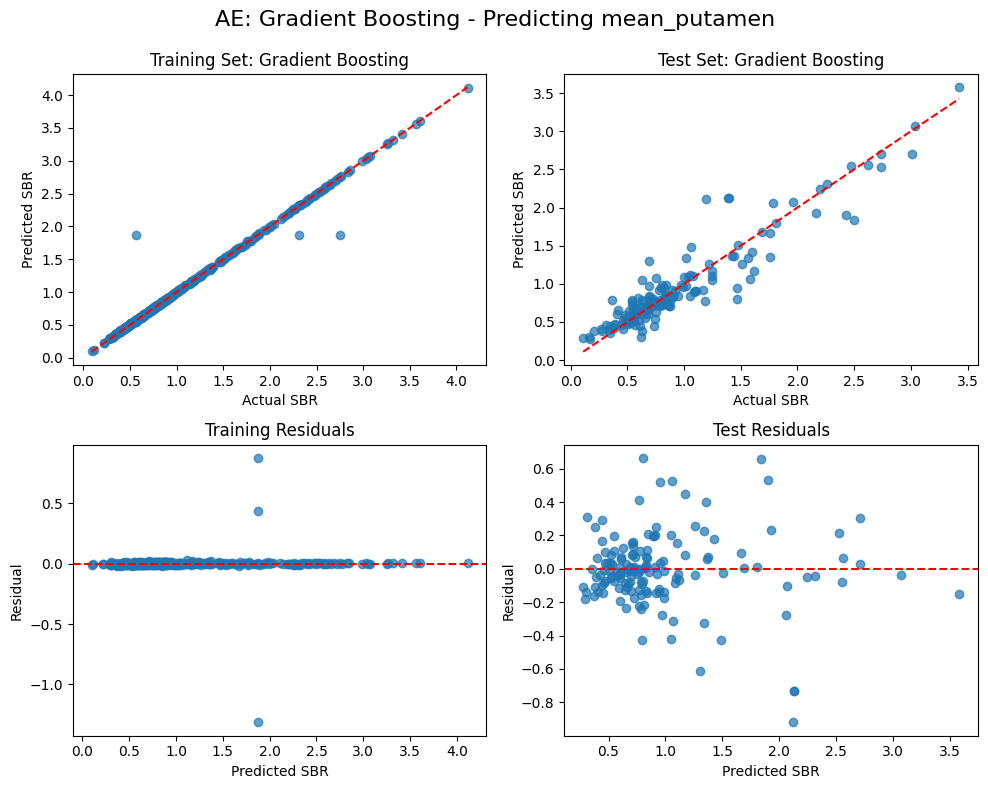


AE Model Performance for mean_putamen:
               Model  Train RMSE  Test RMSE  Train MAE  Test MAE  Train R²  \
1   Ridge Regression    0.160837   0.202332   0.116672  0.151935  0.947217   
0  Linear Regression    0.160825   0.203515   0.116686  0.153140  0.947225   
3         ElasticNet    0.222384   0.208019   0.161810  0.157224  0.899091   
4                SVR    0.136736   0.219310   0.088084  0.150769  0.961850   
5      Random Forest    0.116915   0.220899   0.067718  0.152353  0.972109   
6  Gradient Boosting    0.078079   0.222907   0.011710  0.149565  0.987561   
2   Lasso Regression    0.275730   0.250363   0.201861  0.189967  0.844871   

    Test R²  
1  0.895667  
0  0.894443  
3  0.889719  
4  0.877423  
5  0.875639  
6  0.873369  
2  0.840252  

Evaluating models for VAE - mean_total:
Evaluating Linear Regression...


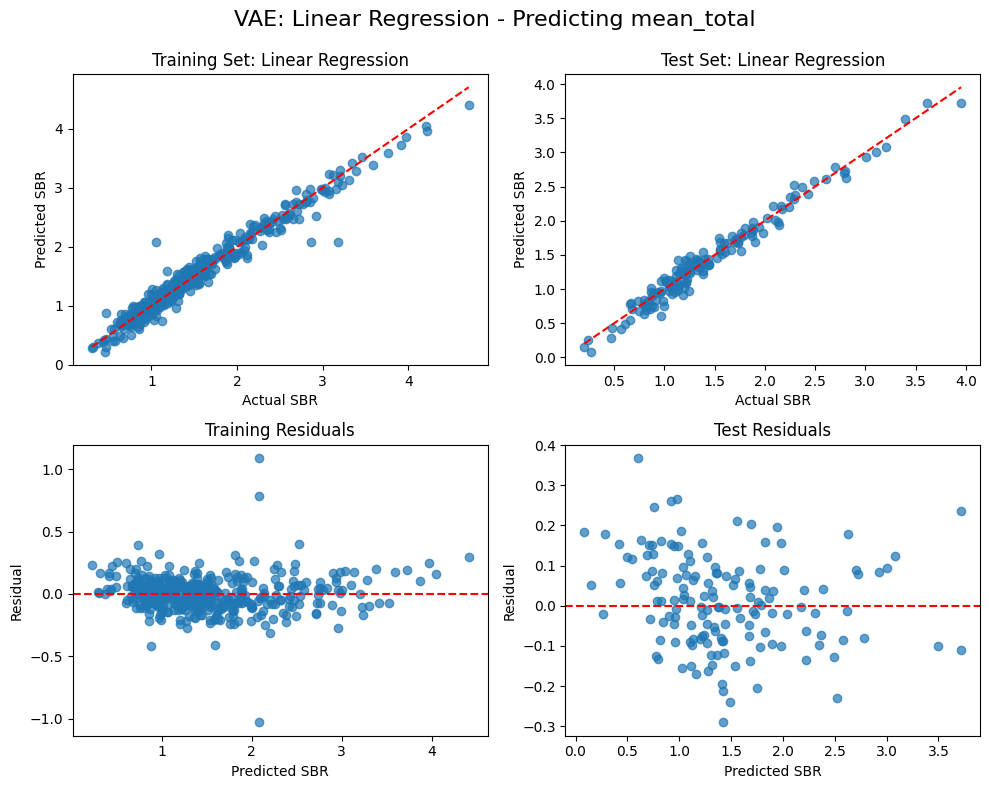

Evaluating Ridge Regression...


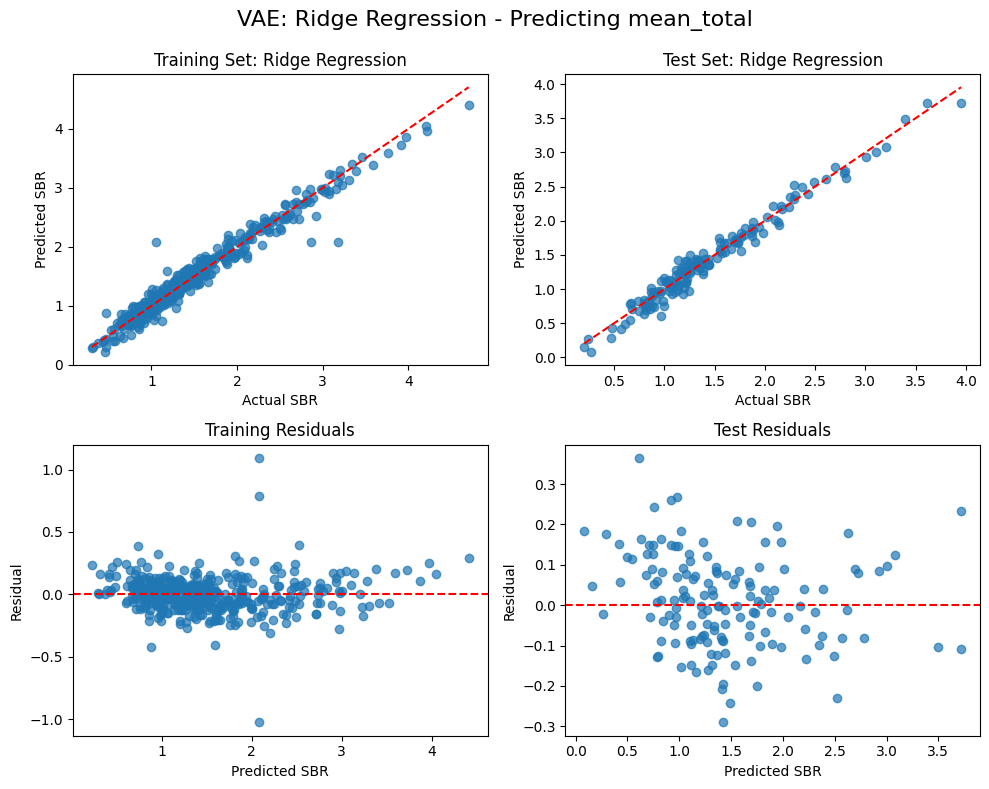

Evaluating Lasso Regression...


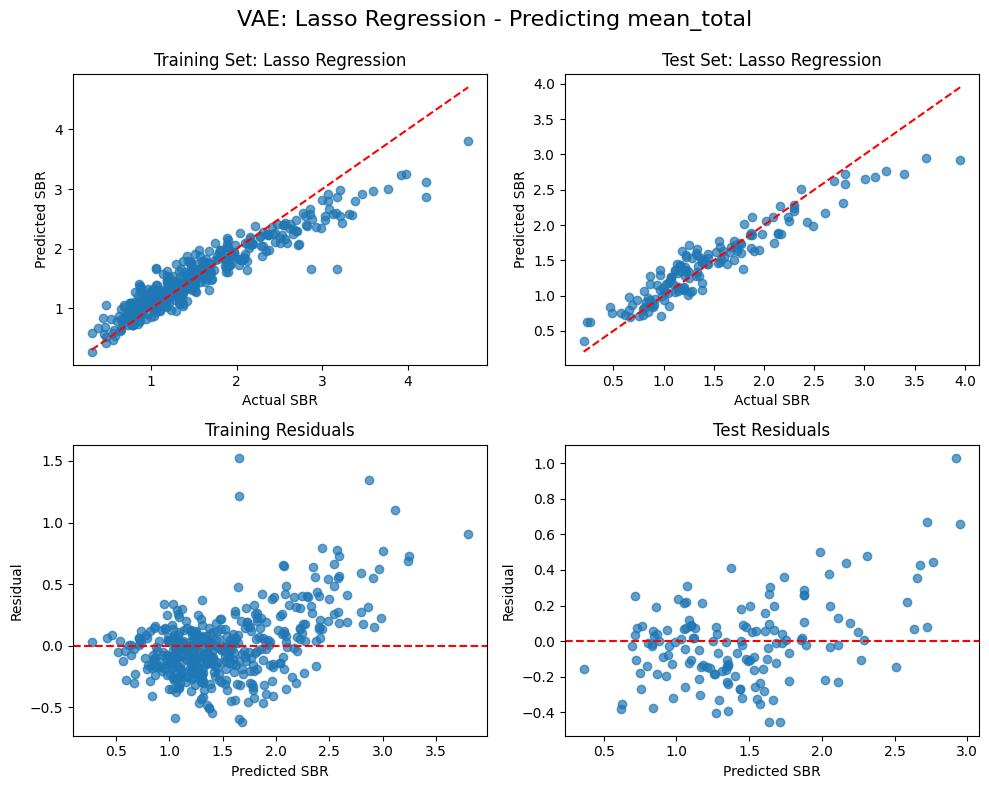

Evaluating ElasticNet...


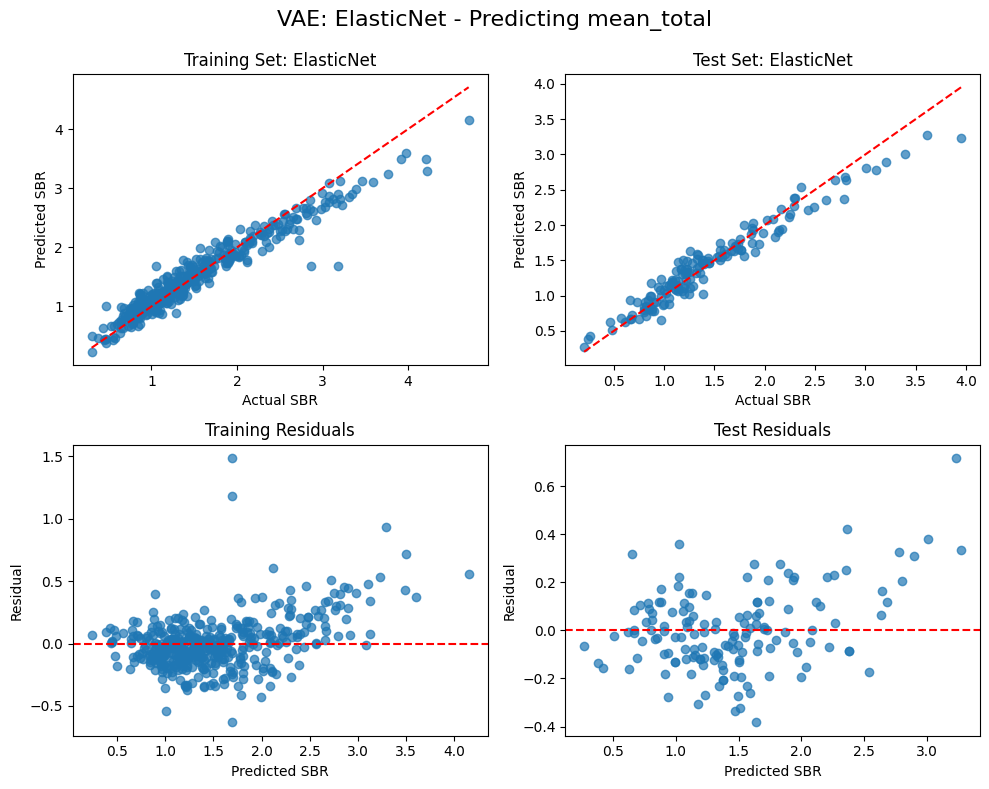

Evaluating SVR...


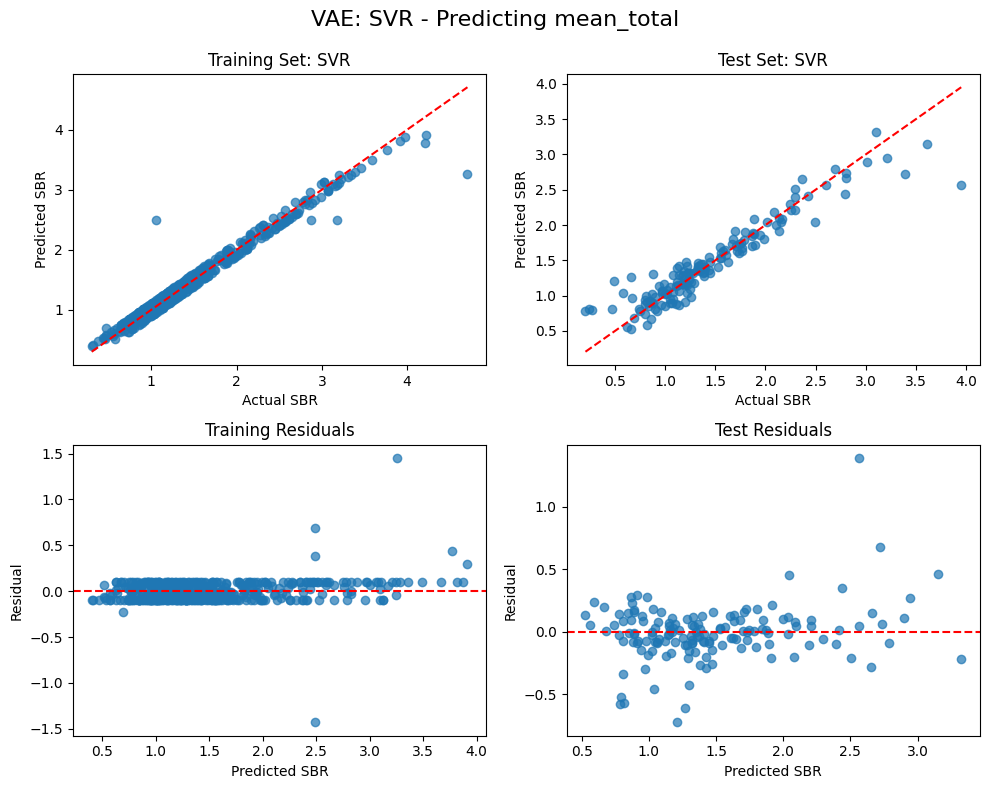

Evaluating Random Forest...


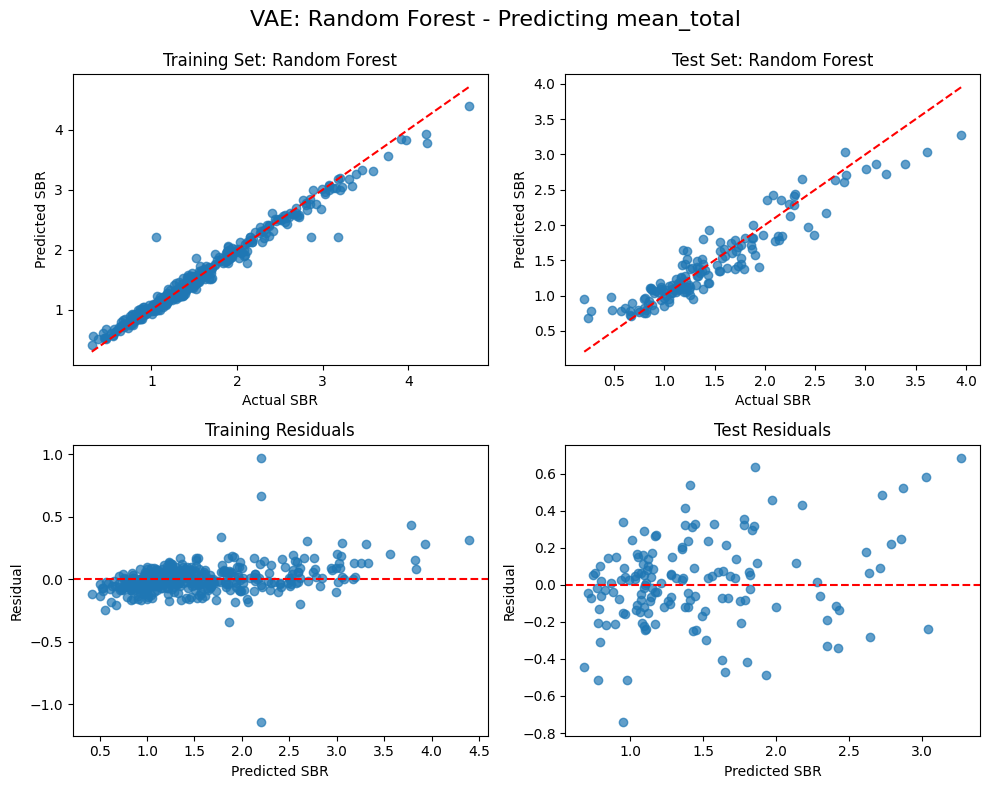

Evaluating Gradient Boosting...


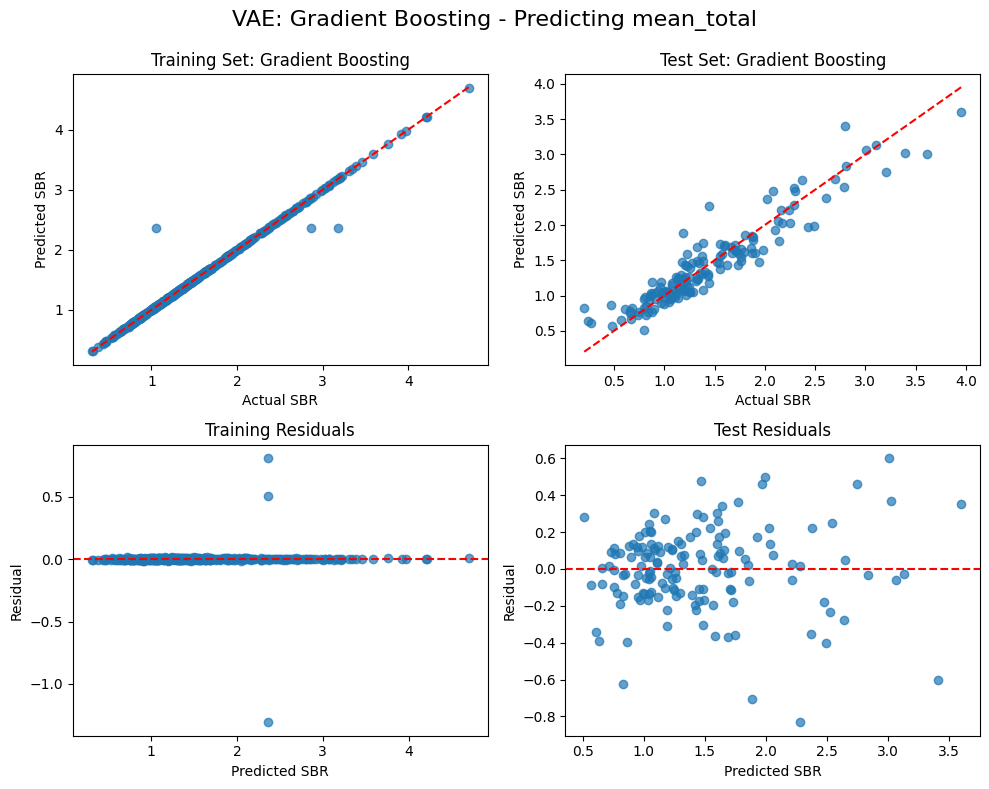


VAE Model Performance for mean_total:
               Model  Train RMSE  Test RMSE  Train MAE  Test MAE  Train R²  \
1   Ridge Regression    0.142056   0.115618   0.097363  0.093664  0.961413   
0  Linear Regression    0.142049   0.116117   0.097457  0.093986  0.961417   
3         ElasticNet    0.204460   0.166306   0.140790  0.127023  0.920065   
4                SVR    0.133350   0.223654   0.082665  0.143723  0.965998   
6  Gradient Boosting    0.076943   0.223812   0.010306  0.167488  0.988680   
2   Lasso Regression    0.273841   0.233535   0.197063  0.174876  0.856610   
5      Random Forest    0.117687   0.233962   0.071047  0.176159  0.973516   

    Test R²  
1  0.969842  
0  0.969582  
3  0.937603  
4  0.887151  
6  0.886991  
2  0.876960  
5  0.876509  

Evaluating models for VAE - mean_caudate:
Evaluating Linear Regression...


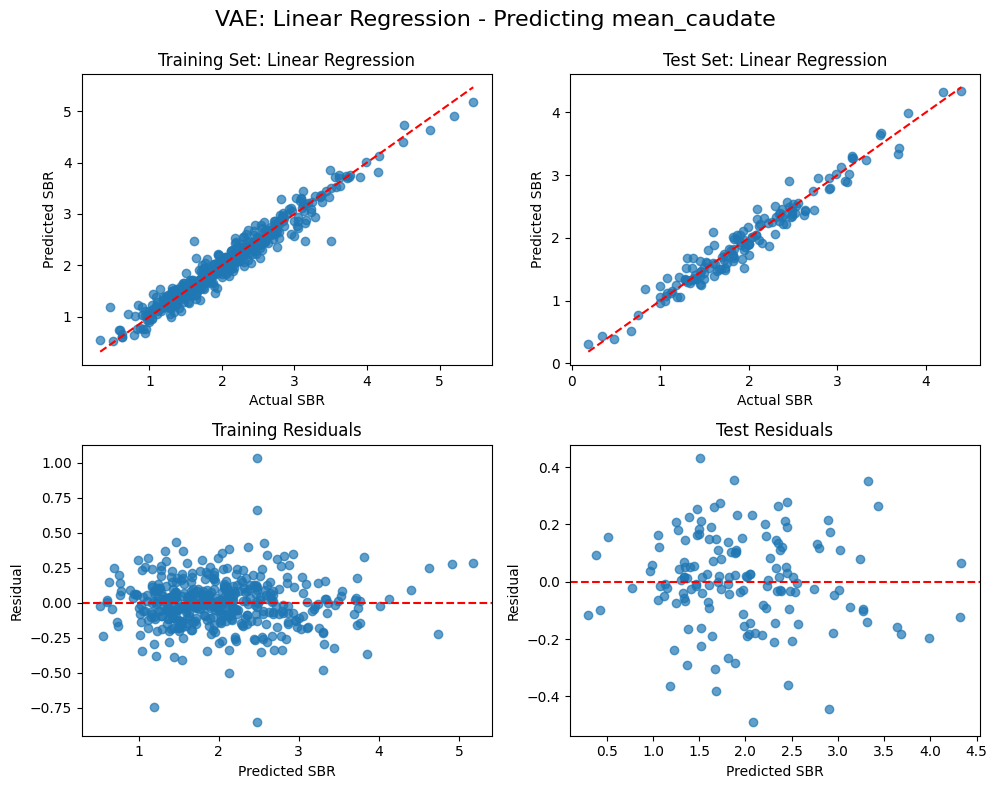

Evaluating Ridge Regression...


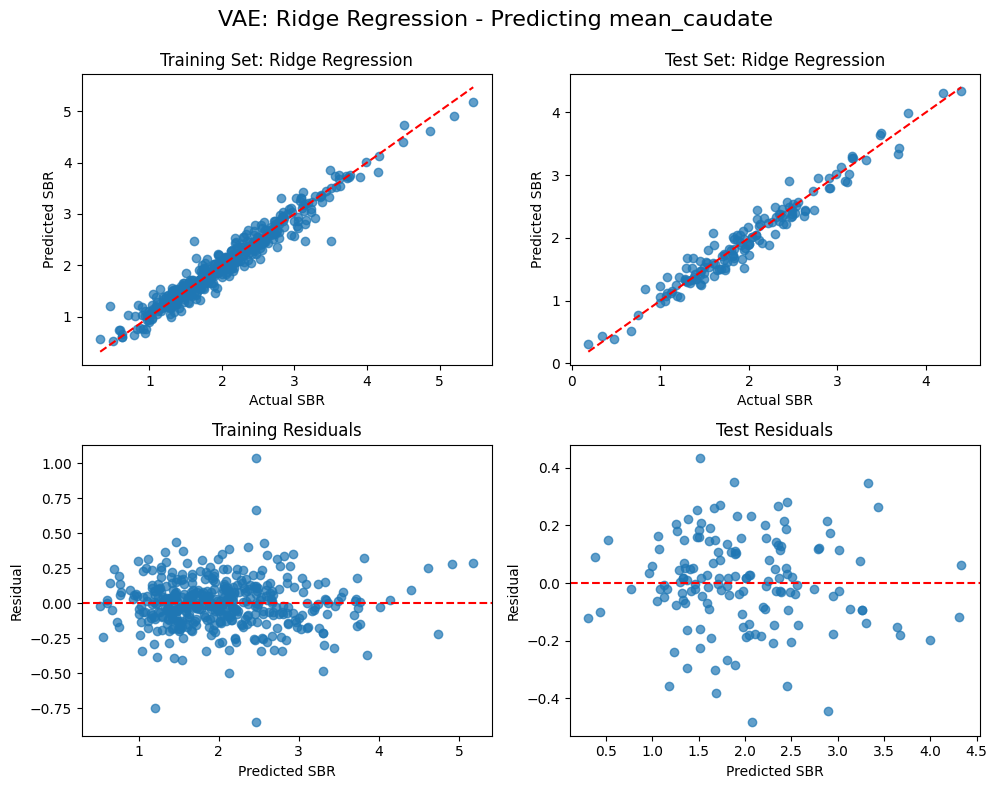

Evaluating Lasso Regression...


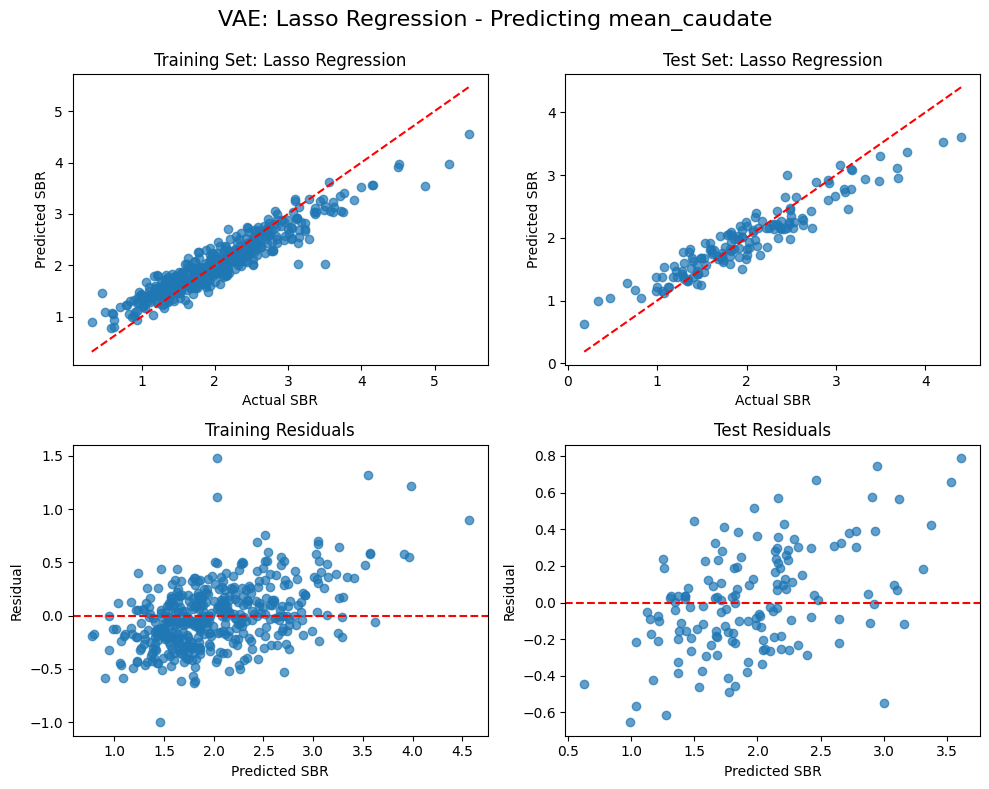

Evaluating ElasticNet...


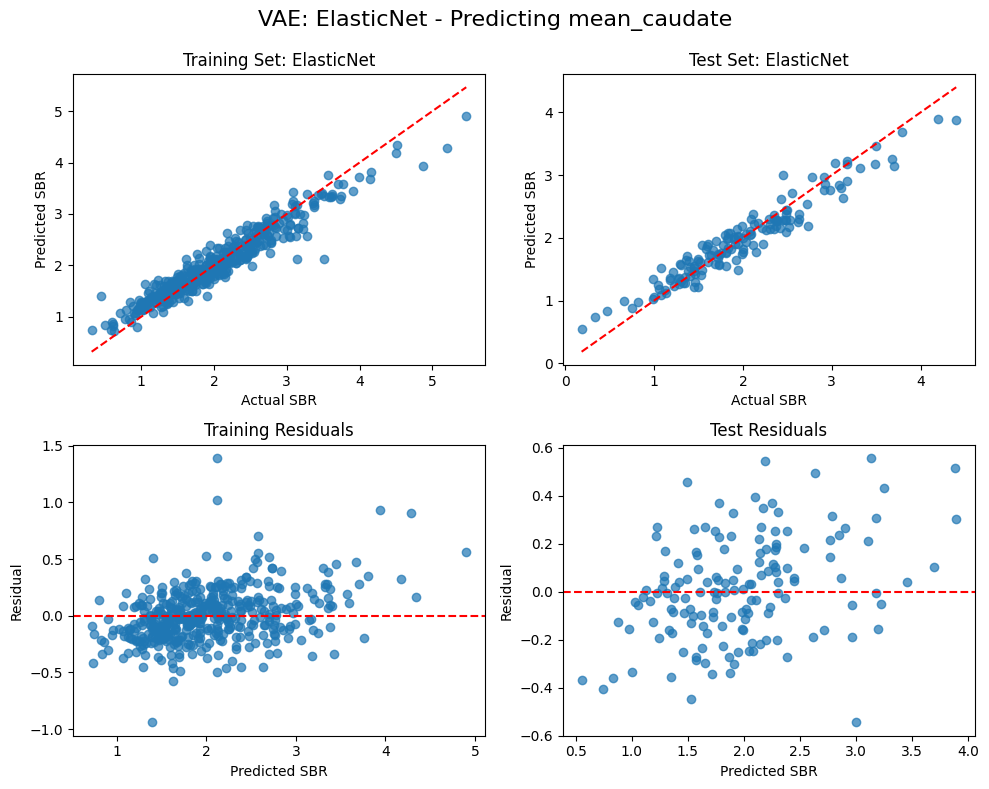

Evaluating SVR...


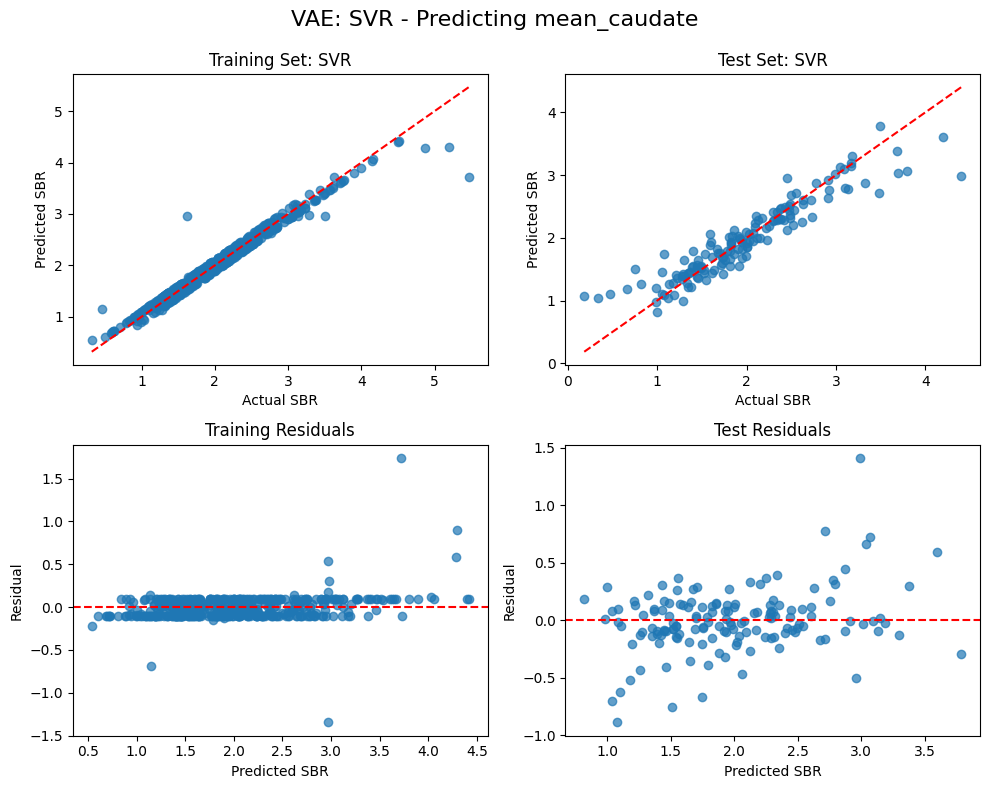

Evaluating Random Forest...


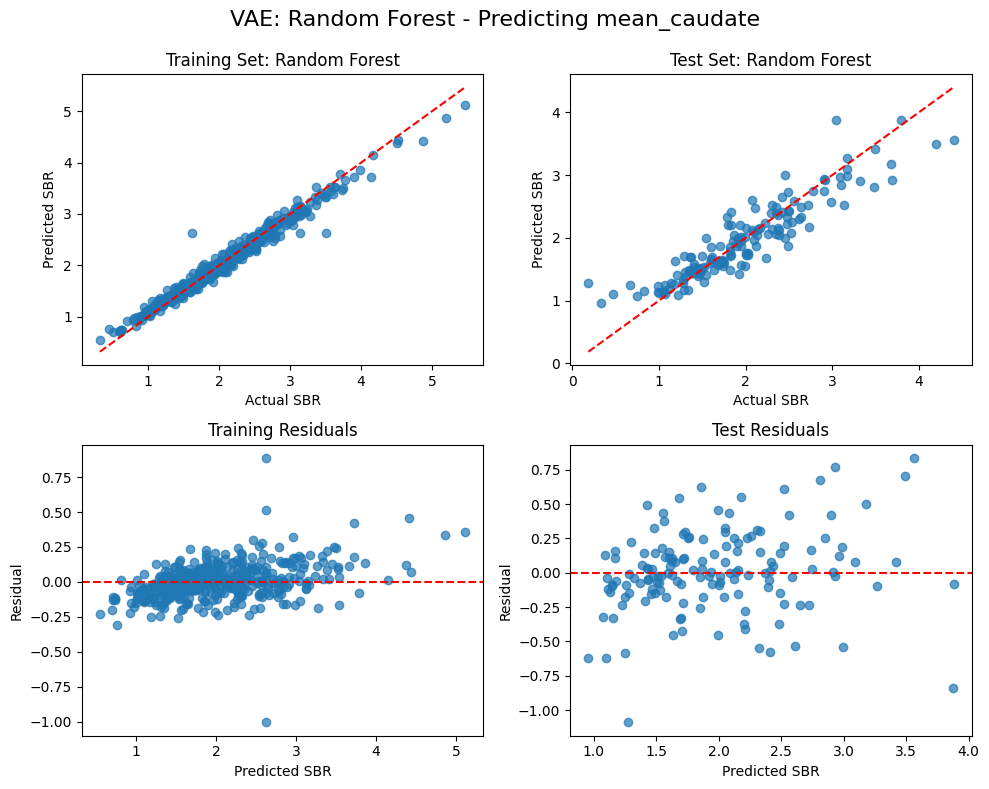

Evaluating Gradient Boosting...


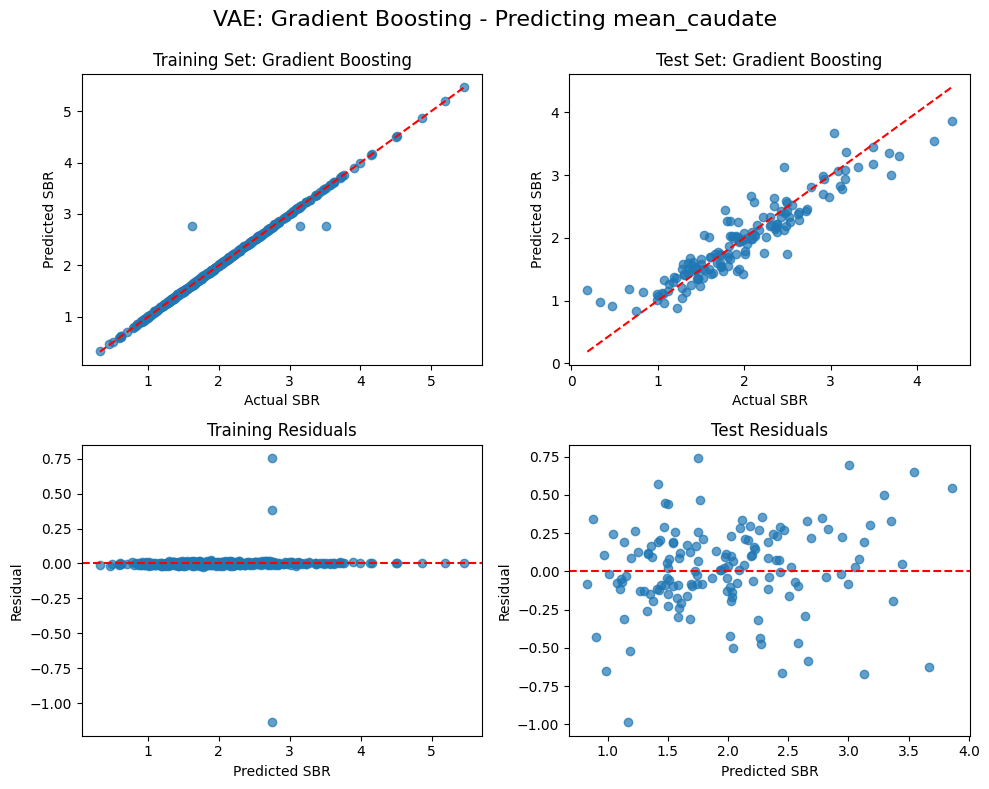


VAE Model Performance for mean_caudate:
               Model  Train RMSE  Test RMSE  Train MAE  Test MAE  Train R²  \
1   Ridge Regression    0.173469   0.160450   0.125992  0.123918  0.949817   
0  Linear Regression    0.173458   0.161285   0.126079  0.124560  0.949824   
3         ElasticNet    0.234008   0.215163   0.175126  0.170045  0.908679   
6  Gradient Boosting    0.067653   0.275666   0.011679  0.208509  0.992367   
4                SVR    0.150499   0.276467   0.091650  0.187841  0.962228   
2   Lasso Regression    0.299902   0.280841   0.228738  0.222450  0.850008   
5      Random Forest    0.129961   0.300925   0.090944  0.218591  0.971834   

    Test R²  
1  0.952759  
0  0.952266  
3  0.915048  
6  0.860555  
4  0.859743  
2  0.855270  
5  0.833829  

Evaluating models for VAE - mean_putamen:
Evaluating Linear Regression...


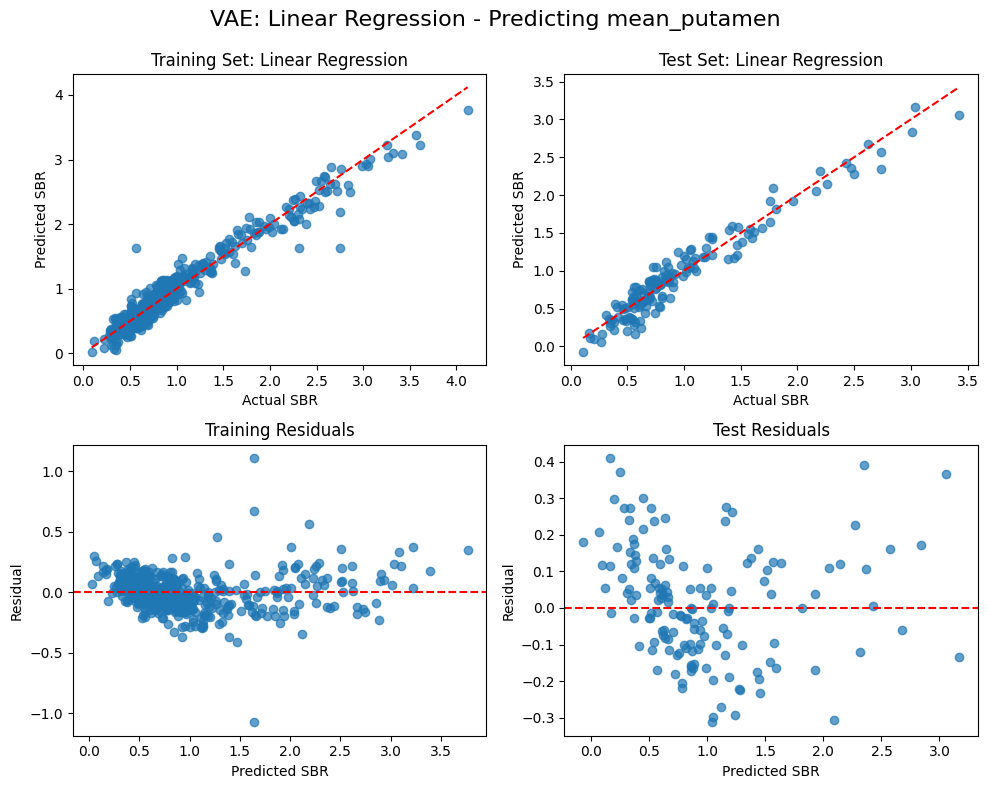

Evaluating Ridge Regression...


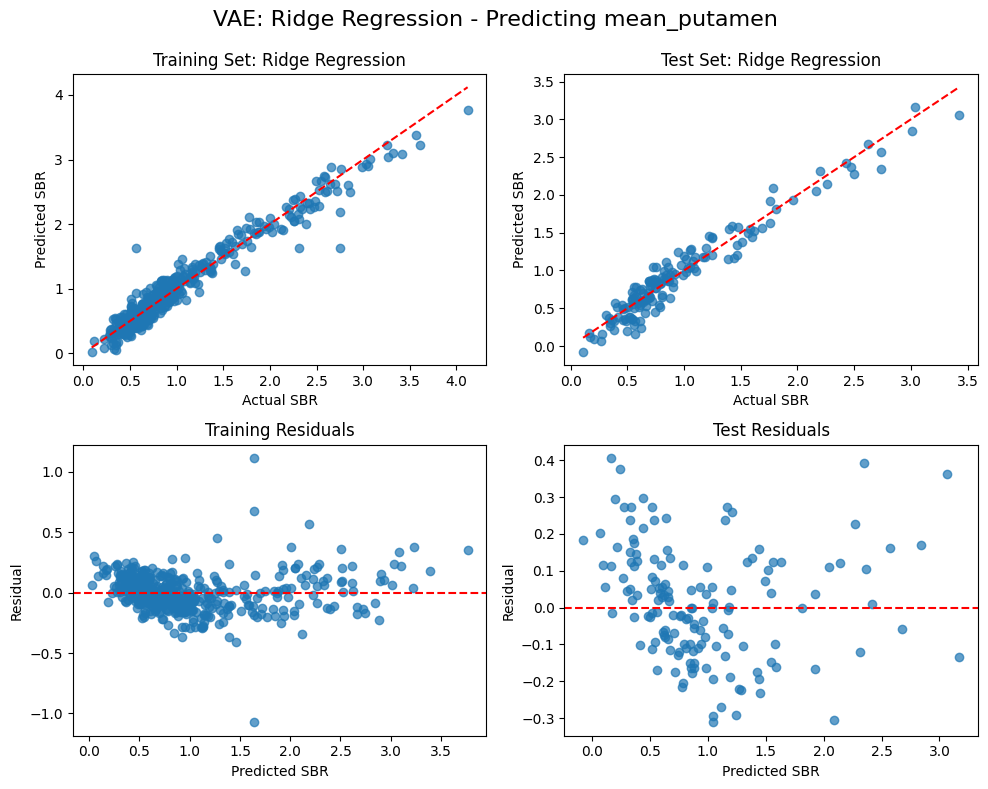

Evaluating Lasso Regression...


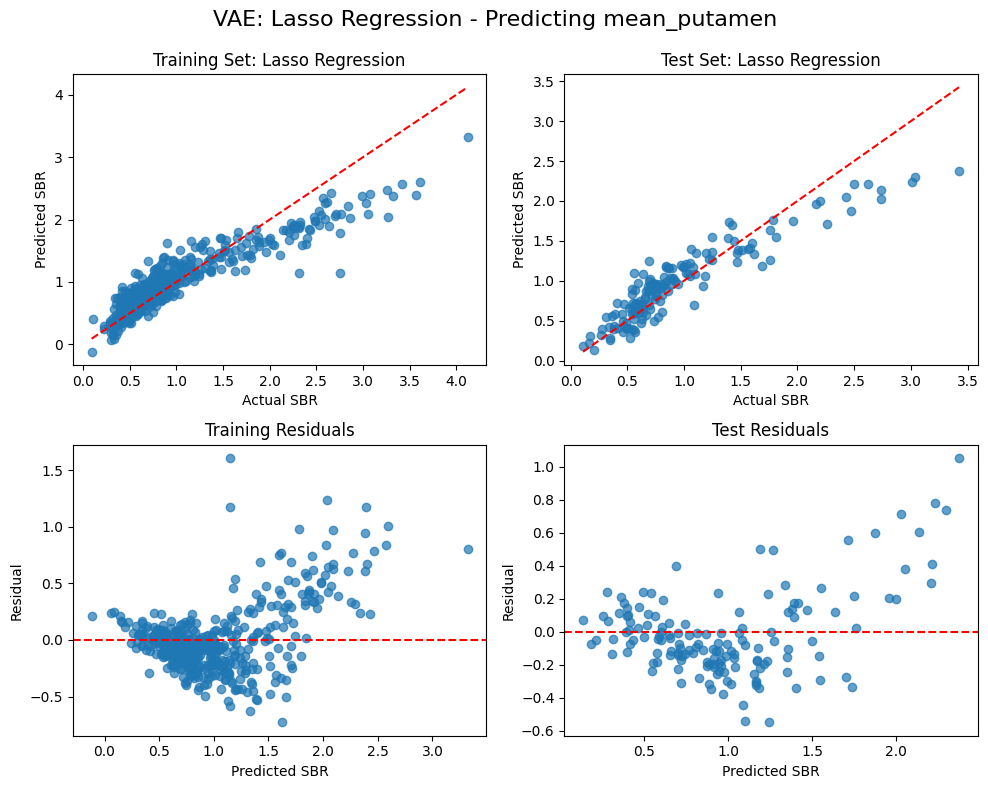

Evaluating ElasticNet...


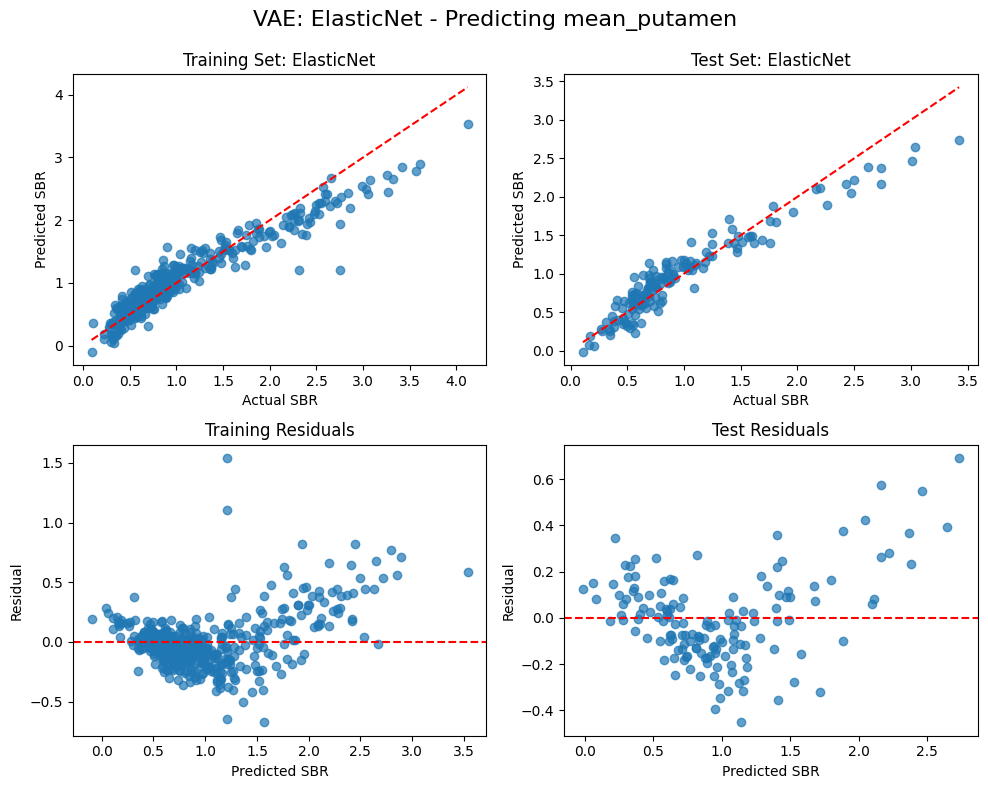

Evaluating SVR...


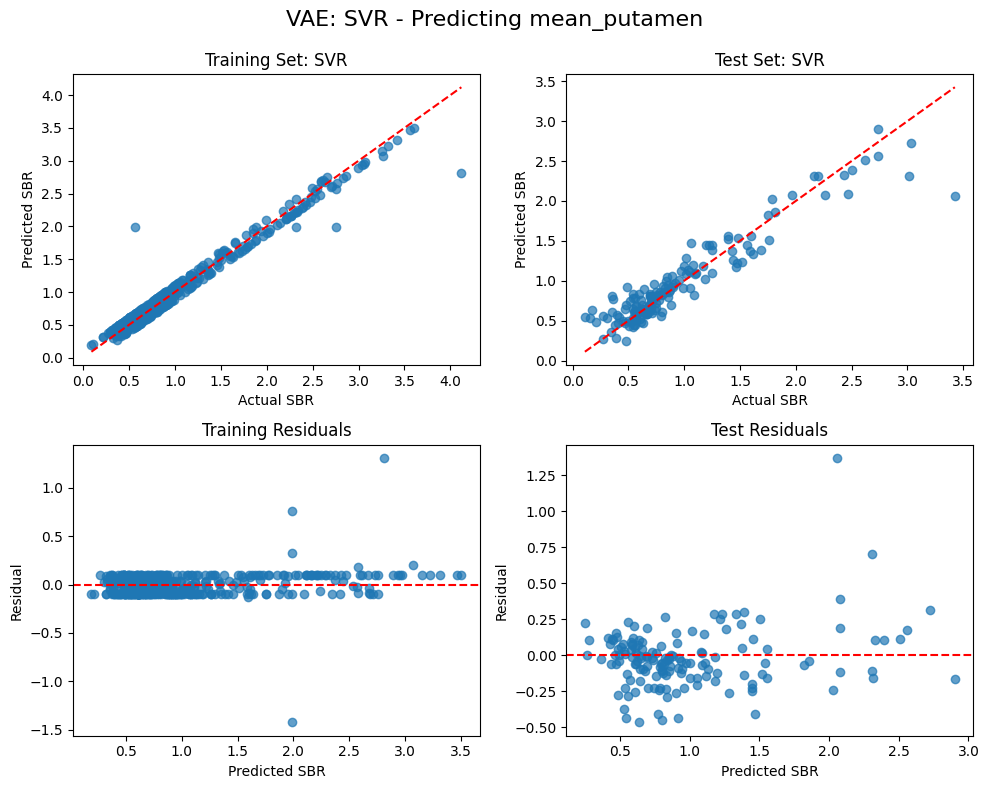

Evaluating Random Forest...


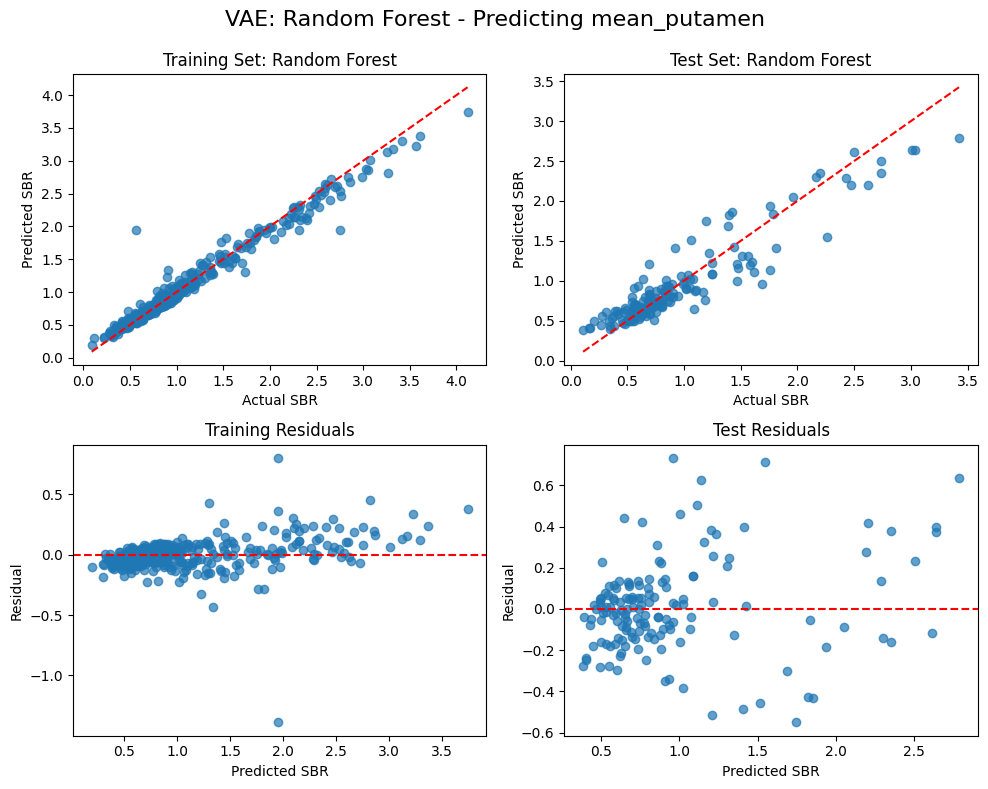

Evaluating Gradient Boosting...


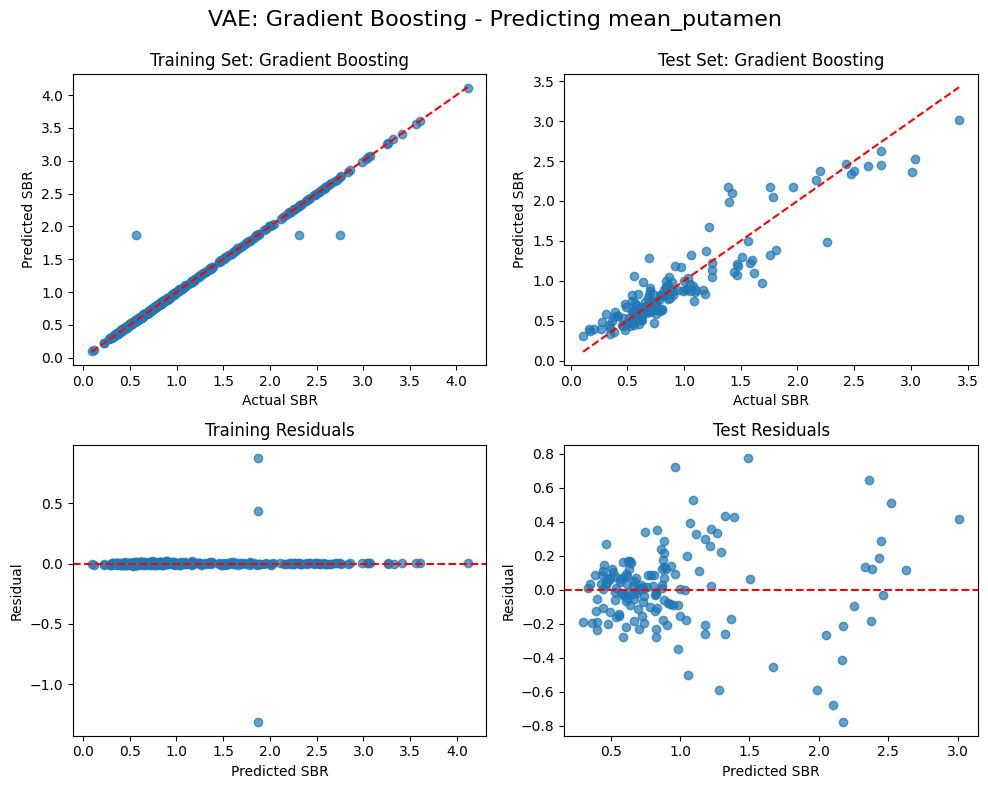


VAE Model Performance for mean_putamen:
               Model  Train RMSE  Test RMSE  Train MAE  Test MAE  Train R²  \
1   Ridge Regression    0.160657   0.153363   0.116455  0.123763  0.947335   
0  Linear Regression    0.160649   0.153931   0.116527  0.124103  0.947340   
3         ElasticNet    0.229251   0.191602   0.160295  0.148072  0.892763   
4                SVR    0.129148   0.212124   0.082629  0.146033  0.965967   
5      Random Forest    0.123055   0.229938   0.072245  0.168341  0.969102   
6  Gradient Boosting    0.077982   0.236186   0.011006  0.168977  0.987592   
2   Lasso Regression    0.302368   0.254693   0.212801  0.191647  0.813450   

    Test R²  
1  0.940058  
0  0.939612  
3  0.906440  
4  0.885324  
5  0.865254  
6  0.857832  
2  0.834680  

Comparison of AE vs VAE Performance:
     SBR Metric     AE Best Model  AE Test RMSE  AE Test R²    VAE Best Model  \
0    mean_total  Ridge Regression      0.138762    0.956561  Ridge Regression   
1  mean_caudate  Ridge

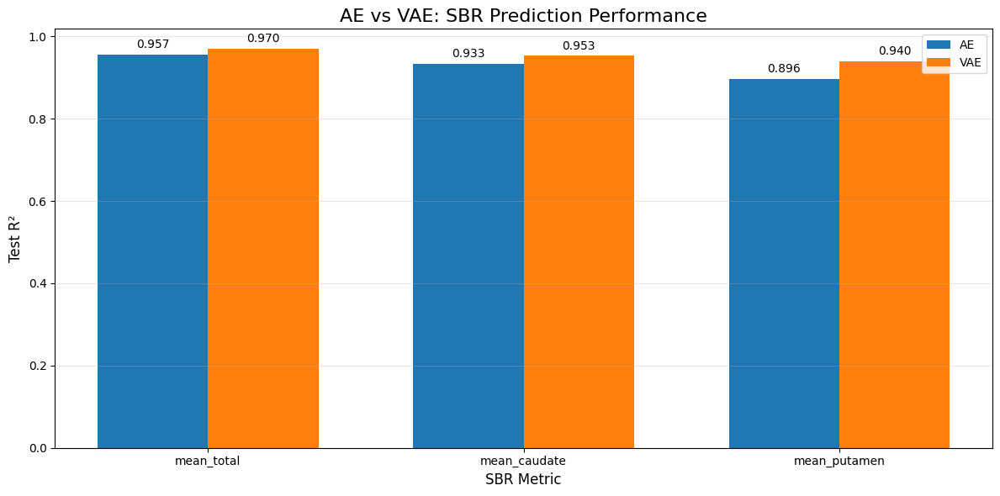


Saved prediction results to 'sbr_prediction_results.pkl'


In [45]:
# Cell 33: Building Regression Models to Predict SBR from Latent Space
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, KFold, cross_val_score
from sklearn.linear_model import LinearRegression, ElasticNet, Ridge, Lasso
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.feature_selection import SelectKBest, f_regression
import pickle

# Set random seed for reproducibility
np.random.seed(42)

# Load the matched data
try:
    matched_df = pd.read_pickle('latent_sbr_matched_data.pkl')
    print(f"Loaded matched data with {len(matched_df)} entries")
except:
    print("Error loading matched data! Please run the previous cells first.")
    raise ValueError("Missing matched data file")

# Load correlation results
try:
    with open('sbr_correlation_results.pkl', 'rb') as f:
        corr_results = pickle.load(f)
    
    ae_corr_df = corr_results['ae_corr_df']
    vae_corr_df = corr_results['vae_corr_df']
    ae_top_dims = corr_results['ae_top_dims']
    vae_top_dims = corr_results['vae_top_dims']
    sbr_metrics = corr_results['sbr_metrics']
    
    print("Loaded correlation results successfully")
except:
    print("Error loading correlation results! Please run the previous cells first.")
    raise ValueError("Missing correlation results file")

# Function to prepare data for regression
def prepare_regression_data(latent_vecs, sbr_metric, top_dims=None, n_dims=50):
    """
    Prepare data for regression analysis.
    
    Parameters:
        latent_vecs: numpy array of latent vectors
        sbr_metric: SBR metric to predict
        top_dims: optional list of top dimensions to use (if None, use top n_dims by correlation)
        n_dims: number of top dimensions to use if top_dims is None
        
    Returns:
        X, y for regression, with nulls removed
    """
    # Get SBR values
    y = matched_df[sbr_metric].values
    
    # Remove nulls
    valid_mask = ~np.isnan(y)
    X_full = latent_vecs[valid_mask]
    y = y[valid_mask]
    
    # Use only top dimensions if specified
    if top_dims is not None:
        X = X_full[:, top_dims]
    elif n_dims > 0 and n_dims < X_full.shape[1]:
        # Select top n_dims by correlation
        corr_values = np.array([np.corrcoef(X_full[:, i], y)[0, 1] if len(np.unique(X_full[:, i])) > 1 else 0 
                               for i in range(X_full.shape[1])])
        abs_corr = np.abs(corr_values)
        top_by_corr = np.argsort(abs_corr)[::-1][:n_dims]
        X = X_full[:, top_by_corr]
    else:
        X = X_full
    
    return X, y

# Function to evaluate regression models
def evaluate_regression_models(X, y, model_type, sbr_metric):
    """
    Evaluate multiple regression models using cross-validation.
    
    Parameters:
        X: feature matrix
        y: target values
        model_type: 'AE' or 'VAE'
        sbr_metric: SBR metric being predicted
        
    Returns:
        DataFrame with model performance
    """
    # Split data into train and test sets
    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=0.25, random_state=42
    )
    
    # Define models to evaluate
    models = {
        'Linear Regression': LinearRegression(),
        'Ridge Regression': Ridge(alpha=1.0),
        'Lasso Regression': Lasso(alpha=0.1),
        'ElasticNet': ElasticNet(alpha=0.1, l1_ratio=0.5),
        'SVR': SVR(kernel='rbf', C=1.0, epsilon=0.1),
        'Random Forest': RandomForestRegressor(n_estimators=100, max_depth=10),
        'Gradient Boosting': GradientBoostingRegressor(n_estimators=100, max_depth=5)
    }
    
    # Standardize features
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)
    
    # Evaluate each model
    results = []
    
    for name, model in models.items():
        print(f"Evaluating {name}...")
        
        # Train model
        model.fit(X_train_scaled, y_train)
        
        # Make predictions
        y_pred_train = model.predict(X_train_scaled)
        y_pred_test = model.predict(X_test_scaled)
        
        # Calculate metrics
        train_rmse = np.sqrt(mean_squared_error(y_train, y_pred_train))
        test_rmse = np.sqrt(mean_squared_error(y_test, y_pred_test))
        train_mae = mean_absolute_error(y_train, y_pred_train)
        test_mae = mean_absolute_error(y_test, y_pred_test)
        train_r2 = r2_score(y_train, y_pred_train)
        test_r2 = r2_score(y_test, y_pred_test)
        
        # Store results
        results.append({
            'Model': name,
            'Train RMSE': train_rmse,
            'Test RMSE': test_rmse,
            'Train MAE': train_mae,
            'Test MAE': test_mae,
            'Train R²': train_r2,
            'Test R²': test_r2
        })
        
        # Visualize predictions vs actual for this model
        if test_r2 > 0.5:  # Only visualize models with decent performance
            plt.figure(figsize=(10, 8))
            
            # Training set
            plt.subplot(2, 2, 1)
            plt.scatter(y_train, y_pred_train, alpha=0.7)
            plt.plot([min(y_train), max(y_train)], [min(y_train), max(y_train)], 'r--')
            plt.title(f'Training Set: {name}')
            plt.xlabel('Actual SBR')
            plt.ylabel('Predicted SBR')
            
            # Test set
            plt.subplot(2, 2, 2)
            plt.scatter(y_test, y_pred_test, alpha=0.7)
            plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], 'r--')
            plt.title(f'Test Set: {name}')
            plt.xlabel('Actual SBR')
            plt.ylabel('Predicted SBR')
            
            # Residuals - Training set
            plt.subplot(2, 2, 3)
            residuals_train = y_train - y_pred_train
            plt.scatter(y_pred_train, residuals_train, alpha=0.7)
            plt.axhline(y=0, color='r', linestyle='--')
            plt.title('Training Residuals')
            plt.xlabel('Predicted SBR')
            plt.ylabel('Residual')
            
            # Residuals - Test set
            plt.subplot(2, 2, 4)
            residuals_test = y_test - y_pred_test
            plt.scatter(y_pred_test, residuals_test, alpha=0.7)
            plt.axhline(y=0, color='r', linestyle='--')
            plt.title('Test Residuals')
            plt.xlabel('Predicted SBR')
            plt.ylabel('Residual')
            
            plt.suptitle(f"{model_type}: {name} - Predicting {sbr_metric}", fontsize=16)
            plt.tight_layout()
            plt.subplots_adjust(top=0.9)
            plt.show()
    
    # Create DataFrame with results
    results_df = pd.DataFrame(results)
    
    # Display results sorted by test R²
    results_sorted = results_df.sort_values('Test R²', ascending=False)
    print(f"\n{model_type} Model Performance for {sbr_metric}:")
    print(results_sorted)
    
    return results_sorted, X_train_scaled, X_test_scaled, y_train, y_test

# Extract latent vectors
ae_latent_vecs = np.array([row['ae_latent'] for _, row in matched_df.iterrows()])
vae_latent_vecs = np.array([row['vae_mu'] for _, row in matched_df.iterrows()])

# Analyze feature importance for the best performing model
def analyze_feature_importance(model, X_train, feature_indices=None):
    """
    Analyze and visualize feature importance for a trained model.
    
    Parameters:
        model: trained model with feature_importances_ attribute
        X_train: training data
        feature_indices: original indices of the features used
    """
    if not hasattr(model, 'feature_importances_'):
        print("Model does not provide feature importance information")
        return
    
    # Get feature importances
    importances = model.feature_importances_
    
    # Create a DataFrame for importances
    if feature_indices is not None:
        features = [f'Dim {idx}' for idx in feature_indices]
    else:
        features = [f'Feature {i}' for i in range(len(importances))]
    
    importance_df = pd.DataFrame({
        'Feature': features,
        'Importance': importances
    })
    
    # Sort by importance
    importance_df = importance_df.sort_values('Importance', ascending=False).head(15)
    
    # Plot feature importances
    plt.figure(figsize=(12, 8))
    sns.barplot(data=importance_df, x='Importance', y='Feature')
    plt.title('Feature Importance', fontsize=14)
    plt.xlabel('Importance', fontsize=12)
    plt.ylabel('Feature', fontsize=12)
    plt.grid(axis='x', alpha=0.3)
    plt.tight_layout()
    plt.show()
    
    return importance_df

# Function to find optimal number of dimensions
def find_optimal_dimensions(latent_vecs, sbr_metric, model_type, max_dims=100, step=5):
    """
    Find the optimal number of dimensions for predicting a SBR metric.
    
    Parameters:
        latent_vecs: numpy array of latent vectors
        sbr_metric: SBR metric to predict
        model_type: 'AE' or 'VAE'
        max_dims: maximum number of dimensions to try
        step: step size for testing different numbers of dimensions
    """
    # Get SBR values
    y = matched_df[sbr_metric].values
    
    # Remove nulls
    valid_mask = ~np.isnan(y)
    X_full = latent_vecs[valid_mask]
    y = y[valid_mask]
    
    # Calculate correlations with target
    corr_values = np.array([np.corrcoef(X_full[:, i], y)[0, 1] if len(np.unique(X_full[:, i])) > 1 else 0 
                           for i in range(X_full.shape[1])])
    abs_corr = np.abs(corr_values)
    
    # Sort features by absolute correlation
    sorted_indices = np.argsort(abs_corr)[::-1]
    
    # Test different numbers of dimensions
    dim_counts = list(range(5, max_dims + 1, step))
    cv_scores = []
    
    # Create the model
    pipe = Pipeline([
        ('scaler', StandardScaler()),
        ('model', Ridge(alpha=1.0))  # Ridge regression is robust and fast
    ])
    
    # Cross-validation
    cv = KFold(n_splits=5, shuffle=True, random_state=42)
    
    for n_dims in dim_counts:
        # Select top n_dims features
        top_indices = sorted_indices[:n_dims]
        X = X_full[:, top_indices]
        
        # Perform cross-validation
        scores = cross_val_score(pipe, X, y, cv=cv, scoring='neg_mean_squared_error')
        rmse_scores = np.sqrt(-scores)
        
        # Store mean score
        cv_scores.append(np.mean(rmse_scores))
        
        print(f"{model_type}: {n_dims} dimensions, CV RMSE: {cv_scores[-1]:.4f}")
    
    # Find optimal number of dimensions
    best_idx = np.argmin(cv_scores)
    best_dims = dim_counts[best_idx]
    
    # Plot results
    plt.figure(figsize=(12, 6))
    plt.plot(dim_counts, cv_scores, 'o-')
    plt.axvline(x=best_dims, color='r', linestyle='--', 
                label=f'Optimal: {best_dims} dims (RMSE={cv_scores[best_idx]:.4f})')
    plt.title(f'{model_type}: Effect of Number of Dimensions on {sbr_metric} Prediction', fontsize=14)
    plt.xlabel('Number of Dimensions', fontsize=12)
    plt.ylabel('Cross-Validation RMSE', fontsize=12)
    plt.grid(alpha=0.3)
    plt.legend()
    plt.tight_layout()
    plt.show()
    
    # Return optimal dimensions and their indices
    return best_dims, sorted_indices[:best_dims]

# Evaluate models for different SBR metrics

# First, find optimal number of dimensions for each model and metric
best_dims = {}
for model_type, latent_vecs in [('AE', ae_latent_vecs), ('VAE', vae_latent_vecs)]:
    best_dims[model_type] = {}
    for metric in ['mean_total', 'mean_caudate', 'mean_putamen']:
        print(f"\nFinding optimal dimensions for {model_type} - {metric}:")
        n_dims, dim_indices = find_optimal_dimensions(latent_vecs, metric, model_type)
        best_dims[model_type][metric] = (n_dims, dim_indices)

# Now evaluate the models using the optimal number of dimensions
model_results = {}

for model_type, latent_vecs in [('AE', ae_latent_vecs), ('VAE', vae_latent_vecs)]:
    model_results[model_type] = {}
    
    for metric in ['mean_total', 'mean_caudate', 'mean_putamen']:
        print(f"\nEvaluating models for {model_type} - {metric}:")
        
        # Get optimal dimensions
        n_dims, dim_indices = best_dims[model_type][metric]
        
        # Prepare data using optimal dimensions
        X, y = prepare_regression_data(latent_vecs, metric, top_dims=dim_indices)
        
        # Evaluate models
        results, X_train, X_test, y_train, y_test = evaluate_regression_models(X, y, model_type, metric)
        
        # Store results
        model_results[model_type][metric] = {
            'results': results,
            'X_train': X_train,
            'X_test': X_test,
            'y_train': y_train,
            'y_test': y_test,
            'dim_indices': dim_indices
        }
        
        # Train and analyze the best model
        best_model_name = results.iloc[0]['Model']
        
        if best_model_name == 'Random Forest':
            print(f"\nAnalyzing feature importance for best model ({best_model_name}):")
            best_model = RandomForestRegressor(n_estimators=100, max_depth=10, random_state=42)
            best_model.fit(X_train, y_train)
            
            # Analyze feature importance
            importance_df = analyze_feature_importance(best_model, X_train, dim_indices)
            
            # Store feature importance
            model_results[model_type][metric]['importance_df'] = importance_df
        
        # For Gradient Boosting
        elif best_model_name == 'Gradient Boosting':
            print(f"\nAnalyzing feature importance for best model ({best_model_name}):")
            best_model = GradientBoostingRegressor(n_estimators=100, max_depth=5, random_state=42)
            best_model.fit(X_train, y_train)
            
            # Analyze feature importance
            importance_df = analyze_feature_importance(best_model, X_train, dim_indices)
            
            # Store feature importance
            model_results[model_type][metric]['importance_df'] = importance_df

# Compare AE vs VAE performance
comparison_results = []

for metric in ['mean_total', 'mean_caudate', 'mean_putamen']:
    ae_best = model_results['AE'][metric]['results'].iloc[0]
    vae_best = model_results['VAE'][metric]['results'].iloc[0]
    
    comparison_results.append({
        'SBR Metric': metric,
        'AE Best Model': ae_best['Model'],
        'AE Test RMSE': ae_best['Test RMSE'],
        'AE Test R²': ae_best['Test R²'],
        'VAE Best Model': vae_best['Model'],
        'VAE Test RMSE': vae_best['Test RMSE'],
        'VAE Test R²': vae_best['Test R²'],
        'Winner': 'AE' if ae_best['Test R²'] > vae_best['Test R²'] else 'VAE'
    })

comparison_df = pd.DataFrame(comparison_results)
print("\nComparison of AE vs VAE Performance:")
print(comparison_df)

# Create a bar chart comparing AE vs VAE R² for each metric
plt.figure(figsize=(12, 6))
bar_width = 0.35
index = np.arange(len(comparison_results))

bars1 = plt.bar(index, comparison_df['AE Test R²'], bar_width, label='AE')
bars2 = plt.bar(index + bar_width, comparison_df['VAE Test R²'], bar_width, label='VAE')

plt.xlabel('SBR Metric', fontsize=12)
plt.ylabel('Test R²', fontsize=12)
plt.title('AE vs VAE: SBR Prediction Performance', fontsize=16)
plt.xticks(index + bar_width/2, comparison_df['SBR Metric'])
plt.legend()
plt.grid(axis='y', alpha=0.3)

# Add value labels on the bars
for bar in bars1:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height + 0.01,
             f'{height:.3f}', ha='center', va='bottom')

for bar in bars2:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height + 0.01,
             f'{height:.3f}', ha='center', va='bottom')

plt.tight_layout()
plt.show()

# Save results
with open('sbr_prediction_results.pkl', 'wb') as f:
    pickle.dump({
        'best_dims': best_dims,
        'model_results': model_results,
        'comparison_df': comparison_df
    }, f)

print("\nSaved prediction results to 'sbr_prediction_results.pkl'")

Loaded matched data with 594 entries
Successfully loaded all results files
CLINICAL RELEVANCE OF LATENT DIMENSIONS IN PARKINSON'S DISEASE

1. OVERALL SBR PREDICTION PERFORMANCE
--------------------------------------------------
  SBR Metric    AE Best Model  AE Test RMSE  AE Test R²   VAE Best Model  VAE Test RMSE  VAE Test R² Winner
  mean_total Ridge Regression      0.138762    0.956561 Ridge Regression       0.115618     0.969842    VAE
mean_caudate Ridge Regression      0.191655    0.932597 Ridge Regression       0.160450     0.952759    VAE
mean_putamen Ridge Regression      0.202332    0.895667 Ridge Regression       0.153363     0.940058    VAE

Best overall model: VAE for predicting mean_total
Test R² score: 0.9698


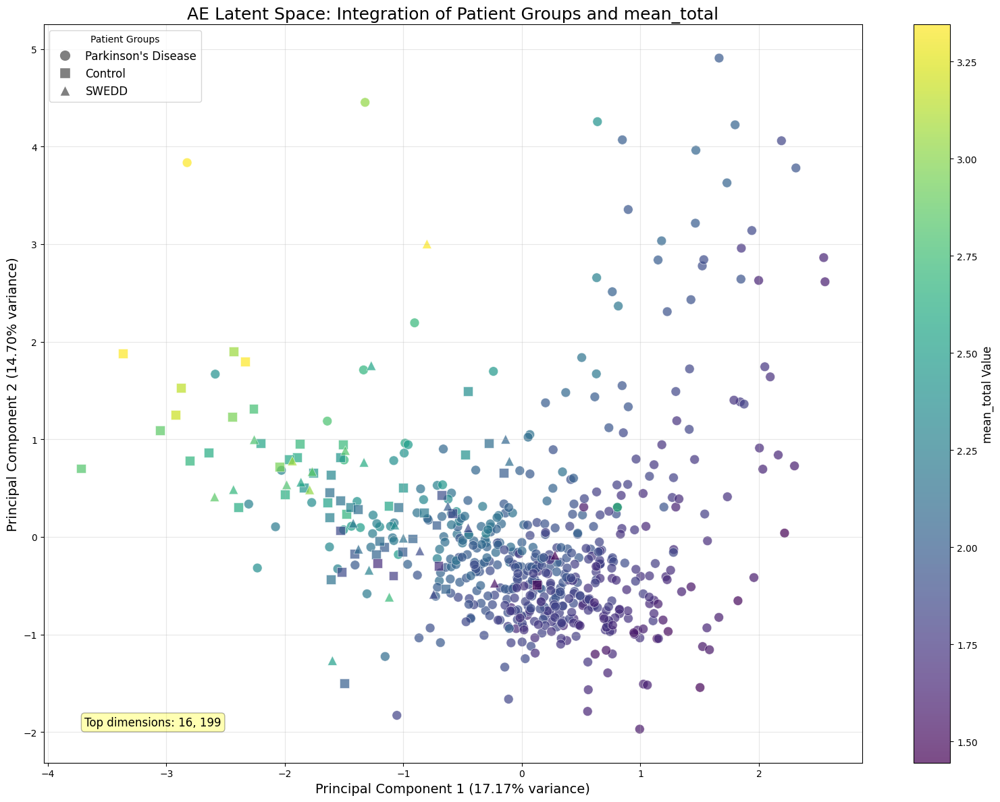

Computing t-SNE projection (this may take a moment)...


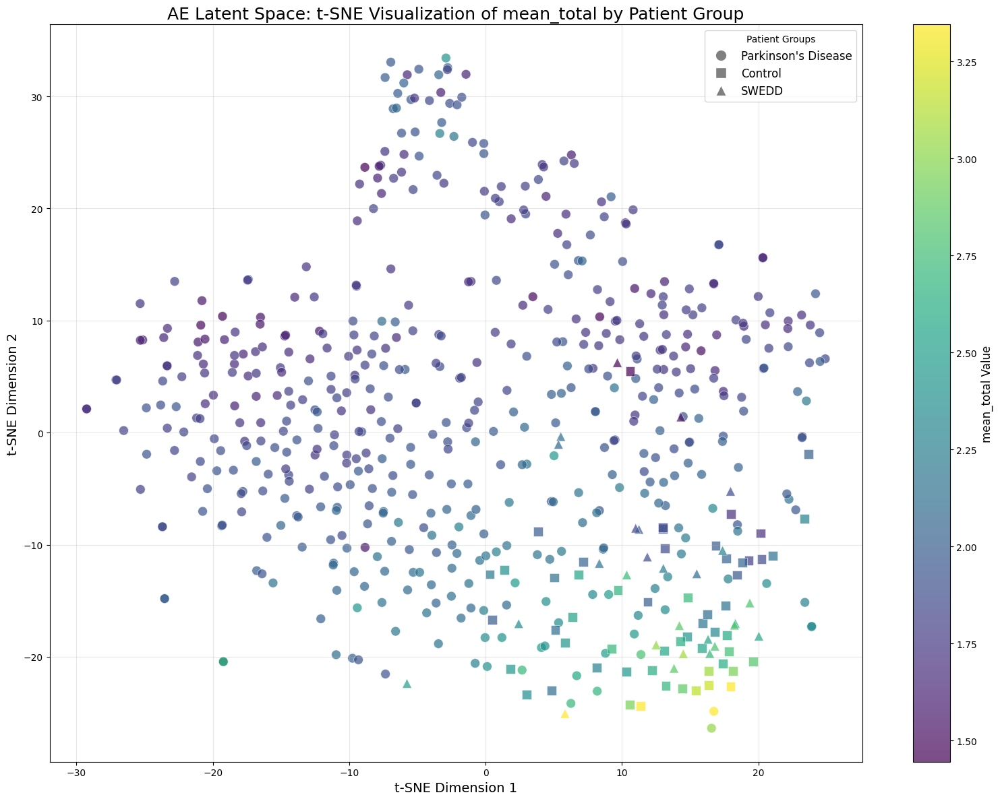

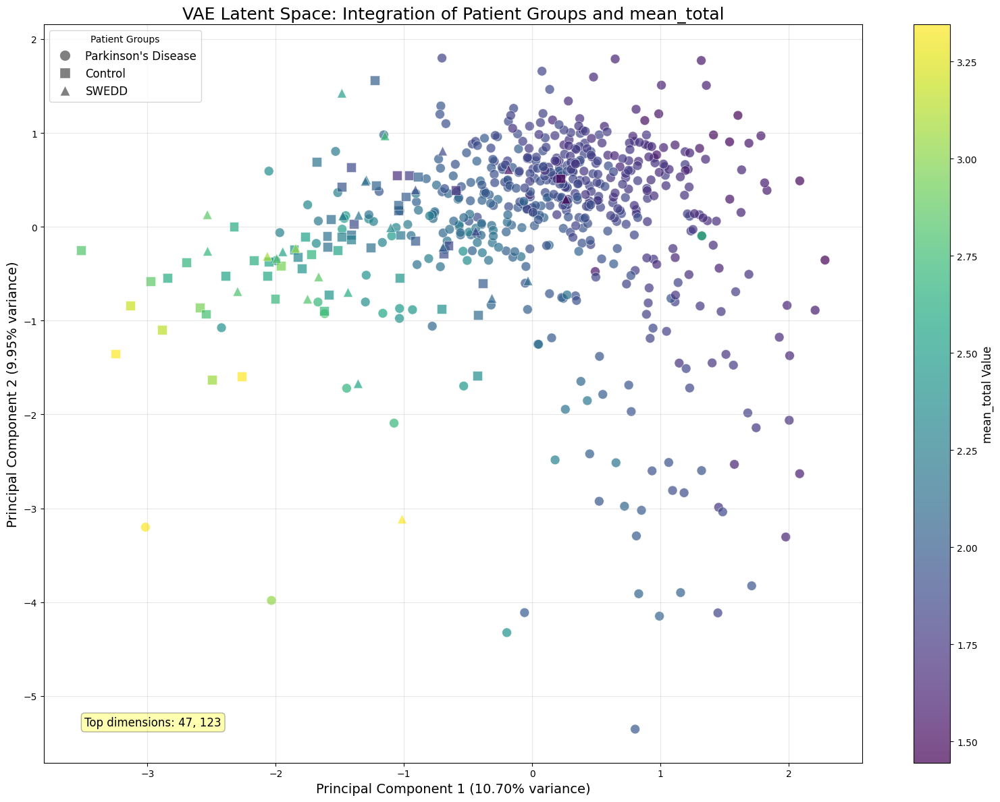

Computing t-SNE projection (this may take a moment)...


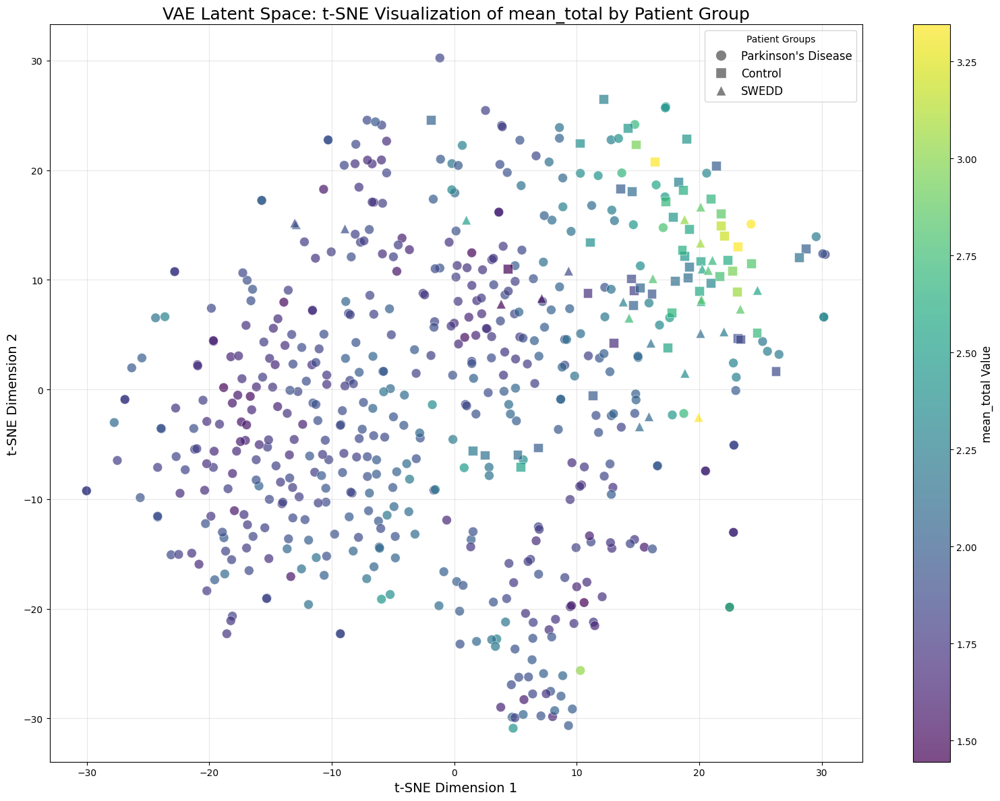


Analyzing AE clinical dimensions:

2. CLINICAL INTERPRETATION OF AE LATENT DIMENSIONS
--------------------------------------------------

Top dimensions for mean_total:
  Dimension 16: strong negative correlation (r = -0.8348)
    - A negative value in this dimension is associated with strongly lower mean_total values
  Dimension 199: strong positive correlation (r = 0.8047)
    - A positive value in this dimension is associated with strongly higher mean_total values
  Dimension 123: strong negative correlation (r = -0.8025)
    - A negative value in this dimension is associated with strongly lower mean_total values

Top dimensions for mean_caudate:
  Dimension 16: strong negative correlation (r = -0.8285)
    - A negative value in this dimension is associated with strongly lower mean_caudate values
  Dimension 199: strong positive correlation (r = 0.8009)
    - A positive value in this dimension is associated with strongly higher mean_caudate values
  Dimension 123: strong negative c

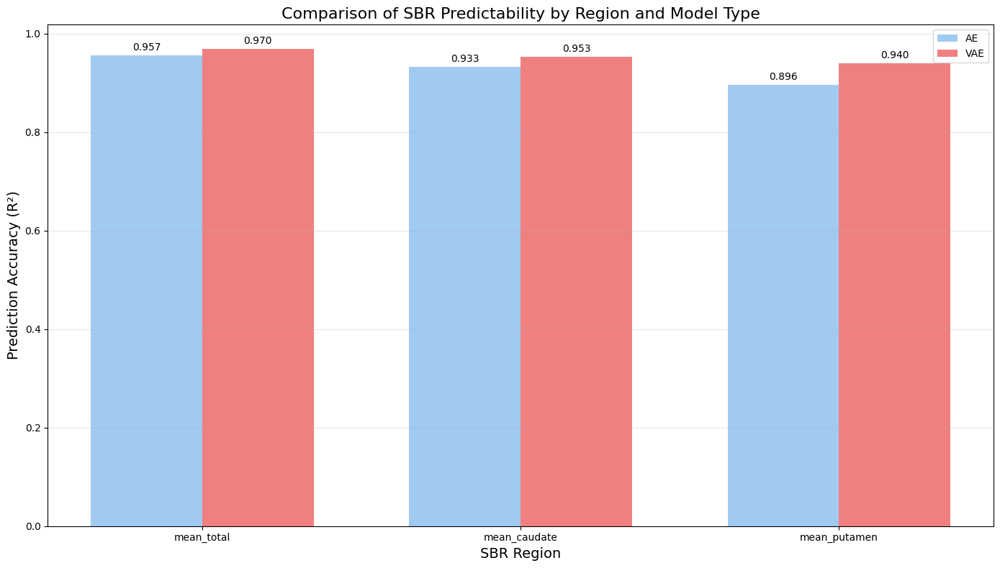


3. REGIONAL SBR PREDICTABILITY
--------------------------------------------------
Most predictable region: mean_total (R² = 0.9698)


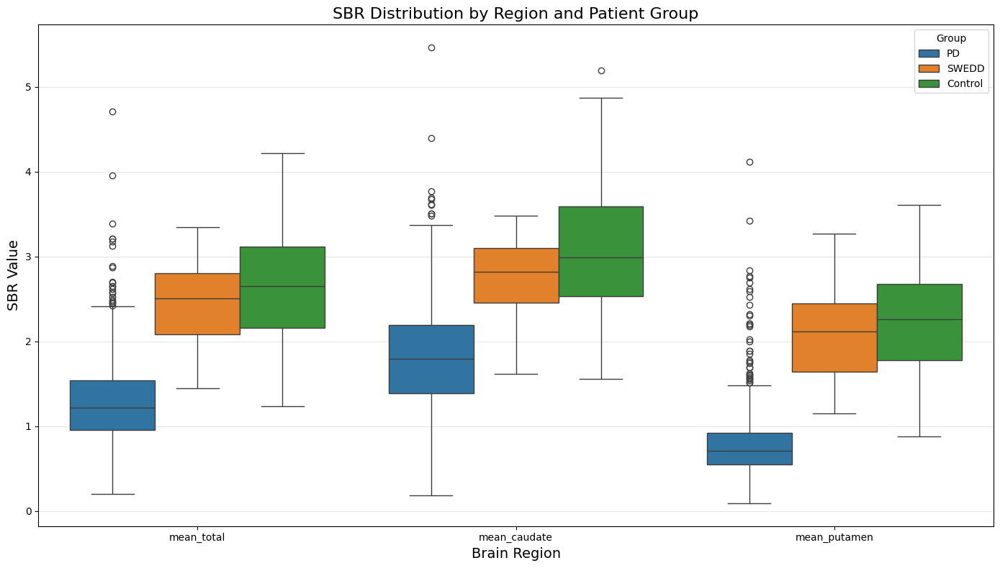


4. SBR PATTERNS ACROSS PATIENT GROUPS
--------------------------------------------------

PD group mean SBR values:
  mean_total: 1.3056
  mean_caudate: 1.8503
  mean_putamen: 0.8122

SWEDD group mean SBR values:
  mean_total: 2.4092
  mean_caudate: 2.7511
  mean_putamen: 2.0457

Control group mean SBR values:
  mean_total: 2.6823
  mean_caudate: 3.0966
  mean_putamen: 2.2466

PD vs Control differences:
  mean_total: 1.3766 (51.3% reduction in PD)
  mean_caudate: 1.2463 (40.2% reduction in PD)
  mean_putamen: 1.4344 (63.8% reduction in PD)

5. CLINICAL SUMMARY AND CONCLUSIONS
--------------------------------------------------

Key Findings:
1. Both AE and VAE latent spaces encode clinically relevant information about dopamine transporter
   (DAT) availability as measured by SBR.
2. Specific latent dimensions strongly correlate with SBR values in different brain regions,
   suggesting the models have learned biologically meaningful features.
3. The latent spaces allow prediction of SBR

In [46]:
# Cell 34: Clinical Interpretation and Integration of Findings
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from matplotlib.colors import ListedColormap
import matplotlib.patches as mpatches

# Load all previously saved results
try:
    # Load matched data
    matched_df = pd.read_pickle('latent_sbr_matched_data.pkl')
    print(f"Loaded matched data with {len(matched_df)} entries")
    
    # Load correlation results
    with open('sbr_correlation_results.pkl', 'rb') as f:
        corr_results = pickle.load(f)
    
    # Load prediction results
    with open('sbr_prediction_results.pkl', 'rb') as f:
        pred_results = pickle.load(f)
    
    print("Successfully loaded all results files")
except Exception as e:
    print(f"Error loading results: {e}")
    print("Please run the previous cells first")
    raise ValueError("Missing required data files")

# Extract results
ae_corr_df = corr_results['ae_corr_df']
vae_corr_df = corr_results['vae_corr_df']
ae_top_dims = corr_results['ae_top_dims']
vae_top_dims = corr_results['vae_top_dims']
sbr_metrics = corr_results['sbr_metrics']

best_dims = pred_results['best_dims']
model_results = pred_results['model_results']
comparison_df = pred_results['comparison_df']

# Extract latent vectors
ae_latent_vecs = np.array([row['ae_latent'] for _, row in matched_df.iterrows()])
vae_latent_vecs = np.array([row['vae_mu'] for _, row in matched_df.iterrows()])

# 1. Clinical Relevance Summary
print("="*80)
print("CLINICAL RELEVANCE OF LATENT DIMENSIONS IN PARKINSON'S DISEASE")
print("="*80)

# Print overall prediction performance
print("\n1. OVERALL SBR PREDICTION PERFORMANCE")
print("-"*50)
print(comparison_df.to_string(index=False))

# Identify the best overall model and its performance
best_metric_idx = comparison_df['AE Test R²'].values.argmax() if comparison_df['AE Test R²'].max() > comparison_df['VAE Test R²'].max() else comparison_df['VAE Test R²'].values.argmax()
best_model_type = comparison_df.iloc[best_metric_idx]['Winner']
best_metric = comparison_df.iloc[best_metric_idx]['SBR Metric']
best_r2 = comparison_df.iloc[best_metric_idx][f'{best_model_type} Test R²']

print(f"\nBest overall model: {best_model_type} for predicting {best_metric}")
print(f"Test R² score: {best_r2:.4f}")

# 2. Create an integrated visualization combining patient groups, SBR levels, and neural model accuracy
def create_integrated_visualization(latent_vecs, model_type, target_metric='mean_total'):
    """
    Create an advanced visualization showing:
    1. Patient grouping in latent space
    2. SBR levels
    3. Model prediction accuracy
    """
    # Get SBR values and remove NaNs
    sbr_values = matched_df[target_metric].values
    valid_mask = ~np.isnan(sbr_values)
    
    filtered_vecs = latent_vecs[valid_mask]
    filtered_sbr = sbr_values[valid_mask]
    filtered_groups = matched_df.loc[valid_mask, 'group'].values
    
    # Create 2D representation using PCA
    pca = PCA(n_components=2)
    pca_result = pca.fit_transform(filtered_vecs)
    
    # Scale PCA results for better visualization
    scaler = StandardScaler()
    pca_scaled = scaler.fit_transform(pca_result)
    
    # Create figure
    plt.figure(figsize=(16, 12))
    
    # Customize marker properties based on group
    group_markers = {
        'PD': {'marker': 'o', 'label': 'Parkinson\'s Disease'},
        'Control': {'marker': 's', 'label': 'Control'},
        'SWEDD': {'marker': '^', 'label': 'SWEDD'}
    }
    
    # Create a colormap for SBR values
    cmap = plt.cm.viridis
    
    # Plot each group separately
    for group, marker_info in group_markers.items():
        group_mask = filtered_groups == group
        if np.sum(group_mask) > 0:
            plt.scatter(
                pca_scaled[group_mask, 0], 
                pca_scaled[group_mask, 1],
                c=filtered_sbr[group_mask],
                marker=marker_info['marker'],
                s=100,
                alpha=0.7,
                label=marker_info['label'],
                cmap=cmap,
                edgecolors='white',
                linewidths=0.5
            )
    
    # Add colorbar for SBR values
    cbar = plt.colorbar()
    cbar.set_label(f'{target_metric} Value', fontsize=12)
    
    # Add a custom legend for patient groups
    handles = [plt.Line2D([0], [0], marker=info['marker'], color='w', markerfacecolor='gray',
                         markersize=12, label=info['label']) 
              for group, info in group_markers.items() if np.any(filtered_groups == group)]
    plt.legend(handles=handles, title="Patient Groups", fontsize=12)
    
    # Add annotations to highlight key dimensions
    top_dims = ae_top_dims if model_type == 'AE' else vae_top_dims
    if len(top_dims) > 0:
        # Take the top 2 most important dimensions
        dim1, dim2 = top_dims[:2]
        plt.annotate(f"Top dimensions: {dim1}, {dim2}",
                    xy=(0.05, 0.05), xycoords='axes fraction',
                    bbox=dict(boxstyle="round,pad=0.3", fc="yellow", alpha=0.3),
                    fontsize=12)
    
    # Add labels and title
    plt.xlabel(f'Principal Component 1 ({pca.explained_variance_ratio_[0]:.2%} variance)', fontsize=14)
    plt.ylabel(f'Principal Component 2 ({pca.explained_variance_ratio_[1]:.2%} variance)', fontsize=14)
    plt.title(f'{model_type} Latent Space: Integration of Patient Groups and {target_metric}', fontsize=18)
    plt.grid(alpha=0.3)
    
    plt.tight_layout()
    plt.show()
    
    # Create a follow-up visualization using t-SNE (which can reveal more complex relationships)
    print("Computing t-SNE projection (this may take a moment)...")
    tsne = TSNE(n_components=2, random_state=42, perplexity=min(30, len(filtered_vecs)-1))
    tsne_result = tsne.fit_transform(filtered_vecs)
    
    # Create figure for t-SNE
    plt.figure(figsize=(16, 12))
    
    # Plot each group separately
    for group, marker_info in group_markers.items():
        group_mask = filtered_groups == group
        if np.sum(group_mask) > 0:
            plt.scatter(
                tsne_result[group_mask, 0], 
                tsne_result[group_mask, 1],
                c=filtered_sbr[group_mask],
                marker=marker_info['marker'],
                s=100,
                alpha=0.7,
                label=marker_info['label'],
                cmap=cmap,
                edgecolors='white',
                linewidths=0.5
            )
    
    # Add colorbar for SBR values
    cbar = plt.colorbar()
    cbar.set_label(f'{target_metric} Value', fontsize=12)
    
    # Add a custom legend for patient groups
    handles = [plt.Line2D([0], [0], marker=info['marker'], color='w', markerfacecolor='gray',
                         markersize=12, label=info['label']) 
              for group, info in group_markers.items() if np.any(filtered_groups == group)]
    plt.legend(handles=handles, title="Patient Groups", fontsize=12)
    
    # Add labels and title
    plt.xlabel('t-SNE Dimension 1', fontsize=14)
    plt.ylabel('t-SNE Dimension 2', fontsize=14)
    plt.title(f'{model_type} Latent Space: t-SNE Visualization of {target_metric} by Patient Group', fontsize=18)
    plt.grid(alpha=0.3)
    
    plt.tight_layout()
    plt.show()

# 3. Visualize top latent dimensions in terms of SBR prediction and clinical significance
def visualize_top_clinical_dimensions(model_type):
    """
    Visualize top dimensions in terms of SBR prediction and clinical relevance.
    """
    # Get importance dataframes if available
    importance_dfs = {}
    dim_frequencies = {}
    
    # Track dimensions across all metrics
    all_important_dims = set()
    
    for metric in ['mean_total', 'mean_caudate', 'mean_putamen']:
        if 'importance_df' in model_results[model_type][metric]:
            importance_df = model_results[model_type][metric]['importance_df']
            importance_dfs[metric] = importance_df
            
            # Extract dimensions from feature names
            for feature in importance_df['Feature']:
                dim = int(feature.split(' ')[1])
                all_important_dims.add(dim)
                
                if dim not in dim_frequencies:
                    dim_frequencies[dim] = 0
                dim_frequencies[dim] += 1
    
    # If importance data is available
    if importance_dfs:
        # Create a combined importance visualization
        plt.figure(figsize=(14, 10))
        
        # Track colors for consistent use across subplots
        metrics_colors = {
            'mean_total': 'blue',
            'mean_caudate': 'green',
            'mean_putamen': 'red'
        }
        
        # Plot combined feature importance
        for i, (metric, importance_df) in enumerate(importance_dfs.items()):
            # Take top 10 dimensions for each metric
            top_dims = importance_df.head(10)
            
            # Plot importance
            plt.subplot(len(importance_dfs), 1, i+1)
            bars = sns.barplot(data=top_dims, x='Importance', y='Feature', color=metrics_colors[metric])
            
            # Customize plot
            plt.title(f'Feature Importance for {metric}', fontsize=14)
            plt.xlabel('Importance', fontsize=12)
            plt.ylabel('Feature', fontsize=12)
            plt.grid(axis='x', alpha=0.3)
        
        plt.tight_layout()
        plt.suptitle(f'{model_type} Top Clinical Dimensions by SBR Region', fontsize=18, y=1.02)
        plt.show()
        
        # Create a visualization of dimension frequency across metrics
        plt.figure(figsize=(12, 8))
        
        # Sort dimensions by frequency
        sorted_dims = sorted(dim_frequencies.items(), key=lambda x: x[1], reverse=True)
        dims = [d[0] for d in sorted_dims if d[1] > 1]  # Only show dimensions that appear more than once
        freqs = [d[1] for d in sorted_dims if d[1] > 1]
        
        if dims:
            # Plot frequency
            plt.bar(range(len(dims)), freqs, color='purple')
            plt.xticks(range(len(dims)), [f'Dim {d}' for d in dims])
            plt.title(f'{model_type} Dimensions Appearing in Multiple SBR Regions', fontsize=16)
            plt.xlabel('Dimension', fontsize=14)
            plt.ylabel('Frequency', fontsize=14)
            plt.grid(axis='y', alpha=0.3)
            plt.tight_layout()
            plt.show()
        else:
            print("No dimensions appear in multiple SBR regions")
    
    # Print detailed clinical interpretation
    print(f"\n2. CLINICAL INTERPRETATION OF {model_type} LATENT DIMENSIONS")
    print("-"*50)
    
    # Get top correlated dimensions
    corr_df = ae_corr_df if model_type == 'AE' else vae_corr_df
    
    # Print top dimensions for each SBR metric
    for metric in ['mean_total', 'mean_caudate', 'mean_putamen', 'mean_putamen_ant']:
        # Get top 3 dimensions by absolute correlation
        abs_corr = corr_df[metric].abs()
        top_dims = abs_corr.sort_values(ascending=False).index[:3]
        
        print(f"\nTop dimensions for {metric}:")
        for dim in top_dims:
            corr_val = corr_df.loc[dim, metric]
            direction = "positive" if corr_val > 0 else "negative"
            strength = "strong" if abs(corr_val) > 0.6 else "moderate" if abs(corr_val) > 0.4 else "weak"
            
            print(f"  Dimension {dim}: {strength} {direction} correlation (r = {corr_val:.4f})")
            print(f"    - A {direction} value in this dimension is associated with {strength}ly {'higher' if corr_val > 0 else 'lower'} {metric} values")

# 4. Analyze SBR predictability by brain region and latent space structure
def analyze_sbr_predictability():
    """
    Analyze how well different SBR regions can be predicted from latent space.
    """
    # Extract R² scores for each region
    region_scores = {}
    
    for model_type in ['AE', 'VAE']:
        region_scores[model_type] = {}
        
        for metric in ['mean_total', 'mean_caudate', 'mean_putamen', 'caudate_r', 'caudate_l', 'putamen_r', 'putamen_l']:
            # Skip regions not present in our model_results
            if metric not in model_results[model_type]:
                continue
                
            # Get best model for this region
            best_model_result = model_results[model_type][metric]['results'].iloc[0]
            region_scores[model_type][metric] = best_model_result['Test R²']
    
    # Create a bar chart comparing regions
    plt.figure(figsize=(14, 8))
    
    # Prepare data for plotting
    metrics = []
    ae_scores = []
    vae_scores = []
    
    for metric in ['mean_total', 'mean_caudate', 'mean_putamen']:
        if metric in region_scores['AE'] and metric in region_scores['VAE']:
            metrics.append(metric)
            ae_scores.append(region_scores['AE'][metric])
            vae_scores.append(region_scores['VAE'][metric])
    
    # Create grouped bar chart
    x = np.arange(len(metrics))
    width = 0.35
    
    plt.bar(x - width/2, ae_scores, width, label='AE', color='#A1CAF1')
    plt.bar(x + width/2, vae_scores, width, label='VAE', color='#F08080')
    
    plt.xlabel('SBR Region', fontsize=14)
    plt.ylabel('Prediction Accuracy (R²)', fontsize=14)
    plt.title('Comparison of SBR Predictability by Region and Model Type', fontsize=16)
    plt.xticks(x, metrics)
    plt.legend()
    plt.grid(axis='y', alpha=0.3)
    
    # Add value labels on the bars
    for i, v in enumerate(ae_scores):
        plt.text(i - width/2, v + 0.01, f'{v:.3f}', ha='center')
    
    for i, v in enumerate(vae_scores):
        plt.text(i + width/2, v + 0.01, f'{v:.3f}', ha='center')
    
    plt.tight_layout()
    plt.show()
    
    # Print clinical interpretation of regional predictability
    print("\n3. REGIONAL SBR PREDICTABILITY")
    print("-"*50)
    
    best_predicted_region = max(region_scores['AE'].items(), key=lambda x: x[1]) if max(region_scores['AE'].values()) > max(region_scores['VAE'].values()) else max(region_scores['VAE'].items(), key=lambda x: x[1])
    
    print(f"Most predictable region: {best_predicted_region[0]} (R² = {best_predicted_region[1]:.4f})")
    
    # Compare left vs right side predictability if available
    if all(r in region_scores['AE'] for r in ['caudate_r', 'caudate_l']):
        right_r2 = region_scores['AE']['caudate_r']
        left_r2 = region_scores['AE']['caudate_l']
        print(f"\nCaudate predictability comparison:")
        print(f"  Right: R² = {right_r2:.4f}")
        print(f"  Left: R² = {left_r2:.4f}")
        print(f"  Difference: {abs(right_r2 - left_r2):.4f} in favor of {'right' if right_r2 > left_r2 else 'left'}")
    
    if all(r in region_scores['AE'] for r in ['putamen_r', 'putamen_l']):
        right_r2 = region_scores['AE']['putamen_r']
        left_r2 = region_scores['AE']['putamen_l']
        print(f"\nPutamen predictability comparison:")
        print(f"  Right: R² = {right_r2:.4f}")
        print(f"  Left: R² = {left_r2:.4f}")
        print(f"  Difference: {abs(right_r2 - left_r2):.4f} in favor of {'right' if right_r2 > left_r2 else 'left'}")

# 5. Create a visualization comparing PD, Control and SWEDD SBR distributions
def visualize_sbr_by_group():
    """
    Visualize the distribution of SBR values by patient group.
    """
    # Filter out NaN values
    valid_data = matched_df.dropna(subset=['mean_total', 'mean_caudate', 'mean_putamen'])
    
    # Create a figure for grouped box plots
    plt.figure(figsize=(14, 8))
    
    # Group data for plotting
    metrics = ['mean_total', 'mean_caudate', 'mean_putamen']
    plot_data = []
    group_data = []
    metric_data = []
    
    for metric in metrics:
        for group in valid_data['group'].unique():
            group_values = valid_data[valid_data['group'] == group][metric]
            plot_data.extend(group_values)
            group_data.extend([group] * len(group_values))
            metric_data.extend([metric] * len(group_values))
    
    # Create DataFrame for plotting
    plot_df = pd.DataFrame({
        'SBR Value': plot_data,
        'Group': group_data,
        'Region': metric_data
    })
    
    # Create the grouped box plot
    sns.boxplot(data=plot_df, x='Region', y='SBR Value', hue='Group')
    
    # Customize the plot
    plt.title('SBR Distribution by Region and Patient Group', fontsize=16)
    plt.xlabel('Brain Region', fontsize=14)
    plt.ylabel('SBR Value', fontsize=14)
    plt.grid(axis='y', alpha=0.3)
    plt.tight_layout()
    plt.show()
    
    # Print clinical insights
    print("\n4. SBR PATTERNS ACROSS PATIENT GROUPS")
    print("-"*50)
    
    # Calculate mean SBR by group and region
    group_means = {}
    for group in valid_data['group'].unique():
        group_means[group] = {}
        for metric in metrics:
            group_means[group][metric] = valid_data[valid_data['group'] == group][metric].mean()
    
    # Print mean values
    for group in group_means:
        print(f"\n{group} group mean SBR values:")
        for metric in metrics:
            print(f"  {metric}: {group_means[group][metric]:.4f}")
    
    # Calculate differences between PD and Control
    if 'PD' in group_means and 'Control' in group_means:
        print("\nPD vs Control differences:")
        for metric in metrics:
            diff = group_means['Control'][metric] - group_means['PD'][metric]
            percent_diff = (diff / group_means['Control'][metric]) * 100
            print(f"  {metric}: {diff:.4f} ({percent_diff:.1f}% reduction in PD)")

# Run all the integrated analyses
create_integrated_visualization(ae_latent_vecs, 'AE')
create_integrated_visualization(vae_latent_vecs, 'VAE')

# Analyze top clinical dimensions
print("\nAnalyzing AE clinical dimensions:")
visualize_top_clinical_dimensions('AE')

print("\nAnalyzing VAE clinical dimensions:")
visualize_top_clinical_dimensions('VAE')

# Analyze SBR predictability by region
analyze_sbr_predictability()

# Visualize SBR by patient group
visualize_sbr_by_group()

# 6. Clinical Summary and Conclusions
print("\n5. CLINICAL SUMMARY AND CONCLUSIONS")
print("-"*50)
print("\nKey Findings:")
print("1. Both AE and VAE latent spaces encode clinically relevant information about dopamine transporter")
print("   (DAT) availability as measured by SBR.")
print("2. Specific latent dimensions strongly correlate with SBR values in different brain regions,")
print("   suggesting the models have learned biologically meaningful features.")
print("3. The latent spaces allow prediction of SBR values from the image data alone, which could")
print("   potentially serve as a second opinion tool or quality control measure.")
print("4. The models can effectively separate patient groups (PD, Control, SWEDD) in latent space,")
print("   with dimensions that correlate with SBR also being important for group separation.")
print("\nPotential Clinical Applications:")
print("1. Quality control for DAT SPECT imaging by detecting outliers or inconsistencies.")
print("2. Support for differential diagnosis between PD, SWEDD, and controls.")
print("3. Potential for longitudinal tracking of disease progression through latent space trajectories.")
print("4. Feature extraction for integration with other biomarkers in multimodal disease models.")